In [2]:
# If running in Google Colab, import files
try:
    import google.colab
    in_colab = True
except:
    in_colab = False

if in_colab:
    !git clone https://github.com/Hyperparticle/one-pixel-attack-keras.git
    !mv -v one-pixel-attack-keras/* .
    !rm -rf one-pixel-attack-keras

# Python Libraries
%matplotlib inline
import pickle
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import time
import math
from keras.datasets import cifar10
from keras import backend as K # original
#from kears import keras.backend.tensorflow_backend as K
import tensorflow as tf
from PIL import Image
from mpl_toolkits.mplot3d import Axes3D
from matplotlib import cm
import matplotlib

# Custom Networks
from networks.lenet import LeNet
from networks.pure_cnn import PureCnn
from networks.network_in_network import NetworkInNetwork
from networks.resnet import ResNet
from networks.densenet import DenseNet
from networks.wide_resnet import WideResNet
from networks.capsnet import CapsNet

# Helper functions
from differential_evolution import differential_evolution
import helper

matplotlib.style.use('ggplot')
np.random.seed(100)

This notebook will demonstrate the one pixel attack with a few different convolutional neural network models. By using differential evolution, we find a special pixel that can modify a target image such that the network misclassifies the image (which it previously correctly classified).

In theory, we want models that don't get fooled by such tiny changes. Especially in images, it is undesirable to have a small alteration in the input result in a drastic change in the output. However, even the most accurate neural networks are susceptible to this type of attack.

To read more about it, see [the original paper](https://arxiv.org/abs/1710.08864), or the authors' [official repo](https://github.com/Carina02/One-Pixel-Attack).

Let's get started.

![](images/pred2.png "All it takes is one pixel")

# One Pixel Attack Tutorial
## Part 1 - Cifar10

### Dan Kondratyuk
### September 15, 2019

We can access and display any image in the dataset by its index. For instance, here is a horse.

## Imports

In [3]:
(x_train, y_train), (x_test, y_test) = cifar10.load_data()

Ensure that you have `numpy`, `pandas`, `scipy`, `matplotlib`, `tensorflow-gpu`, and `keras` installed.

Alternatively, you may [run this notebook in Google Colab](https://colab.research.google.com/drive/1Zq1kGP9C7i-70-SXyuEEaqYngtyQZMn7). Note: colab allows you to run this notebook on GPU, free of charge. Simply select "GPU" in the Accelerator drop-down in Notebook Settings (either through the Edit menu or the command palette at cmd/ctrl-shift-P).

In [4]:
class_names = ['airplane', 'automobile', 'bird', 'cat', 'deer', 'dog', 'frog', 'horse', 'ship', 'truck']

## Load Dataset

For this attack, we will use the [Cifar10 dataset](https://www.cs.toronto.edu/~kriz/cifar.html) packaged by Keras. The task of the dataset is to correctly classify a 32x32 pixel image in 1 of 10 categories (e.g., bird, deer, truck).

The code below will load the Cifar10 dataset. Keras will need to download the dataset if it is not cached locally already.

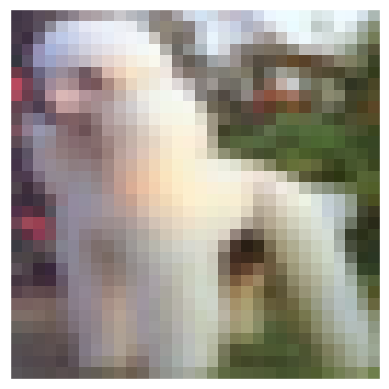

In [5]:
image_id = 520 # Image index in the test set
helper.plot_image(x_test[image_id])
#temp_img = Image.fromarray(x_test[image_id])
#temp_img.save("../Data_for_Paper/520.png", "png")

In [6]:
# this cell is added for test
print(type(x_test[0]))
print(type(y_test[0])) # blank image
temp_img = Image.fromarray(x_test[16])
print(x_test[16])
# temp_img2.show()
# print(temp_img.width)
# print(temp_img.height)
# temp_img.show()
# helper.plot_image(temp_img) # 얘는 걍 ndim array 넣어줘야 정상 작동하는듯??

<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
[[[ 95  76  78]
  [ 92  77  78]
  [ 89  77  77]
  ...
  [ 30  28  38]
  [175 183 191]
  [225 234 240]]

 [[ 90  71  73]
  [ 86  72  72]
  [ 83  71  71]
  ...
  [  0   0  13]
  [ 60  63  79]
  [165 171 189]]

 [[ 88  69  71]
  [ 84  70  70]
  [ 82  70  70]
  ...
  [  5   0  12]
  [ 24  26  48]
  [127 139 165]]

 ...

 [[203 176 161]
  [213 175 156]
  [202 165 155]
  ...
  [182 183 189]
  [118 120 125]
  [ 37  32  46]]

 [[123  94  90]
  [210 170 157]
  [211 171 160]
  ...
  [116 116 120]
  [ 44  45  47]
  [ 11   3  15]]

 [[102  85  84]
  [208 183 175]
  [215 186 176]
  ...
  [ 37  33  43]
  [ 17  13  22]
  [ 22  11  28]]]


## Image Perturbation

To begin, we need a function to modify one or more pixels in an image. 

We can define the perturbation of a pixel as a 5-tuple 

$$\textbf{x} = (x, y, r, g, b)$$

where $x, y$ are the coordinates of the pixel from 0 to 31, and $r,g,b$ are the red, green, and blue values from 0 to 255. Then multiple perturbations can simply be a concatenation of these tuples:

$$X = (x_1, y_1, r_1, g_1, b_1, x_2, y_2, r_2, g_2, b_2, ...)$$

We could instead use an array of tuples, but the optimization algorithm we will use requires it to be a flat 1-d vector.

Then the function to perturb an image can take as an input the image and $X$, and output a copy of the image with each pixel at $x_i, y_i$ modified to have the color $r_i, g_i, b_i$. To speed up computation, we will batch together an array of $X$ perturbations, denoted $X_S$.

In [7]:
def perturb_image(xs, img):
    # If this function is passed just one perturbation vector,
    # pack it in a list to keep the computation the same
    if xs.ndim < 2:
        xs = np.array([xs])
    
    # Copy the image n == len(xs) times so that we can 
    # create n new perturbed images
    tile = [len(xs)] + [1]*(xs.ndim+1)
    imgs = np.tile(img, tile)
    # numpy tile(A, repeat_shape)
    # A라는 array가 repeat_shape 모양으로 쌓이도록
    # 추후에 다시 보자..
    
    # Make sure to floor the members of xs as int types
    xs = xs.astype(int)
    
    for x,img in zip(xs, imgs):
        # Split x into an array of 5-tuples (perturbation pixels)
        # i.e., [[x,y,r,g,b], ...]
        pixels = np.split(x, len(x) // 5)
        # pixels = 5-tuple of perturb information (x,y,r,g,b) by kyle
        for pixel in pixels:
            # At each pixel's x,y position, assign its rgb value
            x_pos, y_pos, *rgb = pixel # *rgb = 뒤에 올 (r,g,b) 값을 가리킨다
            img[x_pos, y_pos] = rgb # perturb image by *rgb == (r,g,b) by kyle
    
    return imgs
    # Return value is array of perturbed images by xs
    # For example, if xs is [(16,16,255,255,0), (16,16,0,255,255)]
    # imgs is an array of perturbed image by xs[0], xs[1]. So it's size is 2 by kyle

Now we can modify the pixels of any image we want.

Let's modify our horse image by making pixel (16,16) yellow.

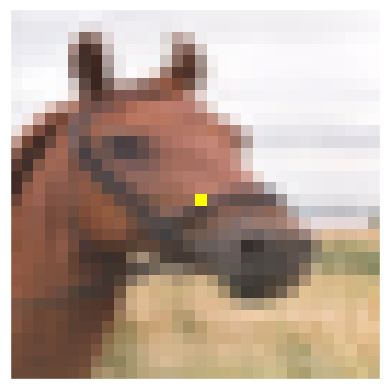

In [8]:
image_id = 99 # Image index in the test set
pixel = np.array([16, 16, 255, 255, 0]) # pixel = x,y,r,g,b
image_perturbed = perturb_image(pixel, x_test[image_id])[0]

helper.plot_image(image_perturbed)

## Load Models

To demonstrate the attack, we need some neural network models trained on the Cifar10 dataset. We will now load some pretrained models, which can be found in the `networks/models` directory.

It is recommended to use Keras with a GPU enabled. If you're [running in Google Colab](https://colab.research.google.com/drive/1Zq1kGP9C7i-70-SXyuEEaqYngtyQZMn7), you can enable a GPU instance by selecting `Runtime > Change runtime type > Hardware accelerator > GPU` (you will need to re-run all cells). The code below can be used to check (if using TensorFlow).

In [9]:
# Should output /device:GPU:0
#K.tensorflow_backend._get_available_gpus() #original
tf.compat.v1.disable_eager_execution()
tf.config.list_physical_devices('GPU')

[PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]

There are two models included in this repository, `lenet` and `resnet` which will be loaded from disk automatically.

Optionally, you may [download the larger, more accurate models](https://www.dropbox.com/sh/dvatkpjl0sn79kn/AAC9L4puJ_sdFUkDZfr5SFkLa?dl=0) (e.g., Capsule Network, DenseNet, etc.). Make sure to copy the models into the `networks/models/` directory. Then uncomment the lines below and run the cell to load the models of your choosing.

In [10]:
lenet = LeNet()
resnet = ResNet()

# originally, lenet and resnet

## Uncomment below to load more models to play with. Make sure the model files exist by training or downloading them.

# lenet = LeNet()
pure_cnn = PureCnn()
net_in_net = NetworkInNetwork()
# resnet = ResNet()
densenet = DenseNet()
wide_resnet = WideResNet()
# capsnet = CapsNet()
# models = [lenet, resnet, wide_resnet]

models = [lenet, pure_cnn, net_in_net, resnet, densenet, wide_resnet]

Metal device set to: Apple M1
Successfully loaded lenet


2023-09-06 14:04:16.016408: W tensorflow/tsl/platform/profile_utils/cpu_utils.cc:128] Failed to get CPU frequency: 0 Hz
2023-09-06 14:04:16.048253: W tensorflow/c/c_api.cc:300] Operation '{name:'dense_3/bias/Assign' id:115 op device:{requested: '', assigned: ''} def:{{{node dense_3/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](dense_3/bias, dense_3/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-09-06 14:04:16.152730: W tensorflow/c/c_api.cc:300] Operation '{name:'dense_3/bias/momentum/Assign' id:375 op device:{requested: '', assigned: ''} def:{{{node dense_3/bias/momentum/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](dense_3/bias/momentum, dense_3/bias/momentum/Initializer/

Instructions for updating:
Colocations handled automatically by placer.


2023-09-06 14:04:17.219121: W tensorflow/c/c_api.cc:300] Operation '{name:'batch_normalization_29/beta/Assign' id:2478 op device:{requested: '', assigned: ''} def:{{{node batch_normalization_29/beta/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](batch_normalization_29/beta, batch_normalization_29/beta/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-09-06 14:04:17.842840: W tensorflow/c/c_api.cc:300] Operation '{name:'conv2d_27/kernel/momentum/Assign' id:4512 op device:{requested: '', assigned: ''} def:{{{node conv2d_27/kernel/momentum/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](conv2d_27/kernel/momentum, conv2d_27/kernel/momentum/Initializer/zeros)}}' was changed by setting attribute

Successfully loaded resnet


2023-09-06 14:04:18.459067: W tensorflow/c/c_api.cc:300] Operation '{name:'conv2d_6_1/bias/Assign' id:5357 op device:{requested: '', assigned: ''} def:{{{node conv2d_6_1/bias/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](conv2d_6_1/bias, conv2d_6_1/bias/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-09-06 14:04:18.775271: W tensorflow/c/c_api.cc:300] Operation '{name:'conv2d_2_2/bias/m/Assign' id:5643 op device:{requested: '', assigned: ''} def:{{{node conv2d_2_2/bias/m/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](conv2d_2_2/bias/m, conv2d_2_2/bias/m/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trig

Successfully loaded pure_cnn


2023-09-06 14:04:19.457461: W tensorflow/c/c_api.cc:300] Operation '{name:'conv2d_9_2/kernel/Assign' id:6584 op device:{requested: '', assigned: ''} def:{{{node conv2d_9_2/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](conv2d_9_2/kernel, conv2d_9_2/kernel/Initializer/stateless_truncated_normal)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-09-06 14:04:19.880659: W tensorflow/c/c_api.cc:300] Operation '{name:'conv2d_7_2/kernel/momentum/Assign' id:7206 op device:{requested: '', assigned: ''} def:{{{node conv2d_7_2/kernel/momentum/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](conv2d_7_2/kernel/momentum, conv2d_7_2/kernel/momentum/Initializer/zeros)}}' was changed by setting attribute after it was r

Successfully loaded net_in_net


2023-09-06 14:04:23.269354: W tensorflow/c/c_api.cc:300] Operation '{name:'batch_normalization_88/moving_mean/Assign' id:13017 op device:{requested: '', assigned: ''} def:{{{node batch_normalization_88/moving_mean/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](batch_normalization_88/moving_mean, batch_normalization_88/moving_mean/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-09-06 14:04:25.153532: W tensorflow/c/c_api.cc:300] Operation '{name:'batch_normalization_28_1/beta/momentum/Assign' id:17637 op device:{requested: '', assigned: ''} def:{{{node batch_normalization_28_1/beta/momentum/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](batch_normalization_28_1/beta/momentum, batch_norma

Successfully loaded densenet


2023-09-06 14:04:27.329089: W tensorflow/c/c_api.cc:300] Operation '{name:'conv2d_13_2/kernel/Assign' id:20756 op device:{requested: '', assigned: ''} def:{{{node conv2d_13_2/kernel/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](conv2d_13_2/kernel, conv2d_13_2/kernel/Initializer/stateless_truncated_normal)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2023-09-06 14:04:28.744289: W tensorflow/c/c_api.cc:300] Operation '{name:'conv2d_12_2/kernel/momentum/Assign' id:22089 op device:{requested: '', assigned: ''} def:{{{node conv2d_12_2/kernel/momentum/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](conv2d_12_2/kernel/momentum, conv2d_12_2/kernel/momentum/Initializer/zeros)}}' was changed by setting attribute afte

Successfully loaded wide_resnet


Note that there are even more networks available in the `networks` directory, but must be trained before loading them here.

### Calculate Model Accuracies

After loading the models, we would like to evaluate all test images with each model to ensure that we only attack the images which have been classified correctly. The code below will also display the accuracy and number of parameters of each model.

In [11]:
network_stats, correct_imgs = helper.evaluate_models(models, x_test, y_test)
correct_imgs = pd.DataFrame(correct_imgs, columns=['name', 'img', 'label', 'confidence', 'pred'])
network_stats = pd.DataFrame(network_stats, columns=['name', 'accuracy', 'param_count'])

network_stats

Evaluating lenet


/opt/homebrew/Caskroom/miniforge/base/lib/python3.9/site-packages/keras/engine/training_v1.py:2359: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates=self.state_updates,
2023-09-06 14:04:29.945969: W tensorflow/c/c_api.cc:300] Operation '{name:'dense_3/Softmax' id:121 op device:{requested: '', assigned: ''} def:{{{node dense_3/Softmax}} = Softmax[T=DT_FLOAT, _has_manual_control_dependencies=true](dense_3/BiasAdd)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


Evaluating pure_cnn


2023-09-06 14:04:31.626248: W tensorflow/c/c_api.cc:300] Operation '{name:'activation_3_1/Softmax' id:5446 op device:{requested: '', assigned: ''} def:{{{node activation_3_1/Softmax}} = Softmax[T=DT_FLOAT, _has_manual_control_dependencies=true](global_average_pooling2d_1_1/Mean)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


Evaluating net_in_net


2023-09-06 14:04:36.657998: W tensorflow/c/c_api.cc:300] Operation '{name:'activation_10_1/Softmax' id:6645 op device:{requested: '', assigned: ''} def:{{{node activation_10_1/Softmax}} = Softmax[T=DT_FLOAT, _has_manual_control_dependencies=true](global_average_pooling2d_1_2/Mean)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


Evaluating resnet


2023-09-06 14:04:42.909348: W tensorflow/c/c_api.cc:300] Operation '{name:'dense_1_1/Softmax' id:2683 op device:{requested: '', assigned: ''} def:{{{node dense_1_1/Softmax}} = Softmax[T=DT_FLOAT, _has_manual_control_dependencies=true](dense_1_1/BiasAdd)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


Evaluating densenet


2023-09-06 14:04:46.721264: W tensorflow/c/c_api.cc:300] Operation '{name:'dense_1_2/Softmax' id:13845 op device:{requested: '', assigned: ''} def:{{{node dense_1_2/Softmax}} = Softmax[T=DT_FLOAT, _has_manual_control_dependencies=true](dense_1_2/BiasAdd)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


Evaluating wide_resnet


2023-09-06 14:05:15.106575: W tensorflow/c/c_api.cc:300] Operation '{name:'dense_1_3/Softmax' id:21166 op device:{requested: '', assigned: ''} def:{{{node dense_1_3/Softmax}} = Softmax[T=DT_FLOAT, _has_manual_control_dependencies=true](dense_1_3/BiasAdd)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


,name,accuracy,param_count
0,lenet,0.7488,62006
1,pure_cnn,0.8877,1369738
2,net_in_net,0.9074,972658
3,resnet,0.9231,470218
4,densenet,0.9467,850606
5,wide_resnet,0.9534,11318026


### Prediction Function

For the black-box attack, all we should care about is the inputs to the model (the images), and the outputs of the model (the prediction probabilities). No special information about the model is required; we could even swap it with a model that is not a neural network.

Define a function that runs several perturbed images on a given model and returns the model's confidence (probability output) in the target class, one confidence value per image. If the target class is the correct class, this will be the function that we want to minimize so that the model will be most confident in another class (which is incorrect). Otherwise, the target is an incorrect class and we will want to maximize it.

In [12]:
def predict_classes(xs, img, target_class, model, minimize=True):
    # Perturb the image with the given pixel(s) x and get the prediction of the model
    imgs_perturbed = perturb_image(xs, img)
    predictions = model.predict(imgs_perturbed)[:,target_class]
    # Target class의 값만 뽑아내는 용(파이썬 문법)
    # This function should always be minimized, so return its complement if needed
    return predictions if minimize else 1 - predictions
    # optimization을 풀 때 최솟값으로 풀지 최댓값으로 풀지 보통 정해진다.
    # DE의 기본 format은 minimize를 하는데에 초점이 맞춰져 있다.
    # 만약 targetted라면, target의 confidence를 높이는게 최우선이니 보수를 리턴
    # 아니라면, 내 클래스의 confidence를 낮추는게 우선이니 그냥 리턴

Below we can modify a pixel in an image and see how the confidence of the model changes. In almost all cases, the confidence will not change. However, for very special cases it will change drastically.
#If(untargetted) -> 1-predictions?
내 class의 확률을 낮추고 싶을 때 --> prediction
다르게 인식시키고 싶을 때 --> 1-prediction

<class 'numpy.ndarray'>
Confidence in true class frog is 0.9999999
Prior confidence was 1.0


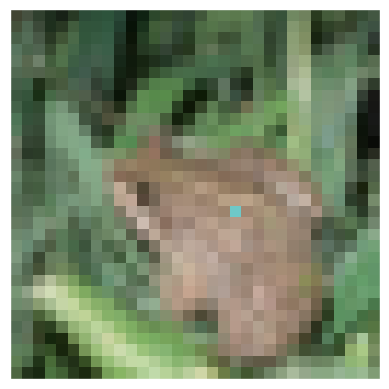

In [13]:
image_id = 4
pixel = np.array([17, 19, 110, 200, 200])
model = resnet

true_class = y_test[image_id, 0]
prior_confidence = model.predict_one(x_test[image_id])[true_class]
confidence = predict_classes(pixel, x_test[image_id], true_class, model)[0]

print(type(model.predict_one(x_test[image_id])))

print('Confidence in true class', class_names[true_class], 'is', confidence)
print('Prior confidence was', prior_confidence)
helper.plot_image(perturb_image(pixel, x_test[image_id])[0])

Confidence in true class dog is [0.9999331]
Prior confidence was 0.9999733


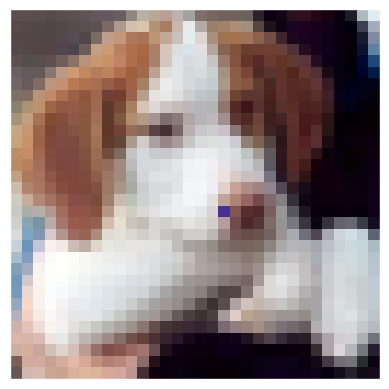

[95 76 78]
[[5, 17, 0.1811955], [6, 14, 0.09939861], [6, 18, 0.09784567], [6, 11, 0.09445697], [6, 17, 0.08650726], [22, 19, 0.06840348], [5, 18, 0.056456804], [3, 12, 0.054075778], [2, 13, 0.053829193], [6, 16, 0.043830395], [7, 12, 0.03764987], [7, 18, 0.035319984], [21, 18, 0.033661485], [6, 13, 0.028870344], [4, 12, 0.02490896], [20, 19, 0.023458362], [5, 14, 0.02083826], [4, 16, 0.01681012], [4, 17, 0.013578534], [5, 13, 0.011624873], [3, 17, 0.010395229], [22, 18, 0.010021746], [4, 14, 0.009427905], [20, 21, 0.009285331], [22, 17, 0.008374929], [1, 10, 0.007924736], [3, 13, 0.0077269673], [7, 11, 0.0075244904], [19, 20, 0.007447958], [20, 20, 0.007189393]]


In [14]:
# this cell is for test
image_id_1 = 16
pixel_1 = np.array([17, 18, 70, 50, 150])
# model = resnet

true_class_1 = y_test[image_id_1, 0]
prior_confidence_1 = model.predict_one(x_test[image_id_1])[true_class_1]
confidence_after_perturb = predict_classes(pixel_1, x_test[image_id_1], true_class_1, model)

print('Confidence in true class', class_names[true_class_1], 'is', confidence_after_perturb)
print('Prior confidence was', prior_confidence_1)
helper.plot_image(perturb_image(pixel_1, x_test[image_id_1]))

print(x_test[image_id_1][0][0])

# pixel_value is triple of (r,g,b) value, img's type is nd.array // 추후 여기 분리하자
def sensitive_pixel_sorting(image_id):
    img = x_test[image_id].copy()
    target_class = y_test[image_id, 0]

    diff_list = [[0,0,0]]

    prior_confidence =  model.predict_one(img)[target_class]

    rgb = [0, 0, 0]

    for x in range(32):
        for y in range(32):

          for i in range(3):
              if img[x][y][i] >= 128:
                rgb[i] = 0
              else:
                rgb[i] = 255

          pixel = np.array([x, y,  rgb[0], rgb[1], rgb[2]])
          perturbed_image = perturb_image(pixel, img)
          
          after_confidence =  model.predict_one(perturbed_image)[target_class]
          diff_confidence = abs(after_confidence - prior_confidence)

          if diff_confidence > 0:
              for diff_index in range(len(diff_list)):
                  if diff_confidence >= diff_list[diff_index][2]:
                      diff_list.insert(diff_index, [x, y, diff_confidence])
                      if (len(diff_list) > 30):
                          diff_list.pop()
                      break
    return diff_list

diff_list = sensitive_pixel_sorting(16)
print(diff_list)

In [15]:
# To check confidence score and class of images

con_high_list = [] # 60~99%
con_middle_list = [] # 20~59%
con_low_list = [] # 0~19%


for i in range (4000):
    image_id = i
    true_class = y_test[image_id, 0]
    confidence_score = model.predict_one(x_test[image_id])[true_class]
    # print(confidence_score)
    if confidence_score * 100 >= 60:
        con_high_list.append(i)
    elif 20 <= confidence_score * 100 < 60:
        con_middle_list.append(i)
    else:
        con_low_list.append(i)
    
# print(image_list[16])
# print(confidence_list[16])

print(len(con_high_list))
print(len(con_middle_list))
print(len(con_low_list))




def change_one(change_color, image_id, true_class, stride, pixel_stride):
    x_coord = []

    for i in range(256 // stride):
        x_coord.append(i*4)
    img = x_test[image_id].copy()
    graph_color = 'red'
    original_confidence = model.predict_one(x_test[image_id])[true_class]
    if change_color == 'r':
        target = 2
    elif change_color == 'g':
        target = 3
        graph_color = 'blue'
    elif change_color == 'b':
        target = 4
        graph_color = 'green'
    for i in range(0, 32, pixel_stride):
        for j in range(0, 32, pixel_stride):
            for k in range(256 // stride):
                original_rgb_value = img[i][j]
                pixel = np.array([i, j, img[i][j][0], img[i][j][1], img[i][j][2]])
                pixel[target] = k * stride # 0, 4, ... , 252
                perturbed_confidence = model.predict_one(perturb_image(pixel, img))[true_class]
                # confidence_difference = abs(original_confidence - perturbed_confidence)
                change_confidence_list.append(perturbed_confidence)
    j = 0
    k = -4
    for i in range(64):
        if i%8 == 0:
            k += 4
        plt.plot(x_coord, change_confidence_list[(256 // stride) * i: (256 // stride) * (i+1)], color = graph_color, linestyle = '--', marker = 'o')
        plt.xlabel("rgb value")
        plt.ylabel("confidence score difference")
        plt.title((k,j))
        plt.show()
        j += 4
        if j%32 == 0:
            j = 0

            
# change_one('r', 384, true_class, 4, 4)
            
def change_sensitive(change_color, image_id, true_class, stride):
    x_coord = []

    for i in range(256 // stride):
        x_coord.append(i*4)
    s_list = sensitive_pixel_sorting(image_id)
    img = x_test[image_id].copy()
    graph_color = 'red'
    original_confidence = model.predict_one(x_test[image_id])[true_class]
    if change_color == 'r':
        target = 2
    elif change_color == 'g':
        target = 3
        graph_color = 'blue'
    elif change_color == 'b':
        target = 4
        graph_color = 'green'
    for i in range(30):
        sensitive_x = s_list[i][0]
        sensitive_y = s_list[i][1]
        for k in range(256 // stride):
            original_rgb_value = img[sensitive_x][sensitive_y]
            pixel = np.array([sensitive_x, sensitive_y, img[sensitive_x][sensitive_y][0], img[sensitive_x][sensitive_y][1], img[sensitive_x][sensitive_y][2]])
            pixel[target] = k * stride
            perturbed_confidence = model.predict_one(perturb_image(pixel, img))[true_class]
            # confidence_difference = abs(original_confidence - perturbed_confidence)
            s_change_confidence_list.append(perturbed_confidence)
            
    for i in range(30):
        sensitive_x = s_list[i][0]
        sensitive_y = s_list[i][1]
        plt.plot(x_coord, s_change_confidence_list[(256 // stride) * i: (256 // stride) * (i+1)], color = graph_color, linestyle = '--', marker = 'o')
        plt.xlabel("rgb value")
        plt.ylabel("confidence score difference")
        plt.title((sensitive_x,sensitive_y))
        plt.show() 

#change_sensitive('r', 384, true_class, 4)    





3666
93
241


In [16]:
# This cell is for sensitivity maps

def pixel_confidence(image_id):
    img_original = x_test[image_id].copy()
    img_confidence = x_test[image_id].copy()
    target_class = y_test[image_id, 0]

    helper.plot_image(img_original)

    prior_confidence =  model.predict_one(img_original)[target_class]

    diff_list = [[0,0,0]]
    rgb = [0, 0, 0]

    for x in range(32):
        for y in range(32):
            for i in range(3):
                if img_original[x][y][i] >= 128:
                    rgb[i] = 0
                else:
                    rgb[i] = 255

            pixel = np.array([x, y,  rgb[0], rgb[1], rgb[2]])
            perturbed_image = perturb_image(pixel, img_original)

            after_confidence =  model.predict_one(perturbed_image)[target_class]
            diff_confidence = abs(after_confidence - prior_confidence)

            img_confidence = perturb_image(np.array([x, y,  255 - diff_confidence * 255, 255 - diff_confidence * 255, 255 - diff_confidence * 255]), img_confidence)
    # ----- top 30 or all
    
            if(diff_confidence > 0):
                   for diff_index in range(len(diff_list)):
                    if diff_confidence >= diff_list[diff_index][2]:
                        diff_list.insert(diff_index, [x, y, diff_confidence])
                    if (len(diff_list) > 30):
                        diff_list.pop()
                        break

    for i in range(30):
         img_confidence = perturb_image(np.array([diff_list[i][0], diff_list[i][1],  (30- i) * 8.5, 0, 0]), img_confidence)
    # ------
    print(diff_list)
    helper.plot_image(img_confidence)
    #print(type(img_confidence))

In [17]:
# test for sensitivity maps

#pixel_confidence(20)
#pixel_confidence(25)
#pixel_confidence(87)
#pixel_confidence(125)
#pixel_confidence(368)
#pixel_confidence(384)
#pixel_confidence(520)

In [18]:
# Cell for plot change_one

image_id = 384
true_class = y_test[image_id, 0]
original_confidence = model.predict_one(x_test[image_id])[true_class] # [4] is a cat
s_change_confidence_list = []
change_confidence_list = []
stride = 4
pixel_stride = 4

#change_one('r', image_id, true_class, stride, pixel_stride)
#change_sensitive('r', image_id, true_class, stride)

In [19]:
# Cell for plot change_sensitive

image_id = 384
true_class = y_test[image_id, 0]
original_confidence = model.predict_one(x_test[image_id])[true_class] # [4] is a cat
s_change_confidence_list = []
change_confidence_list = []
stride = 4
pixel_stride = 4

#change_one('r', image_id, true_class, stride, pixel_stride)
#change_sensitive('r', image_id, true_class, stride)

In [20]:

def change_two(change_color1, change_color2, model, image_id, true_class, stride, pixel_stride):
    x_coord = []
    y_coord = []
    change_confidence_list_2 = []
    """
    for i in range(256 // stride):
        x_coord.append(i*stride)
    for i in range(256 // stride):
        y_coord.append(i*stride)
    """
    img = x_test[image_id].copy()
    graph_color = 'red'
    original_confidence = model.predict_one(x_test[image_id])[true_class]
    if change_color1 == change_color2:
        print("same color")
        return;
    if change_color1 == 'r':
        target1 = 2
    elif change_color1 == 'g':
        target1 = 3
        graph_color = 'blue'
    elif change_color1 == 'b':
        target1 = 4
        graph_color = 'green'
    if change_color2 == 'r':
        target2 = 2
    elif change_color2 == 'g':
        target2 = 3
        graph_color = 'blue'
    elif change_color2 == 'b':
        target2 = 4
        graph_color = 'green'
    for i in range(0, 32, pixel_stride):
        for j in range(0, 32, pixel_stride):
            for rgb_x in range(0, 256, stride):
                original_rgb_value = img[i][j]
                pixel = np.array([i, j, img[i][j][0], img[i][j][1], img[i][j][2]])
                pixel[target1] = rgb_x * stride # 0, 4, ... , 252
                for rgb_y in range(0, 256, stride):
                    x_coord.append(rgb_x)
                    y_coord.append(rgb_y)
                    pixel[target2] = rgb_y * stride # 0, 4, ... , 252
                    perturbed_confidence = model.predict_one(perturb_image(pixel, img))[true_class]
                    # confidence_difference = abs(original_confidence - perturbed_confidence)
                    change_confidence_list_2.append(perturbed_confidence)
    
    print(len(x_coord))
    print(len(y_coord))
    print(len(change_confidence_list_2))
    
    for i in range(pixel_stride * pixel_stride):
        graph_1 = plt.figure(1)
        graph_2 = graph_1.add_subplot(111, projection = '3d')
        graph_2.scatter(x_coord[pow((256 // stride), 2) * i: pow((256 // stride), 2) * (i+1)], y_coord[pow((256 // stride), 2) * i: pow((256 // stride), 2) * (i+1)], change_confidence_list_2[pow((256 // stride), 2) * i: pow((256 // stride), 2) * (i+1)], 'r', linestyle = '--', marker = 'o')
        graph_2.set_xlabel(change_color1)
        graph_2.set_ylabel(change_color2)
        graph_2.set_zlabel('perturbed confidence')
        # graph_2.plot_surface(x_coord, y_coord, change_confidence_list_2[(256 // stride) * i: (256 // stride) * (i+1)], cmap = "brg_r")
        #plt.title('perturbed confidence')
        plt.show()
    

In [21]:
global gnumber
gnumber = 0
def change_two_test(change_color1, change_color2, remained_color, model, image_id, true_class, stride, x, y, remained_rgb, step_color, original):
    x_coord = []
    y_coord = []
    change_confidence_list_2 = []
    x_label = None
    Y_label = None
    z_label = "Confidence score"
    
    global gnumber
    img = x_test[image_id].copy()
    graph_color = 'red'
    original_confidence = model.predict_one(x_test[image_id])[true_class]
    
    if change_color1 == change_color2:
        print("same color")
        return;
    if change_color1 == 'r':
        target1 = 2
        x_label = "Red"
    elif change_color1 == 'g':
        target1 = 3
        x_label = "Green"
    elif change_color1 == 'b':
        target1 = 4
        x_label = "Blue"
    if change_color2 == 'r':
        target2 = 2
        y_label = "Red"
    elif change_color2 == 'g':
        target2 = 3
        y_label = "Green"
    elif change_color2 == 'b':
        target2 = 4
        y_label = "Blue"
    if remained_color == 'r':
        target3 = 2
    elif remained_color == 'g':
        target3 = 3
    elif remained_color == 'b':
        target3 = 4
    pixel = np.array([x, y, img[x][y][0], img[x][y][1], img[x][y][2]])
    for rgb_x in range(0, 256, stride):
        pixel[target1] = rgb_x # 0, 4, ... , 252
        for rgb_y in range(0, 256, stride):
            x_coord.append(rgb_x)
            y_coord.append(rgb_y)
            pixel[target2] = rgb_y # 0, 4, ... , 252
            pixel[target3] = remained_rgb
            perturbed_confidence = model.predict_one(perturb_image(pixel, img))[true_class]
            # confidence_difference = abs(original_confidence - perturbed_confidence)
            change_confidence_list_2.append(perturbed_confidence)
    
    
    graph_1 = plt.figure(1)
    graph_2 = graph_1.add_subplot(111, projection = '3d')
    graph_2.scatter(x_coord, y_coord, change_confidence_list_2, 'r', alpha = 0.5)
    graph_2.set_xlabel(x_label)
    graph_2.set_ylabel(y_label)
    graph_2.set_zlabel(z_label)
    if original == 'original':
        plt.savefig('./graph_' + str(image_id) + '_' + step_color + '_' +  original + '.png', bbox_inches = 'tight', pad_inches = 0.25)
    else:
        plt.savefig('./graph_' + str(image_id) + '_' + step_color + '_' +  str(remained_rgb) + '.png',bbox_inches = 'tight', pad_inches = 0.25)
    gnumber += 1
    plt.show()
    

In [246]:
#list1 = sensitive_pixel_sorting(384) # high confidence, bird
#print(list1)
#list2 = sensitive_pixel_sorting(1470) # low confidence, horse
#list3 = sensitive_pixel_sorting(4) # high confidence, frog
#print(list3)
#list4 = sensitive_pixel_sorting(771) # middle confidence, automobile
#print(list4)
#list4 = sensitive_pixel_sorting(1492) # middle confidence, truck
#print(list4)
image_id = 384
list4 = sensitive_pixel_sorting(image_id) # middle confidence, horse
print(list4)
print("\n\n\n")
sensitive_x = list4[11][0]
sensitive_y = list4[11][1]
print(sensitive_x)
print(sensitive_y)
#print(list2)

[[16, 13, 0.7065553], [17, 15, 0.70654714], [16, 12, 0.7064547], [15, 14, 0.7063695], [16, 14, 0.7063457], [18, 13, 0.70632], [15, 12, 0.7062548], [14, 15, 0.7062262], [13, 15, 0.7061345], [14, 14, 0.7061022], [14, 13, 0.70606136], [17, 13, 0.7059981], [18, 12, 0.7058054], [17, 12, 0.7057074], [15, 13, 0.70558375], [14, 12, 0.7054256], [12, 14, 0.7054158], [17, 14, 0.70184577], [13, 14, 0.7009566], [12, 13, 0.70007956], [27, 14, 0.6989042], [11, 13, 0.696449], [16, 15, 0.6958393], [28, 12, 0.6941298], [15, 16, 0.6938345], [22, 20, 0.6917767], [28, 13, 0.6908335], [29, 12, 0.68843883], [28, 14, 0.68795294], [21, 20, 0.6875751]]




17
13


[197 189 158]


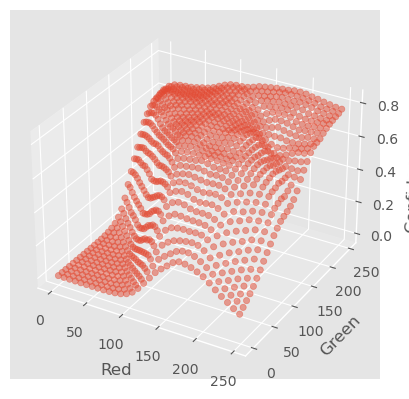


from here, blue will changed with stride 10




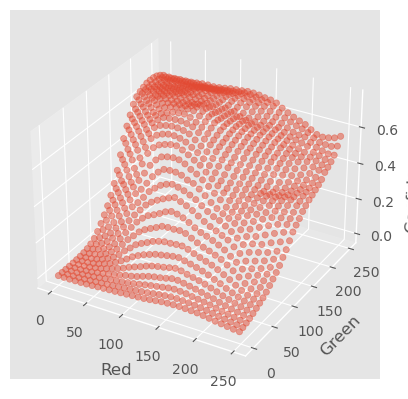

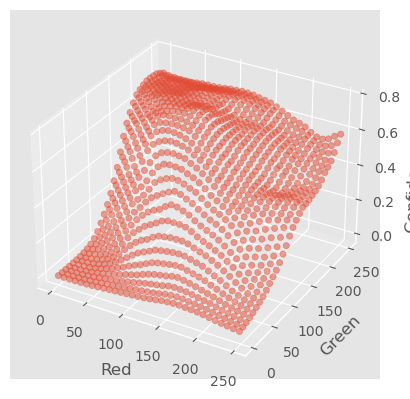

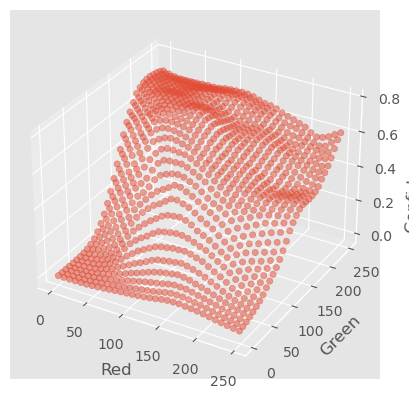

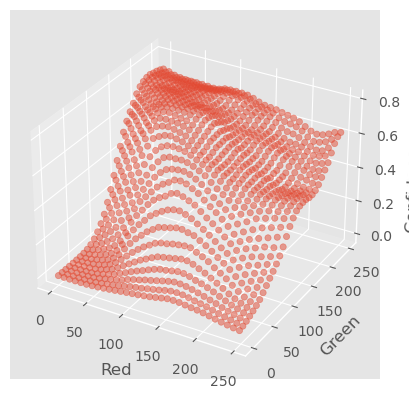

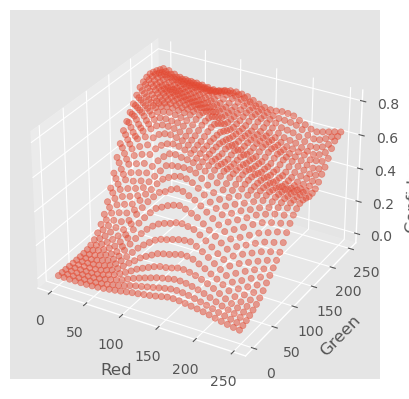

...

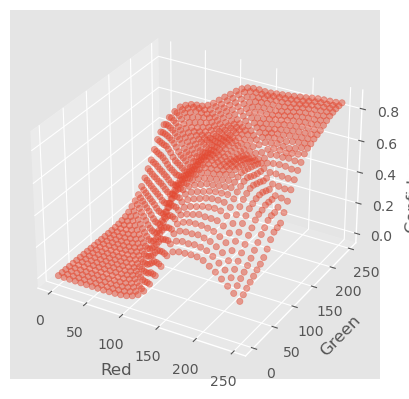

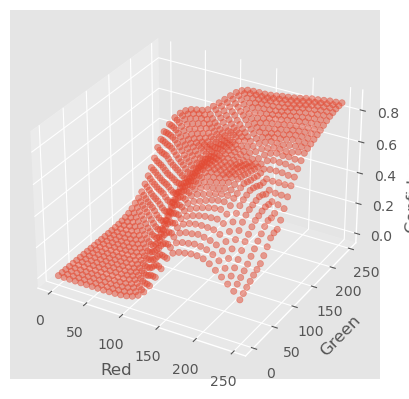

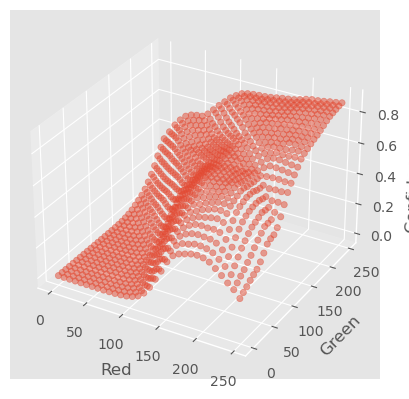

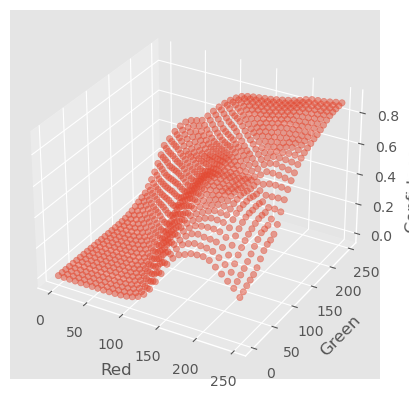

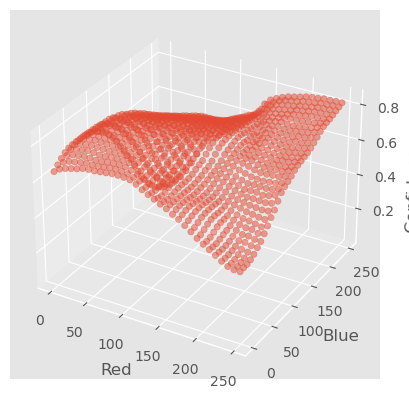


from here, green will changed with stride 10




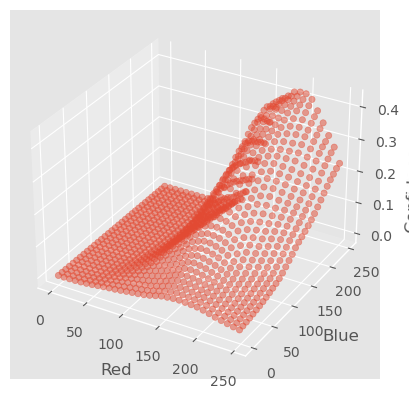

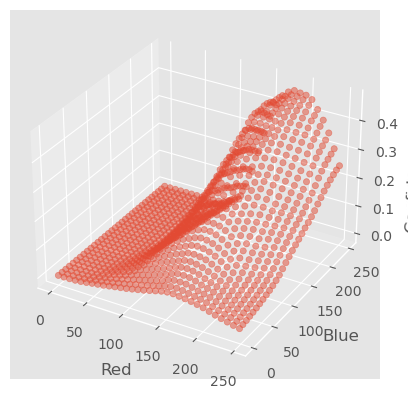

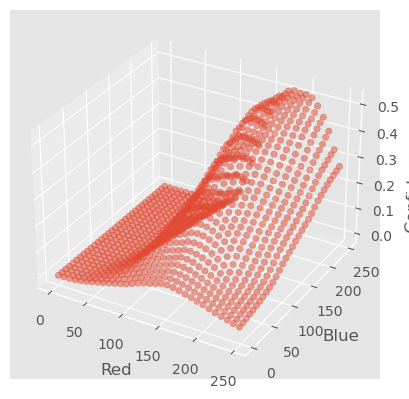

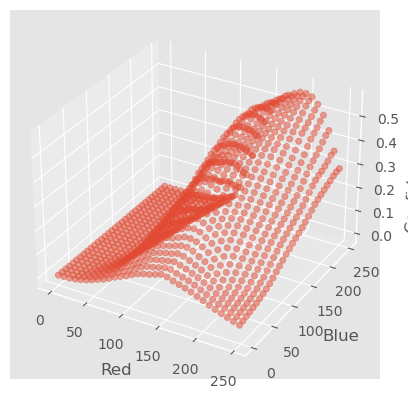

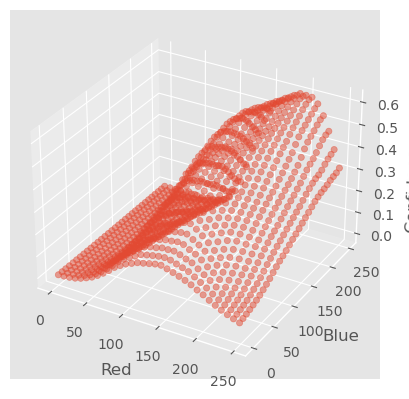

...

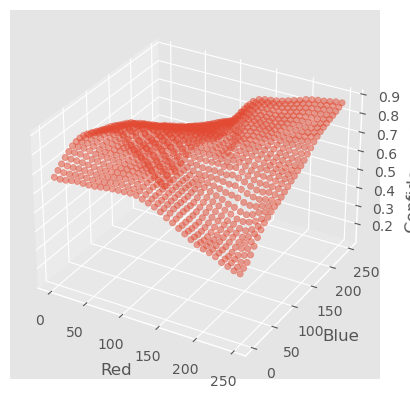

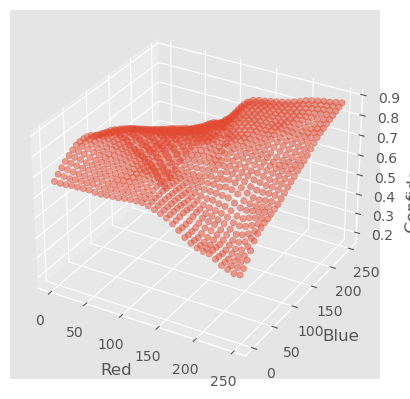

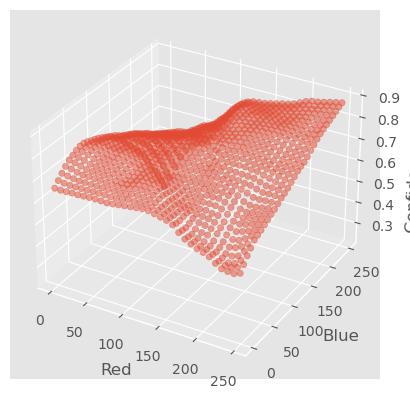

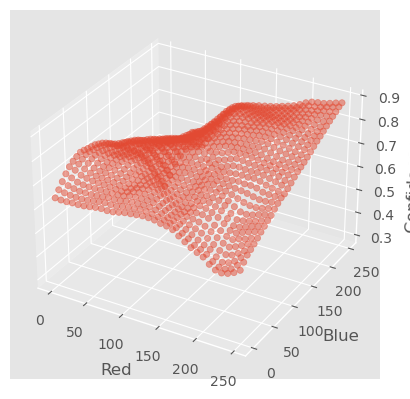

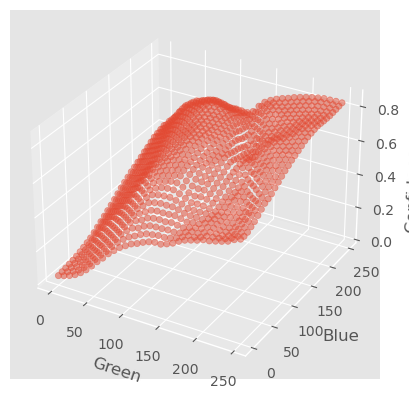


from here, red will changed with stride 10




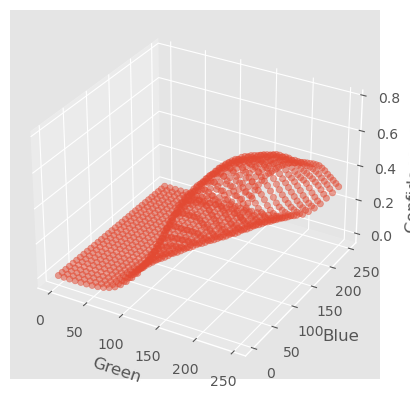

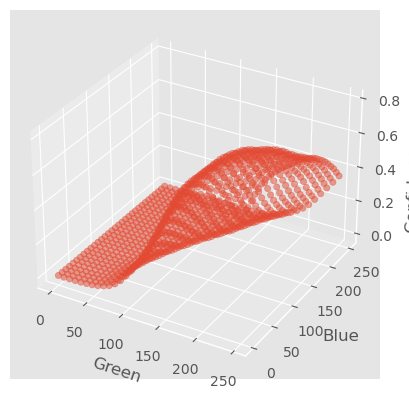

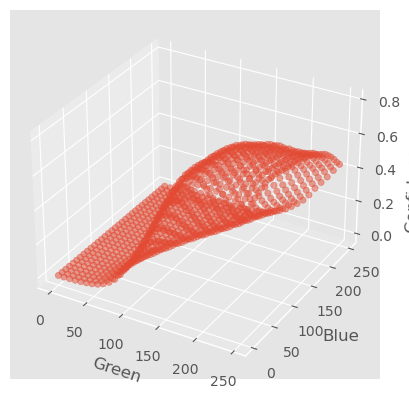

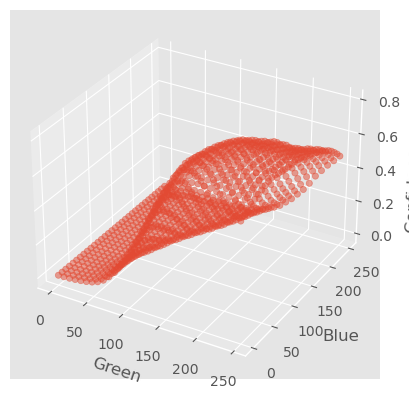

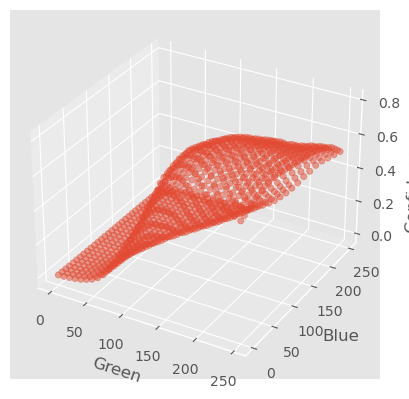

...

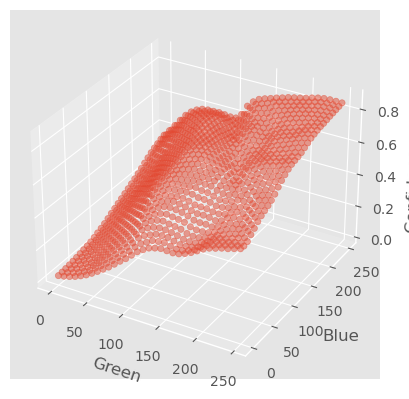

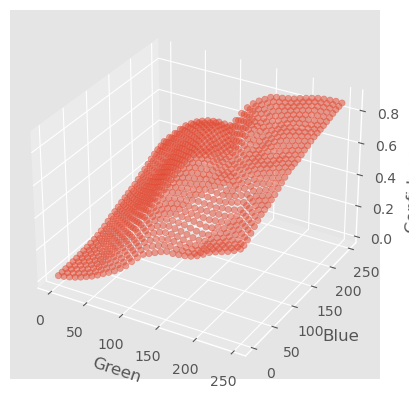

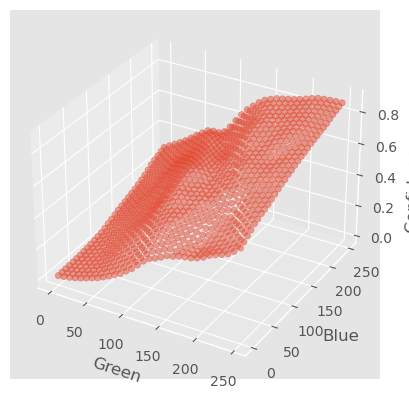

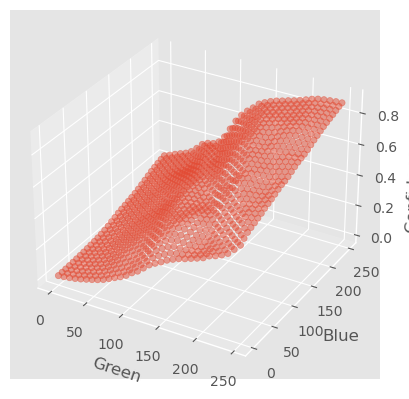

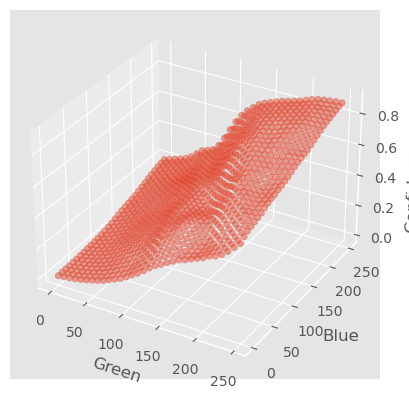

'\n#from here, random piexl and r,g are main\nchange_two_test(\'r\', \'g\', \'b\', graph_model, image_id, true_class, stride, 16, 17, random_rgb[2]) # sensitive\nprint("\nfrom here, blue will changed with stride 10, random pixel\n\n")\nfor remained_rgb in range(0, 255, 10):\n    change_two_test(\'r\', \'g\', \'b\', graph_model, image_id, true_class, stride, 16, 17, remained_rgb) # r,g\n#change_two_test(\'r\', \'b\', graph_model, image_id, true_class, stride, 16, 17) # random\n#change_two_test(\'r\', \'b\', graph_model, image_id, true_class, stride, 24, 12) # weired\n'

In [247]:
# high confidence image
true_class = y_test[image_id, 0]
stride = 8
test_image = x_test[image_id].copy()
sensitive_rgb = test_image[sensitive_x][sensitive_y] # most sensitive coordinate
print(sensitive_rgb)

random_rgb = test_image[16][17] # random coordinate
# pixel_stride = 8
graph_model = resnet
# print(sensitive_pixel_sorting(384))
# change_two('r', 'g', graph_model, image_id, true_class, stride, pixel_stride)



# ------------

# r,g are main
change_two_test('r', 'g', 'b', graph_model, image_id, true_class, stride, sensitive_x, sensitive_y, sensitive_rgb[2], 'blue', 'original') # sensitive
print("\nfrom here, blue will changed with stride 10\n\n")
for remained_rgb in range(0, 255, 10):
    change_two_test('r', 'g', 'b', graph_model, image_id, true_class, stride, sensitive_x, sensitive_y, remained_rgb, 'blue', 'n') # r,g



# -------------    
    
# r,b are main
change_two_test('r', 'b', 'g', graph_model, image_id, true_class, stride, sensitive_x, sensitive_y, sensitive_rgb[1], 'green', 'original') # sensitive
print("\nfrom here, green will changed with stride 10\n\n")
for remained_rgb in range(0, 255, 10):
    change_two_test('r', 'b', 'g', graph_model, image_id, true_class, stride, sensitive_x, sensitive_y, remained_rgb, 'green', 'n') # r,b

# --------------    


# g,b are main
change_two_test('g', 'b', 'r', graph_model, image_id, true_class, stride, sensitive_x, sensitive_y, sensitive_rgb[0], 'red', 'original') # sensitive
print("\nfrom here, red will changed with stride 10\n\n")
for remained_rgb in range(0, 255, 10):
    change_two_test('g', 'b', 'r', graph_model, image_id, true_class, stride, sensitive_x, sensitive_y, remained_rgb, 'red', 'n') # r,g
    if(remained_rgb == 250):
        change_two_test('g', 'b', 'r', graph_model, image_id, true_class, stride, sensitive_x, sensitive_y, 255, 'red', 'n')

# --------------




"""
#from here, random piexl and r,g are main
change_two_test('r', 'g', 'b', graph_model, image_id, true_class, stride, 16, 17, random_rgb[2]) # sensitive
print("\nfrom here, blue will changed with stride 10, random pixel\n\n")
for remained_rgb in range(0, 255, 10):
    change_two_test('r', 'g', 'b', graph_model, image_id, true_class, stride, 16, 17, remained_rgb) # r,g
#change_two_test('r', 'b', graph_model, image_id, true_class, stride, 16, 17) # random
#change_two_test('r', 'b', graph_model, image_id, true_class, stride, 24, 12) # weired
"""




In [22]:
# Test cell for graph padding

# change_two_test('r', 'g', 'b', graph_model, image_id, true_class, stride, sensitive_x, sensitive_y, 255, 'blue', 'n')

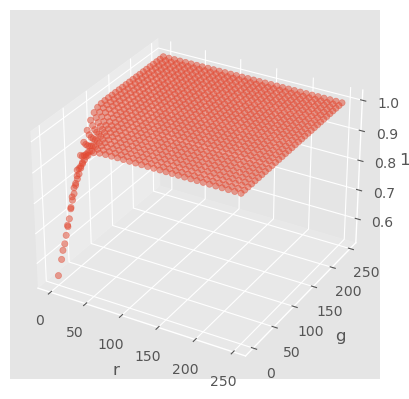


from here, blue will changed with stride 10




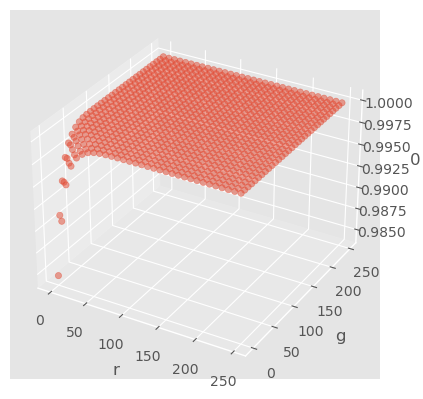

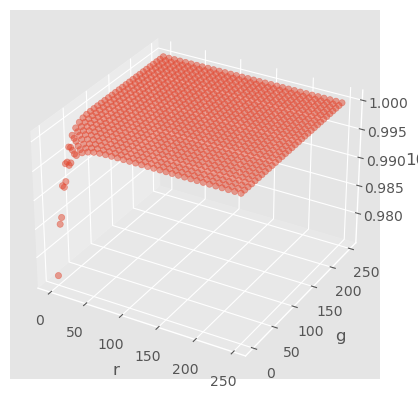

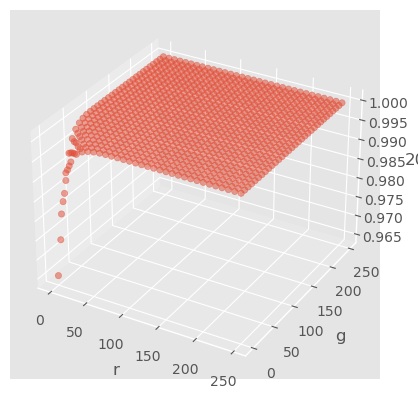

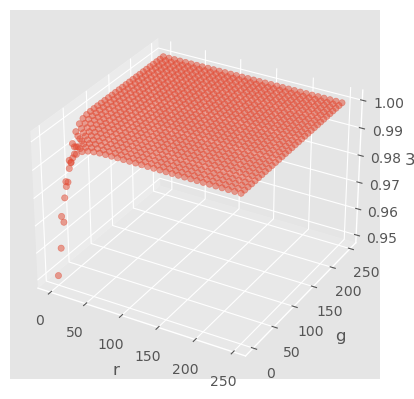

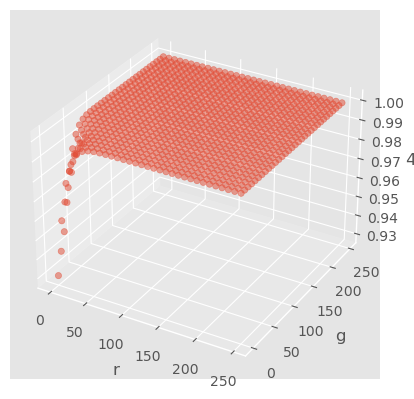

...

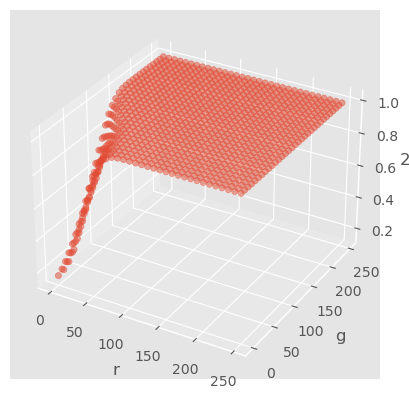

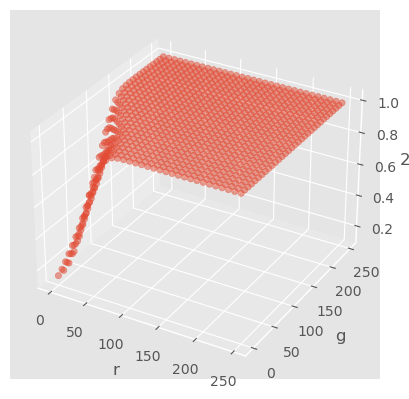

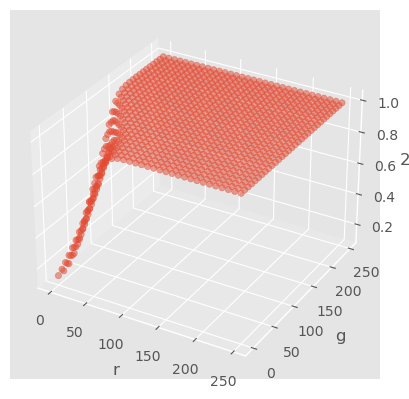

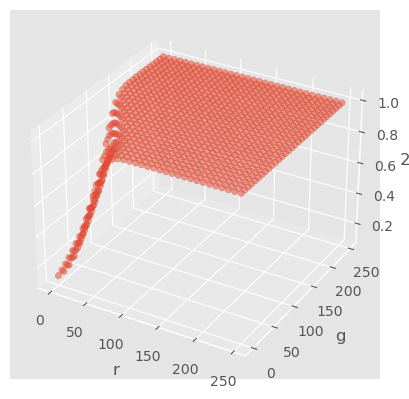

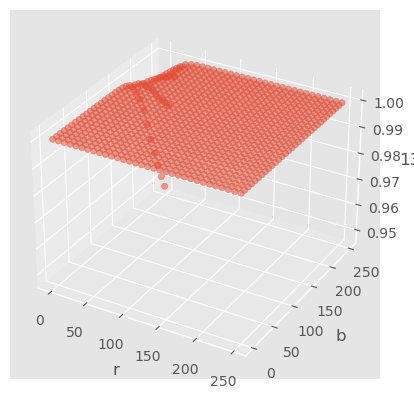


from here, green will changed with stride 10




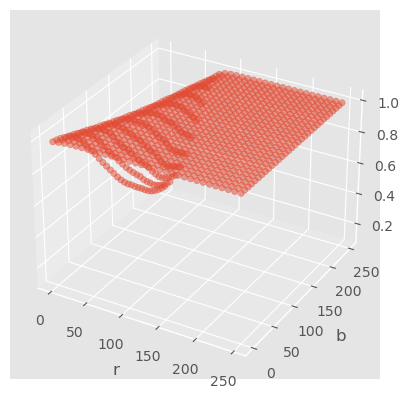

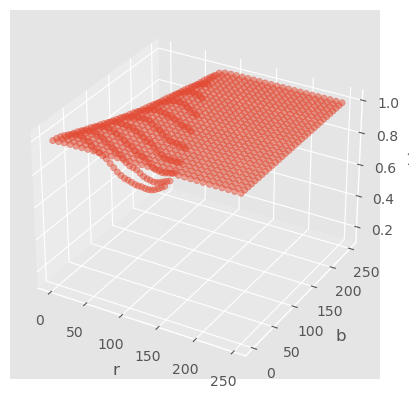

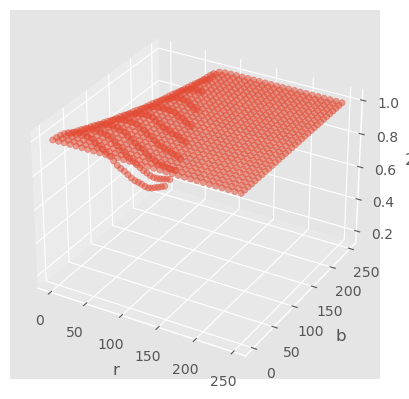

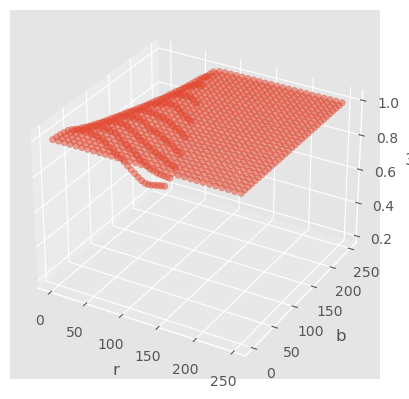

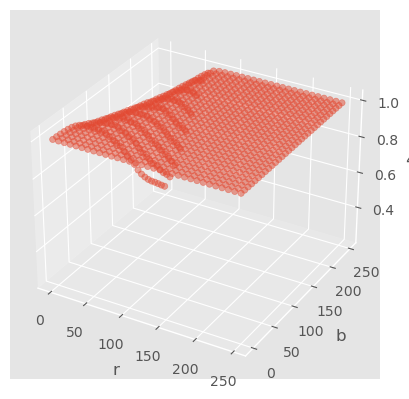

...

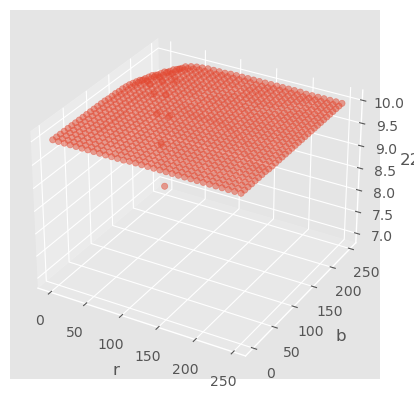

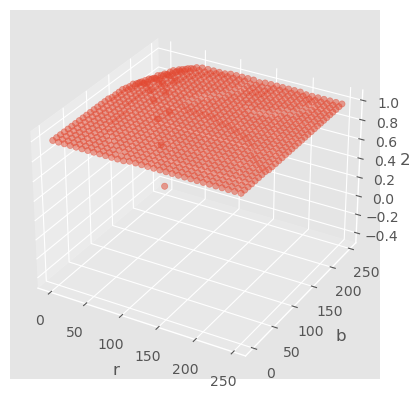

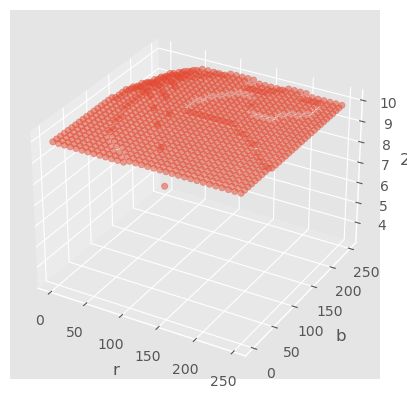

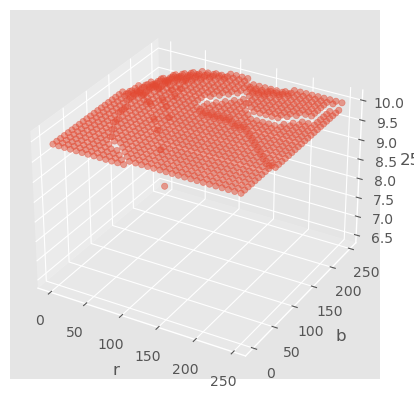

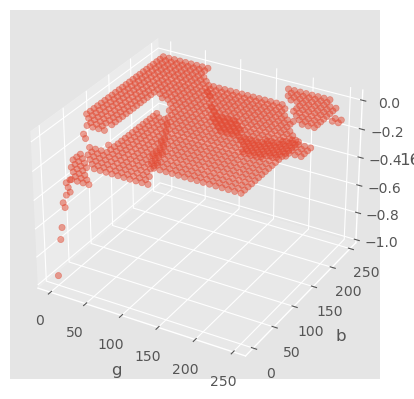


from here, red will changed with stride 10




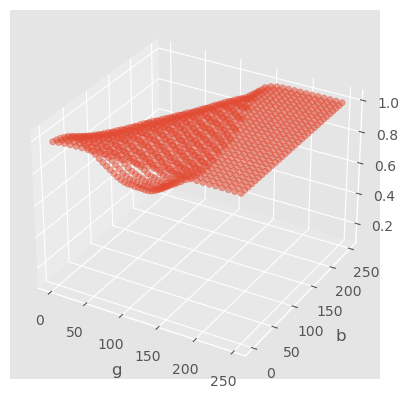

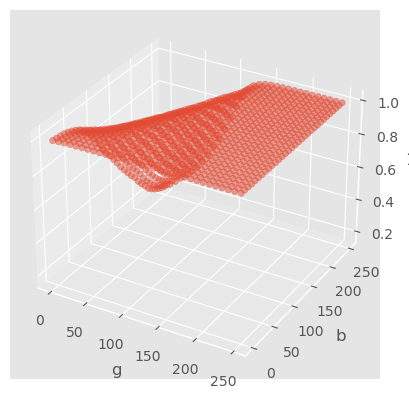

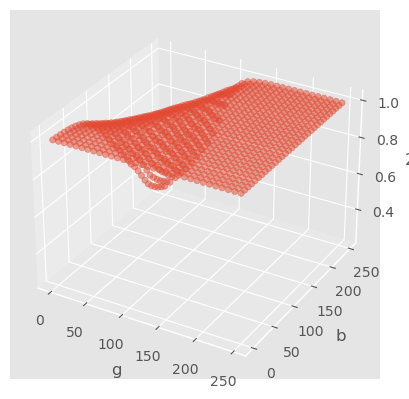

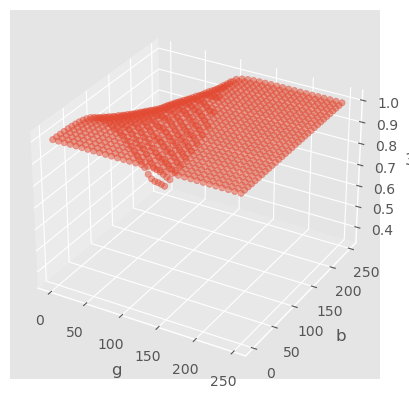

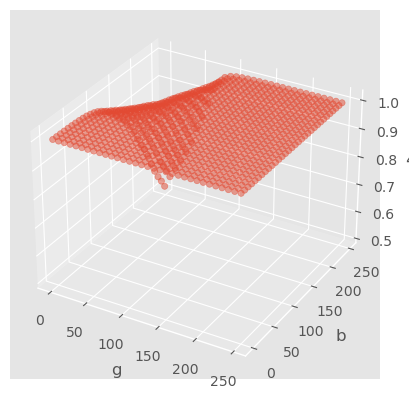

...

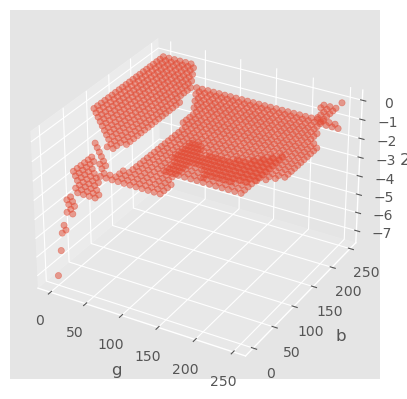

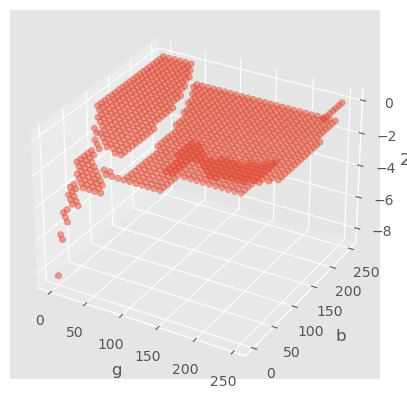

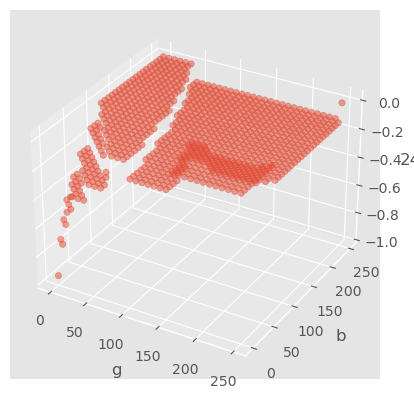

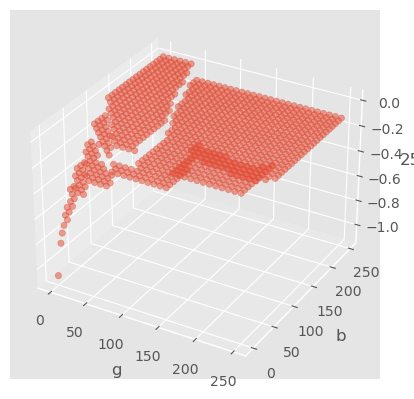

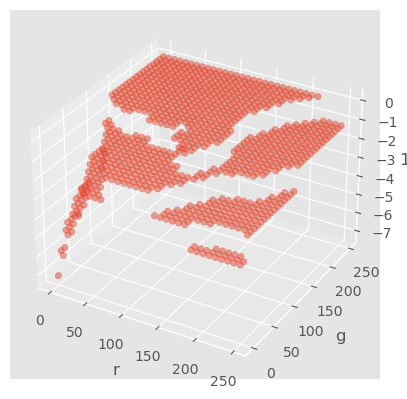


from here, blue will changed with stride 10, random pixel




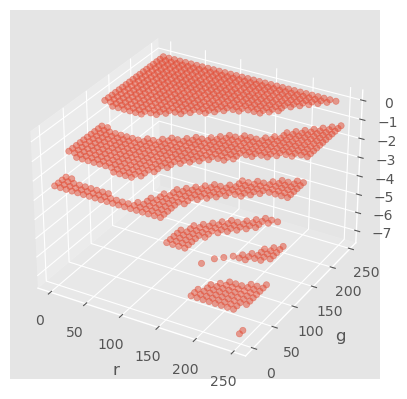

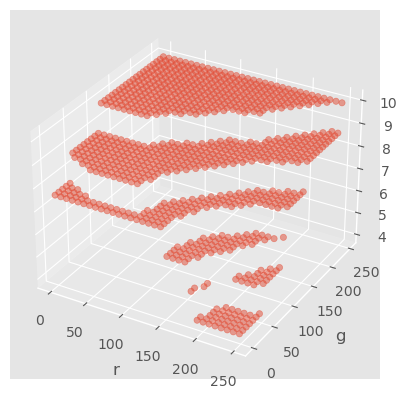

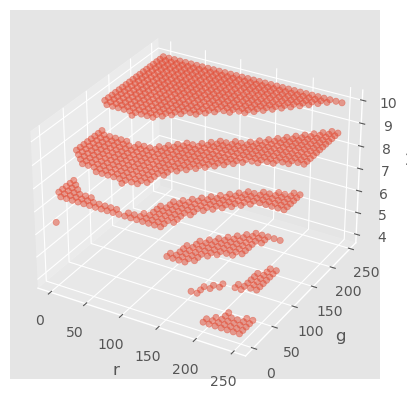

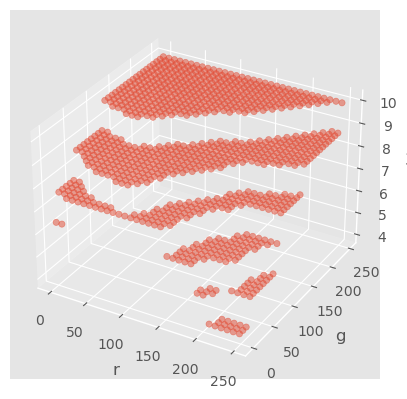

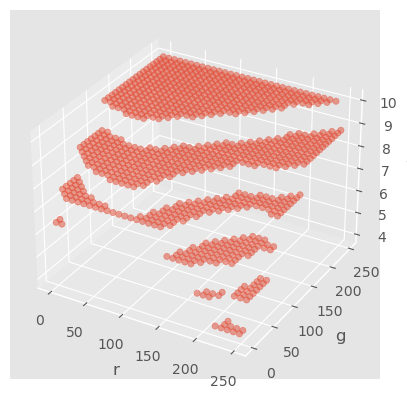

...

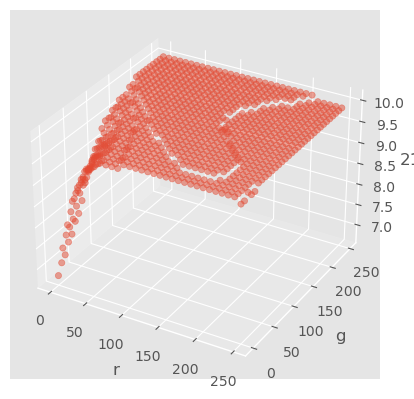

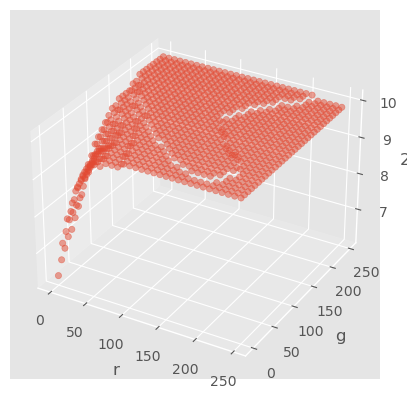

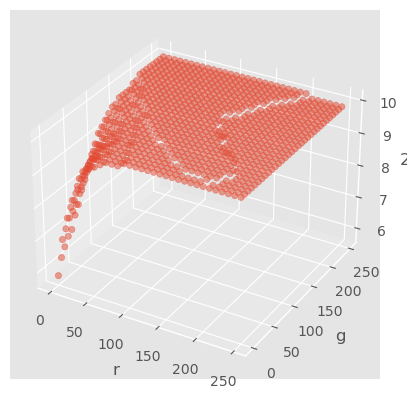

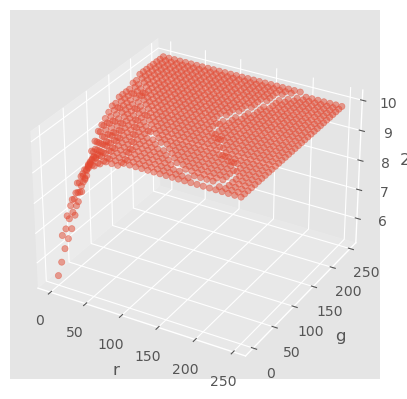

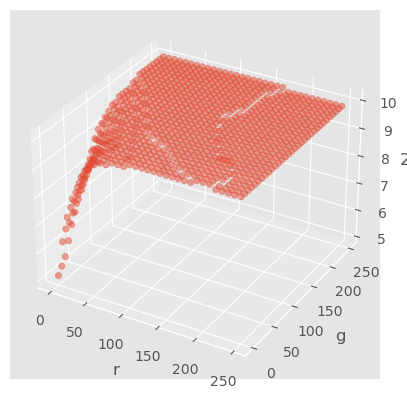

In [89]:
# high confidence image
image_id = 4
true_class = y_test[image_id, 0]
stride = 8
test_image = x_test[image_id].copy()
sensitive_rgb = test_image[17][19] # most sensitive coordinate
random_rgb = test_image[20][24] # random coordinate
# pixel_stride = 8
graph_model = resnet
# print(sensitive_pixel_sorting(384))
# change_two('r', 'g', graph_model, image_id, true_class, stride, pixel_stride)

# r,g are main
change_two_test('r', 'g', 'b', graph_model, image_id, true_class, stride, 17, 19, sensitive_rgb[2], 'blue', 'original') # sensitive
print("\nfrom here, blue will changed with stride 10\n\n")
for remained_rgb in range(0, 255, 10):
    change_two_test('r', 'g', 'b', graph_model, image_id, true_class, stride, 17, 19, remained_rgb, 'blue', 'n') # r,g

# r,b are main
change_two_test('r', 'b', 'g', graph_model, image_id, true_class, stride, 17, 19, sensitive_rgb[1], 'green', 'original') # sensitive
print("\nfrom here, green will changed with stride 10\n\n")
for remained_rgb in range(0, 255, 10):
    change_two_test('r', 'b', 'g', graph_model, image_id, true_class, stride, 17, 19, remained_rgb, 'green', 'n') # r,b

# g,b are main
change_two_test('g', 'b', 'r', graph_model, image_id, true_class, stride, 17, 19, sensitive_rgb[0], 'red', 'original') # sensitive
print("\nfrom here, red will changed with stride 10\n\n")
for remained_rgb in range(0, 255, 10):
    change_two_test('g', 'b', 'r', graph_model, image_id, true_class, stride, 17, 19, remained_rgb, 'red', 'n') # r,g
"""    
#from here, random piexl and r,g are main
change_two_test('r', 'g', 'b', graph_model, image_id, true_class, stride, 20, 24, random_rgb[2], 'blue', 'original') # sensitive
print("\nfrom here, blue will changed with stride 10, random pixel\n\n")
for remained_rgb in range(0, 255, 10):
    change_two_test('r', 'g', 'b', graph_model, image_id, true_class, stride, 20, 24, remained_rgb, 'blue', 'n') # r,g
#change_two_test('r', 'b', graph_model, image_id, true_class, stride, 16, 17) # random
#change_two_test('r', 'b', graph_model, image_id, true_class, stride, 24, 12) # weired
"""

## The Attack

Here we will demonstrate two variants of the one pixel attack: untargeted and targeted.

### Targeted vs. Untargeted Attacks

The objective of an untargeted attack is to cause a model to misclassify an image. This means we want to perturb an image as to minimize the confidence probability of the correct classification category and maximize the sum of the probabilities of all other categories.

The objective of a targeted attack is to cause a model to classify an image as a given  target class. We want to perturb an image as to maximize the probability of a class of our own choosing.

### Success Criterion

Define a function so that whenever a given perturbation is sufficient to fool a model, it returns `True`. This will be called the success criterion. The `targeted_attack` boolean flag will indicate whether success means maximization of the target class or minimization of the correct (target) class.

In [23]:
def attack_success(x, img, target_class, model, targeted_attack=False, verbose=False):
    # Perturb the image with the given pixel(s) and get the prediction of the model
    attack_image = perturb_image(x, img)

    confidence = model.predict(attack_image)[0] # attack_image가 배열이다. 그 중 하나를 리턴.
    predicted_class = np.argmax(confidence) # 그 중 최댓값을 고른다..
    
    # If the prediction is what we want (misclassification or 
    # targeted classification), return True
    if verbose:
        print('Confidence:', confidence[target_class])
    if ((targeted_attack and predicted_class == target_class) or
        (not targeted_attack and predicted_class != target_class)):
        return True
    # NOTE: return None otherwise (not False), due to how Scipy handles its callback function

Here we demonstrate the usage of the success criterion function. It's nearly identical to `predict_class()` as before, but also decides the success of the attack. For purposes of demonstration we assume an untargeted attack.

Confidence: 0.07460061
Prior confidence 0.50054187
Attack success: True


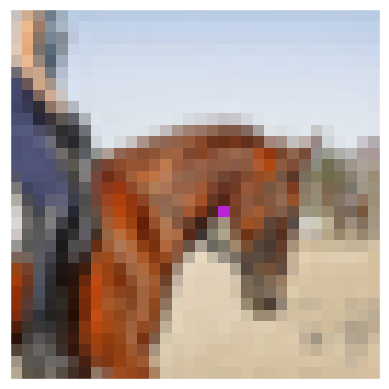

In [24]:
image_id = 541
pixel = np.array([17, 18, 185, 36, 215])
model = resnet

true_class = y_test[image_id, 0]
prior_confidence = model.predict_one(x_test[image_id])[true_class]
success = attack_success(pixel, x_test[image_id], true_class, model, verbose=True)

print('Prior confidence', prior_confidence)
print('Attack success:', success == True)
helper.plot_image(perturb_image(pixel, x_test[image_id])[0])

### Attack Function

Finally, we arrive at the attack itself: how do we find the pixels that will result in a successful attack? First, formulate it as an optimization problem: in an untargeted attack, minimize the confidence of the correct class, and in a targeted attack, maximize the confidence of a target class. This is precisely our `predict_class` function.

When performing black-box optimizations such as the one pixel attack, it can be very difficult to find an efficient gradient-based optimization that will work for the problem. It would be nice to use an optimization algorithm that can find good solutions without relying on the smoothness of the function. In our case, we have discrete integer positions ranging from 0 to 31 and color intensities from 0 to 255, so the function is expected to be jagged.

For that, we use an algorithm called [differential evolution](https://en.wikipedia.org/wiki/Differential_evolution). Here's an example of differential evolution optimizing the [Ackley function](https://en.wikipedia.org/wiki/Ackley_function) (if you're using Google Colab, run the code cell below):

<br>

![Ackley GIF](images/Ackley.gif)

<br>

Differential evolution is a type of evolutionary algorithm where a population of candidate solutions generate offspring which compete with the rest of the population each generation according to their fitness. Each candidate solution is represented by a vector of real numbers which are the inputs to the function we would like to minimize. The lower the output of this function, the better the fitness. The algorithm works by initializing a (usually random) population of vectors, generating new offspring vectors by combining (mutating) individuals in the population, and replacing worse-performing individuals with better candidates.

In the context of the one pixel attack, our input will be a flat vector of pixel values:

$$X = (x_1, y_1, r_1, g_1, b_1, x_2, y_2, r_2, g_2, b_2, ...)$$

These will be encoded as floating-point values, but will be floored back into integers to calculate image perturbations. First we generate a random population of $n$ perturbations

$$\textbf{P} = (X_1, X_2, \dots, X_n)$$

Then, on each iteration we calculate $n$ new mutant children using the formula

$$X_i = X_{r1} + F (X_{r2} - X_{r3})$$

such that

$$r1 \neq r2 \neq r3$$

where $r1,r2,r3$ are random indices into our population $\textbf{P}$, and $F = 0.5$ is a mutation parameter. Basically, we pick 3 random individuals from the previous generation and recombine them to make a new candidate solution. If this candidate $X_i$ gives a lower minimum at position $i$ (i.e., the attack is closer to success), replace the old $X_i$ with this new one. This process repeats for several iterations until our stopping criterion, `attack_success`, which is when we find an image that successfully completes the attack.

<br>

See [this excellent tutorial post](https://pablormier.github.io/2017/09/05/a-tutorial-on-differential-evolution-with-python/) on how differential evolution works in greater detail. 

We will use a [slight modification](differential_evolution.py) of [Scipy's implementation of differential evolution](https://docs.scipy.org/doc/scipy-0.17.0/reference/generated/scipy.optimize.differential_evolution.html) to utilize GPU parallelism by batching predictions together.

In [25]:
# Run this cell if you are using Google Colab to see the Ackley GIF
if in_colab:
    from IPython.display import Image
    with open('images/Ackley.gif','rb') as file:
        display(Image(file.read()))

In [26]:
#pixel_list = sensitive_pixel_sorting(384)# temp, 384 sensitive list

In [27]:
def attack(img_id, model, target=None, pixel_count=1, 
           maxiter=75, popsize=400, verbose=False):
    # Change the target class based on whether this is a targeted attack or not
    targeted_attack = target is not None
    target_class = target if targeted_attack else y_test[img_id, 0]
    
    # Define bounds for a flat vector of x,y,r,g,b values
    # For more pixels, repeat this layout
    bounds = [(0,32), (0,32), (0,256), (0,256), (0,256)] * pixel_count
    
    # Population multiplier, in terms of the size of the perturbation vector x
    popmul = max(1, popsize // len(bounds))
    # 이거 체크, 왜 이런 표현을 썼지..?
    # 나중에 parameter_count를 다시 곱해줄 거라 여기서 나눠준다.
    
    
    """
        1. Choose sensitive pixel by confidence score difference
            1.1 predict 통해서 confidence score difference 비교하고
            1.2 descending order sorting      
        2. Color distance
            2.1 distance 구하는 function 따로 만들어 놓자(조금만 바꾸면 될 듯?)
        3. Algorithm1 & Algorithm2
        4. 추후 OPA2D-ATK은 얘를 복붙해서 조금만 바꿔서 만들면 될 듯?
    """
    
    # Format the predict/callback functions for the differential evolution algorithm
    def predict_fn(xs):
        return predict_classes(xs, x_test[img_id], target_class, 
                               model, target is None)                                                         
    
    def callback_fn(x, convergence):
        return attack_success(x, x_test[img_id], target_class, 
                              model, targeted_attack, verbose)
    
    # Call Scipy's Implementation of Differential Evolution
    attack_result = differential_evolution(
        predict_fn, bounds, maxiter=maxiter, popsize=popmul,
        recombination=1, atol=-1, callback=callback_fn, polish=False)
    # result == (self.x, self.population_energies[0], nfev, nit, status_message, warning_flag)

    # Calculate some useful statistics to return from this function
    attack_image = perturb_image(attack_result.x, x_test[img_id])[0]
    prior_probs = model.predict_one(x_test[img_id]) # 여기가 테스트할 부분
    predicted_probs = model.predict_one(attack_image) # 여기가 테스트할 부분
    predicted_class = np.argmax(predicted_probs)
    actual_class = y_test[img_id, 0]
    success = predicted_class != actual_class
    cdiff = prior_probs[actual_class] - predicted_probs[actual_class]

    # Show the best attempt at a solution (successful or not)
    helper.plot_image(attack_image, actual_class, class_names, predicted_class)

    return [model.name, pixel_count, img_id, actual_class, predicted_class, success, cdiff, prior_probs, predicted_probs, attack_result.x]


In [28]:
global Lopt
Lopt = 256
global Alphamax
Alphamax = Lopt - 1
global Alphamin
Alphamin = 1
global Alpha
Lopt_list = []
attacked_pixel_coord = []
def my_attack_3(img_id, model, target=None, pixel_count=1, 
           maxiter=75, popsize=400, verbose=False):
    # Change the target class based on whether this is a targeted attack or not
    targeted_attack = target is not None
    target_class = target if targeted_attack else y_test[img_id, 0]
    
    
    global Alphamax
    global Alphamin
    global Lopt
    global Alpha
    
    # pixel_list.reverse()
    
    # pixel_list = sensitive_pixel_sorting(img_id)
    for i in range(0,30):
        # Re-initialize
        Lopt = 256
        Alphamax = Lopt - 1
        Alphamin = 1
        print("\n\nRound ", i)
        while(Alphamin <= Alphamax):
            # print(Alphamin)
            # print(Alphamax)
            img = x_test[img_id]
            sensitive_x_coord = pixel_list[i][0]
            sensitive_y_coord = pixel_list[i][1]
            original_rgb = img[sensitive_x_coord][sensitive_y_coord]
            Alpha = (Alphamax + Alphamin) // 2
            new_rgb_range = [(max(original_rgb[0] - Alpha, 0), min(original_rgb[0] + Alpha, 255)), (max(original_rgb[1] - Alpha, 0), min(original_rgb[1] + Alpha, 255)), (max(original_rgb[2] - Alpha, 0), min(original_rgb[2] + Alpha, 255))]
            # print(new_rgb_range)
            new_red_range = new_rgb_range[0]
            new_green_range = new_rgb_range[1]
            new_blue_range = new_rgb_range[2]
            # print(new_red_range)
            # print(new_green_range)
            # print(new_blue_range)


            # Define bounds for a flat vector of x,y,r,g,b values
            # For more pixels, repeat this layout
            # bounds = [(0,32), (0,32), (0,256), (0,256), (0,256)] * pixel_count
            bounds = [(sensitive_x_coord, sensitive_x_coord), (sensitive_y_coord, sensitive_y_coord), new_red_range, new_green_range, new_blue_range]


            # Population multiplier, in terms of the size of the perturbation vector x
            popmul = max(1, popsize // len(bounds))
            # 이거 체크, 왜 이런 표현을 썼지..?
            # 나중에 parameter_count를 다시 곱해줄 거라 여기서 나눠준다.


            """
                1. Choose sensitive pixel by confidence score difference
                    1.1 predict 통해서 confidence score difference 비교하고
                    1.2 descending order sorting      
                2. Color distance
                    2.1 distance 구하는 function 따로 만들어 놓자(조금만 바꾸면 될 듯?)
                3. Algorithm1 & Algorithm2
                4. 추후 OPA2D-ATK은 얘를 복붙해서 조금만 바꿔서 만들면 될 듯?
            """

            # Format the predict/callback functions for the differential evolution algorithm
            def predict_fn(xs):
                return predict_classes(xs, x_test[img_id], target_class, 
                                       model, target is None)                                                         

            def callback_fn(x, convergence):
                return attack_success(x, x_test[img_id], target_class, 
                                      model, targeted_attack, verbose)

            # Call Scipy's Implementation of Differential Evolution
            attack_result = differential_evolution(
                predict_fn, bounds, maxiter=maxiter, popsize=popmul,
                recombination=1, atol=-1, callback=callback_fn, polish=False)
            # result == (self.x, self.population_energies[0], nfev, nit, status_message, warning_flag)
            # print(attack_result.x)
            # Calculate some useful statistics to return from this function
            attack_image = perturb_image(attack_result.x, x_test[img_id])[0]
            # final_attack_image = attack_image # mycode
            prior_probs = model.predict_one(x_test[img_id]) # 여기가 테스트할 부분
            predicted_probs = model.predict_one(attack_image) # 여기가 테스트할 부분
            predicted_class = np.argmax(predicted_probs)
            actual_class = y_test[img_id, 0]
            success = predicted_class != actual_class
            cdiff = prior_probs[actual_class] - predicted_probs[actual_class]
            # my code
            if(success):
                Lopt = max(abs(attack_result.x[2] - original_rgb[0]), abs(attack_result.x[3] - original_rgb[1]), abs(attack_result.x[4] - original_rgb[2]))
                # print("Lopt  in if is", Lopt)
                Alphamax = Lopt - 1
                final_attack_image = attack_image
                final_predicted_class = predicted_class
                helper.plot_image(final_attack_image, actual_class, class_names, final_predicted_class)
                Lopt_list.append(Lopt)
                attacked_pixel_coord.extend([i, sensitive_x_coord, sensitive_y_coord])
                print("Success Lopt is", Lopt)
                # print("In success")
            else:
                # print("Alpha is", Alpha)
                Alphamin = Alpha + 1
                # print("else Alphamin = ", Alphamin)
                # print("Lopt  in else is", Lopt)
        """
        # my code
        if(success):
            Lopt = max(abs(attack_result.x[2] - original_rgb[0]), abs(attack_result.x[3] - original_rgb[1]), abs(attack_result.x[4] - original_rgb[2]))
            Alphamax = Lopt - 1
            count += 1
        else:
            Alphamin = Alpha + 1
            count += 1
        """

        # Show the best attempt at a solution (successful or not)
        print("Final Lopt is", Lopt)
        # helper.plot_image(attack_image, actual_class, class_names, predicted_class)
        #Re-initialize

    return [model.name, pixel_count, img_id, actual_class, predicted_class, success, cdiff, prior_probs, predicted_probs, attack_result.x]

# From here, We propose our gradient_descent using momentum. <br>

There are many variations.


In [29]:
def bound(value):
    return int(max(0, min(value, 255)))


def gradient_descent_momentum(image_id, model, sensitive_x, sensitive_y):
    img = x_test[image_id].copy()
    true_class = y_test[image_id, 0]
    original_confidence = model.predict_one(img)
    print("original confidence is : ", original_confidence[true_class], '\n')
    
    # original r,g,b
    r = img[sensitive_x][sensitive_y][0]
    g = img[sensitive_x][sensitive_y][1]
    b = img[sensitive_x][sensitive_y][2]
    print("original rgb is : ", r, g, b)
    
    momentum = 0.9 # widely used
    learning_rate = 1000 # hyperparameter, confidence 낮출 땐 0.1
    vr = 0
    vg = 0
    vb = 0
    
    iteration_num = 20 # empirically choosed, hyperparameter
    
    # Iteration number : 20
    for i in range(iteration_num):
        decr_red = np.array([sensitive_x, sensitive_y, bound(r-1), g, b])
        incr_red = np.array([sensitive_x, sensitive_y, bound(r+1), g, b])
        decr_red_confidence = model.predict_one(perturb_image(decr_red, img))[true_class]
        incr_red_confidence = model.predict_one(perturb_image(incr_red, img))[true_class]

    
        diff_r = (incr_red_confidence - decr_red_confidence)
        print(diff_r)
        
        decr_green = np.array([sensitive_x, sensitive_y, r, bound(g-1), b])
        incr_green = np.array([sensitive_x, sensitive_y, r, bound(g+1), b])
        decr_green_confidence = model.predict_one(perturb_image(decr_green, img))[true_class]
        incr_green_confidence = model.predict_one(perturb_image(incr_green, img))[true_class]

    
        diff_g = (incr_green_confidence - decr_green_confidence)
        print(diff_g)
        
        decr_blue = np.array([sensitive_x, sensitive_y, r, g, bound(b-1)])
        incr_blue = np.array([sensitive_x, sensitive_y, r, g, bound(b+1)])
        decr_blue_confidence = model.predict_one(perturb_image(decr_blue, img))[true_class]
        incr_blue_confidence = model.predict_one(perturb_image(incr_blue, img))[true_class]

    
        diff_b = (incr_blue_confidence - decr_blue_confidence)
        print(diff_b)
        
        
        vr = momentum * vr - learning_rate * diff_r # r axis vector
        vg = momentum * vg - learning_rate * diff_g # g axis vector
        vb = momentum * vb - learning_rate * diff_b # b axis vector
        
        print(vr, vg, vb)
        new_r = bound(r + vr)
        new_g = bound(g + vg)
        new_b = bound(b + vb)
        xs = np.array([sensitive_x, sensitive_y, new_r, new_g, new_b])
        print("new rgb is : ", new_r, new_g, new_b)
        predicted_probs = model.predict_one(perturb_image(xs, img))
        
        # added early stop, how to choose termination point?
        predicted_class = np.argmax(predicted_probs)
        print(str(i) + "th round's original class's confidence : ", predicted_probs[true_class])
        print(str(i) + "th round's predicted class's confidence : ", predicted_probs[predicted_class])
        
        # termination condition
        if(predicted_probs[true_class] < 0.01):
            break
        helper.plot_image(perturb_image(xs, x_test[image_id])[0], true_class, class_names, predicted_class)
        #image = Image.fromarray(perturb_image(xs, x_test[image_id])[0])
        #image.save("fig1_b.png", "png") # code for save image, temporary
        print('\n')
        
        if(new_r == r and new_g == g and new_b == b):
            break
        
        r = new_r
        g = new_g
        b = new_b

# This code is for targetted attack.

In [30]:
def gradient_descent_momentum_targetted(image_id, model, sensitive_x, sensitive_y, target_index):
    # class_names = ['airplane', 'automobile', 'bird', 'cat', 'deer', 'dog', 'frog', 'horse', 'ship', 'truck']
    img = x_test[image_id].copy()
    true_class = y_test[image_id, 0]
    original_confidence = model.predict_one(img)
    print("original confidence is : ", original_confidence[true_class], '\n')
    print("target class's confidence is : ", original_confidence[target_index], '\n')
    #img[sensitive_x][sensitive_y][0]
    #img[sensitive_x][sensitive_y][1]
    #img[sensitive_x][sensitive_y][2]
    r = img[sensitive_x][sensitive_y][0]
    g = img[sensitive_x][sensitive_y][1]
    b = img[sensitive_x][sensitive_y][2]
    print("original rgb is : ", r, g, b)
    # 우선은 sensitive rgb에서 시작... 어디가 시점인게 좋으려나?
    momentum = 0.9 # widely used
    learning_rate = 5000 # hyperparameter, confidence 낮출 땐 0.1
    vr = 0
    vg = 0
    vb = 0
    
    # How can I determine iteration number?
    for i in range(20):
        decr_red = np.array([sensitive_x, sensitive_y, bound(r-1), g, b])
        incr_red = np.array([sensitive_x, sensitive_y, bound(r+1), g, b])
        decr_red_confidence = model.predict_one(perturb_image(decr_red, img))[target_index]
        incr_red_confidence = model.predict_one(perturb_image(incr_red, img))[target_index]

    
        diff_r = (incr_red_confidence - decr_red_confidence)
        print(diff_r)
        
        decr_green = np.array([sensitive_x, sensitive_y, r, bound(g-1), b])
        incr_green = np.array([sensitive_x, sensitive_y, r, bound(g+1), b])
        decr_green_confidence = model.predict_one(perturb_image(decr_green, img))[target_index]
        incr_green_confidence = model.predict_one(perturb_image(incr_green, img))[target_index]

    
        diff_g = (incr_green_confidence - decr_green_confidence)
        print(diff_g)
        
        decr_blue = np.array([sensitive_x, sensitive_y, r, g, bound(b-1)])
        incr_blue = np.array([sensitive_x, sensitive_y, r, g, bound(b+1)])
        decr_blue_confidence = model.predict_one(perturb_image(decr_blue, img))[target_index]
        incr_blue_confidence = model.predict_one(perturb_image(incr_blue, img))[target_index]

    
        diff_b = (incr_blue_confidence - decr_blue_confidence)
        print(diff_b)
        
        # climbing
        vr = momentum * vr + learning_rate * diff_r # r axis vector
        vg = momentum * vg + learning_rate * diff_g # g axis vector
        vb = momentum * vb + learning_rate * diff_b # b axis vector
        
        new_r = bound(r + vr)
        new_g = bound(g + vg)
        new_b = bound(b + vb)
        xs = np.array([sensitive_x, sensitive_y, new_r, new_g, new_b])
        print("new rgb is : ", new_r, new_g, new_b)
        # targetted attack
        predicted_probs = model.predict_one(perturb_image(xs, img))
        predicted_class = np.argmax(predicted_probs)
        print(str(i) + "th round's confidence for original class : ", predicted_probs[true_class])
        print(str(i) + "th round's confidence for target class : ", predicted_probs[target_index])
        helper.plot_image(perturb_image(xs, x_test[image_id])[0], true_class, class_names, predicted_class)
        #image = Image.fromarray(perturb_image(xs, x_test[image_id])[0])
        #image.save("fig1_b.png", "png") # code for save image, temporary
        print('\n')
        if(new_r == r and new_g == g and new_b == b):
            break
        
        r = new_r
        g = new_g
        b = new_b

In [31]:
def gradient_descent_momentum_beam_search(image_id, model, sensitive_x, sensitive_y):
    img = x_test[image_id].copy()
    true_class = y_test[image_id, 0]
    original_confidence = model.predict_one(img)[true_class]
    print("original confidence is : ", original_confidence, '\n')
    
    r = int(img[sensitive_x][sensitive_y][0])
    g = int(img[sensitive_x][sensitive_y][1])
    b = int(img[sensitive_x][sensitive_y][2])
    print("original r,g,b : ", r, g, b)
    
    
    #initialize with starting point
    start_point = [[r,g,b], [r - 5, g - 5, b - 5], [r + 5, g + 5, b + 5], [r - 10, g - 10, b - 10], [r + 10, g + 10, b + 10]]
    # 우선은 sensitive rgb에서 시작... 어디가 시점인게 좋으려나?
    momentum = 0.9 # widely used
    learning_rate = 1200 # hyperparameter
    velocity_list = [[0,0,0], [0,0,0], [0,0,0], [0,0,0], [0,0,0]]
    length = len(start_point)
    for i in range(30):
        # start point 개수만큼
        for j in range(length):
            
            decr_red = np.array([sensitive_x, sensitive_y, bound(start_point[j][0]-1), start_point[j][1], start_point[j][2]])
            incr_red = np.array([sensitive_x, sensitive_y, bound(start_point[j][0]+1), start_point[j][1], start_point[j][2]])
            decr_red_confidence = model.predict_one(perturb_image(decr_red, img))[true_class]
            incr_red_confidence = model.predict_one(perturb_image(incr_red, img))[true_class]


            diff_r = (incr_red_confidence - decr_red_confidence)
            print(diff_r)

            decr_green = np.array([sensitive_x, sensitive_y, start_point[j][0], bound(start_point[j][1]-1), start_point[j][2]])
            incr_green = np.array([sensitive_x, sensitive_y, start_point[j][0], bound(start_point[j][1]+1), start_point[j][2]])
            decr_green_confidence = model.predict_one(perturb_image(decr_green, img))[true_class]
            incr_green_confidence = model.predict_one(perturb_image(incr_green, img))[true_class]


            diff_g = (incr_green_confidence - decr_green_confidence)
            print(diff_g)

            decr_blue = np.array([sensitive_x, sensitive_y, start_point[j][0], start_point[j][1], bound(start_point[j][2]-1)])
            incr_blue = np.array([sensitive_x, sensitive_y, start_point[j][0], start_point[j][1], bound(start_point[j][2]+1)])
            decr_blue_confidence = model.predict_one(perturb_image(decr_blue, img))[true_class]
            incr_blue_confidence = model.predict_one(perturb_image(incr_blue, img))[true_class]


            diff_b = (incr_blue_confidence - decr_blue_confidence)
            print(diff_b)
            


            velocity_list[j][0] = momentum * velocity_list[j][0] - learning_rate * diff_r # r axis vector
            velocity_list[j][1] = momentum * velocity_list[j][1] - learning_rate * diff_g # g axis vector
            velocity_list[j][2] = momentum * velocity_list[j][2] - learning_rate * diff_b # b axis vector
            
            print("vr, vg, vb :  ", velocity_list[j][0], velocity_list[j][1], velocity_list[j][2])
            #for j in range(5):
            
            
            if(start_point[j][0] == 255):
                start_point[j][0] = r
            elif(start_point[j][1] == 255):
                start_point[j][1] = g
            elif(start_point[j][2] == 255):
                start_point[j][2] = b
            
            start_point[j][0] = bound(start_point[j][0] + velocity_list[j][0])
            start_point[j][1] = bound(start_point[j][1] + velocity_list[j][1])
            start_point[j][2] = bound(start_point[j][2] + velocity_list[j][2])
            
    
            
            xs = np.array([sensitive_x, sensitive_y, start_point[j][0], start_point[j][1], start_point[j][2]])
            
            print("perturbed r, g, b : ", start_point[j][0], start_point[j][1], start_point[j][2])
            perturbed_confidence = model.predict_one(perturb_image(xs, img))[true_class]
            print(str(i) + "th round's confidence : " + str(j) + "th", perturbed_confidence)
            
            print("Lopt is : ", max(abs(start_point[j][0] - r), abs(start_point[j][1] - g), abs(start_point[j][2] - b)))
            helper.plot_image(perturb_image(xs, x_test[image_id])[0])
            if(perturbed_confidence < 0.5):
                return
            print('\n')
            if(start_point[j][0] == r and start_point[j][1] == g and start_point[j][2] == b):
                return

            #r = start_point[j][0]
            #g = start_point[j][1]
            #b = start_point[j][2]
            
        #if perturbed_confidence < 0.5:
        #    break

In [32]:
#This cell is for parallel beam search

def gradient_descent_momentum_parallel_beam_search(image_id, model, sensitive_x, sensitive_y):
    img = x_test[image_id].copy()
    true_class = y_test[image_id, 0]
    original_confidence = model.predict_one(img)[true_class]
    print("original confidence is : ", original_confidence, '\n')
    
    r = int(img[sensitive_x][sensitive_y][0])
    g = int(img[sensitive_x][sensitive_y][1])
    b = int(img[sensitive_x][sensitive_y][2])
    print("original r,g,b : ", r, g, b)
    
    
    #initialize with starting point
    start_point = [[r,g,b], [r - 5, g - 5, b - 5], [r + 5, g + 5, b + 5], [r - 10, g - 10, b - 10], [r + 10, g + 10, b + 10]]
    
    momentum = 0.9 # widely used
    learning_rate = 100 # hyperparameter
    #initial_learning_rate = learning_rate
    velocity_list = [[0] * 3 for _ in range(5)] # 5 of [0, 0, 0]
    length = len(start_point)
    #prior_confidence = original_confidence
    
    
    for i in range(30):
        
        # start point 개수만큼 loop
        for j in range(length):
            
            decr_red = np.array([sensitive_x, sensitive_y, bound(start_point[j][0]-1), start_point[j][1], start_point[j][2]])
            incr_red = np.array([sensitive_x, sensitive_y, bound(start_point[j][0]+1), start_point[j][1], start_point[j][2]])
            decr_red_confidence = model.predict_one(perturb_image(decr_red, img))[true_class]
            incr_red_confidence = model.predict_one(perturb_image(incr_red, img))[true_class]


            diff_r = (incr_red_confidence - decr_red_confidence)
            print(diff_r)

            decr_green = np.array([sensitive_x, sensitive_y, start_point[j][0], bound(start_point[j][1]-1), start_point[j][2]])
            incr_green = np.array([sensitive_x, sensitive_y, start_point[j][0], bound(start_point[j][1]+1), start_point[j][2]])
            decr_green_confidence = model.predict_one(perturb_image(decr_green, img))[true_class]
            incr_green_confidence = model.predict_one(perturb_image(incr_green, img))[true_class]


            diff_g = (incr_green_confidence - decr_green_confidence)
            print(diff_g)

            decr_blue = np.array([sensitive_x, sensitive_y, start_point[j][0], start_point[j][1], bound(start_point[j][2]-1)])
            incr_blue = np.array([sensitive_x, sensitive_y, start_point[j][0], start_point[j][1], bound(start_point[j][2]+1)])
            decr_blue_confidence = model.predict_one(perturb_image(decr_blue, img))[true_class]
            incr_blue_confidence = model.predict_one(perturb_image(incr_blue, img))[true_class]


            diff_b = (incr_blue_confidence - decr_blue_confidence)
            print(diff_b)
            


            velocity_list[j][0] = momentum * velocity_list[j][0] - learning_rate * diff_r # r axis vector
            velocity_list[j][1] = momentum * velocity_list[j][1] - learning_rate * diff_g # g axis vector
            velocity_list[j][2] = momentum * velocity_list[j][2] - learning_rate * diff_b # b axis vector
            
            print("vr, vg, vb :  ", velocity_list[j][0], velocity_list[j][1], velocity_list[j][2])
            
            
            
    
            # r, g, b, rg, rb, gb, rgb
            # 가독성 좋게는 못 바꿀까..?? 하드코딩이 별로다..
            
            next_state_list = np.array([[sensitive_x, sensitive_y, bound(start_point[j][0] + velocity_list[j][0]), start_point[j][1], start_point[j][2]],
                          [sensitive_x, sensitive_y, start_point[j][0], bound(start_point[j][1] + velocity_list[j][1]), start_point[j][2]],
                          [sensitive_x, sensitive_y, start_point[j][0], start_point[j][1], bound(start_point[j][2] + velocity_list[j][2])],
                          [sensitive_x, sensitive_y, bound(start_point[j][0] + velocity_list[j][0]), bound(start_point[j][1] + velocity_list[j][1]), start_point[j][2]],
                          [sensitive_x, sensitive_y, bound(start_point[j][0] + velocity_list[j][0]), start_point[j][1], bound(start_point[j][2] + velocity_list[j][2])],
                          [sensitive_x, sensitive_y, start_point[j][0], bound(start_point[j][1] + velocity_list[j][1]), bound(start_point[j][2] + velocity_list[j][2])],
                          [sensitive_x, sensitive_y, bound(start_point[j][0] + velocity_list[j][0]), bound(start_point[j][1] + velocity_list[j][1]), bound(start_point[j][2] + velocity_list[j][2])]])
            
            
            row_index = 0 # to clarify which row in next_state_list
            
            temp = 1 # variable to compare with next state's confidence, initiallized with 1
            
            temp_row_index = 0 # variable to choose which row, initiallized with 0
            # code for test
            for next_state in next_state_list:
                # perturbed confidence of true class
                
                perturbed_confidence = model.predict_one(perturb_image(next_state, img))[true_class]
                print("beam_perturbed_confidence temp : ", perturbed_confidence)
                
                if(temp > perturbed_confidence):
                    temp = perturbed_confidence
                    row_index = temp_row_index
                
                temp_row_index += 1
            
            #print row index
            print("row index : ", row_index)
            
            """
            row_index = 0
            temp_row_index = 0
            temp = 1
            # check next state
            for k in range(len(next_state_list)):
                print("temp : ", temp)
                perturbed_confidence = model.predict_one(perturb_image(next_state_list[k], img))[true_class]
                print("beam_perturbed_confidence : ", perturbed_confidence)
                if(temp > perturbed_confidence):
                    temp = perturbed_confidence
                    row_index = k
                    
            print("row_index : ", row_index)
            """
            
            # perturbed confidence, this will be deleted (redundant)
            final_perturbed_confidence = model.predict_one(perturb_image(next_state_list[row_index], img))
            
            # predicted_class = index of argmax
            predicted_class = np.argmax(final_perturbed_confidence)
            
            # original의 confidence를 print
            print(str(i) + "th round's confidence : " + str(j) + "th", final_perturbed_confidence[true_class])
            
            # predicted class의 confidence를 print
            print("predicted class : ", class_names[predicted_class])
            
            # predicted의 confidence를 print
            print("predicted class's confidence : ", final_perturbed_confidence[predicted_class])
            
            """
            if(prior_confidence < final_perturbed_confidence[true_class]):
                learning_rate += initial_learning_rate
            elif((prior_confidence - final_perturbed_confidence[true_class]) < 0.001):
                learning_rate += initial_learning_rate
            """
            
            # start point 갱신 (state list is 5-tuple of (x, y, r, g, b))
            for k in range(3):
                start_point[j][k] = next_state_list[row_index][k+2]
                
            # L infinite norm
            Lopt_dist = max(abs(start_point[j][0] - r), abs(start_point[j][1] - g), abs(start_point[j][2] - b))
            print("Lopt is : ", Lopt_dist)
            helper.plot_image(perturb_image(next_state_list[row_index], x_test[image_id])[0], true_class, class_names, predicted_class)
            
            #image = Image.fromarray(perturb_image(xs[row_index], x_test[image_id])[0])
            #image.save("fig1_d.png", "png") #code for save image, temporary
            
            # temination condition : original confidence < 0.5 or local minima
            
            if(final_perturbed_confidence[true_class] < 0.5):
                return [[sensitive_x, sensitive_y], Lopt_dist, final_perturbed_confidence[predicted_class], final_perturbed_confidence[true_class]] # return Lopt
            print('\n')
            
            # return none for failure
            if(start_point[j][0] == r and start_point[j][1] == g and start_point[j][2] == b):
                return [[sensitive_x, sensitive_y], None, None, None] # return none for failure

            
    return [[sensitive_x, sensitive_y], None, None, None]

In [33]:
c = [[0]*3 for _ in range(5)]
c[1][1] = 1
print(c)

# test for model predict one
start_predict = time.time()
t = model.predict_one(x_test[384])
end_predict = time.time()
print(f"{end_predict - start_predict:.6f} sec")

[[0, 0, 0], [0, 1, 0], [0, 0, 0], [0, 0, 0], [0, 0, 0]]
0.014107 sec


In [51]:
image_id = 87
sensitive_list = sensitive_pixel_sorting(image_id)
sensitive_x = sensitive_list[0][0] # 1st sensitive x
sensitive_y = sensitive_list[0][1] # 1st sensitive y
print(x_test[image_id][sensitive_x][sensitive_y])
print(sensitive_x, sensitive_y)
print(sensitive_list)

[217 213 210]
21 13
[[21, 13, 0.6967192], [21, 15, 0.69671273], [20, 15, 0.69670826], [21, 14, 0.696677], [20, 14, 0.69667435], [20, 13, 0.69665396], [20, 16, 0.69663787], [17, 13, 0.6966006], [20, 12, 0.6965735], [21, 12, 0.69655716], [12, 23, 0.69655544], [17, 19, 0.69643724], [19, 13, 0.69641954], [19, 12, 0.6962804], [11, 23, 0.69620174], [18, 13, 0.69619894], [16, 19, 0.69610137], [19, 15, 0.69605124], [16, 21, 0.695898], [18, 14, 0.6957921], [22, 13, 0.695404], [13, 23, 0.6951231], [19, 14, 0.6951143], [16, 20, 0.6951081], [12, 24, 0.6950772], [21, 16, 0.69478244], [18, 15, 0.69474185], [20, 11, 0.6947317], [18, 19, 0.69466686], [16, 18, 0.69429994]]


0th sensitive pixel
original confidence is :  0.69673544 

original r,g,b :  217 213 210
0.010084569
0.015791833
0.0047539473
vr, vg, vb :   -1.0084569454193115 -1.5791833400726318 -0.47539472579956055
beam_perturbed_confidence temp :  0.68470454
beam_perturbed_confidence temp :  0.6776827
beam_perturbed_confidence temp :  0.69413036
beam_perturbed_confidence temp :  0.6678449
beam_perturbed_confidence temp :  0.68063784
beam_perturbed_confidence temp :  0.67389345
beam_perturbed_confidence temp :  0.6650047
row index :  6
0th round's confidence : 0th 0.6650047
predicted class :  horse
predicted class's confidence :  0.6650047
Lopt is :  2


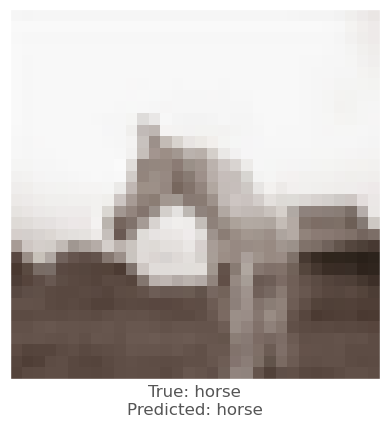



0.010472238
0.013523698
0.005403161
vr, vg, vb :   -1.0472238063812256 -1.352369785308838 -0.540316104888916
beam_perturbed_confidence temp :  0.60630333
beam_perturbed_confidence temp :  0.60411876
beam_perturbed_confidence temp :  0.61559224
beam_perturbed_confidence temp :  0.5963832
beam_perturbed_confidence temp :  0.6044988
beam_perturbed_confidence temp :  0.6034322
beam_perturbed_confidence temp :  0.5963251
row index :  6
0th round's confidence : 1th 0.5963251
predicted class :  horse
predicted class's confidence :  0.5963251
Lopt is :  7


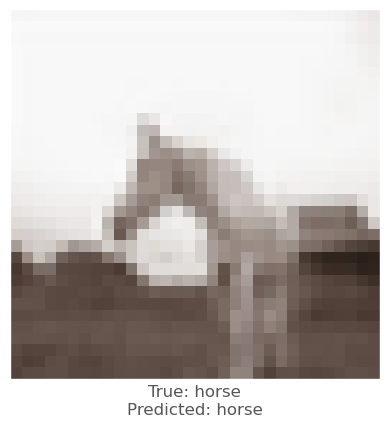



-0.006396413
-0.0043569803
-0.0037466288
vr, vg, vb :   0.639641284942627 0.4356980323791504 0.3746628761291504
beam_perturbed_confidence temp :  0.70141774
beam_perturbed_confidence temp :  0.70141774
beam_perturbed_confidence temp :  0.70141774
beam_perturbed_confidence temp :  0.70141774
beam_perturbed_confidence temp :  0.70141774
beam_perturbed_confidence temp :  0.70141774
beam_perturbed_confidence temp :  0.70141774
row index :  0
0th round's confidence : 2th 0.70141774
predicted class :  horse
predicted class's confidence :  0.70141774
Lopt is :  5


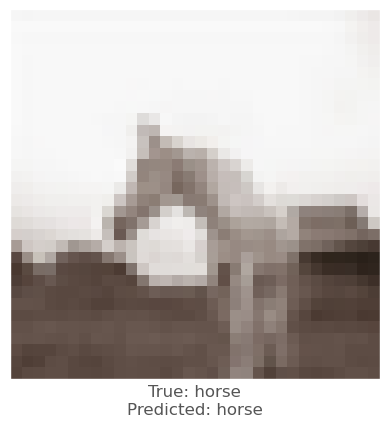



0.0059143305
0.01126945
0.001948297
vr, vg, vb :   -0.591433048248291 -1.1269450187683105 -0.19482970237731934
beam_perturbed_confidence temp :  0.5583642
beam_perturbed_confidence temp :  0.5503619
beam_perturbed_confidence temp :  0.56045634
beam_perturbed_confidence temp :  0.5459795
beam_perturbed_confidence temp :  0.55728656
beam_perturbed_confidence temp :  0.5488374
beam_perturbed_confidence temp :  0.54452586
row index :  6
0th round's confidence : 3th 0.54452586
predicted class :  horse
predicted class's confidence :  0.54452586
Lopt is :  12


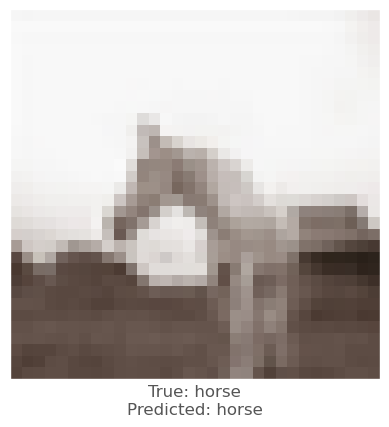



-0.012404084
-0.0104858875
-0.004998088
vr, vg, vb :   1.2404084205627441 1.048588752746582 0.49980878829956055
beam_perturbed_confidence temp :  0.6700991
beam_perturbed_confidence temp :  0.67084616
beam_perturbed_confidence temp :  0.6757585
beam_perturbed_confidence temp :  0.6656666
beam_perturbed_confidence temp :  0.6700991
beam_perturbed_confidence temp :  0.67084616
beam_perturbed_confidence temp :  0.6656666
row index :  3
0th round's confidence : 4th 0.6656666
predicted class :  horse
predicted class's confidence :  0.6656666
Lopt is :  11


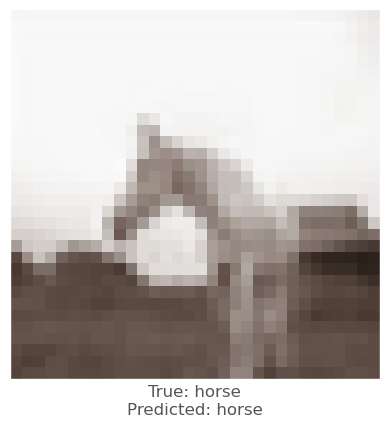



0.009712815
0.0145974755
0.005720675
vr, vg, vb :   -1.8788927793502808 -2.8810125589370728 -0.9999227523803711
beam_perturbed_confidence temp :  0.6548191
beam_perturbed_confidence temp :  0.6428275
beam_perturbed_confidence temp :  0.6621242
beam_perturbed_confidence temp :  0.631164
beam_perturbed_confidence temp :  0.6513843
beam_perturbed_confidence temp :  0.63964534
beam_perturbed_confidence temp :  0.6286863
row index :  6
1th round's confidence : 0th 0.6286863
predicted class :  horse
predicted class's confidence :  0.6286863
Lopt is :  5


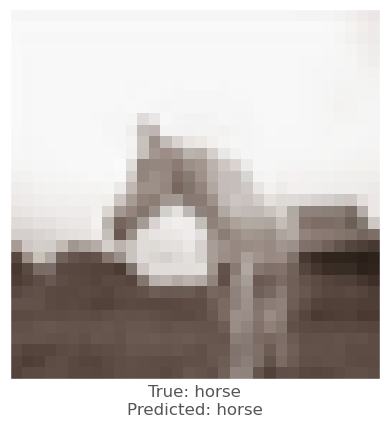



0.0070537925
0.009185851
0.000330925
vr, vg, vb :   -1.6478806734085083 -2.1357178688049316 -0.5193769931793213
beam_perturbed_confidence temp :  0.5884727
beam_perturbed_confidence temp :  0.5787413
beam_perturbed_confidence temp :  0.5960523
beam_perturbed_confidence temp :  0.56947476
beam_perturbed_confidence temp :  0.58891726
beam_perturbed_confidence temp :  0.57732385
beam_perturbed_confidence temp :  0.5686838
row index :  6
1th round's confidence : 1th 0.5686838
predicted class :  horse
predicted class's confidence :  0.5686838
Lopt is :  10


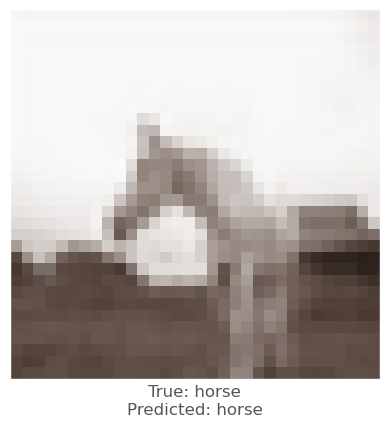



-0.006396413
-0.0043569803
-0.0037466288
vr, vg, vb :   1.2153184413909912 0.8278262615203857 0.7118594646453857
beam_perturbed_confidence temp :  0.6992762
beam_perturbed_confidence temp :  0.70141774
beam_perturbed_confidence temp :  0.70141774
beam_perturbed_confidence temp :  0.6992762
beam_perturbed_confidence temp :  0.6992762
beam_perturbed_confidence temp :  0.70141774
beam_perturbed_confidence temp :  0.6992762
row index :  0
1th round's confidence : 2th 0.6992762
predicted class :  horse
predicted class's confidence :  0.6992762
Lopt is :  6


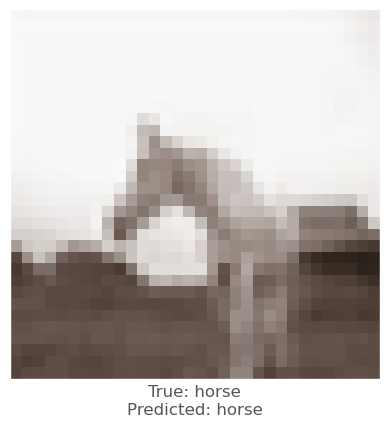



0.0101591945
0.015161812
0.0034707189
vr, vg, vb :   -1.5482091903686523 -2.5304317474365234 -0.5224186182022095
beam_perturbed_confidence temp :  0.5320543
beam_perturbed_confidence temp :  0.52050614
beam_perturbed_confidence temp :  0.5425088
beam_perturbed_confidence temp :  0.50796247
beam_perturbed_confidence temp :  0.5305321
beam_perturbed_confidence temp :  0.5194055
beam_perturbed_confidence temp :  0.506333
row index :  6
1th round's confidence : 3th 0.506333
predicted class :  horse
predicted class's confidence :  0.506333
Lopt is :  15


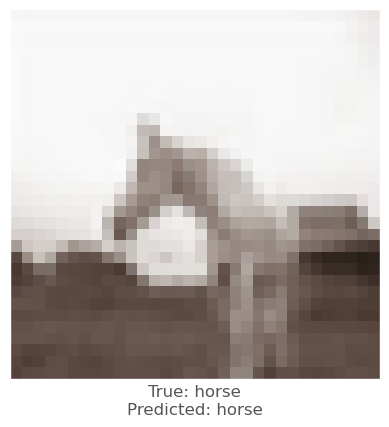



-0.009586394
-0.008769035
-0.0037676096
vr, vg, vb :   2.0750069618225098 1.8206334114074707 0.8265888690948486
beam_perturbed_confidence temp :  0.65684325
beam_perturbed_confidence temp :  0.66133004
beam_perturbed_confidence temp :  0.6656666
beam_perturbed_confidence temp :  0.65258974
beam_perturbed_confidence temp :  0.65684325
beam_perturbed_confidence temp :  0.66133004
beam_perturbed_confidence temp :  0.65258974
row index :  3
1th round's confidence : 4th 0.65258974
predicted class :  horse
predicted class's confidence :  0.65258974
Lopt is :  13


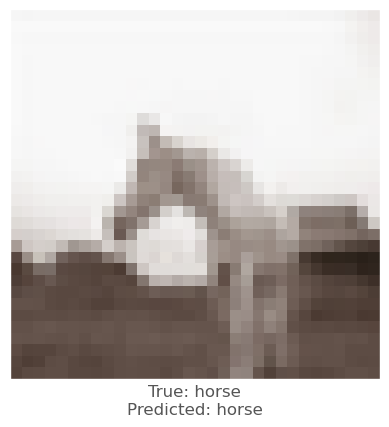



0.009121358
0.012268722
0.004153669
vr, vg, vb :   -2.603139340877533 -3.8197835087776184 -1.3152973651885986
beam_perturbed_confidence temp :  0.6156054
beam_perturbed_confidence temp :  0.6019626
beam_perturbed_confidence temp :  0.62506115
beam_perturbed_confidence temp :  0.5872577
beam_perturbed_confidence temp :  0.6092922
beam_perturbed_confidence temp :  0.59866256
beam_perturbed_confidence temp :  0.5867415
row index :  6
2th round's confidence : 0th 0.5867415
predicted class :  horse
predicted class's confidence :  0.5867415
Lopt is :  9


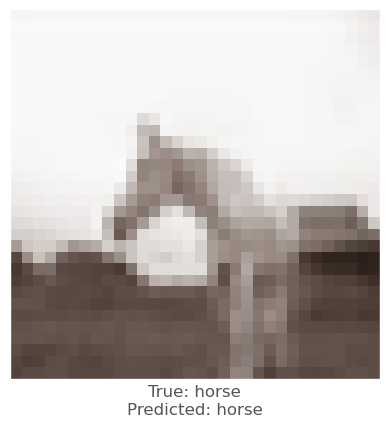



0.008193314
0.013532579
0.0020672083
vr, vg, vb :   -2.3024240136146545 -3.2754039764404297 -0.6741601228713989
beam_perturbed_confidence temp :  0.5542609
beam_perturbed_confidence temp :  0.54483426
beam_perturbed_confidence temp :  0.56740755
beam_perturbed_confidence temp :  0.52731764
beam_perturbed_confidence temp :  0.5544958
beam_perturbed_confidence temp :  0.54391325
beam_perturbed_confidence temp :  0.5262864
row index :  6
2th round's confidence : 1th 0.5262864
predicted class :  horse
predicted class's confidence :  0.5262864
Lopt is :  14


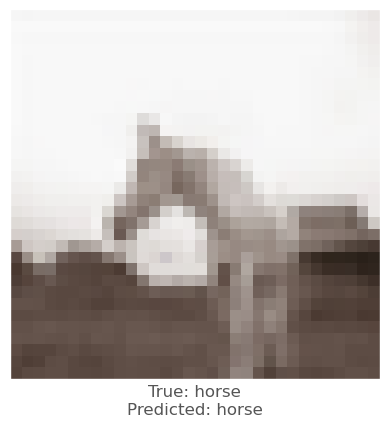



-0.0044876933
-0.0010962486
-0.0016311407
vr, vg, vb :   1.5425559282302856 0.8546684980392456 0.8037875890731812
beam_perturbed_confidence temp :  0.69693005
beam_perturbed_confidence temp :  0.6992762
beam_perturbed_confidence temp :  0.6992762
beam_perturbed_confidence temp :  0.69693005
beam_perturbed_confidence temp :  0.69693005
beam_perturbed_confidence temp :  0.6992762
beam_perturbed_confidence temp :  0.69693005
row index :  0
2th round's confidence : 2th 0.69693005
predicted class :  horse
predicted class's confidence :  0.69693005
Lopt is :  7


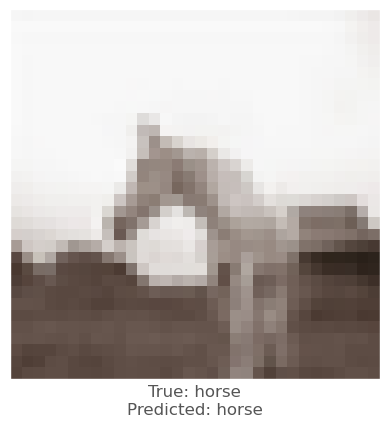



0.013729125
0.016272247
0.003584087
vr, vg, vb :   -2.7663007974624634 -3.9046132564544678 -0.8285854458808899
beam_perturbed_confidence temp :  0.4847441
beam_perturbed_confidence temp :  0.4714418
beam_perturbed_confidence temp :  0.5043784
beam_perturbed_confidence temp :  0.45368055
beam_perturbed_confidence temp :  0.48336464
beam_perturbed_confidence temp :  0.47037837
beam_perturbed_confidence temp :  0.4528503
row index :  6
2th round's confidence : 3th 0.4528503
predicted class :  airplane
predicted class's confidence :  0.53203017
Lopt is :  19


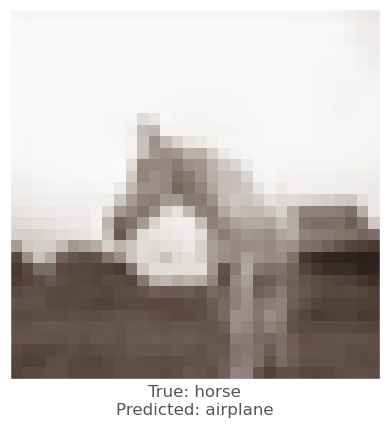




1th sensitive pixel
original confidence is :  0.69673544 

original r,g,b :  227 223 220
0.0008794069
-0.0043358803
-0.0014255047
vr, vg, vb :   -0.08794069290161133 0.43358802795410156 0.14255046844482422
beam_perturbed_confidence temp :  0.69669783
beam_perturbed_confidence temp :  0.69673544
beam_perturbed_confidence temp :  0.69673544
beam_perturbed_confidence temp :  0.69669783
beam_perturbed_confidence temp :  0.69669783
beam_perturbed_confidence temp :  0.69673544
beam_perturbed_confidence temp :  0.69669783
row index :  0
0th round's confidence : 0th 0.69669783
predicted class :  horse
predicted class's confidence :  0.69669783
Lopt is :  1


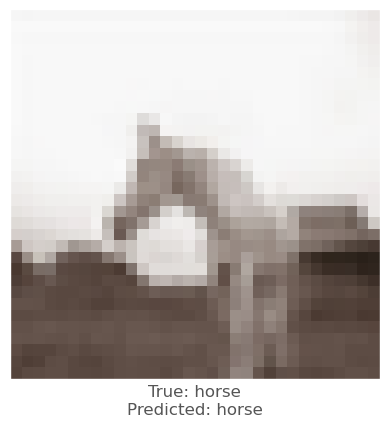



-0.0021865964
-0.0069168806
-0.003237486
vr, vg, vb :   0.2186596393585205 0.691688060760498 0.3237485885620117
beam_perturbed_confidence temp :  0.72159946
beam_perturbed_confidence temp :  0.72159946
beam_perturbed_confidence temp :  0.72159946
beam_perturbed_confidence temp :  0.72159946
beam_perturbed_confidence temp :  0.72159946
beam_perturbed_confidence temp :  0.72159946
beam_perturbed_confidence temp :  0.72159946
row index :  0
0th round's confidence : 1th 0.72159946
predicted class :  horse
predicted class's confidence :  0.72159946
Lopt is :  5


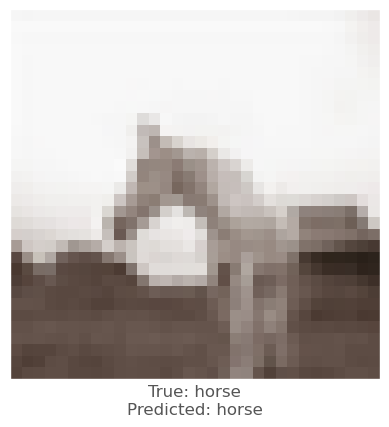



0.0047548413
-0.00039851665
-1.3947487e-05
vr, vg, vb :   -0.47548413276672363 0.03985166549682617 0.0013947486877441406
beam_perturbed_confidence temp :  0.69652367
beam_perturbed_confidence temp :  0.69933164
beam_perturbed_confidence temp :  0.69933164
beam_perturbed_confidence temp :  0.69652367
beam_perturbed_confidence temp :  0.69652367
beam_perturbed_confidence temp :  0.69933164
beam_perturbed_confidence temp :  0.69652367
row index :  0
0th round's confidence : 2th 0.69652367
predicted class :  horse
predicted class's confidence :  0.69652367
Lopt is :  5


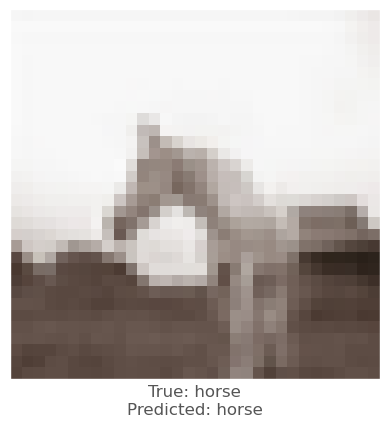



-0.0006929636
-0.0044757724
-0.0032199621
vr, vg, vb :   0.06929636001586914 0.44757723808288574 0.32199621200561523
beam_perturbed_confidence temp :  0.7448139
beam_perturbed_confidence temp :  0.7448139
beam_perturbed_confidence temp :  0.7448139
beam_perturbed_confidence temp :  0.7448139
beam_perturbed_confidence temp :  0.7448139
beam_perturbed_confidence temp :  0.7448139
beam_perturbed_confidence temp :  0.7448139
row index :  0
0th round's confidence : 3th 0.7448139
predicted class :  horse
predicted class's confidence :  0.7448139
Lopt is :  10


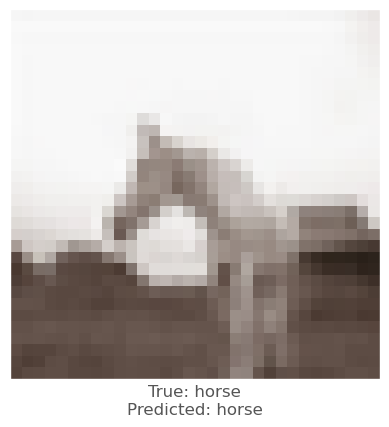



0.0036100745
-0.0011227727
-0.0002847314
vr, vg, vb :   -0.3610074520111084 0.11227726936340332 0.0284731388092041
beam_perturbed_confidence temp :  0.69396096
beam_perturbed_confidence temp :  0.69543076
beam_perturbed_confidence temp :  0.69543076
beam_perturbed_confidence temp :  0.69396096
beam_perturbed_confidence temp :  0.69396096
beam_perturbed_confidence temp :  0.69543076
beam_perturbed_confidence temp :  0.69396096
row index :  0
0th round's confidence : 4th 0.69396096
predicted class :  horse
predicted class's confidence :  0.69396096
Lopt is :  10


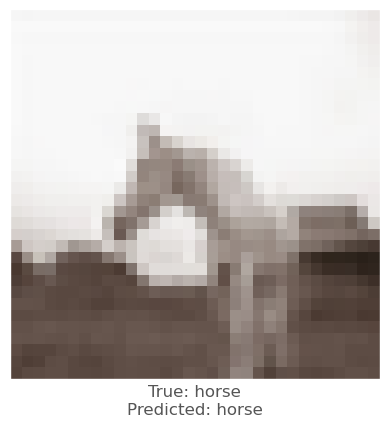



-0.00010728836
-0.005650997
-0.0017745495
vr, vg, vb :   -0.06841778755187988 0.9553289413452148 0.30575037002563477
beam_perturbed_confidence temp :  0.69684273
beam_perturbed_confidence temp :  0.69669783
beam_perturbed_confidence temp :  0.69669783
beam_perturbed_confidence temp :  0.69684273
beam_perturbed_confidence temp :  0.69684273
beam_perturbed_confidence temp :  0.69669783
beam_perturbed_confidence temp :  0.69684273
row index :  1
1th round's confidence : 0th 0.69669783
predicted class :  horse
predicted class's confidence :  0.69669783
Lopt is :  1


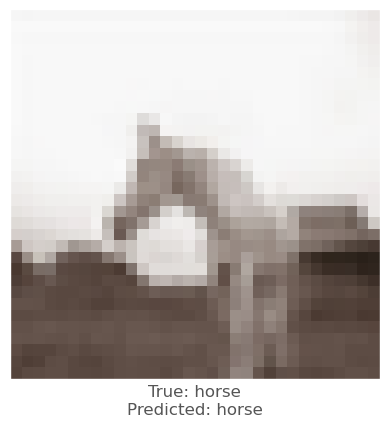



-0.0021865964
-0.0069168806
-0.003237486
vr, vg, vb :   0.41545331478118896 1.3142073154449463 0.6151223182678223
beam_perturbed_confidence temp :  0.72159946
beam_perturbed_confidence temp :  0.7182511
beam_perturbed_confidence temp :  0.72159946
beam_perturbed_confidence temp :  0.7182511
beam_perturbed_confidence temp :  0.72159946
beam_perturbed_confidence temp :  0.7182511
beam_perturbed_confidence temp :  0.7182511
row index :  1
1th round's confidence : 1th 0.7182511
predicted class :  horse
predicted class's confidence :  0.7182511
Lopt is :  5


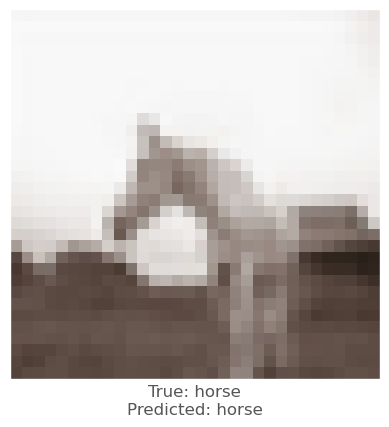



0.003947556
-0.001722455
-0.0013850927
vr, vg, vb :   -0.8226913213729858 0.20811200141906738 0.13976454734802246
beam_perturbed_confidence temp :  0.6953841
beam_perturbed_confidence temp :  0.69652367
beam_perturbed_confidence temp :  0.69652367
beam_perturbed_confidence temp :  0.6953841
beam_perturbed_confidence temp :  0.6953841
beam_perturbed_confidence temp :  0.69652367
beam_perturbed_confidence temp :  0.6953841
row index :  0
1th round's confidence : 2th 0.6953841
predicted class :  horse
predicted class's confidence :  0.6953841
Lopt is :  5


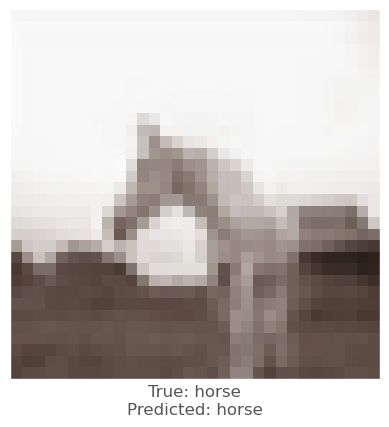



-0.0006929636
-0.0044757724
-0.0032199621
vr, vg, vb :   0.13166308403015137 0.8503967523574829 0.611792802810669
beam_perturbed_confidence temp :  0.7448139
beam_perturbed_confidence temp :  0.7448139
beam_perturbed_confidence temp :  0.7448139
beam_perturbed_confidence temp :  0.7448139
beam_perturbed_confidence temp :  0.7448139
beam_perturbed_confidence temp :  0.7448139
beam_perturbed_confidence temp :  0.7448139
row index :  0
1th round's confidence : 3th 0.7448139
predicted class :  horse
predicted class's confidence :  0.7448139
Lopt is :  10


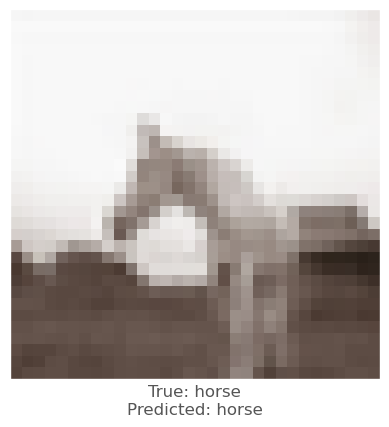



0.0025622845
-0.0016412735
-0.0005568266
vr, vg, vb :   -0.5811351537704468 0.2651768922805786 0.08130848407745361
beam_perturbed_confidence temp :  0.6928685
beam_perturbed_confidence temp :  0.69396096
beam_perturbed_confidence temp :  0.69396096
beam_perturbed_confidence temp :  0.6928685
beam_perturbed_confidence temp :  0.6928685
beam_perturbed_confidence temp :  0.69396096
beam_perturbed_confidence temp :  0.6928685
row index :  0
1th round's confidence : 4th 0.6928685
predicted class :  horse
predicted class's confidence :  0.6928685
Lopt is :  10


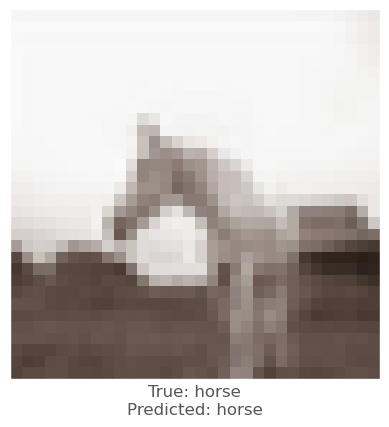



-0.00010728836
-0.005650997
-0.0017745495
vr, vg, vb :   -0.05084717273712158 1.4248957633972168 0.45263028144836426
beam_perturbed_confidence temp :  0.69684273
beam_perturbed_confidence temp :  0.69416577
beam_perturbed_confidence temp :  0.69669783
beam_perturbed_confidence temp :  0.6937914
beam_perturbed_confidence temp :  0.69684273
beam_perturbed_confidence temp :  0.69416577
beam_perturbed_confidence temp :  0.6937914
row index :  3
2th round's confidence : 0th 0.6937914
predicted class :  horse
predicted class's confidence :  0.6937914
Lopt is :  2


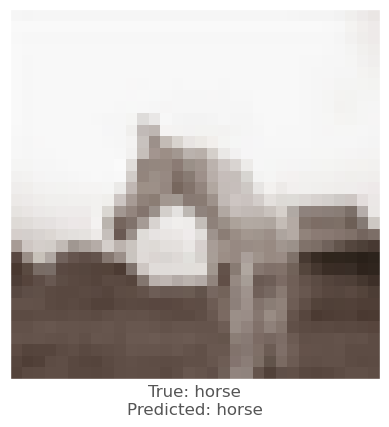



-0.0022015572
-0.0070883036
-0.0030151606
vr, vg, vb :   0.5940636992454529 1.891616940498352 0.855126142501831
beam_perturbed_confidence temp :  0.7182511
beam_perturbed_confidence temp :  0.71451116
beam_perturbed_confidence temp :  0.7182511
beam_perturbed_confidence temp :  0.71451116
beam_perturbed_confidence temp :  0.7182511
beam_perturbed_confidence temp :  0.71451116
beam_perturbed_confidence temp :  0.71451116
row index :  1
2th round's confidence : 1th 0.71451116
predicted class :  horse
predicted class's confidence :  0.71451116
Lopt is :  5


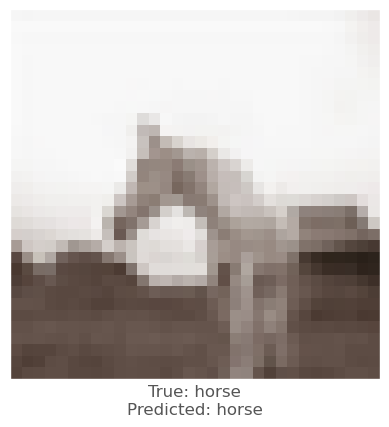



0.002654612
-0.0036851168
-0.0027555823
vr, vg, vb :   -1.0058833956718445 0.5558124780654907 0.4013463258743286
beam_perturbed_confidence temp :  0.69251066
beam_perturbed_confidence temp :  0.6953841
beam_perturbed_confidence temp :  0.6953841
beam_perturbed_confidence temp :  0.69251066
beam_perturbed_confidence temp :  0.69251066
beam_perturbed_confidence temp :  0.6953841
beam_perturbed_confidence temp :  0.69251066
row index :  0
2th round's confidence : 2th 0.69251066
predicted class :  horse
predicted class's confidence :  0.69251066
Lopt is :  5


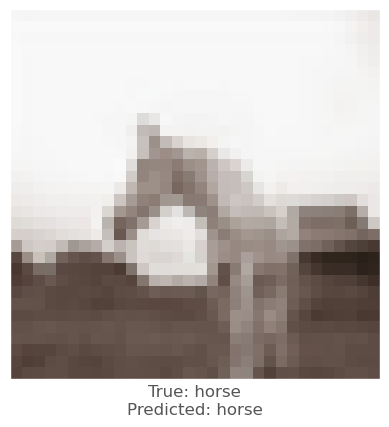



-0.0006929636
-0.0044757724
-0.0032199621
vr, vg, vb :   0.18779313564300537 1.2129343152046204 0.8726097345352173
beam_perturbed_confidence temp :  0.7448139
beam_perturbed_confidence temp :  0.74234617
beam_perturbed_confidence temp :  0.7448139
beam_perturbed_confidence temp :  0.74234617
beam_perturbed_confidence temp :  0.7448139
beam_perturbed_confidence temp :  0.74234617
beam_perturbed_confidence temp :  0.74234617
row index :  1
2th round's confidence : 3th 0.74234617
predicted class :  horse
predicted class's confidence :  0.74234617
Lopt is :  10


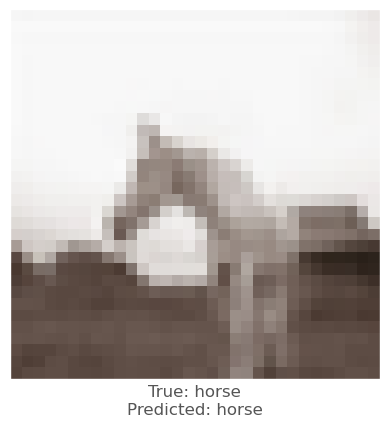



0.0020911098
-0.0020427108
-0.00084745884
vr, vg, vb :   -0.732132613658905 0.44293028116226196 0.15792351961135864
beam_perturbed_confidence temp :  0.69186985
beam_perturbed_confidence temp :  0.6928685
beam_perturbed_confidence temp :  0.6928685
beam_perturbed_confidence temp :  0.69186985
beam_perturbed_confidence temp :  0.69186985
beam_perturbed_confidence temp :  0.6928685
beam_perturbed_confidence temp :  0.69186985
row index :  0
2th round's confidence : 4th 0.69186985
predicted class :  horse
predicted class's confidence :  0.69186985
Lopt is :  10


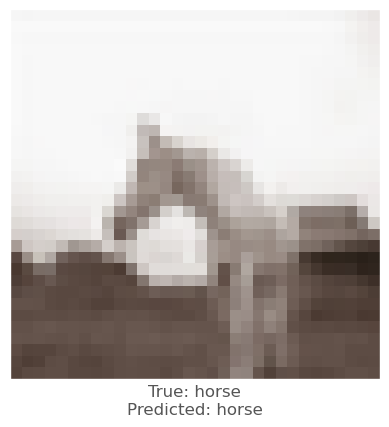



0.0016331077
-0.006398976
-0.0021056533
vr, vg, vb :   -0.2090732216835022 1.9223037719726563 0.6179325819015503
beam_perturbed_confidence temp :  0.69253266
beam_perturbed_confidence temp :  0.69044375
beam_perturbed_confidence temp :  0.6937914
beam_perturbed_confidence temp :  0.6894217
beam_perturbed_confidence temp :  0.69253266
beam_perturbed_confidence temp :  0.69044375
beam_perturbed_confidence temp :  0.6894217
row index :  3
3th round's confidence : 0th 0.6894217
predicted class :  horse
predicted class's confidence :  0.6894217
Lopt is :  3


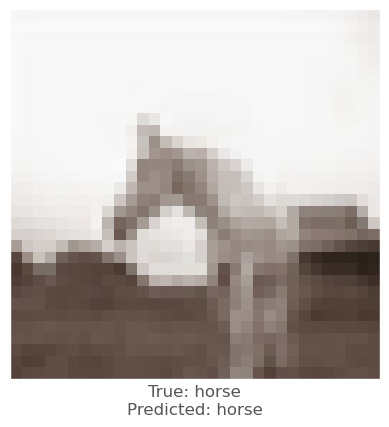



-0.0035344958
-0.008743882
-0.0038054585
vr, vg, vb :   0.8881069123744965 2.5768434643745426 1.1501593828201293
beam_perturbed_confidence temp :  0.71451116
beam_perturbed_confidence temp :  0.70427686
beam_perturbed_confidence temp :  0.712256
beam_perturbed_confidence temp :  0.70427686
beam_perturbed_confidence temp :  0.712256
beam_perturbed_confidence temp :  0.7020015
beam_perturbed_confidence temp :  0.7020015
row index :  5
3th round's confidence : 1th 0.7020015
predicted class :  horse
predicted class's confidence :  0.7020015
Lopt is :  5


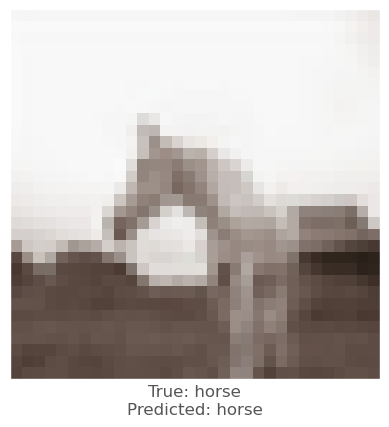



0.003156066
-0.0033795238
-0.0027953982
vr, vg, vb :   -1.2209016501903536 0.838183605670929 0.6407515168190003
beam_perturbed_confidence temp :  0.6882152
beam_perturbed_confidence temp :  0.69251066
beam_perturbed_confidence temp :  0.69251066
beam_perturbed_confidence temp :  0.6882152
beam_perturbed_confidence temp :  0.6882152
beam_perturbed_confidence temp :  0.69251066
beam_perturbed_confidence temp :  0.6882152
row index :  0
3th round's confidence : 2th 0.6882152
predicted class :  horse
predicted class's confidence :  0.6882152
Lopt is :  5


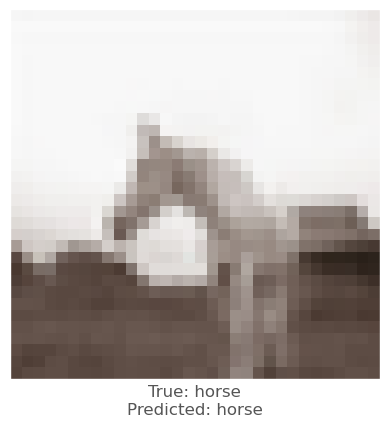



-0.00031399727
-0.004600525
-0.0031504035
vr, vg, vb :   0.2004135489463806 1.5516933739185335 1.1003891110420227
beam_perturbed_confidence temp :  0.74234617
beam_perturbed_confidence temp :  0.7402134
beam_perturbed_confidence temp :  0.74088633
beam_perturbed_confidence temp :  0.7402134
beam_perturbed_confidence temp :  0.74088633
beam_perturbed_confidence temp :  0.73892254
beam_perturbed_confidence temp :  0.73892254
row index :  5
3th round's confidence : 3th 0.73892254
predicted class :  horse
predicted class's confidence :  0.73892254
Lopt is :  10


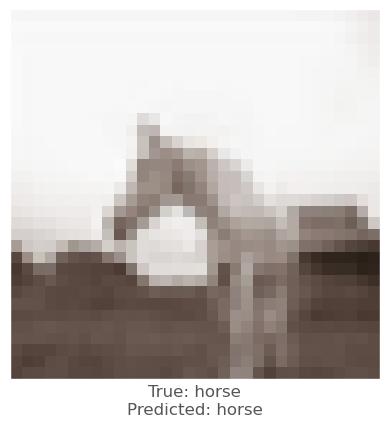



0.0021785498
-0.0026522875
-0.0006712079
vr, vg, vb :   -0.8767743289470673 0.663866001367569 0.20925195813179018
beam_perturbed_confidence temp :  0.6906899
beam_perturbed_confidence temp :  0.69186985
beam_perturbed_confidence temp :  0.69186985
beam_perturbed_confidence temp :  0.6906899
beam_perturbed_confidence temp :  0.6906899
beam_perturbed_confidence temp :  0.69186985
beam_perturbed_confidence temp :  0.6906899
row index :  0
3th round's confidence : 4th 0.6906899
predicted class :  horse
predicted class's confidence :  0.6906899
Lopt is :  10


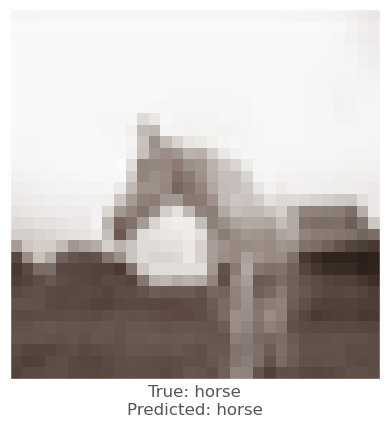



0.002081871
-0.006036997
-0.0025493503
vr, vg, vb :   -0.3963530027866363 2.3337730789184574 0.8110743498802185
beam_perturbed_confidence temp :  0.6883619
beam_perturbed_confidence temp :  0.68411756
beam_perturbed_confidence temp :  0.6894217
beam_perturbed_confidence temp :  0.68239444
beam_perturbed_confidence temp :  0.6883619
beam_perturbed_confidence temp :  0.68411756
beam_perturbed_confidence temp :  0.68239444
row index :  3
4th round's confidence : 0th 0.68239444
predicted class :  horse
predicted class's confidence :  0.68239444
Lopt is :  4


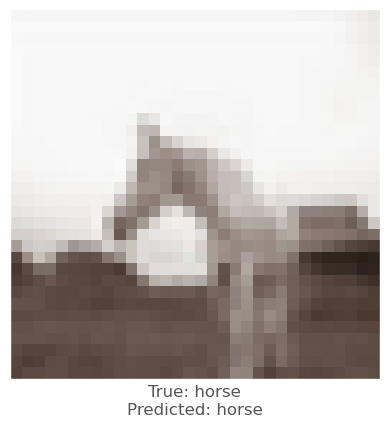



-0.0029544234
-0.008770585
-0.00371176
vr, vg, vb :   1.0947385638952256 3.1962176239490514 1.4063194489479065
beam_perturbed_confidence temp :  0.7012549
beam_perturbed_confidence temp :  0.6921951
beam_perturbed_confidence temp :  0.7005651
beam_perturbed_confidence temp :  0.6929104
beam_perturbed_confidence temp :  0.70017606
beam_perturbed_confidence temp :  0.6906204
beam_perturbed_confidence temp :  0.6914343
row index :  5
4th round's confidence : 1th 0.6906204
predicted class :  horse
predicted class's confidence :  0.6906204
Lopt is :  5


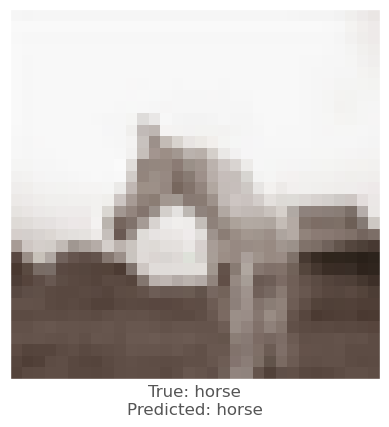



0.0058725476
-0.0014503002
-0.0013036132
vr, vg, vb :   -1.6860662478208543 0.8993952667713165 0.7070376837253571
beam_perturbed_confidence temp :  0.6826015
beam_perturbed_confidence temp :  0.6882152
beam_perturbed_confidence temp :  0.6882152
beam_perturbed_confidence temp :  0.6826015
beam_perturbed_confidence temp :  0.6826015
beam_perturbed_confidence temp :  0.6882152
beam_perturbed_confidence temp :  0.6826015
row index :  0
4th round's confidence : 2th 0.6826015
predicted class :  horse
predicted class's confidence :  0.6826015
Lopt is :  5


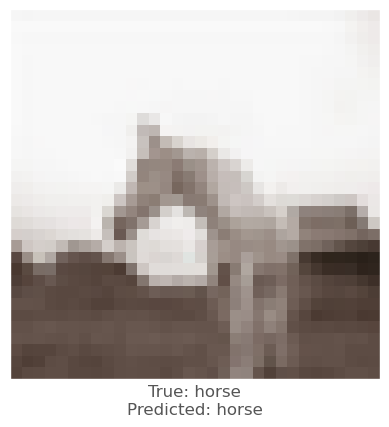



-0.00025963783
-0.004609525
-0.002526641
vr, vg, vb :   0.2063359773159027 1.8574765568971636 1.2430142891407012
beam_perturbed_confidence temp :  0.73892254
beam_perturbed_confidence temp :  0.7362768
beam_perturbed_confidence temp :  0.73768675
beam_perturbed_confidence temp :  0.7362768
beam_perturbed_confidence temp :  0.73768675
beam_perturbed_confidence temp :  0.7348949
beam_perturbed_confidence temp :  0.7348949
row index :  5
4th round's confidence : 3th 0.7348949
predicted class :  horse
predicted class's confidence :  0.7348949
Lopt is :  10


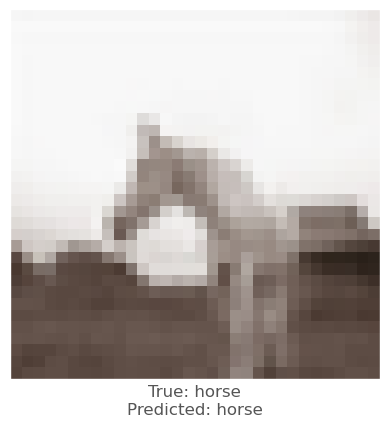



0.0022066832
-0.0023977757
-0.00085425377
vr, vg, vb :   -1.0097652119398117 0.8372569662332535 0.273752139210701
beam_perturbed_confidence temp :  0.6888615
beam_perturbed_confidence temp :  0.6906899
beam_perturbed_confidence temp :  0.6906899
beam_perturbed_confidence temp :  0.6888615
beam_perturbed_confidence temp :  0.6888615
beam_perturbed_confidence temp :  0.6906899
beam_perturbed_confidence temp :  0.6888615
row index :  0
4th round's confidence : 4th 0.6888615
predicted class :  horse
predicted class's confidence :  0.6888615
Lopt is :  10


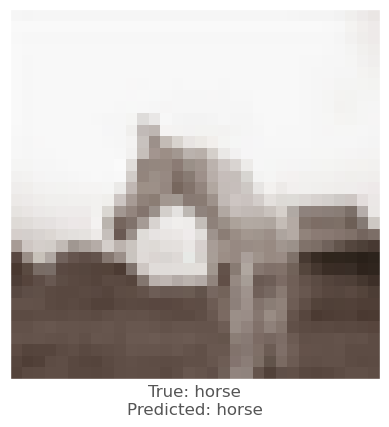



0.0030819774
-0.0050643086
-0.0025093555
vr, vg, vb :   -0.6649154392480849 2.606826635360718 0.9809024693965912
beam_perturbed_confidence temp :  0.6810356
beam_perturbed_confidence temp :  0.6793024
beam_perturbed_confidence temp :  0.68239444
beam_perturbed_confidence temp :  0.67668253
beam_perturbed_confidence temp :  0.6810356
beam_perturbed_confidence temp :  0.6793024
beam_perturbed_confidence temp :  0.67668253
row index :  3
5th round's confidence : 0th 0.67668253
predicted class :  horse
predicted class's confidence :  0.67668253
Lopt is :  6


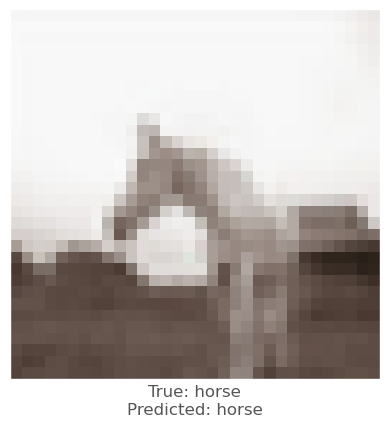



0.0010749102
-0.006466031
-0.0030052066
vr, vg, vb :   0.8777736911177636 3.523198969006539 1.566208162546158
beam_perturbed_confidence temp :  0.6906204
beam_perturbed_confidence temp :  0.6818513
beam_perturbed_confidence temp :  0.6891899
beam_perturbed_confidence temp :  0.6818513
beam_perturbed_confidence temp :  0.6891899
beam_perturbed_confidence temp :  0.680708
beam_perturbed_confidence temp :  0.680708
row index :  5
5th round's confidence : 1th 0.680708
predicted class :  horse
predicted class's confidence :  0.680708
Lopt is :  5


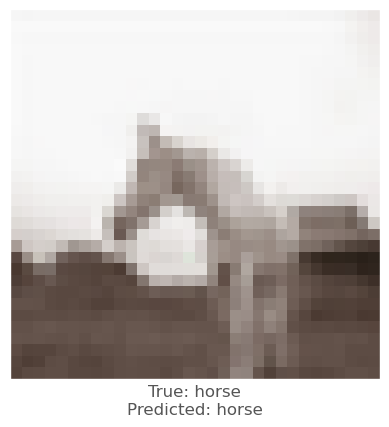



0.004600227
-0.0016208887
-0.0009506941
vr, vg, vb :   -1.9774823109507562 0.9715446110963821 0.7314033237695695
beam_perturbed_confidence temp :  0.6781688
beam_perturbed_confidence temp :  0.6826015
beam_perturbed_confidence temp :  0.6826015
beam_perturbed_confidence temp :  0.6781688
beam_perturbed_confidence temp :  0.6781688
beam_perturbed_confidence temp :  0.6826015
beam_perturbed_confidence temp :  0.6781688
row index :  0
5th round's confidence : 2th 0.6781688
predicted class :  horse
predicted class's confidence :  0.6781688
Lopt is :  5


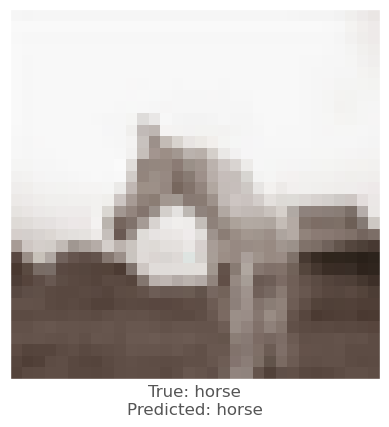



-0.0005592704
-0.005512655
-0.0027647018
vr, vg, vb :   0.24162941777706146 2.2229943793416025 1.395183044552803
beam_perturbed_confidence temp :  0.7348949
beam_perturbed_confidence temp :  0.7296571
beam_perturbed_confidence temp :  0.7335121
beam_perturbed_confidence temp :  0.7296571
beam_perturbed_confidence temp :  0.7335121
beam_perturbed_confidence temp :  0.7286551
beam_perturbed_confidence temp :  0.7286551
row index :  5
5th round's confidence : 3th 0.7286551
predicted class :  horse
predicted class's confidence :  0.7286551
Lopt is :  10


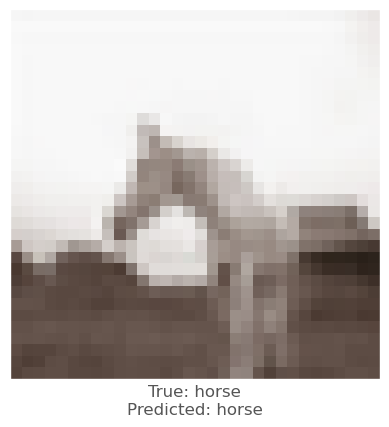



0.002306819
-0.0021048188
-0.0009471774
vr, vg, vb :   -1.1394705869555475 0.9640131517052651 0.3410946663022042
beam_perturbed_confidence temp :  0.68572026
beam_perturbed_confidence temp :  0.6888615
beam_perturbed_confidence temp :  0.6888615
beam_perturbed_confidence temp :  0.68572026
beam_perturbed_confidence temp :  0.68572026
beam_perturbed_confidence temp :  0.6888615
beam_perturbed_confidence temp :  0.68572026
row index :  0
5th round's confidence : 4th 0.68572026
predicted class :  horse
predicted class's confidence :  0.68572026
Lopt is :  10


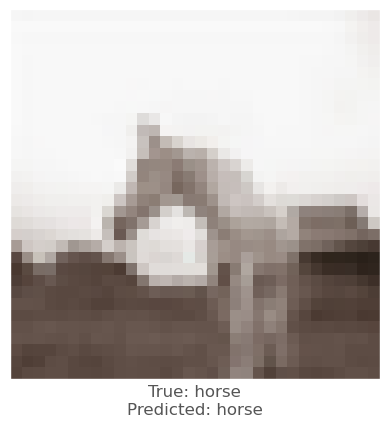



0.0036014915
-0.0018965006
-0.0013407469
vr, vg, vb :   -0.9585730404496192 2.535794030570984 1.0168869104146958
beam_perturbed_confidence temp :  0.6757009
beam_perturbed_confidence temp :  0.677415
beam_perturbed_confidence temp :  0.6763864
beam_perturbed_confidence temp :  0.6746396
beam_perturbed_confidence temp :  0.6746914
beam_perturbed_confidence temp :  0.67768896
beam_perturbed_confidence temp :  0.67495656
row index :  3
6th round's confidence : 0th 0.6746396
predicted class :  horse
predicted class's confidence :  0.6746396
Lopt is :  8


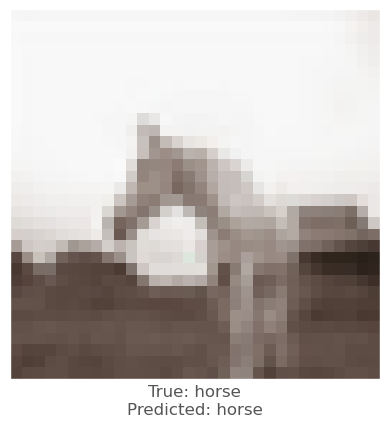



0.0032339692
-0.004489422
-0.0020158887
vr, vg, vb :   0.4665994008481503 3.6198212565541272 1.6111762153863909
beam_perturbed_confidence temp :  0.680708
beam_perturbed_confidence temp :  0.6773055
beam_perturbed_confidence temp :  0.67983544
beam_perturbed_confidence temp :  0.6773055
beam_perturbed_confidence temp :  0.67983544
beam_perturbed_confidence temp :  0.6772317
beam_perturbed_confidence temp :  0.6772317
row index :  5
6th round's confidence : 1th 0.6772317
predicted class :  horse
predicted class's confidence :  0.6772317
Lopt is :  8


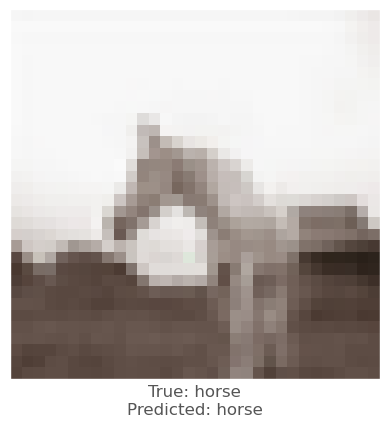



0.004116833
-0.00055891275
0.0008934736
vr, vg, vb :   -2.191417400854826 0.9302814253926277 0.568915628874302
beam_perturbed_confidence temp :  0.67424256
beam_perturbed_confidence temp :  0.6781688
beam_perturbed_confidence temp :  0.6781688
beam_perturbed_confidence temp :  0.67424256
beam_perturbed_confidence temp :  0.67424256
beam_perturbed_confidence temp :  0.6781688
beam_perturbed_confidence temp :  0.67424256
row index :  0
6th round's confidence : 2th 0.67424256
predicted class :  horse
predicted class's confidence :  0.67424256
Lopt is :  8


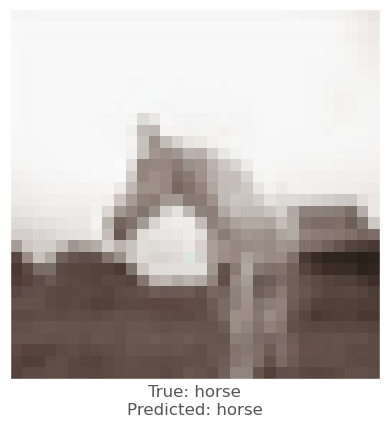



-0.00044757128
-0.00458616
-0.0018750429
vr, vg, vb :   0.26222360376119613 2.4593109597027305 1.4431690316319465
beam_perturbed_confidence temp :  0.7286551
beam_perturbed_confidence temp :  0.7239722
beam_perturbed_confidence temp :  0.7277821
beam_perturbed_confidence temp :  0.7239722
beam_perturbed_confidence temp :  0.7277821
beam_perturbed_confidence temp :  0.72304463
beam_perturbed_confidence temp :  0.72304463
row index :  5
6th round's confidence : 3th 0.72304463
predicted class :  horse
predicted class's confidence :  0.72304463
Lopt is :  10


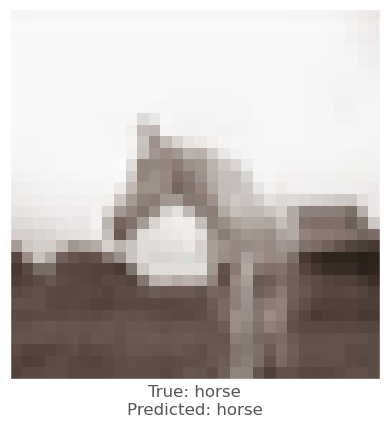



0.0031741261
-0.0020744205
-0.001714468
vr, vg, vb :   -1.3429361430823805 1.0750538817465305 0.4784319999039174
beam_perturbed_confidence temp :  0.6815141
beam_perturbed_confidence temp :  0.6842875
beam_perturbed_confidence temp :  0.68572026
beam_perturbed_confidence temp :  0.6813113
beam_perturbed_confidence temp :  0.6815141
beam_perturbed_confidence temp :  0.6842875
beam_perturbed_confidence temp :  0.6813113
row index :  3
6th round's confidence : 4th 0.6813113
predicted class :  horse
predicted class's confidence :  0.6813113
Lopt is :  11


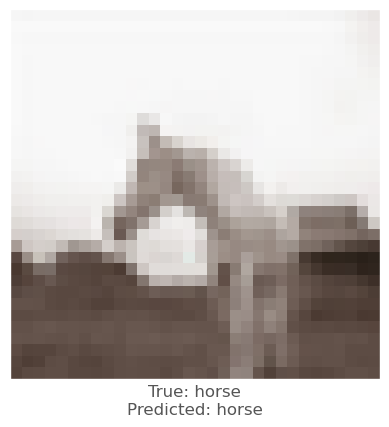



0.0049664974
0.001634419
0.00055396557
vr, vg, vb :   -1.3593654785311222 2.1187727310752873 0.8598016625189782
beam_perturbed_confidence temp :  0.6712727
beam_perturbed_confidence temp :  0.6761348
beam_perturbed_confidence temp :  0.6746396
beam_perturbed_confidence temp :  0.67157406
beam_perturbed_confidence temp :  0.6712727
beam_perturbed_confidence temp :  0.6761348
beam_perturbed_confidence temp :  0.67157406
row index :  0
7th round's confidence : 0th 0.6712727
predicted class :  horse
predicted class's confidence :  0.6712727
Lopt is :  8


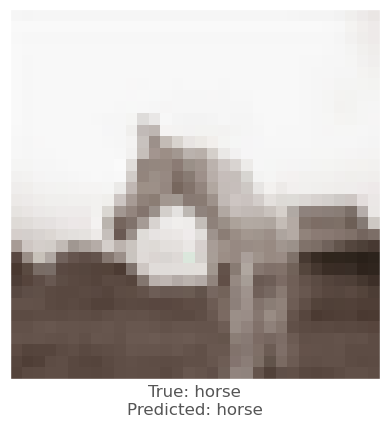



0.006168306
0.0014977455
0.00010949373
vr, vg, vb :   -0.19689112662374963 3.108064579507113 1.4391092206025127
beam_perturbed_confidence temp :  0.6744026
beam_perturbed_confidence temp :  0.6781033
beam_perturbed_confidence temp :  0.677415
beam_perturbed_confidence temp :  0.676005
beam_perturbed_confidence temp :  0.6746396
beam_perturbed_confidence temp :  0.6779441
beam_perturbed_confidence temp :  0.6755277
row index :  0
7th round's confidence : 1th 0.6744026
predicted class :  horse
predicted class's confidence :  0.6744026
Lopt is :  8


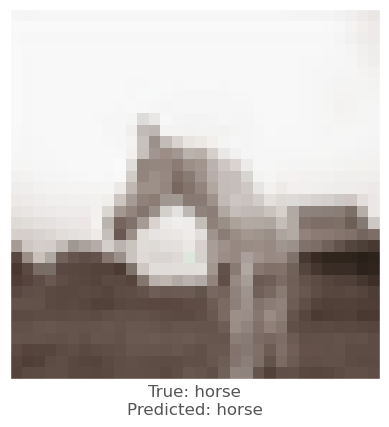



0.0011302233
-0.003843367
-0.00048726797
vr, vg, vb :   -2.0852979881924396 1.2215899928295613 0.5607508630907537
beam_perturbed_confidence temp :  0.67361385
beam_perturbed_confidence temp :  0.67275393
beam_perturbed_confidence temp :  0.67424256
beam_perturbed_confidence temp :  0.67108303
beam_perturbed_confidence temp :  0.67361385
beam_perturbed_confidence temp :  0.67275393
beam_perturbed_confidence temp :  0.67108303
row index :  3
7th round's confidence : 2th 0.67108303
predicted class :  horse
predicted class's confidence :  0.67108303
Lopt is :  11


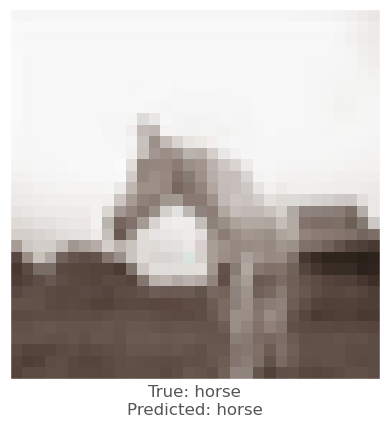



-0.0029334426
-0.0059482455
-0.0018365383
vr, vg, vb :   0.5293455026471615 2.808204416268468 1.4825059599506856
beam_perturbed_confidence temp :  0.72304463
beam_perturbed_confidence temp :  0.71552664
beam_perturbed_confidence temp :  0.72213566
beam_perturbed_confidence temp :  0.71552664
beam_perturbed_confidence temp :  0.72213566
beam_perturbed_confidence temp :  0.7140131
beam_perturbed_confidence temp :  0.7140131
row index :  5
7th round's confidence : 3th 0.7140131
predicted class :  horse
predicted class's confidence :  0.7140131
Lopt is :  10


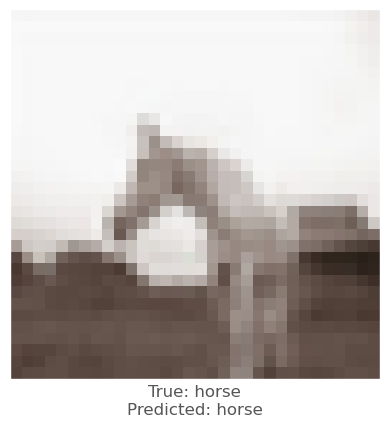



0.0031104684
-0.0020596385
-0.0017579794
vr, vg, vb :   -1.5196893675345184 1.1735123435932397 0.6063867392140627
beam_perturbed_confidence temp :  0.6771046
beam_perturbed_confidence temp :  0.67945445
beam_perturbed_confidence temp :  0.6813113
beam_perturbed_confidence temp :  0.6765827
beam_perturbed_confidence temp :  0.6771046
beam_perturbed_confidence temp :  0.67945445
beam_perturbed_confidence temp :  0.6765827
row index :  3
7th round's confidence : 4th 0.6765827
predicted class :  horse
predicted class's confidence :  0.6765827
Lopt is :  12


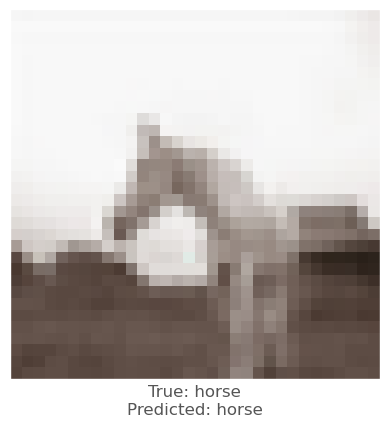



0.001714468
-0.0016273856
-0.0009664297
vr, vg, vb :   -1.3948757309099435 2.0696340195980074 0.8704644673058988
beam_perturbed_confidence temp :  0.6702736
beam_perturbed_confidence temp :  0.67157406
beam_perturbed_confidence temp :  0.6712727
beam_perturbed_confidence temp :  0.66733223
beam_perturbed_confidence temp :  0.6702736
beam_perturbed_confidence temp :  0.67157406
beam_perturbed_confidence temp :  0.66733223
row index :  3
8th round's confidence : 0th 0.66733223
predicted class :  horse
predicted class's confidence :  0.66733223
Lopt is :  10


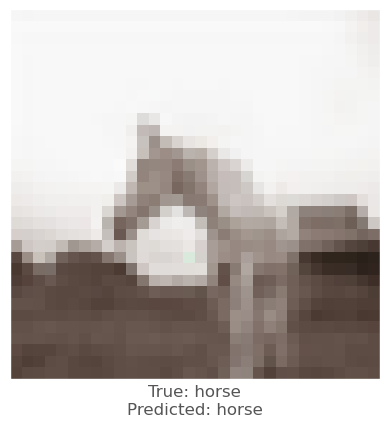



0.0045601726
0.000600934
0.00022095442
vr, vg, vb :   -0.6332192697444557 2.7371647186938532 1.2731028567240241
beam_perturbed_confidence temp :  0.67267156
beam_perturbed_confidence temp :  0.67618734
beam_perturbed_confidence temp :  0.6746396
beam_perturbed_confidence temp :  0.6736405
beam_perturbed_confidence temp :  0.6724485
beam_perturbed_confidence temp :  0.6761348
beam_perturbed_confidence temp :  0.6739974
row index :  4
8th round's confidence : 1th 0.6724485
predicted class :  horse
predicted class's confidence :  0.6724485
Lopt is :  8


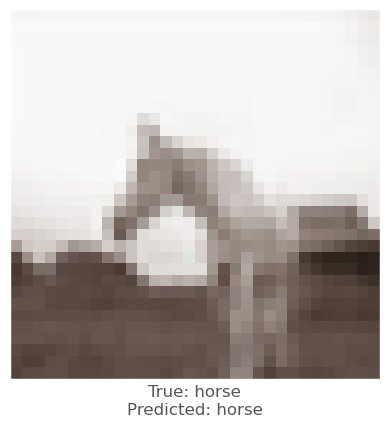



-0.00045722723
-0.0052016973
-0.001879096
vr, vg, vb :   -1.8310454663659936 1.619600728501439 0.6925853799005749
beam_perturbed_confidence temp :  0.6714113
beam_perturbed_confidence temp :  0.66841215
beam_perturbed_confidence temp :  0.67108303
beam_perturbed_confidence temp :  0.6694459
beam_perturbed_confidence temp :  0.6714113
beam_perturbed_confidence temp :  0.66841215
beam_perturbed_confidence temp :  0.6694459
row index :  1
8th round's confidence : 2th 0.66841215
predicted class :  horse
predicted class's confidence :  0.66841215
Lopt is :  11


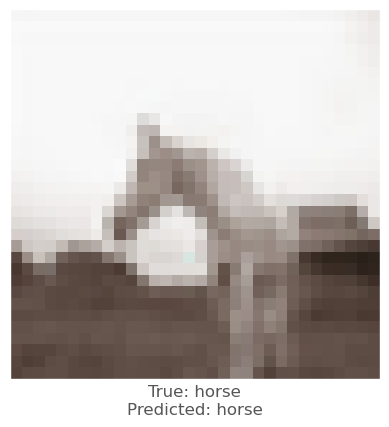



-0.0048042536
-0.008684695
-0.0028478503
vr, vg, vb :   0.9568363102010489 3.3958534513414502 1.6190403962279558
beam_perturbed_confidence temp :  0.7140131
beam_perturbed_confidence temp :  0.69996005
beam_perturbed_confidence temp :  0.7126788
beam_perturbed_confidence temp :  0.69996005
beam_perturbed_confidence temp :  0.7126788
beam_perturbed_confidence temp :  0.69759583
beam_perturbed_confidence temp :  0.69759583
row index :  5
8th round's confidence : 3th 0.69759583
predicted class :  horse
predicted class's confidence :  0.69759583
Lopt is :  10


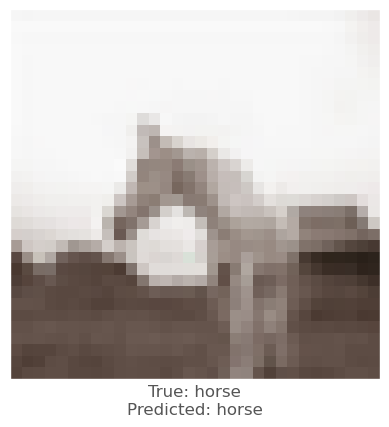



0.0034508705
-0.0027040243
-0.001293242
vr, vg, vb :   -1.7128074821726682 1.326563540721953 0.6750722630618216
beam_perturbed_confidence temp :  0.67344654
beam_perturbed_confidence temp :  0.67440057
beam_perturbed_confidence temp :  0.6765827
beam_perturbed_confidence temp :  0.6718763
beam_perturbed_confidence temp :  0.67344654
beam_perturbed_confidence temp :  0.67440057
beam_perturbed_confidence temp :  0.6718763
row index :  3
8th round's confidence : 4th 0.6718763
predicted class :  horse
predicted class's confidence :  0.6718763
Lopt is :  13


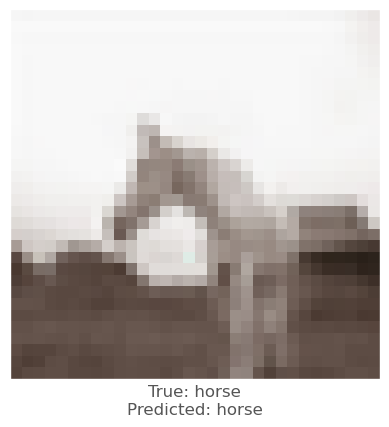



0.0030332208
-0.0016512871
0.000116825104
vr, vg, vb :   -1.5587102346164345 2.027799325523949 0.7717355101993324
beam_perturbed_confidence temp :  0.665686
beam_perturbed_confidence temp :  0.6669075
beam_perturbed_confidence temp :  0.66733223
beam_perturbed_confidence temp :  0.663001
beam_perturbed_confidence temp :  0.665686
beam_perturbed_confidence temp :  0.6669075
beam_perturbed_confidence temp :  0.663001
row index :  3
9th round's confidence : 0th 0.663001
predicted class :  horse
predicted class's confidence :  0.663001
Lopt is :  12


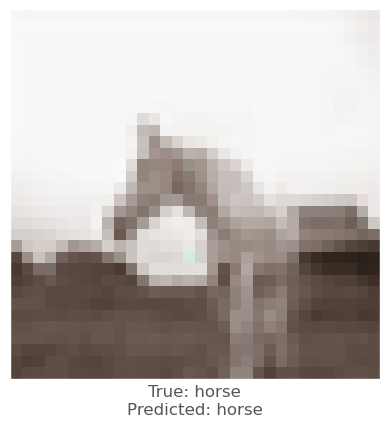



0.0033668876
-0.00030469894
-2.18153e-05
vr, vg, vb :   -0.9065860997127592 2.4939181412336477 1.147974101050401
beam_perturbed_confidence temp :  0.6712727
beam_perturbed_confidence temp :  0.6739974
beam_perturbed_confidence temp :  0.67264974
beam_perturbed_confidence temp :  0.67157406
beam_perturbed_confidence temp :  0.67086333
beam_perturbed_confidence temp :  0.6740095
beam_perturbed_confidence temp :  0.67174596
row index :  4
9th round's confidence : 1th 0.67086333
predicted class :  horse
predicted class's confidence :  0.67086333
Lopt is :  8


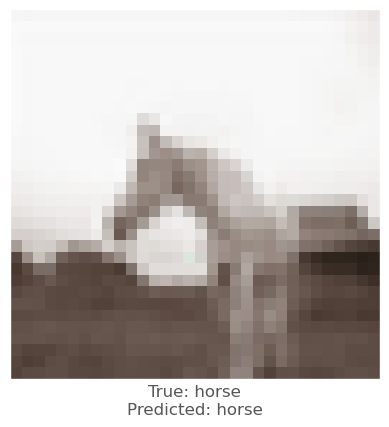



0.00078219175
-0.0034792423
-0.0014825463
vr, vg, vb :   -1.7261600950681395 1.8055648881342055 0.7715814748603466
beam_perturbed_confidence temp :  0.6694459
beam_perturbed_confidence temp :  0.6676038
beam_perturbed_confidence temp :  0.66841215
beam_perturbed_confidence temp :  0.666991
beam_perturbed_confidence temp :  0.6694459
beam_perturbed_confidence temp :  0.6676038
beam_perturbed_confidence temp :  0.666991
row index :  3
9th round's confidence : 2th 0.666991
predicted class :  horse
predicted class's confidence :  0.666991
Lopt is :  13


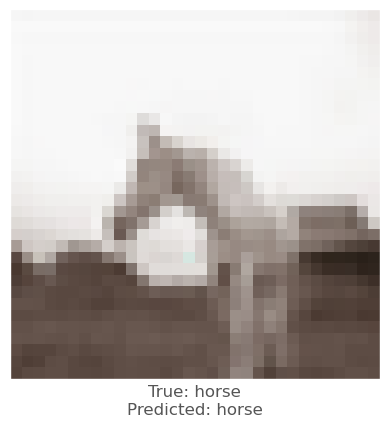



-0.005714774
-0.011473596
-0.0049111247
vr, vg, vb :   1.4326300923584343 4.203627715811187 1.9482488272319913
beam_perturbed_confidence temp :  0.69494945
beam_perturbed_confidence temp :  0.67918307
beam_perturbed_confidence temp :  0.6950489
beam_perturbed_confidence temp :  0.6782829
beam_perturbed_confidence temp :  0.6925819
beam_perturbed_confidence temp :  0.677527
beam_perturbed_confidence temp :  0.6772123
row index :  6
9th round's confidence : 3th 0.6772123
predicted class :  horse
predicted class's confidence :  0.6772123
Lopt is :  9


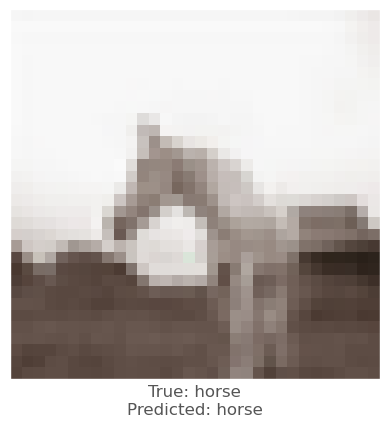



0.0024626255
-0.0036202073
-0.0013685226
vr, vg, vb :   -1.7877892843094054 1.5559279176220477 0.7444173011599363
beam_perturbed_confidence temp :  0.6691358
beam_perturbed_confidence temp :  0.6698263
beam_perturbed_confidence temp :  0.6718763
beam_perturbed_confidence temp :  0.6675844
beam_perturbed_confidence temp :  0.6691358
beam_perturbed_confidence temp :  0.6698263
beam_perturbed_confidence temp :  0.6675844
row index :  3
9th round's confidence : 4th 0.6675844
predicted class :  horse
predicted class's confidence :  0.6675844
Lopt is :  14


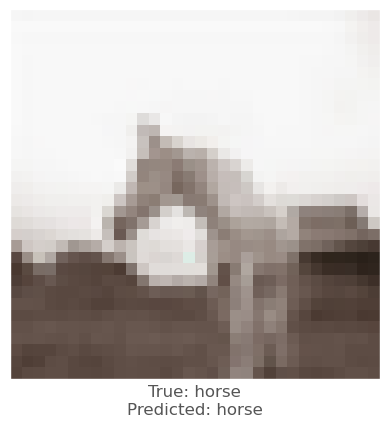



0.0032598972
-0.0016445518
0.00072818995
vr, vg, vb :   -1.7288289343603576 1.9894745683713344 0.6217429646573045
beam_perturbed_confidence temp :  0.6607411
beam_perturbed_confidence temp :  0.66213226
beam_perturbed_confidence temp :  0.663001
beam_perturbed_confidence temp :  0.6591563
beam_perturbed_confidence temp :  0.6607411
beam_perturbed_confidence temp :  0.66213226
beam_perturbed_confidence temp :  0.6591563
row index :  3
10th round's confidence : 0th 0.6591563
predicted class :  horse
predicted class's confidence :  0.6591563
Lopt is :  14


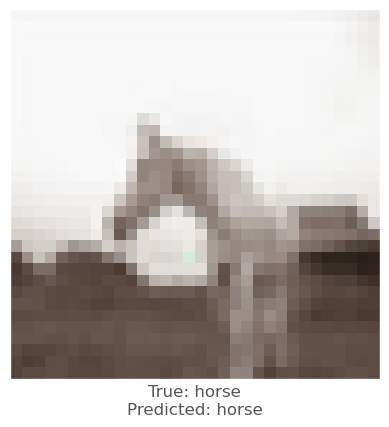



0.002597034
-0.00091552734
-0.00038576126
vr, vg, vb :   -1.0756308874923377 2.336079061485283 1.0717528170439938
beam_perturbed_confidence temp :  0.66978604
beam_perturbed_confidence temp :  0.67174596
beam_perturbed_confidence temp :  0.67088693
beam_perturbed_confidence temp :  0.66748166
beam_perturbed_confidence temp :  0.6691285
beam_perturbed_confidence temp :  0.6717899
beam_perturbed_confidence temp :  0.66757286
row index :  3
10th round's confidence : 1th 0.66748166
predicted class :  horse
predicted class's confidence :  0.66748166
Lopt is :  10


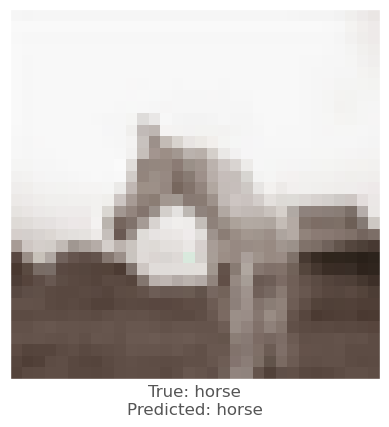



-0.0013298392
-0.004539609
-0.0017548203
vr, vg, vb :   -1.4205601626029516 2.0789692948591147 0.8699053620575394
beam_perturbed_confidence temp :  0.66840774
beam_perturbed_confidence temp :  0.66392994
beam_perturbed_confidence temp :  0.666991
beam_perturbed_confidence temp :  0.66405886
beam_perturbed_confidence temp :  0.66840774
beam_perturbed_confidence temp :  0.66392994
beam_perturbed_confidence temp :  0.66405886
row index :  1
10th round's confidence : 2th 0.66392994
predicted class :  horse
predicted class's confidence :  0.66392994
Lopt is :  13


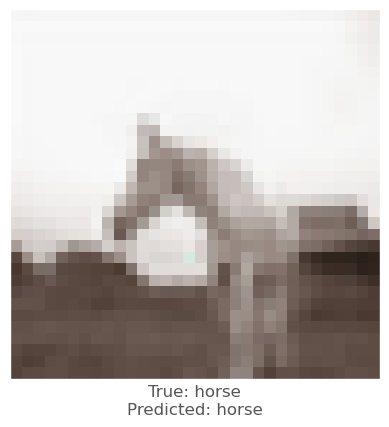



-0.00043225288
-0.005904913
-0.0020936728
vr, vg, vb :   1.3325923715137042 4.373756239090909 1.9627912197468294
beam_perturbed_confidence temp :  0.67709476
beam_perturbed_confidence temp :  0.66906345
beam_perturbed_confidence temp :  0.67618924
beam_perturbed_confidence temp :  0.670425
beam_perturbed_confidence temp :  0.6760002
beam_perturbed_confidence temp :  0.66881734
beam_perturbed_confidence temp :  0.6709115
row index :  5
10th round's confidence : 3th 0.66881734
predicted class :  horse
predicted class's confidence :  0.66881734
Lopt is :  10


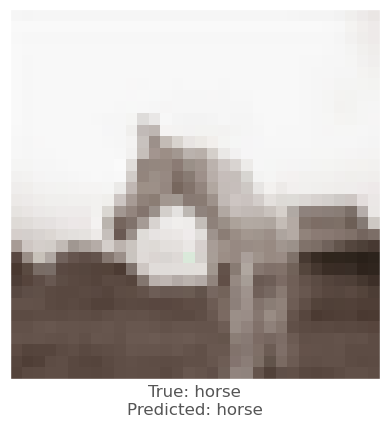



0.002393961
-0.004101455
-0.0019499063
vr, vg, vb :   -1.8484064511543439 1.8104806470237835 0.8649662059621556
beam_perturbed_confidence temp :  0.66297424
beam_perturbed_confidence temp :  0.66503435
beam_perturbed_confidence temp :  0.6675844
beam_perturbed_confidence temp :  0.66252625
beam_perturbed_confidence temp :  0.66297424
beam_perturbed_confidence temp :  0.66503435
beam_perturbed_confidence temp :  0.66252625
row index :  3
10th round's confidence : 4th 0.66252625
predicted class :  horse
predicted class's confidence :  0.66252625
Lopt is :  15


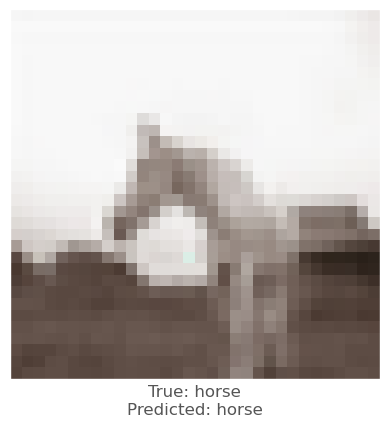



0.0023890138
-0.003075242
9.1671944e-05
vr, vg, vb :   -1.794847417648565 2.0980513157883514 0.550401473825119
beam_perturbed_confidence temp :  0.6578199
beam_perturbed_confidence temp :  0.6555253
beam_perturbed_confidence temp :  0.6591563
beam_perturbed_confidence temp :  0.65249527
beam_perturbed_confidence temp :  0.6578199
beam_perturbed_confidence temp :  0.6555253
beam_perturbed_confidence temp :  0.65249527
row index :  3
11th round's confidence : 0th 0.65249527
predicted class :  horse
predicted class's confidence :  0.65249527
Lopt is :  16


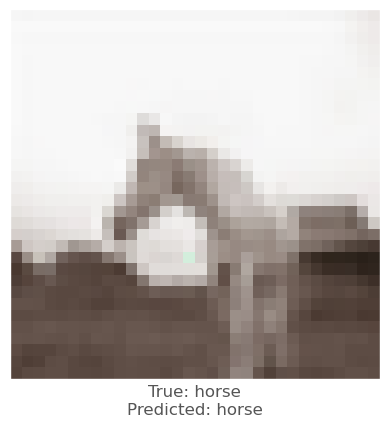



0.0035409331
-0.0009754896
0.00024062395
vr, vg, vb :   -1.3221611119602672 2.200020116976159 0.9405151402437693
beam_perturbed_confidence temp :  0.66530424
beam_perturbed_confidence temp :  0.6668595
beam_perturbed_confidence temp :  0.66748166
beam_perturbed_confidence temp :  0.6631529
beam_perturbed_confidence temp :  0.66530424
beam_perturbed_confidence temp :  0.6668595
beam_perturbed_confidence temp :  0.6631529
row index :  3
11th round's confidence : 1th 0.6631529
predicted class :  horse
predicted class's confidence :  0.6631529
Lopt is :  12


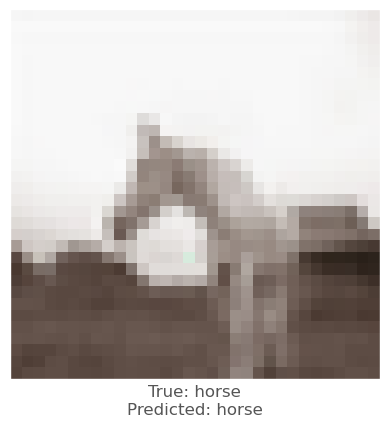



0.001860261
-0.0020434856
-3.194809e-05
vr, vg, vb :   -1.4645302426866507 2.0754209295211528 0.7861096348117464
beam_perturbed_confidence temp :  0.66405886
beam_perturbed_confidence temp :  0.66188407
beam_perturbed_confidence temp :  0.66392994
beam_perturbed_confidence temp :  0.6589805
beam_perturbed_confidence temp :  0.66405886
beam_perturbed_confidence temp :  0.66188407
beam_perturbed_confidence temp :  0.6589805
row index :  3
11th round's confidence : 2th 0.6589805
predicted class :  horse
predicted class's confidence :  0.6589805
Lopt is :  15


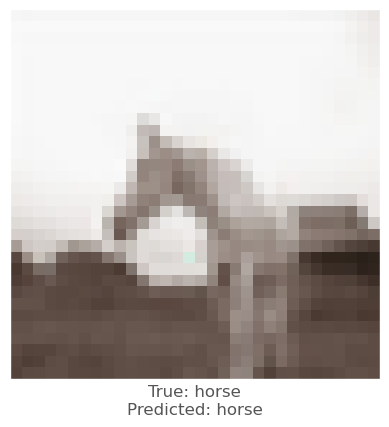



0.0031414032
-0.0011857748
-2.193451e-05
vr, vg, vb :   0.8851928145381152 4.05495809549798 1.7687055486998808
beam_perturbed_confidence temp :  0.66881734
beam_perturbed_confidence temp :  0.66684526
beam_perturbed_confidence temp :  0.6690415
beam_perturbed_confidence temp :  0.66684526
beam_perturbed_confidence temp :  0.6690415
beam_perturbed_confidence temp :  0.6661377
beam_perturbed_confidence temp :  0.6661377
row index :  5
11th round's confidence : 3th 0.6661377
predicted class :  horse
predicted class's confidence :  0.6661377
Lopt is :  14


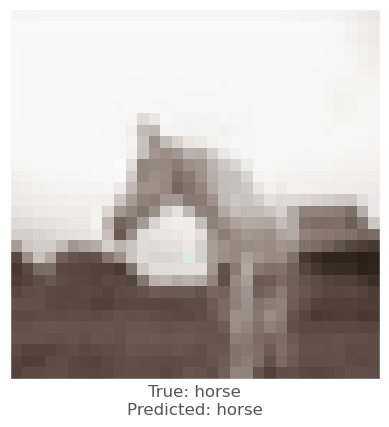



0.003841281
-0.003403008
-0.0008433461
vr, vg, vb :   -2.047693899758392 1.969733380737543 0.8628041972586402
beam_perturbed_confidence temp :  0.65333873
beam_perturbed_confidence temp :  0.65957123
beam_perturbed_confidence temp :  0.66252625
beam_perturbed_confidence temp :  0.6530042
beam_perturbed_confidence temp :  0.65333873
beam_perturbed_confidence temp :  0.65957123
beam_perturbed_confidence temp :  0.6530042
row index :  3
11th round's confidence : 4th 0.6530042
predicted class :  horse
predicted class's confidence :  0.6530042
Lopt is :  16


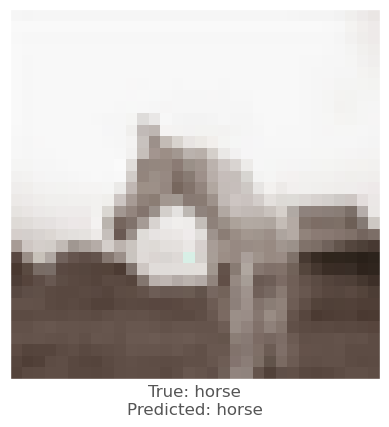



0.0020636916
-0.0061704516
-0.00092589855
vr, vg, vb :   -1.8217318374895435 2.5052913483177925 0.5879511816366989
beam_perturbed_confidence temp :  0.6506684
beam_perturbed_confidence temp :  0.6470688
beam_perturbed_confidence temp :  0.65249527
beam_perturbed_confidence temp :  0.64301956
beam_perturbed_confidence temp :  0.6506684
beam_perturbed_confidence temp :  0.6470688
beam_perturbed_confidence temp :  0.64301956
row index :  3
12th round's confidence : 0th 0.64301956
predicted class :  horse
predicted class's confidence :  0.64301956
Lopt is :  18


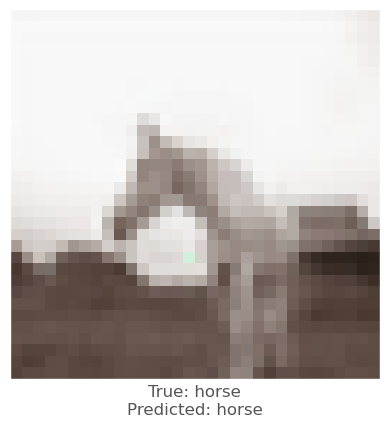



0.003311634
-0.001839757
0.00033152103
vr, vg, vb :   -1.5211084071363108 2.1639938018422638 0.81331152279532
beam_perturbed_confidence temp :  0.6605532
beam_perturbed_confidence temp :  0.65987605
beam_perturbed_confidence temp :  0.6631529
beam_perturbed_confidence temp :  0.65716225
beam_perturbed_confidence temp :  0.6605532
beam_perturbed_confidence temp :  0.65987605
beam_perturbed_confidence temp :  0.65716225
row index :  3
12th round's confidence : 1th 0.65716225
predicted class :  horse
predicted class's confidence :  0.65716225
Lopt is :  14


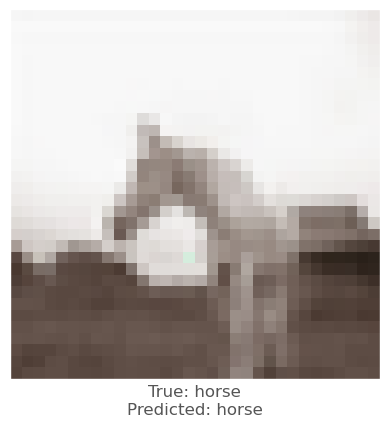



0.0006842613
-0.004832864
-0.0010326505
vr, vg, vb :   -1.386503350620134 2.3511652173368596 0.8107637184039361
beam_perturbed_confidence temp :  0.6594914
beam_perturbed_confidence temp :  0.6548676
beam_perturbed_confidence temp :  0.6589805
beam_perturbed_confidence temp :  0.6530111
beam_perturbed_confidence temp :  0.6594914
beam_perturbed_confidence temp :  0.6548676
beam_perturbed_confidence temp :  0.6530111
row index :  3
12th round's confidence : 2th 0.6530111
predicted class :  horse
predicted class's confidence :  0.6530111
Lopt is :  17


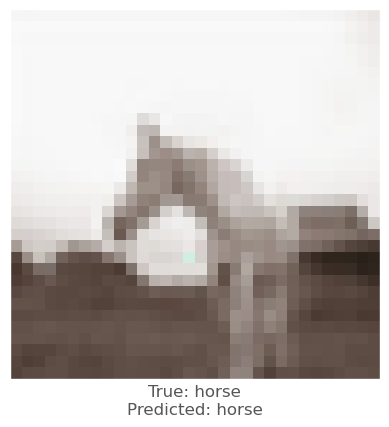



0.003963053
-0.0033519864
-0.0013037324
vr, vg, vb :   0.40036821043720894 3.9846609267715465 1.7222082333471047
beam_perturbed_confidence temp :  0.6661377
beam_perturbed_confidence temp :  0.6612504
beam_perturbed_confidence temp :  0.6655415
beam_perturbed_confidence temp :  0.6612504
beam_perturbed_confidence temp :  0.6655415
beam_perturbed_confidence temp :  0.6603842
beam_perturbed_confidence temp :  0.6603842
row index :  5
12th round's confidence : 3th 0.6603842
predicted class :  horse
predicted class's confidence :  0.6603842
Lopt is :  17


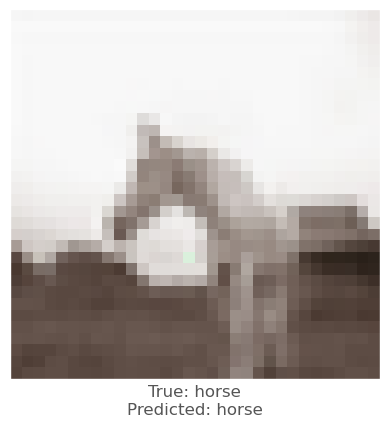



0.006256938
-0.0013003349
0.0011473894
vr, vg, vb :   -2.4686183078477386 1.902793535705781 0.6617848363401493
beam_perturbed_confidence temp :  0.64814705
beam_perturbed_confidence temp :  0.6520384
beam_perturbed_confidence temp :  0.6530042
beam_perturbed_confidence temp :  0.64525515
beam_perturbed_confidence temp :  0.64814705
beam_perturbed_confidence temp :  0.6520384
beam_perturbed_confidence temp :  0.64525515
row index :  3
12th round's confidence : 4th 0.64525515
predicted class :  horse
predicted class's confidence :  0.64525515
Lopt is :  17


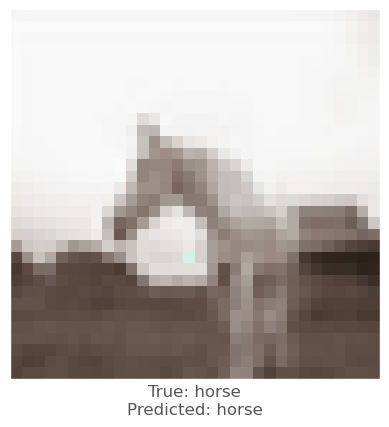



0.0013736486
-0.0075615644
-0.0016725063
vr, vg, vb :   -1.7769235180899543 3.010918658035574 0.6964066967127751
beam_perturbed_confidence temp :  0.6422896
beam_perturbed_confidence temp :  0.63471204
beam_perturbed_confidence temp :  0.64301956
beam_perturbed_confidence temp :  0.63094103
beam_perturbed_confidence temp :  0.6422896
beam_perturbed_confidence temp :  0.63471204
beam_perturbed_confidence temp :  0.63094103
row index :  3
13th round's confidence : 0th 0.63094103
predicted class :  horse
predicted class's confidence :  0.63094103
Lopt is :  20


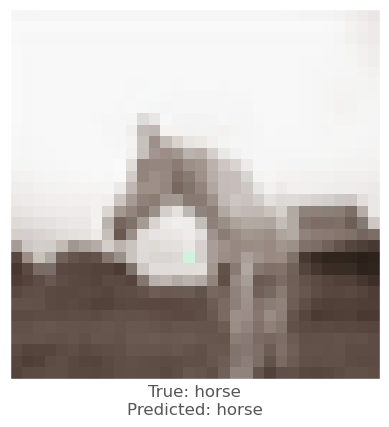



0.0027874112
-0.003831029
-0.00079905987
vr, vg, vb :   -1.647738687714794 2.330697315487383 0.8118863573016767
beam_perturbed_confidence temp :  0.6552363
beam_perturbed_confidence temp :  0.6524966
beam_perturbed_confidence temp :  0.65716225
beam_perturbed_confidence temp :  0.64919394
beam_perturbed_confidence temp :  0.6552363
beam_perturbed_confidence temp :  0.6524966
beam_perturbed_confidence temp :  0.64919394
row index :  3
13th round's confidence : 1th 0.64919394
predicted class :  horse
predicted class's confidence :  0.64919394
Lopt is :  16


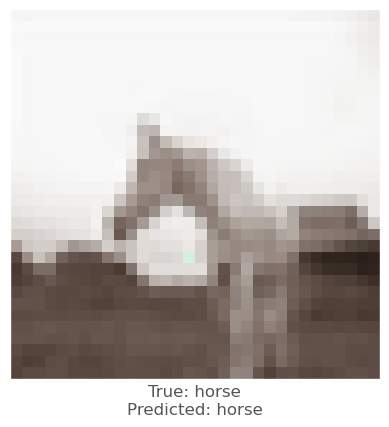



0.0009871721
-0.006252229
-0.0006480217
vr, vg, vb :   -1.3465702282351226 2.741271616974634 0.7944895163633472
beam_perturbed_confidence temp :  0.6522379
beam_perturbed_confidence temp :  0.6474366
beam_perturbed_confidence temp :  0.6530111
beam_perturbed_confidence temp :  0.6448925
beam_perturbed_confidence temp :  0.6522379
beam_perturbed_confidence temp :  0.6474366
beam_perturbed_confidence temp :  0.6448925
row index :  3
13th round's confidence : 2th 0.6448925
predicted class :  horse
predicted class's confidence :  0.6448925
Lopt is :  19


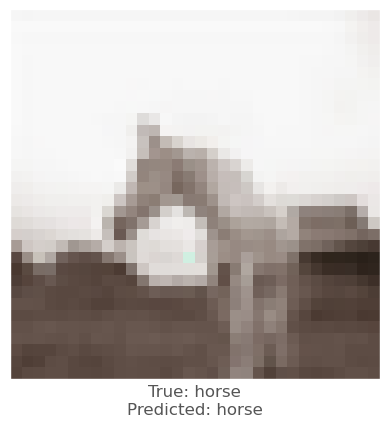



0.003238678
-0.0054561496
-0.0016687512
vr, vg, vb :   0.03646359154192558 4.131809791903841 1.7168625339900554
beam_perturbed_confidence temp :  0.6603842
beam_perturbed_confidence temp :  0.64480555
beam_perturbed_confidence temp :  0.65958166
beam_perturbed_confidence temp :  0.64480555
beam_perturbed_confidence temp :  0.65958166
beam_perturbed_confidence temp :  0.6443532
beam_perturbed_confidence temp :  0.6443532
row index :  5
13th round's confidence : 3th 0.6443532
predicted class :  horse
predicted class's confidence :  0.6443532
Lopt is :  21


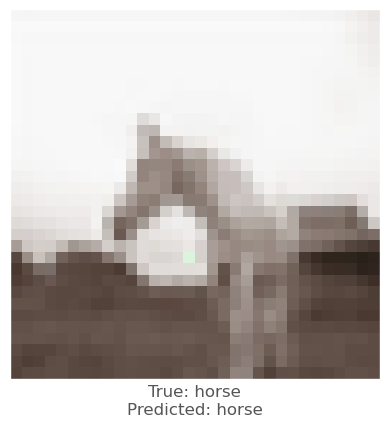



0.0017706752
-0.0053013563
-0.0011455417
vr, vg, vb :   -2.3988239952972177 2.2426498136964823 0.7101605194999576
beam_perturbed_confidence temp :  0.64237344
beam_perturbed_confidence temp :  0.64055467
beam_perturbed_confidence temp :  0.64525515
beam_perturbed_confidence temp :  0.6365164
beam_perturbed_confidence temp :  0.64237344
beam_perturbed_confidence temp :  0.64055467
beam_perturbed_confidence temp :  0.6365164
row index :  3
13th round's confidence : 4th 0.6365164
predicted class :  horse
predicted class's confidence :  0.6365164
Lopt is :  19


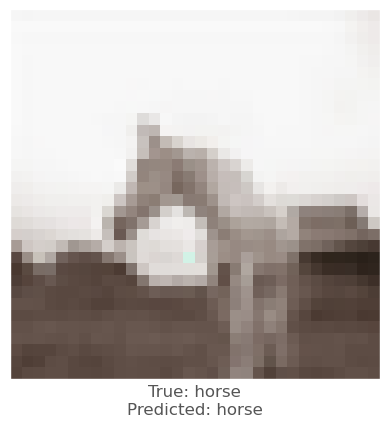



0.0026299953
-0.0057216883
0.00016319752
vr, vg, vb :   -1.8622307008878924 3.2819956192889013 0.6104462753019957
beam_perturbed_confidence temp :  0.6301036
beam_perturbed_confidence temp :  0.62169623
beam_perturbed_confidence temp :  0.63094103
beam_perturbed_confidence temp :  0.6185359
beam_perturbed_confidence temp :  0.6301036
beam_perturbed_confidence temp :  0.62169623
beam_perturbed_confidence temp :  0.6185359
row index :  3
14th round's confidence : 0th 0.6185359
predicted class :  horse
predicted class's confidence :  0.6185359
Lopt is :  23


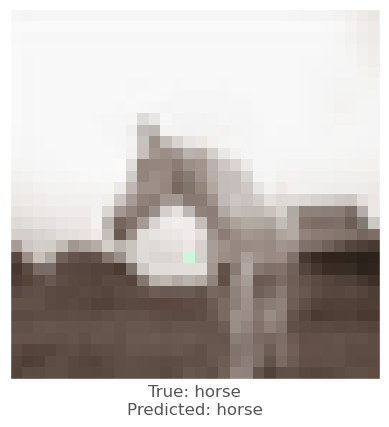



0.0045139194
-0.004775822
0.00038677454
vr, vg, vb :   -1.9343567542918254 2.575209800201462 0.692020267576758
beam_perturbed_confidence temp :  0.64644
beam_perturbed_confidence temp :  0.64373666
beam_perturbed_confidence temp :  0.64919394
beam_perturbed_confidence temp :  0.6397299
beam_perturbed_confidence temp :  0.64644
beam_perturbed_confidence temp :  0.64373666
beam_perturbed_confidence temp :  0.6397299
row index :  3
14th round's confidence : 1th 0.6397299
predicted class :  horse
predicted class's confidence :  0.6397299
Lopt is :  18


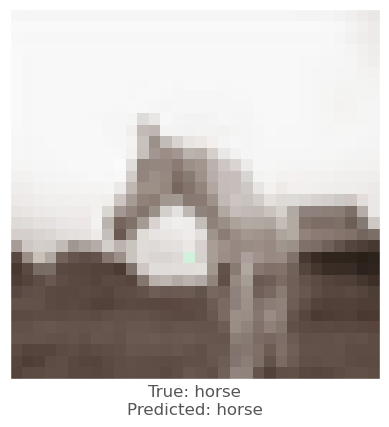



0.002001524
-0.006580591
0.0002872944
vr, vg, vb :   -1.4120656025673721 3.125203575455393 0.6863111259452742
beam_perturbed_confidence temp :  0.64371616
beam_perturbed_confidence temp :  0.6355192
beam_perturbed_confidence temp :  0.6448925
beam_perturbed_confidence temp :  0.63321453
beam_perturbed_confidence temp :  0.64371616
beam_perturbed_confidence temp :  0.6355192
beam_perturbed_confidence temp :  0.63321453
row index :  3
14th round's confidence : 2th 0.63321453
predicted class :  horse
predicted class's confidence :  0.63321453
Lopt is :  21


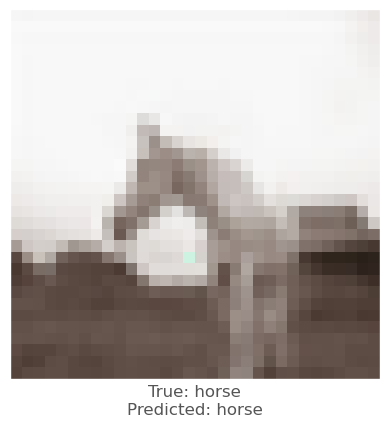



0.0042913556
-0.0061047077
-0.00029426813
vr, vg, vb :   -0.39631832860164684 4.329099584503007 1.5746030937166602
beam_perturbed_confidence temp :  0.6426869
beam_perturbed_confidence temp :  0.63404924
beam_perturbed_confidence temp :  0.6445113
beam_perturbed_confidence temp :  0.6315988
beam_perturbed_confidence temp :  0.6422968
beam_perturbed_confidence temp :  0.634002
beam_perturbed_confidence temp :  0.63173836
row index :  3
14th round's confidence : 3th 0.6315988
predicted class :  horse
predicted class's confidence :  0.6315988
Lopt is :  25


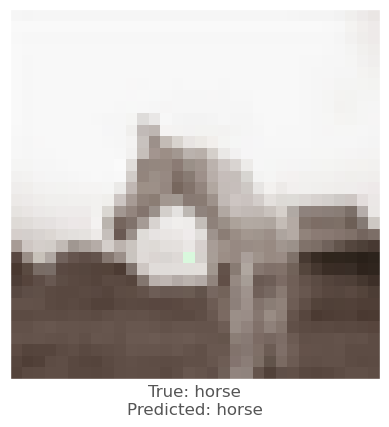



0.00024712086
-0.008705497
-0.0023899078
vr, vg, vb :   -2.1836536814913727 2.8889345111293245 0.8781352512413682
beam_perturbed_confidence temp :  0.63451886
beam_perturbed_confidence temp :  0.6285813
beam_perturbed_confidence temp :  0.6365164
beam_perturbed_confidence temp :  0.62571365
beam_perturbed_confidence temp :  0.63451886
beam_perturbed_confidence temp :  0.6285813
beam_perturbed_confidence temp :  0.62571365
row index :  3
14th round's confidence : 4th 0.62571365
predicted class :  horse
predicted class's confidence :  0.62571365
Lopt is :  21


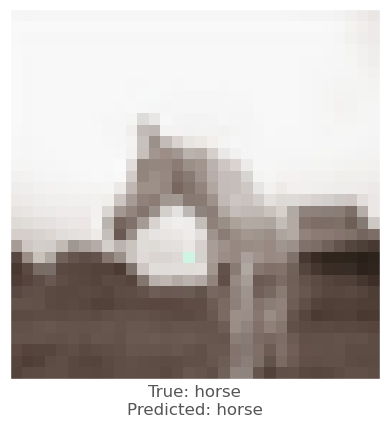



0.0026602745
-0.008374274
-0.0010726452
vr, vg, vb :   -1.9420350813606266 3.7912234350608167 0.6566661665095891
beam_perturbed_confidence temp :  0.6156956
beam_perturbed_confidence temp :  0.60479647
beam_perturbed_confidence temp :  0.6185359
beam_perturbed_confidence temp :  0.60271406
beam_perturbed_confidence temp :  0.6156956
beam_perturbed_confidence temp :  0.60479647
beam_perturbed_confidence temp :  0.60271406
row index :  3
15th round's confidence : 0th 0.60271406
predicted class :  horse
predicted class's confidence :  0.60271406
Lopt is :  26


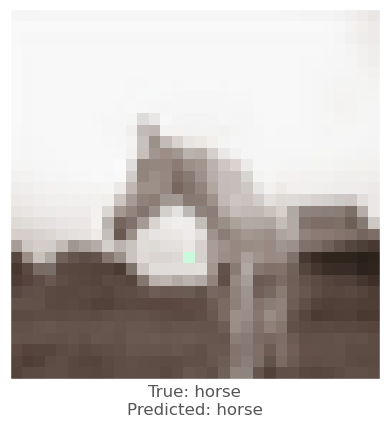



0.004061699
-0.005161226
0.00034558773
vr, vg, vb :   -2.1470909702200647 2.8338113997559007 0.5882594677783107
beam_perturbed_confidence temp :  0.63754976
beam_perturbed_confidence temp :  0.6343665
beam_perturbed_confidence temp :  0.6397299
beam_perturbed_confidence temp :  0.6297094
beam_perturbed_confidence temp :  0.63754976
beam_perturbed_confidence temp :  0.6343665
beam_perturbed_confidence temp :  0.6297094
row index :  3
15th round's confidence : 1th 0.6297094
predicted class :  horse
predicted class's confidence :  0.6297094
Lopt is :  21


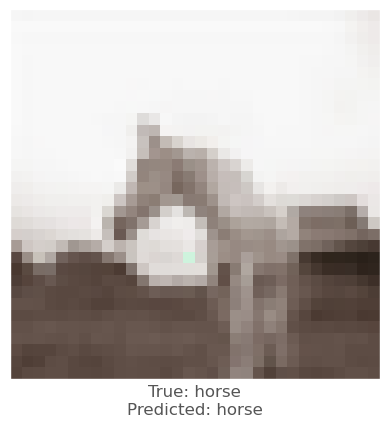



0.002720654
-0.0061163306
0.0005387664
vr, vg, vb :   -1.5429244433879055 3.424316280272525 0.5638033749382713
beam_perturbed_confidence temp :  0.6308988
beam_perturbed_confidence temp :  0.6225937
beam_perturbed_confidence temp :  0.63321453
beam_perturbed_confidence temp :  0.6213752
beam_perturbed_confidence temp :  0.6308988
beam_perturbed_confidence temp :  0.6225937
beam_perturbed_confidence temp :  0.6213752
row index :  3
15th round's confidence : 2th 0.6213752
predicted class :  horse
predicted class's confidence :  0.6213752
Lopt is :  23


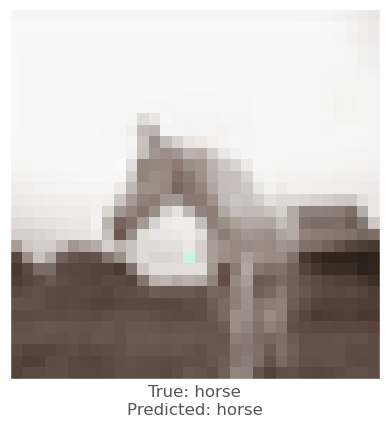



0.005266309
-0.005172372
0.00016224384
vr, vg, vb :   -0.8833173741899685 4.413426812484591 1.4009184000371329
beam_perturbed_confidence temp :  0.6287829
beam_perturbed_confidence temp :  0.62088746
beam_perturbed_confidence temp :  0.63173836
beam_perturbed_confidence temp :  0.61712605
beam_perturbed_confidence temp :  0.62886083
beam_perturbed_confidence temp :  0.6209743
beam_perturbed_confidence temp :  0.6173386
row index :  3
15th round's confidence : 3th 0.61712605
predicted class :  horse
predicted class's confidence :  0.61712605
Lopt is :  29


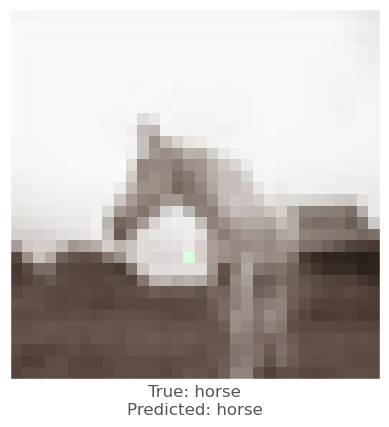



0.00018161535
-0.011232078
-0.0012561679
vr, vg, vb :   -1.983449848605297 3.723248867557286 0.9159385149813671
beam_perturbed_confidence temp :  0.6254873
beam_perturbed_confidence temp :  0.61024195
beam_perturbed_confidence temp :  0.62571365
beam_perturbed_confidence temp :  0.60720026
beam_perturbed_confidence temp :  0.6254873
beam_perturbed_confidence temp :  0.61024195
beam_perturbed_confidence temp :  0.60720026
row index :  3
15th round's confidence : 4th 0.60720026
predicted class :  horse
predicted class's confidence :  0.60720026
Lopt is :  24


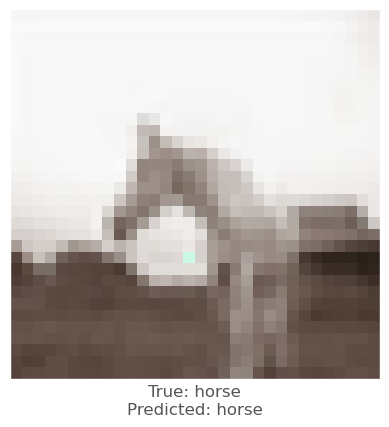



0.0031288862
-0.008004963
-1.5318394e-05
vr, vg, vb :   -2.0607201955084995 4.212597431352709 0.5925313892293578
beam_perturbed_confidence temp :  0.59826976
beam_perturbed_confidence temp :  0.58055705
beam_perturbed_confidence temp :  0.60271406
beam_perturbed_confidence temp :  0.5803917
beam_perturbed_confidence temp :  0.59826976
beam_perturbed_confidence temp :  0.58055705
beam_perturbed_confidence temp :  0.5803917
row index :  3
16th round's confidence : 0th 0.5803917
predicted class :  horse
predicted class's confidence :  0.5803917
Lopt is :  30


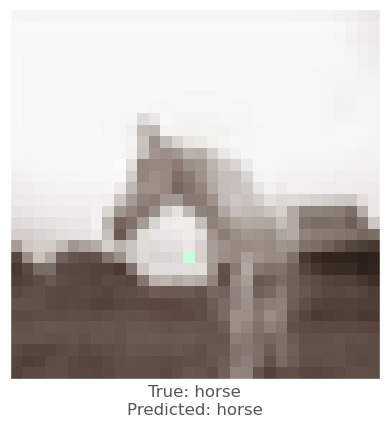



0.002012372
-0.0065901875
-0.00037920475
vr, vg, vb :   -2.133619074888732 3.209449014739417 0.5673539960065832
beam_perturbed_confidence temp :  0.6275584
beam_perturbed_confidence temp :  0.6195106
beam_perturbed_confidence temp :  0.6297094
beam_perturbed_confidence temp :  0.6152447
beam_perturbed_confidence temp :  0.6275584
beam_perturbed_confidence temp :  0.6195106
beam_perturbed_confidence temp :  0.6152447
row index :  3
16th round's confidence : 1th 0.6152447
predicted class :  horse
predicted class's confidence :  0.6152447
Lopt is :  24


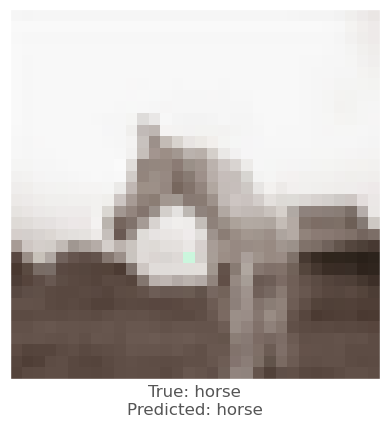



0.0035057664
-0.0069377422
0.0011615753
vr, vg, vb :   -1.73920863822453 3.7756588755729092 0.3912655057061629
beam_perturbed_confidence temp :  0.61770296
beam_perturbed_confidence temp :  0.60621524
beam_perturbed_confidence temp :  0.6213752
beam_perturbed_confidence temp :  0.6053743
beam_perturbed_confidence temp :  0.61770296
beam_perturbed_confidence temp :  0.60621524
beam_perturbed_confidence temp :  0.6053743
row index :  3
16th round's confidence : 2th 0.6053743
predicted class :  horse
predicted class's confidence :  0.6053743
Lopt is :  25


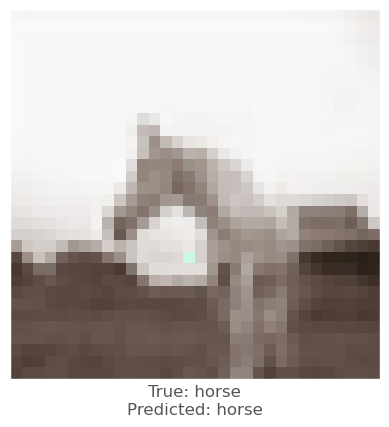



0.007188499
-0.0054710507
0.00029248
vr, vg, vb :   -1.5138355341556151 4.519189205164965 1.2315785608421355
beam_perturbed_confidence temp :  0.6106796
beam_perturbed_confidence temp :  0.60940105
beam_perturbed_confidence temp :  0.6173386
beam_perturbed_confidence temp :  0.60204333
beam_perturbed_confidence temp :  0.6107576
beam_perturbed_confidence temp :  0.6096306
beam_perturbed_confidence temp :  0.60287124
row index :  3
16th round's confidence : 3th 0.60204333
predicted class :  horse
predicted class's confidence :  0.60204333
Lopt is :  32


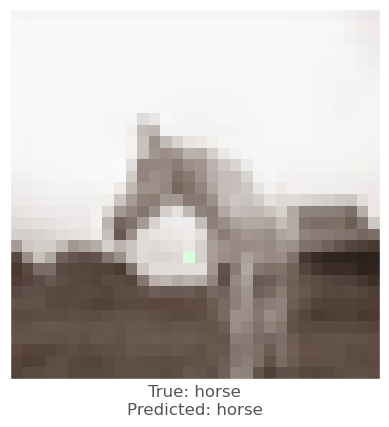



0.00094646215
-0.010925651
-0.00039756298
vr, vg, vb :   -1.87975107918361 4.443489040463422 0.864100961548416
beam_perturbed_confidence temp :  0.60778064
beam_perturbed_confidence temp :  0.58948416
beam_perturbed_confidence temp :  0.60720026
beam_perturbed_confidence temp :  0.5856942
beam_perturbed_confidence temp :  0.60778064
beam_perturbed_confidence temp :  0.58948416
beam_perturbed_confidence temp :  0.5856942
row index :  3
16th round's confidence : 4th 0.5856942
predicted class :  horse
predicted class's confidence :  0.5856942
Lopt is :  28


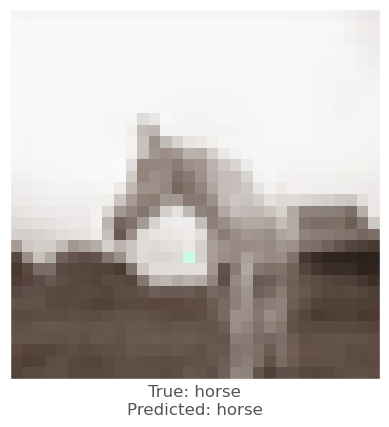



0.0023620725
-0.010456502
-0.0006171465
vr, vg, vb :   -2.090855422738045 4.836987931976593 0.5949928995068615
beam_perturbed_confidence temp :  0.5736874
beam_perturbed_confidence temp :  0.5683778
beam_perturbed_confidence temp :  0.5803917
beam_perturbed_confidence temp :  0.5664127
beam_perturbed_confidence temp :  0.5736874
beam_perturbed_confidence temp :  0.5683778
beam_perturbed_confidence temp :  0.5664127
row index :  3
17th round's confidence : 0th 0.5664127
predicted class :  horse
predicted class's confidence :  0.5664127
Lopt is :  32


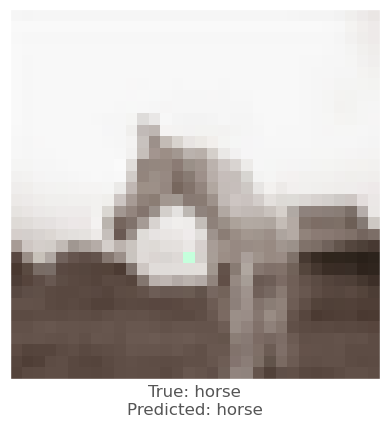



0.0024316907
-0.008892596
-0.0005457401
vr, vg, vb :   -2.16342623669002 3.7777636900629608 0.5651926091622725
beam_perturbed_confidence temp :  0.6120197
beam_perturbed_confidence temp :  0.60264677
beam_perturbed_confidence temp :  0.6152447
beam_perturbed_confidence temp :  0.5975009
beam_perturbed_confidence temp :  0.6120197
beam_perturbed_confidence temp :  0.60264677
beam_perturbed_confidence temp :  0.5975009
row index :  3
17th round's confidence : 1th 0.5975009
predicted class :  horse
predicted class's confidence :  0.5975009
Lopt is :  27


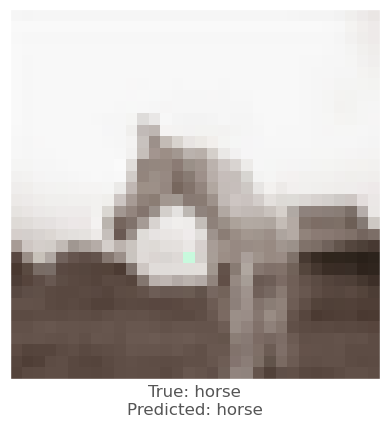



0.0020418763
-0.010112464
-0.0004772544
vr, vg, vb :   -1.7694754060091327 4.409339430810418 0.39986439420720193
beam_perturbed_confidence temp :  0.60214627
beam_perturbed_confidence temp :  0.5823519
beam_perturbed_confidence temp :  0.6053743
beam_perturbed_confidence temp :  0.58283323
beam_perturbed_confidence temp :  0.60214627
beam_perturbed_confidence temp :  0.5823519
beam_perturbed_confidence temp :  0.58283323
row index :  1
17th round's confidence : 2th 0.5823519
predicted class :  horse
predicted class's confidence :  0.5823519
Lopt is :  29


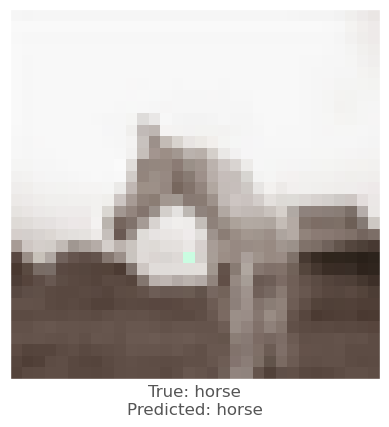



0.0070719123
-0.0025697947
0.0014854074
vr, vg, vb :   -2.069643209606631 4.324249750133088 0.959879969513171
beam_perturbed_confidence temp :  0.5921611
beam_perturbed_confidence temp :  0.60204333
beam_perturbed_confidence temp :  0.60204333
beam_perturbed_confidence temp :  0.5921611
beam_perturbed_confidence temp :  0.5921611
beam_perturbed_confidence temp :  0.60204333
beam_perturbed_confidence temp :  0.5921611
row index :  0
17th round's confidence : 3th 0.5921611
predicted class :  horse
predicted class's confidence :  0.5921611
Lopt is :  32


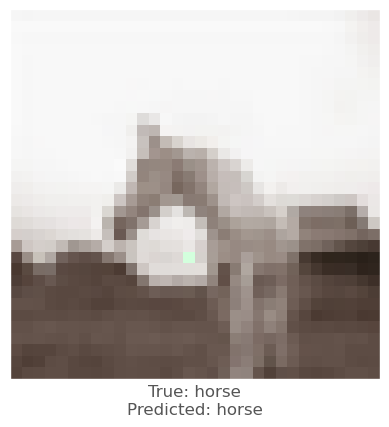



0.003060758
-0.008997142
-0.00035494566
vr, vg, vb :   -1.9978517826513575 4.89885436790817 0.8131854313573195
beam_perturbed_confidence temp :  0.5832966
beam_perturbed_confidence temp :  0.5710729
beam_perturbed_confidence temp :  0.5856942
beam_perturbed_confidence temp :  0.5648842
beam_perturbed_confidence temp :  0.5832966
beam_perturbed_confidence temp :  0.5710729
beam_perturbed_confidence temp :  0.5648842
row index :  3
17th round's confidence : 4th 0.5648842
predicted class :  horse
predicted class's confidence :  0.5648842
Lopt is :  32


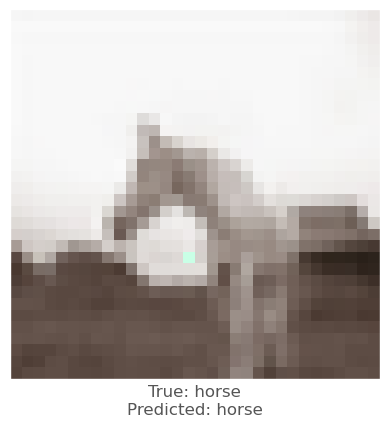



0.0033569932
-0.0039256215
0.00014972687
vr, vg, vb :   -2.217469200303718 4.7458512897341345 0.5205209227885973
beam_perturbed_confidence temp :  0.5610049
beam_perturbed_confidence temp :  0.5664127
beam_perturbed_confidence temp :  0.5664127
beam_perturbed_confidence temp :  0.5610049
beam_perturbed_confidence temp :  0.5610049
beam_perturbed_confidence temp :  0.5664127
beam_perturbed_confidence temp :  0.5610049
row index :  0
18th round's confidence : 0th 0.5610049
predicted class :  horse
predicted class's confidence :  0.5610049
Lopt is :  33


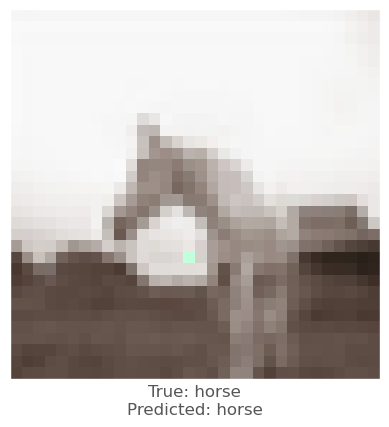



0.002499938
-0.010120511
-0.0013853312
vr, vg, vb :   -2.1970774141379614 4.412038426555933 0.6472064636330082
beam_perturbed_confidence temp :  0.5947102
beam_perturbed_confidence temp :  0.5799979
beam_perturbed_confidence temp :  0.5975009
beam_perturbed_confidence temp :  0.57383513
beam_perturbed_confidence temp :  0.5947102
beam_perturbed_confidence temp :  0.5799979
beam_perturbed_confidence temp :  0.57383513
row index :  3
18th round's confidence : 1th 0.57383513
predicted class :  horse
predicted class's confidence :  0.57383513
Lopt is :  30


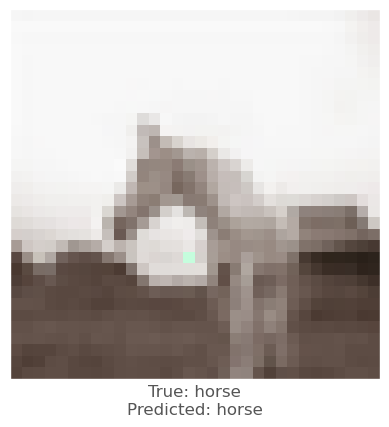



0.00039589405
-0.01149416
-0.0013822317
vr, vg, vb :   -1.6321172704680338 5.1178214575780085 0.49810112602061263
beam_perturbed_confidence temp :  0.58283323
beam_perturbed_confidence temp :  0.56597674
beam_perturbed_confidence temp :  0.5823519
beam_perturbed_confidence temp :  0.56390536
beam_perturbed_confidence temp :  0.58283323
beam_perturbed_confidence temp :  0.56597674
beam_perturbed_confidence temp :  0.56390536
row index :  3
18th round's confidence : 2th 0.56390536
predicted class :  horse
predicted class's confidence :  0.56390536
Lopt is :  32


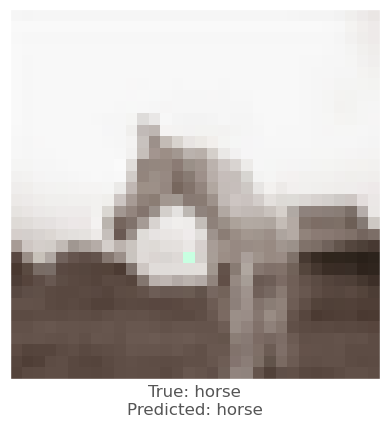



0.006681204
-0.0029739141
0.001832664
vr, vg, vb :   -2.5307992728622764 4.189216189762114 0.6806255712709604
beam_perturbed_confidence temp :  0.5811774
beam_perturbed_confidence temp :  0.5921611
beam_perturbed_confidence temp :  0.5921611
beam_perturbed_confidence temp :  0.5811774
beam_perturbed_confidence temp :  0.5811774
beam_perturbed_confidence temp :  0.5921611
beam_perturbed_confidence temp :  0.5811774
row index :  0
18th round's confidence : 3th 0.5811774
predicted class :  horse
predicted class's confidence :  0.5811774
Lopt is :  32


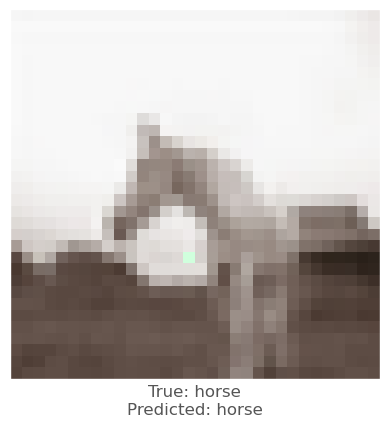



0.004247248
-0.004499495
-4.4226646e-05
vr, vg, vb :   -2.222791421662223 4.858918434062299 0.7362895528639215
beam_perturbed_confidence temp :  0.55932933
beam_perturbed_confidence temp :  0.5648842
beam_perturbed_confidence temp :  0.5648842
beam_perturbed_confidence temp :  0.55932933
beam_perturbed_confidence temp :  0.55932933
beam_perturbed_confidence temp :  0.5648842
beam_perturbed_confidence temp :  0.55932933
row index :  0
18th round's confidence : 4th 0.55932933
predicted class :  horse
predicted class's confidence :  0.55932933
Lopt is :  32


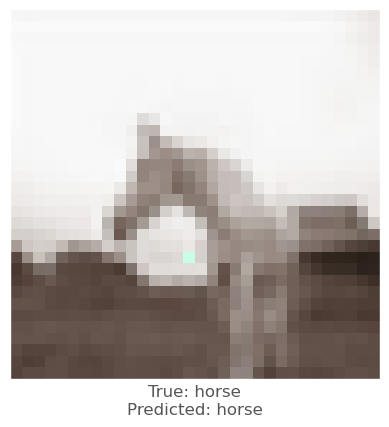



0.0017617941
-0.005699098
-0.00049072504
vr, vg, vb :   -2.171901689300446 4.841175971780618 0.5175413345533166
beam_perturbed_confidence temp :  0.55854875
beam_perturbed_confidence temp :  0.5610049
beam_perturbed_confidence temp :  0.5610049
beam_perturbed_confidence temp :  0.55854875
beam_perturbed_confidence temp :  0.55854875
beam_perturbed_confidence temp :  0.5610049
beam_perturbed_confidence temp :  0.55854875
row index :  0
19th round's confidence : 0th 0.55854875
predicted class :  horse
predicted class's confidence :  0.55854875
Lopt is :  36


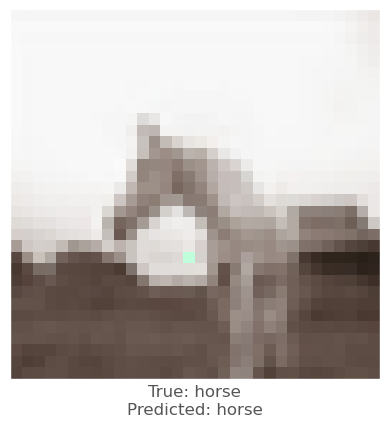



0.004496932
-0.0073992014
0.0009768605
vr, vg, vb :   -2.4270628756965777 4.710754723213084 0.4847997649473197
beam_perturbed_confidence temp :  0.5716376
beam_perturbed_confidence temp :  0.5662029
beam_perturbed_confidence temp :  0.57383513
beam_perturbed_confidence temp :  0.5609408
beam_perturbed_confidence temp :  0.5716376
beam_perturbed_confidence temp :  0.5662029
beam_perturbed_confidence temp :  0.5609408
row index :  3
19th round's confidence : 1th 0.5609408
predicted class :  horse
predicted class's confidence :  0.5609408
Lopt is :  33


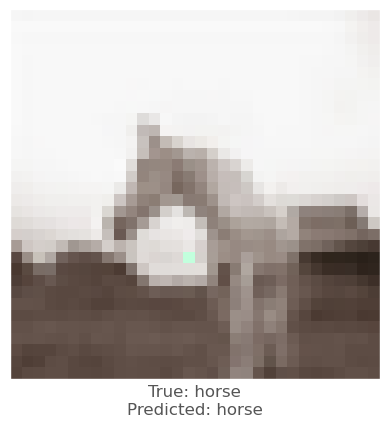



0.0006224513
-0.0062081814
-0.0019036531
vr, vg, vb :   -1.5311506739601708 5.2268574499427665 0.638656327902194
beam_perturbed_confidence temp :  0.5634722
beam_perturbed_confidence temp :  0.56390536
beam_perturbed_confidence temp :  0.56390536
beam_perturbed_confidence temp :  0.5634722
beam_perturbed_confidence temp :  0.5634722
beam_perturbed_confidence temp :  0.56390536
beam_perturbed_confidence temp :  0.5634722
row index :  0
19th round's confidence : 2th 0.5634722
predicted class :  horse
predicted class's confidence :  0.5634722
Lopt is :  32


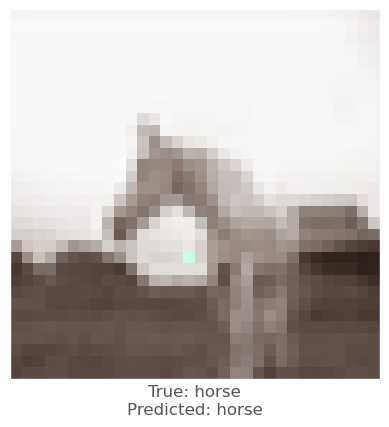



0.0076853037
-0.0031031966
0.0025906563
vr, vg, vb :   -3.0462497143809806 4.080614232880018 0.35349738609210657
beam_perturbed_confidence temp :  0.5674824
beam_perturbed_confidence temp :  0.5811774
beam_perturbed_confidence temp :  0.5811774
beam_perturbed_confidence temp :  0.5674824
beam_perturbed_confidence temp :  0.5674824
beam_perturbed_confidence temp :  0.5811774
beam_perturbed_confidence temp :  0.5674824
row index :  0
19th round's confidence : 3th 0.5674824
predicted class :  horse
predicted class's confidence :  0.5674824
Lopt is :  32


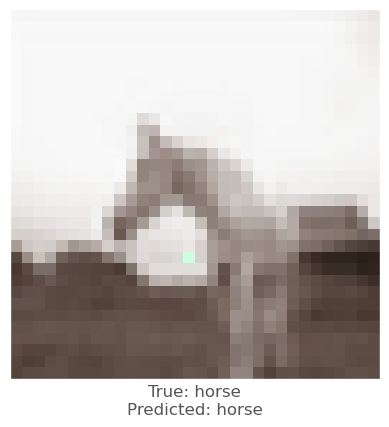



0.0033810139
-0.005195856
-0.00021082163
vr, vg, vb :   -2.3386136665199264 4.892612200092104 0.683742760434585
beam_perturbed_confidence temp :  0.5583145
beam_perturbed_confidence temp :  0.55932933
beam_perturbed_confidence temp :  0.55932933
beam_perturbed_confidence temp :  0.5583145
beam_perturbed_confidence temp :  0.5583145
beam_perturbed_confidence temp :  0.55932933
beam_perturbed_confidence temp :  0.5583145
row index :  0
19th round's confidence : 4th 0.5583145
predicted class :  horse
predicted class's confidence :  0.5583145
Lopt is :  32


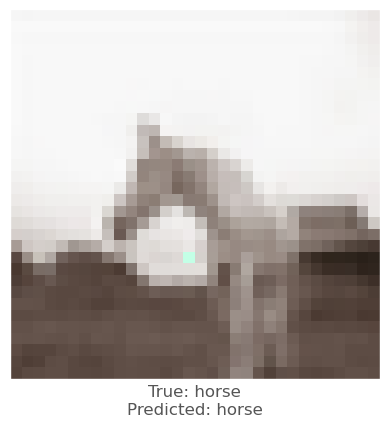



0.0022656918
-0.005553007
-0.0011628866
vr, vg, vb :   -2.1812806960906164 4.912359087188006 0.5820758630547721
beam_perturbed_confidence temp :  0.5521048
beam_perturbed_confidence temp :  0.55854875
beam_perturbed_confidence temp :  0.55854875
beam_perturbed_confidence temp :  0.5521048
beam_perturbed_confidence temp :  0.5521048
beam_perturbed_confidence temp :  0.55854875
beam_perturbed_confidence temp :  0.5521048
row index :  0
20th round's confidence : 0th 0.5521048
predicted class :  horse
predicted class's confidence :  0.5521048
Lopt is :  39


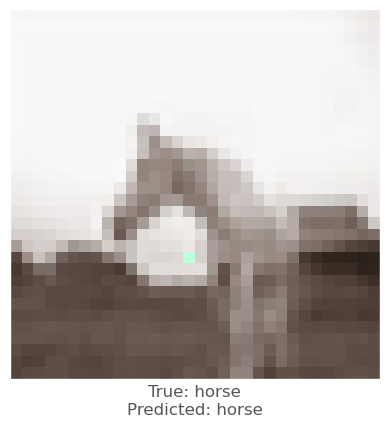



0.0029563308
-0.0050313473
0.00040358305
vr, vg, vb :   -2.47998966574838 4.742813978369803 0.39596148347517074
beam_perturbed_confidence temp :  0.55817026
beam_perturbed_confidence temp :  0.5609408
beam_perturbed_confidence temp :  0.5609408
beam_perturbed_confidence temp :  0.55817026
beam_perturbed_confidence temp :  0.55817026
beam_perturbed_confidence temp :  0.5609408
beam_perturbed_confidence temp :  0.55817026
row index :  0
20th round's confidence : 1th 0.55817026
predicted class :  horse
predicted class's confidence :  0.55817026
Lopt is :  36


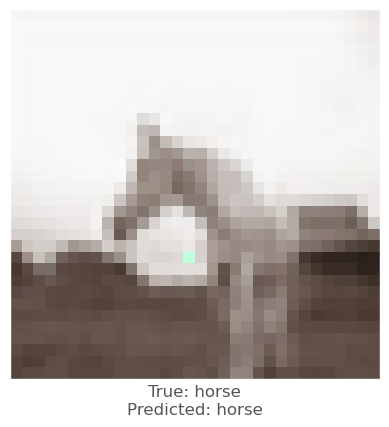



0.00020825863
-0.0065992475
-0.0018604398
vr, vg, vb :   -1.3988614694486752 5.364096450508183 0.7608346728494013
beam_perturbed_confidence temp :  0.56345516
beam_perturbed_confidence temp :  0.5634722
beam_perturbed_confidence temp :  0.5634722
beam_perturbed_confidence temp :  0.56345516
beam_perturbed_confidence temp :  0.56345516
beam_perturbed_confidence temp :  0.5634722
beam_perturbed_confidence temp :  0.56345516
row index :  0
20th round's confidence : 2th 0.56345516
predicted class :  horse
predicted class's confidence :  0.56345516
Lopt is :  32


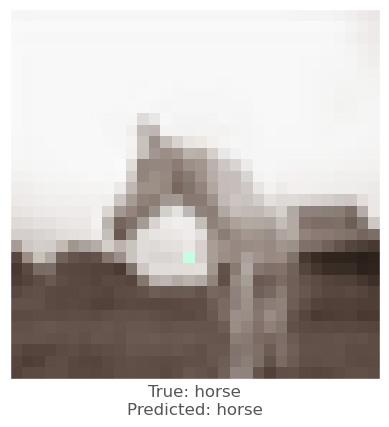



0.0032283664
-0.0060490966
0.00068604946
vr, vg, vb :   -3.064461380439831 4.277462468024023 0.24954270134642131
beam_perturbed_confidence temp :  0.5673025
beam_perturbed_confidence temp :  0.5674824
beam_perturbed_confidence temp :  0.5674824
beam_perturbed_confidence temp :  0.5673025
beam_perturbed_confidence temp :  0.5673025
beam_perturbed_confidence temp :  0.5674824
beam_perturbed_confidence temp :  0.5673025
row index :  0
20th round's confidence : 3th 0.5673025
predicted class :  horse
predicted class's confidence :  0.5673025
Lopt is :  32


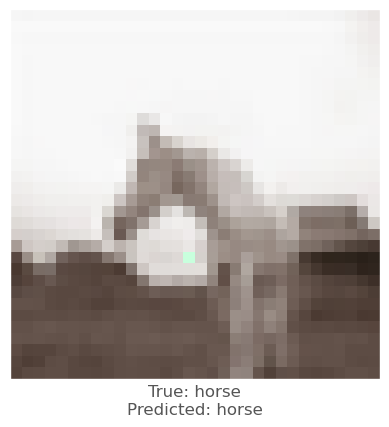



0.00017774105
-0.006578088
-0.0029334426
vr, vg, vb :   -2.1225264049399555 5.0611597607530605 0.9087127436532115
beam_perturbed_confidence temp :  0.5572196
beam_perturbed_confidence temp :  0.5583145
beam_perturbed_confidence temp :  0.5583145
beam_perturbed_confidence temp :  0.5572196
beam_perturbed_confidence temp :  0.5572196
beam_perturbed_confidence temp :  0.5583145
beam_perturbed_confidence temp :  0.5572196
row index :  0
20th round's confidence : 4th 0.5572196
predicted class :  horse
predicted class's confidence :  0.5572196
Lopt is :  35


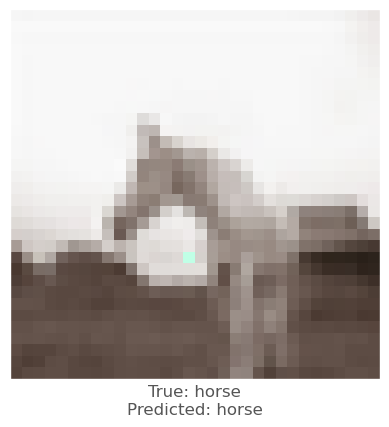



0.005960405
-0.0043115616
-0.00024980307
vr, vg, vb :   -2.5591931137709834 4.852279336916471 0.5488485833746611
beam_perturbed_confidence temp :  0.5419778
beam_perturbed_confidence temp :  0.5521048
beam_perturbed_confidence temp :  0.5521048
beam_perturbed_confidence temp :  0.5419778
beam_perturbed_confidence temp :  0.5419778
beam_perturbed_confidence temp :  0.5521048
beam_perturbed_confidence temp :  0.5419778
row index :  0
21th round's confidence : 0th 0.5419778
predicted class :  horse
predicted class's confidence :  0.5419778
Lopt is :  42


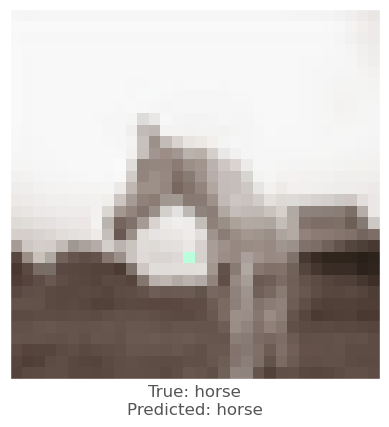



0.0026314855
-0.0053518414
-0.00033593178
vr, vg, vb :   -2.4951392453924144 4.803716725506578 0.3899585129230638
beam_perturbed_confidence temp :  0.55192316
beam_perturbed_confidence temp :  0.55817026
beam_perturbed_confidence temp :  0.55817026
beam_perturbed_confidence temp :  0.55192316
beam_perturbed_confidence temp :  0.55192316
beam_perturbed_confidence temp :  0.55817026
beam_perturbed_confidence temp :  0.55192316
row index :  0
21th round's confidence : 1th 0.55192316
predicted class :  horse
predicted class's confidence :  0.55192316
Lopt is :  39


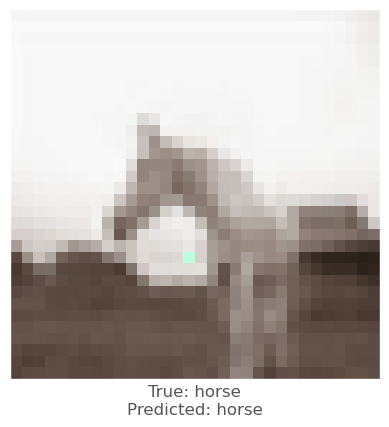



0.00039887428
-0.0058405995
-0.0011454225
vr, vg, vb :   -1.298862750787499 5.41174675914694 0.7992934514293294
beam_perturbed_confidence temp :  0.5619683
beam_perturbed_confidence temp :  0.56345516
beam_perturbed_confidence temp :  0.56345516
beam_perturbed_confidence temp :  0.5619683
beam_perturbed_confidence temp :  0.5619683
beam_perturbed_confidence temp :  0.56345516
beam_perturbed_confidence temp :  0.5619683
row index :  0
21th round's confidence : 2th 0.5619683
predicted class :  horse
predicted class's confidence :  0.5619683
Lopt is :  33


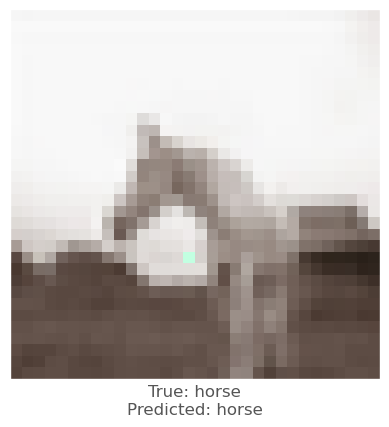



-0.00012975931
-0.006483376
-0.0019977689
vr, vg, vb :   -2.745039311228245 4.498053823836978 0.42436531910545594
beam_perturbed_confidence temp :  0.5662029
beam_perturbed_confidence temp :  0.5673025
beam_perturbed_confidence temp :  0.5673025
beam_perturbed_confidence temp :  0.5662029
beam_perturbed_confidence temp :  0.5662029
beam_perturbed_confidence temp :  0.5673025
beam_perturbed_confidence temp :  0.5662029
row index :  0
21th round's confidence : 3th 0.5662029
predicted class :  horse
predicted class's confidence :  0.5662029
Lopt is :  32


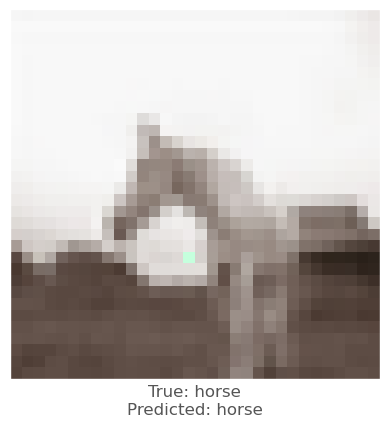



0.0015040636
-0.0056225657
-0.0016410947
vr, vg, vb :   -2.0606801250721807 5.117300359308492 0.9819509377479734
beam_perturbed_confidence temp :  0.5524083
beam_perturbed_confidence temp :  0.5572196
beam_perturbed_confidence temp :  0.5572196
beam_perturbed_confidence temp :  0.5524083
beam_perturbed_confidence temp :  0.5524083
beam_perturbed_confidence temp :  0.5572196
beam_perturbed_confidence temp :  0.5524083
row index :  0
21th round's confidence : 4th 0.5524083
predicted class :  horse
predicted class's confidence :  0.5524083
Lopt is :  38


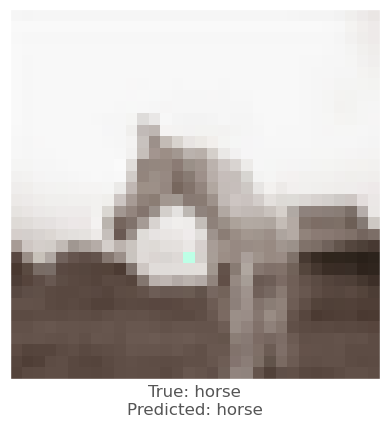



0.007586539
-0.0041500926
-0.0005044341
vr, vg, vb :   -3.0619276815595344 4.7820606634024365 0.5444071359106082
beam_perturbed_confidence temp :  0.5238566
beam_perturbed_confidence temp :  0.5419778
beam_perturbed_confidence temp :  0.5419778
beam_perturbed_confidence temp :  0.5238566
beam_perturbed_confidence temp :  0.5238566
beam_perturbed_confidence temp :  0.5419778
beam_perturbed_confidence temp :  0.5238566
row index :  0
22th round's confidence : 0th 0.5238566
predicted class :  horse
predicted class's confidence :  0.5238566
Lopt is :  46


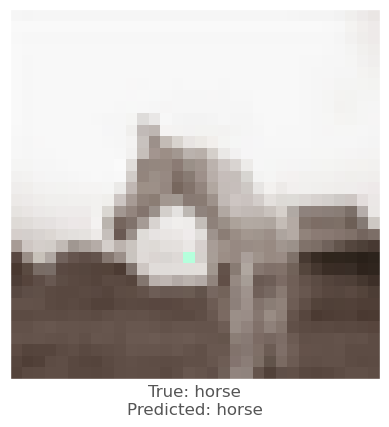



0.0059143305
-0.0041639805
-0.00044232607
vr, vg, vb :   -2.837058369101464 4.739743101356799 0.39519526851857484
beam_perturbed_confidence temp :  0.5416431
beam_perturbed_confidence temp :  0.55192316
beam_perturbed_confidence temp :  0.55192316
beam_perturbed_confidence temp :  0.5416431
beam_perturbed_confidence temp :  0.5416431
beam_perturbed_confidence temp :  0.55192316
beam_perturbed_confidence temp :  0.5416431
row index :  0
22th round's confidence : 1th 0.5416431
predicted class :  horse
predicted class's confidence :  0.5416431
Lopt is :  42


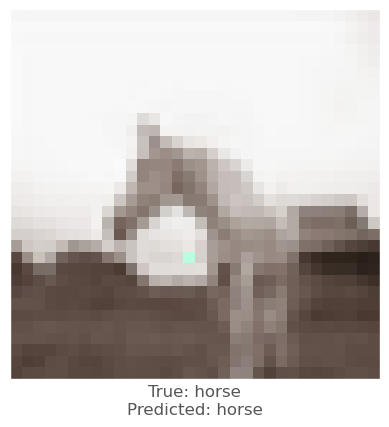



0.00255543
-0.004691839
-0.00029844046
vr, vg, vb :   -1.4245194692542813 5.339756005046211 0.7492081519254346
beam_perturbed_confidence temp :  0.5588224
beam_perturbed_confidence temp :  0.5619683
beam_perturbed_confidence temp :  0.5619683
beam_perturbed_confidence temp :  0.5588224
beam_perturbed_confidence temp :  0.5588224
beam_perturbed_confidence temp :  0.5619683
beam_perturbed_confidence temp :  0.5588224
row index :  0
22th round's confidence : 2th 0.5588224
predicted class :  horse
predicted class's confidence :  0.5588224
Lopt is :  35


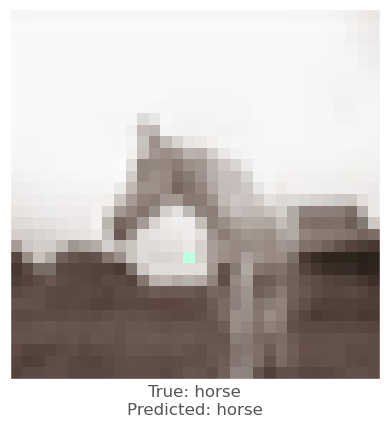



0.0025568604
-0.004536748
-0.0005489588
vr, vg, vb :   -2.726221424798414 4.501923234696688 0.4368246650330451
beam_perturbed_confidence temp :  0.5609408
beam_perturbed_confidence temp :  0.5662029
beam_perturbed_confidence temp :  0.5662029
beam_perturbed_confidence temp :  0.5609408
beam_perturbed_confidence temp :  0.5609408
beam_perturbed_confidence temp :  0.5662029
beam_perturbed_confidence temp :  0.5609408
row index :  0
22th round's confidence : 3th 0.5609408
predicted class :  horse
predicted class's confidence :  0.5609408
Lopt is :  33


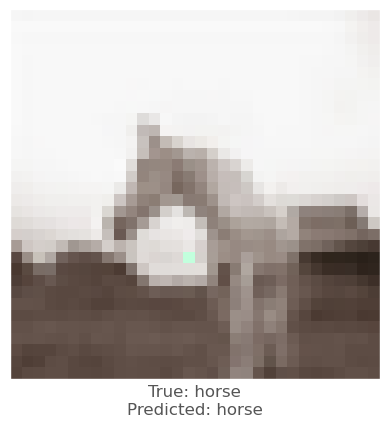



0.003778994
-0.005403757
-0.0010740161
vr, vg, vb :   -2.2325115209054167 5.145946032911334 0.9911574533939524
beam_perturbed_confidence temp :  0.54569733
beam_perturbed_confidence temp :  0.5524083
beam_perturbed_confidence temp :  0.5524083
beam_perturbed_confidence temp :  0.54569733
beam_perturbed_confidence temp :  0.54569733
beam_perturbed_confidence temp :  0.5524083
beam_perturbed_confidence temp :  0.54569733
row index :  0
22th round's confidence : 4th 0.54569733
predicted class :  horse
predicted class's confidence :  0.54569733
Lopt is :  41


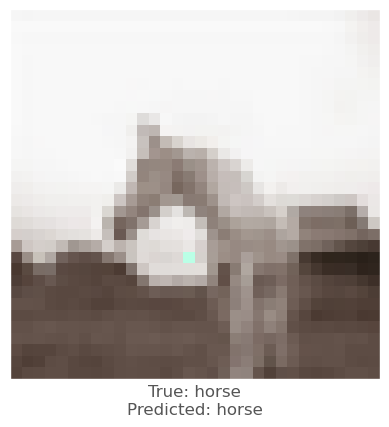



0.009519041
-0.0046898723
-0.0003017187
vr, vg, vb :   -3.707638971860002 4.772841823548399 0.5201382935048502
beam_perturbed_confidence temp :  0.50571626
beam_perturbed_confidence temp :  0.5238566
beam_perturbed_confidence temp :  0.5238566
beam_perturbed_confidence temp :  0.50571626
beam_perturbed_confidence temp :  0.50571626
beam_perturbed_confidence temp :  0.5238566
beam_perturbed_confidence temp :  0.50571626
row index :  0
23th round's confidence : 0th 0.50571626
predicted class :  horse
predicted class's confidence :  0.50571626
Lopt is :  50


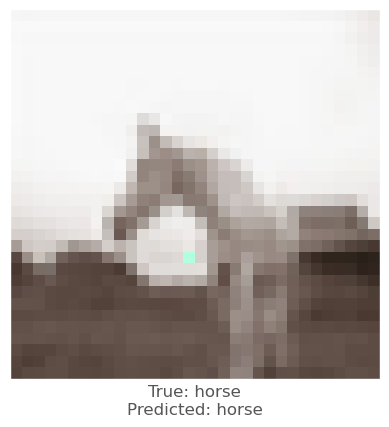



0.0076316
-0.0042618513
-0.00053173304
vr, vg, vb :   -3.3165125225019865 4.691953922294117 0.4088490452708433
beam_perturbed_confidence temp :  0.52405906
beam_perturbed_confidence temp :  0.5416431
beam_perturbed_confidence temp :  0.5416431
beam_perturbed_confidence temp :  0.52405906
beam_perturbed_confidence temp :  0.52405906
beam_perturbed_confidence temp :  0.5416431
beam_perturbed_confidence temp :  0.52405906
row index :  0
23th round's confidence : 1th 0.52405906
predicted class :  horse
predicted class's confidence :  0.52405906
Lopt is :  46


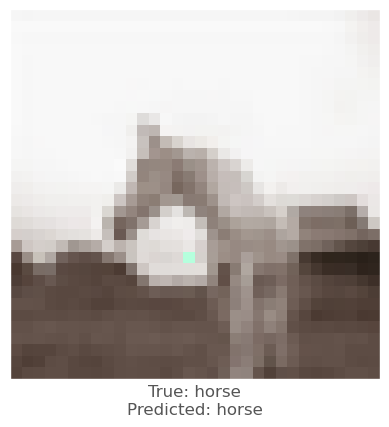



0.002988577
-0.0048980713
0.00036406517
vr, vg, vb :   -1.5809252112326617 5.29558753344784 0.6378808197040825
beam_perturbed_confidence temp :  0.55621946
beam_perturbed_confidence temp :  0.5588224
beam_perturbed_confidence temp :  0.5588224
beam_perturbed_confidence temp :  0.55621946
beam_perturbed_confidence temp :  0.55621946
beam_perturbed_confidence temp :  0.5588224
beam_perturbed_confidence temp :  0.55621946
row index :  0
23th round's confidence : 2th 0.55621946
predicted class :  horse
predicted class's confidence :  0.55621946
Lopt is :  37


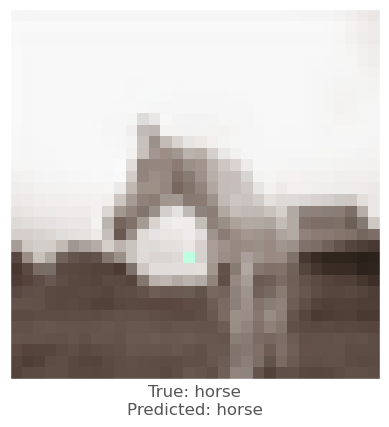



0.0029563308
-0.0050313473
0.00040358305
vr, vg, vb :   -2.7492323599400326 4.5548656387050475 0.35278389355232365
beam_perturbed_confidence temp :  0.55817026
beam_perturbed_confidence temp :  0.5609408
beam_perturbed_confidence temp :  0.5609408
beam_perturbed_confidence temp :  0.55817026
beam_perturbed_confidence temp :  0.55817026
beam_perturbed_confidence temp :  0.5609408
beam_perturbed_confidence temp :  0.55817026
row index :  0
23th round's confidence : 3th 0.55817026
predicted class :  horse
predicted class's confidence :  0.55817026
Lopt is :  36


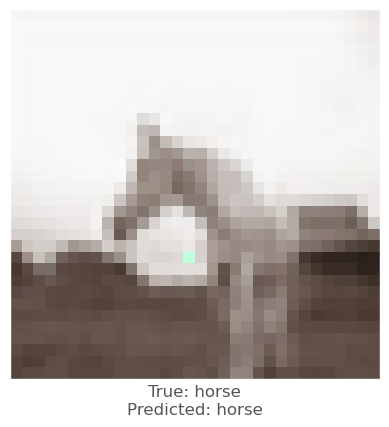



0.0071036816
-0.0036791563
-0.00036412477
vr, vg, vb :   -2.7196285252479804 4.9992670599607765 0.9284541855478433
beam_perturbed_confidence temp :  0.5314917
beam_perturbed_confidence temp :  0.54569733
beam_perturbed_confidence temp :  0.54569733
beam_perturbed_confidence temp :  0.5314917
beam_perturbed_confidence temp :  0.5314917
beam_perturbed_confidence temp :  0.54569733
beam_perturbed_confidence temp :  0.5314917
row index :  0
23th round's confidence : 4th 0.5314917
predicted class :  horse
predicted class's confidence :  0.5314917
Lopt is :  44


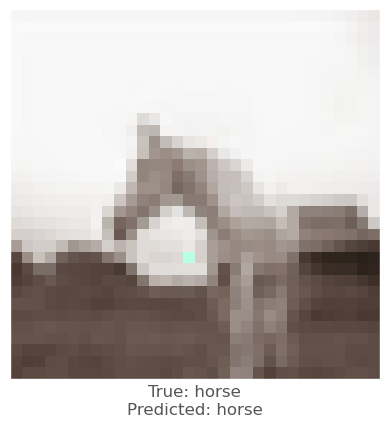



0.008172274
-0.0056691766
-0.0010234714
vr, vg, vb :   -4.154102438260427 4.862475299045732 0.5704715996981884
beam_perturbed_confidence temp :  0.48194256
beam_perturbed_confidence temp :  0.50571626
beam_perturbed_confidence temp :  0.50571626
beam_perturbed_confidence temp :  0.48194256
beam_perturbed_confidence temp :  0.48194256
beam_perturbed_confidence temp :  0.50571626
beam_perturbed_confidence temp :  0.48194256
row index :  0
24th round's confidence : 0th 0.48194256
predicted class :  airplane
predicted class's confidence :  0.5138583
Lopt is :  55


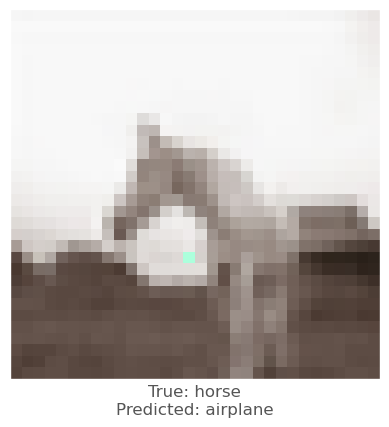




2th sensitive pixel
original confidence is :  0.69673544 

original r,g,b :  234 231 229
0.004544914
0.004005015
0.005156517
vr, vg, vb :   -0.45449137687683105 -0.4005014896392822 -0.5156517028808594
beam_perturbed_confidence temp :  0.69458216
beam_perturbed_confidence temp :  0.6952251
beam_perturbed_confidence temp :  0.6943892
beam_perturbed_confidence temp :  0.69328815
beam_perturbed_confidence temp :  0.69249284
beam_perturbed_confidence temp :  0.69323725
beam_perturbed_confidence temp :  0.69124943
row index :  6
0th round's confidence : 0th 0.69124943
predicted class :  horse
predicted class's confidence :  0.69124943
Lopt is :  1


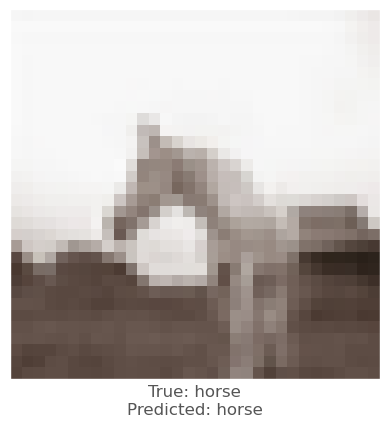



-0.002230823
-0.0033940673
0.00030565262
vr, vg, vb :   0.2230823040008545 0.33940672874450684 -0.030565261840820312
beam_perturbed_confidence temp :  0.6642662
beam_perturbed_confidence temp :  0.6642662
beam_perturbed_confidence temp :  0.66388375
beam_perturbed_confidence temp :  0.6642662
beam_perturbed_confidence temp :  0.66388375
beam_perturbed_confidence temp :  0.66388375
beam_perturbed_confidence temp :  0.66388375
row index :  2
0th round's confidence : 1th 0.66388375
predicted class :  horse
predicted class's confidence :  0.66388375
Lopt is :  6


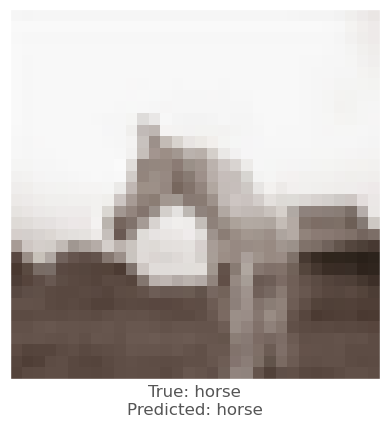



-0.00030505657
-0.0029346943
-0.00011950731
vr, vg, vb :   0.030505657196044922 0.2934694290161133 0.01195073127746582
beam_perturbed_confidence temp :  0.7029086
beam_perturbed_confidence temp :  0.7029086
beam_perturbed_confidence temp :  0.7029086
beam_perturbed_confidence temp :  0.7029086
beam_perturbed_confidence temp :  0.7029086
beam_perturbed_confidence temp :  0.7029086
beam_perturbed_confidence temp :  0.7029086
row index :  0
0th round's confidence : 2th 0.7029086
predicted class :  horse
predicted class's confidence :  0.7029086
Lopt is :  5


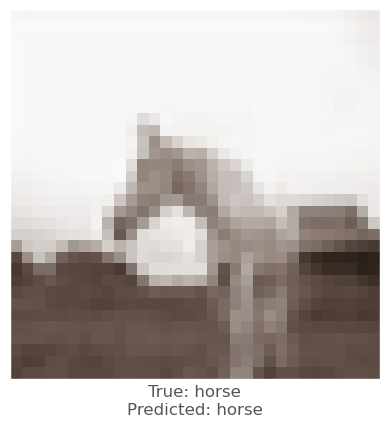



-0.0070356727
-0.008984268
-0.0032148957
vr, vg, vb :   0.7035672664642334 0.8984267711639404 0.3214895725250244
beam_perturbed_confidence temp :  0.6952916
beam_perturbed_confidence temp :  0.6952916
beam_perturbed_confidence temp :  0.6952916
beam_perturbed_confidence temp :  0.6952916
beam_perturbed_confidence temp :  0.6952916
beam_perturbed_confidence temp :  0.6952916
beam_perturbed_confidence temp :  0.6952916
row index :  0
0th round's confidence : 3th 0.6952916
predicted class :  horse
predicted class's confidence :  0.6952916
Lopt is :  10


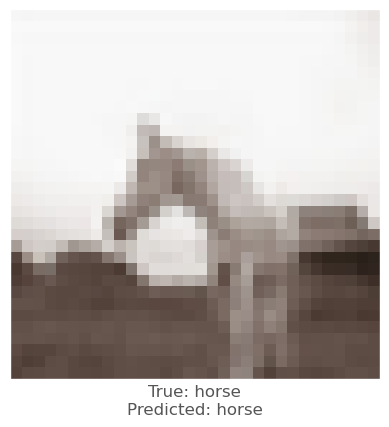



0.0024166703
-0.0011550784
0.0035750866
vr, vg, vb :   -0.2416670322418213 0.11550784111022949 -0.35750865936279297
beam_perturbed_confidence temp :  0.7034911
beam_perturbed_confidence temp :  0.7046349
beam_perturbed_confidence temp :  0.7029597
beam_perturbed_confidence temp :  0.7034911
beam_perturbed_confidence temp :  0.7018187
beam_perturbed_confidence temp :  0.7029597
beam_perturbed_confidence temp :  0.7018187
row index :  4
0th round's confidence : 4th 0.7018187
predicted class :  horse
predicted class's confidence :  0.7018187
Lopt is :  10


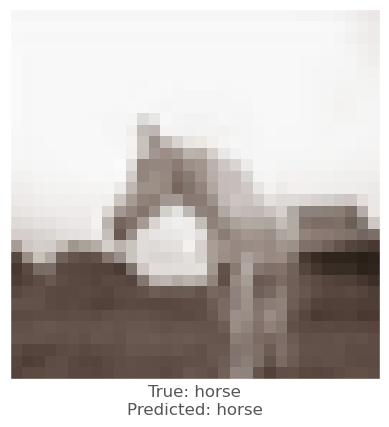



0.004234731
0.0029663444
0.0042686462
vr, vg, vb :   -0.8325153589248657 -0.6570857763290405 -0.8909511566162109
beam_perturbed_confidence temp :  0.6890025
beam_perturbed_confidence temp :  0.6895265
beam_perturbed_confidence temp :  0.6890195
beam_perturbed_confidence temp :  0.6874966
beam_perturbed_confidence temp :  0.6873856
beam_perturbed_confidence temp :  0.6872098
beam_perturbed_confidence temp :  0.68561596
row index :  6
1th round's confidence : 0th 0.68561596
predicted class :  horse
predicted class's confidence :  0.68561596
Lopt is :  2


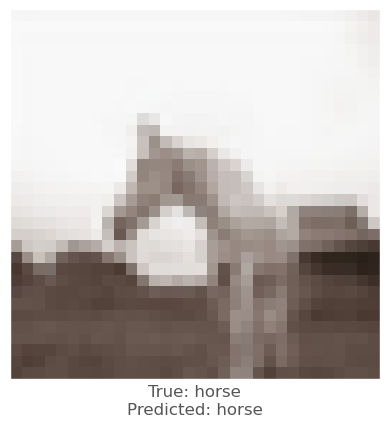



-0.002242446
-0.003358841
0.0006904602
vr, vg, vb :   0.42501866817474365 0.6413501501083374 -0.09655475616455078
beam_perturbed_confidence temp :  0.66388375
beam_perturbed_confidence temp :  0.66388375
beam_perturbed_confidence temp :  0.66357577
beam_perturbed_confidence temp :  0.66388375
beam_perturbed_confidence temp :  0.66357577
beam_perturbed_confidence temp :  0.66357577
beam_perturbed_confidence temp :  0.66357577
row index :  2
1th round's confidence : 1th 0.66357577
predicted class :  horse
predicted class's confidence :  0.66357577
Lopt is :  7


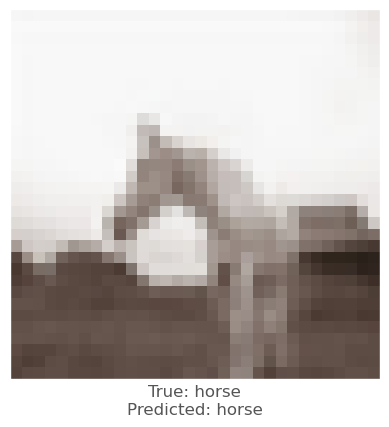



-0.00030505657
-0.0029346943
-0.00011950731
vr, vg, vb :   0.05796074867248535 0.5575919151306152 0.02270638942718506
beam_perturbed_confidence temp :  0.7029086
beam_perturbed_confidence temp :  0.7029086
beam_perturbed_confidence temp :  0.7029086
beam_perturbed_confidence temp :  0.7029086
beam_perturbed_confidence temp :  0.7029086
beam_perturbed_confidence temp :  0.7029086
beam_perturbed_confidence temp :  0.7029086
row index :  0
1th round's confidence : 2th 0.7029086
predicted class :  horse
predicted class's confidence :  0.7029086
Lopt is :  5


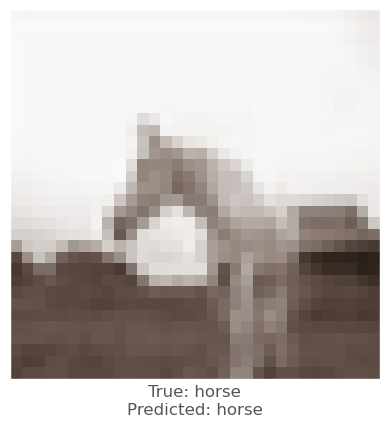



-0.0070356727
-0.008984268
-0.0032148957
vr, vg, vb :   1.3367778062820435 1.7070108652114868 0.6108301877975464
beam_perturbed_confidence temp :  0.69178486
beam_perturbed_confidence temp :  0.69104517
beam_perturbed_confidence temp :  0.6952916
beam_perturbed_confidence temp :  0.6874251
beam_perturbed_confidence temp :  0.69178486
beam_perturbed_confidence temp :  0.69104517
beam_perturbed_confidence temp :  0.6874251
row index :  3
1th round's confidence : 3th 0.6874251
predicted class :  horse
predicted class's confidence :  0.6874251
Lopt is :  10


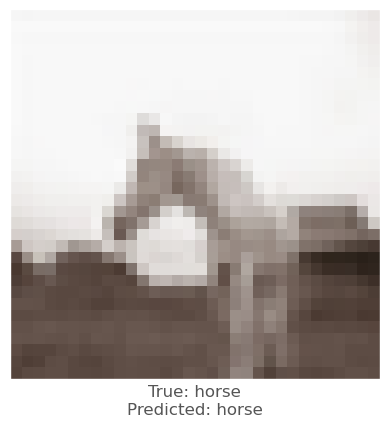



0.0019143224
-0.0016331673
0.0029292107
vr, vg, vb :   -0.40893256664276123 0.26727378368377686 -0.6146788597106934
beam_perturbed_confidence temp :  0.7010454
beam_perturbed_confidence temp :  0.7018187
beam_perturbed_confidence temp :  0.7005619
beam_perturbed_confidence temp :  0.7010454
beam_perturbed_confidence temp :  0.70015186
beam_perturbed_confidence temp :  0.7005619
beam_perturbed_confidence temp :  0.70015186
row index :  4
1th round's confidence : 4th 0.70015186
predicted class :  horse
predicted class's confidence :  0.70015186
Lopt is :  10


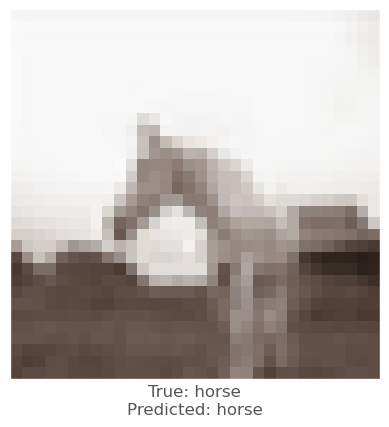



0.003963113
0.0045421124
0.0045805573
vr, vg, vb :   -1.1455751061439514 -1.0455884337425232 -1.2599117755889893
beam_perturbed_confidence temp :  0.6801085
beam_perturbed_confidence temp :  0.67941976
beam_perturbed_confidence temp :  0.68045485
beam_perturbed_confidence temp :  0.671251
beam_perturbed_confidence temp :  0.6745987
beam_perturbed_confidence temp :  0.67226994
beam_perturbed_confidence temp :  0.6652525
row index :  6
2th round's confidence : 0th 0.6652525
predicted class :  horse
predicted class's confidence :  0.6652525
Lopt is :  4


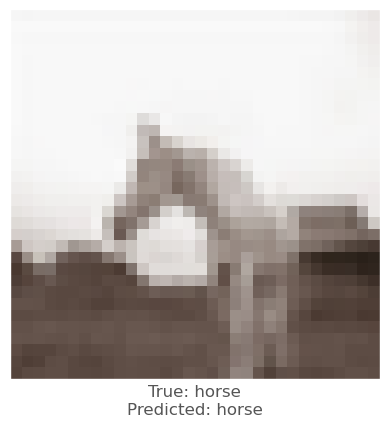



-0.0021125674
-0.003406465
0.0009916425
vr, vg, vb :   0.5937735438346863 0.9178616404533386 -0.18606352806091309
beam_perturbed_confidence temp :  0.66357577
beam_perturbed_confidence temp :  0.66357577
beam_perturbed_confidence temp :  0.6628921
beam_perturbed_confidence temp :  0.66357577
beam_perturbed_confidence temp :  0.6628921
beam_perturbed_confidence temp :  0.6628921
beam_perturbed_confidence temp :  0.6628921
row index :  2
2th round's confidence : 1th 0.6628921
predicted class :  horse
predicted class's confidence :  0.6628921
Lopt is :  8


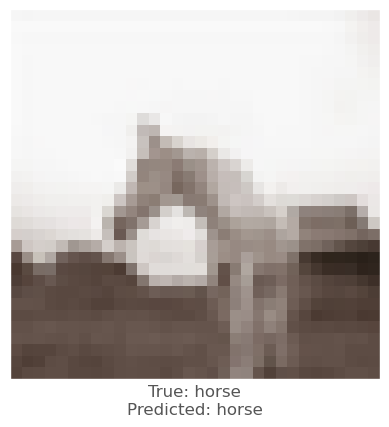



-0.00030505657
-0.0029346943
-0.00011950731
vr, vg, vb :   0.08267033100128174 0.795302152633667 0.03238648176193237
beam_perturbed_confidence temp :  0.7029086
beam_perturbed_confidence temp :  0.7029086
beam_perturbed_confidence temp :  0.7029086
beam_perturbed_confidence temp :  0.7029086
beam_perturbed_confidence temp :  0.7029086
beam_perturbed_confidence temp :  0.7029086
beam_perturbed_confidence temp :  0.7029086
row index :  0
2th round's confidence : 2th 0.7029086
predicted class :  horse
predicted class's confidence :  0.7029086
Lopt is :  5


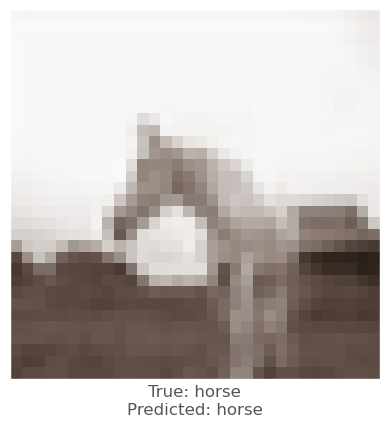



-0.006436467
-0.008991301
-0.003621757
vr, vg, vb :   1.8467467427253723 2.435439884662628 0.9119228720664978
beam_perturbed_confidence temp :  0.6846087
beam_perturbed_confidence temp :  0.67896384
beam_perturbed_confidence temp :  0.6874251
beam_perturbed_confidence temp :  0.67734796
beam_perturbed_confidence temp :  0.6846087
beam_perturbed_confidence temp :  0.67896384
beam_perturbed_confidence temp :  0.67734796
row index :  3
2th round's confidence : 3th 0.67734796
predicted class :  horse
predicted class's confidence :  0.67734796
Lopt is :  10


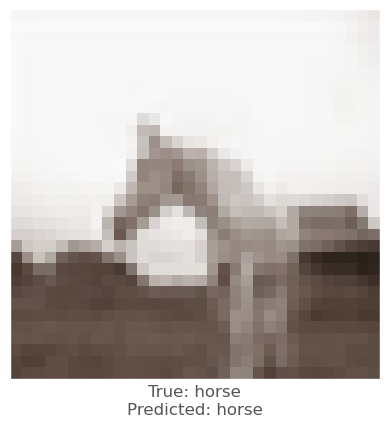



0.00045073032
-0.002345562
0.001707077
vr, vg, vb :   -0.4131123423576355 0.47510260343551636 -0.7239186763763428
beam_perturbed_confidence temp :  0.70011115
beam_perturbed_confidence temp :  0.70015186
beam_perturbed_confidence temp :  0.6993383
beam_perturbed_confidence temp :  0.70011115
beam_perturbed_confidence temp :  0.6992522
beam_perturbed_confidence temp :  0.6993383
beam_perturbed_confidence temp :  0.6992522
row index :  4
2th round's confidence : 4th 0.6992522
predicted class :  horse
predicted class's confidence :  0.6992522
Lopt is :  10


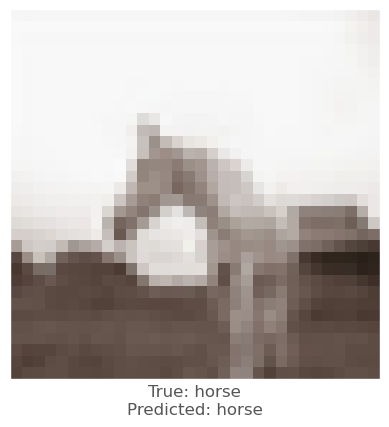



0.0046381354
0.0055086613
0.0050401688
vr, vg, vb :   -1.4948311388492586 -1.4918957173824312 -1.6379374742507935
beam_perturbed_confidence temp :  0.663775
beam_perturbed_confidence temp :  0.66484326
beam_perturbed_confidence temp :  0.662273
beam_perturbed_confidence temp :  0.66746104
beam_perturbed_confidence temp :  0.6633543
beam_perturbed_confidence temp :  0.6645614
beam_perturbed_confidence temp :  0.66747314
row index :  2
3th round's confidence : 0th 0.662273
predicted class :  horse
predicted class's confidence :  0.662273
Lopt is :  6


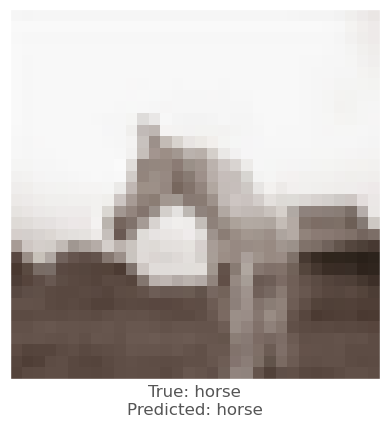



-0.0021808743
-0.003824234
0.0008097291
vr, vg, vb :   0.7524836242198945 1.2084988772869112 -0.24843008518218995
beam_perturbed_confidence temp :  0.6628921
beam_perturbed_confidence temp :  0.66166186
beam_perturbed_confidence temp :  0.66276604
beam_perturbed_confidence temp :  0.66166186
beam_perturbed_confidence temp :  0.66276604
beam_perturbed_confidence temp :  0.66122216
beam_perturbed_confidence temp :  0.66122216
row index :  5
3th round's confidence : 1th 0.66122216
predicted class :  horse
predicted class's confidence :  0.66122216
Lopt is :  9


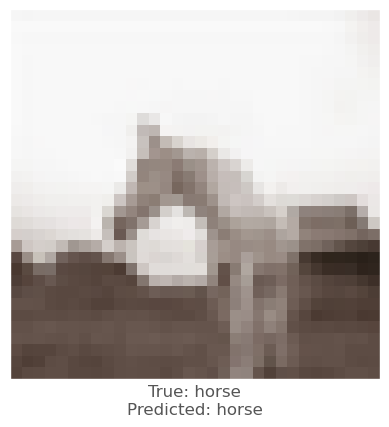



-0.00030505657
-0.0029346943
-0.00011950731
vr, vg, vb :   0.10490895509719848 1.0092413663864135 0.041098564863204956
beam_perturbed_confidence temp :  0.7029086
beam_perturbed_confidence temp :  0.7013968
beam_perturbed_confidence temp :  0.7029086
beam_perturbed_confidence temp :  0.7013968
beam_perturbed_confidence temp :  0.7029086
beam_perturbed_confidence temp :  0.7013968
beam_perturbed_confidence temp :  0.7013968
row index :  1
3th round's confidence : 2th 0.7013968
predicted class :  horse
predicted class's confidence :  0.7013968
Lopt is :  6


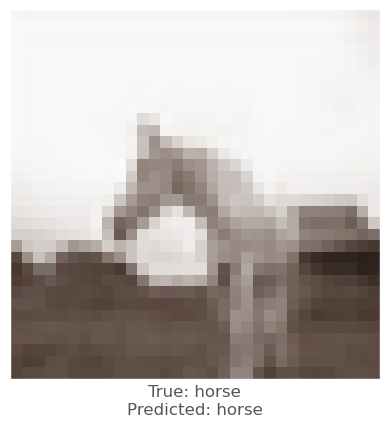



-0.0031633377
-0.0064392686
-0.0016876459
vr, vg, vb :   1.9784058392047883 2.835822755098343 0.9894951760768891
beam_perturbed_confidence temp :  0.6758005
beam_perturbed_confidence temp :  0.67092294
beam_perturbed_confidence temp :  0.67734796
beam_perturbed_confidence temp :  0.66840106
beam_perturbed_confidence temp :  0.6758005
beam_perturbed_confidence temp :  0.67092294
beam_perturbed_confidence temp :  0.66840106
row index :  3
3th round's confidence : 3th 0.66840106
predicted class :  horse
predicted class's confidence :  0.66840106
Lopt is :  10


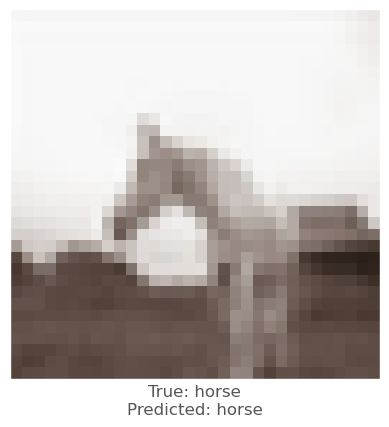



0.00024837255
-0.003006518
0.001473546
vr, vg, vb :   -0.3966383635997772 0.7282441318035127 -0.7988814115524292
beam_perturbed_confidence temp :  0.69908994
beam_perturbed_confidence temp :  0.6992522
beam_perturbed_confidence temp :  0.6986376
beam_perturbed_confidence temp :  0.69908994
beam_perturbed_confidence temp :  0.69851583
beam_perturbed_confidence temp :  0.6986376
beam_perturbed_confidence temp :  0.69851583
row index :  4
3th round's confidence : 4th 0.69851583
predicted class :  horse
predicted class's confidence :  0.69851583
Lopt is :  10


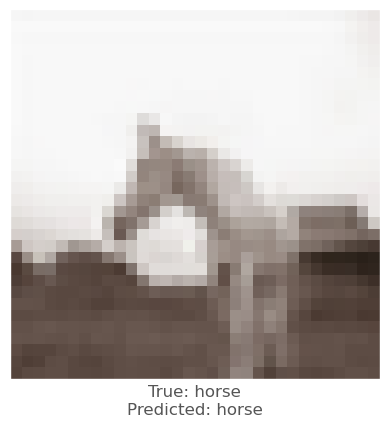



0.0011991858
0.0004913807
0.0014987588
vr, vg, vb :   -1.4652666097879412 -1.3918442147970203 -1.624019606113434
beam_perturbed_confidence temp :  0.6633543
beam_perturbed_confidence temp :  0.6645614
beam_perturbed_confidence temp :  0.66112906
beam_perturbed_confidence temp :  0.66747314
beam_perturbed_confidence temp :  0.6622295
beam_perturbed_confidence temp :  0.6632191
beam_perturbed_confidence temp :  0.6679617
row index :  2
4th round's confidence : 0th 0.66112906
predicted class :  horse
predicted class's confidence :  0.66112906
Lopt is :  8


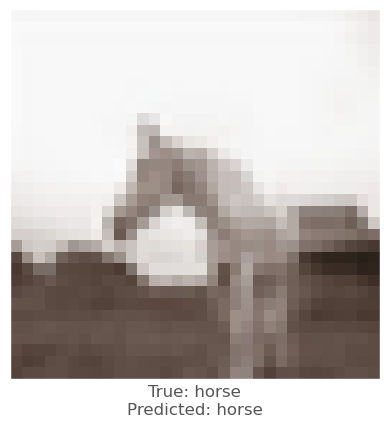



-0.001082778
-0.0028304458
0.0012165904
vr, vg, vb :   0.7855130594968797 1.3706935662031177 -0.34524611711502073
beam_perturbed_confidence temp :  0.66122216
beam_perturbed_confidence temp :  0.6599356
beam_perturbed_confidence temp :  0.6604453
beam_perturbed_confidence temp :  0.6599356
beam_perturbed_confidence temp :  0.6604453
beam_perturbed_confidence temp :  0.6595738
beam_perturbed_confidence temp :  0.6595738
row index :  5
4th round's confidence : 1th 0.6595738
predicted class :  horse
predicted class's confidence :  0.6595738
Lopt is :  10


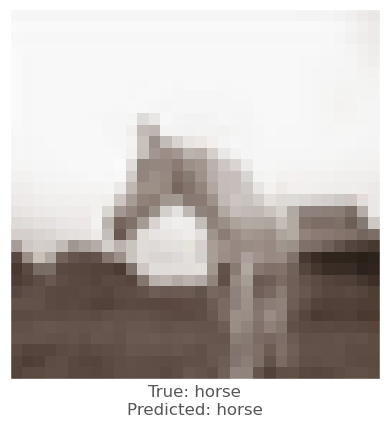



5.9485435e-05
-0.0028980374
0.00030344725
vr, vg, vb :   0.08846951603889465 1.198120973110199 0.006643983721733096
beam_perturbed_confidence temp :  0.7013968
beam_perturbed_confidence temp :  0.70001054
beam_perturbed_confidence temp :  0.7013968
beam_perturbed_confidence temp :  0.70001054
beam_perturbed_confidence temp :  0.7013968
beam_perturbed_confidence temp :  0.70001054
beam_perturbed_confidence temp :  0.70001054
row index :  1
4th round's confidence : 2th 0.70001054
predicted class :  horse
predicted class's confidence :  0.70001054
Lopt is :  7


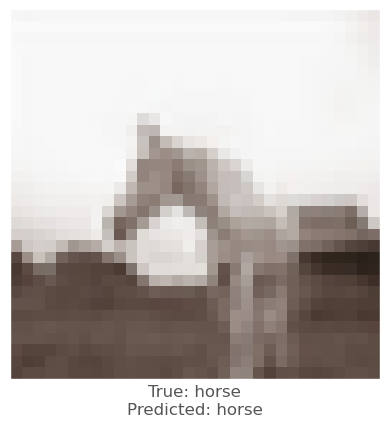



-0.0054321885
-0.008330643
-0.001732111
vr, vg, vb :   2.323784106373787 3.385304797291756 1.0637567561864854
beam_perturbed_confidence temp :  0.6627287
beam_perturbed_confidence temp :  0.6591814
beam_perturbed_confidence temp :  0.66760737
beam_perturbed_confidence temp :  0.6584989
beam_perturbed_confidence temp :  0.66276604
beam_perturbed_confidence temp :  0.6596093
beam_perturbed_confidence temp :  0.65943944
row index :  3
4th round's confidence : 3th 0.6584989
predicted class :  horse
predicted class's confidence :  0.6584989
Lopt is :  10


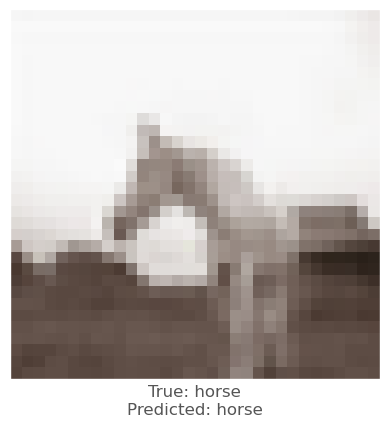



0.0006352067
-0.003347516
0.00083863735
vr, vg, vb :   -0.4204951971769333 0.9901713246107102 -0.8028570055961609
beam_perturbed_confidence temp :  0.6980024
beam_perturbed_confidence temp :  0.69851583
beam_perturbed_confidence temp :  0.6982513
beam_perturbed_confidence temp :  0.6980024
beam_perturbed_confidence temp :  0.69779086
beam_perturbed_confidence temp :  0.6982513
beam_perturbed_confidence temp :  0.69779086
row index :  4
4th round's confidence : 4th 0.69779086
predicted class :  horse
predicted class's confidence :  0.69779086
Lopt is :  10


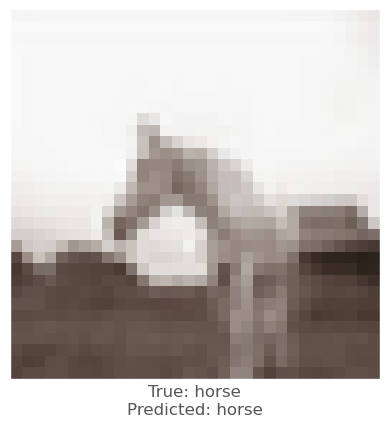



0.0003157258
-0.0013278723
0.0007992387
vr, vg, vb :   -1.3503125291466715 -1.119872565686703 -1.541541513681412
beam_perturbed_confidence temp :  0.6622295
beam_perturbed_confidence temp :  0.6632191
beam_perturbed_confidence temp :  0.6604132
beam_perturbed_confidence temp :  0.6679617
beam_perturbed_confidence temp :  0.6617995
beam_perturbed_confidence temp :  0.6636157
beam_perturbed_confidence temp :  0.6696834
row index :  2
5th round's confidence : 0th 0.6604132
predicted class :  horse
predicted class's confidence :  0.6604132
Lopt is :  10


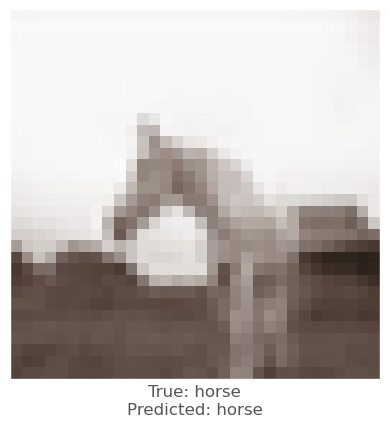



0.00034558773
-0.0019463897
0.0012894869
vr, vg, vb :   0.6724029805064202 1.428263177096844 -0.43967019391059875
beam_perturbed_confidence temp :  0.6595738
beam_perturbed_confidence temp :  0.6584989
beam_perturbed_confidence temp :  0.6586461
beam_perturbed_confidence temp :  0.6584989
beam_perturbed_confidence temp :  0.6586461
beam_perturbed_confidence temp :  0.6582181
beam_perturbed_confidence temp :  0.6582181
row index :  5
5th round's confidence : 1th 0.6582181
predicted class :  horse
predicted class's confidence :  0.6582181
Lopt is :  11


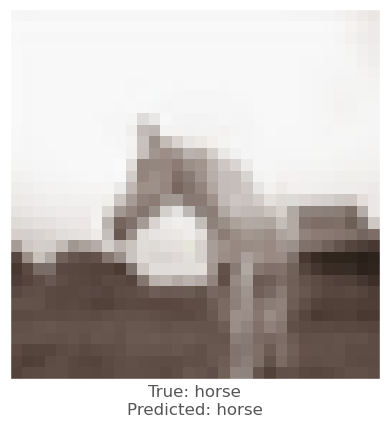



0.0008804798
-0.0018202066
0.001060009
vr, vg, vb :   -0.00842541682720184 1.260329540014267 -0.10002131491899491
beam_perturbed_confidence temp :  0.699869
beam_perturbed_confidence temp :  0.6995766
beam_perturbed_confidence temp :  0.69971794
beam_perturbed_confidence temp :  0.6988992
beam_perturbed_confidence temp :  0.69993013
beam_perturbed_confidence temp :  0.69874525
beam_perturbed_confidence temp :  0.69825906
row index :  6
5th round's confidence : 2th 0.69825906
predicted class :  horse
predicted class's confidence :  0.69825906
Lopt is :  8


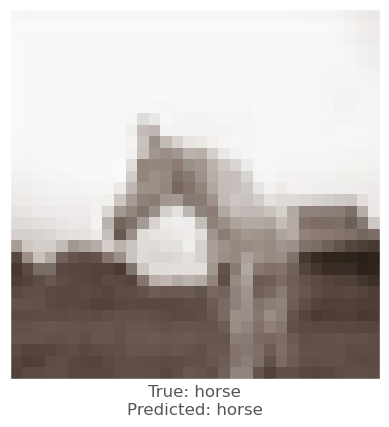



0.0013276935
-0.00092589855
0.0012213588
vr, vg, vb :   1.9586363494992258 3.139364172756672 0.835245202958584
beam_perturbed_confidence temp :  0.6599601
beam_perturbed_confidence temp :  0.6641559
beam_perturbed_confidence temp :  0.6584989
beam_perturbed_confidence temp :  0.6679479
beam_perturbed_confidence temp :  0.6599601
beam_perturbed_confidence temp :  0.6641559
beam_perturbed_confidence temp :  0.6679479
row index :  2
5th round's confidence : 3th 0.6584989
predicted class :  horse
predicted class's confidence :  0.6584989
Lopt is :  10


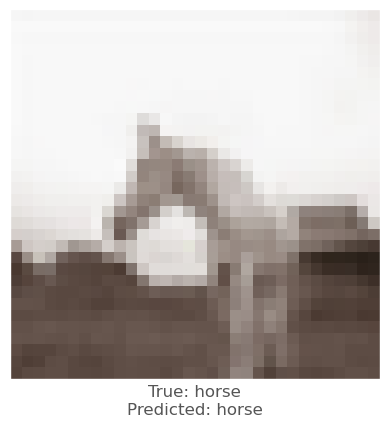



0.0012472868
-0.0030857325
0.0008030534
vr, vg, vb :   -0.5031743571162224 1.1997274381518364 -0.8028766429424287
beam_perturbed_confidence temp :  0.697004
beam_perturbed_confidence temp :  0.6960644
beam_perturbed_confidence temp :  0.69719934
beam_perturbed_confidence temp :  0.69557977
beam_perturbed_confidence temp :  0.69651306
beam_perturbed_confidence temp :  0.6955371
beam_perturbed_confidence temp :  0.695067
row index :  6
5th round's confidence : 4th 0.695067
predicted class :  horse
predicted class's confidence :  0.695067
Lopt is :  11


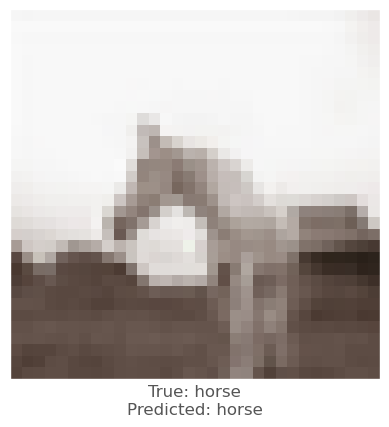



0.00068748
-0.0012100339
0.0012521744
vr, vg, vb :   -1.28402927351594 -0.8868819197595121 -1.5126048000574113
beam_perturbed_confidence temp :  0.6617995
beam_perturbed_confidence temp :  0.6610031
beam_perturbed_confidence temp :  0.6589722
beam_perturbed_confidence temp :  0.66549075
beam_perturbed_confidence temp :  0.66291475
beam_perturbed_confidence temp :  0.6610118
beam_perturbed_confidence temp :  0.66719586
row index :  2
6th round's confidence : 0th 0.6589722
predicted class :  horse
predicted class's confidence :  0.6589722
Lopt is :  12


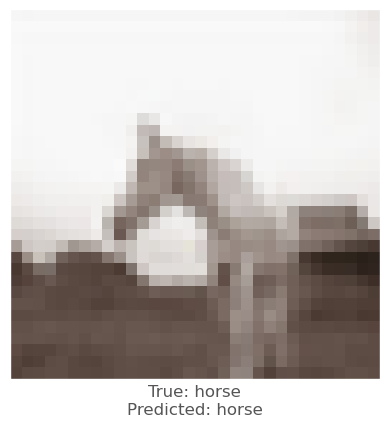



0.00127244
-0.0007889271
0.0009980798
vr, vg, vb :   0.4779186867892743 1.3643295672118665 -0.4955111521959305
beam_perturbed_confidence temp :  0.6582181
beam_perturbed_confidence temp :  0.6578572
beam_perturbed_confidence temp :  0.6575008
beam_perturbed_confidence temp :  0.6578572
beam_perturbed_confidence temp :  0.6575008
beam_perturbed_confidence temp :  0.65686333
beam_perturbed_confidence temp :  0.65686333
row index :  5
6th round's confidence : 1th 0.65686333
predicted class :  horse
predicted class's confidence :  0.65686333
Lopt is :  12


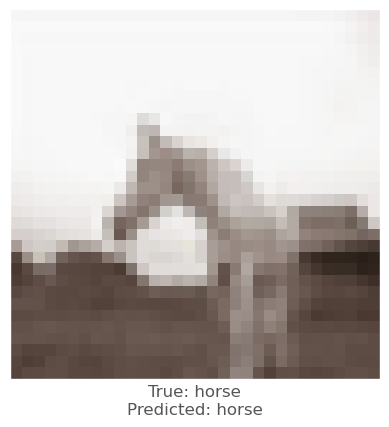



0.00011360645
-0.002454698
0.0005813241
vr, vg, vb :   -0.01894352043867111 1.3797663945913314 -0.1481515934765339
beam_perturbed_confidence temp :  0.69863164
beam_perturbed_confidence temp :  0.69747543
beam_perturbed_confidence temp :  0.6983179
beam_perturbed_confidence temp :  0.69671434
beam_perturbed_confidence temp :  0.69883394
beam_perturbed_confidence temp :  0.6968242
beam_perturbed_confidence temp :  0.69637156
row index :  6
6th round's confidence : 2th 0.69637156
predicted class :  horse
predicted class's confidence :  0.69637156
Lopt is :  9


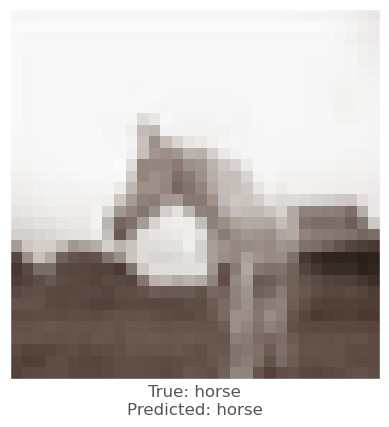



0.0013276935
-0.00092589855
0.0012213588
vr, vg, vb :   1.6300033683121207 2.9180176106750966 0.6295848050534727
beam_perturbed_confidence temp :  0.6599601
beam_perturbed_confidence temp :  0.6585057
beam_perturbed_confidence temp :  0.6584989
beam_perturbed_confidence temp :  0.66330576
beam_perturbed_confidence temp :  0.6599601
beam_perturbed_confidence temp :  0.6585057
beam_perturbed_confidence temp :  0.66330576
row index :  2
6th round's confidence : 3th 0.6584989
predicted class :  horse
predicted class's confidence :  0.6584989
Lopt is :  10


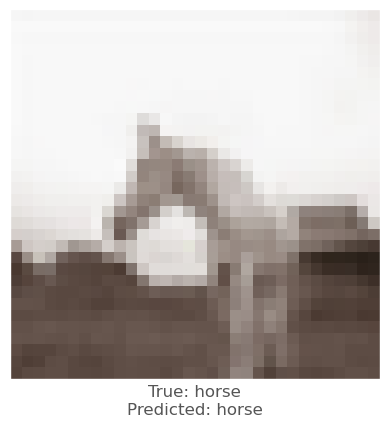



0.00052940845
-0.0027641654
0.00074881315
vr, vg, vb :   -0.505797766894102 1.3561712344825267 -0.7974702938795091
beam_perturbed_confidence temp :  0.6950077
beam_perturbed_confidence temp :  0.6937489
beam_perturbed_confidence temp :  0.69483095
beam_perturbed_confidence temp :  0.69370556
beam_perturbed_confidence temp :  0.69452125
beam_perturbed_confidence temp :  0.6930739
beam_perturbed_confidence temp :  0.6932564
row index :  5
6th round's confidence : 4th 0.6930739
predicted class :  horse
predicted class's confidence :  0.6930739
Lopt is :  12


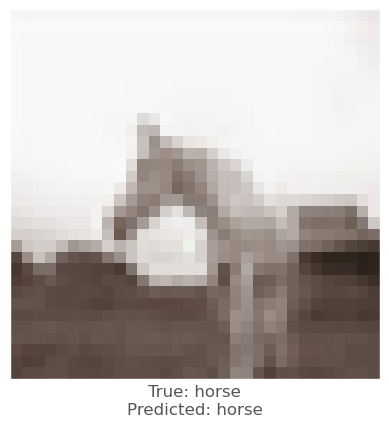



-0.0010200739
-0.0024125576
0.0010781884
vr, vg, vb :   -1.0536189570957426 -0.5569379675906898 -1.4691631619858743
beam_perturbed_confidence temp :  0.66291475
beam_perturbed_confidence temp :  0.6610118
beam_perturbed_confidence temp :  0.6587739
beam_perturbed_confidence temp :  0.66719586
beam_perturbed_confidence temp :  0.6651429
beam_perturbed_confidence temp :  0.663232
beam_perturbed_confidence temp :  0.66972446
row index :  2
7th round's confidence : 0th 0.6587739
predicted class :  horse
predicted class's confidence :  0.6587739
Lopt is :  14


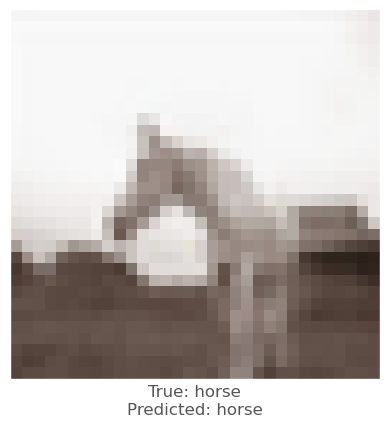



0.0022520423
-0.0005197525
0.0013017654
vr, vg, vb :   0.20492258875548847 1.2798718607348205 -0.5761365811657906
beam_perturbed_confidence temp :  0.65686333
beam_perturbed_confidence temp :  0.65698105
beam_perturbed_confidence temp :  0.6565554
beam_perturbed_confidence temp :  0.65698105
beam_perturbed_confidence temp :  0.6565554
beam_perturbed_confidence temp :  0.6563785
beam_perturbed_confidence temp :  0.6563785
row index :  5
7th round's confidence : 1th 0.6563785
predicted class :  horse
predicted class's confidence :  0.6563785
Lopt is :  13


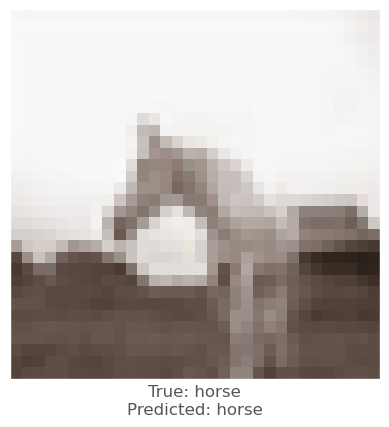



-0.00035363436
-0.0033055544
-0.00033330917
vr, vg, vb :   0.01831426735043526 1.5723451941275597 -0.10000551677048208
beam_perturbed_confidence temp :  0.69637156
beam_perturbed_confidence temp :  0.6955284
beam_perturbed_confidence temp :  0.69704765
beam_perturbed_confidence temp :  0.6955284
beam_perturbed_confidence temp :  0.69704765
beam_perturbed_confidence temp :  0.69484156
beam_perturbed_confidence temp :  0.69484156
row index :  5
7th round's confidence : 2th 0.69484156
predicted class :  horse
predicted class's confidence :  0.69484156
Lopt is :  10


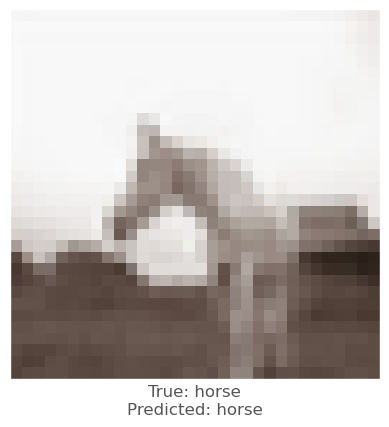



0.0013276935
-0.00092589855
0.0012213588
vr, vg, vb :   1.334233685243726 2.718805704801679 0.4444904469388725
beam_perturbed_confidence temp :  0.6599601
beam_perturbed_confidence temp :  0.6585057
beam_perturbed_confidence temp :  0.6584989
beam_perturbed_confidence temp :  0.66330576
beam_perturbed_confidence temp :  0.6599601
beam_perturbed_confidence temp :  0.6585057
beam_perturbed_confidence temp :  0.66330576
row index :  2
7th round's confidence : 3th 0.6584989
predicted class :  horse
predicted class's confidence :  0.6584989
Lopt is :  10


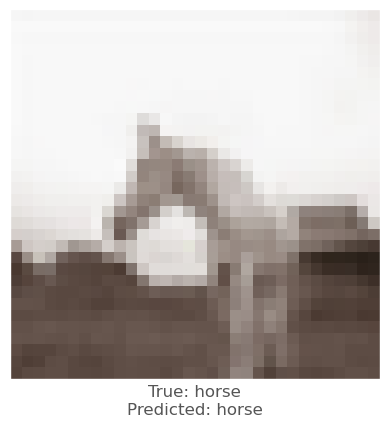



0.0002862215
-0.003499329
0.00085413456
vr, vg, vb :   -0.4838401406258344 1.570487020046115 -0.803136720454693
beam_perturbed_confidence temp :  0.6932564
beam_perturbed_confidence temp :  0.6913316
beam_perturbed_confidence temp :  0.69289476
beam_perturbed_confidence temp :  0.6916117
beam_perturbed_confidence temp :  0.69282264
beam_perturbed_confidence temp :  0.69091463
beam_perturbed_confidence temp :  0.69088656
row index :  6
7th round's confidence : 4th 0.69088656
predicted class :  horse
predicted class's confidence :  0.69088656
Lopt is :  13


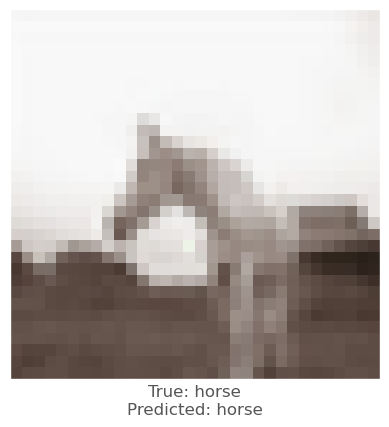



-0.004934132
-0.006228626
-0.0014964938
vr, vg, vb :   -0.45484385147100725 0.12161840660673362 -1.1725974641497137
beam_perturbed_confidence temp :  0.66224885
beam_perturbed_confidence temp :  0.6587739
beam_perturbed_confidence temp :  0.6612756
beam_perturbed_confidence temp :  0.66224885
beam_perturbed_confidence temp :  0.6646771
beam_perturbed_confidence temp :  0.6612756
beam_perturbed_confidence temp :  0.6646771
row index :  1
8th round's confidence : 0th 0.6587739
predicted class :  horse
predicted class's confidence :  0.6587739
Lopt is :  14


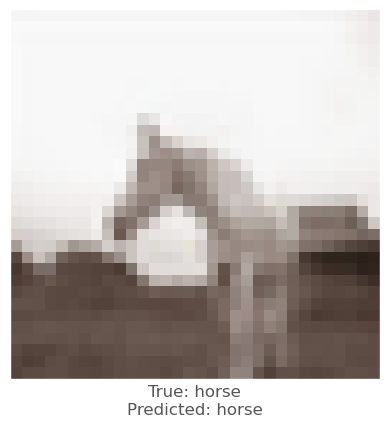



0.002787888
-0.00045126677
0.0016515255
vr, vg, vb :   -0.09435847512799495 1.1970113512207867 -0.6836754727928639
beam_perturbed_confidence temp :  0.6550664
beam_perturbed_confidence temp :  0.65610415
beam_perturbed_confidence temp :  0.6553295
beam_perturbed_confidence temp :  0.6544945
beam_perturbed_confidence temp :  0.65430874
beam_perturbed_confidence temp :  0.65527207
beam_perturbed_confidence temp :  0.6537247
row index :  6
8th round's confidence : 1th 0.6537247
predicted class :  horse
predicted class's confidence :  0.6537247
Lopt is :  14


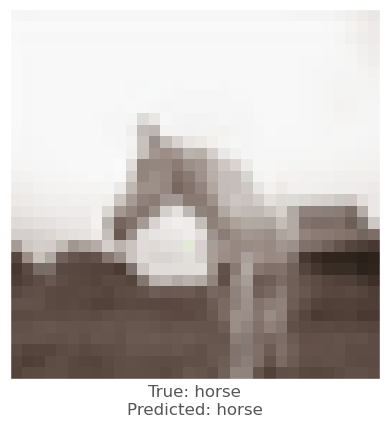



0.00035911798
-0.0028965473
0.00087583065
vr, vg, vb :   -0.01942895786178112 1.704765406465292 -0.17758803012639285
beam_perturbed_confidence temp :  0.69502765
beam_perturbed_confidence temp :  0.6941511
beam_perturbed_confidence temp :  0.69465256
beam_perturbed_confidence temp :  0.69359726
beam_perturbed_confidence temp :  0.6958359
beam_perturbed_confidence temp :  0.6936041
beam_perturbed_confidence temp :  0.693299
row index :  6
8th round's confidence : 2th 0.693299
predicted class :  horse
predicted class's confidence :  0.693299
Lopt is :  11


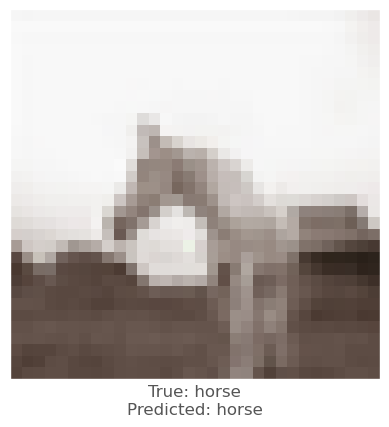



0.0013276935
-0.00092589855
0.0012213588
vr, vg, vb :   1.0680409704821707 2.539514989515603 0.27790552463573237
beam_perturbed_confidence temp :  0.6599601
beam_perturbed_confidence temp :  0.6585057
beam_perturbed_confidence temp :  0.6584989
beam_perturbed_confidence temp :  0.66330576
beam_perturbed_confidence temp :  0.6599601
beam_perturbed_confidence temp :  0.6585057
beam_perturbed_confidence temp :  0.66330576
row index :  2
8th round's confidence : 3th 0.6584989
predicted class :  horse
predicted class's confidence :  0.6584989
Lopt is :  10


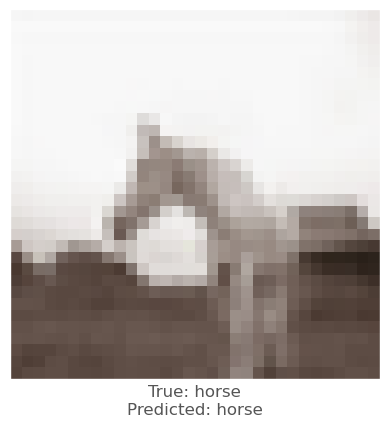



-0.00015741587
-0.0047656894
0.0011236668
vr, vg, vb :   -0.41971453987807034 1.8900072553431393 -0.8351897247397901
beam_perturbed_confidence temp :  0.69107205
beam_perturbed_confidence temp :  0.68805695
beam_perturbed_confidence temp :  0.69048804
beam_perturbed_confidence temp :  0.68886197
beam_perturbed_confidence temp :  0.69053143
beam_perturbed_confidence temp :  0.68767256
beam_perturbed_confidence temp :  0.68838197
row index :  5
8th round's confidence : 4th 0.68767256
predicted class :  horse
predicted class's confidence :  0.68767256
Lopt is :  14


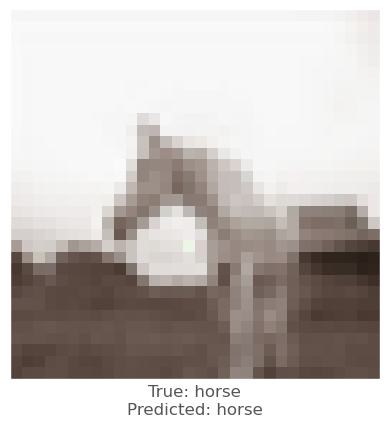



-0.004934132
-0.006228626
-0.0014964938
vr, vg, vb :   0.08405374359125461 0.7323191433844147 -0.905688336097169
beam_perturbed_confidence temp :  0.6587739
beam_perturbed_confidence temp :  0.6587739
beam_perturbed_confidence temp :  0.66001135
beam_perturbed_confidence temp :  0.6587739
beam_perturbed_confidence temp :  0.66001135
beam_perturbed_confidence temp :  0.66001135
beam_perturbed_confidence temp :  0.66001135
row index :  0
9th round's confidence : 0th 0.6587739
predicted class :  horse
predicted class's confidence :  0.6587739
Lopt is :  14


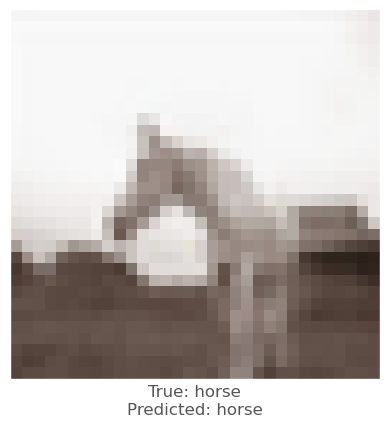



0.0012931228
-0.0009863377
0.0011833906
vr, vg, vb :   -0.2142349044554054 1.1759439822730244 -0.733646987250638
beam_perturbed_confidence temp :  0.65397894
beam_perturbed_confidence temp :  0.6533224
beam_perturbed_confidence temp :  0.65331113
beam_perturbed_confidence temp :  0.65198797
beam_perturbed_confidence temp :  0.6531375
beam_perturbed_confidence temp :  0.65193856
beam_perturbed_confidence temp :  0.6516692
row index :  6
9th round's confidence : 1th 0.6516692
predicted class :  horse
predicted class's confidence :  0.6516692
Lopt is :  15


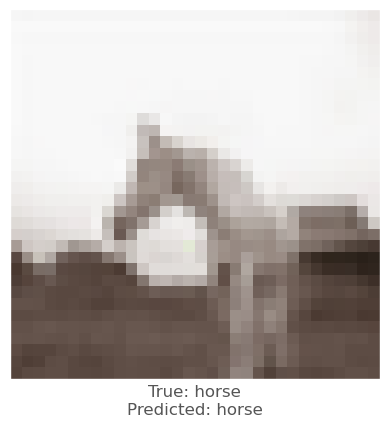



-0.00087076426
-0.0038903356
0.0001834631
vr, vg, vb :   0.06959036347676516 1.9233224218032599 -0.17817553677561881
beam_perturbed_confidence temp :  0.693299
beam_perturbed_confidence temp :  0.69194555
beam_perturbed_confidence temp :  0.6934138
beam_perturbed_confidence temp :  0.69194555
beam_perturbed_confidence temp :  0.6934138
beam_perturbed_confidence temp :  0.69155145
beam_perturbed_confidence temp :  0.69155145
row index :  5
9th round's confidence : 2th 0.69155145
predicted class :  horse
predicted class's confidence :  0.69155145
Lopt is :  12


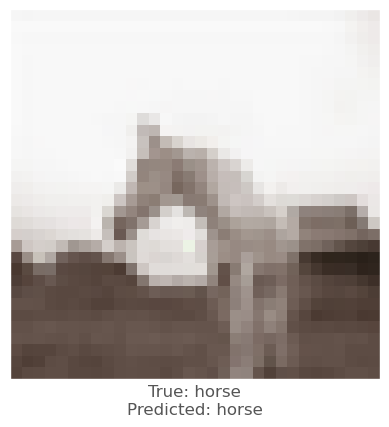



0.0013276935
-0.00092589855
0.0012213588
vr, vg, vb :   0.8284675271967711 2.3781533457581343 0.12797909456290624
beam_perturbed_confidence temp :  0.6584989
beam_perturbed_confidence temp :  0.6585057
beam_perturbed_confidence temp :  0.6584989
beam_perturbed_confidence temp :  0.6585057
beam_perturbed_confidence temp :  0.6584989
beam_perturbed_confidence temp :  0.6585057
beam_perturbed_confidence temp :  0.6585057
row index :  0
9th round's confidence : 3th 0.6584989
predicted class :  horse
predicted class's confidence :  0.6584989
Lopt is :  10


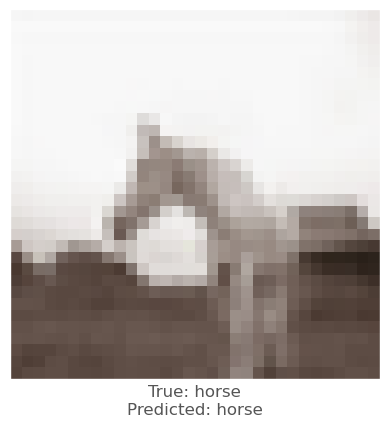



-0.0013579726
-0.0064056516
0.0006452799
vr, vg, vb :   -0.24194582369849083 2.3415716867454712 -0.816198740699649
beam_perturbed_confidence temp :  0.68838197
beam_perturbed_confidence temp :  0.6814084
beam_perturbed_confidence temp :  0.68741167
beam_perturbed_confidence temp :  0.68172145
beam_perturbed_confidence temp :  0.68808895
beam_perturbed_confidence temp :  0.6805326
beam_perturbed_confidence temp :  0.6811037
row index :  5
9th round's confidence : 4th 0.6805326
predicted class :  horse
predicted class's confidence :  0.6805326
Lopt is :  16


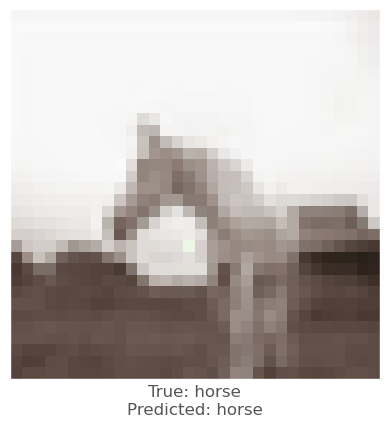



-0.004934132
-0.006228626
-0.0014964938
vr, vg, vb :   0.5690615791472903 1.2819498064843278 -0.6654701208498789
beam_perturbed_confidence temp :  0.6587739
beam_perturbed_confidence temp :  0.6570034
beam_perturbed_confidence temp :  0.66001135
beam_perturbed_confidence temp :  0.6570034
beam_perturbed_confidence temp :  0.66001135
beam_perturbed_confidence temp :  0.6564204
beam_perturbed_confidence temp :  0.6564204
row index :  5
10th round's confidence : 0th 0.6564204
predicted class :  horse
predicted class's confidence :  0.6564204
Lopt is :  15


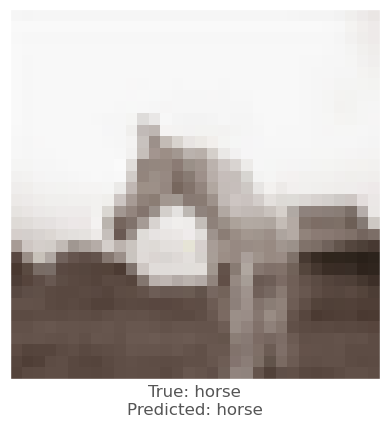



0.00041908026
-0.0026952028
0.00094789267
vr, vg, vb :   -0.23471943975144202 1.3278698667910833 -0.755071555111878
beam_perturbed_confidence temp :  0.6515195
beam_perturbed_confidence temp :  0.6504423
beam_perturbed_confidence temp :  0.6510401
beam_perturbed_confidence temp :  0.6499814
beam_perturbed_confidence temp :  0.65118325
beam_perturbed_confidence temp :  0.64951706
beam_perturbed_confidence temp :  0.6496857
row index :  5
10th round's confidence : 1th 0.64951706
predicted class :  horse
predicted class's confidence :  0.64951706
Lopt is :  16


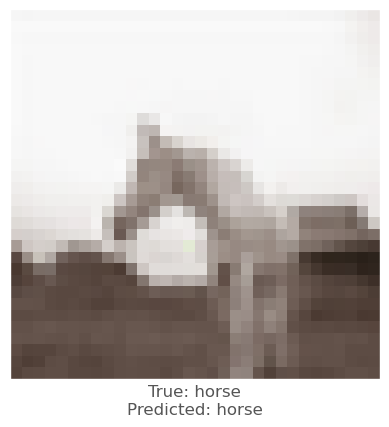



6.9737434e-05
-0.0033558607
0.0006583929
vr, vg, vb :   0.05565758369036794 2.066576250637338 -0.22619727371695342
beam_perturbed_confidence temp :  0.69155145
beam_perturbed_confidence temp :  0.68808895
beam_perturbed_confidence temp :  0.69128716
beam_perturbed_confidence temp :  0.68808895
beam_perturbed_confidence temp :  0.69128716
beam_perturbed_confidence temp :  0.6877224
beam_perturbed_confidence temp :  0.6877224
row index :  5
10th round's confidence : 2th 0.6877224
predicted class :  horse
predicted class's confidence :  0.6877224
Lopt is :  14


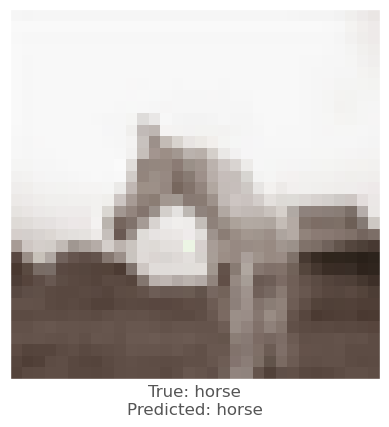



0.0013276935
-0.00092589855
0.0012213588
vr, vg, vb :   0.6128514282399113 2.232927866376413 -0.006954692502637319
beam_perturbed_confidence temp :  0.6584989
beam_perturbed_confidence temp :  0.6585057
beam_perturbed_confidence temp :  0.6582181
beam_perturbed_confidence temp :  0.6585057
beam_perturbed_confidence temp :  0.6582181
beam_perturbed_confidence temp :  0.6576816
beam_perturbed_confidence temp :  0.6576816
row index :  5
10th round's confidence : 3th 0.6576816
predicted class :  horse
predicted class's confidence :  0.6576816
Lopt is :  11


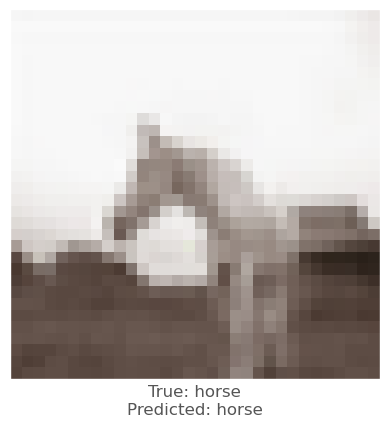



-0.0010319948
-0.005882561
0.0015363097
vr, vg, vb :   -0.11455175936453041 2.695670638752687 -0.8882098385382535
beam_perturbed_confidence temp :  0.6811037
beam_perturbed_confidence temp :  0.6747363
beam_perturbed_confidence temp :  0.6798721
beam_perturbed_confidence temp :  0.67480654
beam_perturbed_confidence temp :  0.680871
beam_perturbed_confidence temp :  0.67369926
beam_perturbed_confidence temp :  0.67365247
row index :  6
10th round's confidence : 4th 0.67365247
predicted class :  horse
predicted class's confidence :  0.67365247
Lopt is :  18


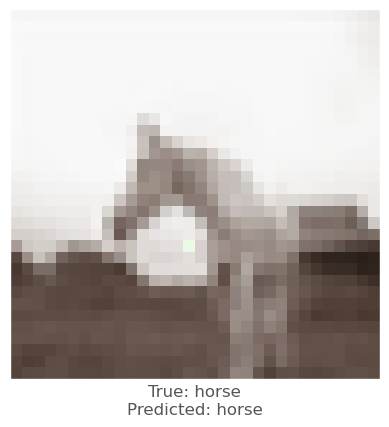



-0.0024397373
-0.004221201
0.00024706125
vr, vg, vb :   0.7561291532271902 1.5758749201352114 -0.6236292340242904
beam_perturbed_confidence temp :  0.6564204
beam_perturbed_confidence temp :  0.65579015
beam_perturbed_confidence temp :  0.65675634
beam_perturbed_confidence temp :  0.65579015
beam_perturbed_confidence temp :  0.65675634
beam_perturbed_confidence temp :  0.65501827
beam_perturbed_confidence temp :  0.65501827
row index :  5
11th round's confidence : 0th 0.65501827
predicted class :  horse
predicted class's confidence :  0.65501827
Lopt is :  16


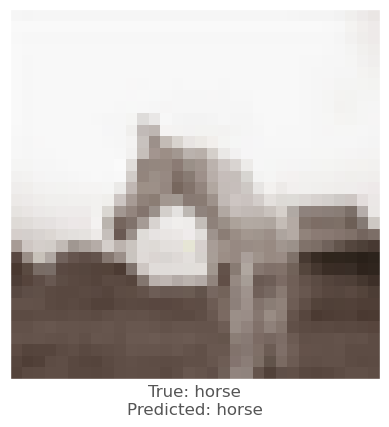



0.0008586049
-0.0017568469
0.0011892319
vr, vg, vb :   -0.297107986575248 1.370767570587439 -0.7984875868565495
beam_perturbed_confidence temp :  0.6496857
beam_perturbed_confidence temp :  0.64928323
beam_perturbed_confidence temp :  0.6492531
beam_perturbed_confidence temp :  0.6480956
beam_perturbed_confidence temp :  0.6489006
beam_perturbed_confidence temp :  0.6480076
beam_perturbed_confidence temp :  0.64772934
row index :  6
11th round's confidence : 1th 0.64772934
predicted class :  horse
predicted class's confidence :  0.64772934
Lopt is :  17


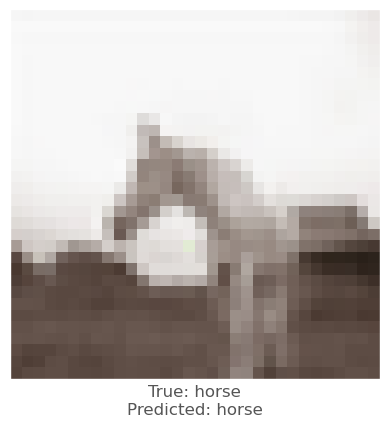



-0.00020313263
-0.0047088265
0.00090253353
vr, vg, vb :   0.07040508826078427 2.3308012797636675 -0.2938308994641545
beam_perturbed_confidence temp :  0.6877224
beam_perturbed_confidence temp :  0.680871
beam_perturbed_confidence temp :  0.6871864
beam_perturbed_confidence temp :  0.680871
beam_perturbed_confidence temp :  0.6871864
beam_perturbed_confidence temp :  0.6808228
beam_perturbed_confidence temp :  0.6808228
row index :  5
11th round's confidence : 2th 0.6808228
predicted class :  horse
predicted class's confidence :  0.6808228
Lopt is :  16


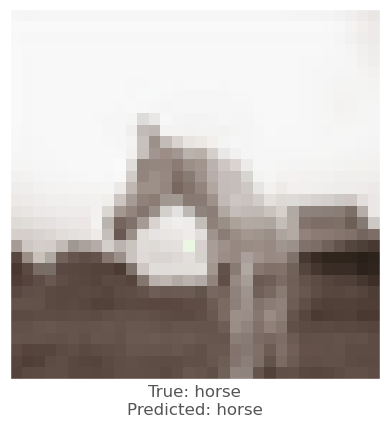



0.003568232
0.0024067163
0.0015246272
vr, vg, vb :   0.19474307946804426 1.7689634450646996 -0.15872194412334525
beam_perturbed_confidence temp :  0.6576816
beam_perturbed_confidence temp :  0.6602639
beam_perturbed_confidence temp :  0.65698105
beam_perturbed_confidence temp :  0.6602639
beam_perturbed_confidence temp :  0.65698105
beam_perturbed_confidence temp :  0.65706295
beam_perturbed_confidence temp :  0.65706295
row index :  2
11th round's confidence : 3th 0.65698105
predicted class :  horse
predicted class's confidence :  0.65698105
Lopt is :  12


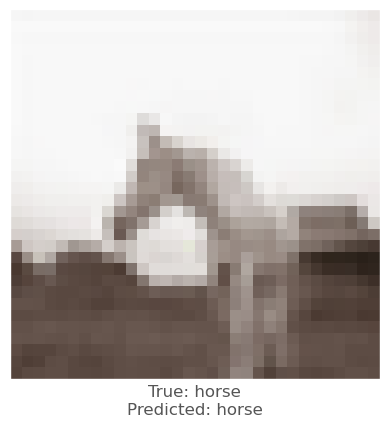



-0.00037395954
-0.0070261955
0.0017926097
vr, vg, vb :   -0.06570062929599729 3.128723127489723 -0.9786498238464155
beam_perturbed_confidence temp :  0.6740732
beam_perturbed_confidence temp :  0.66250795
beam_perturbed_confidence temp :  0.6730139
beam_perturbed_confidence temp :  0.6631683
beam_perturbed_confidence temp :  0.67338246
beam_perturbed_confidence temp :  0.6619189
beam_perturbed_confidence temp :  0.6621636
row index :  5
11th round's confidence : 4th 0.6619189
predicted class :  horse
predicted class's confidence :  0.6619189
Lopt is :  21


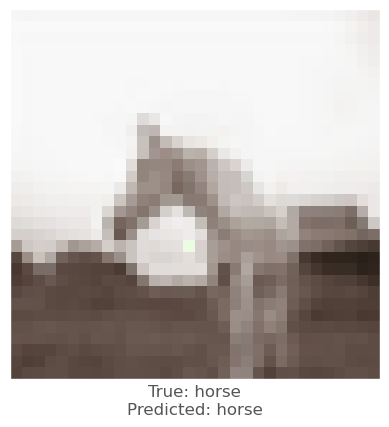



-0.00013190508
-0.0016071796
0.0012399554
vr, vg, vb :   0.6937067457932652 1.5790053922940535 -0.6852618531481065
beam_perturbed_confidence temp :  0.65501827
beam_perturbed_confidence temp :  0.65514916
beam_perturbed_confidence temp :  0.6545502
beam_perturbed_confidence temp :  0.65514916
beam_perturbed_confidence temp :  0.6545502
beam_perturbed_confidence temp :  0.65411276
beam_perturbed_confidence temp :  0.65411276
row index :  5
12th round's confidence : 0th 0.65411276
predicted class :  horse
predicted class's confidence :  0.65411276
Lopt is :  17


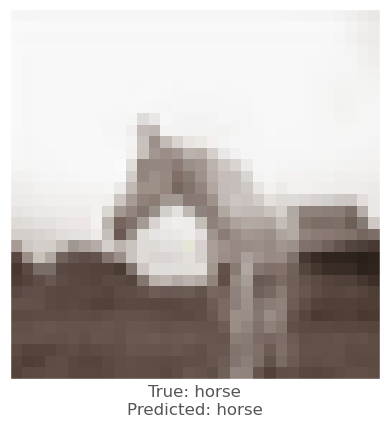



0.0007780194
-0.0022657514
0.0016815662
vr, vg, vb :   -0.3451991307430406 1.4602659497133874 -0.8867954520112267
beam_perturbed_confidence temp :  0.64722955
beam_perturbed_confidence temp :  0.6466349
beam_perturbed_confidence temp :  0.64641404
beam_perturbed_confidence temp :  0.6462227
beam_perturbed_confidence temp :  0.64564556
beam_perturbed_confidence temp :  0.6454529
beam_perturbed_confidence temp :  0.6449549
row index :  6
12th round's confidence : 1th 0.6449549
predicted class :  horse
predicted class's confidence :  0.6449549
Lopt is :  18


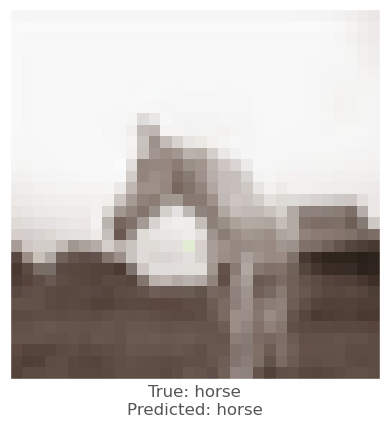



-0.0019968748
-0.007944226
4.7683716e-05
vr, vg, vb :   0.26305206036121953 2.8921437782826622 -0.26921618109977036
beam_perturbed_confidence temp :  0.6808228
beam_perturbed_confidence temp :  0.6730139
beam_perturbed_confidence temp :  0.6808233
beam_perturbed_confidence temp :  0.6730139
beam_perturbed_confidence temp :  0.6808233
beam_perturbed_confidence temp :  0.67234737
beam_perturbed_confidence temp :  0.67234737
row index :  5
12th round's confidence : 2th 0.67234737
predicted class :  horse
predicted class's confidence :  0.67234737
Lopt is :  18


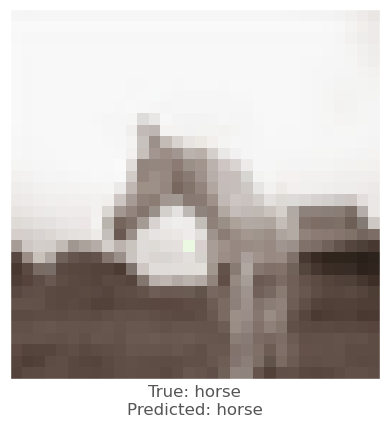



0.0028671622
0.00019961596
0.0013030767
vr, vg, vb :   -0.11144745124182168 1.5721055050229513 -0.2731574241189697
beam_perturbed_confidence temp :  0.6556128
beam_perturbed_confidence temp :  0.65706295
beam_perturbed_confidence temp :  0.6563785
beam_perturbed_confidence temp :  0.6554475
beam_perturbed_confidence temp :  0.6550664
beam_perturbed_confidence temp :  0.65610415
beam_perturbed_confidence temp :  0.6544945
row index :  6
12th round's confidence : 3th 0.6544945
predicted class :  horse
predicted class's confidence :  0.6544945
Lopt is :  13


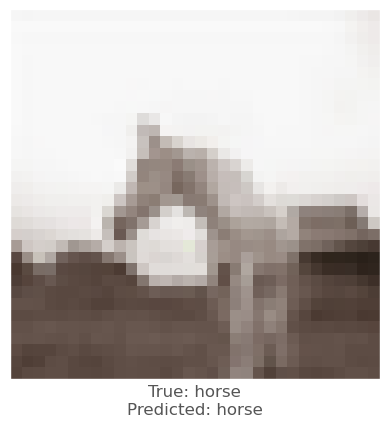



-0.0006092191
-0.007911861
0.0013783574
vr, vg, vb :   0.0017913410585291903 3.6070369090248087 -1.0186205825048646
beam_perturbed_confidence temp :  0.6619189
beam_perturbed_confidence temp :  0.65041226
beam_perturbed_confidence temp :  0.6602982
beam_perturbed_confidence temp :  0.65041226
beam_perturbed_confidence temp :  0.6602982
beam_perturbed_confidence temp :  0.6477855
beam_perturbed_confidence temp :  0.6477855
row index :  5
12th round's confidence : 4th 0.6477855
predicted class :  horse
predicted class's confidence :  0.6477855
Lopt is :  24


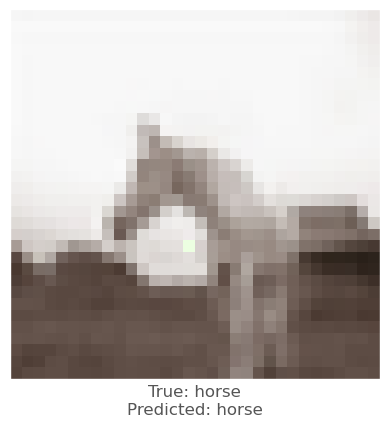



0.0013434887
-0.00023001432
0.002372563
vr, vg, vb :   0.48998720189020817 1.4441062854834714 -0.8539919563617383
beam_perturbed_confidence temp :  0.65411276
beam_perturbed_confidence temp :  0.6543202
beam_perturbed_confidence temp :  0.6527766
beam_perturbed_confidence temp :  0.6543202
beam_perturbed_confidence temp :  0.6527766
beam_perturbed_confidence temp :  0.65284055
beam_perturbed_confidence temp :  0.65284055
row index :  2
13th round's confidence : 0th 0.6527766
predicted class :  horse
predicted class's confidence :  0.6527766
Lopt is :  18


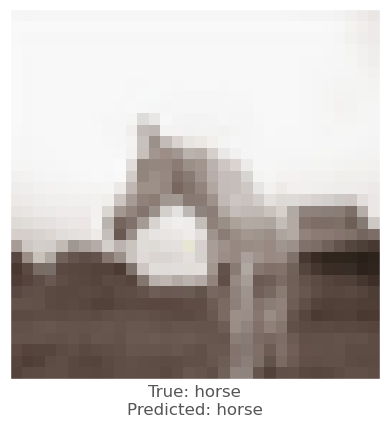



0.0009784698
-0.0014227629
0.0027700067
vr, vg, vb :   -0.40852620253201777 1.4565156418209062 -1.0751165724747769
beam_perturbed_confidence temp :  0.64447445
beam_perturbed_confidence temp :  0.6442228
beam_perturbed_confidence temp :  0.64194065
beam_perturbed_confidence temp :  0.6443173
beam_perturbed_confidence temp :  0.64199156
beam_perturbed_confidence temp :  0.64114374
beam_perturbed_confidence temp :  0.64063823
row index :  6
13th round's confidence : 1th 0.64063823
predicted class :  horse
predicted class's confidence :  0.64063823
Lopt is :  20


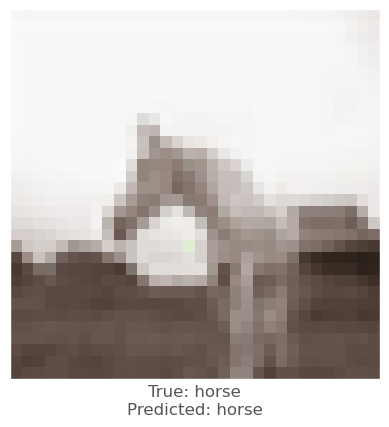



-0.001213789
-0.008203626
0.00095772743
vr, vg, vb :   0.35812575294570304 3.4232919683560072 -0.338067306214891
beam_perturbed_confidence temp :  0.67234737
beam_perturbed_confidence temp :  0.6611296
beam_perturbed_confidence temp :  0.6720562
beam_perturbed_confidence temp :  0.6611296
beam_perturbed_confidence temp :  0.6720562
beam_perturbed_confidence temp :  0.6602982
beam_perturbed_confidence temp :  0.6602982
row index :  5
13th round's confidence : 2th 0.6602982
predicted class :  horse
predicted class's confidence :  0.6602982
Lopt is :  21


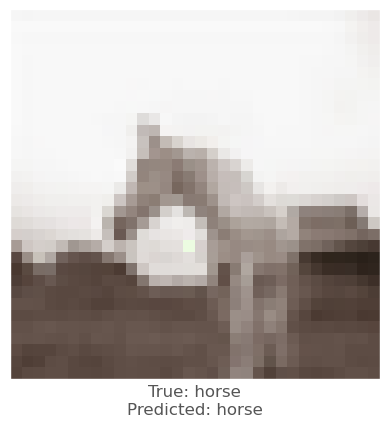



0.0019174218
-0.0002927184
0.0017228127
vr, vg, vb :   -0.29204488789559363 1.4441667955698505 -0.41812294696586183
beam_perturbed_confidence temp :  0.6541867
beam_perturbed_confidence temp :  0.65477365
beam_perturbed_confidence temp :  0.6537247
beam_perturbed_confidence temp :  0.6532007
beam_perturbed_confidence temp :  0.65397894
beam_perturbed_confidence temp :  0.6533224
beam_perturbed_confidence temp :  0.65198797
row index :  6
13th round's confidence : 3th 0.65198797
predicted class :  horse
predicted class's confidence :  0.65198797
Lopt is :  14


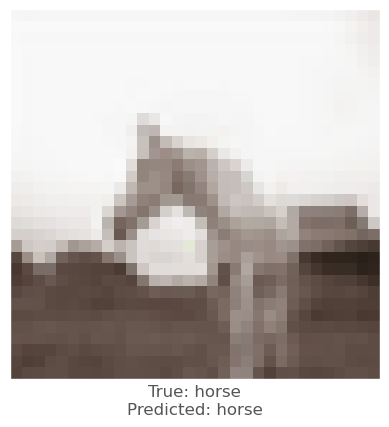



0.0013630986
-0.0042800903
0.0022525787
vr, vg, vb :   -0.13469765518416454 3.6743422513254527 -1.1420163977895346
beam_perturbed_confidence temp :  0.64732003
beam_perturbed_confidence temp :  0.6477855
beam_perturbed_confidence temp :  0.6458076
beam_perturbed_confidence temp :  0.64732003
beam_perturbed_confidence temp :  0.64566743
beam_perturbed_confidence temp :  0.6458076
beam_perturbed_confidence temp :  0.64566743
row index :  4
13th round's confidence : 4th 0.64566743
predicted class :  horse
predicted class's confidence :  0.64566743
Lopt is :  24


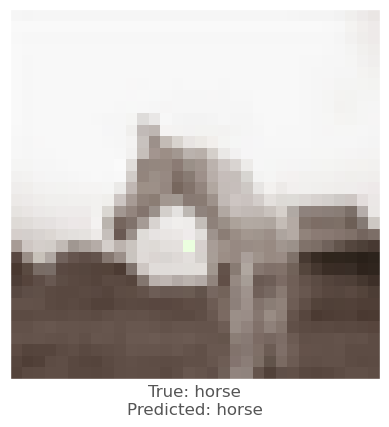



0.0007420182
-0.000842154
0.0031685233
vr, vg, vb :   0.3667866594203036 1.3839110595382738 -1.0854450918870635
beam_perturbed_confidence temp :  0.6527766
beam_perturbed_confidence temp :  0.65284055
beam_perturbed_confidence temp :  0.6497342
beam_perturbed_confidence temp :  0.65284055
beam_perturbed_confidence temp :  0.6497342
beam_perturbed_confidence temp :  0.6488215
beam_perturbed_confidence temp :  0.6488215
row index :  5
14th round's confidence : 0th 0.6488215
predicted class :  horse
predicted class's confidence :  0.6488215
Lopt is :  20


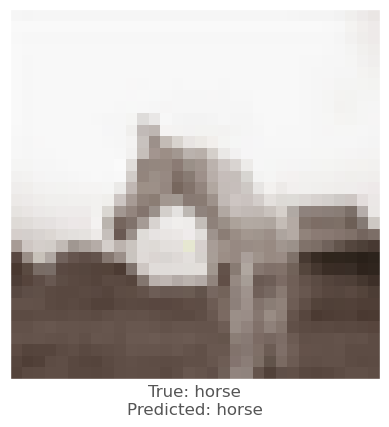



0.00044602156
-0.0016745925
0.0036211014
vr, vg, vb :   -0.41227573796424083 1.4783233271352756 -1.3297150531667523
beam_perturbed_confidence temp :  0.6406977
beam_perturbed_confidence temp :  0.64031696
beam_perturbed_confidence temp :  0.63752836
beam_perturbed_confidence temp :  0.64007086
beam_perturbed_confidence temp :  0.63886887
beam_perturbed_confidence temp :  0.63646424
beam_perturbed_confidence temp :  0.6359648
row index :  6
14th round's confidence : 1th 0.6359648
predicted class :  horse
predicted class's confidence :  0.6359648
Lopt is :  22


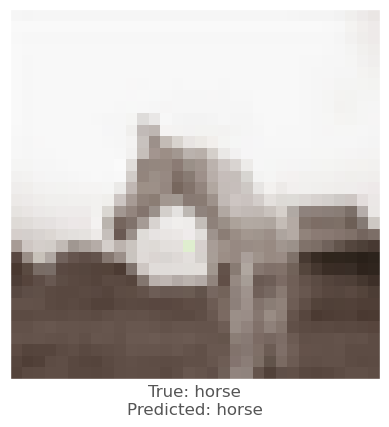



-0.00011366606
-0.0072912574
0.001614809
vr, vg, vb :   0.33367978340979976 3.8100885096643275 -0.4657414792188902
beam_perturbed_confidence temp :  0.6602982
beam_perturbed_confidence temp :  0.6477855
beam_perturbed_confidence temp :  0.6595148
beam_perturbed_confidence temp :  0.6477855
beam_perturbed_confidence temp :  0.6595148
beam_perturbed_confidence temp :  0.64680165
beam_perturbed_confidence temp :  0.64680165
row index :  5
14th round's confidence : 2th 0.64680165
predicted class :  horse
predicted class's confidence :  0.64680165
Lopt is :  24


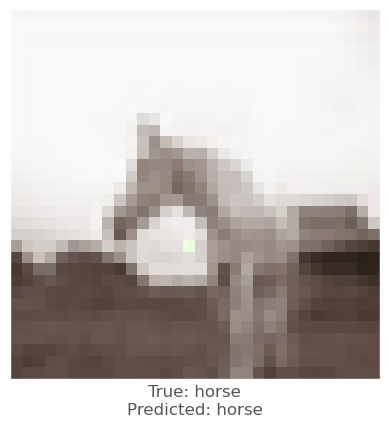



0.0011091232
-0.0022027493
0.0015314817
vr, vg, vb :   -0.37375272210408117 1.520025041244799 -0.5294588265551643
beam_perturbed_confidence temp :  0.6522133
beam_perturbed_confidence temp :  0.6517762
beam_perturbed_confidence temp :  0.6516692
beam_perturbed_confidence temp :  0.6502546
beam_perturbed_confidence temp :  0.6515195
beam_perturbed_confidence temp :  0.6504423
beam_perturbed_confidence temp :  0.6499814
row index :  6
14th round's confidence : 3th 0.6499814
predicted class :  horse
predicted class's confidence :  0.6499814
Lopt is :  15


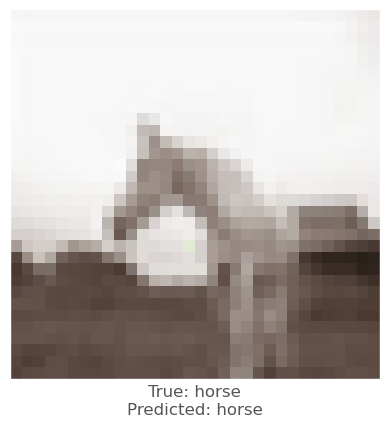



-0.00012791157
-0.004984498
0.0016622543
vr, vg, vb :   -0.10843673289694926 3.805357828591589 -1.1940401913601906
beam_perturbed_confidence temp :  0.64593554
beam_perturbed_confidence temp :  0.64566743
beam_perturbed_confidence temp :  0.6443578
beam_perturbed_confidence temp :  0.64593554
beam_perturbed_confidence temp :  0.6447404
beam_perturbed_confidence temp :  0.6443578
beam_perturbed_confidence temp :  0.6447404
row index :  2
14th round's confidence : 4th 0.6443578
predicted class :  horse
predicted class's confidence :  0.6443578
Lopt is :  24


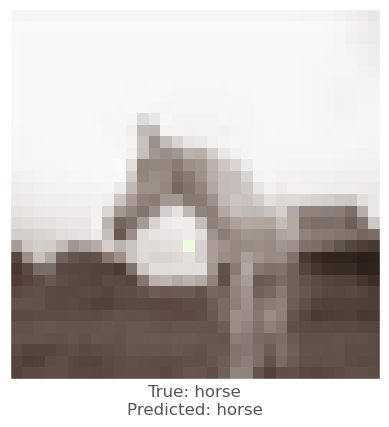



-3.105402e-05
-0.00089144707
0.0037332177
vr, vg, vb :   0.3332133954710711 1.3346646603105206 -1.3502223543200613
beam_perturbed_confidence temp :  0.6488215
beam_perturbed_confidence temp :  0.64884275
beam_perturbed_confidence temp :  0.64587784
beam_perturbed_confidence temp :  0.64884275
beam_perturbed_confidence temp :  0.64587784
beam_perturbed_confidence temp :  0.6451945
beam_perturbed_confidence temp :  0.6451945
row index :  5
15th round's confidence : 0th 0.6451945
predicted class :  horse
predicted class's confidence :  0.6451945
Lopt is :  22


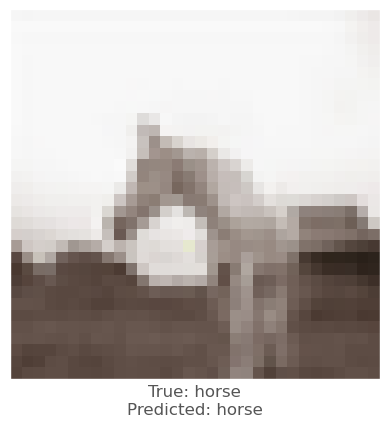



0.00026243925
-0.0031757355
0.0032935143
vr, vg, vb :   -0.39729208926242127 1.6480645417850293 -1.5260949730209756
beam_perturbed_confidence temp :  0.6362018
beam_perturbed_confidence temp :  0.63569313
beam_perturbed_confidence temp :  0.6341215
beam_perturbed_confidence temp :  0.63457626
beam_perturbed_confidence temp :  0.63551146
beam_perturbed_confidence temp :  0.63143444
beam_perturbed_confidence temp :  0.63197714
row index :  5
15th round's confidence : 1th 0.63143444
predicted class :  horse
predicted class's confidence :  0.63143444
Lopt is :  24


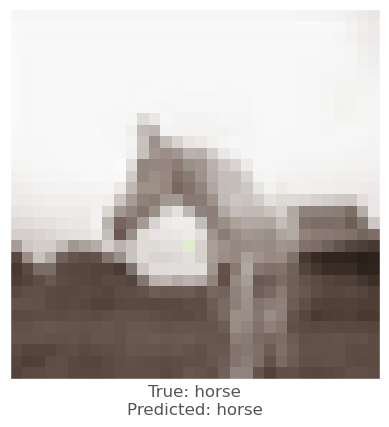



0.0007224679
-0.004599333
0.001977861
vr, vg, vb :   0.2280650151365688 3.889012939642719 -0.6169534240551799
beam_perturbed_confidence temp :  0.64680165
beam_perturbed_confidence temp :  0.64680165
beam_perturbed_confidence temp :  0.6458076
beam_perturbed_confidence temp :  0.64680165
beam_perturbed_confidence temp :  0.6458076
beam_perturbed_confidence temp :  0.6458076
beam_perturbed_confidence temp :  0.6458076
row index :  2
15th round's confidence : 2th 0.6458076
predicted class :  horse
predicted class's confidence :  0.6458076
Lopt is :  24


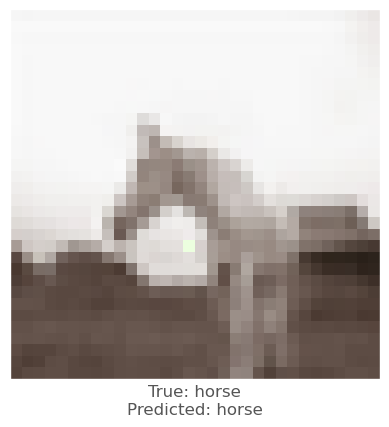



0.00044828653
-0.0024994612
0.00056892633
vr, vg, vb :   -0.38120610322924436 1.6179686545214422 -0.5334055773377582
beam_perturbed_confidence temp :  0.649994
beam_perturbed_confidence temp :  0.64902
beam_perturbed_confidence temp :  0.6496857
beam_perturbed_confidence temp :  0.64830524
beam_perturbed_confidence temp :  0.6495573
beam_perturbed_confidence temp :  0.6480956
beam_perturbed_confidence temp :  0.6482449
row index :  5
15th round's confidence : 3th 0.6480956
predicted class :  horse
predicted class's confidence :  0.6480956
Lopt is :  16


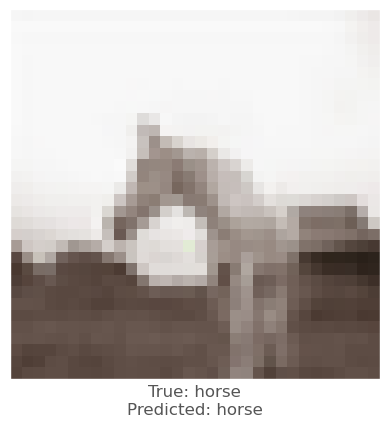



-0.0006188154
-0.0051698685
0.0010907054
vr, vg, vb :   -0.03571151740144379 3.9418088926562582 -1.1837067116986588
beam_perturbed_confidence temp :  0.6447404
beam_perturbed_confidence temp :  0.6443578
beam_perturbed_confidence temp :  0.64345855
beam_perturbed_confidence temp :  0.6447404
beam_perturbed_confidence temp :  0.6441334
beam_perturbed_confidence temp :  0.64345855
beam_perturbed_confidence temp :  0.6441334
row index :  2
15th round's confidence : 4th 0.64345855
predicted class :  horse
predicted class's confidence :  0.64345855
Lopt is :  24


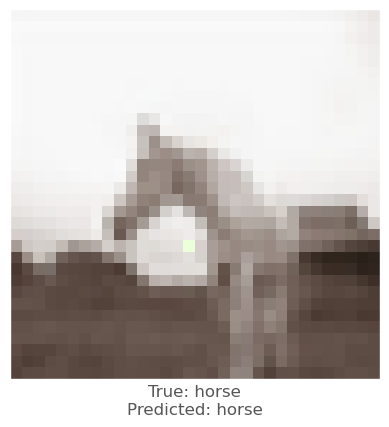



-0.00073462725
-0.00040638447
0.0032114983
vr, vg, vb :   0.37335478060963295 1.2418366410873298 -1.53634994493786
beam_perturbed_confidence temp :  0.6451945
beam_perturbed_confidence temp :  0.64547145
beam_perturbed_confidence temp :  0.64195746
beam_perturbed_confidence temp :  0.64547145
beam_perturbed_confidence temp :  0.64195746
beam_perturbed_confidence temp :  0.6414724
beam_perturbed_confidence temp :  0.6414724
row index :  5
16th round's confidence : 0th 0.6414724
predicted class :  horse
predicted class's confidence :  0.6414724
Lopt is :  24


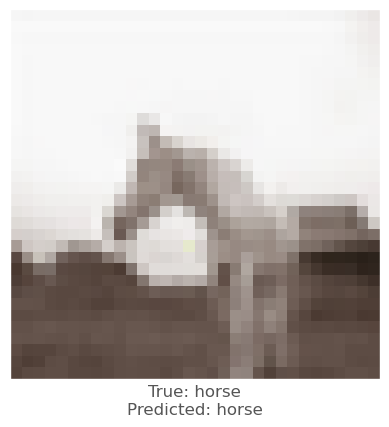



0.00016576052
-0.002754867
0.0034301877
vr, vg, vb :   -0.3741389320482153 1.7587447952939044 -1.7165042459367736
beam_perturbed_confidence temp :  0.63197714
beam_perturbed_confidence temp :  0.6313666
beam_perturbed_confidence temp :  0.6292764
beam_perturbed_confidence temp :  0.6306036
beam_perturbed_confidence temp :  0.63103586
beam_perturbed_confidence temp :  0.62740093
beam_perturbed_confidence temp :  0.6275268
row index :  5
16th round's confidence : 1th 0.62740093
predicted class :  horse
predicted class's confidence :  0.62740093
Lopt is :  26


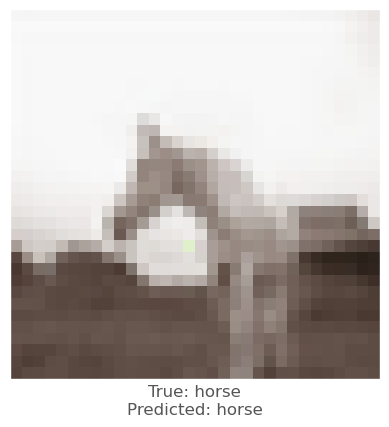



0.0006198883
-0.004757583
0.0018774271
vr, vg, vb :   0.14326968305650567 3.9758699598111376 -0.7430007917631873
beam_perturbed_confidence temp :  0.6458076
beam_perturbed_confidence temp :  0.6458076
beam_perturbed_confidence temp :  0.6449242
beam_perturbed_confidence temp :  0.6458076
beam_perturbed_confidence temp :  0.6449242
beam_perturbed_confidence temp :  0.6449242
beam_perturbed_confidence temp :  0.6449242
row index :  2
16th round's confidence : 2th 0.6449242
predicted class :  horse
predicted class's confidence :  0.6449242
Lopt is :  24


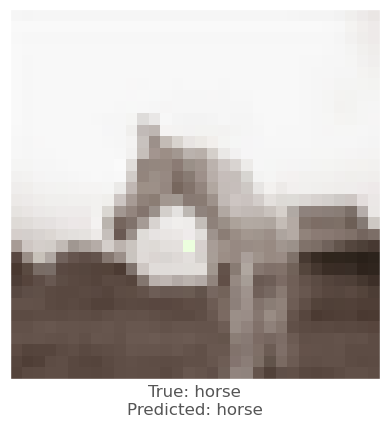



0.0010383129
-0.0017116666
0.001290679
vr, vg, vb :   -0.4469167841050504 1.6273384474707873 -0.6091329174006133
beam_perturbed_confidence temp :  0.6482449
beam_perturbed_confidence temp :  0.647974
beam_perturbed_confidence temp :  0.64772934
beam_perturbed_confidence temp :  0.64698327
beam_perturbed_confidence temp :  0.64722955
beam_perturbed_confidence temp :  0.6466349
beam_perturbed_confidence temp :  0.6462227
row index :  6
16th round's confidence : 3th 0.6462227
predicted class :  horse
predicted class's confidence :  0.6462227
Lopt is :  17


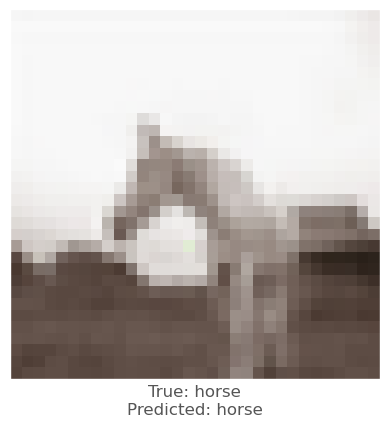



-0.0012346506
-0.00527668
0.00076282024
vr, vg, vb :   0.09132469552644473 4.075296002658211 -1.141618064912338
beam_perturbed_confidence temp :  0.64345855
beam_perturbed_confidence temp :  0.64345855
beam_perturbed_confidence temp :  0.6433046
beam_perturbed_confidence temp :  0.64345855
beam_perturbed_confidence temp :  0.6433046
beam_perturbed_confidence temp :  0.6433046
beam_perturbed_confidence temp :  0.6433046
row index :  2
16th round's confidence : 4th 0.6433046
predicted class :  horse
predicted class's confidence :  0.6433046
Lopt is :  24


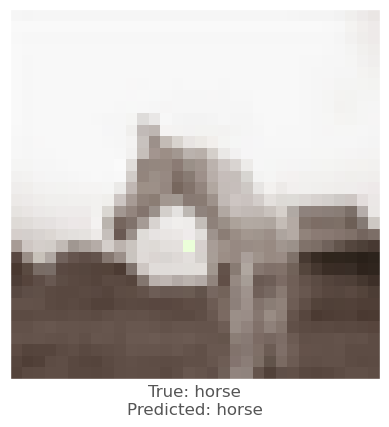



-0.0009045005
-6.318092e-05
0.003874004
vr, vg, vb :   0.42646935099532496 1.1239710693247882 -1.7701153391617253
beam_perturbed_confidence temp :  0.6414724
beam_perturbed_confidence temp :  0.6418943
beam_perturbed_confidence temp :  0.63786525
beam_perturbed_confidence temp :  0.6418943
beam_perturbed_confidence temp :  0.63786525
beam_perturbed_confidence temp :  0.637331
beam_perturbed_confidence temp :  0.637331
row index :  5
17th round's confidence : 0th 0.637331
predicted class :  horse
predicted class's confidence :  0.637331
Lopt is :  26


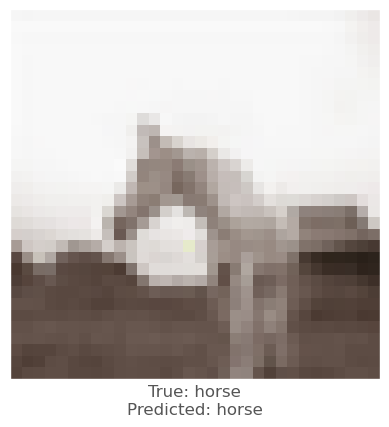



0.00068581104
-0.00218606
0.0034313798
vr, vg, vb :   -0.40530614312195823 1.8014763109427365 -1.8879918008505425
beam_perturbed_confidence temp :  0.6275268
beam_perturbed_confidence temp :  0.62709033
beam_perturbed_confidence temp :  0.6245744
beam_perturbed_confidence temp :  0.62654114
beam_perturbed_confidence temp :  0.6258247
beam_perturbed_confidence temp :  0.62365395
beam_perturbed_confidence temp :  0.6230617
row index :  6
17th round's confidence : 1th 0.6230617
predicted class :  horse
predicted class's confidence :  0.6230617
Lopt is :  28


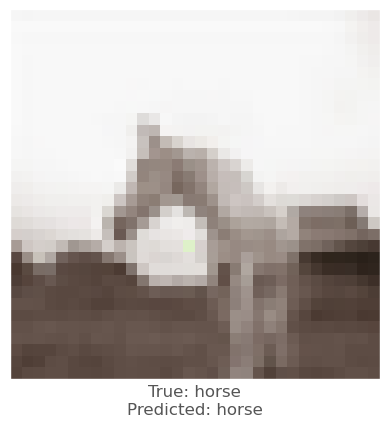



0.00048440695
-0.0047715902
0.0016860366
vr, vg, vb :   0.08050201994189515 4.055441987114936 -0.837304371263016
beam_perturbed_confidence temp :  0.6449242
beam_perturbed_confidence temp :  0.6449242
beam_perturbed_confidence temp :  0.6441216
beam_perturbed_confidence temp :  0.6449242
beam_perturbed_confidence temp :  0.6441216
beam_perturbed_confidence temp :  0.6441216
beam_perturbed_confidence temp :  0.6441216
row index :  2
17th round's confidence : 2th 0.6441216
predicted class :  horse
predicted class's confidence :  0.6441216
Lopt is :  24


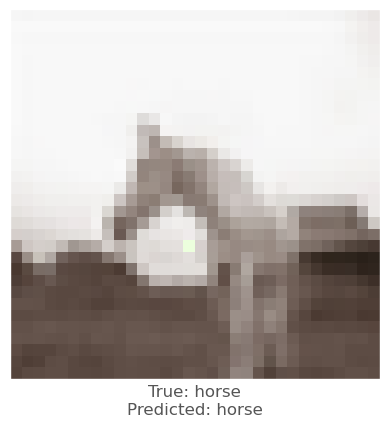



0.0004555583
-0.0012986064
0.002028346
vr, vg, vb :   -0.44778093569637645 1.594465242295852 -0.7510542318312062
beam_perturbed_confidence temp :  0.6461793
beam_perturbed_confidence temp :  0.64593095
beam_perturbed_confidence temp :  0.6449549
beam_perturbed_confidence temp :  0.6456856
beam_perturbed_confidence temp :  0.64447445
beam_perturbed_confidence temp :  0.6442228
beam_perturbed_confidence temp :  0.6443173
row index :  5
17th round's confidence : 3th 0.6442228
predicted class :  horse
predicted class's confidence :  0.6442228
Lopt is :  18


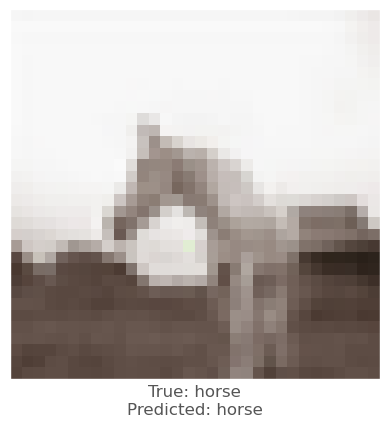



-0.0023213625
-0.005856037
-0.0005868077
vr, vg, vb :   0.3143284755160366 4.253370116381648 -0.9687754856397321
beam_perturbed_confidence temp :  0.6433046
beam_perturbed_confidence temp :  0.6433046
beam_perturbed_confidence temp :  0.6436447
beam_perturbed_confidence temp :  0.6433046
beam_perturbed_confidence temp :  0.6436447
beam_perturbed_confidence temp :  0.6436447
beam_perturbed_confidence temp :  0.6436447
row index :  0
17th round's confidence : 4th 0.6433046
predicted class :  horse
predicted class's confidence :  0.6433046
Lopt is :  24


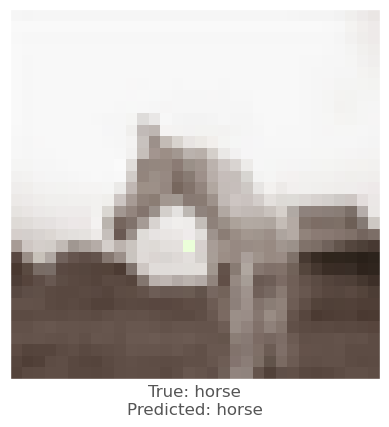



-0.00044107437
-0.000344038
0.004180312
vr, vg, vb :   0.42792985302958153 1.045977763356665 -2.0111350209132777
beam_perturbed_confidence temp :  0.637331
beam_perturbed_confidence temp :  0.6375212
beam_perturbed_confidence temp :  0.6331361
beam_perturbed_confidence temp :  0.6375212
beam_perturbed_confidence temp :  0.6331361
beam_perturbed_confidence temp :  0.6317251
beam_perturbed_confidence temp :  0.6317251
row index :  5
18th round's confidence : 0th 0.6317251
predicted class :  horse
predicted class's confidence :  0.6317251
Lopt is :  29


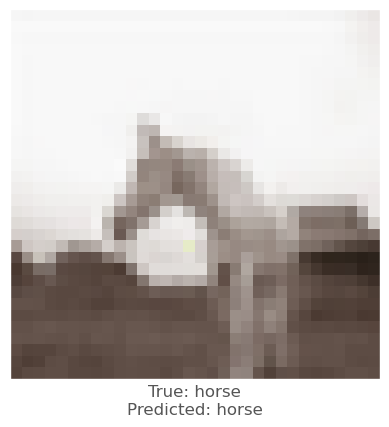



0.00057017803
-0.0036403537
0.00302732
vr, vg, vb :   -0.4217933320019011 1.9853640478141612 -2.0019246115796974
beam_perturbed_confidence temp :  0.6230838
beam_perturbed_confidence temp :  0.62218434
beam_perturbed_confidence temp :  0.61937314
beam_perturbed_confidence temp :  0.62126213
beam_perturbed_confidence temp :  0.62091386
beam_perturbed_confidence temp :  0.6160325
beam_perturbed_confidence temp :  0.61631596
row index :  5
18th round's confidence : 1th 0.6160325
predicted class :  horse
predicted class's confidence :  0.6160325
Lopt is :  31


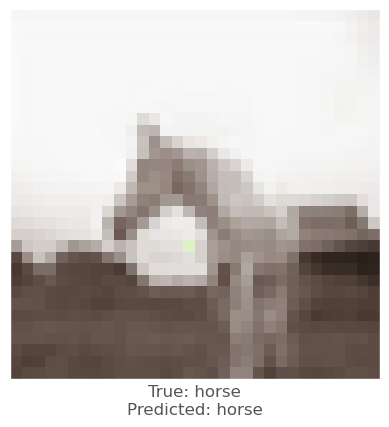



0.0001822114
-0.0048778057
0.0015452504
vr, vg, vb :   0.054230678039868724 4.137678359387329 -0.9080989757169147
beam_perturbed_confidence temp :  0.6441216
beam_perturbed_confidence temp :  0.6441216
beam_perturbed_confidence temp :  0.643379
beam_perturbed_confidence temp :  0.6441216
beam_perturbed_confidence temp :  0.643379
beam_perturbed_confidence temp :  0.643379
beam_perturbed_confidence temp :  0.643379
row index :  2
18th round's confidence : 2th 0.643379
predicted class :  horse
predicted class's confidence :  0.643379
Lopt is :  24


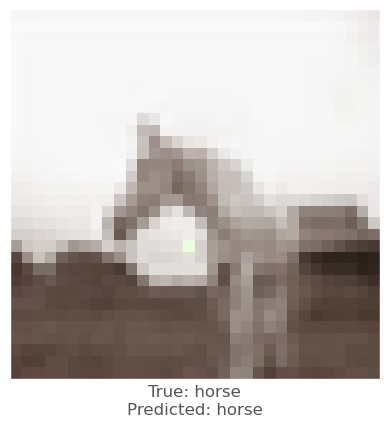



0.0013079643
9.655952e-06
0.0030972362
vr, vg, vb :   -0.5337992746218561 1.4340531228209055 -0.9856724242944479
beam_perturbed_confidence temp :  0.6443173
beam_perturbed_confidence temp :  0.6449646
beam_perturbed_confidence temp :  0.6428337
beam_perturbed_confidence temp :  0.64431125
beam_perturbed_confidence temp :  0.6424367
beam_perturbed_confidence temp :  0.6429603
beam_perturbed_confidence temp :  0.642265
row index :  6
18th round's confidence : 3th 0.642265
predicted class :  horse
predicted class's confidence :  0.642265
Lopt is :  19


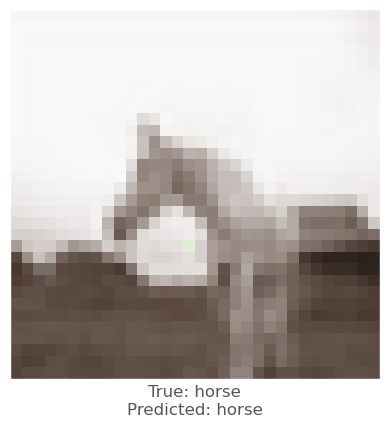



-0.0023213625
-0.005856037
-0.0005868077
vr, vg, vb :   0.5150318775066693 4.413636818732741 -0.8132171642943868
beam_perturbed_confidence temp :  0.6433046
beam_perturbed_confidence temp :  0.6433046
beam_perturbed_confidence temp :  0.6436447
beam_perturbed_confidence temp :  0.6433046
beam_perturbed_confidence temp :  0.6436447
beam_perturbed_confidence temp :  0.6436447
beam_perturbed_confidence temp :  0.6436447
row index :  0
18th round's confidence : 4th 0.6433046
predicted class :  horse
predicted class's confidence :  0.6433046
Lopt is :  24


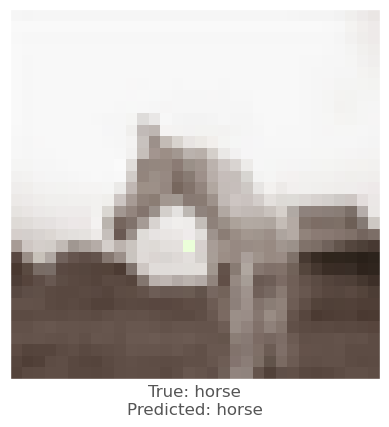



0.00079858303
-0.001333952
0.0036039352
vr, vg, vb :   0.305278564656555 1.0747751820283227 -2.1704150429918716
beam_perturbed_confidence temp :  0.6317251
beam_perturbed_confidence temp :  0.63180214
beam_perturbed_confidence temp :  0.6291465
beam_perturbed_confidence temp :  0.63180214
beam_perturbed_confidence temp :  0.6291465
beam_perturbed_confidence temp :  0.6261998
beam_perturbed_confidence temp :  0.6261998
row index :  5
19th round's confidence : 0th 0.6261998
predicted class :  horse
predicted class's confidence :  0.6261998
Lopt is :  32


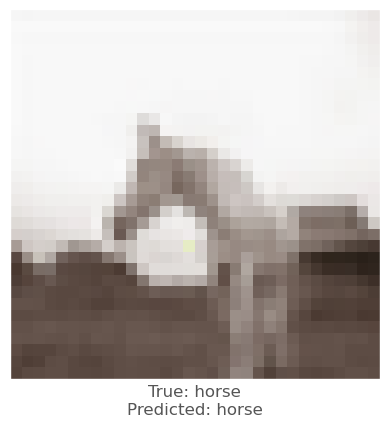



0.001144588
-0.00524348
0.0037736297
vr, vg, vb :   -0.4940727981638936 2.311175663586334 -2.1790951169592034
beam_perturbed_confidence temp :  0.61631596
beam_perturbed_confidence temp :  0.61292154
beam_perturbed_confidence temp :  0.6123866
beam_perturbed_confidence temp :  0.61180824
beam_perturbed_confidence temp :  0.61371446
beam_perturbed_confidence temp :  0.6062099
beam_perturbed_confidence temp :  0.6035503
row index :  6
19th round's confidence : 1th 0.6035503
predicted class :  horse
predicted class's confidence :  0.6035503
Lopt is :  34


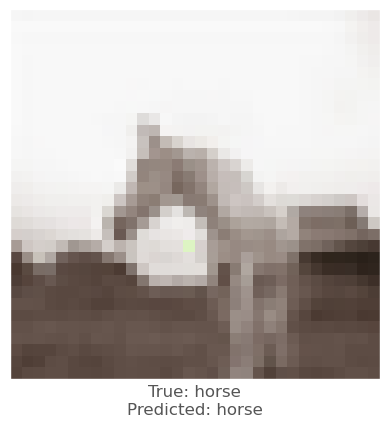



-0.00022035837
-0.005051911
0.0012228489
vr, vg, vb :   0.07084344740934376 4.229101611171375 -0.9395739673664146
beam_perturbed_confidence temp :  0.643379
beam_perturbed_confidence temp :  0.643379
beam_perturbed_confidence temp :  0.64289874
beam_perturbed_confidence temp :  0.643379
beam_perturbed_confidence temp :  0.64289874
beam_perturbed_confidence temp :  0.64289874
beam_perturbed_confidence temp :  0.64289874
row index :  2
19th round's confidence : 2th 0.64289874
predicted class :  horse
predicted class's confidence :  0.64289874
Lopt is :  24


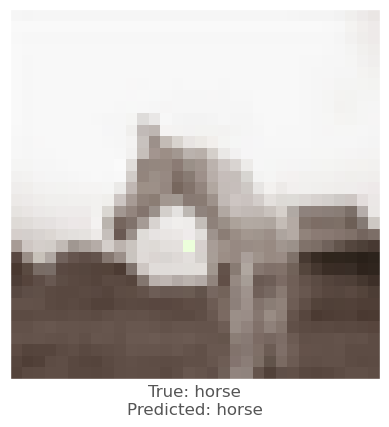



0.0011307001
0.0005249977
0.003994286
vr, vg, vb :   -0.5934893582985865 1.238148039420651 -1.2865337878983283
beam_perturbed_confidence temp :  0.6418296
beam_perturbed_confidence temp :  0.6429617
beam_perturbed_confidence temp :  0.6383496
beam_perturbed_confidence temp :  0.6422969
beam_perturbed_confidence temp :  0.63781285
beam_perturbed_confidence temp :  0.63833123
beam_perturbed_confidence temp :  0.63792694
row index :  4
19th round's confidence : 3th 0.63781285
predicted class :  horse
predicted class's confidence :  0.63781285
Lopt is :  21


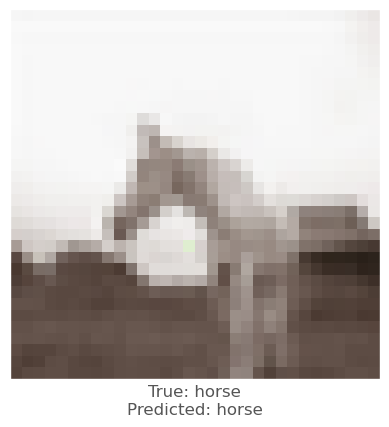



-0.0023213625
-0.005856037
-0.0005868077
vr, vg, vb :   0.6956649392982388 4.557876850848725 -0.6732146750835761
beam_perturbed_confidence temp :  0.6433046
beam_perturbed_confidence temp :  0.6433046
beam_perturbed_confidence temp :  0.6436447
beam_perturbed_confidence temp :  0.6433046
beam_perturbed_confidence temp :  0.6436447
beam_perturbed_confidence temp :  0.6436447
beam_perturbed_confidence temp :  0.6436447
row index :  0
19th round's confidence : 4th 0.6433046
predicted class :  horse
predicted class's confidence :  0.6433046
Lopt is :  24


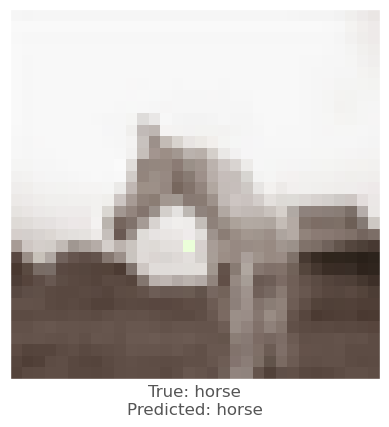



0.001134932
-0.0024386644
0.0027809143
vr, vg, vb :   0.16125750407407824 1.2111641074595236 -2.2314649693567468
beam_perturbed_confidence temp :  0.6261998
beam_perturbed_confidence temp :  0.62670785
beam_perturbed_confidence temp :  0.62389994
beam_perturbed_confidence temp :  0.62670785
beam_perturbed_confidence temp :  0.62389994
beam_perturbed_confidence temp :  0.6208255
beam_perturbed_confidence temp :  0.6208255
row index :  5
20th round's confidence : 0th 0.6208255
predicted class :  horse
predicted class's confidence :  0.6208255
Lopt is :  35


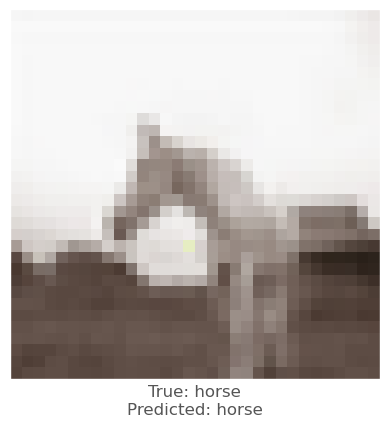



0.0033192635
-0.0045063496
0.0053139925
vr, vg, vb :   -0.7765918641726995 2.530693053587564 -2.492584855293801
beam_perturbed_confidence temp :  0.6028906
beam_perturbed_confidence temp :  0.60232645
beam_perturbed_confidence temp :  0.5979776
beam_perturbed_confidence temp :  0.60050535
beam_perturbed_confidence temp :  0.59821486
beam_perturbed_confidence temp :  0.59418786
beam_perturbed_confidence temp :  0.5901967
row index :  6
20th round's confidence : 1th 0.5901967
predicted class :  horse
predicted class's confidence :  0.5901967
Lopt is :  37


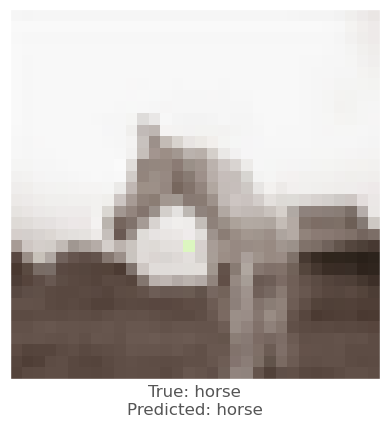



-0.00083082914
-0.004944384
0.0008058548
vr, vg, vb :   0.1468420170208264 4.300629859859535 -0.9262020503661013
beam_perturbed_confidence temp :  0.64289874
beam_perturbed_confidence temp :  0.64289874
beam_perturbed_confidence temp :  0.6425731
beam_perturbed_confidence temp :  0.64289874
beam_perturbed_confidence temp :  0.6425731
beam_perturbed_confidence temp :  0.6425731
beam_perturbed_confidence temp :  0.6425731
row index :  2
20th round's confidence : 2th 0.6425731
predicted class :  horse
predicted class's confidence :  0.6425731
Lopt is :  24


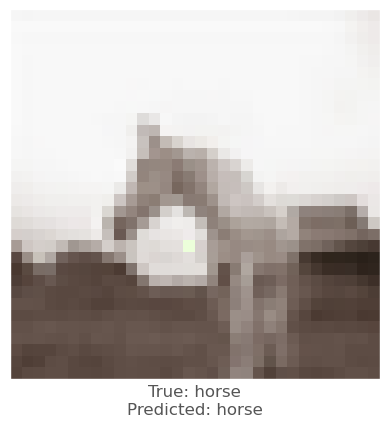



0.0011501312
-0.0014390945
0.004106045
vr, vg, vb :   -0.6491535450273216 1.258242689824289 -1.5684848860372065
beam_perturbed_confidence temp :  0.63719946
beam_perturbed_confidence temp :  0.63792694
beam_perturbed_confidence temp :  0.63451934
beam_perturbed_confidence temp :  0.6364214
beam_perturbed_confidence temp :  0.63556355
beam_perturbed_confidence temp :  0.63334346
beam_perturbed_confidence temp :  0.632929
row index :  6
20th round's confidence : 3th 0.632929
predicted class :  horse
predicted class's confidence :  0.632929
Lopt is :  23


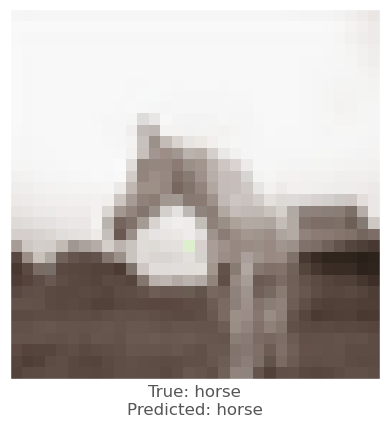



-0.0023213625
-0.005856037
-0.0005868077
vr, vg, vb :   0.8582346949106513 4.6876928797531106 -0.5472124347938465
beam_perturbed_confidence temp :  0.6433046
beam_perturbed_confidence temp :  0.6433046
beam_perturbed_confidence temp :  0.6436447
beam_perturbed_confidence temp :  0.6433046
beam_perturbed_confidence temp :  0.6436447
beam_perturbed_confidence temp :  0.6436447
beam_perturbed_confidence temp :  0.6436447
row index :  0
20th round's confidence : 4th 0.6433046
predicted class :  horse
predicted class's confidence :  0.6433046
Lopt is :  24


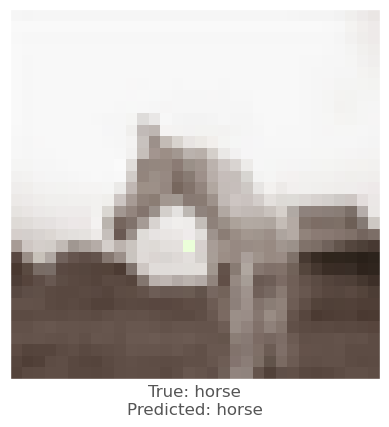



0.0017653704
-0.0033127666
0.0031134486
vr, vg, vb :   -0.03140528322908154 1.4213243519107148 -2.319663334405325
beam_perturbed_confidence temp :  0.62073565
beam_perturbed_confidence temp :  0.62058717
beam_perturbed_confidence temp :  0.61892515
beam_perturbed_confidence temp :  0.61805815
beam_perturbed_confidence temp :  0.62112516
beam_perturbed_confidence temp :  0.6146465
beam_perturbed_confidence temp :  0.61561567
row index :  5
21th round's confidence : 0th 0.6146465
predicted class :  horse
predicted class's confidence :  0.6146465
Lopt is :  38


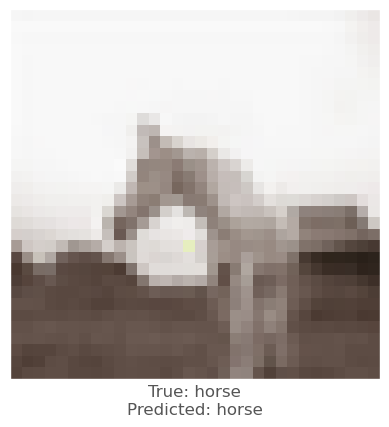



0.0045683384
-0.002911687
0.005561948
vr, vg, vb :   -1.1557665171719336 2.5687924379565907 -2.799521152021501
beam_perturbed_confidence temp :  0.5894682
beam_perturbed_confidence temp :  0.59077024
beam_perturbed_confidence temp :  0.58497
beam_perturbed_confidence temp :  0.584253
beam_perturbed_confidence temp :  0.586368
beam_perturbed_confidence temp :  0.5803854
beam_perturbed_confidence temp :  0.5766466
row index :  6
21th round's confidence : 1th 0.5766466
predicted class :  horse
predicted class's confidence :  0.5766466
Lopt is :  40


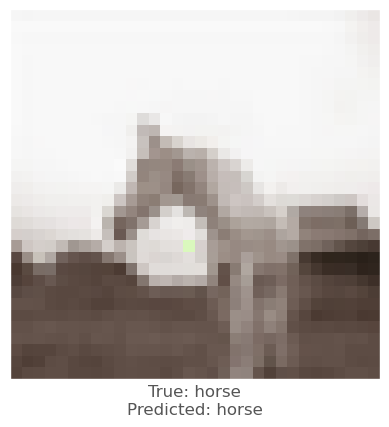



-0.001047194
-0.005002916
0.0006995201
vr, vg, vb :   0.23687721572462755 4.370858459795823 -0.9035338564378896
beam_perturbed_confidence temp :  0.6425731
beam_perturbed_confidence temp :  0.6425731
beam_perturbed_confidence temp :  0.6421992
beam_perturbed_confidence temp :  0.6425731
beam_perturbed_confidence temp :  0.6421992
beam_perturbed_confidence temp :  0.6421992
beam_perturbed_confidence temp :  0.6421992
row index :  2
21th round's confidence : 2th 0.6421992
predicted class :  horse
predicted class's confidence :  0.6421992
Lopt is :  24


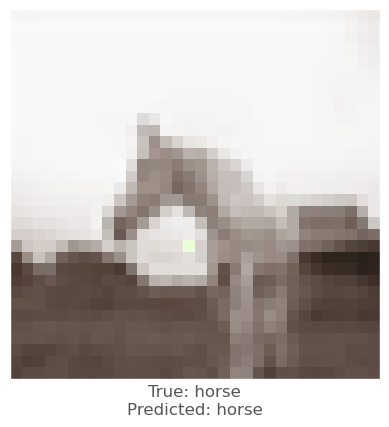



0.00038349628
-0.0028468966
0.0025991201
vr, vg, vb :   -0.6225878189730758 1.4171080856825584 -1.6715484114410541
beam_perturbed_confidence temp :  0.63295996
beam_perturbed_confidence temp :  0.63271666
beam_perturbed_confidence temp :  0.6313435
beam_perturbed_confidence temp :  0.63084453
beam_perturbed_confidence temp :  0.63235605
beam_perturbed_confidence temp :  0.62887794
beam_perturbed_confidence temp :  0.6286561
row index :  6
21th round's confidence : 3th 0.6286561
predicted class :  horse
predicted class's confidence :  0.6286561
Lopt is :  25


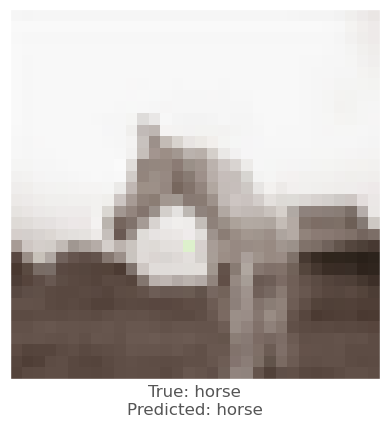



-0.0023213625
-0.005856037
-0.0005868077
vr, vg, vb :   1.0045474749618224 4.804527305767057 -0.4338104185330898
beam_perturbed_confidence temp :  0.6421992
beam_perturbed_confidence temp :  0.6433046
beam_perturbed_confidence temp :  0.6436447
beam_perturbed_confidence temp :  0.6421992
beam_perturbed_confidence temp :  0.6422084
beam_perturbed_confidence temp :  0.6436447
beam_perturbed_confidence temp :  0.6422084
row index :  0
21th round's confidence : 4th 0.6421992
predicted class :  horse
predicted class's confidence :  0.6421992
Lopt is :  24


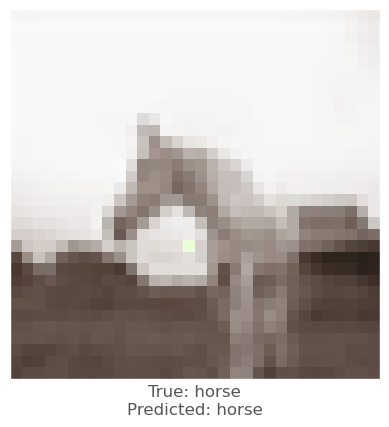



-0.00014203787
-0.0047204494
0.0022470355
vr, vg, vb :   -0.0140609680561978 1.7512368614828269 -2.3124005513035377
beam_perturbed_confidence temp :  0.61561567
beam_perturbed_confidence temp :  0.6142047
beam_perturbed_confidence temp :  0.6140379
beam_perturbed_confidence temp :  0.61225575
beam_perturbed_confidence temp :  0.6162062
beam_perturbed_confidence temp :  0.6098555
beam_perturbed_confidence temp :  0.61078554
row index :  5
22th round's confidence : 0th 0.6098555
predicted class :  horse
predicted class's confidence :  0.6098555
Lopt is :  41


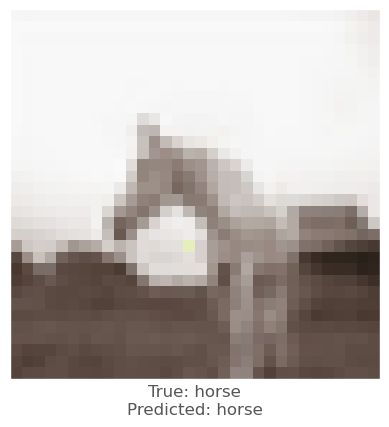



0.0008571148
-0.007463157
0.0029850006
vr, vg, vb :   -1.125901344641752 3.0582289118580754 -2.818069097854507
beam_perturbed_confidence temp :  0.5758992
beam_perturbed_confidence temp :  0.57450145
beam_perturbed_confidence temp :  0.5732281
beam_perturbed_confidence temp :  0.56743556
beam_perturbed_confidence temp :  0.5728886
beam_perturbed_confidence temp :  0.5637295
beam_perturbed_confidence temp :  0.5595881
row index :  6
22th round's confidence : 1th 0.5595881
predicted class :  horse
predicted class's confidence :  0.5595881
Lopt is :  43


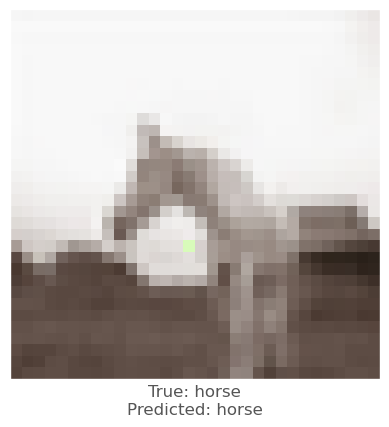



-0.0019177198
-0.0054970384
0.00036472082
vr, vg, vb :   0.4049614782525066 4.483476450257281 -0.8496525529321622
beam_perturbed_confidence temp :  0.6421992
beam_perturbed_confidence temp :  0.6421992
beam_perturbed_confidence temp :  0.6422084
beam_perturbed_confidence temp :  0.6421992
beam_perturbed_confidence temp :  0.6422084
beam_perturbed_confidence temp :  0.6422084
beam_perturbed_confidence temp :  0.6422084
row index :  0
22th round's confidence : 2th 0.6421992
predicted class :  horse
predicted class's confidence :  0.6421992
Lopt is :  24


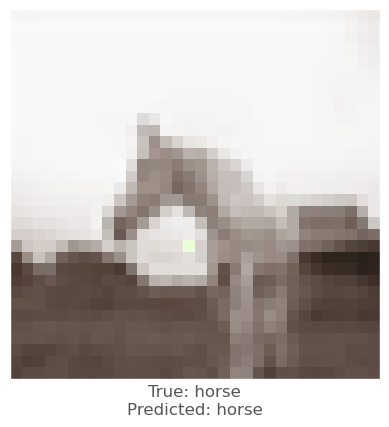



-0.0002297163
-0.005187273
0.0017821193
vr, vg, vb :   -0.5373574069793327 1.794124579665572 -1.6826054977108893
beam_perturbed_confidence temp :  0.62910765
beam_perturbed_confidence temp :  0.6271688
beam_perturbed_confidence temp :  0.6275581
beam_perturbed_confidence temp :  0.6263828
beam_perturbed_confidence temp :  0.627571
beam_perturbed_confidence temp :  0.62462884
beam_perturbed_confidence temp :  0.623982
row index :  6
22th round's confidence : 3th 0.623982
predicted class :  horse
predicted class's confidence :  0.623982
Lopt is :  27


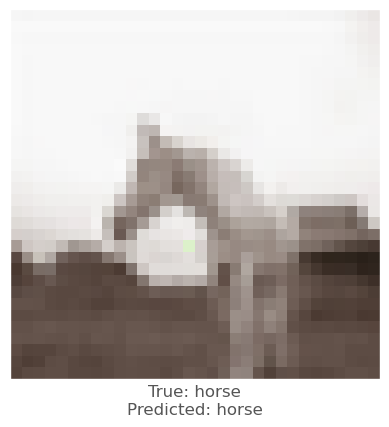



-0.0019177198
-0.0054970384
0.00036472082
vr, vg, vb :   1.0958647115659819 4.873778411631392 -0.42690145881784236
beam_perturbed_confidence temp :  0.64138687
beam_perturbed_confidence temp :  0.6421992
beam_perturbed_confidence temp :  0.6422084
beam_perturbed_confidence temp :  0.64138687
beam_perturbed_confidence temp :  0.6411772
beam_perturbed_confidence temp :  0.6422084
beam_perturbed_confidence temp :  0.6411772
row index :  4
22th round's confidence : 4th 0.6411772
predicted class :  horse
predicted class's confidence :  0.6411772
Lopt is :  24


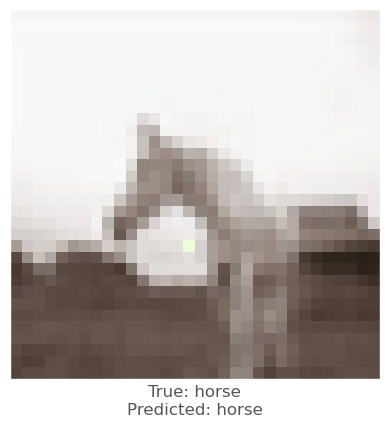



-0.0012230873
-0.00639838
0.00066435337
vr, vg, vb :   0.10965385982852355 2.2159511556049303 -2.1475958332398344
beam_perturbed_confidence temp :  0.6098555
beam_perturbed_confidence temp :  0.6087737
beam_perturbed_confidence temp :  0.60889655
beam_perturbed_confidence temp :  0.6087737
beam_perturbed_confidence temp :  0.60889655
beam_perturbed_confidence temp :  0.6015673
beam_perturbed_confidence temp :  0.6015673
row index :  5
23th round's confidence : 0th 0.6015673
predicted class :  horse
predicted class's confidence :  0.6015673
Lopt is :  44


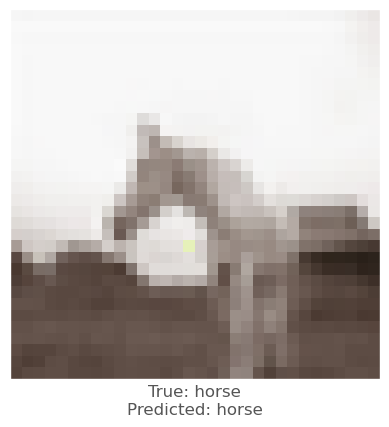



0.002807498
-0.0063967705
0.0037999153
vr, vg, vb :   -1.294061007998622 3.39208306840176 -2.916253719441127
beam_perturbed_confidence temp :  0.55707765
beam_perturbed_confidence temp :  0.5561549
beam_perturbed_confidence temp :  0.55439144
beam_perturbed_confidence temp :  0.5493027
beam_perturbed_confidence temp :  0.5539046
beam_perturbed_confidence temp :  0.5464936
beam_perturbed_confidence temp :  0.5413716
row index :  6
23th round's confidence : 1th 0.5413716
predicted class :  horse
predicted class's confidence :  0.5413716
Lopt is :  46


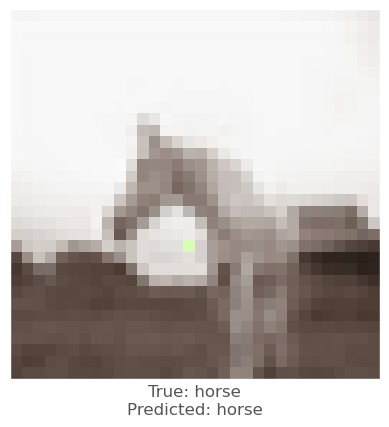



-0.0019177198
-0.0054970384
0.00036472082
vr, vg, vb :   0.5562373145275978 4.584832641672593 -0.8011593797770076
beam_perturbed_confidence temp :  0.6421992
beam_perturbed_confidence temp :  0.6421992
beam_perturbed_confidence temp :  0.6422084
beam_perturbed_confidence temp :  0.6421992
beam_perturbed_confidence temp :  0.6422084
beam_perturbed_confidence temp :  0.6422084
beam_perturbed_confidence temp :  0.6422084
row index :  0
23th round's confidence : 2th 0.6421992
predicted class :  horse
predicted class's confidence :  0.6421992
Lopt is :  24


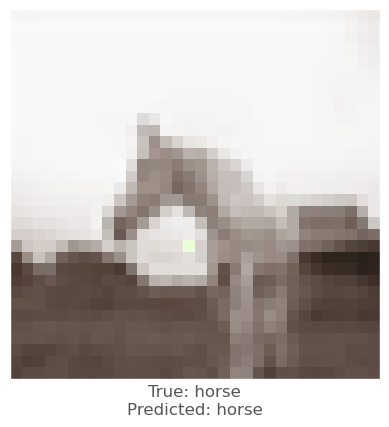



0.0006016493
-0.005691886
0.001868844
vr, vg, vb :   -0.5437865947176788 2.18390071651713 -1.7012293511685601
beam_perturbed_confidence temp :  0.6240272
beam_perturbed_confidence temp :  0.6205312
beam_perturbed_confidence temp :  0.62233233
beam_perturbed_confidence temp :  0.6192593
beam_perturbed_confidence temp :  0.6231522
beam_perturbed_confidence temp :  0.61675394
beam_perturbed_confidence temp :  0.6149628
row index :  6
23th round's confidence : 3th 0.6149628
predicted class :  horse
predicted class's confidence :  0.6149628
Lopt is :  29


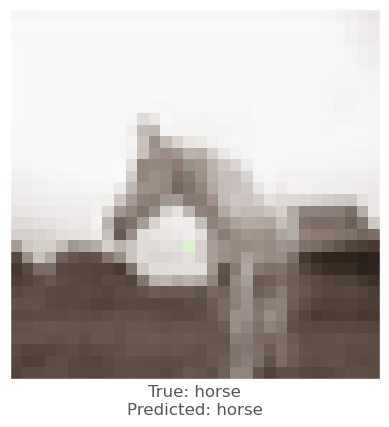



-0.0017486215
-0.005252719
0.00021117926
vr, vg, vb :   1.1611403867869472 4.911672463015861 -0.40532923857997905
beam_perturbed_confidence temp :  0.6404598
beam_perturbed_confidence temp :  0.6411772
beam_perturbed_confidence temp :  0.6411757
beam_perturbed_confidence temp :  0.6404598
beam_perturbed_confidence temp :  0.6401265
beam_perturbed_confidence temp :  0.6411757
beam_perturbed_confidence temp :  0.6401265
row index :  4
23th round's confidence : 4th 0.6401265
predicted class :  horse
predicted class's confidence :  0.6401265
Lopt is :  24


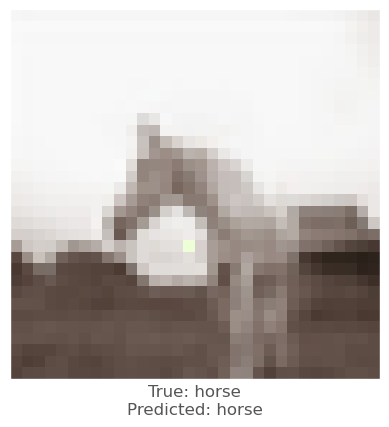



0.0012226701
-0.0037432313
0.0028873086
vr, vg, vb :   -0.02357853398208759 2.368679169698368 -2.2215671096723204
beam_perturbed_confidence temp :  0.60206306
beam_perturbed_confidence temp :  0.60216045
beam_perturbed_confidence temp :  0.59959066
beam_perturbed_confidence temp :  0.5990118
beam_perturbed_confidence temp :  0.6007342
beam_perturbed_confidence temp :  0.5929792
beam_perturbed_confidence temp :  0.59170943
row index :  6
24th round's confidence : 0th 0.59170943
predicted class :  horse
predicted class's confidence :  0.59170943
Lopt is :  47


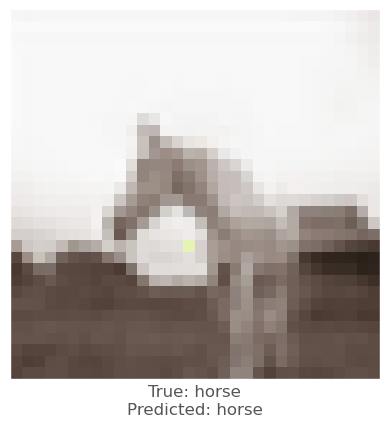



0.0036101341
-0.0054187775
0.0034954548
vr, vg, vb :   -1.5256683196743457 3.5947525081436154 -2.974173826317815
beam_perturbed_confidence temp :  0.53861403
beam_perturbed_confidence temp :  0.5390287
beam_perturbed_confidence temp :  0.5363751
beam_perturbed_confidence temp :  0.5349225
beam_perturbed_confidence temp :  0.53467345
beam_perturbed_confidence temp :  0.5323794
beam_perturbed_confidence temp :  0.529163
row index :  6
24th round's confidence : 1th 0.529163
predicted class :  horse
predicted class's confidence :  0.529163
Lopt is :  49


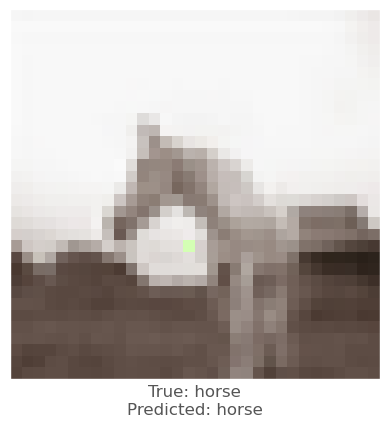



-0.0019177198
-0.0054970384
0.00036472082
vr, vg, vb :   0.6923855671751799 4.676053213946374 -0.7575155239373683
beam_perturbed_confidence temp :  0.6421992
beam_perturbed_confidence temp :  0.6421992
beam_perturbed_confidence temp :  0.6422084
beam_perturbed_confidence temp :  0.6421992
beam_perturbed_confidence temp :  0.6422084
beam_perturbed_confidence temp :  0.6422084
beam_perturbed_confidence temp :  0.6422084
row index :  0
24th round's confidence : 2th 0.6421992
predicted class :  horse
predicted class's confidence :  0.6421992
Lopt is :  24


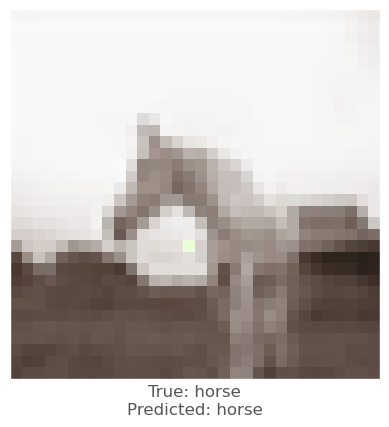



0.0017778873
-0.005432725
0.0036736727
vr, vg, vb :   -0.667196669681946 2.5087831401351925 -1.8984736836603466
beam_perturbed_confidence temp :  0.61497605
beam_perturbed_confidence temp :  0.61232
beam_perturbed_confidence temp :  0.61242837
beam_perturbed_confidence temp :  0.6105626
beam_perturbed_confidence temp :  0.61085236
beam_perturbed_confidence temp :  0.60706496
beam_perturbed_confidence temp :  0.6049595
row index :  6
24th round's confidence : 3th 0.6049595
predicted class :  horse
predicted class's confidence :  0.6049595
Lopt is :  31


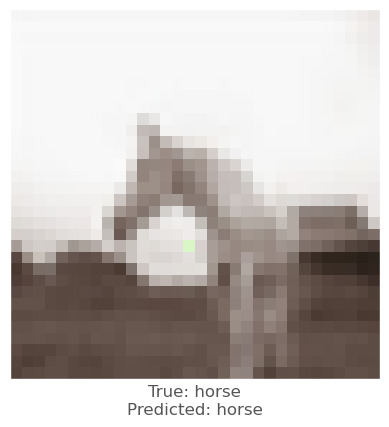



-0.0018045902
-0.005389154
0.0004966259
vr, vg, vb :   1.2254853706302251 4.959420612450969 -0.4144589047488366
beam_perturbed_confidence temp :  0.6393711
beam_perturbed_confidence temp :  0.6401265
beam_perturbed_confidence temp :  0.63996315
beam_perturbed_confidence temp :  0.6393711
beam_perturbed_confidence temp :  0.63904876
beam_perturbed_confidence temp :  0.63996315
beam_perturbed_confidence temp :  0.63904876
row index :  4
24th round's confidence : 4th 0.63904876
predicted class :  horse
predicted class's confidence :  0.63904876
Lopt is :  24


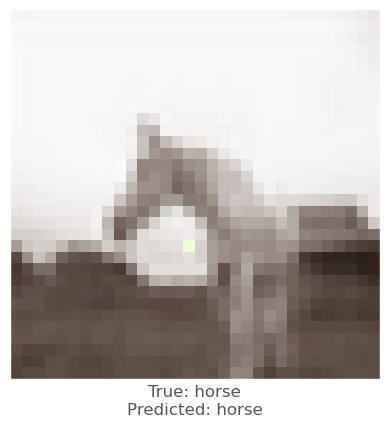



9.453297e-05
-0.006252706
0.0023975372
vr, vg, vb :   -0.030673977245255786 2.7570818578158116 -2.23916412184962
beam_perturbed_confidence temp :  0.59288466
beam_perturbed_confidence temp :  0.5905898
beam_perturbed_confidence temp :  0.5906722
beam_perturbed_confidence temp :  0.5874411
beam_perturbed_confidence temp :  0.5901926
beam_perturbed_confidence temp :  0.5820848
beam_perturbed_confidence temp :  0.58242226
row index :  5
25th round's confidence : 0th 0.5820848
predicted class :  horse
predicted class's confidence :  0.5820848
Lopt is :  50


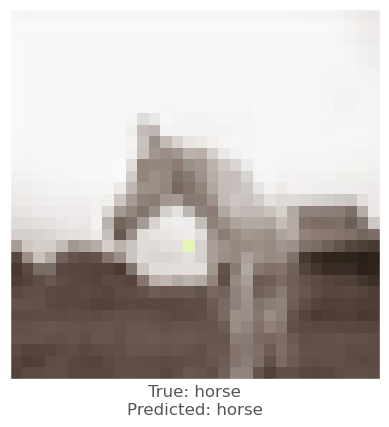



0.001891911
-0.0055104494
0.0037542582
vr, vg, vb :   -1.5622925906884786 3.78632219827774 -3.0521822592683088
beam_perturbed_confidence temp :  0.5300077
beam_perturbed_confidence temp :  0.529163
beam_perturbed_confidence temp :  0.52641124
beam_perturbed_confidence temp :  0.5300077
beam_perturbed_confidence temp :  0.5289648
beam_perturbed_confidence temp :  0.52641124
beam_perturbed_confidence temp :  0.5289648
row index :  2
25th round's confidence : 1th 0.52641124
predicted class :  horse
predicted class's confidence :  0.52641124
Lopt is :  53


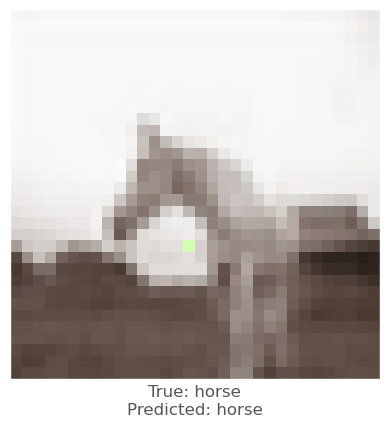



-0.0019177198
-0.0054970384
0.00036472082
vr, vg, vb :   0.8149189945580037 4.758151728992777 -0.7182360536816931
beam_perturbed_confidence temp :  0.6421992
beam_perturbed_confidence temp :  0.6421992
beam_perturbed_confidence temp :  0.6422084
beam_perturbed_confidence temp :  0.6421992
beam_perturbed_confidence temp :  0.6422084
beam_perturbed_confidence temp :  0.6422084
beam_perturbed_confidence temp :  0.6422084
row index :  0
25th round's confidence : 2th 0.6421992
predicted class :  horse
predicted class's confidence :  0.6421992
Lopt is :  24


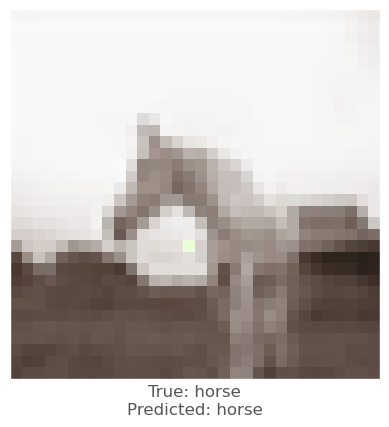



0.0034775734
-0.0030286312
0.0059244633
vr, vg, vb :   -0.9482343421912905 2.560767947154388 -2.301072642503785
beam_perturbed_confidence temp :  0.6035874
beam_perturbed_confidence temp :  0.60424346
beam_perturbed_confidence temp :  0.5980346
beam_perturbed_confidence temp :  0.6014173
beam_perturbed_confidence temp :  0.5977656
beam_perturbed_confidence temp :  0.59453285
beam_perturbed_confidence temp :  0.59214467
row index :  6
25th round's confidence : 3th 0.59214467
predicted class :  horse
predicted class's confidence :  0.59214467
Lopt is :  34


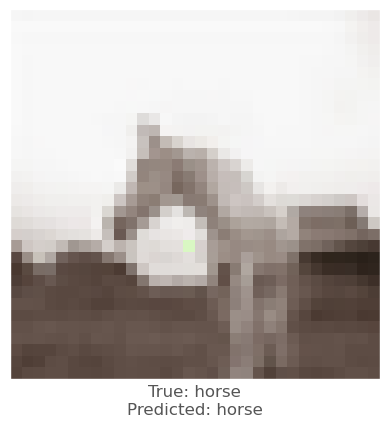



-0.0013968349
-0.0053186417
0.00051921606
vr, vg, vb :   1.2426203185983307 4.995342717465638 -0.4249346203377957
beam_perturbed_confidence temp :  0.6385663
beam_perturbed_confidence temp :  0.63904876
beam_perturbed_confidence temp :  0.6388519
beam_perturbed_confidence temp :  0.6385663
beam_perturbed_confidence temp :  0.63823944
beam_perturbed_confidence temp :  0.6388519
beam_perturbed_confidence temp :  0.63823944
row index :  4
25th round's confidence : 4th 0.63823944
predicted class :  horse
predicted class's confidence :  0.63823944
Lopt is :  24


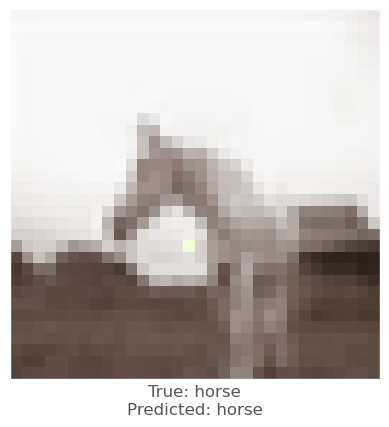



0.0022727847
-0.0035099387
0.0039234757
vr, vg, vb :   -0.2548850505137722 2.8323675437230733 -2.407595283898667
beam_perturbed_confidence temp :  0.58242226
beam_perturbed_confidence temp :  0.582589
beam_perturbed_confidence temp :  0.57914686
beam_perturbed_confidence temp :  0.58064103
beam_perturbed_confidence temp :  0.578243
beam_perturbed_confidence temp :  0.5746338
beam_perturbed_confidence temp :  0.5722928
row index :  6
26th round's confidence : 0th 0.5722928
predicted class :  horse
predicted class's confidence :  0.5722928
Lopt is :  53


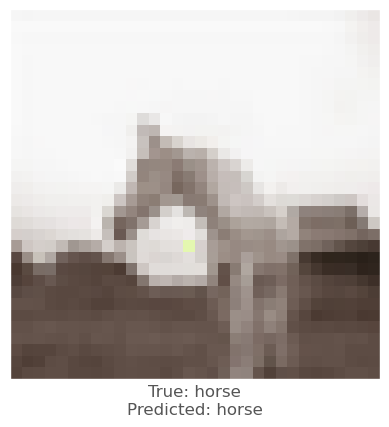



-0.0009961128
-0.0077776313
0.0004415512
vr, vg, vb :   -1.306452049270998 4.1854531067306056 -2.791119154191087
beam_perturbed_confidence temp :  0.5289648
beam_perturbed_confidence temp :  0.52641124
beam_perturbed_confidence temp :  0.52663904
beam_perturbed_confidence temp :  0.5289648
beam_perturbed_confidence temp :  0.5278925
beam_perturbed_confidence temp :  0.52663904
beam_perturbed_confidence temp :  0.5278925
row index :  1
26th round's confidence : 1th 0.52641124
predicted class :  horse
predicted class's confidence :  0.52641124
Lopt is :  53


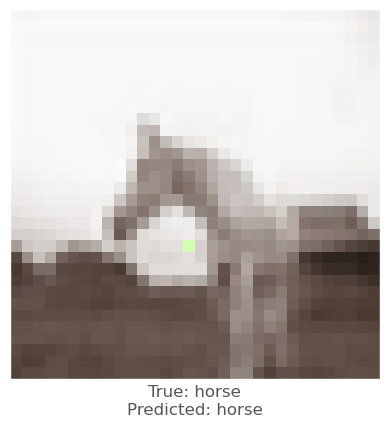



-0.0019177198
-0.0054970384
0.00036472082
vr, vg, vb :   0.9251990792025451 4.832040392534539 -0.6828845304515853
beam_perturbed_confidence temp :  0.6421992
beam_perturbed_confidence temp :  0.6421992
beam_perturbed_confidence temp :  0.6422084
beam_perturbed_confidence temp :  0.6421992
beam_perturbed_confidence temp :  0.6422084
beam_perturbed_confidence temp :  0.6422084
beam_perturbed_confidence temp :  0.6422084
row index :  0
26th round's confidence : 2th 0.6421992
predicted class :  horse
predicted class's confidence :  0.6421992
Lopt is :  24


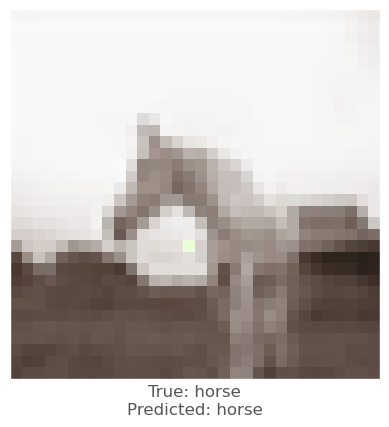



0.0036866665
-0.0024254918
0.0053782463
vr, vg, vb :   -1.2220775568369076 2.5472403334234466 -2.6087900089907112
beam_perturbed_confidence temp :  0.5902784
beam_perturbed_confidence temp :  0.5925159
beam_perturbed_confidence temp :  0.58543974
beam_perturbed_confidence temp :  0.5869714
beam_perturbed_confidence temp :  0.58602226
beam_perturbed_confidence temp :  0.5812438
beam_perturbed_confidence temp :  0.5784375
row index :  6
26th round's confidence : 3th 0.5784375
predicted class :  horse
predicted class's confidence :  0.5784375
Lopt is :  37


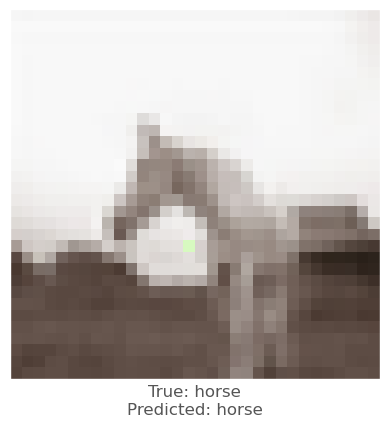



-0.0009531379
-0.0050857663
0.0004979968
vr, vg, vb :   1.2136720741988247 5.004385077265095 -0.432240839013855
beam_perturbed_confidence temp :  0.63789874
beam_perturbed_confidence temp :  0.63823944
beam_perturbed_confidence temp :  0.6380683
beam_perturbed_confidence temp :  0.63789874
beam_perturbed_confidence temp :  0.6375642
beam_perturbed_confidence temp :  0.6380683
beam_perturbed_confidence temp :  0.6375642
row index :  4
26th round's confidence : 4th 0.6375642
predicted class :  horse
predicted class's confidence :  0.6375642
Lopt is :  24


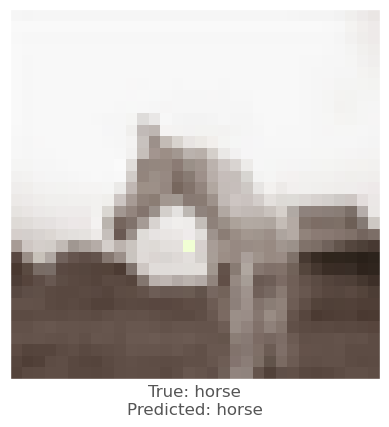



0.0039667487
-0.0020759106
0.00493443
vr, vg, vb :   -0.6260714169070971 2.7567218461744964 -2.660278767746349
beam_perturbed_confidence temp :  0.570667
beam_perturbed_confidence temp :  0.57292503
beam_perturbed_confidence temp :  0.56717694
beam_perturbed_confidence temp :  0.5698692
beam_perturbed_confidence temp :  0.56765664
beam_perturbed_confidence temp :  0.5631779
beam_perturbed_confidence temp :  0.5602631
row index :  6
27th round's confidence : 0th 0.5602631
predicted class :  horse
predicted class's confidence :  0.5602631
Lopt is :  56


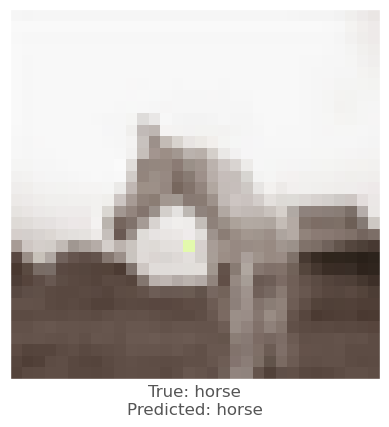



-0.0009961128
-0.0077776313
0.0004415512
vr, vg, vb :   -1.0761955619952652 4.544670924338185 -2.5561623596215877
beam_perturbed_confidence temp :  0.5289648
beam_perturbed_confidence temp :  0.52641124
beam_perturbed_confidence temp :  0.52663904
beam_perturbed_confidence temp :  0.5289648
beam_perturbed_confidence temp :  0.5278925
beam_perturbed_confidence temp :  0.52663904
beam_perturbed_confidence temp :  0.5278925
row index :  1
27th round's confidence : 1th 0.52641124
predicted class :  horse
predicted class's confidence :  0.52641124
Lopt is :  53


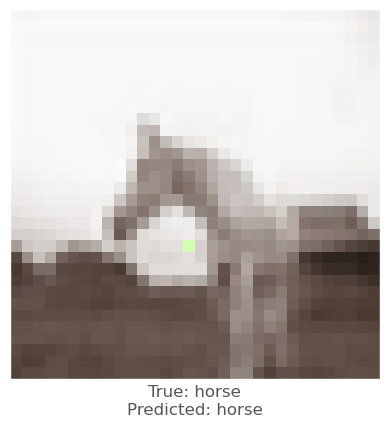



-0.0019177198
-0.0054970384
0.00036472082
vr, vg, vb :   1.0244511553826325 4.898540189722126 -0.6510681595444883
beam_perturbed_confidence temp :  0.64138687
beam_perturbed_confidence temp :  0.6421992
beam_perturbed_confidence temp :  0.6422084
beam_perturbed_confidence temp :  0.64138687
beam_perturbed_confidence temp :  0.6411772
beam_perturbed_confidence temp :  0.6422084
beam_perturbed_confidence temp :  0.6411772
row index :  4
27th round's confidence : 2th 0.6411772
predicted class :  horse
predicted class's confidence :  0.6411772
Lopt is :  24


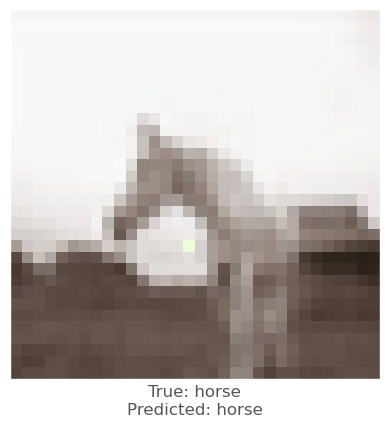



0.0016537309
-0.0048805475
0.005374849
vr, vg, vb :   -1.2652428880825382 2.7805710524309557 -2.885395892353725
beam_perturbed_confidence temp :  0.57697016
beam_perturbed_confidence temp :  0.5758544
beam_perturbed_confidence temp :  0.57110053
beam_perturbed_confidence temp :  0.57082236
beam_perturbed_confidence temp :  0.57197845
beam_perturbed_confidence temp :  0.56496656
beam_perturbed_confidence temp :  0.562109
row index :  6
27th round's confidence : 3th 0.562109
predicted class :  horse
predicted class's confidence :  0.562109
Lopt is :  40


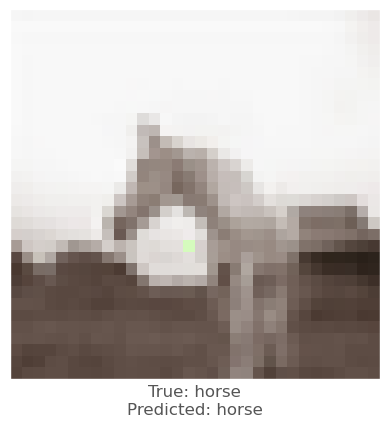



-0.0006700754
-0.0051424503
0.00038331747
vr, vg, vb :   1.1593124084354365 5.018191602802745 -0.42734850216752324
beam_perturbed_confidence temp :  0.63739824
beam_perturbed_confidence temp :  0.6375642
beam_perturbed_confidence temp :  0.6375154
beam_perturbed_confidence temp :  0.63739824
beam_perturbed_confidence temp :  0.6371344
beam_perturbed_confidence temp :  0.6375154
beam_perturbed_confidence temp :  0.6371344
row index :  4
27th round's confidence : 4th 0.6371344
predicted class :  horse
predicted class's confidence :  0.6371344
Lopt is :  24


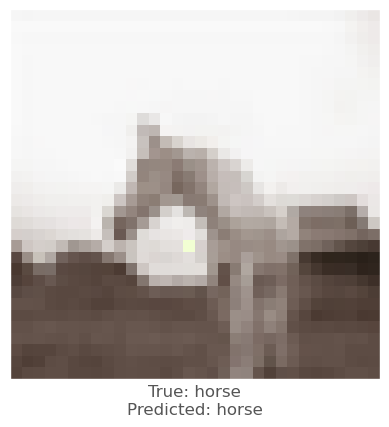



0.0038445592
-0.002784729
0.004612565
vr, vg, vb :   -0.9479201944821345 2.759522561947672 -2.855507395030552
beam_perturbed_confidence temp :  0.5593333
beam_perturbed_confidence temp :  0.5605904
beam_perturbed_confidence temp :  0.5564162
beam_perturbed_confidence temp :  0.557265
beam_perturbed_confidence temp :  0.5585246
beam_perturbed_confidence temp :  0.5511175
beam_perturbed_confidence temp :  0.5498666
row index :  6
28th round's confidence : 0th 0.5498666
predicted class :  horse
predicted class's confidence :  0.5498666
Lopt is :  59


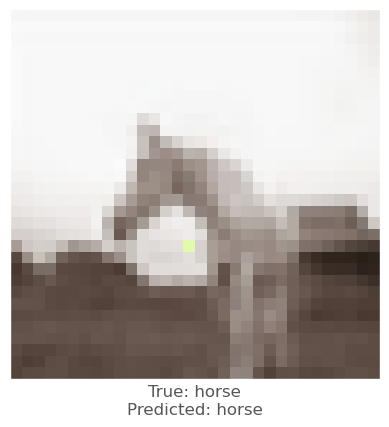



-0.0009961128
-0.0077776313
0.0004415512
vr, vg, vb :   -0.868964723447106 4.867966960185006 -2.3447012445090385
beam_perturbed_confidence temp :  0.5276146
beam_perturbed_confidence temp :  0.52641124
beam_perturbed_confidence temp :  0.52663904
beam_perturbed_confidence temp :  0.5276146
beam_perturbed_confidence temp :  0.5273548
beam_perturbed_confidence temp :  0.52663904
beam_perturbed_confidence temp :  0.5273548
row index :  1
28th round's confidence : 1th 0.52641124
predicted class :  horse
predicted class's confidence :  0.52641124
Lopt is :  53


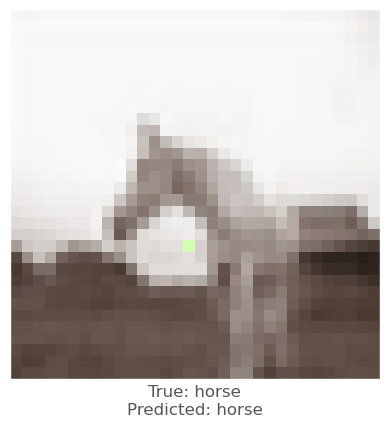



-0.0017486215
-0.005252719
0.00021117926
vr, vg, vb :   1.0968681862219327 4.933958063297521 -0.6070792692339604
beam_perturbed_confidence temp :  0.6404598
beam_perturbed_confidence temp :  0.6411772
beam_perturbed_confidence temp :  0.6411757
beam_perturbed_confidence temp :  0.6404598
beam_perturbed_confidence temp :  0.6401265
beam_perturbed_confidence temp :  0.6411757
beam_perturbed_confidence temp :  0.6401265
row index :  4
28th round's confidence : 2th 0.6401265
predicted class :  horse
predicted class's confidence :  0.6401265
Lopt is :  24


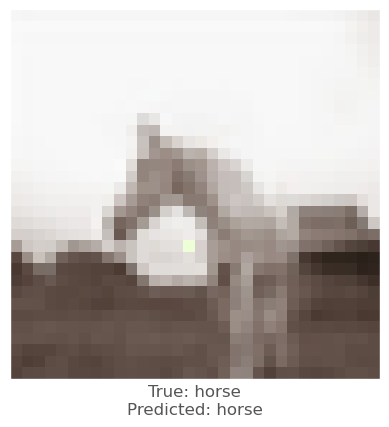



0.001411438
-0.006962061
0.0047489405
vr, vg, vb :   -1.2798623981024093 3.198720040022333 -3.0717503499017997
beam_perturbed_confidence temp :  0.56252396
beam_perturbed_confidence temp :  0.55619043
beam_perturbed_confidence temp :  0.55614704
beam_perturbed_confidence temp :  0.5507284
beam_perturbed_confidence temp :  0.55885434
beam_perturbed_confidence temp :  0.5436391
beam_perturbed_confidence temp :  0.54133034
row index :  6
28th round's confidence : 3th 0.54133034
predicted class :  horse
predicted class's confidence :  0.54133034
Lopt is :  44


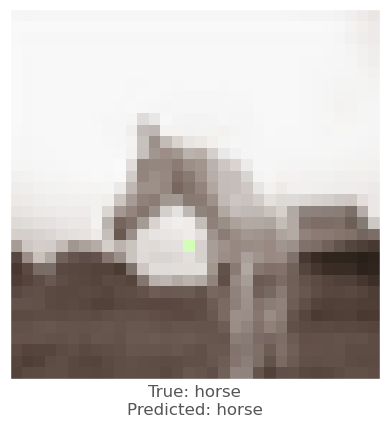



-0.00043350458
-0.0048124194
0.00056260824
vr, vg, vb :   1.0867316257370345 4.997614383974497 -0.4408744761542621
beam_perturbed_confidence temp :  0.6370819
beam_perturbed_confidence temp :  0.6371344
beam_perturbed_confidence temp :  0.63683563
beam_perturbed_confidence temp :  0.6370819
beam_perturbed_confidence temp :  0.63652
beam_perturbed_confidence temp :  0.63683563
beam_perturbed_confidence temp :  0.63652
row index :  4
28th round's confidence : 4th 0.63652
predicted class :  horse
predicted class's confidence :  0.63652
Lopt is :  24


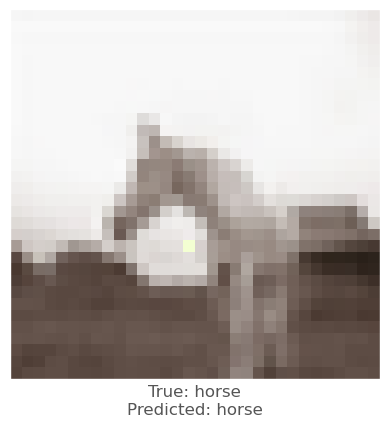



0.0018370748
-0.0052073
0.003246665
vr, vg, vb :   -1.0368356506961525 3.0043003243686277 -2.89462315561905
beam_perturbed_confidence temp :  0.5503923
beam_perturbed_confidence temp :  0.54603124
beam_perturbed_confidence temp :  0.54759717
beam_perturbed_confidence temp :  0.54037535
beam_perturbed_confidence temp :  0.5526814
beam_perturbed_confidence temp :  0.53715634
beam_perturbed_confidence temp :  0.53363705
row index :  6
29th round's confidence : 0th 0.53363705
predicted class :  horse
predicted class's confidence :  0.53363705
Lopt is :  62


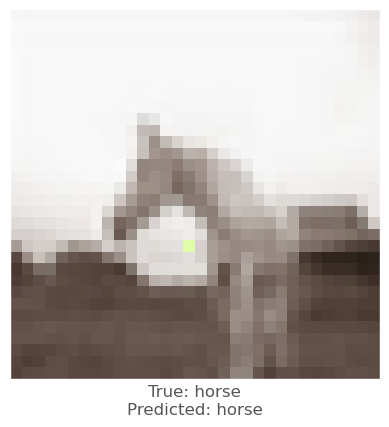



-0.0009961128
-0.0077776313
0.0004415512
vr, vg, vb :   -0.6824569687537626 5.158933392447145 -2.154386240907744
beam_perturbed_confidence temp :  0.5276146
beam_perturbed_confidence temp :  0.52641124
beam_perturbed_confidence temp :  0.52663904
beam_perturbed_confidence temp :  0.5276146
beam_perturbed_confidence temp :  0.5273548
beam_perturbed_confidence temp :  0.52663904
beam_perturbed_confidence temp :  0.5273548
row index :  1
29th round's confidence : 1th 0.52641124
predicted class :  horse
predicted class's confidence :  0.52641124
Lopt is :  53


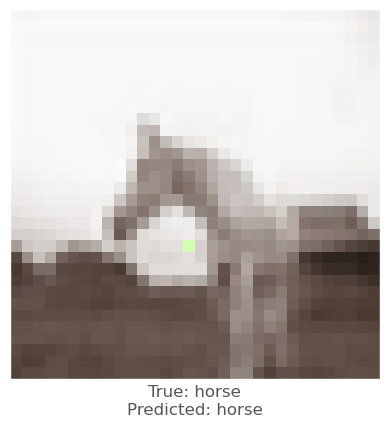



-0.0018045902
-0.005389154
0.0004966259
vr, vg, vb :   1.1676403901217123 4.979477652704463 -0.5960339323374199
beam_perturbed_confidence temp :  0.6393711
beam_perturbed_confidence temp :  0.6401265
beam_perturbed_confidence temp :  0.63996315
beam_perturbed_confidence temp :  0.6393711
beam_perturbed_confidence temp :  0.63904876
beam_perturbed_confidence temp :  0.63996315
beam_perturbed_confidence temp :  0.63904876
row index :  4
29th round's confidence : 2th 0.63904876
predicted class :  horse
predicted class's confidence :  0.63904876
Lopt is :  24


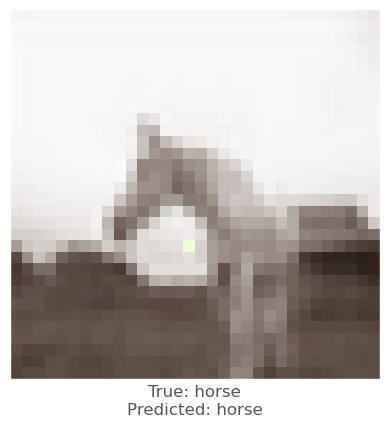



0.0004145503
-0.008592904
0.0033254027
vr, vg, vb :   -1.1933311887334526 3.7381383974245184 -3.0971155885780015
beam_perturbed_confidence temp :  0.5422593
beam_perturbed_confidence temp :  0.5379391
beam_perturbed_confidence temp :  0.5370211
beam_perturbed_confidence temp :  0.53697824
beam_perturbed_confidence temp :  0.54012126
beam_perturbed_confidence temp :  0.5303296
beam_perturbed_confidence temp :  0.5330357
row index :  5
29th round's confidence : 3th 0.5303296
predicted class :  horse
predicted class's confidence :  0.5303296
Lopt is :  48


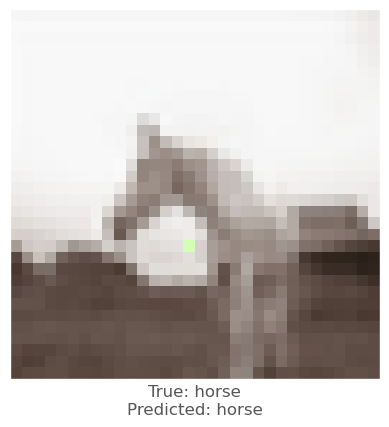



-0.00028055906
-0.004360497
0.0009535551
vr, vg, vb :   1.0061143694591075 4.933902645360373 -0.49214253925050583
beam_perturbed_confidence temp :  0.6365551
beam_perturbed_confidence temp :  0.63652
beam_perturbed_confidence temp :  0.63612837
beam_perturbed_confidence temp :  0.6365551
beam_perturbed_confidence temp :  0.6357473
beam_perturbed_confidence temp :  0.63612837
beam_perturbed_confidence temp :  0.6357473
row index :  4
29th round's confidence : 4th 0.6357473
predicted class :  horse
predicted class's confidence :  0.6357473
Lopt is :  24


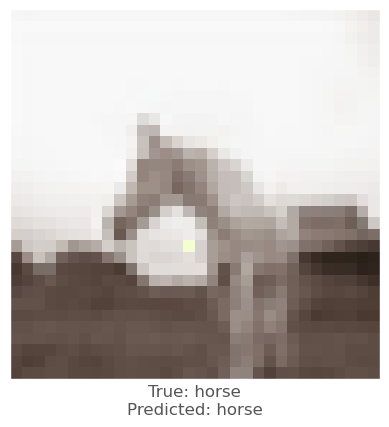






3th sensitive pixel
original confidence is :  0.69673544 

original r,g,b :  222 217 214
-0.004762113
-0.001714766
-0.0033214688
vr, vg, vb :   0.4762113094329834 0.1714766025543213 0.33214688301086426
beam_perturbed_confidence temp :  0.69673544
beam_perturbed_confidence temp :  0.69673544
beam_perturbed_confidence temp :  0.69673544
beam_perturbed_confidence temp :  0.69673544
beam_perturbed_confidence temp :  0.69673544
beam_perturbed_confidence temp :  0.69673544
beam_perturbed_confidence temp :  0.69673544
row index :  0
0th round's confidence : 0th 0.69673544
predicted class :  horse
predicted class's confidence :  0.69673544
Lopt is :  0


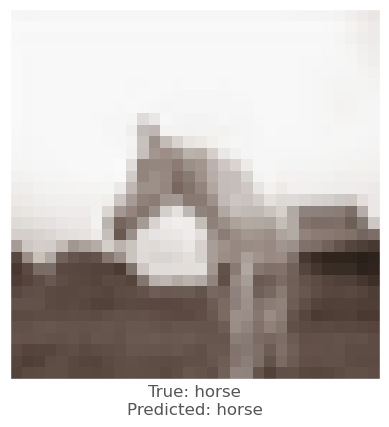






4th sensitive pixel
original confidence is :  0.69673544 

original r,g,b :  228 224 221
-0.00061160326
0.0065327883
0.0043948293
vr, vg, vb :   0.06116032600402832 -0.6532788276672363 -0.4394829273223877
beam_perturbed_confidence temp :  0.69673544
beam_perturbed_confidence temp :  0.6933954
beam_perturbed_confidence temp :  0.6943132
beam_perturbed_confidence temp :  0.6933954
beam_perturbed_confidence temp :  0.6943132
beam_perturbed_confidence temp :  0.6905578
beam_perturbed_confidence temp :  0.6905578
row index :  5
0th round's confidence : 0th 0.6905578
predicted class :  horse
predicted class's confidence :  0.6905578
Lopt is :  1


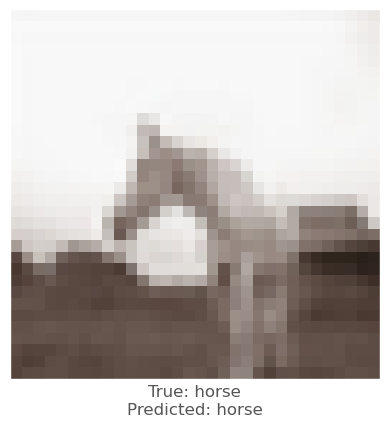



0.00059092045
0.0067184567
0.0023422241
vr, vg, vb :   -0.059092044830322266 -0.6718456745147705 -0.234222412109375
beam_perturbed_confidence temp :  0.64766926
beam_perturbed_confidence temp :  0.64440244
beam_perturbed_confidence temp :  0.6466918
beam_perturbed_confidence temp :  0.6448857
beam_perturbed_confidence temp :  0.6469428
beam_perturbed_confidence temp :  0.64338845
beam_perturbed_confidence temp :  0.6438244
row index :  5
0th round's confidence : 1th 0.64338845
predicted class :  horse
predicted class's confidence :  0.64338845
Lopt is :  6


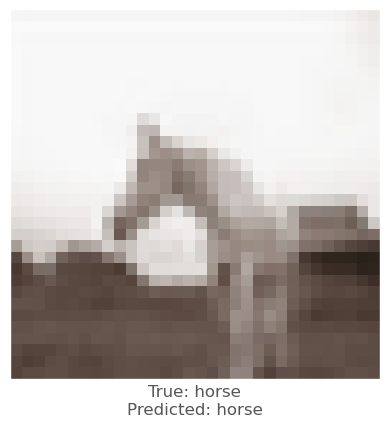



-0.008449137
-0.006403327
-0.0014109015
vr, vg, vb :   0.8449137210845947 0.6403326988220215 0.14109015464782715
beam_perturbed_confidence temp :  0.6985725
beam_perturbed_confidence temp :  0.6985725
beam_perturbed_confidence temp :  0.6985725
beam_perturbed_confidence temp :  0.6985725
beam_perturbed_confidence temp :  0.6985725
beam_perturbed_confidence temp :  0.6985725
beam_perturbed_confidence temp :  0.6985725
row index :  0
0th round's confidence : 2th 0.6985725
predicted class :  horse
predicted class's confidence :  0.6985725
Lopt is :  5


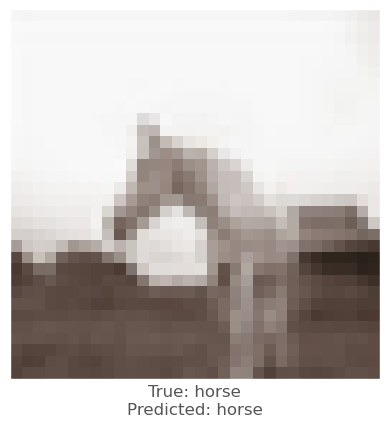



-0.0040243864
0.005673349
0.0043388605
vr, vg, vb :   0.4024386405944824 -0.5673348903656006 -0.4338860511779785
beam_perturbed_confidence temp :  0.6310277
beam_perturbed_confidence temp :  0.6280888
beam_perturbed_confidence temp :  0.62885153
beam_perturbed_confidence temp :  0.6280888
beam_perturbed_confidence temp :  0.62885153
beam_perturbed_confidence temp :  0.6261321
beam_perturbed_confidence temp :  0.6261321
row index :  5
0th round's confidence : 3th 0.6261321
predicted class :  horse
predicted class's confidence :  0.6261321
Lopt is :  11


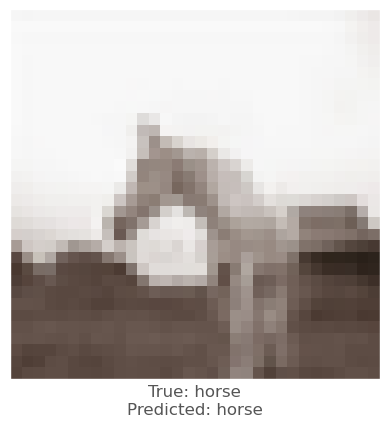



-0.021017492
-0.022665322
-0.012215257
vr, vg, vb :   2.1017491817474365 2.2665321826934814 1.2215256690979004
beam_perturbed_confidence temp :  0.569921
beam_perturbed_confidence temp :  0.5713777
beam_perturbed_confidence temp :  0.5832628
beam_perturbed_confidence temp :  0.56009215
beam_perturbed_confidence temp :  0.56779903
beam_perturbed_confidence temp :  0.56842947
beam_perturbed_confidence temp :  0.55836034
row index :  6
0th round's confidence : 4th 0.55836034
predicted class :  horse
predicted class's confidence :  0.55836034
Lopt is :  12


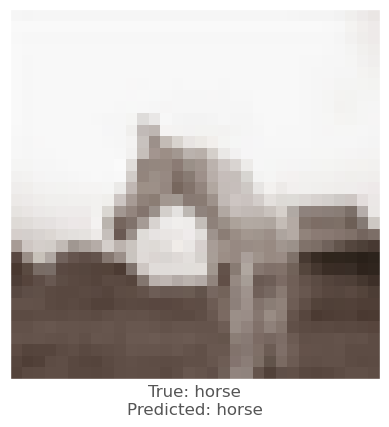



-0.0014350414
0.006706059
0.005323291
vr, vg, vb :   0.19854843616485596 -1.258556842803955 -0.9278637170791626
beam_perturbed_confidence temp :  0.6905578
beam_perturbed_confidence temp :  0.6848765
beam_perturbed_confidence temp :  0.6880721
beam_perturbed_confidence temp :  0.6848765
beam_perturbed_confidence temp :  0.6880721
beam_perturbed_confidence temp :  0.6816387
beam_perturbed_confidence temp :  0.6816387
row index :  5
1th round's confidence : 0th 0.6816387
predicted class :  horse
predicted class's confidence :  0.6816387
Lopt is :  3


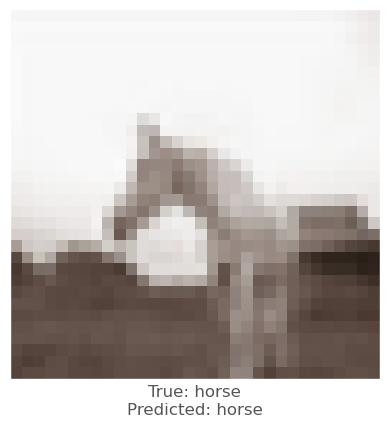



-0.0005778074
0.0070698857
0.0022072792
vr, vg, vb :   0.004597902297973633 -1.3116496801376343 -0.43152809143066406
beam_perturbed_confidence temp :  0.64338845
beam_perturbed_confidence temp :  0.6350497
beam_perturbed_confidence temp :  0.64219517
beam_perturbed_confidence temp :  0.6350497
beam_perturbed_confidence temp :  0.64219517
beam_perturbed_confidence temp :  0.63249147
beam_perturbed_confidence temp :  0.63249147
row index :  5
1th round's confidence : 1th 0.63249147
predicted class :  horse
predicted class's confidence :  0.63249147
Lopt is :  8


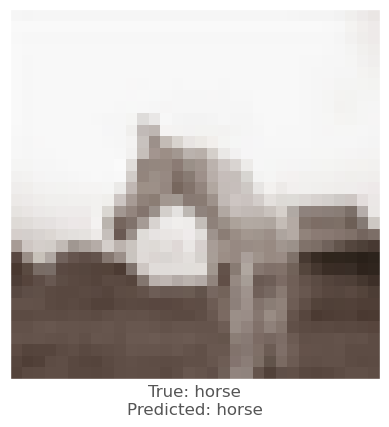



-0.008449137
-0.006403327
-0.0014109015
vr, vg, vb :   1.60533607006073 1.2166321277618408 0.2680712938308716
beam_perturbed_confidence temp :  0.69419605
beam_perturbed_confidence temp :  0.69538647
beam_perturbed_confidence temp :  0.6985725
beam_perturbed_confidence temp :  0.68917036
beam_perturbed_confidence temp :  0.69419605
beam_perturbed_confidence temp :  0.69538647
beam_perturbed_confidence temp :  0.68917036
row index :  3
1th round's confidence : 2th 0.68917036
predicted class :  horse
predicted class's confidence :  0.68917036
Lopt is :  6


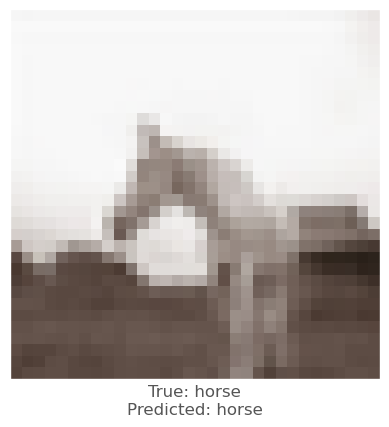



-0.0041903257
0.004987061
0.0039821863
vr, vg, vb :   0.7812273502349854 -1.0093075037002563 -0.7887160778045654
beam_perturbed_confidence temp :  0.6261321
beam_perturbed_confidence temp :  0.62197155
beam_perturbed_confidence temp :  0.6241066
beam_perturbed_confidence temp :  0.62197155
beam_perturbed_confidence temp :  0.6241066
beam_perturbed_confidence temp :  0.6196559
beam_perturbed_confidence temp :  0.6196559
row index :  5
1th round's confidence : 3th 0.6196559
predicted class :  horse
predicted class's confidence :  0.6196559
Lopt is :  13


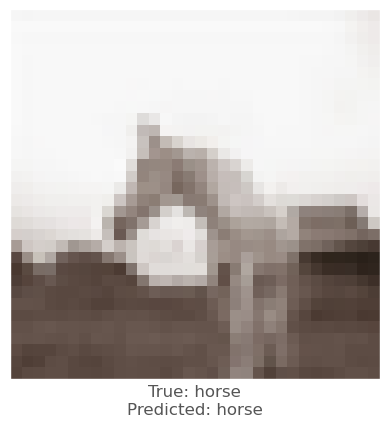



-0.008713365
-0.009073317
-0.0032322407
vr, vg, vb :   2.7629107236862183 2.947210669517517 1.4225971698760986
beam_perturbed_confidence temp :  0.5517553
beam_perturbed_confidence temp :  0.5501261
beam_perturbed_confidence temp :  0.5568599
beam_perturbed_confidence temp :  0.54591733
beam_perturbed_confidence temp :  0.55049133
beam_perturbed_confidence temp :  0.5481623
beam_perturbed_confidence temp :  0.5446197
row index :  6
1th round's confidence : 4th 0.5446197
predicted class :  horse
predicted class's confidence :  0.5446197
Lopt is :  14


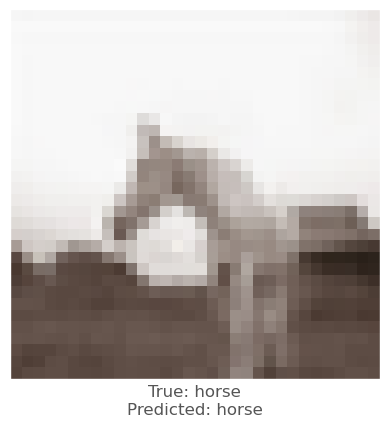



0.0013552904
0.0105237365
0.006638646
vr, vg, vb :   0.04316455125808716 -2.185074806213379 -1.498941957950592
beam_perturbed_confidence temp :  0.6816387
beam_perturbed_confidence temp :  0.6577816
beam_perturbed_confidence temp :  0.6741076
beam_perturbed_confidence temp :  0.6577816
beam_perturbed_confidence temp :  0.6741076
beam_perturbed_confidence temp :  0.6475989
beam_perturbed_confidence temp :  0.6475989
row index :  5
2th round's confidence : 0th 0.6475989
predicted class :  horse
predicted class's confidence :  0.6475989
Lopt is :  6


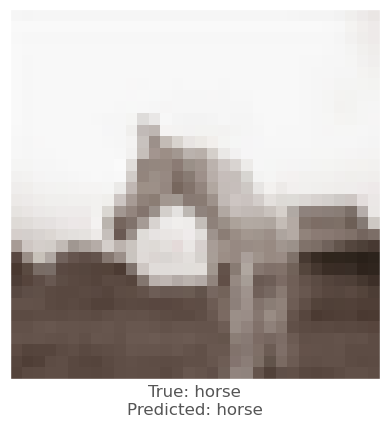



-0.0019610524
0.010375679
0.0045309663
vr, vg, vb :   0.20024335384368896 -2.218052566051483 -0.8414719104766846
beam_perturbed_confidence temp :  0.63249147
beam_perturbed_confidence temp :  0.61931306
beam_perturbed_confidence temp :  0.63051873
beam_perturbed_confidence temp :  0.61931306
beam_perturbed_confidence temp :  0.63051873
beam_perturbed_confidence temp :  0.6179578
beam_perturbed_confidence temp :  0.6179578
row index :  5
2th round's confidence : 1th 0.6179578
predicted class :  horse
predicted class's confidence :  0.6179578
Lopt is :  11


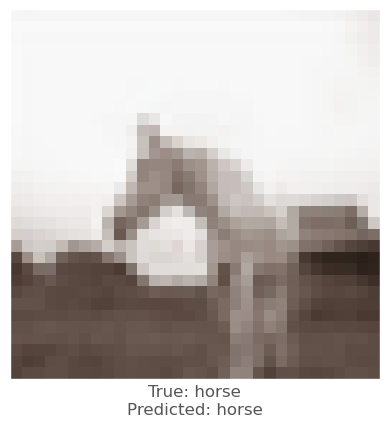



-0.014223337
-0.013118029
-0.005942285
vr, vg, vb :   2.8671361804008484 2.4067717790603638 0.8354926705360413
beam_perturbed_confidence temp :  0.67295915
beam_perturbed_confidence temp :  0.6741705
beam_perturbed_confidence temp :  0.68917036
beam_perturbed_confidence temp :  0.65332294
beam_perturbed_confidence temp :  0.67295915
beam_perturbed_confidence temp :  0.6741705
beam_perturbed_confidence temp :  0.65332294
row index :  3
2th round's confidence : 2th 0.65332294
predicted class :  horse
predicted class's confidence :  0.65332294
Lopt is :  8


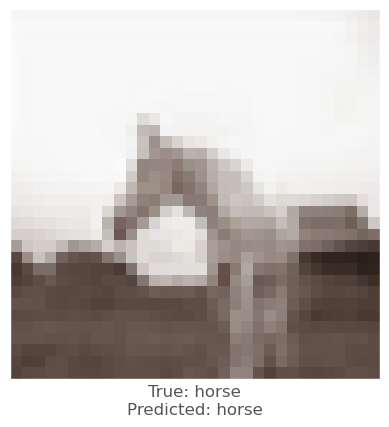



-0.0032734275
0.0033989549
0.00425148
vr, vg, vb :   1.0304473638534546 -1.2482722401618958 -1.1349924802780151
beam_perturbed_confidence temp :  0.61781454
beam_perturbed_confidence temp :  0.61652046
beam_perturbed_confidence temp :  0.61597216
beam_perturbed_confidence temp :  0.61481297
beam_perturbed_confidence temp :  0.61402506
beam_perturbed_confidence temp :  0.6122828
beam_perturbed_confidence temp :  0.61089003
row index :  6
2th round's confidence : 3th 0.61089003
predicted class :  horse
predicted class's confidence :  0.61089003
Lopt is :  15


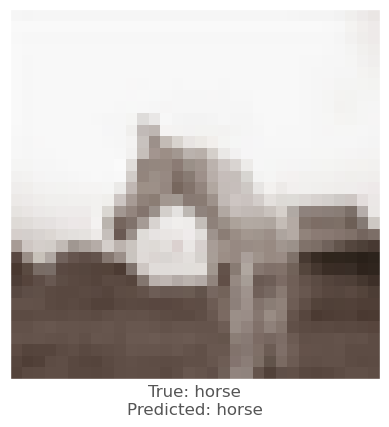



-0.0030235648
-0.0062553287
-0.0028308034
vr, vg, vb :   2.7889761328697205 3.2780224680900574 1.5634177923202515
beam_perturbed_confidence temp :  0.5417018
beam_perturbed_confidence temp :  0.5366071
beam_perturbed_confidence temp :  0.5430865
beam_perturbed_confidence temp :  0.53874224
beam_perturbed_confidence temp :  0.5408402
beam_perturbed_confidence temp :  0.5359319
beam_perturbed_confidence temp :  0.53890234
row index :  5
2th round's confidence : 4th 0.5359319
predicted class :  horse
predicted class's confidence :  0.5359319
Lopt is :  17


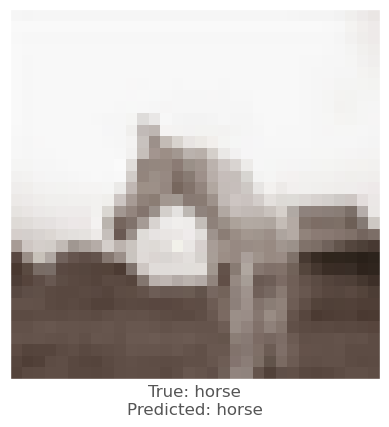



-0.00036108494
0.014578164
0.008586824
vr, vg, vb :   0.07495658993721008 -3.4243836879730223 -2.207730156183243
beam_perturbed_confidence temp :  0.6475989
beam_perturbed_confidence temp :  0.62576884
beam_perturbed_confidence temp :  0.63796836
beam_perturbed_confidence temp :  0.62576884
beam_perturbed_confidence temp :  0.63796836
beam_perturbed_confidence temp :  0.6123101
beam_perturbed_confidence temp :  0.6123101
row index :  5
3th round's confidence : 0th 0.6123101
predicted class :  horse
predicted class's confidence :  0.6123101
Lopt is :  10


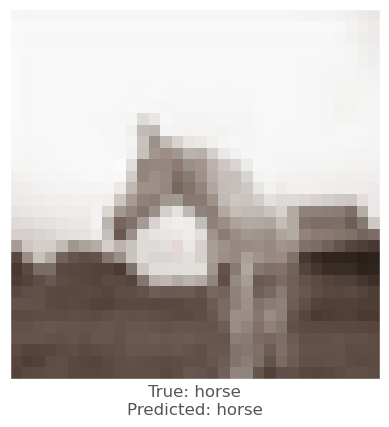



-0.0057535768
0.006836295
0.003529191
vr, vg, vb :   0.7555766940116883 -2.6798768222332 -1.110243821144104
beam_perturbed_confidence temp :  0.6179578
beam_perturbed_confidence temp :  0.6111952
beam_perturbed_confidence temp :  0.6142784
beam_perturbed_confidence temp :  0.6111952
beam_perturbed_confidence temp :  0.6142784
beam_perturbed_confidence temp :  0.60958415
beam_perturbed_confidence temp :  0.60958415
row index :  5
3th round's confidence : 1th 0.60958415
predicted class :  horse
predicted class's confidence :  0.60958415
Lopt is :  14


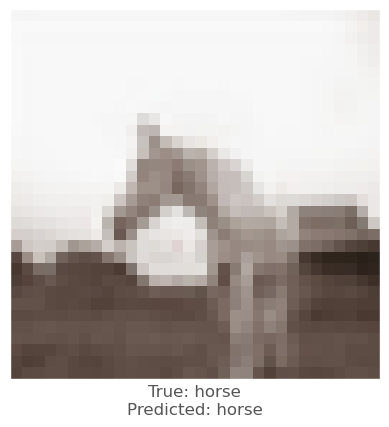



-0.02254939
-0.0208956
-0.008423269
vr, vg, vb :   4.835361641645432 4.2556546330451965 1.5942702829837798
beam_perturbed_confidence temp :  0.6111222
beam_perturbed_confidence temp :  0.6117405
beam_perturbed_confidence temp :  0.64915425
beam_perturbed_confidence temp :  0.5733397
beam_perturbed_confidence temp :  0.6071945
beam_perturbed_confidence temp :  0.6068121
beam_perturbed_confidence temp :  0.5704692
row index :  6
3th round's confidence : 2th 0.5704692
predicted class :  horse
predicted class's confidence :  0.5704692
Lopt is :  12


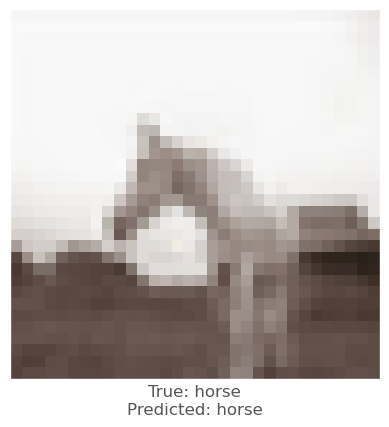



-0.004083872
0.004512608
0.0048552155
vr, vg, vb :   1.3357898116111757 -1.574705821275711 -1.5070147871971131
beam_perturbed_confidence temp :  0.60819894
beam_perturbed_confidence temp :  0.6056396
beam_perturbed_confidence temp :  0.6054265
beam_perturbed_confidence temp :  0.6039186
beam_perturbed_confidence temp :  0.6032447
beam_perturbed_confidence temp :  0.5991742
beam_perturbed_confidence temp :  0.5971888
row index :  6
3th round's confidence : 3th 0.5971888
predicted class :  horse
predicted class's confidence :  0.5971888
Lopt is :  17


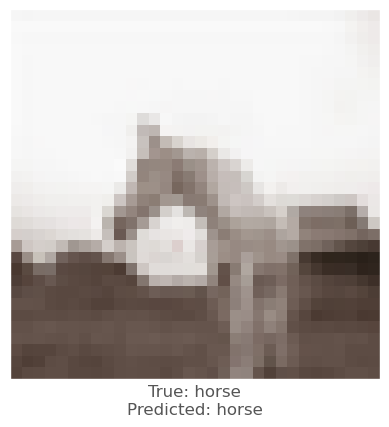



0.0017591715
-0.0013897419
-0.0010569096
vr, vg, vb :   2.3341613709926605 3.0891944110393523 1.512766969203949
beam_perturbed_confidence temp :  0.53890234
beam_perturbed_confidence temp :  0.5372324
beam_perturbed_confidence temp :  0.5355502
beam_perturbed_confidence temp :  0.54208314
beam_perturbed_confidence temp :  0.53892064
beam_perturbed_confidence temp :  0.5386893
beam_perturbed_confidence temp :  0.5423888
row index :  2
3th round's confidence : 4th 0.5355502
predicted class :  horse
predicted class's confidence :  0.5355502
Lopt is :  17


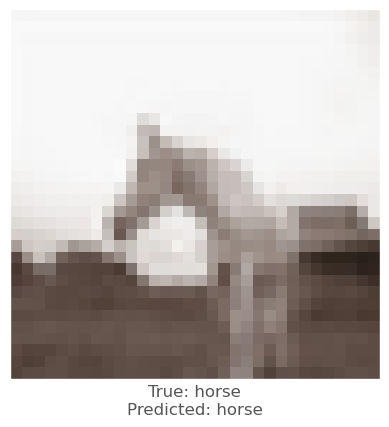



-0.004344821
0.013619959
0.008743405
vr, vg, vb :   0.5019430285692215 -4.443941254615783 -2.8612976747751238
beam_perturbed_confidence temp :  0.6123101
beam_perturbed_confidence temp :  0.5910473
beam_perturbed_confidence temp :  0.6018338
beam_perturbed_confidence temp :  0.5910473
beam_perturbed_confidence temp :  0.6018338
beam_perturbed_confidence temp :  0.5892533
beam_perturbed_confidence temp :  0.5892533
row index :  5
4th round's confidence : 0th 0.5892533
predicted class :  horse
predicted class's confidence :  0.5892533
Lopt is :  15


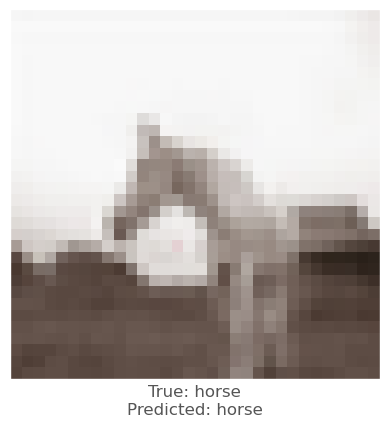



-0.007494569
0.002893269
0.0021210313
vr, vg, vb :   1.4294759070873262 -2.7012160462141037 -1.211322567462921
beam_perturbed_confidence temp :  0.6054302
beam_perturbed_confidence temp :  0.603437
beam_perturbed_confidence temp :  0.60622334
beam_perturbed_confidence temp :  0.59928566
beam_perturbed_confidence temp :  0.6027363
beam_perturbed_confidence temp :  0.59942734
beam_perturbed_confidence temp :  0.5956701
row index :  6
4th round's confidence : 1th 0.5956701
predicted class :  horse
predicted class's confidence :  0.5956701
Lopt is :  17


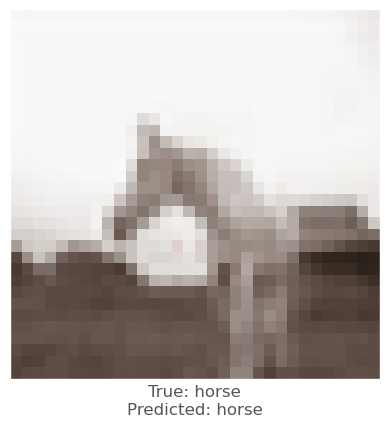



-0.015842736
-0.013099074
-0.005587101
vr, vg, vb :   5.936099054217339 5.139996606111527 1.9935533529520035
beam_perturbed_confidence temp :  0.54597133
beam_perturbed_confidence temp :  0.54396486
beam_perturbed_confidence temp :  0.5677526
beam_perturbed_confidence temp :  0.54245406
beam_perturbed_confidence temp :  0.5466638
beam_perturbed_confidence temp :  0.5434875
beam_perturbed_confidence temp :  0.5414658
row index :  6
4th round's confidence : 2th 0.5414658
predicted class :  horse
predicted class's confidence :  0.5414658
Lopt is :  17


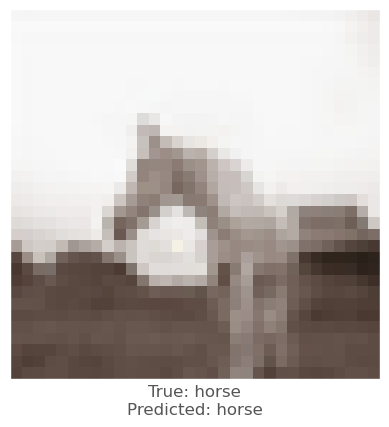



-0.004771054
0.0069808364
0.006972313
vr, vg, vb :   1.6793162095546725 -2.1153188782930377 -2.0535446012020113
beam_perturbed_confidence temp :  0.59440315
beam_perturbed_confidence temp :  0.5855559
beam_perturbed_confidence temp :  0.5871362
beam_perturbed_confidence temp :  0.5843128
beam_perturbed_confidence temp :  0.58534503
beam_perturbed_confidence temp :  0.5808421
beam_perturbed_confidence temp :  0.5806706
row index :  6
4th round's confidence : 3th 0.5806706
predicted class :  horse
predicted class's confidence :  0.5806706
Lopt is :  20


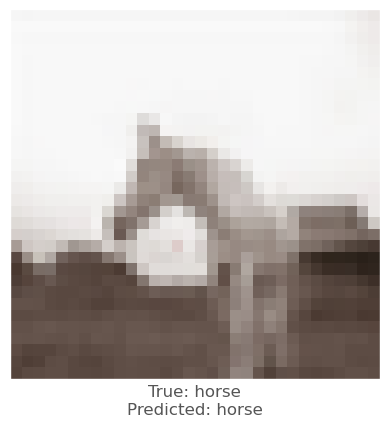



0.0027016997
-0.00017869473
-0.00036603212
vr, vg, vb :   1.8305752605199817 2.7981444424390793 1.3980934846401214
beam_perturbed_confidence temp :  0.5372939
beam_perturbed_confidence temp :  0.53717756
beam_perturbed_confidence temp :  0.53556585
beam_perturbed_confidence temp :  0.54012203
beam_perturbed_confidence temp :  0.5375835
beam_perturbed_confidence temp :  0.53861696
beam_perturbed_confidence temp :  0.54107094
row index :  2
4th round's confidence : 4th 0.53556585
predicted class :  horse
predicted class's confidence :  0.53556585
Lopt is :  17


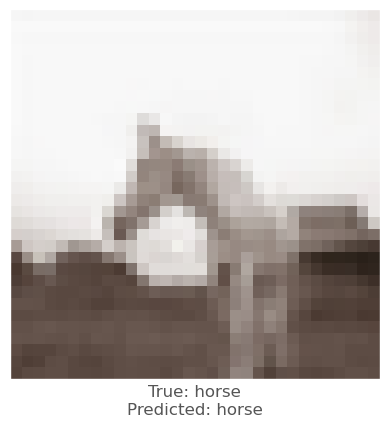



-0.007145703
0.0037861466
0.0017440915
vr, vg, vb :   1.16631900960207 -4.378161793231964 -2.7495770583748818
beam_perturbed_confidence temp :  0.58573604
beam_perturbed_confidence temp :  0.57700646
beam_perturbed_confidence temp :  0.58415157
beam_perturbed_confidence temp :  0.5729395
beam_perturbed_confidence temp :  0.5804789
beam_perturbed_confidence temp :  0.56743914
beam_perturbed_confidence temp :  0.56375813
row index :  6
5th round's confidence : 0th 0.56375813
predicted class :  horse
predicted class's confidence :  0.56375813
Lopt is :  20


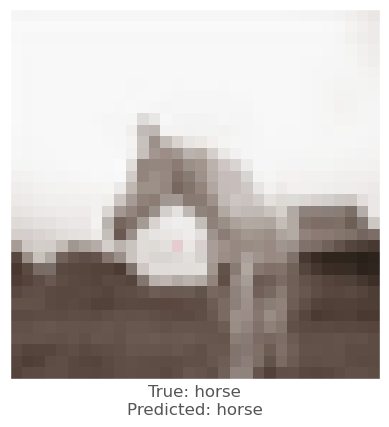



-0.0077427626
0.0039536357
0.0043432117
vr, vg, vb :   2.060804572939873 -2.826458010852337 -1.524511475801468
beam_perturbed_confidence temp :  0.58773756
beam_perturbed_confidence temp :  0.5866742
beam_perturbed_confidence temp :  0.59062743
beam_perturbed_confidence temp :  0.5789436
beam_perturbed_confidence temp :  0.5829747
beam_perturbed_confidence temp :  0.5811378
beam_perturbed_confidence temp :  0.57318133
row index :  6
5th round's confidence : 1th 0.57318133
predicted class :  horse
predicted class's confidence :  0.57318133
Lopt is :  20


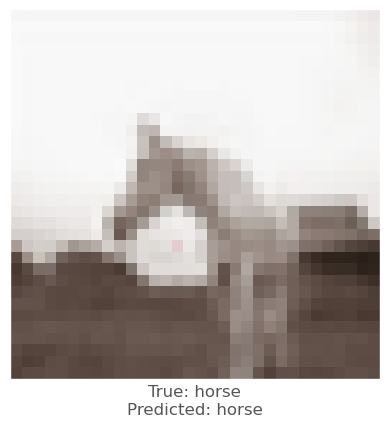



-0.0010287166
-0.0030375123
-0.0019848943
vr, vg, vb :   5.4453608052134514 4.929748175740243 1.9926874452233316
beam_perturbed_confidence temp :  0.5512398
beam_perturbed_confidence temp :  0.5447675
beam_perturbed_confidence temp :  0.54046917
beam_perturbed_confidence temp :  0.5536237
beam_perturbed_confidence temp :  0.55054885
beam_perturbed_confidence temp :  0.5445548
beam_perturbed_confidence temp :  0.5524482
row index :  2
5th round's confidence : 2th 0.54046917
predicted class :  horse
predicted class's confidence :  0.54046917
Lopt is :  17


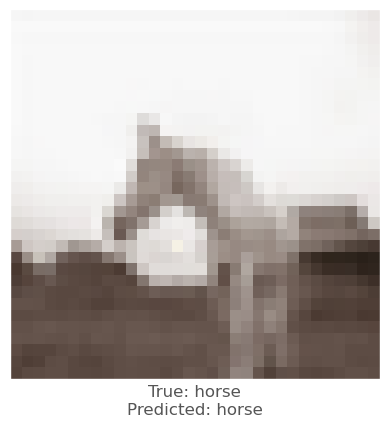



-0.00070250034
0.0050500035
0.00321728
vr, vg, vb :   1.5816346229314806 -2.408787343323231 -2.169918132185936
beam_perturbed_confidence temp :  0.5801396
beam_perturbed_confidence temp :  0.5683075
beam_perturbed_confidence temp :  0.57288116
beam_perturbed_confidence temp :  0.5688696
beam_perturbed_confidence temp :  0.57289
beam_perturbed_confidence temp :  0.5576742
beam_perturbed_confidence temp :  0.55823445
row index :  5
5th round's confidence : 3th 0.5576742
predicted class :  horse
predicted class's confidence :  0.5576742
Lopt is :  23


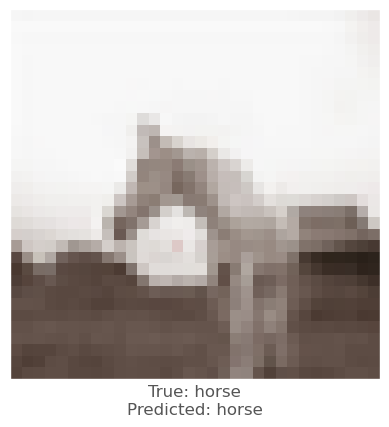



0.003485024
0.00095528364
0.00082176924
vr, vg, vb :   1.299015336930752 2.422801634013653 1.1761072124242782
beam_perturbed_confidence temp :  0.5375835
beam_perturbed_confidence temp :  0.53861696
beam_perturbed_confidence temp :  0.53637195
beam_perturbed_confidence temp :  0.54107094
beam_perturbed_confidence temp :  0.53871334
beam_perturbed_confidence temp :  0.5397265
beam_perturbed_confidence temp :  0.5414997
row index :  2
5th round's confidence : 4th 0.53637195
predicted class :  horse
predicted class's confidence :  0.53637195
Lopt is :  17


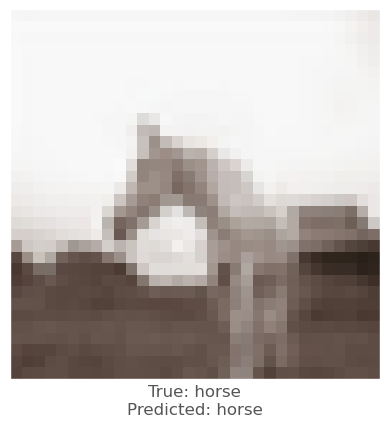



-0.006891072
0.008305728
0.00786221
vr, vg, vb :   1.7387942882835865 -4.770918457460404 -3.260840379911661
beam_perturbed_confidence temp :  0.56054807
beam_perturbed_confidence temp :  0.5499168
beam_perturbed_confidence temp :  0.55353194
beam_perturbed_confidence temp :  0.54496586
beam_perturbed_confidence temp :  0.5480907
beam_perturbed_confidence temp :  0.5457943
beam_perturbed_confidence temp :  0.54009134
row index :  6
6th round's confidence : 0th 0.54009134
predicted class :  horse
predicted class's confidence :  0.54009134
Lopt is :  25


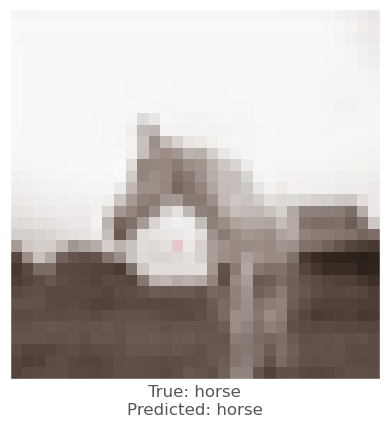



-0.008341312
0.0042486787
0.0041882396
vr, vg, vb :   2.6888553564906124 -2.968680078190565 -1.7908842856645586
beam_perturbed_confidence temp :  0.56406134
beam_perturbed_confidence temp :  0.56870085
beam_perturbed_confidence temp :  0.57029337
beam_perturbed_confidence temp :  0.5579079
beam_perturbed_confidence temp :  0.5600784
beam_perturbed_confidence temp :  0.56704956
beam_perturbed_confidence temp :  0.55723983
row index :  6
6th round's confidence : 1th 0.55723983
predicted class :  horse
predicted class's confidence :  0.55723983
Lopt is :  23


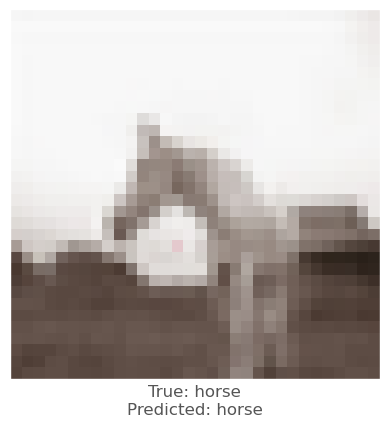



4.249811e-05
-0.0017148256
-0.0015218258
vr, vg, vb :   4.896574913519621 4.608255921185018 1.9456012797415259
beam_perturbed_confidence temp :  0.5491704
beam_perturbed_confidence temp :  0.5445548
beam_perturbed_confidence temp :  0.539944
beam_perturbed_confidence temp :  0.55273217
beam_perturbed_confidence temp :  0.54849154
beam_perturbed_confidence temp :  0.54431856
beam_perturbed_confidence temp :  0.55204093
row index :  2
6th round's confidence : 2th 0.539944
predicted class :  horse
predicted class's confidence :  0.539944
Lopt is :  17


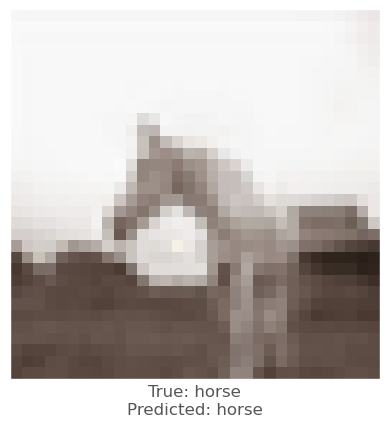



0.001141727
0.010941088
0.007389605
vr, vg, vb :   1.3092984635710718 -3.262017428952456 -2.691886823499203
beam_perturbed_confidence temp :  0.55823445
beam_perturbed_confidence temp :  0.53413635
beam_perturbed_confidence temp :  0.5457504
beam_perturbed_confidence temp :  0.5340055
beam_perturbed_confidence temp :  0.54509133
beam_perturbed_confidence temp :  0.521411
beam_perturbed_confidence temp :  0.51990896
row index :  6
6th round's confidence : 3th 0.51990896
predicted class :  horse
predicted class's confidence :  0.51990896
Lopt is :  27


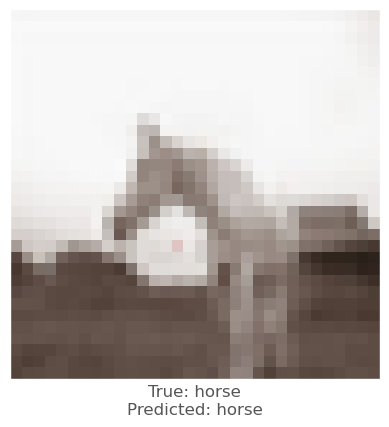



0.005112648
0.0027273893
0.0018167496
vr, vg, vb :   0.6578490022122863 1.907782537049055 0.8768215339064598
beam_perturbed_confidence temp :  0.53637195
beam_perturbed_confidence temp :  0.53800464
beam_perturbed_confidence temp :  0.53637195
beam_perturbed_confidence temp :  0.53800464
beam_perturbed_confidence temp :  0.53637195
beam_perturbed_confidence temp :  0.53800464
beam_perturbed_confidence temp :  0.53800464
row index :  0
6th round's confidence : 4th 0.53637195
predicted class :  horse
predicted class's confidence :  0.53637195
Lopt is :  17


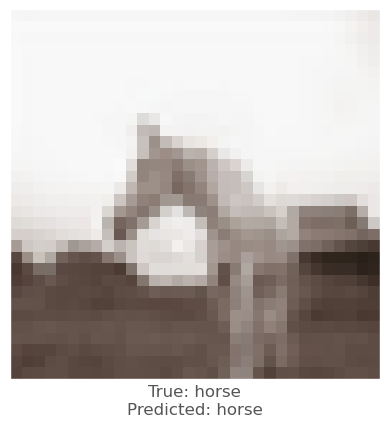



-0.011497617
0.0067457557
0.0045459867
vr, vg, vb :   2.714676536243558 -4.968402178959847 -3.389355007157922
beam_perturbed_confidence temp :  0.5295118
beam_perturbed_confidence temp :  0.5139263
beam_perturbed_confidence temp :  0.5285229
beam_perturbed_confidence temp :  0.5055684
beam_perturbed_confidence temp :  0.5171974
beam_perturbed_confidence temp :  0.50028986
beam_perturbed_confidence temp :  0.4932167
row index :  6
7th round's confidence : 0th 0.4932167
predicted class :  horse
predicted class's confidence :  0.4932167
Lopt is :  30


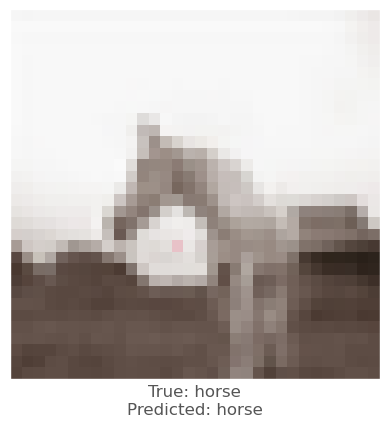




5th sensitive pixel
original confidence is :  0.69673544 

original r,g,b :  227 223 220
-0.015001118
-0.010359347
-0.009491026
vr, vg, vb :   1.5001118183135986 1.0359346866607666 0.9491026401519775
beam_perturbed_confidence temp :  0.688558
beam_perturbed_confidence temp :  0.69073445
beam_perturbed_confidence temp :  0.69673544
beam_perturbed_confidence temp :  0.68301916
beam_perturbed_confidence temp :  0.688558
beam_perturbed_confidence temp :  0.69073445
beam_perturbed_confidence temp :  0.68301916
row index :  3
0th round's confidence : 0th 0.68301916
predicted class :  horse
predicted class's confidence :  0.68301916
Lopt is :  1


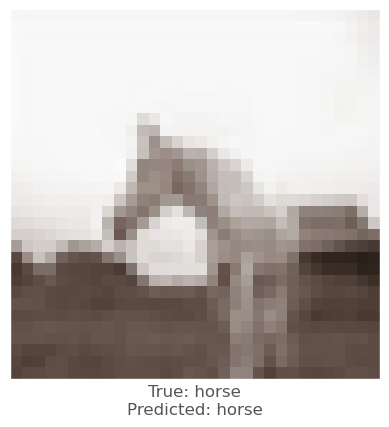



0.01515305
0.024670482
0.0056111217
vr, vg, vb :   -1.5153050422668457 -2.467048168182373 -0.5611121654510498
beam_perturbed_confidence temp :  0.6791383
beam_perturbed_confidence temp :  0.6481857
beam_perturbed_confidence temp :  0.69294363
beam_perturbed_confidence temp :  0.6307187
beam_perturbed_confidence temp :  0.6747511
beam_perturbed_confidence temp :  0.64231193
beam_perturbed_confidence temp :  0.62336713
row index :  6
0th round's confidence : 1th 0.62336713
predicted class :  horse
predicted class's confidence :  0.62336713
Lopt is :  8


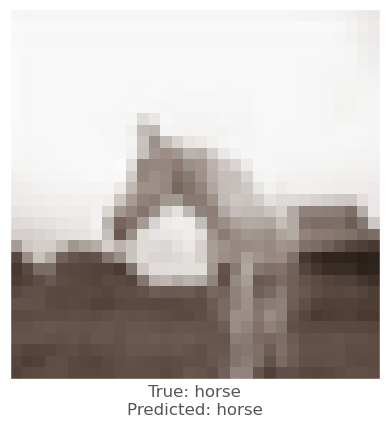



-0.010579228
-0.007375419
-0.007477522
vr, vg, vb :   1.0579228401184082 0.737541913986206 0.7477521896362305
beam_perturbed_confidence temp :  0.6066457
beam_perturbed_confidence temp :  0.61165696
beam_perturbed_confidence temp :  0.61165696
beam_perturbed_confidence temp :  0.6066457
beam_perturbed_confidence temp :  0.6066457
beam_perturbed_confidence temp :  0.61165696
beam_perturbed_confidence temp :  0.6066457
row index :  0
0th round's confidence : 2th 0.6066457
predicted class :  horse
predicted class's confidence :  0.6066457
Lopt is :  6


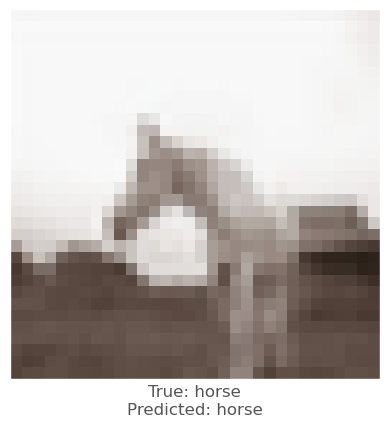



0.0019916296
0.011926889
1.2397766e-05
vr, vg, vb :   -0.19916296005249023 -1.1926889419555664 -0.001239776611328125
beam_perturbed_confidence temp :  0.5762665
beam_perturbed_confidence temp :  0.5644389
beam_perturbed_confidence temp :  0.5777054
beam_perturbed_confidence temp :  0.56302255
beam_perturbed_confidence temp :  0.57615757
beam_perturbed_confidence temp :  0.5641896
beam_perturbed_confidence temp :  0.56304526
row index :  3
0th round's confidence : 3th 0.56302255
predicted class :  horse
predicted class's confidence :  0.56302255
Lopt is :  12


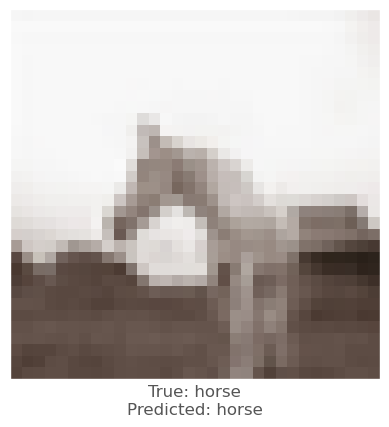



-0.0073875785
-0.005299747
-0.0051267743
vr, vg, vb :   0.738757848739624 0.5299746990203857 0.5126774311065674
beam_perturbed_confidence temp :  0.56677824
beam_perturbed_confidence temp :  0.56677824
beam_perturbed_confidence temp :  0.56677824
beam_perturbed_confidence temp :  0.56677824
beam_perturbed_confidence temp :  0.56677824
beam_perturbed_confidence temp :  0.56677824
beam_perturbed_confidence temp :  0.56677824
row index :  0
0th round's confidence : 4th 0.56677824
predicted class :  horse
predicted class's confidence :  0.56677824
Lopt is :  10


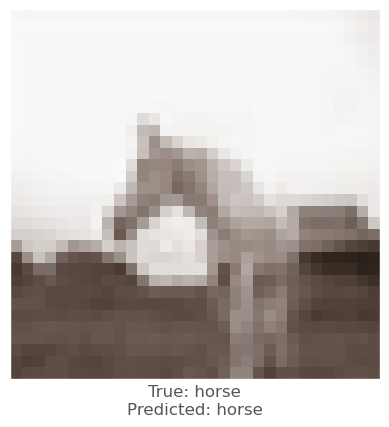



-0.014476478
-0.010089457
-0.008867145
vr, vg, vb :   2.7977484464645386 1.9412869215011597 1.740906834602356
beam_perturbed_confidence temp :  0.66951835
beam_perturbed_confidence temp :  0.6784685
beam_perturbed_confidence temp :  0.6789212
beam_perturbed_confidence temp :  0.66571456
beam_perturbed_confidence temp :  0.66552323
beam_perturbed_confidence temp :  0.67416257
beam_perturbed_confidence temp :  0.6617472
row index :  6
1th round's confidence : 0th 0.6617472
predicted class :  horse
predicted class's confidence :  0.6617472
Lopt is :  3


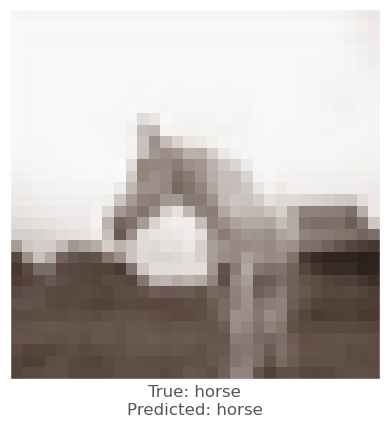



0.019281507
0.03818959
0.016328812
vr, vg, vb :   -3.2919251918792725 -6.039302349090576 -2.137882113456726
beam_perturbed_confidence temp :  0.59374857
beam_perturbed_confidence temp :  0.5431889
beam_perturbed_confidence temp :  0.6012365
beam_perturbed_confidence temp :  0.54354686
beam_perturbed_confidence temp :  0.5895454
beam_perturbed_confidence temp :  0.54479927
beam_perturbed_confidence temp :  0.5481437
row index :  1
1th round's confidence : 1th 0.5431889
predicted class :  horse
predicted class's confidence :  0.5431889
Lopt is :  15


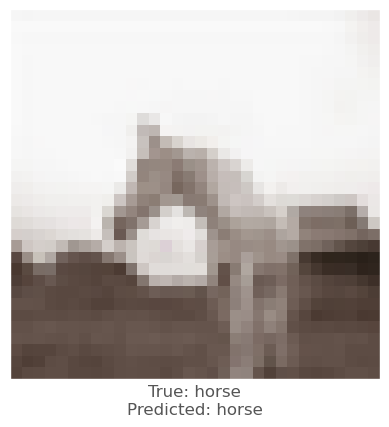



-0.00978601
-0.0054550767
-0.006677568
vr, vg, vb :   1.9307315349578857 1.209295392036438 1.3407337665557861
beam_perturbed_confidence temp :  0.60187095
beam_perturbed_confidence temp :  0.60405827
beam_perturbed_confidence temp :  0.6031429
beam_perturbed_confidence temp :  0.6000072
beam_perturbed_confidence temp :  0.59889454
beam_perturbed_confidence temp :  0.6009407
beam_perturbed_confidence temp :  0.5972731
row index :  6
1th round's confidence : 2th 0.5972731
predicted class :  horse
predicted class's confidence :  0.5972731
Lopt is :  7


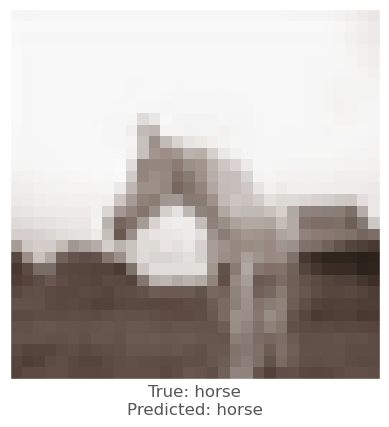



0.0028760433
0.012547672
8.881092e-06
vr, vg, vb :   -0.46685099601745605 -2.3281872272491455 -0.002003908157348633
beam_perturbed_confidence temp :  0.56156284
beam_perturbed_confidence temp :  0.5495707
beam_perturbed_confidence temp :  0.56304526
beam_perturbed_confidence temp :  0.5474434
beam_perturbed_confidence temp :  0.56149477
beam_perturbed_confidence temp :  0.55058485
beam_perturbed_confidence temp :  0.5483605
row index :  3
1th round's confidence : 3th 0.5474434
predicted class :  horse
predicted class's confidence :  0.5474434
Lopt is :  15


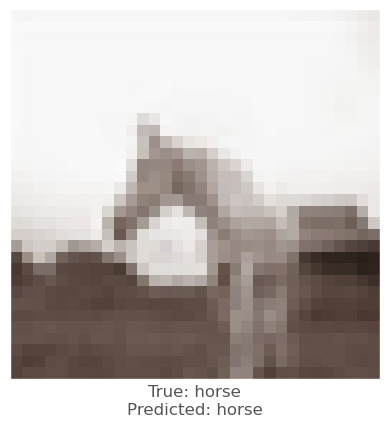



-0.0073875785
-0.005299747
-0.0051267743
vr, vg, vb :   1.4036399126052856 1.006951928138733 0.974087119102478
beam_perturbed_confidence temp :  0.5628368
beam_perturbed_confidence temp :  0.5638292
beam_perturbed_confidence temp :  0.56677824
beam_perturbed_confidence temp :  0.5599285
beam_perturbed_confidence temp :  0.5628368
beam_perturbed_confidence temp :  0.5638292
beam_perturbed_confidence temp :  0.5599285
row index :  3
1th round's confidence : 4th 0.5599285
predicted class :  horse
predicted class's confidence :  0.5599285
Lopt is :  11


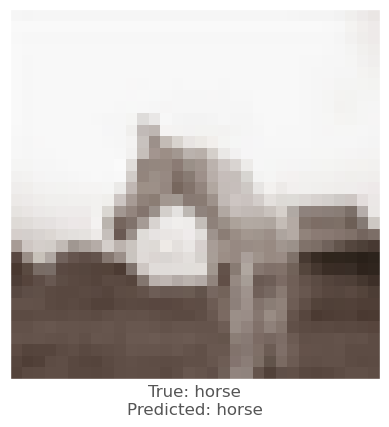



-0.012405753
-0.008682847
-0.008380711
vr, vg, vb :   3.7585489153862 2.615442931652069 2.4048872590065002
beam_perturbed_confidence temp :  0.63672537
beam_perturbed_confidence temp :  0.6513458
beam_perturbed_confidence temp :  0.6526284
beam_perturbed_confidence temp :  0.62490135
beam_perturbed_confidence temp :  0.6264513
beam_perturbed_confidence temp :  0.63989496
beam_perturbed_confidence temp :  0.6167269
row index :  6
2th round's confidence : 0th 0.6167269
predicted class :  horse
predicted class's confidence :  0.6167269
Lopt is :  6


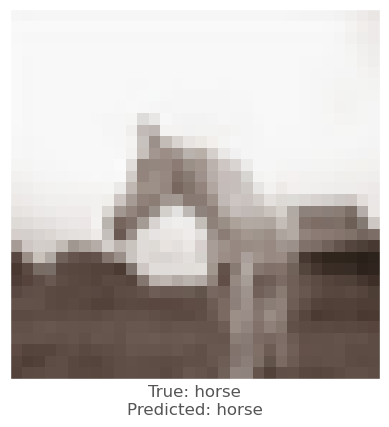



-0.00041270256
0.015261054
0.00027298927
vr, vg, vb :   -2.9214624166488647 -6.961477518081665 -1.9513928294181824
beam_perturbed_confidence temp :  0.5452872
beam_perturbed_confidence temp :  0.50917816
beam_perturbed_confidence temp :  0.5439749
beam_perturbed_confidence temp :  0.5082879
beam_perturbed_confidence temp :  0.54681355
beam_perturbed_confidence temp :  0.5129359
beam_perturbed_confidence temp :  0.5120696
row index :  3
2th round's confidence : 1th 0.5082879
predicted class :  horse
predicted class's confidence :  0.5082879
Lopt is :  22


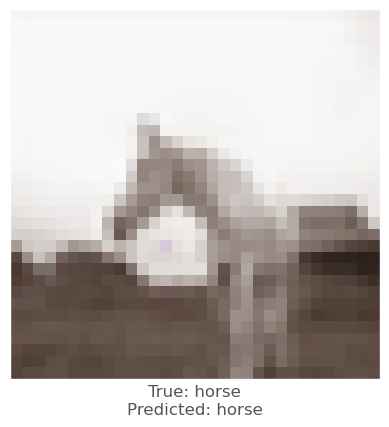



-0.006434083
-0.0027801394
-0.0049901605
vr, vg, vb :   2.381066679954529 1.3663797974586487 1.7056764364242554
beam_perturbed_confidence temp :  0.58923656
beam_perturbed_confidence temp :  0.5961144
beam_perturbed_confidence temp :  0.595017
beam_perturbed_confidence temp :  0.5876138
beam_perturbed_confidence temp :  0.586579
beam_perturbed_confidence temp :  0.59352726
beam_perturbed_confidence temp :  0.5851335
row index :  6
2th round's confidence : 2th 0.5851335
predicted class :  horse
predicted class's confidence :  0.5851335
Lopt is :  9


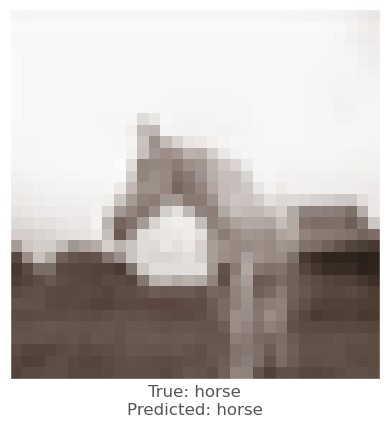



0.005384922
0.009768069
-0.0022181273
vr, vg, vb :   -0.9586580991744995 -3.07217538356781 0.2200092077255249
beam_perturbed_confidence temp :  0.54418576
beam_perturbed_confidence temp :  0.5277218
beam_perturbed_confidence temp :  0.5474434
beam_perturbed_confidence temp :  0.526046
beam_perturbed_confidence temp :  0.54418576
beam_perturbed_confidence temp :  0.5277218
beam_perturbed_confidence temp :  0.526046
row index :  3
2th round's confidence : 3th 0.526046
predicted class :  horse
predicted class's confidence :  0.526046
Lopt is :  19


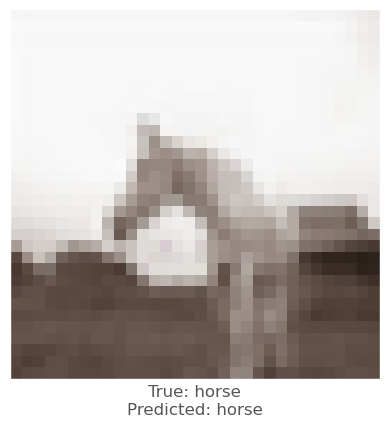



-0.008431554
-0.0059862733
-0.0070661306
vr, vg, vb :   2.106431305408478 1.5048840641975403 1.583291471004486
beam_perturbed_confidence temp :  0.5512912
beam_perturbed_confidence temp :  0.55685055
beam_perturbed_confidence temp :  0.5559741
beam_perturbed_confidence temp :  0.55018413
beam_perturbed_confidence temp :  0.548369
beam_perturbed_confidence temp :  0.5536106
beam_perturbed_confidence temp :  0.54729265
row index :  6
2th round's confidence : 4th 0.54729265
predicted class :  horse
predicted class's confidence :  0.54729265
Lopt is :  13


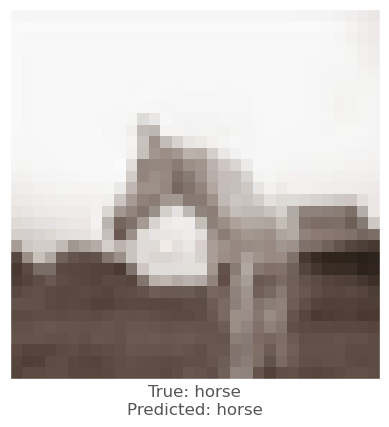



-0.012882113
-0.0083011985
-0.0075451136
vr, vg, vb :   4.670905369520188 3.184018486738205 2.91890988945961
beam_perturbed_confidence temp :  0.5957138
beam_perturbed_confidence temp :  0.60833865
beam_perturbed_confidence temp :  0.60951334
beam_perturbed_confidence temp :  0.5893865
beam_perturbed_confidence temp :  0.59002745
beam_perturbed_confidence temp :  0.6019917
beam_perturbed_confidence temp :  0.5856055
row index :  6
3th round's confidence : 0th 0.5856055
predicted class :  horse
predicted class's confidence :  0.5856055
Lopt is :  10


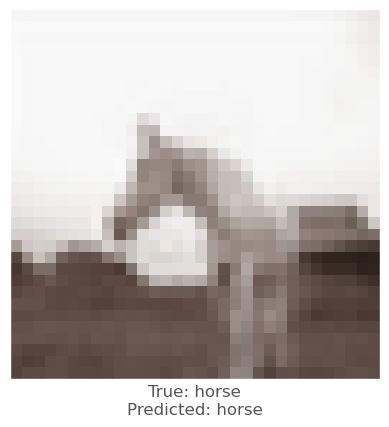



0.0020506382
0.010710895
-0.0040456653
vr, vg, vb :   -2.834379994869232 -7.33641927242279 -1.3516870200634004
beam_perturbed_confidence temp :  0.50371546
beam_perturbed_confidence temp :  0.4604996
beam_perturbed_confidence temp :  0.5120696
beam_perturbed_confidence temp :  0.4573953
beam_perturbed_confidence temp :  0.5099425
beam_perturbed_confidence temp :  0.4609968
beam_perturbed_confidence temp :  0.45684204
row index :  6
3th round's confidence : 1th 0.45684204
predicted class :  airplane
predicted class's confidence :  0.53532505
Lopt is :  30


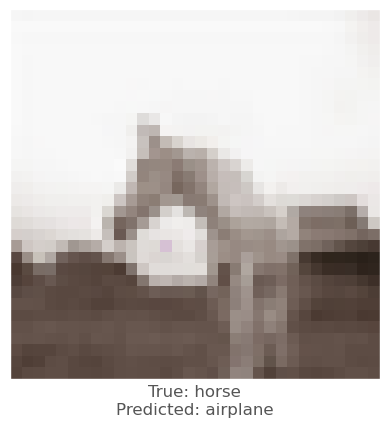




6th sensitive pixel
original confidence is :  0.69673544 

original r,g,b :  215 208 206
-0.010777235
-0.019305885
-0.011235952
vr, vg, vb :   1.077723503112793 1.9305884838104248 1.1235952377319336
beam_perturbed_confidence temp :  0.6916381
beam_perturbed_confidence temp :  0.6877201
beam_perturbed_confidence temp :  0.6912486
beam_perturbed_confidence temp :  0.6824707
beam_perturbed_confidence temp :  0.6862175
beam_perturbed_confidence temp :  0.6825991
beam_perturbed_confidence temp :  0.6775951
row index :  6
0th round's confidence : 0th 0.6775951
predicted class :  horse
predicted class's confidence :  0.6775951
Lopt is :  1


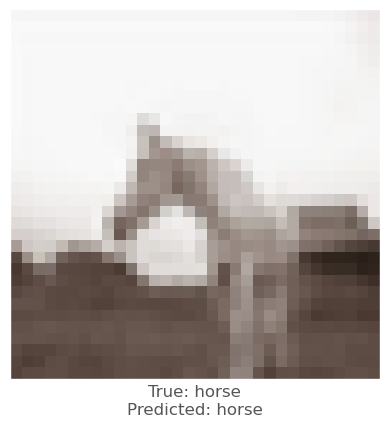



-0.009354413
-0.013632476
-0.0077114105
vr, vg, vb :   0.935441255569458 1.3632476329803467 0.7711410522460938
beam_perturbed_confidence temp :  0.7732156
beam_perturbed_confidence temp :  0.76653904
beam_perturbed_confidence temp :  0.7732156
beam_perturbed_confidence temp :  0.76653904
beam_perturbed_confidence temp :  0.7732156
beam_perturbed_confidence temp :  0.76653904
beam_perturbed_confidence temp :  0.76653904
row index :  1
0th round's confidence : 1th 0.76653904
predicted class :  horse
predicted class's confidence :  0.76653904
Lopt is :  5


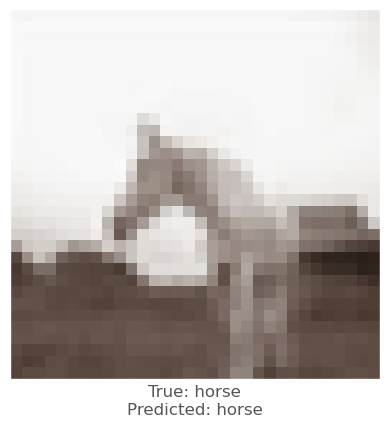



-0.0033047795
-0.00788486
-0.0029020905
vr, vg, vb :   0.3304779529571533 0.7884860038757324 0.2902090549468994
beam_perturbed_confidence temp :  0.61999667
beam_perturbed_confidence temp :  0.61999667
beam_perturbed_confidence temp :  0.61999667
beam_perturbed_confidence temp :  0.61999667
beam_perturbed_confidence temp :  0.61999667
beam_perturbed_confidence temp :  0.61999667
beam_perturbed_confidence temp :  0.61999667
row index :  0
0th round's confidence : 2th 0.61999667
predicted class :  horse
predicted class's confidence :  0.61999667
Lopt is :  5


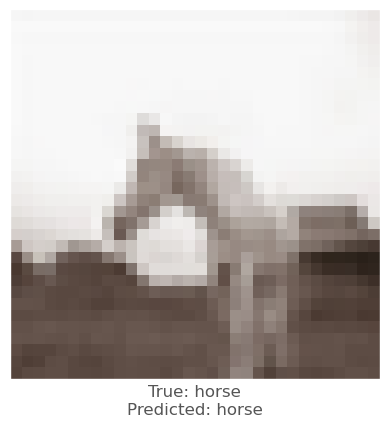



-0.0036011338
-0.004081607
-0.0043779016
vr, vg, vb :   0.36011338233947754 0.4081606864929199 0.4377901554107666
beam_perturbed_confidence temp :  0.8233887
beam_perturbed_confidence temp :  0.8233887
beam_perturbed_confidence temp :  0.8233887
beam_perturbed_confidence temp :  0.8233887
beam_perturbed_confidence temp :  0.8233887
beam_perturbed_confidence temp :  0.8233887
beam_perturbed_confidence temp :  0.8233887
row index :  0
0th round's confidence : 3th 0.8233887
predicted class :  horse
predicted class's confidence :  0.8233887
Lopt is :  10


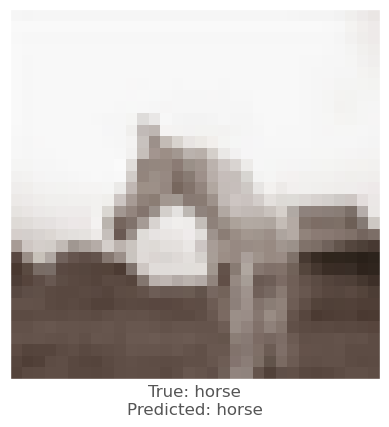



0.004707277
-0.0007535219
0.0020440817
vr, vg, vb :   -0.47072768211364746 0.07535219192504883 -0.2044081687927246
beam_perturbed_confidence temp :  0.6030696
beam_perturbed_confidence temp :  0.6052378
beam_perturbed_confidence temp :  0.6042881
beam_perturbed_confidence temp :  0.6030696
beam_perturbed_confidence temp :  0.6019262
beam_perturbed_confidence temp :  0.6042881
beam_perturbed_confidence temp :  0.6019262
row index :  4
0th round's confidence : 4th 0.6019262
predicted class :  horse
predicted class's confidence :  0.6019262
Lopt is :  10


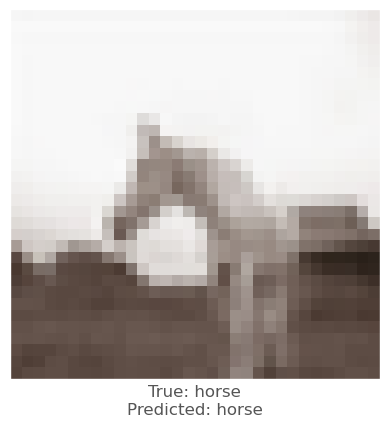



-0.009889185
-0.016462684
-0.009507
vr, vg, vb :   1.9588696956634521 3.3837980031967163 1.9619357585906982
beam_perturbed_confidence temp :  0.67270994
beam_perturbed_confidence temp :  0.6511436
beam_perturbed_confidence temp :  0.6729637
beam_perturbed_confidence temp :  0.6454665
beam_perturbed_confidence temp :  0.6679495
beam_perturbed_confidence temp :  0.645167
beam_perturbed_confidence temp :  0.64039606
row index :  6
1th round's confidence : 0th 0.64039606
predicted class :  horse
predicted class's confidence :  0.64039606
Lopt is :  4


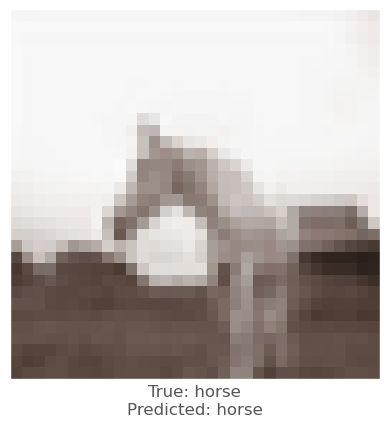



-0.008795977
-0.013049066
-0.007263124
vr, vg, vb :   1.7214947938919067 2.5318294763565063 1.4203393459320068
beam_perturbed_confidence temp :  0.7623551
beam_perturbed_confidence temp :  0.7534946
beam_perturbed_confidence temp :  0.7629505
beam_perturbed_confidence temp :  0.7502059
beam_perturbed_confidence temp :  0.75884676
beam_perturbed_confidence temp :  0.74998033
beam_perturbed_confidence temp :  0.7466449
row index :  6
1th round's confidence : 1th 0.7466449
predicted class :  horse
predicted class's confidence :  0.7466449
Lopt is :  4


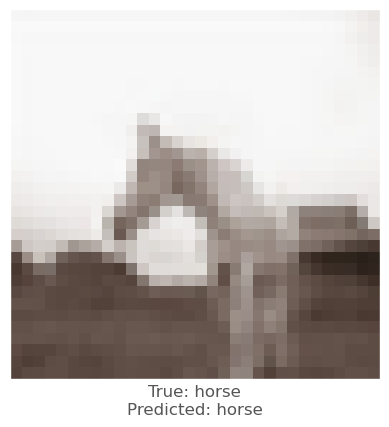



-0.0033047795
-0.00788486
-0.0029020905
vr, vg, vb :   0.6279081106185913 1.4981234073638916 0.5513972043991089
beam_perturbed_confidence temp :  0.61999667
beam_perturbed_confidence temp :  0.6152394
beam_perturbed_confidence temp :  0.61999667
beam_perturbed_confidence temp :  0.6152394
beam_perturbed_confidence temp :  0.61999667
beam_perturbed_confidence temp :  0.6152394
beam_perturbed_confidence temp :  0.6152394
row index :  1
1th round's confidence : 2th 0.6152394
predicted class :  horse
predicted class's confidence :  0.6152394
Lopt is :  6


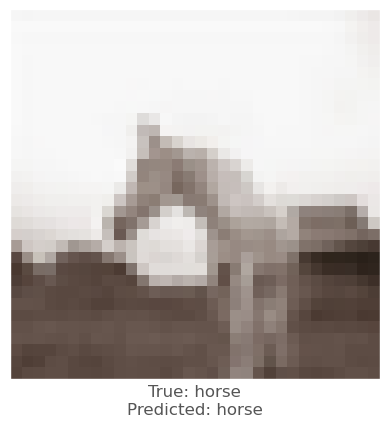



-0.0036011338
-0.004081607
-0.0043779016
vr, vg, vb :   0.6842154264450073 0.7755053043365479 0.8318012952804565
beam_perturbed_confidence temp :  0.8233887
beam_perturbed_confidence temp :  0.8233887
beam_perturbed_confidence temp :  0.8233887
beam_perturbed_confidence temp :  0.8233887
beam_perturbed_confidence temp :  0.8233887
beam_perturbed_confidence temp :  0.8233887
beam_perturbed_confidence temp :  0.8233887
row index :  0
1th round's confidence : 3th 0.8233887
predicted class :  horse
predicted class's confidence :  0.8233887
Lopt is :  10


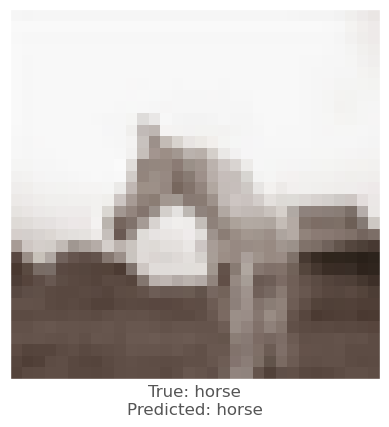



0.0046113133
-0.0004413724
0.0021941066
vr, vg, vb :   -0.8847862482070923 0.1119542121887207 -0.4033780097961426
beam_perturbed_confidence temp :  0.5996768
beam_perturbed_confidence temp :  0.6019262
beam_perturbed_confidence temp :  0.6008755
beam_perturbed_confidence temp :  0.5996768
beam_perturbed_confidence temp :  0.59954697
beam_perturbed_confidence temp :  0.6008755
beam_perturbed_confidence temp :  0.59954697
row index :  4
1th round's confidence : 4th 0.59954697
predicted class :  horse
predicted class's confidence :  0.59954697
Lopt is :  10


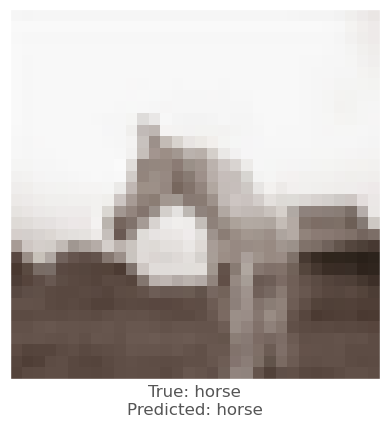



-0.00790745
-0.01504004
-0.009410322
vr, vg, vb :   2.5537277460098267 4.549422204494476 2.706774353981018
beam_perturbed_confidence temp :  0.6346254
beam_perturbed_confidence temp :  0.6164549
beam_perturbed_confidence temp :  0.6322517
beam_perturbed_confidence temp :  0.61208147
beam_perturbed_confidence temp :  0.6273447
beam_perturbed_confidence temp :  0.6123246
beam_perturbed_confidence temp :  0.608183
row index :  6
2th round's confidence : 0th 0.608183
predicted class :  horse
predicted class's confidence :  0.608183
Lopt is :  8


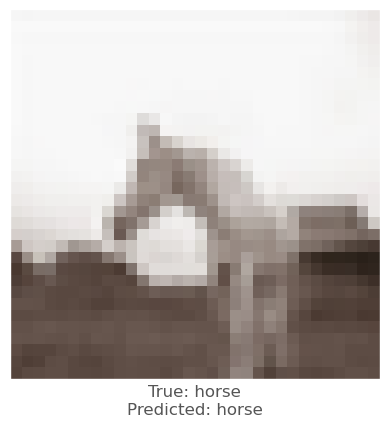



-0.0066429377
-0.013154328
-0.007257819
vr, vg, vb :   2.2136390805244446 3.594079315662384 2.0040873289108276
beam_perturbed_confidence temp :  0.74005175
beam_perturbed_confidence temp :  0.72699237
beam_perturbed_confidence temp :  0.73909104
beam_perturbed_confidence temp :  0.71952736
beam_perturbed_confidence temp :  0.7326272
beam_perturbed_confidence temp :  0.7195004
beam_perturbed_confidence temp :  0.7096747
row index :  6
2th round's confidence : 1th 0.7096747
predicted class :  horse
predicted class's confidence :  0.7096747
Lopt is :  2


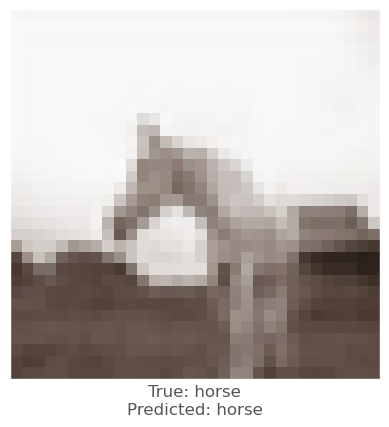



-0.003897071
-0.009461641
-0.0031289458
vr, vg, vb :   0.9548243880271912 2.2944751977920532 0.8091520667076111
beam_perturbed_confidence temp :  0.6152394
beam_perturbed_confidence temp :  0.60723376
beam_perturbed_confidence temp :  0.6152394
beam_perturbed_confidence temp :  0.60723376
beam_perturbed_confidence temp :  0.6152394
beam_perturbed_confidence temp :  0.60723376
beam_perturbed_confidence temp :  0.60723376
row index :  1
2th round's confidence : 2th 0.60723376
predicted class :  horse
predicted class's confidence :  0.60723376
Lopt is :  8


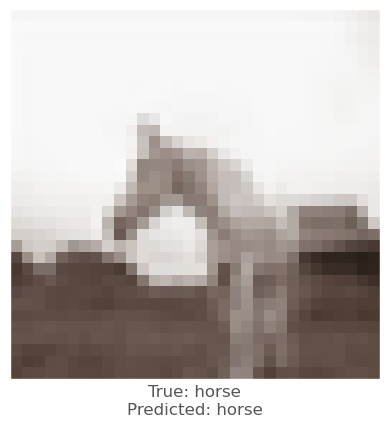



-0.0036011338
-0.004081607
-0.0043779016
vr, vg, vb :   0.9759072661399841 1.106115460395813 1.1864113211631775
beam_perturbed_confidence temp :  0.8233887
beam_perturbed_confidence temp :  0.8212153
beam_perturbed_confidence temp :  0.8211721
beam_perturbed_confidence temp :  0.8212153
beam_perturbed_confidence temp :  0.8211721
beam_perturbed_confidence temp :  0.8188847
beam_perturbed_confidence temp :  0.8188847
row index :  5
2th round's confidence : 3th 0.8188847
predicted class :  horse
predicted class's confidence :  0.8188847
Lopt is :  10


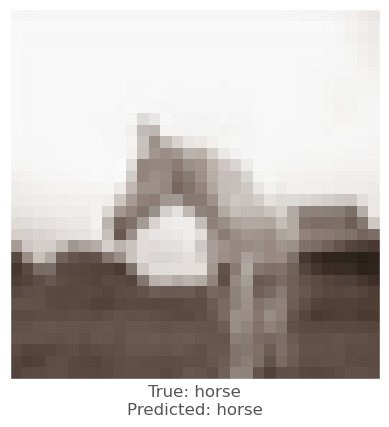



0.001696825
-0.0024732351
0.00060880184
vr, vg, vb :   -0.9659901261329651 0.3480823040008545 -0.4239203929901123
beam_perturbed_confidence temp :  0.5991787
beam_perturbed_confidence temp :  0.59954697
beam_perturbed_confidence temp :  0.599068
beam_perturbed_confidence temp :  0.5991787
beam_perturbed_confidence temp :  0.5990495
beam_perturbed_confidence temp :  0.599068
beam_perturbed_confidence temp :  0.5990495
row index :  4
2th round's confidence : 4th 0.5990495
predicted class :  horse
predicted class's confidence :  0.5990495
Lopt is :  10


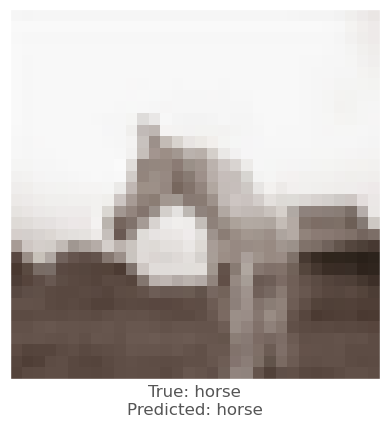



-0.002785027
-0.00876081
-0.003100276
vr, vg, vb :   2.576857674121857 4.970560973882676 2.7461245179176332
beam_perturbed_confidence temp :  0.6072127
beam_perturbed_confidence temp :  0.5925378
beam_perturbed_confidence temp :  0.60725296
beam_perturbed_confidence temp :  0.5932912
beam_perturbed_confidence temp :  0.6053864
beam_perturbed_confidence temp :  0.5927801
beam_perturbed_confidence temp :  0.5940333
row index :  1
3th round's confidence : 0th 0.5925378
predicted class :  horse
predicted class's confidence :  0.5925378
Lopt is :  12


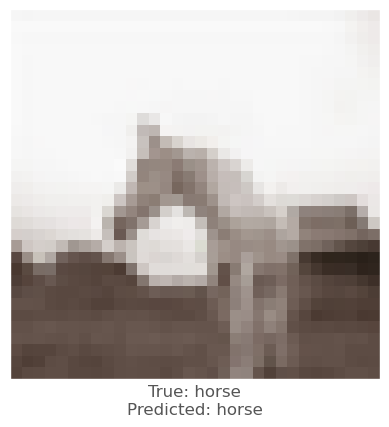



-0.011042535
-0.017232
-0.010242224
vr, vg, vb :   3.09652870297432 4.957871466875076 2.8279009699821476
beam_perturbed_confidence temp :  0.69357556
beam_perturbed_confidence temp :  0.6767452
beam_perturbed_confidence temp :  0.6992117
beam_perturbed_confidence temp :  0.65937
beam_perturbed_confidence temp :  0.6824707
beam_perturbed_confidence temp :  0.6651933
beam_perturbed_confidence temp :  0.6475593
row index :  6
3th round's confidence : 1th 0.6475593
predicted class :  horse
predicted class's confidence :  0.6475593
Lopt is :  5


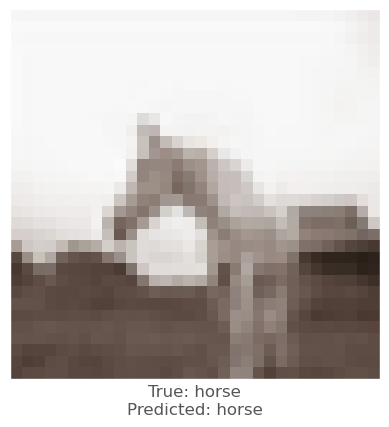



-0.0005573034
-0.007129967
-0.0012071729
vr, vg, vb :   0.9150722920894623 2.778024399280548 0.8489541471004486
beam_perturbed_confidence temp :  0.60723376
beam_perturbed_confidence temp :  0.5995439
beam_perturbed_confidence temp :  0.60723376
beam_perturbed_confidence temp :  0.5995439
beam_perturbed_confidence temp :  0.60723376
beam_perturbed_confidence temp :  0.5995439
beam_perturbed_confidence temp :  0.5995439
row index :  1
3th round's confidence : 2th 0.5995439
predicted class :  horse
predicted class's confidence :  0.5995439
Lopt is :  10


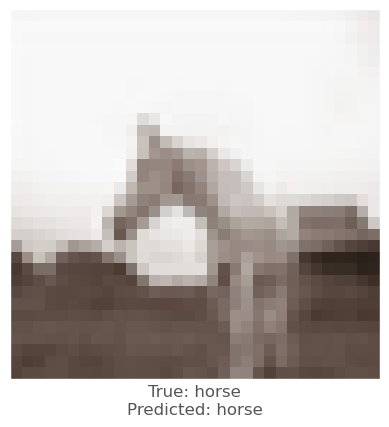



-0.0038287044
-0.0047163367
-0.0047000647
vr, vg, vb :   1.2611869752407074 1.4671375870704653 1.537776654958725
beam_perturbed_confidence temp :  0.81698793
beam_perturbed_confidence temp :  0.8164558
beam_perturbed_confidence temp :  0.8165152
beam_perturbed_confidence temp :  0.814353
beam_perturbed_confidence temp :  0.8143978
beam_perturbed_confidence temp :  0.8138486
beam_perturbed_confidence temp :  0.81170756
row index :  6
3th round's confidence : 3th 0.81170756
predicted class :  horse
predicted class's confidence :  0.81170756
Lopt is :  9


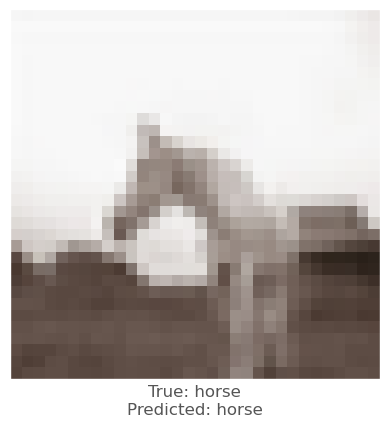



-0.00023019314
-0.004106939
0.00038313866
vr, vg, vb :   -0.8463717997074127 0.7239679574966431 -0.4198422193527222
beam_perturbed_confidence temp :  0.5992982
beam_perturbed_confidence temp :  0.5990495
beam_perturbed_confidence temp :  0.59879553
beam_perturbed_confidence temp :  0.5992982
beam_perturbed_confidence temp :  0.59912604
beam_perturbed_confidence temp :  0.59879553
beam_perturbed_confidence temp :  0.59912604
row index :  2
3th round's confidence : 4th 0.59879553
predicted class :  horse
predicted class's confidence :  0.59879553
Lopt is :  10


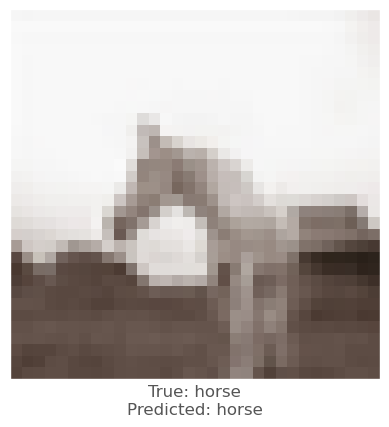



0.00011432171
-0.0068321824
-5.298853e-05
vr, vg, vb :   2.3077397358417513 5.156723117232323 2.476810919046402
beam_perturbed_confidence temp :  0.5932912
beam_perturbed_confidence temp :  0.5838619
beam_perturbed_confidence temp :  0.5927801
beam_perturbed_confidence temp :  0.5877611
beam_perturbed_confidence temp :  0.5940333
beam_perturbed_confidence temp :  0.585528
beam_perturbed_confidence temp :  0.5896931
row index :  1
4th round's confidence : 0th 0.5838619
predicted class :  horse
predicted class's confidence :  0.5838619
Lopt is :  17


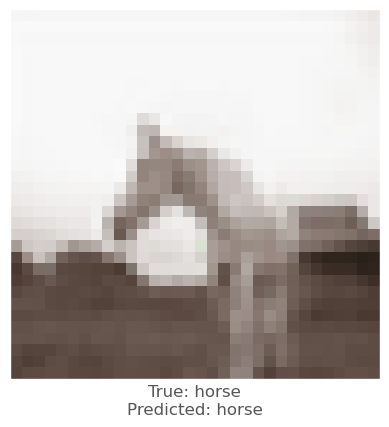



-0.01063025
-0.0181216
-0.011534095
vr, vg, vb :   3.8499008303880697 6.27424433529377 3.698520354032517
beam_perturbed_confidence temp :  0.63652486
beam_perturbed_confidence temp :  0.6058108
beam_perturbed_confidence temp :  0.63247377
beam_perturbed_confidence temp :  0.5999967
beam_perturbed_confidence temp :  0.6243014
beam_perturbed_confidence temp :  0.60102105
beam_perturbed_confidence temp :  0.597316
row index :  6
4th round's confidence : 1th 0.597316
predicted class :  horse
predicted class's confidence :  0.597316
Lopt is :  11


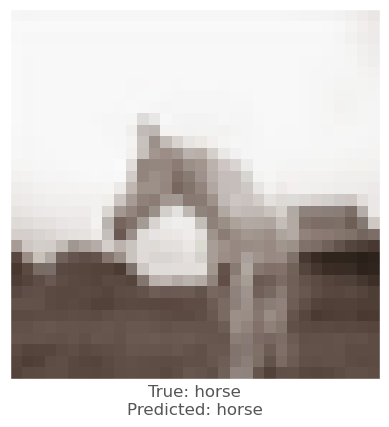



-0.0013734102
-0.0071920753
-0.0006053448
vr, vg, vb :   0.9609060853719712 3.219429484605789 0.8245932096242905
beam_perturbed_confidence temp :  0.5995439
beam_perturbed_confidence temp :  0.59054
beam_perturbed_confidence temp :  0.5995439
beam_perturbed_confidence temp :  0.59054
beam_perturbed_confidence temp :  0.5995439
beam_perturbed_confidence temp :  0.59054
beam_perturbed_confidence temp :  0.59054
row index :  1
4th round's confidence : 2th 0.59054
predicted class :  horse
predicted class's confidence :  0.59054
Lopt is :  13


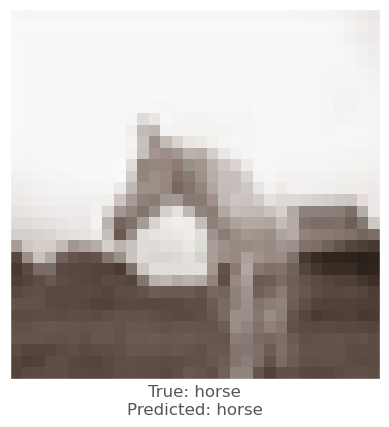



-0.004808247
-0.0060290694
-0.005474508
vr, vg, vb :   1.6158929866552354 1.9233307707309726 1.9314497703313829
beam_perturbed_confidence temp :  0.80904037
beam_perturbed_confidence temp :  0.80836874
beam_perturbed_confidence temp :  0.8088785
beam_perturbed_confidence temp :  0.806056
beam_perturbed_confidence temp :  0.80632174
beam_perturbed_confidence temp :  0.8055677
beam_perturbed_confidence temp :  0.80347425
row index :  6
4th round's confidence : 3th 0.80347425
predicted class :  horse
predicted class's confidence :  0.80347425
Lopt is :  8


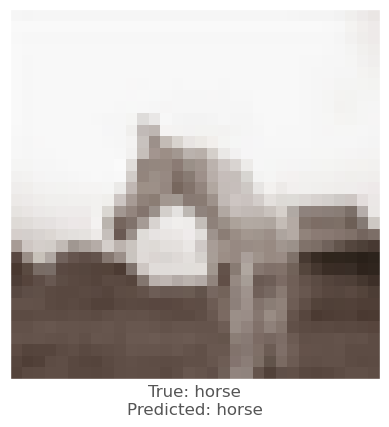



-0.0004362464
-0.0043656826
0.0004876852
vr, vg, vb :   -0.718109980225563 1.08813942193985 -0.4266265177726746
beam_perturbed_confidence temp :  0.59912604
beam_perturbed_confidence temp :  0.5967106
beam_perturbed_confidence temp :  0.5985618
beam_perturbed_confidence temp :  0.5964036
beam_perturbed_confidence temp :  0.5989288
beam_perturbed_confidence temp :  0.596416
beam_perturbed_confidence temp :  0.5961554
row index :  6
4th round's confidence : 4th 0.5961554
predicted class :  horse
predicted class's confidence :  0.5961554
Lopt is :  11


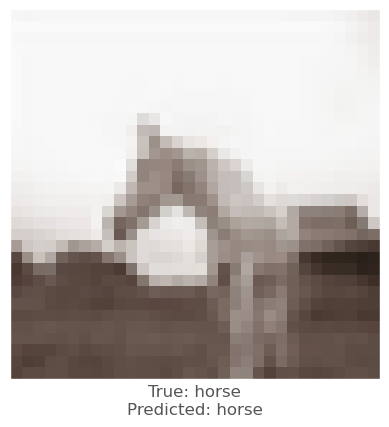



0.003866911
-0.001977384
0.0016291738
vr, vg, vb :   1.690274668812752 4.838789214551449 2.066212451577187
beam_perturbed_confidence temp :  0.5857051
beam_perturbed_confidence temp :  0.5792097
beam_perturbed_confidence temp :  0.585528
beam_perturbed_confidence temp :  0.5812397
beam_perturbed_confidence temp :  0.5878845
beam_perturbed_confidence temp :  0.5815916
beam_perturbed_confidence temp :  0.5839552
row index :  1
5th round's confidence : 0th 0.5792097
predicted class :  horse
predicted class's confidence :  0.5792097
Lopt is :  21


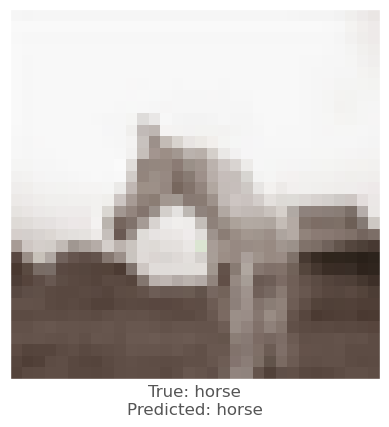



-0.0021908283
-0.00952971
-0.00202322
vr, vg, vb :   3.6839935796856884 6.599790883362293 3.530990324854851
beam_perturbed_confidence temp :  0.5961106
beam_perturbed_confidence temp :  0.5828539
beam_perturbed_confidence temp :  0.5957962
beam_perturbed_confidence temp :  0.58904034
beam_perturbed_confidence temp :  0.5967106
beam_perturbed_confidence temp :  0.585528
beam_perturbed_confidence temp :  0.5911266
row index :  1
5th round's confidence : 1th 0.5828539
predicted class :  horse
predicted class's confidence :  0.5828539
Lopt is :  17


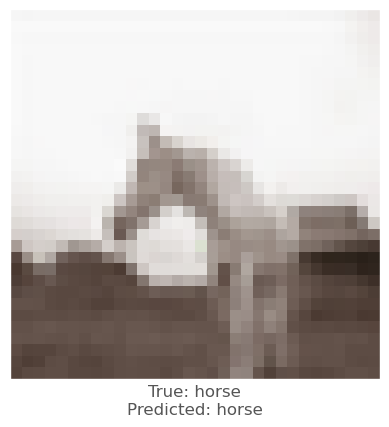



0.0017634034
-0.0040504932
0.0012551546
vr, vg, vb :   0.688475135266781 3.3025358601808548 0.6166184276938439
beam_perturbed_confidence temp :  0.59054
beam_perturbed_confidence temp :  0.5876136
beam_perturbed_confidence temp :  0.59054
beam_perturbed_confidence temp :  0.5876136
beam_perturbed_confidence temp :  0.59054
beam_perturbed_confidence temp :  0.5876136
beam_perturbed_confidence temp :  0.5876136
row index :  1
5th round's confidence : 2th 0.5876136
predicted class :  horse
predicted class's confidence :  0.5876136
Lopt is :  16


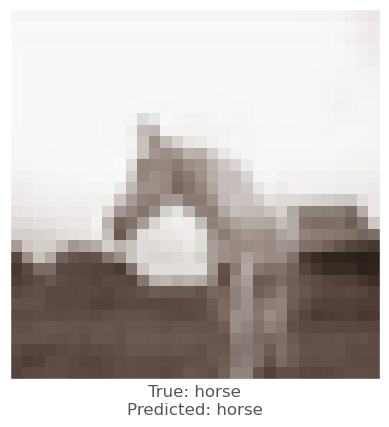



-0.004835129
-0.007225573
-0.005368948
vr, vg, vb :   1.9378165664076807 2.4535549999475483 2.2751995915770533
beam_perturbed_confidence temp :  0.80073255
beam_perturbed_confidence temp :  0.79319346
beam_perturbed_confidence temp :  0.79771835
beam_perturbed_confidence temp :  0.7899023
beam_perturbed_confidence temp :  0.79478526
beam_perturbed_confidence temp :  0.7861675
beam_perturbed_confidence temp :  0.7824362
row index :  6
5th round's confidence : 3th 0.7824362
predicted class :  horse
predicted class's confidence :  0.7824362
Lopt is :  7


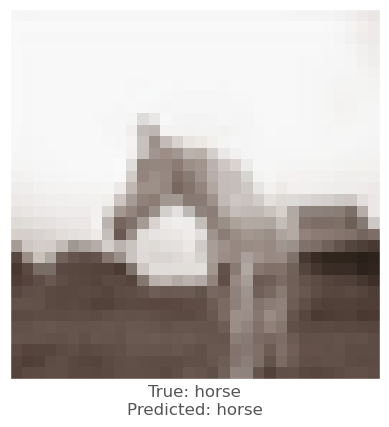



0.00020301342
-0.005380988
0.0003246069
vr, vg, vb :   -0.6666003242135048 1.5174242918491365 -0.41642455554008484
beam_perturbed_confidence temp :  0.596213
beam_perturbed_confidence temp :  0.5935478
beam_perturbed_confidence temp :  0.596079
beam_perturbed_confidence temp :  0.59304816
beam_perturbed_confidence temp :  0.5960281
beam_perturbed_confidence temp :  0.5932912
beam_perturbed_confidence temp :  0.5929942
row index :  6
5th round's confidence : 4th 0.5929942
predicted class :  horse
predicted class's confidence :  0.5929942
Lopt is :  12


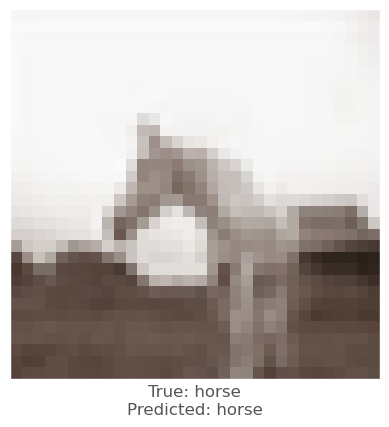



0.0040374994
-0.002836585
0.002564907
vr, vg, vb :   1.1174972591519357 4.638568797582388 1.6031004990220072
beam_perturbed_confidence temp :  0.5812397
beam_perturbed_confidence temp :  0.5743221
beam_perturbed_confidence temp :  0.5805084
beam_perturbed_confidence temp :  0.5790353
beam_perturbed_confidence temp :  0.58265364
beam_perturbed_confidence temp :  0.5756771
beam_perturbed_confidence temp :  0.5816713
row index :  1
6th round's confidence : 0th 0.5743221
predicted class :  horse
predicted class's confidence :  0.5743221
Lopt is :  25


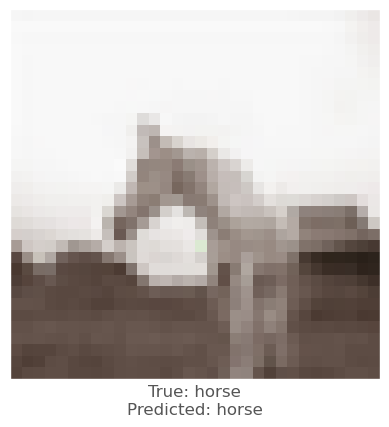



0.0038137436
-0.0019872785
0.0022694468
vr, vg, vb :   2.9342198625862603 6.138539641171694 2.950946607387066
beam_perturbed_confidence temp :  0.5866324
beam_perturbed_confidence temp :  0.5751449
beam_perturbed_confidence temp :  0.5844831
beam_perturbed_confidence temp :  0.5804493
beam_perturbed_confidence temp :  0.5887633
beam_perturbed_confidence temp :  0.57777166
beam_perturbed_confidence temp :  0.5829336
row index :  1
6th round's confidence : 1th 0.5751449
predicted class :  horse
predicted class's confidence :  0.5751449
Lopt is :  23


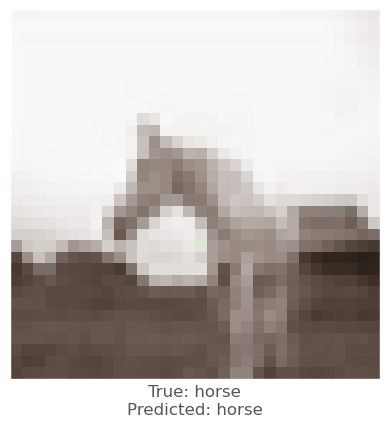



0.0035563111
-0.0014184117
0.0016806722
vr, vg, vb :   0.2639965086877347 3.1141234473347663 0.3868893680512906
beam_perturbed_confidence temp :  0.5876136
beam_perturbed_confidence temp :  0.58523023
beam_perturbed_confidence temp :  0.5876136
beam_perturbed_confidence temp :  0.58523023
beam_perturbed_confidence temp :  0.5876136
beam_perturbed_confidence temp :  0.58523023
beam_perturbed_confidence temp :  0.58523023
row index :  1
6th round's confidence : 2th 0.58523023
predicted class :  horse
predicted class's confidence :  0.58523023
Lopt is :  19


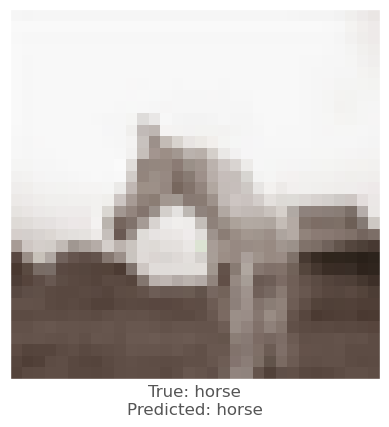



-0.008067548
-0.013225496
-0.007434666
vr, vg, vb :   2.550789737266302 3.5307490814805034 2.791146248096228
beam_perturbed_confidence temp :  0.7732156
beam_perturbed_confidence temp :  0.76150155
beam_perturbed_confidence temp :  0.77483666
beam_perturbed_confidence temp :  0.7534946
beam_perturbed_confidence temp :  0.76579577
beam_perturbed_confidence temp :  0.7538762
beam_perturbed_confidence temp :  0.74654216
row index :  6
6th round's confidence : 3th 0.74654216
predicted class :  horse
predicted class's confidence :  0.74654216
Lopt is :  5


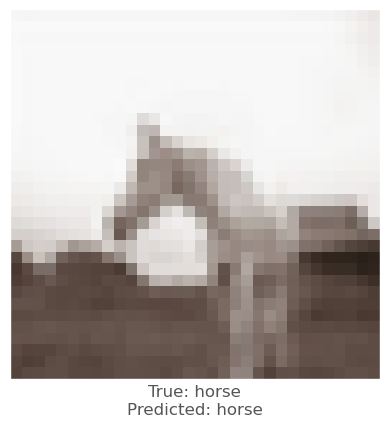



0.0007534027
-0.006021142
0.00013130903
vr, vg, vb :   -0.6752805627882481 1.9677960632562639 -0.3879130032300949
beam_perturbed_confidence temp :  0.5925378
beam_perturbed_confidence temp :  0.59000695
beam_perturbed_confidence temp :  0.59291685
beam_perturbed_confidence temp :  0.5896572
beam_perturbed_confidence temp :  0.5925063
beam_perturbed_confidence temp :  0.5898658
beam_perturbed_confidence temp :  0.5894269
row index :  6
6th round's confidence : 4th 0.5894269
predicted class :  horse
predicted class's confidence :  0.5894269
Lopt is :  13


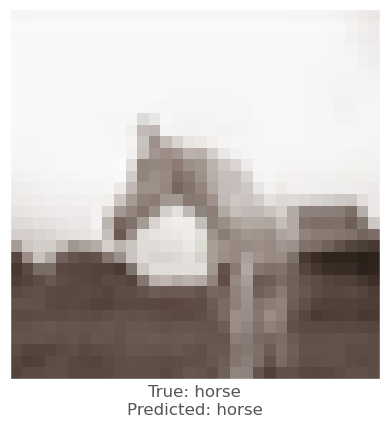



0.007443607
8.499622e-05
0.0026882887
vr, vg, vb :   0.2613868478882313 4.166212295479179 1.1739615802538397
beam_perturbed_confidence temp :  0.5743221
beam_perturbed_confidence temp :  0.58330894
beam_perturbed_confidence temp :  0.5756771
beam_perturbed_confidence temp :  0.58330894
beam_perturbed_confidence temp :  0.5756771
beam_perturbed_confidence temp :  0.58612376
beam_perturbed_confidence temp :  0.58612376
row index :  0
7th round's confidence : 0th 0.5743221
predicted class :  horse
predicted class's confidence :  0.5743221
Lopt is :  25


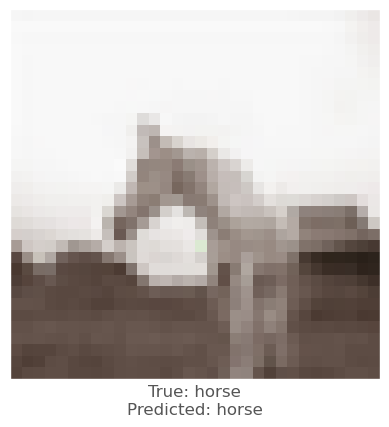



0.0043649673
-0.0026462674
0.00248307
vr, vg, vb :   2.204301141708494 5.789312418463827 2.4075449569785596
beam_perturbed_confidence temp :  0.5804493
beam_perturbed_confidence temp :  0.57794267
beam_perturbed_confidence temp :  0.57777166
beam_perturbed_confidence temp :  0.59227014
beam_perturbed_confidence temp :  0.5829336
beam_perturbed_confidence temp :  0.58377564
beam_perturbed_confidence temp :  0.5982065
row index :  2
7th round's confidence : 1th 0.57777166
predicted class :  horse
predicted class's confidence :  0.57777166
Lopt is :  23


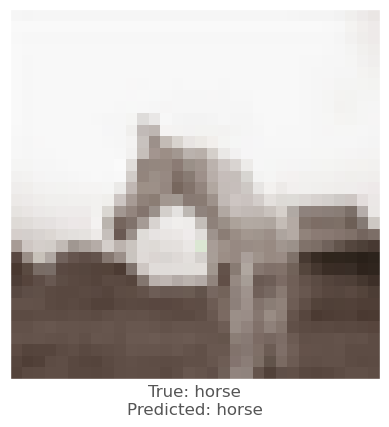



0.0037355423
-0.0022542477
0.0024562478
vr, vg, vb :   -0.13595737191736687 3.028135869141817 0.10257565059125434
beam_perturbed_confidence temp :  0.583047
beam_perturbed_confidence temp :  0.5815406
beam_perturbed_confidence temp :  0.58523023
beam_perturbed_confidence temp :  0.5792667
beam_perturbed_confidence temp :  0.583047
beam_perturbed_confidence temp :  0.5815406
beam_perturbed_confidence temp :  0.5792667
row index :  3
7th round's confidence : 2th 0.5792667
predicted class :  horse
predicted class's confidence :  0.5792667
Lopt is :  22


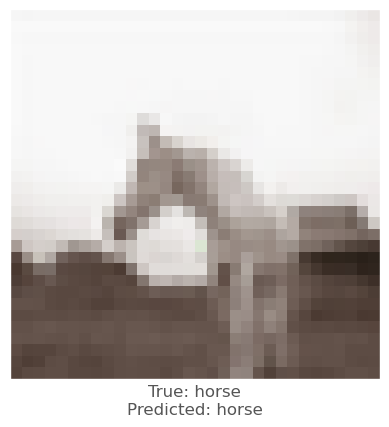



-0.0069103837
-0.013155758
-0.007006049
vr, vg, vb :   2.9867491336721184 4.493250011421442 3.212636538905502
beam_perturbed_confidence temp :  0.7396656
beam_perturbed_confidence temp :  0.72046524
beam_perturbed_confidence temp :  0.73510283
beam_perturbed_confidence temp :  0.7113577
beam_perturbed_confidence temp :  0.7286904
beam_perturbed_confidence temp :  0.70797205
beam_perturbed_confidence temp :  0.69666237
row index :  6
7th round's confidence : 3th 0.69666237
predicted class :  horse
predicted class's confidence :  0.69666237
Lopt is :  3


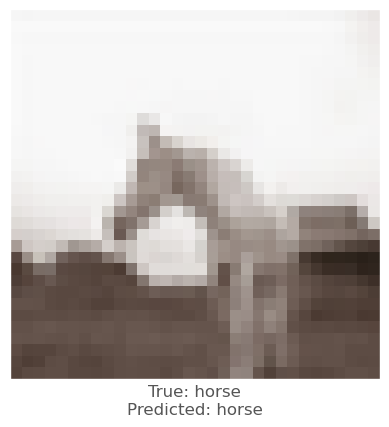



0.00021159649
-0.005743921
0.00016951561
vr, vg, vb :   -0.628912155404687 2.3454085372376445 -0.36607326388120653
beam_perturbed_confidence temp :  0.5896542
beam_perturbed_confidence temp :  0.5850397
beam_perturbed_confidence temp :  0.5894877
beam_perturbed_confidence temp :  0.58432263
beam_perturbed_confidence temp :  0.5901246
beam_perturbed_confidence temp :  0.58447146
beam_perturbed_confidence temp :  0.58366185
row index :  6
7th round's confidence : 4th 0.58366185
predicted class :  horse
predicted class's confidence :  0.58366185
Lopt is :  15


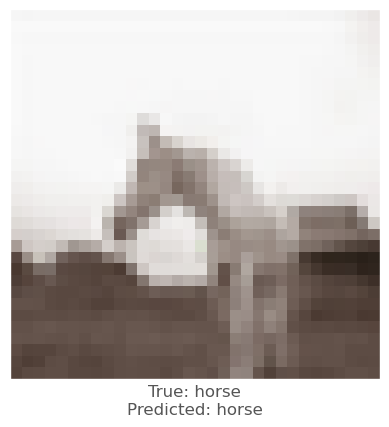



0.007443607
8.499622e-05
0.0026882887
vr, vg, vb :   -0.5091125222491025 3.7410914435862903 0.7877365533624889
beam_perturbed_confidence temp :  0.5715917
beam_perturbed_confidence temp :  0.58071417
beam_perturbed_confidence temp :  0.5743221
beam_perturbed_confidence temp :  0.5739239
beam_perturbed_confidence temp :  0.5715917
beam_perturbed_confidence temp :  0.58071417
beam_perturbed_confidence temp :  0.5739239
row index :  0
8th round's confidence : 0th 0.5715917
predicted class :  horse
predicted class's confidence :  0.5715917
Lopt is :  25


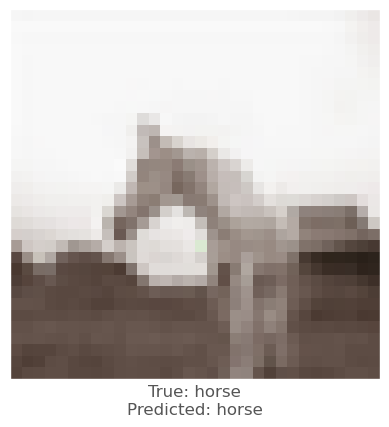



0.0052051544
-0.0026182532
0.0025084019
vr, vg, vb :   1.4633555856431133 5.4722064997223026 1.9159502742079497
beam_perturbed_confidence temp :  0.5805487
beam_perturbed_confidence temp :  0.58377564
beam_perturbed_confidence temp :  0.5790341
beam_perturbed_confidence temp :  0.59005773
beam_perturbed_confidence temp :  0.58129174
beam_perturbed_confidence temp :  0.586329
beam_perturbed_confidence temp :  0.5928974
row index :  2
8th round's confidence : 1th 0.5790341
predicted class :  horse
predicted class's confidence :  0.5790341
Lopt is :  23


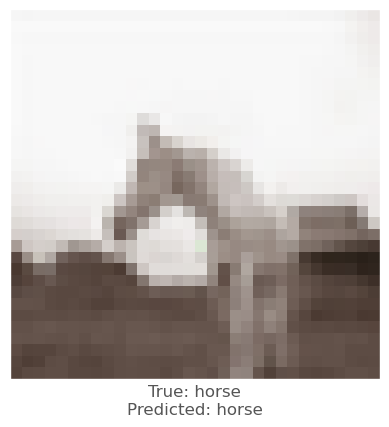



0.0046791434
-0.0027367473
0.0026571155
vr, vg, vb :   -0.5902759776058792 2.9989970087138413 -0.17339346041208498
beam_perturbed_confidence temp :  0.57686144
beam_perturbed_confidence temp :  0.5766485
beam_perturbed_confidence temp :  0.57791924
beam_perturbed_confidence temp :  0.5737367
beam_perturbed_confidence temp :  0.57547194
beam_perturbed_confidence temp :  0.5752661
beam_perturbed_confidence temp :  0.57264435
row index :  6
8th round's confidence : 2th 0.57264435
predicted class :  horse
predicted class's confidence :  0.57264435
Lopt is :  24


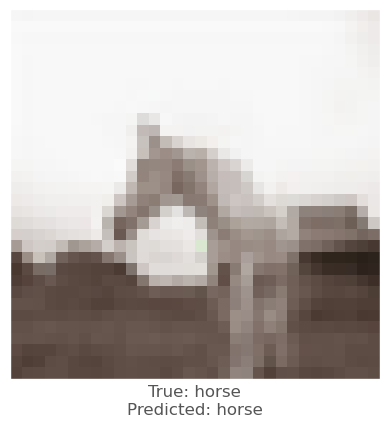



-0.010988891
-0.016722918
-0.010175943
vr, vg, vb :   3.786963332777441 5.716216765955568 3.9089672224783305
beam_perturbed_confidence temp :  0.6795862
beam_perturbed_confidence temp :  0.6514304
beam_perturbed_confidence temp :  0.6814973
beam_perturbed_confidence temp :  0.63419044
beam_perturbed_confidence temp :  0.66470957
beam_perturbed_confidence temp :  0.63526195
beam_perturbed_confidence temp :  0.62406135
row index :  6
8th round's confidence : 3th 0.62406135
predicted class :  horse
predicted class's confidence :  0.62406135
Lopt is :  7


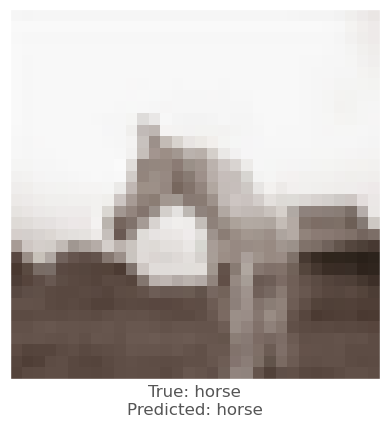



0.0009382963
-0.0043781996
0.0008279085
vr, vg, vb :   -0.6598505716696382 2.5486876412470343 -0.41225678908610347
beam_perturbed_confidence temp :  0.58353317
beam_perturbed_confidence temp :  0.5801195
beam_perturbed_confidence temp :  0.5834947
beam_perturbed_confidence temp :  0.57914823
beam_perturbed_confidence temp :  0.5834852
beam_perturbed_confidence temp :  0.57957834
beam_perturbed_confidence temp :  0.57855153
row index :  6
8th round's confidence : 4th 0.57855153
predicted class :  horse
predicted class's confidence :  0.57855153
Lopt is :  17


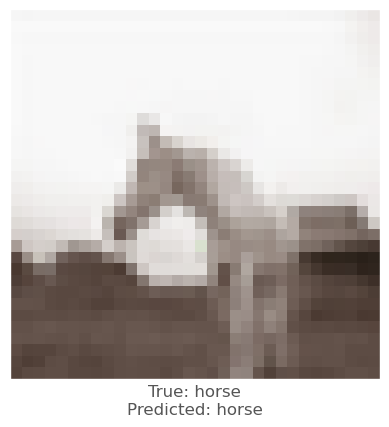



0.0054089427
-0.0023944378
0.0022736788
vr, vg, vb :   -0.9990955399674296 3.6064260782193607 0.48159502006603494
beam_perturbed_confidence temp :  0.56891316
beam_perturbed_confidence temp :  0.5739239
beam_perturbed_confidence temp :  0.5715917
beam_perturbed_confidence temp :  0.56818664
beam_perturbed_confidence temp :  0.56891316
beam_perturbed_confidence temp :  0.5739239
beam_perturbed_confidence temp :  0.56818664
row index :  3
9th round's confidence : 0th 0.56818664
predicted class :  horse
predicted class's confidence :  0.56818664
Lopt is :  28


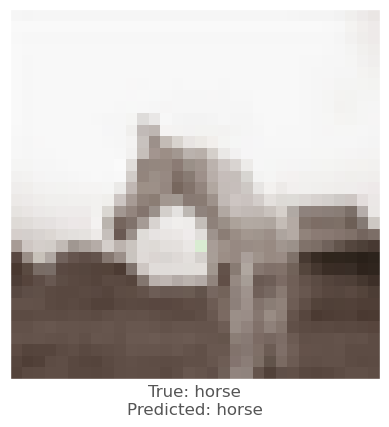



0.004917443
-0.003170967
0.0019698143
vr, vg, vb :   0.8252757472173518 5.242082559955151 1.5273738167334439
beam_perturbed_confidence temp :  0.5790341
beam_perturbed_confidence temp :  0.586329
beam_perturbed_confidence temp :  0.5797415
beam_perturbed_confidence temp :  0.586329
beam_perturbed_confidence temp :  0.5797415
beam_perturbed_confidence temp :  0.58942306
beam_perturbed_confidence temp :  0.58942306
row index :  0
9th round's confidence : 1th 0.5790341
predicted class :  horse
predicted class's confidence :  0.5790341
Lopt is :  23


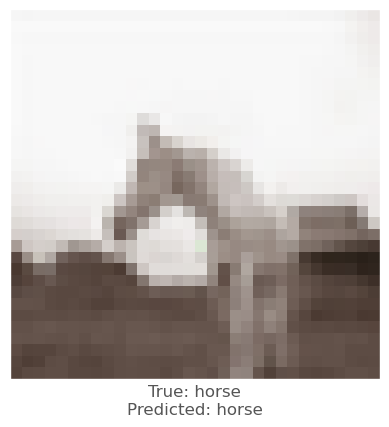



0.0044009686
-0.0025844574
0.0019564629
vr, vg, vb :   -0.9713452350088656 2.957543047588551 -0.35170040038161865
beam_perturbed_confidence temp :  0.57086515
beam_perturbed_confidence temp :  0.5702499
beam_perturbed_confidence temp :  0.57178026
beam_perturbed_confidence temp :  0.567883
beam_perturbed_confidence temp :  0.5696744
beam_perturbed_confidence temp :  0.56952775
beam_perturbed_confidence temp :  0.56701845
row index :  6
9th round's confidence : 2th 0.56701845
predicted class :  horse
predicted class's confidence :  0.56701845
Lopt is :  26


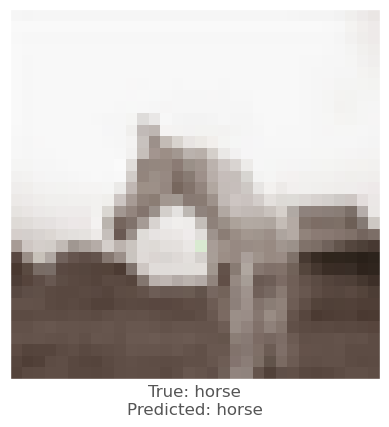



-0.0050557256
-0.009657979
-0.0037190914
vr, vg, vb :   3.9138395569490374 6.110392990513575 3.889979641771025
beam_perturbed_confidence temp :  0.6174531
beam_perturbed_confidence temp :  0.5943484
beam_perturbed_confidence temp :  0.6176749
beam_perturbed_confidence temp :  0.5896542
beam_perturbed_confidence temp :  0.612729
beam_perturbed_confidence temp :  0.5920457
beam_perturbed_confidence temp :  0.590392
row index :  3
9th round's confidence : 3th 0.5896542
predicted class :  horse
predicted class's confidence :  0.5896542
Lopt is :  13


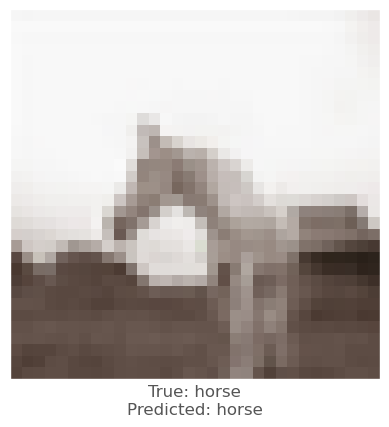



0.0023255348
-0.004178524
0.0011255145
vr, vg, vb :   -0.8264189965583385 2.7116712788557296 -0.48358256090686325
beam_perturbed_confidence temp :  0.5772528
beam_perturbed_confidence temp :  0.57351464
beam_perturbed_confidence temp :  0.5780227
beam_perturbed_confidence temp :  0.57250965
beam_perturbed_confidence temp :  0.57728267
beam_perturbed_confidence temp :  0.5728507
beam_perturbed_confidence temp :  0.5722218
row index :  6
9th round's confidence : 4th 0.5722218
predicted class :  horse
predicted class's confidence :  0.5722218
Lopt is :  19


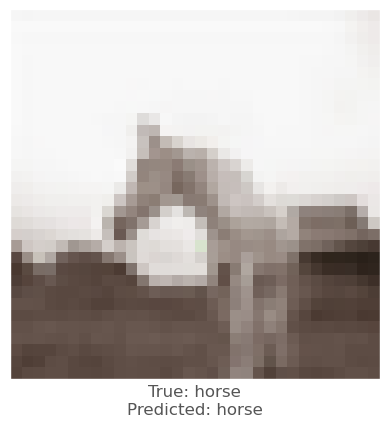



0.010246515
0.0033055544
0.0041481853
vr, vg, vb :   -1.9238375133754717 2.9152280314020635 0.018616992745100425
beam_perturbed_confidence temp :  0.56079406
beam_perturbed_confidence temp :  0.57288873
beam_perturbed_confidence temp :  0.56818664
beam_perturbed_confidence temp :  0.56165415
beam_perturbed_confidence temp :  0.56079406
beam_perturbed_confidence temp :  0.57288873
beam_perturbed_confidence temp :  0.56165415
row index :  0
10th round's confidence : 0th 0.56079406
predicted class :  horse
predicted class's confidence :  0.56079406
Lopt is :  28


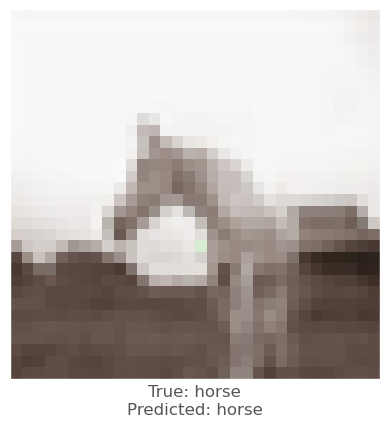



0.004917443
-0.003170967
0.0019698143
vr, vg, vb :   0.25100389263416645 5.0349710141647135 1.1776550050063885
beam_perturbed_confidence temp :  0.5790341
beam_perturbed_confidence temp :  0.586329
beam_perturbed_confidence temp :  0.5797415
beam_perturbed_confidence temp :  0.586329
beam_perturbed_confidence temp :  0.5797415
beam_perturbed_confidence temp :  0.58942306
beam_perturbed_confidence temp :  0.58942306
row index :  0
10th round's confidence : 1th 0.5790341
predicted class :  horse
predicted class's confidence :  0.5790341
Lopt is :  23


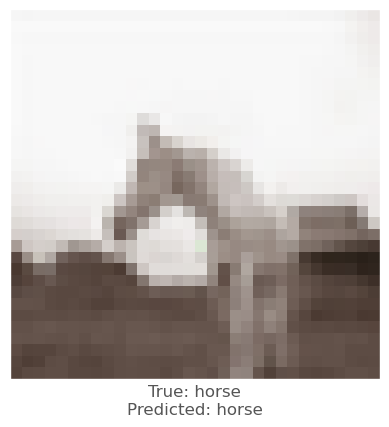



0.004802227
-0.0023005009
0.0016021132
vr, vg, vb :   -1.354433413534346 2.8918388298047937 -0.47674168503522923
beam_perturbed_confidence temp :  0.5637967
beam_perturbed_confidence temp :  0.56641454
beam_perturbed_confidence temp :  0.5662809
beam_perturbed_confidence temp :  0.5607241
beam_perturbed_confidence temp :  0.5626786
beam_perturbed_confidence temp :  0.5643103
beam_perturbed_confidence temp :  0.5604575
row index :  6
10th round's confidence : 2th 0.5604575
predicted class :  horse
predicted class's confidence :  0.5604575
Lopt is :  28


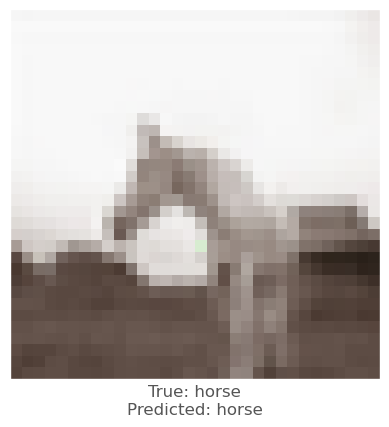



-0.0013285875
-0.0070368648
-0.00067198277
vr, vg, vb :   3.6553143544584796 6.203040167216002 3.568179954113698
beam_perturbed_confidence temp :  0.59078133
beam_perturbed_confidence temp :  0.5779766
beam_perturbed_confidence temp :  0.590392
beam_perturbed_confidence temp :  0.58530897
beam_perturbed_confidence temp :  0.5925391
beam_perturbed_confidence temp :  0.5821952
beam_perturbed_confidence temp :  0.58741283
row index :  1
10th round's confidence : 3th 0.5779766
predicted class :  horse
predicted class's confidence :  0.5779766
Lopt is :  19


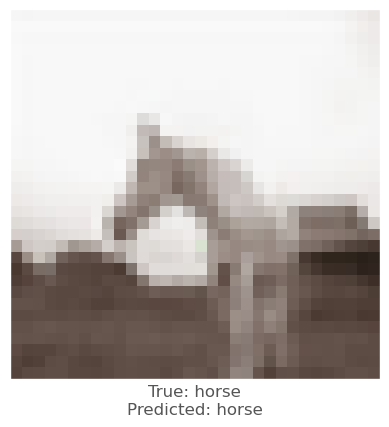



0.0012427568
-0.0056185126
0.00042057037
vr, vg, vb :   -0.8680527812591942 3.0023554140164213 -0.47728134216969254
beam_perturbed_confidence temp :  0.57160795
beam_perturbed_confidence temp :  0.56605685
beam_perturbed_confidence temp :  0.5720891
beam_perturbed_confidence temp :  0.56374305
beam_perturbed_confidence temp :  0.5716351
beam_perturbed_confidence temp :  0.5654494
beam_perturbed_confidence temp :  0.5629862
row index :  6
10th round's confidence : 4th 0.5629862
predicted class :  horse
predicted class's confidence :  0.5629862
Lopt is :  22


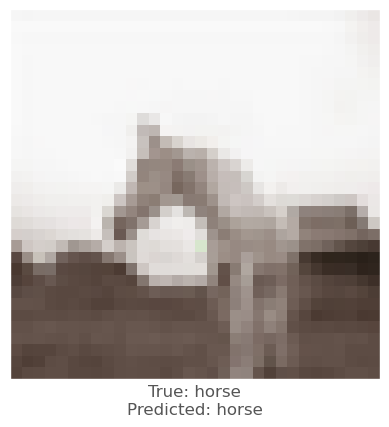



0.0044652224
-0.0027315617
9.948015e-05
vr, vg, vb :   -2.1779759979082858 2.8968613943385173 0.006807278257577688
beam_perturbed_confidence temp :  0.55628747
beam_perturbed_confidence temp :  0.56165415
beam_perturbed_confidence temp :  0.56079406
beam_perturbed_confidence temp :  0.55040157
beam_perturbed_confidence temp :  0.55628747
beam_perturbed_confidence temp :  0.56165415
beam_perturbed_confidence temp :  0.55040157
row index :  3
11th round's confidence : 0th 0.55040157
predicted class :  horse
predicted class's confidence :  0.55040157
Lopt is :  30


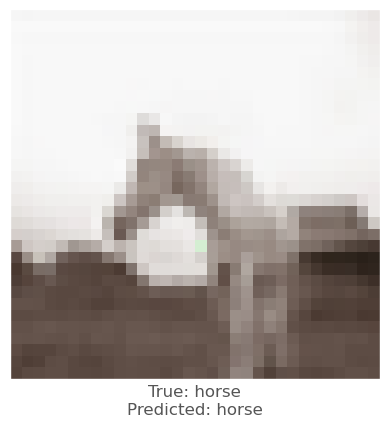



0.004917443
-0.003170967
0.0019698143
vr, vg, vb :   -0.26584077649070037 4.8485706229533205 0.8629080744520388
beam_perturbed_confidence temp :  0.5763743
beam_perturbed_confidence temp :  0.58421427
beam_perturbed_confidence temp :  0.5790341
beam_perturbed_confidence temp :  0.5773412
beam_perturbed_confidence temp :  0.5763743
beam_perturbed_confidence temp :  0.58421427
beam_perturbed_confidence temp :  0.5773412
row index :  0
11th round's confidence : 1th 0.5763743
predicted class :  horse
predicted class's confidence :  0.5763743
Lopt is :  23


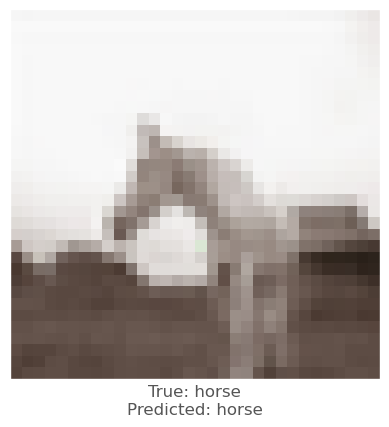



0.0029435158
-0.0037849545
0.0012105107
vr, vg, vb :   -1.5133416499397006 2.9811504016125223 -0.5501185896060472
beam_perturbed_confidence temp :  0.5577061
beam_perturbed_confidence temp :  0.5573771
beam_perturbed_confidence temp :  0.55951357
beam_perturbed_confidence temp :  0.55241853
beam_perturbed_confidence temp :  0.55709267
beam_perturbed_confidence temp :  0.55559504
beam_perturbed_confidence temp :  0.55258155
row index :  3
11th round's confidence : 2th 0.55241853
predicted class :  horse
predicted class's confidence :  0.55241853
Lopt is :  30


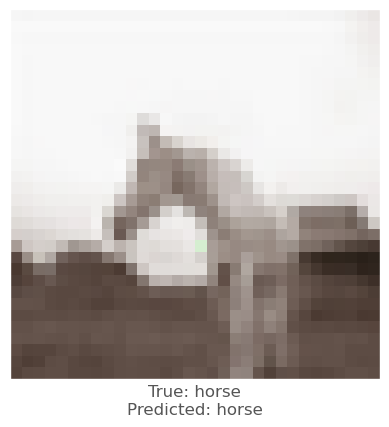



0.0049722195
-0.0024639964
0.002505958
vr, vg, vb :   2.792560972296323 5.829135791531389 2.9607661506731535
beam_perturbed_confidence temp :  0.58285326
beam_perturbed_confidence temp :  0.57178026
beam_perturbed_confidence temp :  0.58062816
beam_perturbed_confidence temp :  0.5769191
beam_perturbed_confidence temp :  0.58523023
beam_perturbed_confidence temp :  0.5737367
beam_perturbed_confidence temp :  0.5790944
row index :  1
11th round's confidence : 3th 0.57178026
predicted class :  horse
predicted class's confidence :  0.57178026
Lopt is :  24


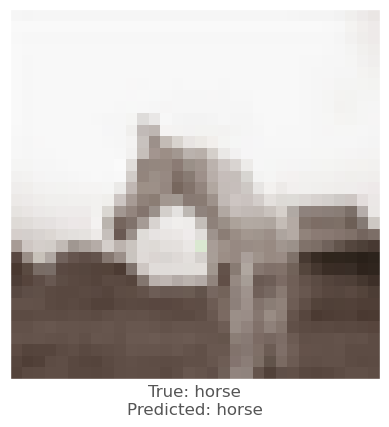



0.0042725205
-0.0031841397
0.00087058544
vr, vg, vb :   -1.2084995573477522 3.0205338454693935 -0.5166117521116589
beam_perturbed_confidence temp :  0.560957
beam_perturbed_confidence temp :  0.5614438
beam_perturbed_confidence temp :  0.56287247
beam_perturbed_confidence temp :  0.5563921
beam_perturbed_confidence temp :  0.5624029
beam_perturbed_confidence temp :  0.5610087
beam_perturbed_confidence temp :  0.5560306
row index :  6
11th round's confidence : 4th 0.5560306
predicted class :  horse
predicted class's confidence :  0.5560306
Lopt is :  25


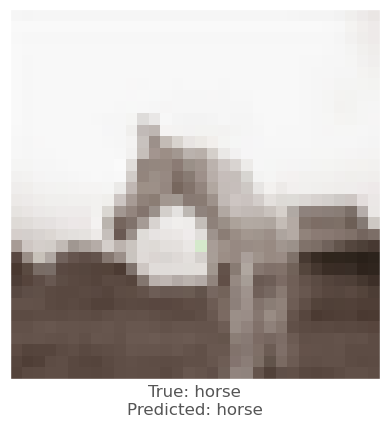



0.001954019
-0.0048567653
-0.0006670356
vr, vg, vb :   -2.1555803050846203 3.092851781927981 0.07283010839995957
beam_perturbed_confidence temp :  0.55131376
beam_perturbed_confidence temp :  0.5513934
beam_perturbed_confidence temp :  0.55040157
beam_perturbed_confidence temp :  0.54236776
beam_perturbed_confidence temp :  0.55131376
beam_perturbed_confidence temp :  0.5513934
beam_perturbed_confidence temp :  0.54236776
row index :  3
12th round's confidence : 0th 0.54236776
predicted class :  horse
predicted class's confidence :  0.54236776
Lopt is :  33


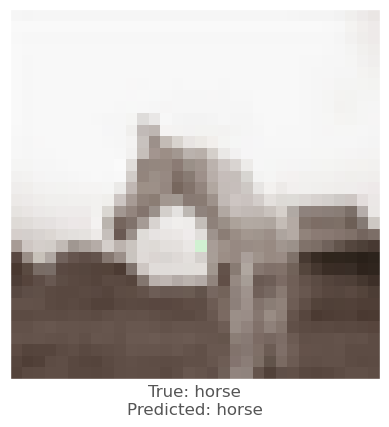



0.004843533
-0.0031816363
0.0021035671
vr, vg, vb :   -0.7236100027509321 4.681877194004546 0.5662605546655263
beam_perturbed_confidence temp :  0.57419056
beam_perturbed_confidence temp :  0.5773412
beam_perturbed_confidence temp :  0.5763743
beam_perturbed_confidence temp :  0.5703483
beam_perturbed_confidence temp :  0.57419056
beam_perturbed_confidence temp :  0.5773412
beam_perturbed_confidence temp :  0.5703483
row index :  3
12th round's confidence : 1th 0.5703483
predicted class :  horse
predicted class's confidence :  0.5703483
Lopt is :  27


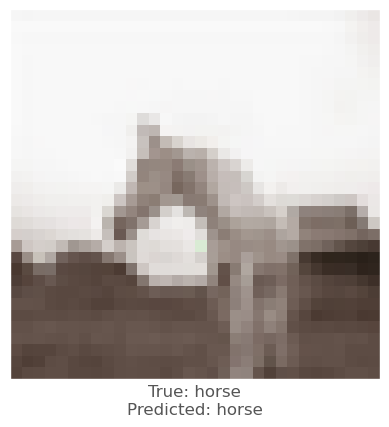



0.0025042892
-0.0054535866
-0.0005300641
vr, vg, vb :   -1.6124363999695341 3.228394019288184 -0.4421003200466876
beam_perturbed_confidence temp :  0.55117095
beam_perturbed_confidence temp :  0.5519257
beam_perturbed_confidence temp :  0.55258155
beam_perturbed_confidence temp :  0.54413956
beam_perturbed_confidence temp :  0.55122644
beam_perturbed_confidence temp :  0.5503048
beam_perturbed_confidence temp :  0.5429915
row index :  6
12th round's confidence : 2th 0.5429915
predicted class :  horse
predicted class's confidence :  0.5429915
Lopt is :  33


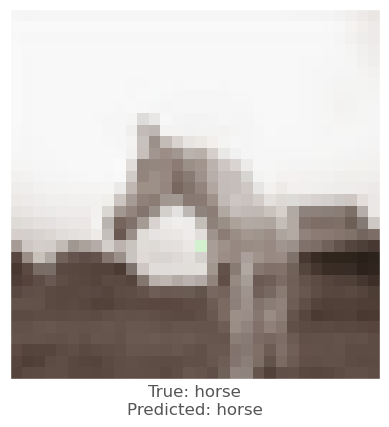



0.0041051507
-0.0026586056
0.0016925931
vr, vg, vb :   2.102789805105143 5.512082769934403 2.4954302258371617
beam_perturbed_confidence temp :  0.5769191
beam_perturbed_confidence temp :  0.5732183
beam_perturbed_confidence temp :  0.5737367
beam_perturbed_confidence temp :  0.58798885
beam_perturbed_confidence temp :  0.5790944
beam_perturbed_confidence temp :  0.57985526
beam_perturbed_confidence temp :  0.59428746
row index :  1
12th round's confidence : 3th 0.5732183
predicted class :  horse
predicted class's confidence :  0.5732183
Lopt is :  29


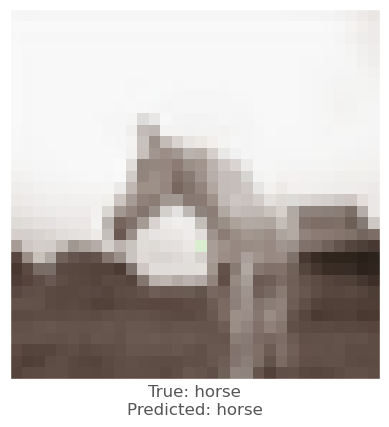



0.0048547387
-0.0010780096
0.00047451258
vr, vg, vb :   -1.5731234728440562 2.826281421463226 -0.5124018346061815
beam_perturbed_confidence temp :  0.5526614
beam_perturbed_confidence temp :  0.5554228
beam_perturbed_confidence temp :  0.55591756
beam_perturbed_confidence temp :  0.55133104
beam_perturbed_confidence temp :  0.55367863
beam_perturbed_confidence temp :  0.5547204
beam_perturbed_confidence temp :  0.5506703
row index :  6
12th round's confidence : 4th 0.5506703
predicted class :  horse
predicted class's confidence :  0.5506703
Lopt is :  27


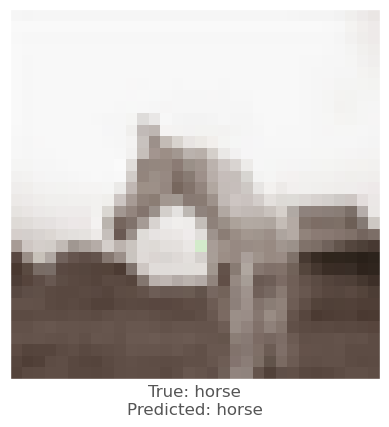



0.0013594031
-0.0020026565
0.0015480518
vr, vg, vb :   -2.0759625879153916 2.983832249716018 -0.08925808585068092
beam_perturbed_confidence temp :  0.5446377
beam_perturbed_confidence temp :  0.54359907
beam_perturbed_confidence temp :  0.5421077
beam_perturbed_confidence temp :  0.53861433
beam_perturbed_confidence temp :  0.54456294
beam_perturbed_confidence temp :  0.541645
beam_perturbed_confidence temp :  0.53838664
row index :  6
13th round's confidence : 0th 0.53838664
predicted class :  horse
predicted class's confidence :  0.53838664
Lopt is :  35


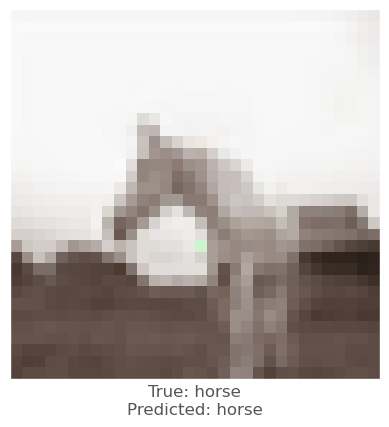



0.011708736
0.004540503
0.005338788
vr, vg, vb :   -1.8221226444436125 3.7596391720985984 -0.024244304054200194
beam_perturbed_confidence temp :  0.56344473
beam_perturbed_confidence temp :  0.57873935
beam_perturbed_confidence temp :  0.5684353
beam_perturbed_confidence temp :  0.56631154
beam_perturbed_confidence temp :  0.56330514
beam_perturbed_confidence temp :  0.5760559
beam_perturbed_confidence temp :  0.5639315
row index :  4
13th round's confidence : 1th 0.56330514
predicted class :  horse
predicted class's confidence :  0.56330514
Lopt is :  27


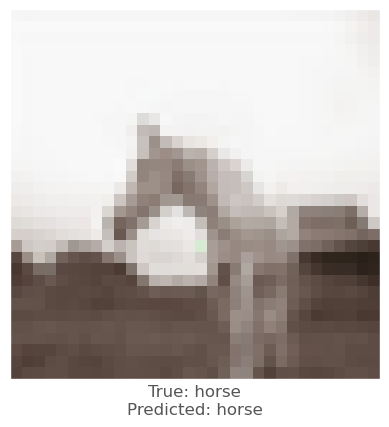



0.0041725636
-0.0015787482
0.001660943
vr, vg, vb :   -1.8684491152582252 3.063429439975943 -0.5639845911731223
beam_perturbed_confidence temp :  0.54232013
beam_perturbed_confidence temp :  0.54584146
beam_perturbed_confidence temp :  0.5424786
beam_perturbed_confidence temp :  0.5384146
beam_perturbed_confidence temp :  0.54222494
beam_perturbed_confidence temp :  0.54336077
beam_perturbed_confidence temp :  0.5371289
row index :  6
13th round's confidence : 2th 0.5371289
predicted class :  horse
predicted class's confidence :  0.5371289
Lopt is :  36


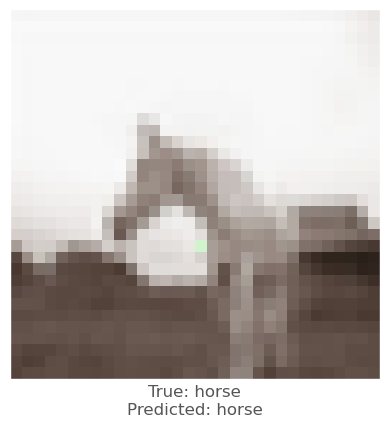



0.012856245
0.0046122074
0.0056505203
vr, vg, vb :   0.6068863205052732 4.49965375166899 1.6808351707827422
beam_perturbed_confidence temp :  0.5732183
beam_perturbed_confidence temp :  0.5918566
beam_perturbed_confidence temp :  0.5765371
beam_perturbed_confidence temp :  0.5918566
beam_perturbed_confidence temp :  0.5765371
beam_perturbed_confidence temp :  0.59525836
beam_perturbed_confidence temp :  0.59525836
row index :  0
13th round's confidence : 3th 0.5732183
predicted class :  horse
predicted class's confidence :  0.5732183
Lopt is :  29


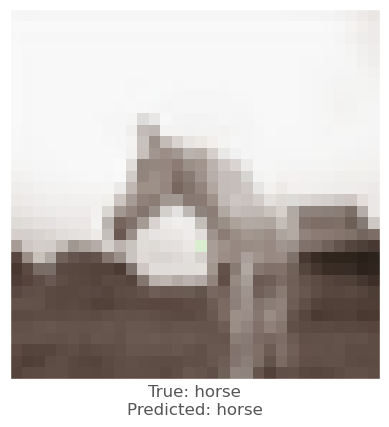



0.0040587783
-0.00049090385
0.0011732578
vr, vg, vb :   -1.821688954157673 2.592743664753915 -0.5784874339214423
beam_perturbed_confidence temp :  0.54890084
beam_perturbed_confidence temp :  0.5506591
beam_perturbed_confidence temp :  0.5501578
beam_perturbed_confidence temp :  0.5465783
beam_perturbed_confidence temp :  0.54954976
beam_perturbed_confidence temp :  0.54958594
beam_perturbed_confidence temp :  0.54563725
row index :  6
13th round's confidence : 4th 0.54563725
predicted class :  horse
predicted class's confidence :  0.54563725
Lopt is :  29


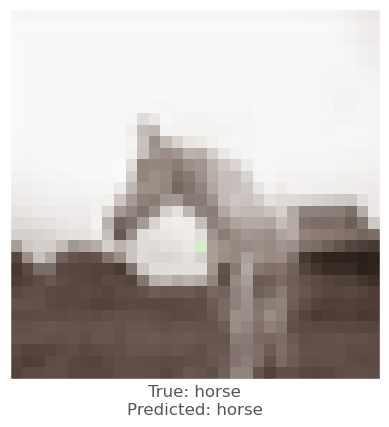



-0.0010291338
-0.0044008493
0.00044721365
vr, vg, vb :   -1.765452949454663 3.1255339589790356 -0.1250536422405884
beam_perturbed_confidence temp :  0.5401948
beam_perturbed_confidence temp :  0.5386732
beam_perturbed_confidence temp :  0.5381671
beam_perturbed_confidence temp :  0.53581756
beam_perturbed_confidence temp :  0.5397575
beam_perturbed_confidence temp :  0.53711385
beam_perturbed_confidence temp :  0.53406495
row index :  6
14th round's confidence : 0th 0.53406495
predicted class :  horse
predicted class's confidence :  0.53406495
Lopt is :  38


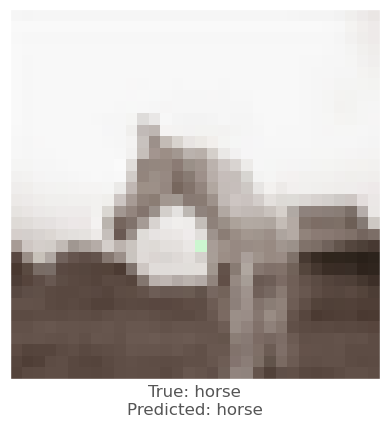



0.0030115247
-0.004362762
0.00036805868
vr, vg, vb :   -1.9410628477269125 3.8199514523222105 -0.05862574179758388
beam_perturbed_confidence temp :  0.56042916
beam_perturbed_confidence temp :  0.5639315
beam_perturbed_confidence temp :  0.5630767
beam_perturbed_confidence temp :  0.5534557
beam_perturbed_confidence temp :  0.5602
beam_perturbed_confidence temp :  0.56165415
beam_perturbed_confidence temp :  0.551964
row index :  6
14th round's confidence : 1th 0.551964
predicted class :  horse
predicted class's confidence :  0.551964
Lopt is :  30


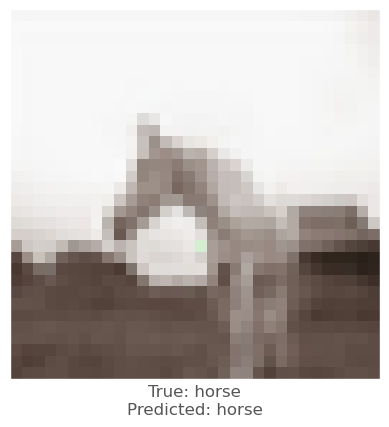



0.0038598776
-0.00016087294
0.0025014281
vr, vg, vb :   -2.067591962368877 2.7731737896032267 -0.7577289447846919
beam_perturbed_confidence temp :  0.53507584
beam_perturbed_confidence temp :  0.53862065
beam_perturbed_confidence temp :  0.53591317
beam_perturbed_confidence temp :  0.5339478
beam_perturbed_confidence temp :  0.5348356
beam_perturbed_confidence temp :  0.53664184
beam_perturbed_confidence temp :  0.5321186
row index :  6
14th round's confidence : 2th 0.5321186
predicted class :  horse
predicted class's confidence :  0.5321186
Lopt is :  38


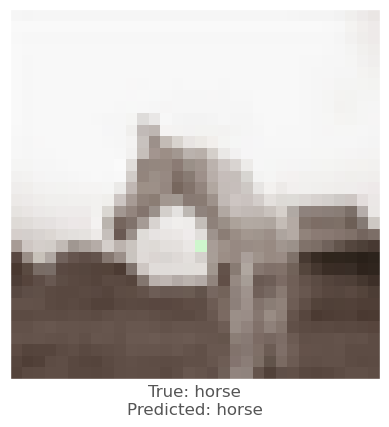



0.012856245
0.0046122074
0.0056505203
vr, vg, vb :   -0.7394268156346095 3.588467635230118 0.9476996212337649
beam_perturbed_confidence temp :  0.5673968
beam_perturbed_confidence temp :  0.5866457
beam_perturbed_confidence temp :  0.5732183
beam_perturbed_confidence temp :  0.57788366
beam_perturbed_confidence temp :  0.5673968
beam_perturbed_confidence temp :  0.5866457
beam_perturbed_confidence temp :  0.57788366
row index :  0
14th round's confidence : 3th 0.5673968
predicted class :  horse
predicted class's confidence :  0.5673968
Lopt is :  29


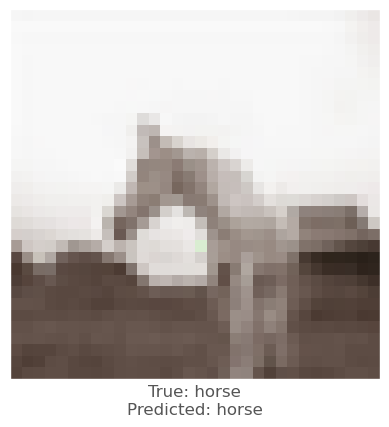



0.003026545
-0.0010207891
0.0016620755
vr, vg, vb :   -1.9421745635179068 2.4355482129208577 -0.6868462424854749
beam_perturbed_confidence temp :  0.5452062
beam_perturbed_confidence temp :  0.54527694
beam_perturbed_confidence temp :  0.5449162
beam_perturbed_confidence temp :  0.5420506
beam_perturbed_confidence temp :  0.54555285
beam_perturbed_confidence temp :  0.5443012
beam_perturbed_confidence temp :  0.54134244
row index :  6
14th round's confidence : 4th 0.54134244
predicted class :  horse
predicted class's confidence :  0.54134244
Lopt is :  31


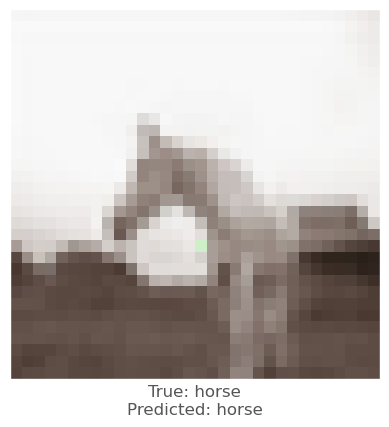



0.002337277
5.197525e-05
0.0035601258
vr, vg, vb :   -1.822635348066936 2.807783038056718 -0.4685608607954602
beam_perturbed_confidence temp :  0.53407097
beam_perturbed_confidence temp :  0.5366538
beam_perturbed_confidence temp :  0.53225744
beam_perturbed_confidence temp :  0.5324378
beam_perturbed_confidence temp :  0.5334844
beam_perturbed_confidence temp :  0.5340961
beam_perturbed_confidence temp :  0.530316
row index :  6
15th round's confidence : 0th 0.530316
predicted class :  horse
predicted class's confidence :  0.530316
Lopt is :  40


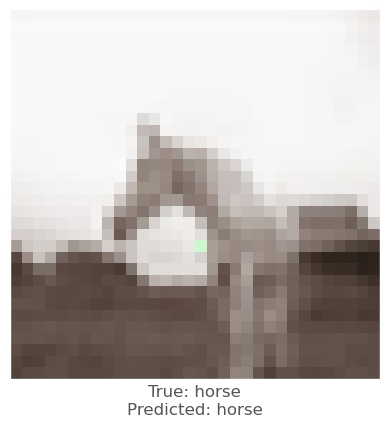



0.0060653687
-0.0017789006
0.0014042258
vr, vg, vb :   -2.353493428188596 3.615846369422143 -0.19318575024416829
beam_perturbed_confidence temp :  0.5506066
beam_perturbed_confidence temp :  0.55721974
beam_perturbed_confidence temp :  0.5520515
beam_perturbed_confidence temp :  0.5439735
beam_perturbed_confidence temp :  0.55111337
beam_perturbed_confidence temp :  0.5548113
beam_perturbed_confidence temp :  0.5427668
row index :  6
15th round's confidence : 1th 0.5427668
predicted class :  horse
predicted class's confidence :  0.5427668
Lopt is :  33


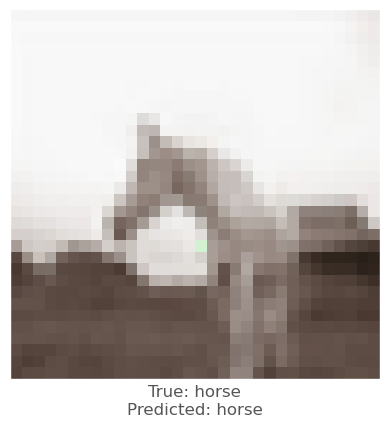



0.0030345917
0.00059485435
0.0035158992
vr, vg, vb :   -2.164291933612458 2.436370975157064 -1.0335459684428194
beam_perturbed_confidence temp :  0.53198606
beam_perturbed_confidence temp :  0.5334891
beam_perturbed_confidence temp :  0.52979225
beam_perturbed_confidence temp :  0.52805316
beam_perturbed_confidence temp :  0.53236145
beam_perturbed_confidence temp :  0.53011185
beam_perturbed_confidence temp :  0.5263537
row index :  6
15th round's confidence : 2th 0.5263537
predicted class :  horse
predicted class's confidence :  0.5263537
Lopt is :  40


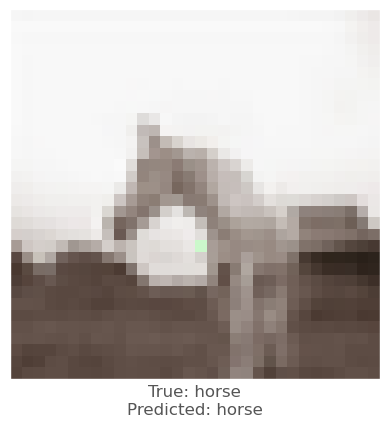



0.010286391
0.003324151
0.004912913
vr, vg, vb :   -1.6941232122114074 2.8972057677947527 0.3616383745492312
beam_perturbed_confidence temp :  0.5585494
beam_perturbed_confidence temp :  0.57265884
beam_perturbed_confidence temp :  0.5673968
beam_perturbed_confidence temp :  0.56133956
beam_perturbed_confidence temp :  0.5585494
beam_perturbed_confidence temp :  0.57265884
beam_perturbed_confidence temp :  0.56133956
row index :  0
15th round's confidence : 3th 0.5585494
predicted class :  horse
predicted class's confidence :  0.5585494
Lopt is :  29


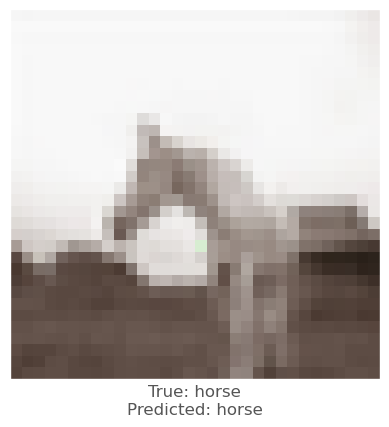



0.0015017986
-0.0017680526
0.0013558269
vr, vg, vb :   -1.8981369701421904 2.3687986494260134 -0.7537443037075084
beam_perturbed_confidence temp :  0.54226905
beam_perturbed_confidence temp :  0.5404273
beam_perturbed_confidence temp :  0.5406948
beam_perturbed_confidence temp :  0.53913563
beam_perturbed_confidence temp :  0.5429477
beam_perturbed_confidence temp :  0.53981483
beam_perturbed_confidence temp :  0.5386678
row index :  6
15th round's confidence : 4th 0.5386678
predicted class :  horse
predicted class's confidence :  0.5386678
Lopt is :  33


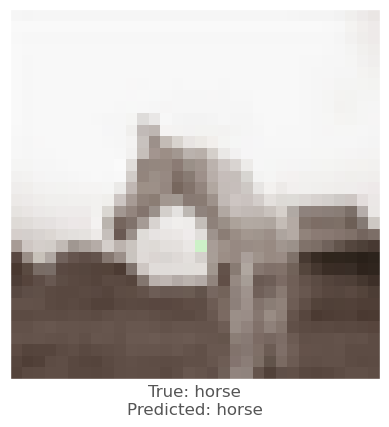



0.0032423139
0.0005759001
0.004137695
vr, vg, vb :   -1.9646031994449347 2.4694147264690636 -0.8354742582821983
beam_perturbed_confidence temp :  0.52971554
beam_perturbed_confidence temp :  0.53359294
beam_perturbed_confidence temp :  0.5283001
beam_perturbed_confidence temp :  0.5293524
beam_perturbed_confidence temp :  0.5291909
beam_perturbed_confidence temp :  0.5304243
beam_perturbed_confidence temp :  0.52637005
row index :  6
16th round's confidence : 0th 0.52637005
predicted class :  horse
predicted class's confidence :  0.52637005
Lopt is :  42


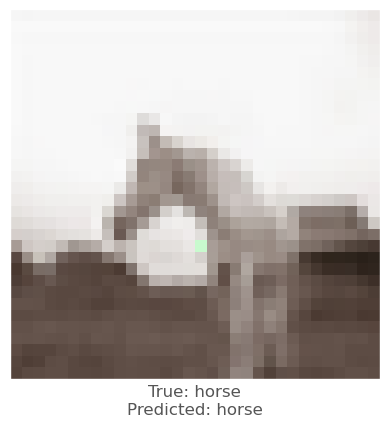



0.0031269789
-0.0016158819
0.002193451
vr, vg, vb :   -2.430841972790391 3.4158499244660128 -0.393212267993189
beam_perturbed_confidence temp :  0.5435477
beam_perturbed_confidence temp :  0.5459827
beam_perturbed_confidence temp :  0.54178005
beam_perturbed_confidence temp :  0.53890055
beam_perturbed_confidence temp :  0.543489
beam_perturbed_confidence temp :  0.5433227
beam_perturbed_confidence temp :  0.5369865
row index :  6
16th round's confidence : 1th 0.5369865
predicted class :  horse
predicted class's confidence :  0.5369865
Lopt is :  36


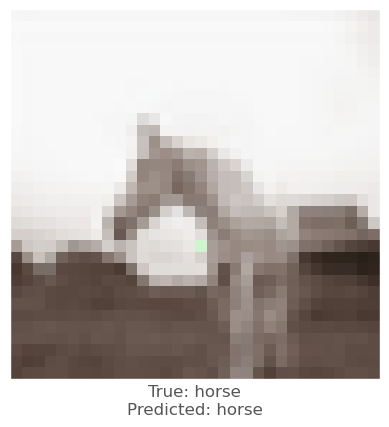



-0.0007711053
-0.0043886304
-0.00018429756
vr, vg, vb :   -1.8707522113052895 2.6315969166580815 -0.9117616154339867
beam_perturbed_confidence temp :  0.5280542
beam_perturbed_confidence temp :  0.5252816
beam_perturbed_confidence temp :  0.5264299
beam_perturbed_confidence temp :  0.52166337
beam_perturbed_confidence temp :  0.5285073
beam_perturbed_confidence temp :  0.5235028
beam_perturbed_confidence temp :  0.5213781
row index :  6
16th round's confidence : 2th 0.5213781
predicted class :  horse
predicted class's confidence :  0.5213781
Lopt is :  42


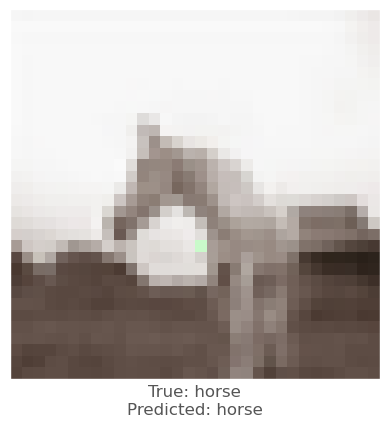



0.006195247
-0.0011842847
0.0025205016
vr, vg, vb :   -2.1442356083211993 2.725913659719501 0.07342437573261373
beam_perturbed_confidence temp :  0.5538809
beam_perturbed_confidence temp :  0.56133956
beam_perturbed_confidence temp :  0.5585494
beam_perturbed_confidence temp :  0.54785913
beam_perturbed_confidence temp :  0.5538809
beam_perturbed_confidence temp :  0.56133956
beam_perturbed_confidence temp :  0.54785913
row index :  3
16th round's confidence : 3th 0.54785913
predicted class :  horse
predicted class's confidence :  0.54785913
Lopt is :  31


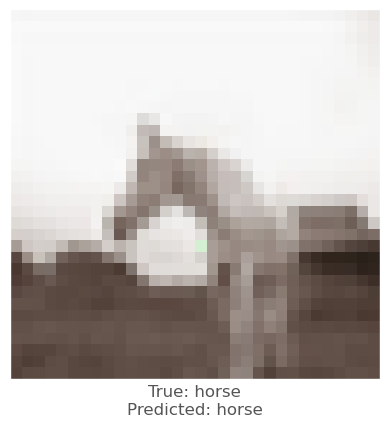



0.00023841858
-0.0012811422
0.0010076165
vr, vg, vb :   -1.7321651310381276 2.260033007963637 -0.7791315253295554
beam_perturbed_confidence temp :  0.5401043
beam_perturbed_confidence temp :  0.53818744
beam_perturbed_confidence temp :  0.538128
beam_perturbed_confidence temp :  0.53721964
beam_perturbed_confidence temp :  0.5411901
beam_perturbed_confidence temp :  0.5375068
beam_perturbed_confidence temp :  0.5367096
row index :  6
16th round's confidence : 4th 0.5367096
predicted class :  horse
predicted class's confidence :  0.5367096
Lopt is :  35


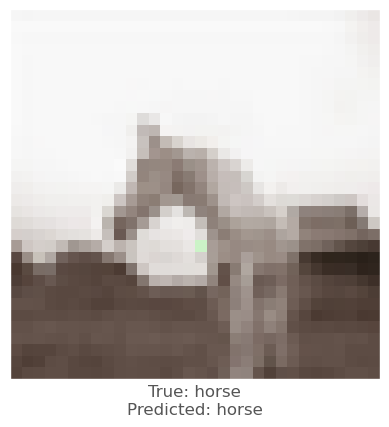



0.0041893125
0.0013108253
0.005452633
vr, vg, vb :   -2.1870741253042745 2.0913907190321184 -1.297190122859252
beam_perturbed_confidence temp :  0.5260609
beam_perturbed_confidence temp :  0.52972126
beam_perturbed_confidence temp :  0.52251005
beam_perturbed_confidence temp :  0.5233989
beam_perturbed_confidence temp :  0.5260767
beam_perturbed_confidence temp :  0.5232164
beam_perturbed_confidence temp :  0.51983345
row index :  6
17th round's confidence : 0th 0.51983345
predicted class :  horse
predicted class's confidence :  0.51983345
Lopt is :  44


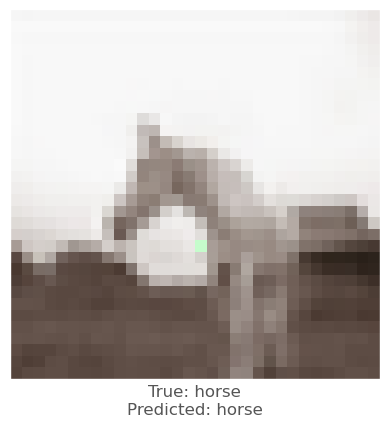



0.0033493638
0.00014656782
0.0037003756
vr, vg, vb :   -2.5226941558977045 3.059608149869143 -0.7239285968884501
beam_perturbed_confidence temp :  0.5371873
beam_perturbed_confidence temp :  0.5399742
beam_perturbed_confidence temp :  0.5352002
beam_perturbed_confidence temp :  0.5349301
beam_perturbed_confidence temp :  0.53697366
beam_perturbed_confidence temp :  0.53758126
beam_perturbed_confidence temp :  0.53321594
row index :  6
17th round's confidence : 1th 0.53321594
predicted class :  horse
predicted class's confidence :  0.53321594
Lopt is :  39


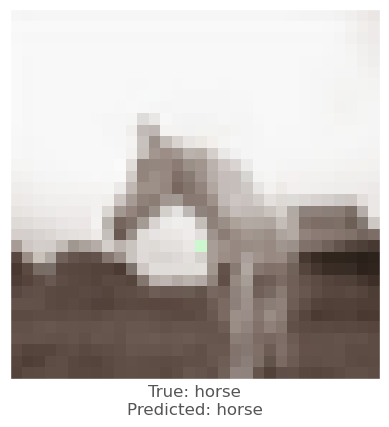



-0.00019520521
-0.0047695637
0.00041747093
vr, vg, vb :   -1.6641564690108201 2.845393592484949 -0.8623325470912716
beam_perturbed_confidence temp :  0.52314526
beam_perturbed_confidence temp :  0.52018493
beam_perturbed_confidence temp :  0.5212459
beam_perturbed_confidence temp :  0.51721823
beam_perturbed_confidence temp :  0.52350867
beam_perturbed_confidence temp :  0.51836705
beam_perturbed_confidence temp :  0.51666224
row index :  6
17th round's confidence : 2th 0.51666224
predicted class :  horse
predicted class's confidence :  0.51666224
Lopt is :  44


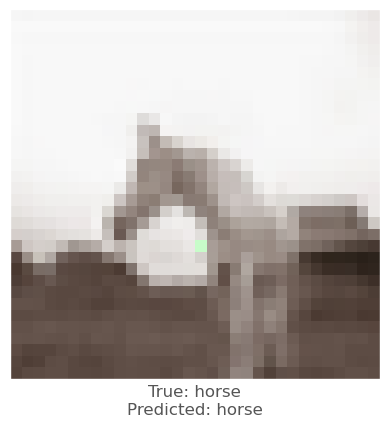



0.003926933
-0.0028244853
0.00032776594
vr, vg, vb :   -2.3225053286627855 2.7357708239446947 0.03330534399736505
beam_perturbed_confidence temp :  0.54855424
beam_perturbed_confidence temp :  0.54923594
beam_perturbed_confidence temp :  0.54785913
beam_perturbed_confidence temp :  0.5421077
beam_perturbed_confidence temp :  0.54855424
beam_perturbed_confidence temp :  0.54923594
beam_perturbed_confidence temp :  0.5421077
row index :  3
17th round's confidence : 3th 0.5421077
predicted class :  horse
predicted class's confidence :  0.5421077
Lopt is :  33


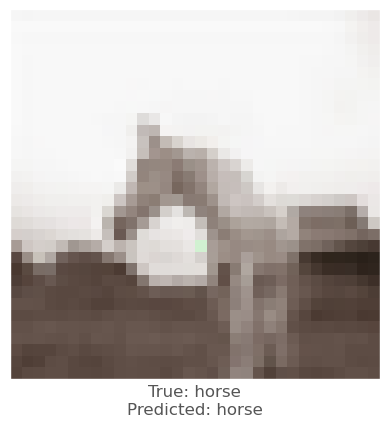



-7.510185e-05
-0.0021106005
0.00092095137
vr, vg, vb :   -1.5514384326926156 2.2450897543169313 -0.793313509439056
beam_perturbed_confidence temp :  0.5390191
beam_perturbed_confidence temp :  0.5358776
beam_perturbed_confidence temp :  0.5362987
beam_perturbed_confidence temp :  0.53543985
beam_perturbed_confidence temp :  0.539942
beam_perturbed_confidence temp :  0.53521246
beam_perturbed_confidence temp :  0.5352755
row index :  5
17th round's confidence : 4th 0.53521246
predicted class :  horse
predicted class's confidence :  0.53521246
Lopt is :  37


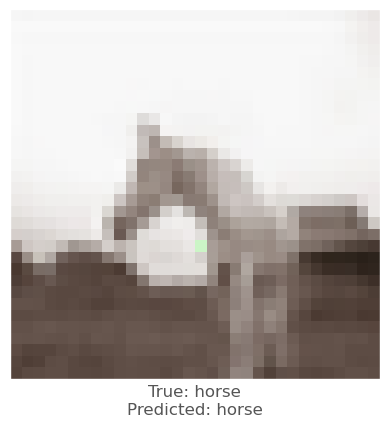



-0.00087833405
-0.0025912523
0.0017362237
vr, vg, vb :   -1.8805333082328315 2.14137687982544 -1.3410934803395622
beam_perturbed_confidence temp :  0.52263695
beam_perturbed_confidence temp :  0.52126473
beam_perturbed_confidence temp :  0.5190007
beam_perturbed_confidence temp :  0.51837635
beam_perturbed_confidence temp :  0.52283114
beam_perturbed_confidence temp :  0.5165905
beam_perturbed_confidence temp :  0.5159572
row index :  6
18th round's confidence : 0th 0.5159572
predicted class :  horse
predicted class's confidence :  0.5159572
Lopt is :  46


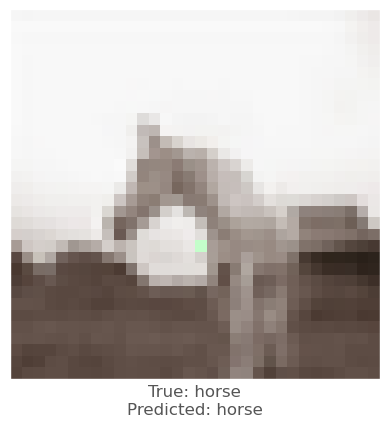



0.0032339692
0.0018386841
0.00374794
vr, vg, vb :   -2.593821661465771 2.569778926679104 -1.0263297435472614
beam_perturbed_confidence temp :  0.53145134
beam_perturbed_confidence temp :  0.5358701
beam_perturbed_confidence temp :  0.5291614
beam_perturbed_confidence temp :  0.52964133
beam_perturbed_confidence temp :  0.531218
beam_perturbed_confidence temp :  0.53084165
beam_perturbed_confidence temp :  0.5254901
row index :  6
18th round's confidence : 1th 0.5254901
predicted class :  horse
predicted class's confidence :  0.5254901
Lopt is :  41


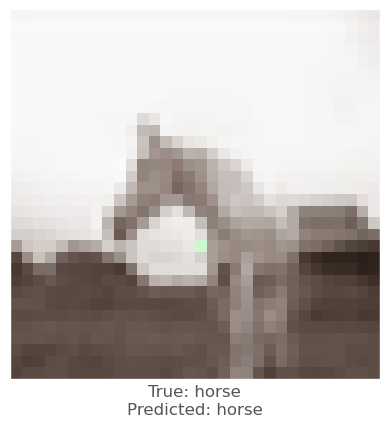



-0.00053972006
-0.0037956238
0.0005143285
vr, vg, vb :   -1.443768816265622 2.9404166111661416 -0.827532140358829
beam_perturbed_confidence temp :  0.5192492
beam_perturbed_confidence temp :  0.5169331
beam_perturbed_confidence temp :  0.5167039
beam_perturbed_confidence temp :  0.51412857
beam_perturbed_confidence temp :  0.519419
beam_perturbed_confidence temp :  0.51435876
beam_perturbed_confidence temp :  0.51267713
row index :  6
18th round's confidence : 2th 0.51267713
predicted class :  horse
predicted class's confidence :  0.51267713
Lopt is :  46


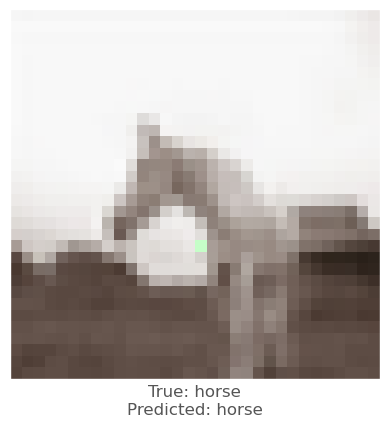



-1.2695789e-05
-0.004005432
1.5497208e-06
vr, vg, vb :   -2.0889852168627914 2.8627369544408503 0.029819837521212533
beam_perturbed_confidence temp :  0.54456294
beam_perturbed_confidence temp :  0.541645
beam_perturbed_confidence temp :  0.5421077
beam_perturbed_confidence temp :  0.53838664
beam_perturbed_confidence temp :  0.54456294
beam_perturbed_confidence temp :  0.541645
beam_perturbed_confidence temp :  0.53838664
row index :  3
18th round's confidence : 3th 0.53838664
predicted class :  horse
predicted class's confidence :  0.53838664
Lopt is :  35


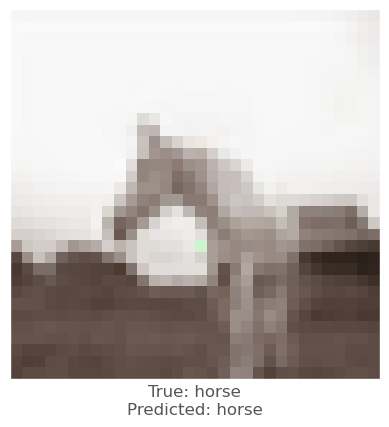



0.000349164
-0.001367867
0.0015130639
vr, vg, vb :   -1.4312109903327779 2.1573674781802823 -0.8652885492574796
beam_perturbed_confidence temp :  0.5352755
beam_perturbed_confidence temp :  0.5313314
beam_perturbed_confidence temp :  0.5343645
beam_perturbed_confidence temp :  0.53288835
beam_perturbed_confidence temp :  0.53522253
beam_perturbed_confidence temp :  0.5316884
beam_perturbed_confidence temp :  0.5323067
row index :  1
18th round's confidence : 4th 0.5313314
predicted class :  horse
predicted class's confidence :  0.5313314
Lopt is :  39


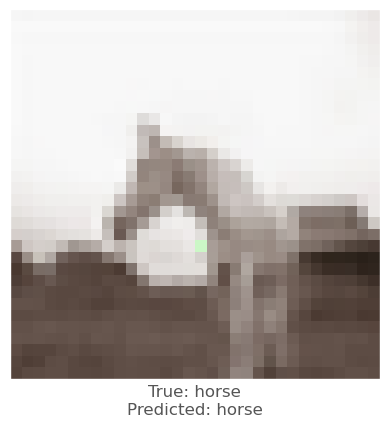



-0.0023822784
-0.004386127
0.0017796755
vr, vg, vb :   -1.4542521331712672 2.365851891351563 -1.3849516806759674
beam_perturbed_confidence temp :  0.5187278
beam_perturbed_confidence temp :  0.5146997
beam_perturbed_confidence temp :  0.5147278
beam_perturbed_confidence temp :  0.5152803
beam_perturbed_confidence temp :  0.5187581
beam_perturbed_confidence temp :  0.5112636
beam_perturbed_confidence temp :  0.51364326
row index :  5
19th round's confidence : 0th 0.5112636
predicted class :  horse
predicted class's confidence :  0.5112636
Lopt is :  47


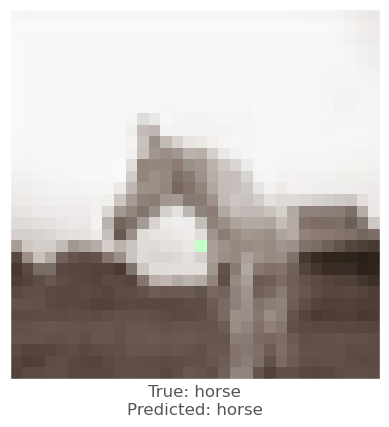



0.0010979176
-0.0023536086
0.0024560094
vr, vg, vb :   -2.444231250995464 2.5481618948357787 -1.1692977079895324
beam_perturbed_confidence temp :  0.52771795
beam_perturbed_confidence temp :  0.52708817
beam_perturbed_confidence temp :  0.5246957
beam_perturbed_confidence temp :  0.5220709
beam_perturbed_confidence temp :  0.5280512
beam_perturbed_confidence temp :  0.52188903
beam_perturbed_confidence temp :  0.52081156
row index :  6
19th round's confidence : 1th 0.52081156
predicted class :  horse
predicted class's confidence :  0.52081156
Lopt is :  43


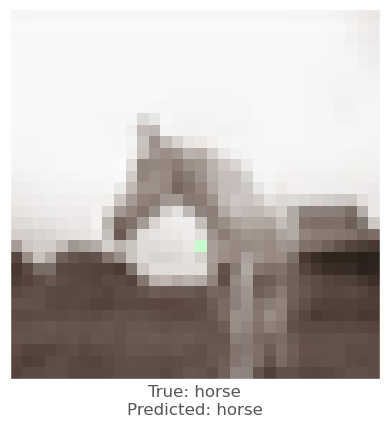



-8.237362e-05
-0.003138721
0.0019814372
vr, vg, vb :   -1.2911545727311007 2.960247048972257 -0.9429226469497772
beam_perturbed_confidence temp :  0.5147278
beam_perturbed_confidence temp :  0.5127131
beam_perturbed_confidence temp :  0.5121471
beam_perturbed_confidence temp :  0.5112636
beam_perturbed_confidence temp :  0.514436
beam_perturbed_confidence temp :  0.5103673
beam_perturbed_confidence temp :  0.5104241
row index :  5
19th round's confidence : 2th 0.5103673
predicted class :  horse
predicted class's confidence :  0.5103673
Lopt is :  47


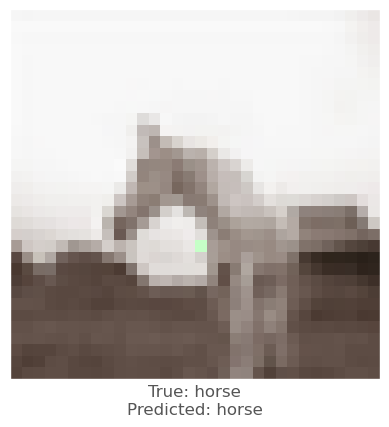



-0.0010291338
-0.0044008493
0.00044721365
vr, vg, vb :   -1.7771733155073228 3.0165481932313845 -0.017883511205884304
beam_perturbed_confidence temp :  0.5401948
beam_perturbed_confidence temp :  0.5386732
beam_perturbed_confidence temp :  0.5381671
beam_perturbed_confidence temp :  0.53581756
beam_perturbed_confidence temp :  0.5397575
beam_perturbed_confidence temp :  0.53711385
beam_perturbed_confidence temp :  0.53406495
row index :  6
19th round's confidence : 3th 0.53406495
predicted class :  horse
predicted class's confidence :  0.53406495
Lopt is :  38


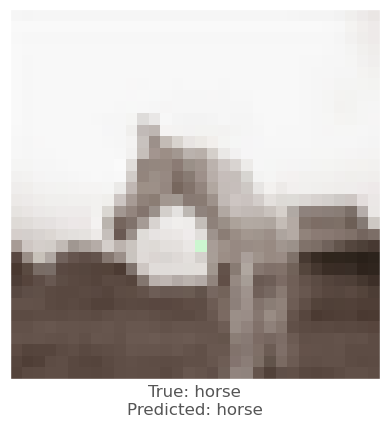



-0.0030958652
-0.006280899
-0.00096720457
vr, vg, vb :   -0.9785033663361211 2.5697206351474104 -0.6820392372547053
beam_perturbed_confidence temp :  0.53282523
beam_perturbed_confidence temp :  0.5241161
beam_perturbed_confidence temp :  0.5316884
beam_perturbed_confidence temp :  0.5252352
beam_perturbed_confidence temp :  0.532532
beam_perturbed_confidence temp :  0.52474666
beam_perturbed_confidence temp :  0.5258311
row index :  1
19th round's confidence : 4th 0.5241161
predicted class :  horse
predicted class's confidence :  0.5241161
Lopt is :  41


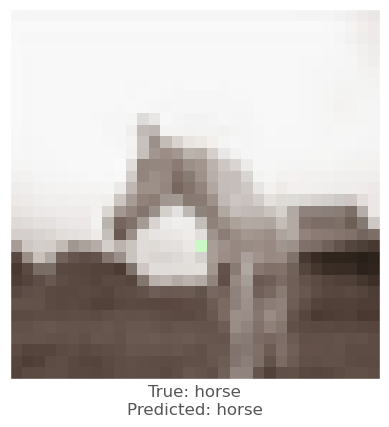



-0.001447916
-0.0034641623
0.0020002723
vr, vg, vb :   -1.1640353167657616 2.4756829371864995 -1.446483740010104
beam_perturbed_confidence temp :  0.51364326
beam_perturbed_confidence temp :  0.5112636
beam_perturbed_confidence temp :  0.5098861
beam_perturbed_confidence temp :  0.51364326
beam_perturbed_confidence temp :  0.51328456
beam_perturbed_confidence temp :  0.5098861
beam_perturbed_confidence temp :  0.51328456
row index :  2
20th round's confidence : 0th 0.5098861
predicted class :  horse
predicted class's confidence :  0.5098861
Lopt is :  47


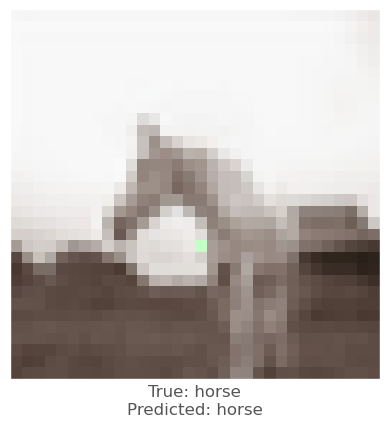



-0.0026811957
-0.0064014196
0.00028389692
vr, vg, vb :   -1.931688552302778 2.9334876693109413 -1.0807576294970977
beam_perturbed_confidence temp :  0.52425504
beam_perturbed_confidence temp :  0.51911324
beam_perturbed_confidence temp :  0.52127814
beam_perturbed_confidence temp :  0.51798296
beam_perturbed_confidence temp :  0.52449876
beam_perturbed_confidence temp :  0.5148091
beam_perturbed_confidence temp :  0.51716167
row index :  5
20th round's confidence : 1th 0.5148091
predicted class :  horse
predicted class's confidence :  0.5148091
Lopt is :  45


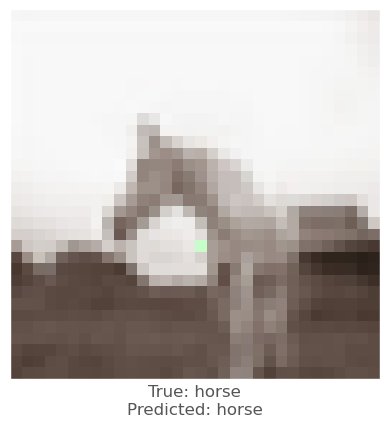



0.0019598007
-0.0017798543
0.004218459
vr, vg, vb :   -1.358019187479475 2.8422077738388256 -1.270476295188149
beam_perturbed_confidence temp :  0.5104241
beam_perturbed_confidence temp :  0.5103673
beam_perturbed_confidence temp :  0.50780064
beam_perturbed_confidence temp :  0.5104241
beam_perturbed_confidence temp :  0.5094852
beam_perturbed_confidence temp :  0.50780064
beam_perturbed_confidence temp :  0.5094852
row index :  2
20th round's confidence : 2th 0.50780064
predicted class :  horse
predicted class's confidence :  0.50780064
Lopt is :  47


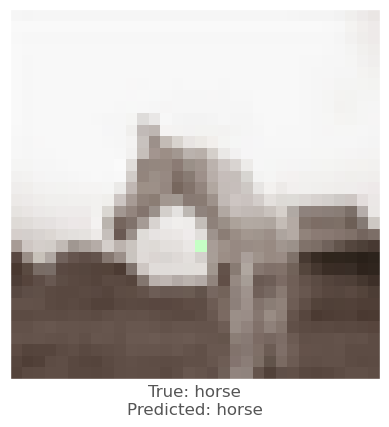



0.002337277
5.197525e-05
0.0035601258
vr, vg, vb :   -1.8331836775143298 2.709695848883832 -0.37210774286422654
beam_perturbed_confidence temp :  0.53407097
beam_perturbed_confidence temp :  0.5366538
beam_perturbed_confidence temp :  0.53225744
beam_perturbed_confidence temp :  0.5324378
beam_perturbed_confidence temp :  0.5334844
beam_perturbed_confidence temp :  0.5340961
beam_perturbed_confidence temp :  0.530316
row index :  6
20th round's confidence : 3th 0.530316
predicted class :  horse
predicted class's confidence :  0.530316
Lopt is :  40


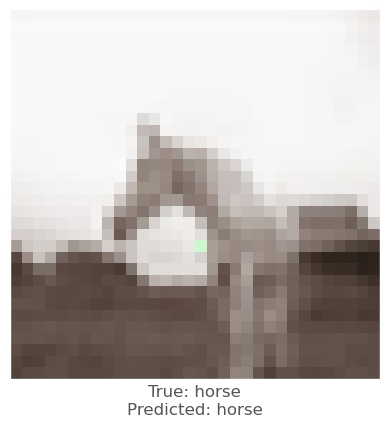



-0.002464056
-0.0077551007
-0.0011320114
vr, vg, vb :   -0.6342474282010442 3.0882586443407996 -0.5006341721718129
beam_perturbed_confidence temp :  0.5252352
beam_perturbed_confidence temp :  0.51730704
beam_perturbed_confidence temp :  0.52474666
beam_perturbed_confidence temp :  0.5155879
beam_perturbed_confidence temp :  0.5258311
beam_perturbed_confidence temp :  0.5161134
beam_perturbed_confidence temp :  0.514702
row index :  6
20th round's confidence : 4th 0.514702
predicted class :  horse
predicted class's confidence :  0.514702
Lopt is :  44


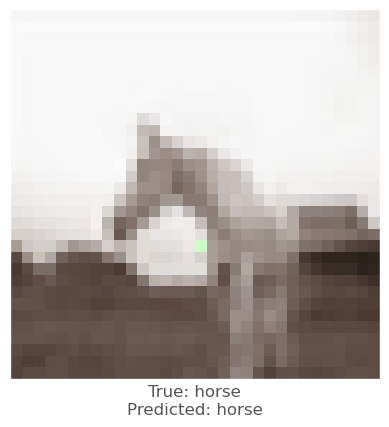



-0.0021969676
-0.004509151
0.00093889236
vr, vg, vb :   -0.8279350249115731 2.679029741658157 -1.395724602459289
beam_perturbed_confidence temp :  0.5112182
beam_perturbed_confidence temp :  0.5098861
beam_perturbed_confidence temp :  0.50930506
beam_perturbed_confidence temp :  0.5112182
beam_perturbed_confidence temp :  0.51133454
beam_perturbed_confidence temp :  0.50930506
beam_perturbed_confidence temp :  0.51133454
row index :  2
21th round's confidence : 0th 0.50930506
predicted class :  horse
predicted class's confidence :  0.50930506
Lopt is :  47


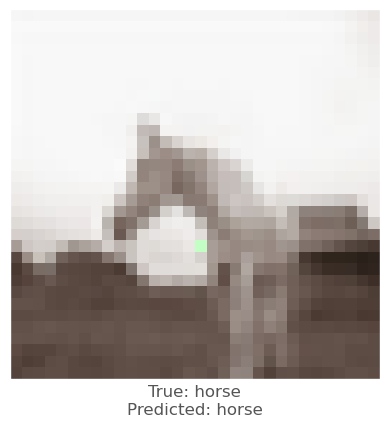



-2.4437904e-06
-0.0022021532
0.0019081831
vr, vg, vb :   -1.7382753180289212 2.8603542229670054 -1.1635001763313235
beam_perturbed_confidence temp :  0.51716167
beam_perturbed_confidence temp :  0.5167144
beam_perturbed_confidence temp :  0.51450706
beam_perturbed_confidence temp :  0.5138071
beam_perturbed_confidence temp :  0.51685756
beam_perturbed_confidence temp :  0.51166135
beam_perturbed_confidence temp :  0.50970155
row index :  6
21th round's confidence : 1th 0.50970155
predicted class :  horse
predicted class's confidence :  0.50970155
Lopt is :  47


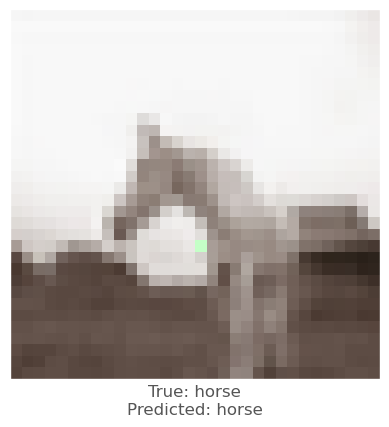



-0.0008568764
-0.003939986
0.0011130571
vr, vg, vb :   -1.1365296314024258 2.95198561934923 -1.2547343793228987
beam_perturbed_confidence temp :  0.5094852
beam_perturbed_confidence temp :  0.50780064
beam_perturbed_confidence temp :  0.5068811
beam_perturbed_confidence temp :  0.5094852
beam_perturbed_confidence temp :  0.5094368
beam_perturbed_confidence temp :  0.5068811
beam_perturbed_confidence temp :  0.5094368
row index :  2
21th round's confidence : 2th 0.5068811
predicted class :  horse
predicted class's confidence :  0.5068811
Lopt is :  47


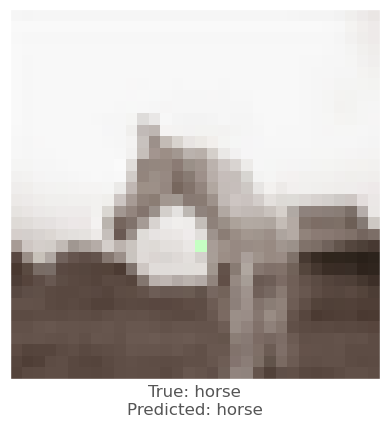



0.0032423139
0.0005759001
0.004137695
vr, vg, vb :   -1.9740966959475892 2.3811362562134666 -0.748666452144088
beam_perturbed_confidence temp :  0.52971554
beam_perturbed_confidence temp :  0.53359294
beam_perturbed_confidence temp :  0.5283001
beam_perturbed_confidence temp :  0.5293524
beam_perturbed_confidence temp :  0.5291909
beam_perturbed_confidence temp :  0.5304243
beam_perturbed_confidence temp :  0.52637005
row index :  6
21th round's confidence : 3th 0.52637005
predicted class :  horse
predicted class's confidence :  0.52637005
Lopt is :  42


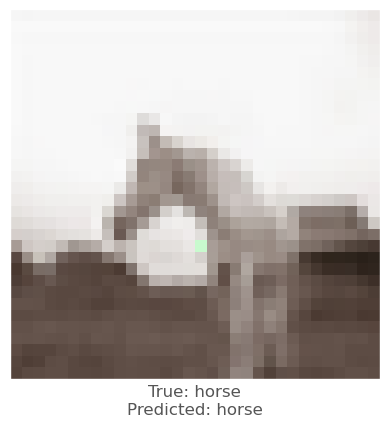



0.0009058118
-0.0037518144
0.0007442236
vr, vg, vb :   -0.661403864046101 3.154614216445416 -0.5249931144211843
beam_perturbed_confidence temp :  0.5152076
beam_perturbed_confidence temp :  0.5164696
beam_perturbed_confidence temp :  0.5148437
beam_perturbed_confidence temp :  0.5130269
beam_perturbed_confidence temp :  0.5155064
beam_perturbed_confidence temp :  0.51409715
beam_perturbed_confidence temp :  0.51107293
row index :  6
21th round's confidence : 4th 0.51107293
predicted class :  horse
predicted class's confidence :  0.51107293
Lopt is :  47


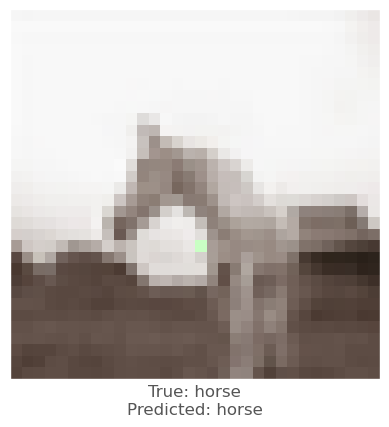



-0.0031419992
-0.005418718
4.839897e-05
vr, vg, vb :   -0.43094159795142173 2.9529985536098953 -1.2609920393691219
beam_perturbed_confidence temp :  0.51133454
beam_perturbed_confidence temp :  0.50930506
beam_perturbed_confidence temp :  0.50942683
beam_perturbed_confidence temp :  0.51133454
beam_perturbed_confidence temp :  0.5113733
beam_perturbed_confidence temp :  0.50942683
beam_perturbed_confidence temp :  0.5113733
row index :  1
22th round's confidence : 0th 0.50930506
predicted class :  horse
predicted class's confidence :  0.50930506
Lopt is :  47


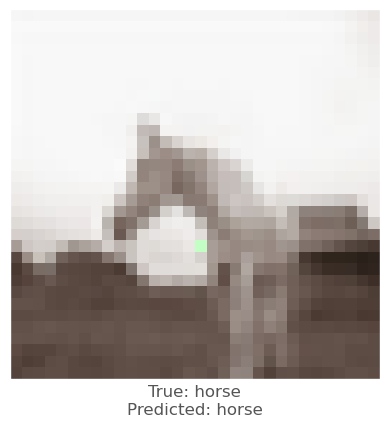



-5.6803226e-05
-0.0035322905
0.0020250082
vr, vg, vb :   -1.5587674635789344 2.927547846538225 -1.2496509788581034
beam_perturbed_confidence temp :  0.5116717
beam_perturbed_confidence temp :  0.50970155
beam_perturbed_confidence temp :  0.508648
beam_perturbed_confidence temp :  0.5116717
beam_perturbed_confidence temp :  0.5113617
beam_perturbed_confidence temp :  0.508648
beam_perturbed_confidence temp :  0.5113617
row index :  2
22th round's confidence : 1th 0.508648
predicted class :  horse
predicted class's confidence :  0.508648
Lopt is :  47


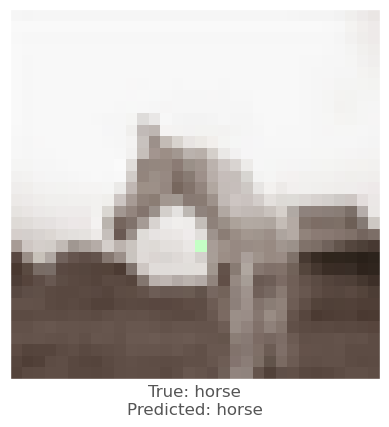



-0.0011642575
-0.004411876
0.0010455847
vr, vg, vb :   -0.9064509156224128 3.097974677577271 -1.233819409255599
beam_perturbed_confidence temp :  0.50751907
beam_perturbed_confidence temp :  0.5068811
beam_perturbed_confidence temp :  0.5059854
beam_perturbed_confidence temp :  0.50751907
beam_perturbed_confidence temp :  0.50742906
beam_perturbed_confidence temp :  0.5059854
beam_perturbed_confidence temp :  0.50742906
row index :  2
22th round's confidence : 2th 0.5059854
predicted class :  horse
predicted class's confidence :  0.5059854
Lopt is :  47


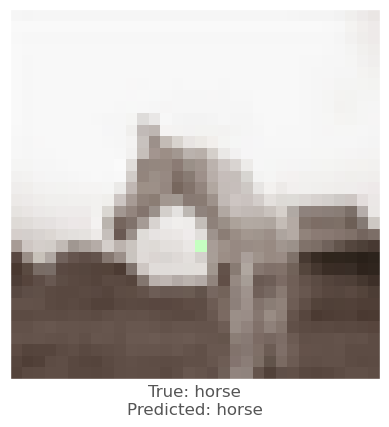



0.0041893125
0.0013108253
0.005452633
vr, vg, vb :   -2.195618272156663 2.011940095802081 -1.2190630973349528
beam_perturbed_confidence temp :  0.5260609
beam_perturbed_confidence temp :  0.52972126
beam_perturbed_confidence temp :  0.52251005
beam_perturbed_confidence temp :  0.5233989
beam_perturbed_confidence temp :  0.5260767
beam_perturbed_confidence temp :  0.5232164
beam_perturbed_confidence temp :  0.51983345
row index :  6
22th round's confidence : 3th 0.51983345
predicted class :  horse
predicted class's confidence :  0.51983345
Lopt is :  44


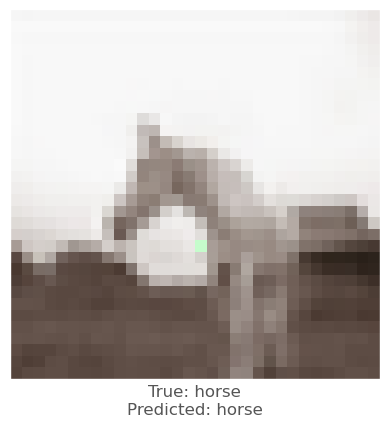



0.005155146
-3.015995e-05
0.0039044023
vr, vg, vb :   -1.1107780898393669 2.842168789826509 -0.8629340285802622
beam_perturbed_confidence temp :  0.50751466
beam_perturbed_confidence temp :  0.51107293
beam_perturbed_confidence temp :  0.5091225
beam_perturbed_confidence temp :  0.50751466
beam_perturbed_confidence temp :  0.5058123
beam_perturbed_confidence temp :  0.5091225
beam_perturbed_confidence temp :  0.5058123
row index :  4
22th round's confidence : 4th 0.5058123
predicted class :  horse
predicted class's confidence :  0.5058123
Lopt is :  47


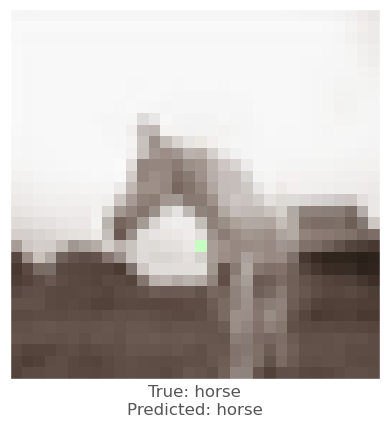



-0.0031419992
-0.005418718
4.839897e-05
vr, vg, vb :   -0.07364751368728545 3.1995704843664594 -1.1397327325879714
beam_perturbed_confidence temp :  0.51133454
beam_perturbed_confidence temp :  0.50930506
beam_perturbed_confidence temp :  0.50942683
beam_perturbed_confidence temp :  0.51133454
beam_perturbed_confidence temp :  0.5113733
beam_perturbed_confidence temp :  0.50942683
beam_perturbed_confidence temp :  0.5113733
row index :  1
23th round's confidence : 0th 0.50930506
predicted class :  horse
predicted class's confidence :  0.50930506
Lopt is :  47


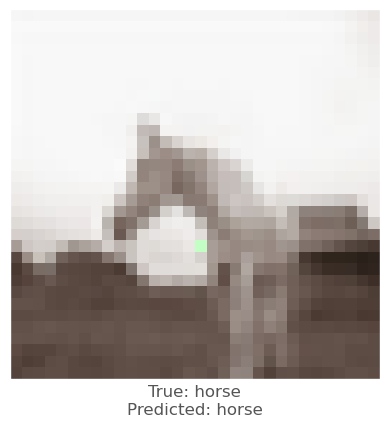



-0.0016845465
-0.004280746
0.0008286834
vr, vg, vb :   -1.234436070156832 3.0628676601967806 -1.2075542186035186
beam_perturbed_confidence temp :  0.5113617
beam_perturbed_confidence temp :  0.508648
beam_perturbed_confidence temp :  0.50751907
beam_perturbed_confidence temp :  0.5113617
beam_perturbed_confidence temp :  0.51145226
beam_perturbed_confidence temp :  0.50751907
beam_perturbed_confidence temp :  0.51145226
row index :  2
23th round's confidence : 1th 0.50751907
predicted class :  horse
predicted class's confidence :  0.50751907
Lopt is :  47


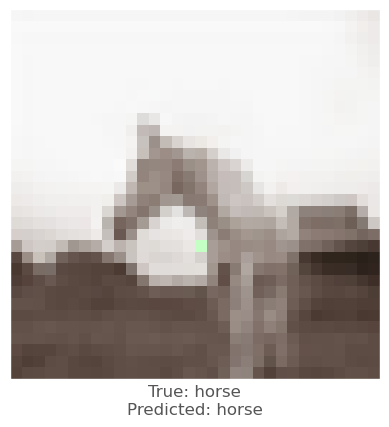



-0.0016555786
-0.0053622127
0.00033557415
vr, vg, vb :   -0.6502479627320465 3.3243984756123908 -1.143994883338584
beam_perturbed_confidence temp :  0.50742906
beam_perturbed_confidence temp :  0.5059854
beam_perturbed_confidence temp :  0.5061057
beam_perturbed_confidence temp :  0.50742906
beam_perturbed_confidence temp :  0.50728667
beam_perturbed_confidence temp :  0.5061057
beam_perturbed_confidence temp :  0.50728667
row index :  1
23th round's confidence : 2th 0.5059854
predicted class :  horse
predicted class's confidence :  0.5059854
Lopt is :  47


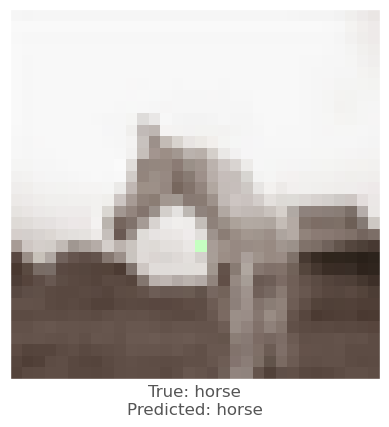



-0.00087833405
-0.0025912523
0.0017362237
vr, vg, vb :   -1.8882230403999811 2.0698713189184064 -1.270779157367693
beam_perturbed_confidence temp :  0.52263695
beam_perturbed_confidence temp :  0.52126473
beam_perturbed_confidence temp :  0.5190007
beam_perturbed_confidence temp :  0.51837635
beam_perturbed_confidence temp :  0.52283114
beam_perturbed_confidence temp :  0.5165905
beam_perturbed_confidence temp :  0.5159572
row index :  6
23th round's confidence : 3th 0.5159572
predicted class :  horse
predicted class's confidence :  0.5159572
Lopt is :  46


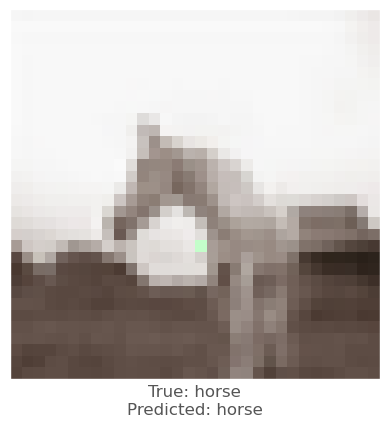



0.0010301471
-0.0038132668
0.0019734502
vr, vg, vb :   -1.102714988420738 2.9392785862588973 -0.9739856441090768
beam_perturbed_confidence temp :  0.5068811
beam_perturbed_confidence temp :  0.5058123
beam_perturbed_confidence temp :  0.5055412
beam_perturbed_confidence temp :  0.5068811
beam_perturbed_confidence temp :  0.506336
beam_perturbed_confidence temp :  0.5055412
beam_perturbed_confidence temp :  0.506336
row index :  2
23th round's confidence : 4th 0.5055412
predicted class :  horse
predicted class's confidence :  0.5055412
Lopt is :  47


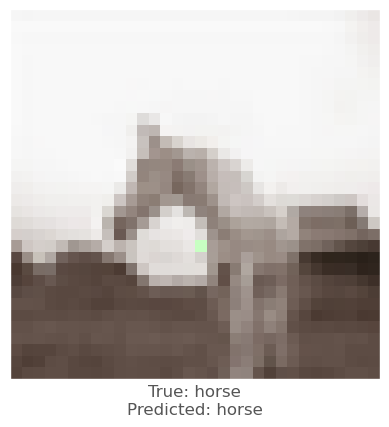



-0.0031419992
-0.005418718
4.839897e-05
vr, vg, vb :   0.24791716215043724 3.4214852220473673 -1.030599356484936
beam_perturbed_confidence temp :  0.50930506
beam_perturbed_confidence temp :  0.50930506
beam_perturbed_confidence temp :  0.50942683
beam_perturbed_confidence temp :  0.50930506
beam_perturbed_confidence temp :  0.50942683
beam_perturbed_confidence temp :  0.50942683
beam_perturbed_confidence temp :  0.50942683
row index :  0
24th round's confidence : 0th 0.50930506
predicted class :  horse
predicted class's confidence :  0.50930506
Lopt is :  47


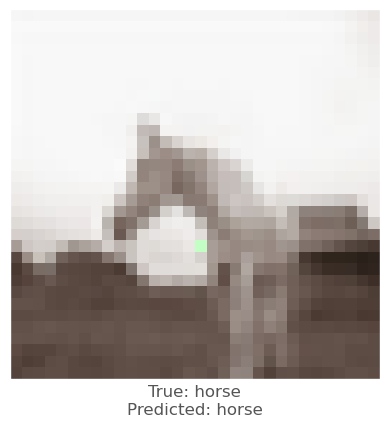



-0.0025556684
-0.005331874
0.0008767247
vr, vg, vb :   -0.8554256277377064 3.289768283550882 -1.1744712687432888
beam_perturbed_confidence temp :  0.5094368
beam_perturbed_confidence temp :  0.50751907
beam_perturbed_confidence temp :  0.50742906
beam_perturbed_confidence temp :  0.5094368
beam_perturbed_confidence temp :  0.5091123
beam_perturbed_confidence temp :  0.50742906
beam_perturbed_confidence temp :  0.5091123
row index :  2
24th round's confidence : 1th 0.50742906
predicted class :  horse
predicted class's confidence :  0.50742906
Lopt is :  47


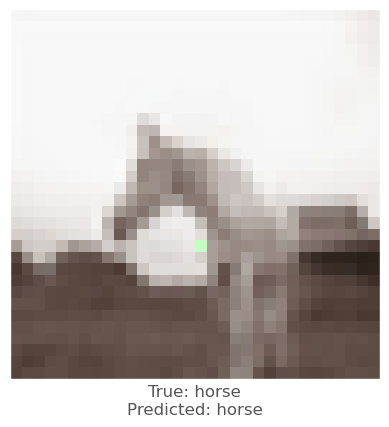



-0.0016555786
-0.0053622127
0.00033557415
vr, vg, vb :   -0.41966530513071687 3.5281798938439985 -1.0631528100132706
beam_perturbed_confidence temp :  0.50742906
beam_perturbed_confidence temp :  0.5059854
beam_perturbed_confidence temp :  0.5061057
beam_perturbed_confidence temp :  0.50742906
beam_perturbed_confidence temp :  0.50728667
beam_perturbed_confidence temp :  0.5061057
beam_perturbed_confidence temp :  0.50728667
row index :  1
24th round's confidence : 2th 0.5059854
predicted class :  horse
predicted class's confidence :  0.5059854
Lopt is :  47


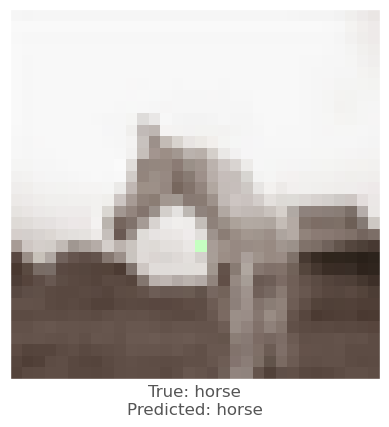



-0.0023822784
-0.004386127
0.0017796755
vr, vg, vb :   -1.4611728921217018 2.301496886535233 -1.3216687900012851
beam_perturbed_confidence temp :  0.5187278
beam_perturbed_confidence temp :  0.5146997
beam_perturbed_confidence temp :  0.5147278
beam_perturbed_confidence temp :  0.5152803
beam_perturbed_confidence temp :  0.5187581
beam_perturbed_confidence temp :  0.5112636
beam_perturbed_confidence temp :  0.51364326
row index :  5
24th round's confidence : 3th 0.5112636
predicted class :  horse
predicted class's confidence :  0.5112636
Lopt is :  47


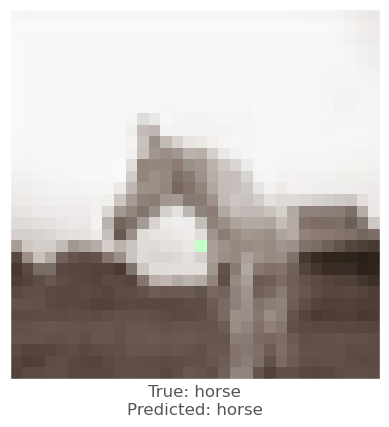



-0.0002168417
-0.0043022633
0.0004464388
vr, vg, vb :   -0.970759319809377 3.0755770536217772 -0.9212309586349368
beam_perturbed_confidence temp :  0.50606436
beam_perturbed_confidence temp :  0.5055412
beam_perturbed_confidence temp :  0.50536585
beam_perturbed_confidence temp :  0.50606436
beam_perturbed_confidence temp :  0.5057735
beam_perturbed_confidence temp :  0.50536585
beam_perturbed_confidence temp :  0.5057735
row index :  2
24th round's confidence : 4th 0.50536585
predicted class :  horse
predicted class's confidence :  0.50536585
Lopt is :  47


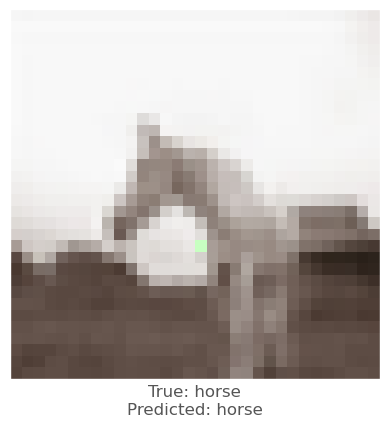



-0.0031419992
-0.005418718
4.839897e-05
vr, vg, vb :   0.5373253704043877 3.6212084859601843 -0.9323793179922042
beam_perturbed_confidence temp :  0.50930506
beam_perturbed_confidence temp :  0.50930506
beam_perturbed_confidence temp :  0.5094368
beam_perturbed_confidence temp :  0.50930506
beam_perturbed_confidence temp :  0.5094368
beam_perturbed_confidence temp :  0.5094368
beam_perturbed_confidence temp :  0.5094368
row index :  0
25th round's confidence : 0th 0.50930506
predicted class :  horse
predicted class's confidence :  0.50930506
Lopt is :  47


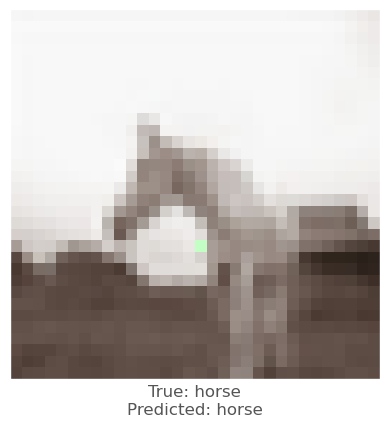



-0.0031269193
-0.0048974752
1.770258e-05
vr, vg, vb :   -0.457191138007759 3.4505389794572685 -1.058794399818789
beam_perturbed_confidence temp :  0.5091123
beam_perturbed_confidence temp :  0.50742906
beam_perturbed_confidence temp :  0.50728667
beam_perturbed_confidence temp :  0.5091123
beam_perturbed_confidence temp :  0.5084336
beam_perturbed_confidence temp :  0.50728667
beam_perturbed_confidence temp :  0.5084336
row index :  2
25th round's confidence : 1th 0.50728667
predicted class :  horse
predicted class's confidence :  0.50728667
Lopt is :  47


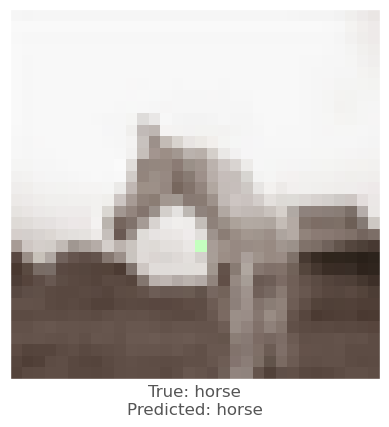



-0.0016555786
-0.0053622127
0.00033557415
vr, vg, vb :   -0.21214091328952017 3.7115831702524456 -0.9903949440204884
beam_perturbed_confidence temp :  0.50742906
beam_perturbed_confidence temp :  0.5059854
beam_perturbed_confidence temp :  0.5060004
beam_perturbed_confidence temp :  0.50742906
beam_perturbed_confidence temp :  0.5072981
beam_perturbed_confidence temp :  0.5060004
beam_perturbed_confidence temp :  0.5072981
row index :  1
25th round's confidence : 2th 0.5059854
predicted class :  horse
predicted class's confidence :  0.5059854
Lopt is :  47


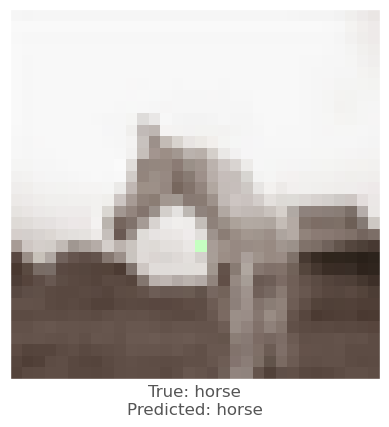



-0.001447916
-0.0034641623
0.0020002723
vr, vg, vb :   -1.1702639998211528 2.4177634328518027 -1.38952913840289
beam_perturbed_confidence temp :  0.51364326
beam_perturbed_confidence temp :  0.5112636
beam_perturbed_confidence temp :  0.5098861
beam_perturbed_confidence temp :  0.51364326
beam_perturbed_confidence temp :  0.51328456
beam_perturbed_confidence temp :  0.5098861
beam_perturbed_confidence temp :  0.51328456
row index :  2
25th round's confidence : 3th 0.5098861
predicted class :  horse
predicted class's confidence :  0.5098861
Lopt is :  47


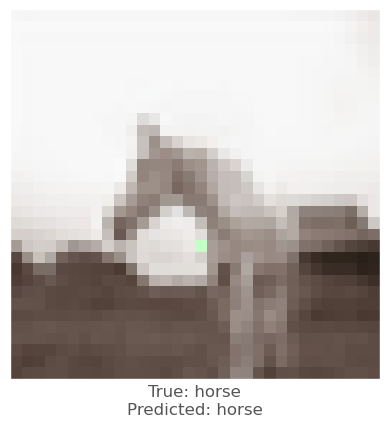



-0.0011741519
-0.004480481
0.00033468008
vr, vg, vb :   -0.7562681980853974 3.216067463036211 -0.8625758708128249
beam_perturbed_confidence temp :  0.5057735
beam_perturbed_confidence temp :  0.50536585
beam_perturbed_confidence temp :  0.5052065
beam_perturbed_confidence temp :  0.5057735
beam_perturbed_confidence temp :  0.5053596
beam_perturbed_confidence temp :  0.5052065
beam_perturbed_confidence temp :  0.5053596
row index :  2
25th round's confidence : 4th 0.5052065
predicted class :  horse
predicted class's confidence :  0.5052065
Lopt is :  47


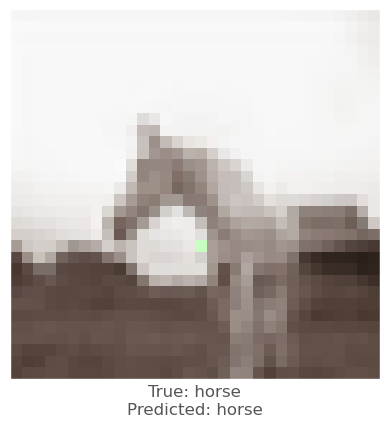



-0.0031419992
-0.005418718
4.839897e-05
vr, vg, vb :   0.7977927578329431 3.8009594234817197 -0.8439812833487456
beam_perturbed_confidence temp :  0.50930506
beam_perturbed_confidence temp :  0.50930506
beam_perturbed_confidence temp :  0.5094368
beam_perturbed_confidence temp :  0.50930506
beam_perturbed_confidence temp :  0.5094368
beam_perturbed_confidence temp :  0.5094368
beam_perturbed_confidence temp :  0.5094368
row index :  0
26th round's confidence : 0th 0.50930506
predicted class :  horse
predicted class's confidence :  0.50930506
Lopt is :  47


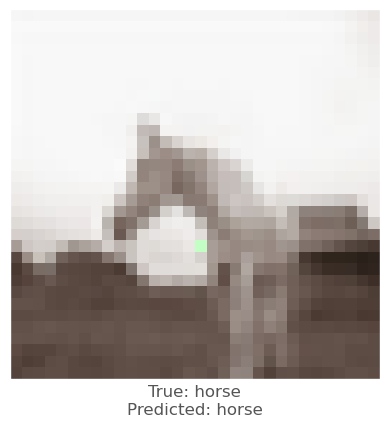



-0.0023278594
-0.0044156313
3.8027763e-05
vr, vg, vb :   -0.17868608403669506 3.5470482109365906 -0.95671773617358
beam_perturbed_confidence temp :  0.5084336
beam_perturbed_confidence temp :  0.50728667
beam_perturbed_confidence temp :  0.5072601
beam_perturbed_confidence temp :  0.5084336
beam_perturbed_confidence temp :  0.50836945
beam_perturbed_confidence temp :  0.5072601
beam_perturbed_confidence temp :  0.50836945
row index :  2
26th round's confidence : 1th 0.5072601
predicted class :  horse
predicted class's confidence :  0.5072601
Lopt is :  47


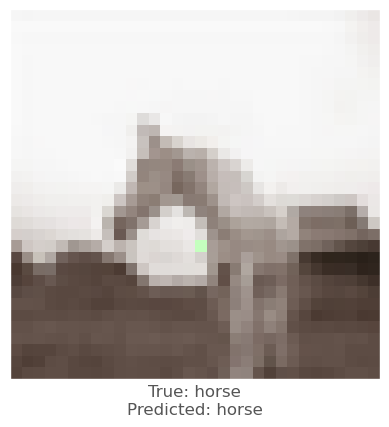



-0.0016555786
-0.0053622127
0.00033557415
vr, vg, vb :   -0.02536896063244315 3.8766461190200476 -0.9249128646269845
beam_perturbed_confidence temp :  0.50742906
beam_perturbed_confidence temp :  0.5059854
beam_perturbed_confidence temp :  0.5060004
beam_perturbed_confidence temp :  0.50742906
beam_perturbed_confidence temp :  0.5072981
beam_perturbed_confidence temp :  0.5060004
beam_perturbed_confidence temp :  0.5072981
row index :  1
26th round's confidence : 2th 0.5059854
predicted class :  horse
predicted class's confidence :  0.5059854
Lopt is :  47


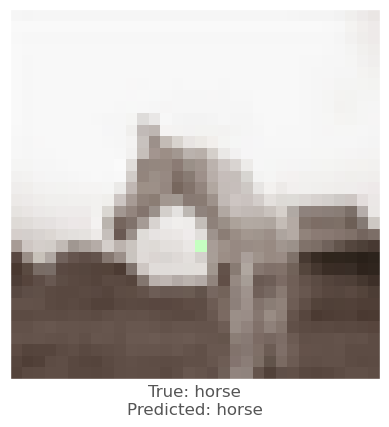



-0.0021969676
-0.004509151
0.00093889236
vr, vg, vb :   -0.8335408396614252 2.6269021877569303 -1.3444654610127964
beam_perturbed_confidence temp :  0.5112182
beam_perturbed_confidence temp :  0.5098861
beam_perturbed_confidence temp :  0.50930506
beam_perturbed_confidence temp :  0.5112182
beam_perturbed_confidence temp :  0.51133454
beam_perturbed_confidence temp :  0.50930506
beam_perturbed_confidence temp :  0.51133454
row index :  2
26th round's confidence : 3th 0.50930506
predicted class :  horse
predicted class's confidence :  0.50930506
Lopt is :  47


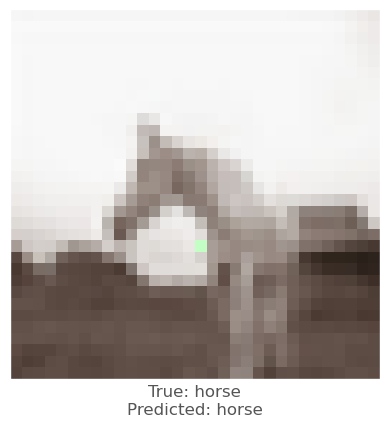



-0.00092583895
-0.0045004487
0.00061166286
vr, vg, vb :   -0.5880574835472434 3.3445055871091767 -0.8374845702000483
beam_perturbed_confidence temp :  0.5053596
beam_perturbed_confidence temp :  0.5052065
beam_perturbed_confidence temp :  0.5047542
beam_perturbed_confidence temp :  0.5053596
beam_perturbed_confidence temp :  0.5051156
beam_perturbed_confidence temp :  0.5047542
beam_perturbed_confidence temp :  0.5051156
row index :  2
26th round's confidence : 4th 0.5047542
predicted class :  horse
predicted class's confidence :  0.5047542
Lopt is :  47


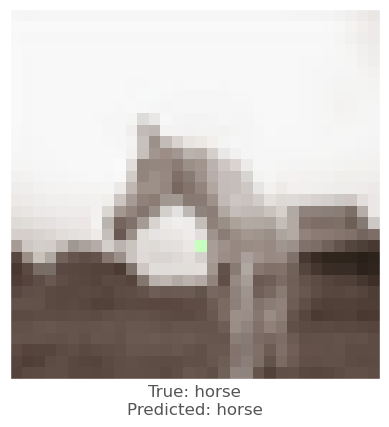



-0.0031419992
-0.005418718
4.839897e-05
vr, vg, vb :   1.032213406518643 3.9627352672511016 -0.7644230521696327
beam_perturbed_confidence temp :  0.50819254
beam_perturbed_confidence temp :  0.50930506
beam_perturbed_confidence temp :  0.5094368
beam_perturbed_confidence temp :  0.50819254
beam_perturbed_confidence temp :  0.50751907
beam_perturbed_confidence temp :  0.5094368
beam_perturbed_confidence temp :  0.50751907
row index :  4
27th round's confidence : 0th 0.50751907
predicted class :  horse
predicted class's confidence :  0.50751907
Lopt is :  47


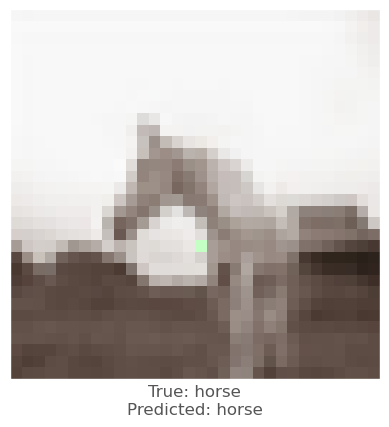



-0.0020344853
-0.0043465495
0.0001309514
vr, vg, vb :   0.042631058378815256 3.6269983409385125 -0.8741411030133753
beam_perturbed_confidence temp :  0.5072601
beam_perturbed_confidence temp :  0.5072601
beam_perturbed_confidence temp :  0.5071557
beam_perturbed_confidence temp :  0.5072601
beam_perturbed_confidence temp :  0.5071557
beam_perturbed_confidence temp :  0.5071557
beam_perturbed_confidence temp :  0.5071557
row index :  2
27th round's confidence : 1th 0.5071557
predicted class :  horse
predicted class's confidence :  0.5071557
Lopt is :  47


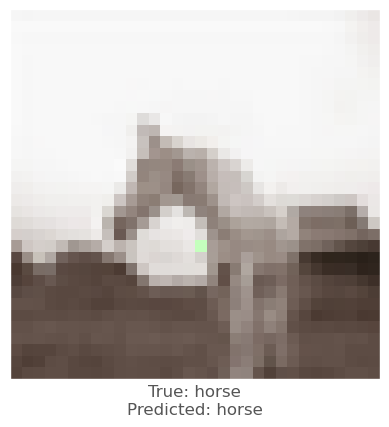



-0.0016555786
-0.0053622127
0.00033557415
vr, vg, vb :   0.14272579675892616 4.025202772910889 -0.865978993172831
beam_perturbed_confidence temp :  0.5059854
beam_perturbed_confidence temp :  0.5059854
beam_perturbed_confidence temp :  0.5060004
beam_perturbed_confidence temp :  0.5059854
beam_perturbed_confidence temp :  0.5060004
beam_perturbed_confidence temp :  0.5060004
beam_perturbed_confidence temp :  0.5060004
row index :  0
27th round's confidence : 2th 0.5059854
predicted class :  horse
predicted class's confidence :  0.5059854
Lopt is :  47


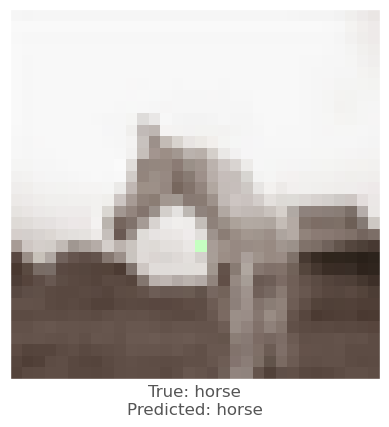



-0.0031419992
-0.005418718
4.839897e-05
vr, vg, vb :   -0.43598683122628856 2.9060837550987912 -1.2148588120672785
beam_perturbed_confidence temp :  0.51133454
beam_perturbed_confidence temp :  0.50930506
beam_perturbed_confidence temp :  0.50942683
beam_perturbed_confidence temp :  0.51133454
beam_perturbed_confidence temp :  0.5113733
beam_perturbed_confidence temp :  0.50942683
beam_perturbed_confidence temp :  0.5113733
row index :  1
27th round's confidence : 3th 0.50930506
predicted class :  horse
predicted class's confidence :  0.50930506
Lopt is :  47


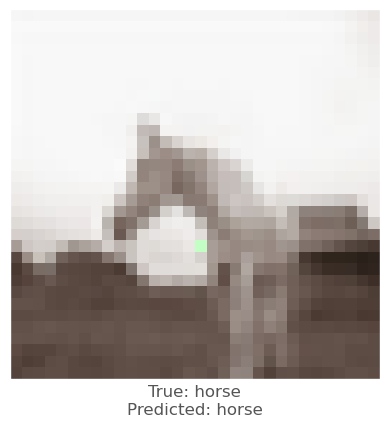



-0.0005286932
-0.0043202043
0.0009304881
vr, vg, vb :   -0.47638241527674763 3.442075454194768 -0.8467849241389058
beam_perturbed_confidence temp :  0.5051156
beam_perturbed_confidence temp :  0.5047542
beam_perturbed_confidence temp :  0.50427604
beam_perturbed_confidence temp :  0.5051156
beam_perturbed_confidence temp :  0.5052971
beam_perturbed_confidence temp :  0.50427604
beam_perturbed_confidence temp :  0.5052971
row index :  2
27th round's confidence : 4th 0.50427604
predicted class :  horse
predicted class's confidence :  0.50427604
Lopt is :  47


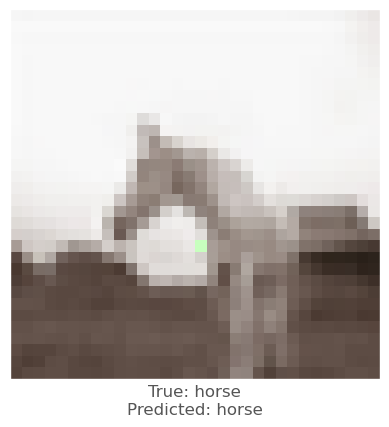



-0.0025556684
-0.005331874
0.0008767247
vr, vg, vb :   1.1845589012702211 4.09964912989977 -0.7756532189527915
beam_perturbed_confidence temp :  0.5068811
beam_perturbed_confidence temp :  0.50751907
beam_perturbed_confidence temp :  0.5073158
beam_perturbed_confidence temp :  0.5068811
beam_perturbed_confidence temp :  0.506336
beam_perturbed_confidence temp :  0.5073158
beam_perturbed_confidence temp :  0.506336
row index :  4
28th round's confidence : 0th 0.506336
predicted class :  horse
predicted class's confidence :  0.506336
Lopt is :  47


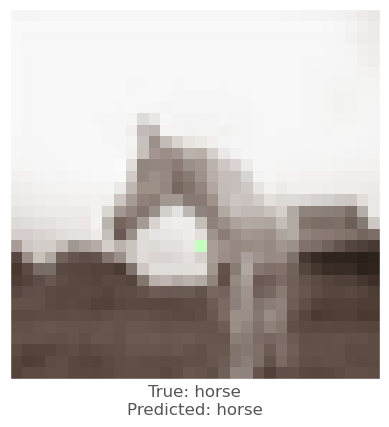



-0.001657486
-0.004343748
8.046627e-05
vr, vg, vb :   0.20411654873233998 3.698673316109798 -0.7947736197567156
beam_perturbed_confidence temp :  0.5071557
beam_perturbed_confidence temp :  0.5071557
beam_perturbed_confidence temp :  0.5071796
beam_perturbed_confidence temp :  0.5071557
beam_perturbed_confidence temp :  0.5071796
beam_perturbed_confidence temp :  0.5071796
beam_perturbed_confidence temp :  0.5071796
row index :  0
28th round's confidence : 1th 0.5071557
predicted class :  horse
predicted class's confidence :  0.5071557
Lopt is :  47


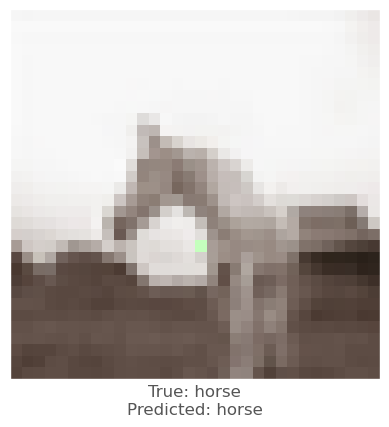



-0.0016555786
-0.0053622127
0.00033557415
vr, vg, vb :   0.2940110784111586 4.158903761412647 -0.8129385088640928
beam_perturbed_confidence temp :  0.5059854
beam_perturbed_confidence temp :  0.5059854
beam_perturbed_confidence temp :  0.5060004
beam_perturbed_confidence temp :  0.5059854
beam_perturbed_confidence temp :  0.5060004
beam_perturbed_confidence temp :  0.5060004
beam_perturbed_confidence temp :  0.5060004
row index :  0
28th round's confidence : 2th 0.5059854
predicted class :  horse
predicted class's confidence :  0.5059854
Lopt is :  47


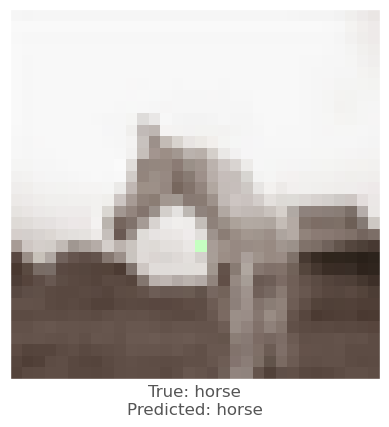



-0.0031419992
-0.005418718
4.839897e-05
vr, vg, vb :   -0.0781882236346656 3.157347165706466 -1.0982128280163124
beam_perturbed_confidence temp :  0.51133454
beam_perturbed_confidence temp :  0.50930506
beam_perturbed_confidence temp :  0.50942683
beam_perturbed_confidence temp :  0.51133454
beam_perturbed_confidence temp :  0.5113733
beam_perturbed_confidence temp :  0.50942683
beam_perturbed_confidence temp :  0.5113733
row index :  1
28th round's confidence : 3th 0.50930506
predicted class :  horse
predicted class's confidence :  0.50930506
Lopt is :  47


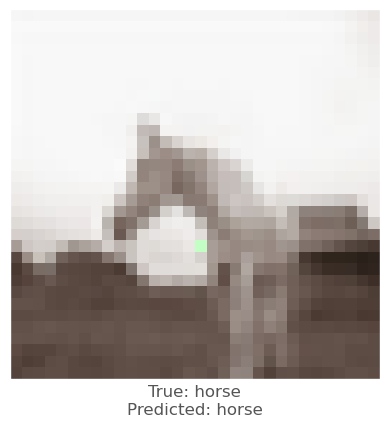



-0.00096952915
-0.0047570467
0.00031721592
vr, vg, vb :   -0.3317912585574225 3.573572578727684 -0.7938280236744781
beam_perturbed_confidence temp :  0.5052971
beam_perturbed_confidence temp :  0.50427604
beam_perturbed_confidence temp :  0.50443697
beam_perturbed_confidence temp :  0.5052971
beam_perturbed_confidence temp :  0.50568354
beam_perturbed_confidence temp :  0.50443697
beam_perturbed_confidence temp :  0.50568354
row index :  1
28th round's confidence : 4th 0.50427604
predicted class :  horse
predicted class's confidence :  0.50427604
Lopt is :  47


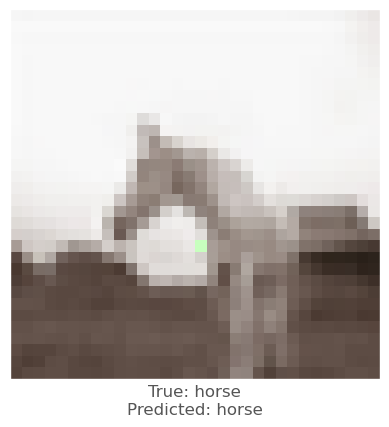



-0.0012514591
-0.0049204826
0.0008957386
vr, vg, vb :   1.1912489233136092 4.181732480459598 -0.7876617572259694
beam_perturbed_confidence temp :  0.50606436
beam_perturbed_confidence temp :  0.506336
beam_perturbed_confidence temp :  0.5059854
beam_perturbed_confidence temp :  0.50606436
beam_perturbed_confidence temp :  0.5057735
beam_perturbed_confidence temp :  0.5059854
beam_perturbed_confidence temp :  0.5057735
row index :  4
29th round's confidence : 0th 0.5057735
predicted class :  horse
predicted class's confidence :  0.5057735
Lopt is :  47


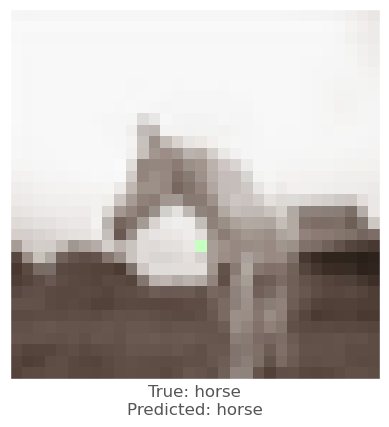



-0.001657486
-0.004343748
8.046627e-05
vr, vg, vb :   0.34945349005051224 3.763180793763955 -0.7233428848257217
beam_perturbed_confidence temp :  0.5071557
beam_perturbed_confidence temp :  0.5071557
beam_perturbed_confidence temp :  0.5071796
beam_perturbed_confidence temp :  0.5071557
beam_perturbed_confidence temp :  0.5071796
beam_perturbed_confidence temp :  0.5071796
beam_perturbed_confidence temp :  0.5071796
row index :  0
29th round's confidence : 1th 0.5071557
predicted class :  horse
predicted class's confidence :  0.5071557
Lopt is :  47


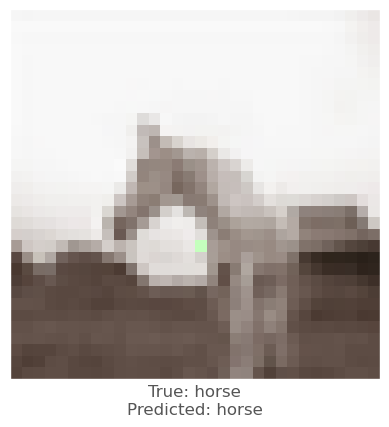



-0.0016555786
-0.0053622127
0.00033557415
vr, vg, vb :   0.43016783189816776 4.279234651064229 -0.7652020729862284
beam_perturbed_confidence temp :  0.5059854
beam_perturbed_confidence temp :  0.5059854
beam_perturbed_confidence temp :  0.5060004
beam_perturbed_confidence temp :  0.5059854
beam_perturbed_confidence temp :  0.5060004
beam_perturbed_confidence temp :  0.5060004
beam_perturbed_confidence temp :  0.5060004
row index :  0
29th round's confidence : 2th 0.5059854
predicted class :  horse
predicted class's confidence :  0.5059854
Lopt is :  47


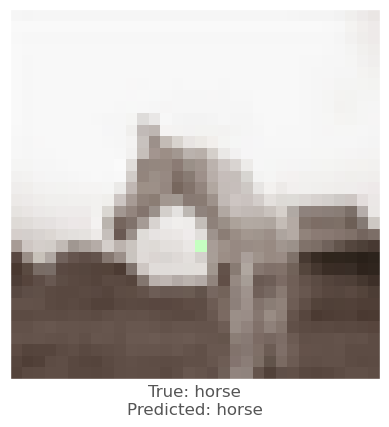



-0.0031419992
-0.005418718
4.839897e-05
vr, vg, vb :   0.24383052319779508 3.3834842352533734 -0.9932314423704429
beam_perturbed_confidence temp :  0.50930506
beam_perturbed_confidence temp :  0.50930506
beam_perturbed_confidence temp :  0.5094368
beam_perturbed_confidence temp :  0.50930506
beam_perturbed_confidence temp :  0.5094368
beam_perturbed_confidence temp :  0.5094368
beam_perturbed_confidence temp :  0.5094368
row index :  0
29th round's confidence : 3th 0.50930506
predicted class :  horse
predicted class's confidence :  0.50930506
Lopt is :  47


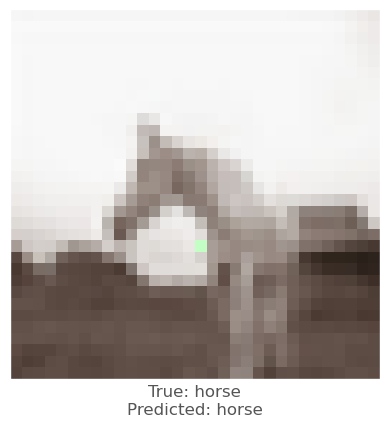



-0.00096952915
-0.0047570467
0.00031721592
vr, vg, vb :   -0.20165921751002985 3.691919990807308 -0.7461668132564933
beam_perturbed_confidence temp :  0.5052971
beam_perturbed_confidence temp :  0.50427604
beam_perturbed_confidence temp :  0.50443697
beam_perturbed_confidence temp :  0.5052971
beam_perturbed_confidence temp :  0.50568354
beam_perturbed_confidence temp :  0.50443697
beam_perturbed_confidence temp :  0.50568354
row index :  1
29th round's confidence : 4th 0.50427604
predicted class :  horse
predicted class's confidence :  0.50427604
Lopt is :  47


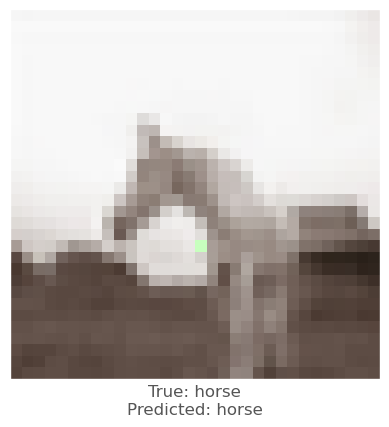






7th sensitive pixel
original confidence is :  0.69673544 

original r,g,b :  211 207 203
0.0009421706
0.0023653507
-0.0023390055
vr, vg, vb :   -0.09421706199645996 -0.23653507232666016 0.2339005470275879
beam_perturbed_confidence temp :  0.6962688
beam_perturbed_confidence temp :  0.6956367
beam_perturbed_confidence temp :  0.69673544
beam_perturbed_confidence temp :  0.69486284
beam_perturbed_confidence temp :  0.6962688
beam_perturbed_confidence temp :  0.6956367
beam_perturbed_confidence temp :  0.69486284
row index :  3
0th round's confidence : 0th 0.69486284
predicted class :  horse
predicted class's confidence :  0.69486284
Lopt is :  1


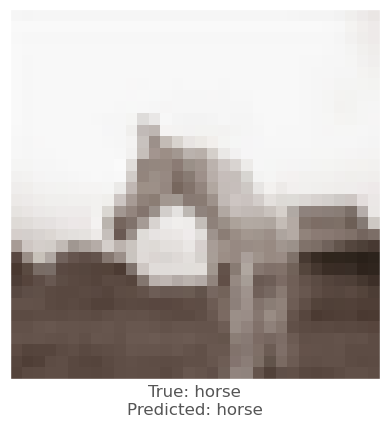



0.0046515465
0.005794823
0.0002117157
vr, vg, vb :   -0.46515464782714844 -0.5794823169708252 -0.02117156982421875
beam_perturbed_confidence temp :  0.68013644
beam_perturbed_confidence temp :  0.6798169
beam_perturbed_confidence temp :  0.6820553
beam_perturbed_confidence temp :  0.6780484
beam_perturbed_confidence temp :  0.6799578
beam_perturbed_confidence temp :  0.6793848
beam_perturbed_confidence temp :  0.67788684
row index :  6
0th round's confidence : 1th 0.67788684
predicted class :  horse
predicted class's confidence :  0.67788684
Lopt is :  6


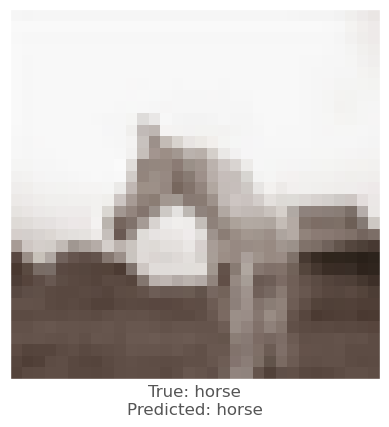



0.0010044575
0.0019180775
-0.0011110902
vr, vg, vb :   -0.10044574737548828 -0.19180774688720703 0.11110901832580566
beam_perturbed_confidence temp :  0.6985485
beam_perturbed_confidence temp :  0.6979673
beam_perturbed_confidence temp :  0.6990047
beam_perturbed_confidence temp :  0.69745386
beam_perturbed_confidence temp :  0.6985485
beam_perturbed_confidence temp :  0.6979673
beam_perturbed_confidence temp :  0.69745386
row index :  3
0th round's confidence : 2th 0.69745386
predicted class :  horse
predicted class's confidence :  0.69745386
Lopt is :  5


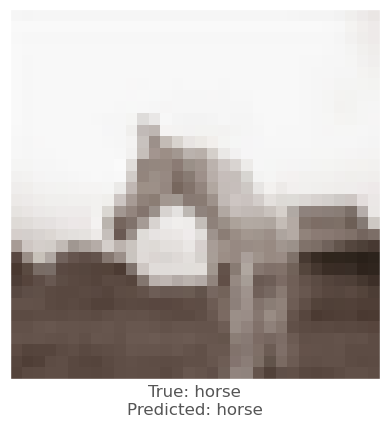



0.002056241
0.003764093
-0.00086045265
vr, vg, vb :   -0.20562410354614258 -0.37640929222106934 0.0860452651977539
beam_perturbed_confidence temp :  0.66559225
beam_perturbed_confidence temp :  0.6648575
beam_perturbed_confidence temp :  0.66700155
beam_perturbed_confidence temp :  0.6632996
beam_perturbed_confidence temp :  0.66559225
beam_perturbed_confidence temp :  0.6648575
beam_perturbed_confidence temp :  0.6632996
row index :  3
0th round's confidence : 3th 0.6632996
predicted class :  horse
predicted class's confidence :  0.6632996
Lopt is :  11


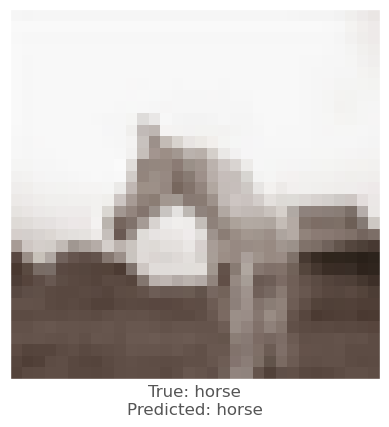



0.0017105341
-0.00091934204
5.6743622e-05
vr, vg, vb :   -0.17105340957641602 0.0919342041015625 -0.0056743621826171875
beam_perturbed_confidence temp :  0.70329577
beam_perturbed_confidence temp :  0.7041031
beam_perturbed_confidence temp :  0.70413053
beam_perturbed_confidence temp :  0.70329577
beam_perturbed_confidence temp :  0.7033289
beam_perturbed_confidence temp :  0.70413053
beam_perturbed_confidence temp :  0.7033289
row index :  0
0th round's confidence : 4th 0.70329577
predicted class :  horse
predicted class's confidence :  0.70329577
Lopt is :  10


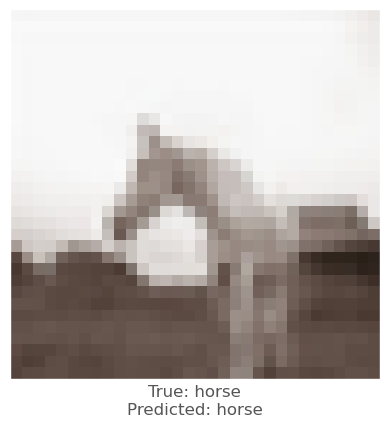



0.002023816
0.003631413
-0.0019016266
vr, vg, vb :   -0.2871769666671753 -0.5760228633880615 0.40067315101623535
beam_perturbed_confidence temp :  0.6936129
beam_perturbed_confidence temp :  0.6926374
beam_perturbed_confidence temp :  0.69486284
beam_perturbed_confidence temp :  0.6912757
beam_perturbed_confidence temp :  0.6936129
beam_perturbed_confidence temp :  0.6926374
beam_perturbed_confidence temp :  0.6912757
row index :  3
1th round's confidence : 0th 0.6912757
predicted class :  horse
predicted class's confidence :  0.6912757
Lopt is :  2


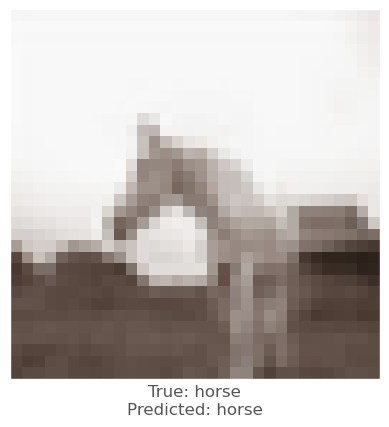



0.002821684
0.0040255785
2.861023e-05
vr, vg, vb :   -0.7008075714111328 -0.9240919351577759 -0.021915435791015625
beam_perturbed_confidence temp :  0.67656314
beam_perturbed_confidence temp :  0.6759322
beam_perturbed_confidence temp :  0.67801976
beam_perturbed_confidence temp :  0.6743119
beam_perturbed_confidence temp :  0.676383
beam_perturbed_confidence temp :  0.6756856
beam_perturbed_confidence temp :  0.6742741
row index :  6
1th round's confidence : 1th 0.6742741
predicted class :  horse
predicted class's confidence :  0.6742741
Lopt is :  7


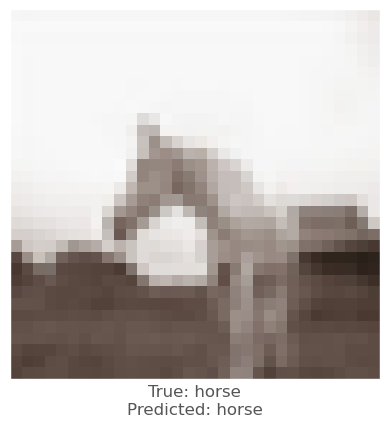



0.0011864901
0.002230525
-0.0012421012
vr, vg, vb :   -0.20905017852783203 -0.3956794738769531 0.22420823574066162
beam_perturbed_confidence temp :  0.6967808
beam_perturbed_confidence temp :  0.696318
beam_perturbed_confidence temp :  0.69745386
beam_perturbed_confidence temp :  0.69579685
beam_perturbed_confidence temp :  0.6967808
beam_perturbed_confidence temp :  0.696318
beam_perturbed_confidence temp :  0.69579685
row index :  3
1th round's confidence : 2th 0.69579685
predicted class :  horse
predicted class's confidence :  0.69579685
Lopt is :  5


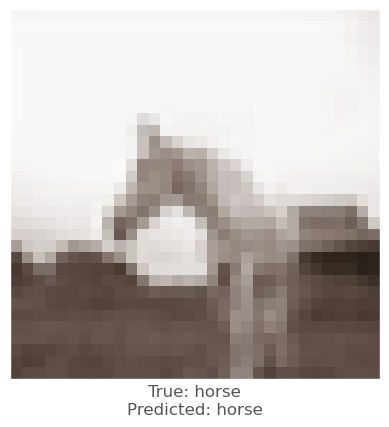



0.0027641654
0.0040843487
-0.0004247427
vr, vg, vb :   -0.46147823333740234 -0.7472032308578491 0.11991500854492188
beam_perturbed_confidence temp :  0.66209334
beam_perturbed_confidence temp :  0.6615079
beam_perturbed_confidence temp :  0.6632996
beam_perturbed_confidence temp :  0.6604849
beam_perturbed_confidence temp :  0.66209334
beam_perturbed_confidence temp :  0.6615079
beam_perturbed_confidence temp :  0.6604849
row index :  3
1th round's confidence : 3th 0.6604849
predicted class :  horse
predicted class's confidence :  0.6604849
Lopt is :  12


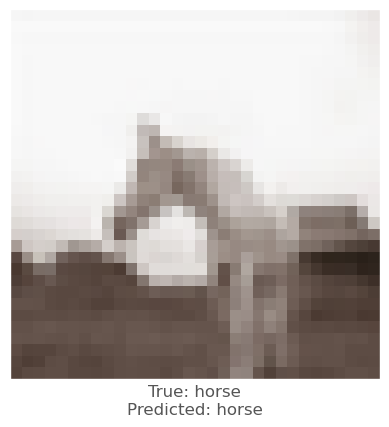



0.0015676618
-0.0008049607
-0.0001604557
vr, vg, vb :   -0.3107142448425293 0.1632368564605713 0.010938644409179688
beam_perturbed_confidence temp :  0.70253545
beam_perturbed_confidence temp :  0.70329577
beam_perturbed_confidence temp :  0.70329577
beam_perturbed_confidence temp :  0.70253545
beam_perturbed_confidence temp :  0.70253545
beam_perturbed_confidence temp :  0.70329577
beam_perturbed_confidence temp :  0.70253545
row index :  0
1th round's confidence : 4th 0.70253545
predicted class :  horse
predicted class's confidence :  0.70253545
Lopt is :  10


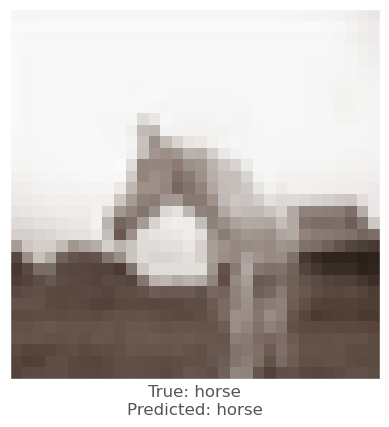



0.0023402572
0.0040093064
-0.0023205876
vr, vg, vb :   -0.492484986782074 -0.9193512201309204 0.5926645994186401
beam_perturbed_confidence temp :  0.6902971
beam_perturbed_confidence temp :  0.68960357
beam_perturbed_confidence temp :  0.6912757
beam_perturbed_confidence temp :  0.68882006
beam_perturbed_confidence temp :  0.6902971
beam_perturbed_confidence temp :  0.68960357
beam_perturbed_confidence temp :  0.68882006
row index :  3
2th round's confidence : 0th 0.68882006
predicted class :  horse
predicted class's confidence :  0.68882006
Lopt is :  3


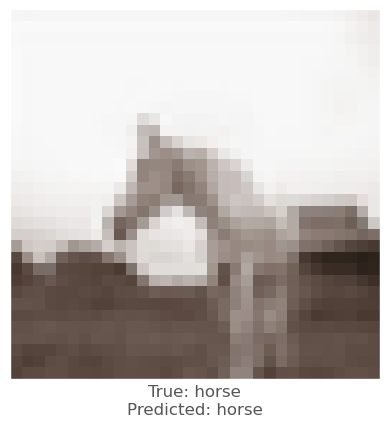



0.002862513
0.0040369034
-8.7320805e-05
vr, vg, vb :   -0.916978120803833 -1.235373079776764 -0.010991811752319336
beam_perturbed_confidence temp :  0.6728231
beam_perturbed_confidence temp :  0.67063594
beam_perturbed_confidence temp :  0.6743992
beam_perturbed_confidence temp :  0.670221
beam_perturbed_confidence temp :  0.67283463
beam_perturbed_confidence temp :  0.67077
beam_perturbed_confidence temp :  0.670251
row index :  3
2th round's confidence : 1th 0.670221
predicted class :  horse
predicted class's confidence :  0.670221
Lopt is :  9


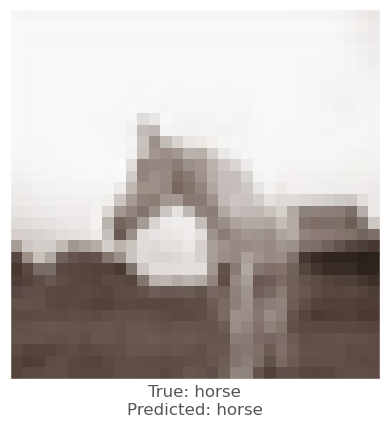



0.0012912154
0.0020971298
-0.0012016296
vr, vg, vb :   -0.31726670265197754 -0.5658245086669922 0.32195037603378296
beam_perturbed_confidence temp :  0.69502676
beam_perturbed_confidence temp :  0.6946837
beam_perturbed_confidence temp :  0.69579685
beam_perturbed_confidence temp :  0.6943051
beam_perturbed_confidence temp :  0.69502676
beam_perturbed_confidence temp :  0.6946837
beam_perturbed_confidence temp :  0.6943051
row index :  3
2th round's confidence : 2th 0.6943051
predicted class :  horse
predicted class's confidence :  0.6943051
Lopt is :  5


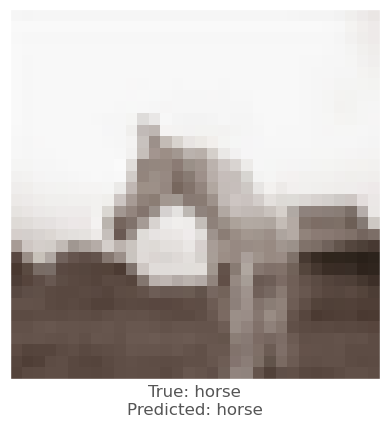



0.0017662048
0.0032100677
-0.00070893764
vr, vg, vb :   -0.5919508934020996 -0.993489682674408 0.1788172721862793
beam_perturbed_confidence temp :  0.6597417
beam_perturbed_confidence temp :  0.6588833
beam_perturbed_confidence temp :  0.6604849
beam_perturbed_confidence temp :  0.6574197
beam_perturbed_confidence temp :  0.6597417
beam_perturbed_confidence temp :  0.6588833
beam_perturbed_confidence temp :  0.6574197
row index :  3
2th round's confidence : 3th 0.6574197
predicted class :  horse
predicted class's confidence :  0.6574197
Lopt is :  13


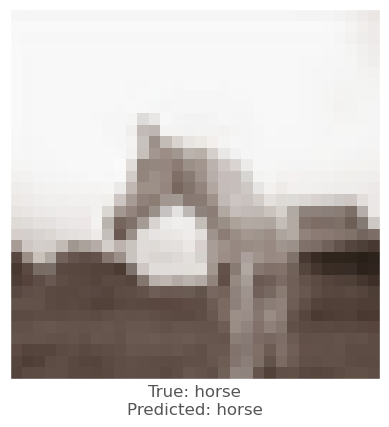



0.0018318295
-0.0006815791
-0.00025355816
vr, vg, vb :   -0.4628257751464844 0.21507108211517334 0.03520059585571289
beam_perturbed_confidence temp :  0.70146394
beam_perturbed_confidence temp :  0.70253545
beam_perturbed_confidence temp :  0.70253545
beam_perturbed_confidence temp :  0.70146394
beam_perturbed_confidence temp :  0.70146394
beam_perturbed_confidence temp :  0.70253545
beam_perturbed_confidence temp :  0.70146394
row index :  0
2th round's confidence : 4th 0.70146394
predicted class :  horse
predicted class's confidence :  0.70146394
Lopt is :  10


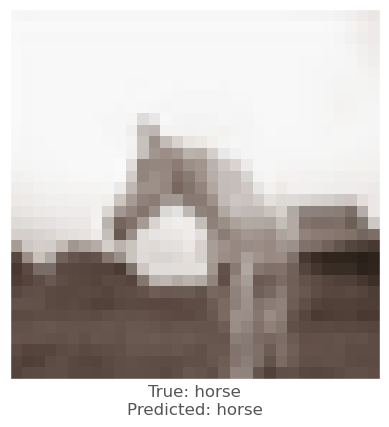



0.0015240908
0.0030446649
-0.0027059913
vr, vg, vb :   -0.5956455647945404 -1.1318825840950013 0.8039972662925721
beam_perturbed_confidence temp :  0.6880795
beam_perturbed_confidence temp :  0.6858029
beam_perturbed_confidence temp :  0.68882006
beam_perturbed_confidence temp :  0.6842781
beam_perturbed_confidence temp :  0.6880795
beam_perturbed_confidence temp :  0.6858029
beam_perturbed_confidence temp :  0.6842781
row index :  3
3th round's confidence : 0th 0.6842781
predicted class :  horse
predicted class's confidence :  0.6842781
Lopt is :  5


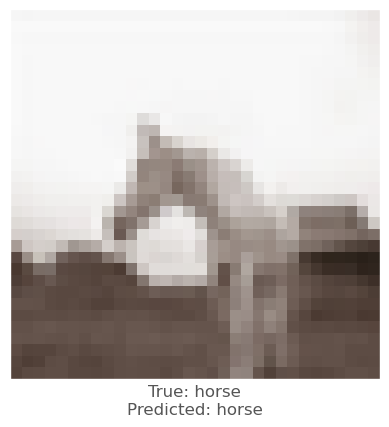



0.00180614
0.0028237104
-0.00024282932
vr, vg, vb :   -1.0058943033218384 -1.3942068159580232 0.014390301704406737
beam_perturbed_confidence temp :  0.6675651
beam_perturbed_confidence temp :  0.6658797
beam_perturbed_confidence temp :  0.670221
beam_perturbed_confidence temp :  0.6638037
beam_perturbed_confidence temp :  0.6675651
beam_perturbed_confidence temp :  0.6658797
beam_perturbed_confidence temp :  0.6638037
row index :  3
3th round's confidence : 1th 0.6638037
predicted class :  horse
predicted class's confidence :  0.6638037
Lopt is :  11


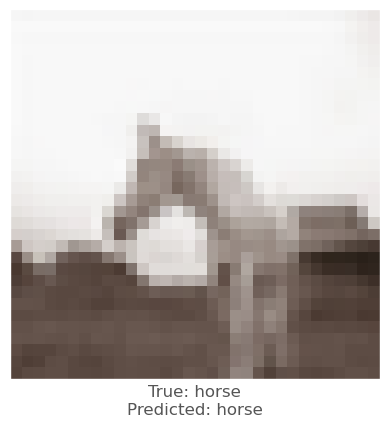



0.001311779
0.0020332336
-0.0015004873
vr, vg, vb :   -0.41671793460845946 -0.7125654220581055 0.43980407118797304
beam_perturbed_confidence temp :  0.6933719
beam_perturbed_confidence temp :  0.6929935
beam_perturbed_confidence temp :  0.6943051
beam_perturbed_confidence temp :  0.6924454
beam_perturbed_confidence temp :  0.6933719
beam_perturbed_confidence temp :  0.6929935
beam_perturbed_confidence temp :  0.6924454
row index :  3
3th round's confidence : 2th 0.6924454
predicted class :  horse
predicted class's confidence :  0.6924454
Lopt is :  5


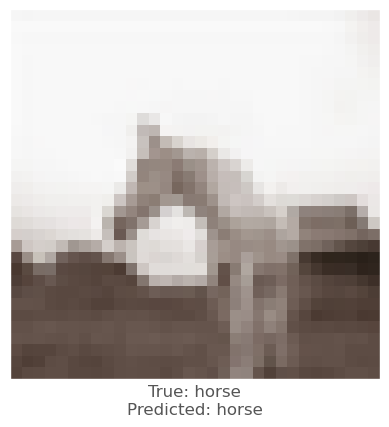



0.0045679808
0.0065772533
0.0007790923
vr, vg, vb :   -0.9895538806915284 -1.5518660485744475 0.08302631378173828
beam_perturbed_confidence temp :  0.6543153
beam_perturbed_confidence temp :  0.6476649
beam_perturbed_confidence temp :  0.6574197
beam_perturbed_confidence temp :  0.6440305
beam_perturbed_confidence temp :  0.6543153
beam_perturbed_confidence temp :  0.6476649
beam_perturbed_confidence temp :  0.6440305
row index :  3
3th round's confidence : 3th 0.6440305
predicted class :  horse
predicted class's confidence :  0.6440305
Lopt is :  15


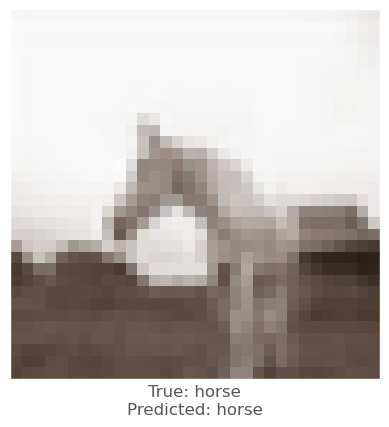



0.002229035
-0.0006943345
-0.00059217215
vr, vg, vb :   -0.6394466876983642 0.2629974246025085 0.0908977508544922
beam_perturbed_confidence temp :  0.7003064
beam_perturbed_confidence temp :  0.70146394
beam_perturbed_confidence temp :  0.70146394
beam_perturbed_confidence temp :  0.7003064
beam_perturbed_confidence temp :  0.7003064
beam_perturbed_confidence temp :  0.70146394
beam_perturbed_confidence temp :  0.7003064
row index :  0
3th round's confidence : 4th 0.7003064
predicted class :  horse
predicted class's confidence :  0.7003064
Lopt is :  10


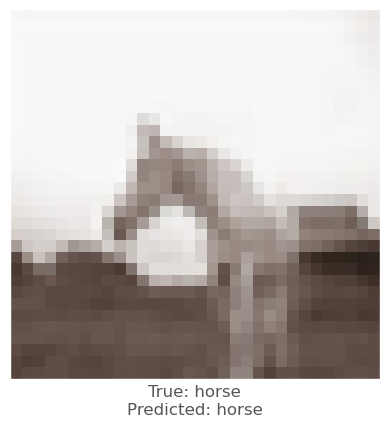



0.003462255
0.004770994
-0.00042426586
vr, vg, vb :   -0.882306508421898 -1.495793744325638 0.7660241258144379
beam_perturbed_confidence temp :  0.6823406
beam_perturbed_confidence temp :  0.67884886
beam_perturbed_confidence temp :  0.6842781
beam_perturbed_confidence temp :  0.6769115
beam_perturbed_confidence temp :  0.6823406
beam_perturbed_confidence temp :  0.67884886
beam_perturbed_confidence temp :  0.6769115
row index :  3
4th round's confidence : 0th 0.6769115
predicted class :  horse
predicted class's confidence :  0.6769115
Lopt is :  7


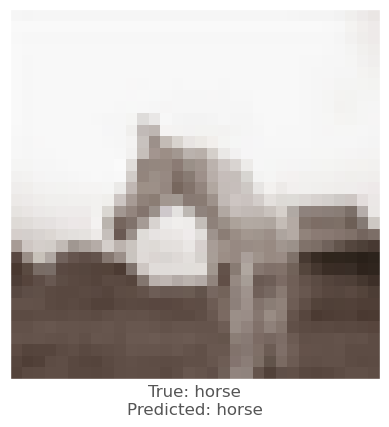



0.0019167662
0.004158616
-0.0012638569
vr, vg, vb :   -1.0969814896583556 -1.6706477409601213 0.13933696031570433
beam_perturbed_confidence temp :  0.66136116
beam_perturbed_confidence temp :  0.6578934
beam_perturbed_confidence temp :  0.6638037
beam_perturbed_confidence temp :  0.65631646
beam_perturbed_confidence temp :  0.66136116
beam_perturbed_confidence temp :  0.6578934
beam_perturbed_confidence temp :  0.65631646
row index :  3
4th round's confidence : 1th 0.65631646
predicted class :  horse
predicted class's confidence :  0.65631646
Lopt is :  13


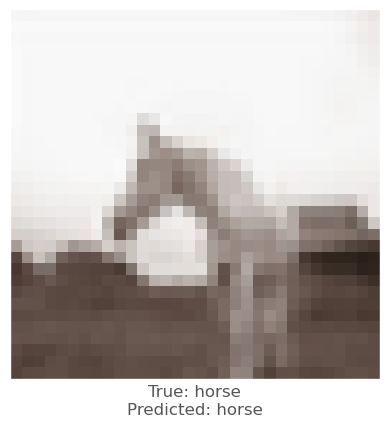



0.0015218258
0.0021292567
-0.0013344288
vr, vg, vb :   -0.5272287201881409 -0.8542345523834228 0.5292665427923202
beam_perturbed_confidence temp :  0.6914717
beam_perturbed_confidence temp :  0.69124264
beam_perturbed_confidence temp :  0.6924454
beam_perturbed_confidence temp :  0.690579
beam_perturbed_confidence temp :  0.6914717
beam_perturbed_confidence temp :  0.69124264
beam_perturbed_confidence temp :  0.690579
row index :  3
4th round's confidence : 2th 0.690579
predicted class :  horse
predicted class's confidence :  0.690579
Lopt is :  5


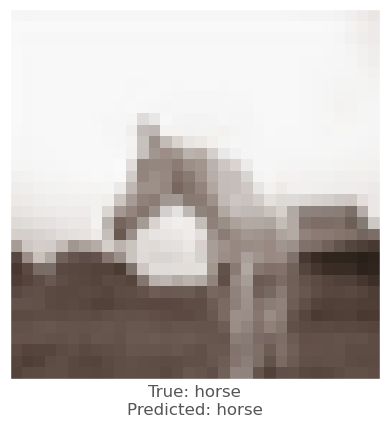



0.006975949
0.010236323
-0.00097543
vr, vg, vb :   -1.5881933736801148 -2.420311731696129 0.1722666835784912
beam_perturbed_confidence temp :  0.63710594
beam_perturbed_confidence temp :  0.62589765
beam_perturbed_confidence temp :  0.6440305
beam_perturbed_confidence temp :  0.6181591
beam_perturbed_confidence temp :  0.63710594
beam_perturbed_confidence temp :  0.62589765
beam_perturbed_confidence temp :  0.6181591
row index :  3
4th round's confidence : 3th 0.6181591
predicted class :  horse
predicted class's confidence :  0.6181591
Lopt is :  18


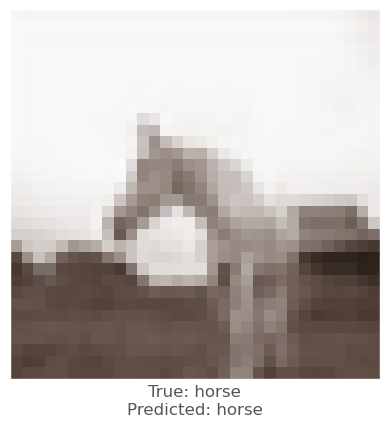



0.0023073554
-0.00018656254
-0.0010895133
vr, vg, vb :   -0.8062375593185425 0.25535393595695494 0.1907593059539795
beam_perturbed_confidence temp :  0.6991566
beam_perturbed_confidence temp :  0.7003064
beam_perturbed_confidence temp :  0.7003064
beam_perturbed_confidence temp :  0.6991566
beam_perturbed_confidence temp :  0.6991566
beam_perturbed_confidence temp :  0.7003064
beam_perturbed_confidence temp :  0.6991566
row index :  0
4th round's confidence : 4th 0.6991566
predicted class :  horse
predicted class's confidence :  0.6991566
Lopt is :  10


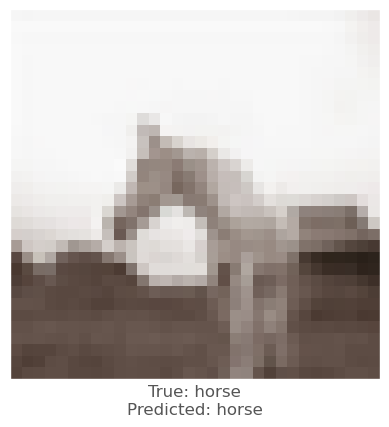



0.0036538243
0.005918503
-0.0014873743
vr, vg, vb :   -1.1594582905173303 -1.938064650654793 0.8381591438055039
beam_perturbed_confidence temp :  0.6735201
beam_perturbed_confidence temp :  0.67046434
beam_perturbed_confidence temp :  0.6769115
beam_perturbed_confidence temp :  0.66721654
beam_perturbed_confidence temp :  0.6735201
beam_perturbed_confidence temp :  0.67046434
beam_perturbed_confidence temp :  0.66721654
row index :  3
5th round's confidence : 0th 0.66721654
predicted class :  horse
predicted class's confidence :  0.66721654
Lopt is :  9


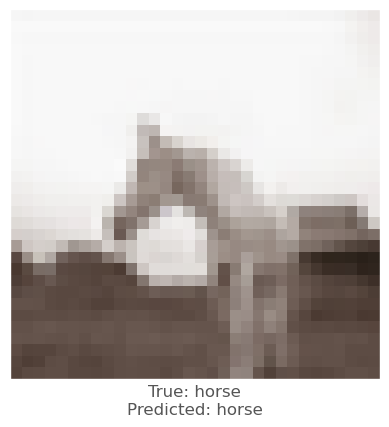



0.0015702248
0.0057347417
-0.0030292869
vr, vg, vb :   -1.1443058168888092 -2.0770571356415752 0.42833195042610167
beam_perturbed_confidence temp :  0.653705
beam_perturbed_confidence temp :  0.6437768
beam_perturbed_confidence temp :  0.65631646
beam_perturbed_confidence temp :  0.63636297
beam_perturbed_confidence temp :  0.653705
beam_perturbed_confidence temp :  0.6437768
beam_perturbed_confidence temp :  0.63636297
row index :  3
5th round's confidence : 1th 0.63636297
predicted class :  horse
predicted class's confidence :  0.63636297
Lopt is :  16


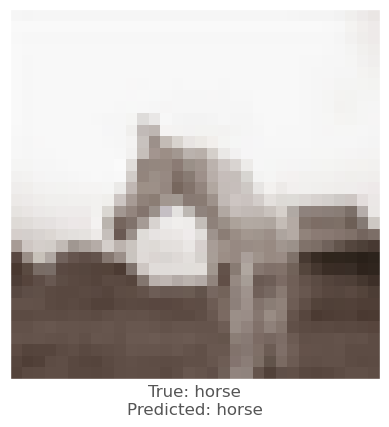



0.001572907
0.002714932
-0.002059579
vr, vg, vb :   -0.6317965452671052 -1.0403042936325073 0.682297778069973
beam_perturbed_confidence temp :  0.6896697
beam_perturbed_confidence temp :  0.6869236
beam_perturbed_confidence temp :  0.690579
beam_perturbed_confidence temp :  0.6865986
beam_perturbed_confidence temp :  0.6896697
beam_perturbed_confidence temp :  0.6869236
beam_perturbed_confidence temp :  0.6865986
row index :  3
5th round's confidence : 2th 0.6865986
predicted class :  horse
predicted class's confidence :  0.6865986
Lopt is :  5


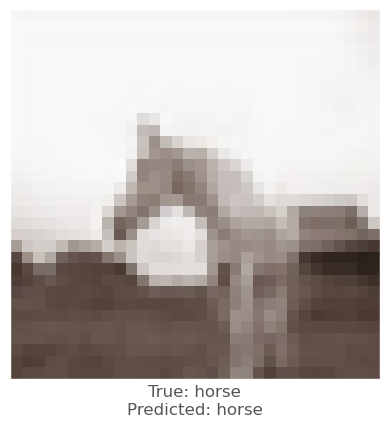



0.007341385
0.012522697
-0.0009588599
vr, vg, vb :   -2.163512525081635 -3.430550303399563 0.250926007270813
beam_perturbed_confidence temp :  0.6039372
beam_perturbed_confidence temp :  0.5861953
beam_perturbed_confidence temp :  0.6181591
beam_perturbed_confidence temp :  0.56108236
beam_perturbed_confidence temp :  0.6039372
beam_perturbed_confidence temp :  0.5861953
beam_perturbed_confidence temp :  0.56108236
row index :  3
5th round's confidence : 3th 0.56108236
predicted class :  horse
predicted class's confidence :  0.56108236
Lopt is :  22


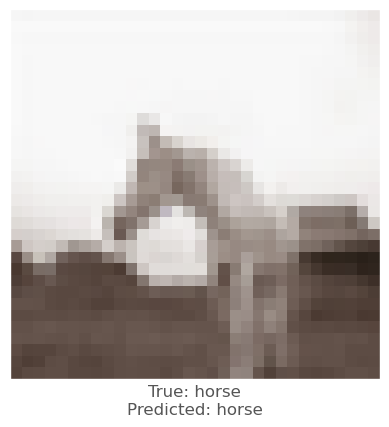



0.0032491088
-0.00077980757
-0.0011647344
vr, vg, vb :   -1.0505246825218202 0.307799299120903 0.2881568117141724
beam_perturbed_confidence temp :  0.6948618
beam_perturbed_confidence temp :  0.6991566
beam_perturbed_confidence temp :  0.6991566
beam_perturbed_confidence temp :  0.6948618
beam_perturbed_confidence temp :  0.6948618
beam_perturbed_confidence temp :  0.6991566
beam_perturbed_confidence temp :  0.6948618
row index :  0
5th round's confidence : 4th 0.6948618
predicted class :  horse
predicted class's confidence :  0.6948618
Lopt is :  10


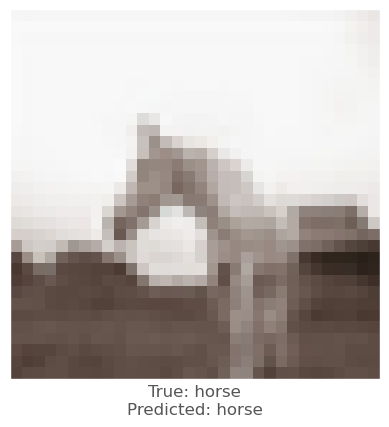



0.002991438
0.006328881
-0.0020525455
vr, vg, vb :   -1.3426562526643278 -2.377146264278889 0.9595977841734887
beam_perturbed_confidence temp :  0.664829
beam_perturbed_confidence temp :  0.6570374
beam_perturbed_confidence temp :  0.66721654
beam_perturbed_confidence temp :  0.65492374
beam_perturbed_confidence temp :  0.664829
beam_perturbed_confidence temp :  0.6570374
beam_perturbed_confidence temp :  0.65492374
row index :  3
6th round's confidence : 0th 0.65492374
predicted class :  horse
predicted class's confidence :  0.65492374
Lopt is :  12


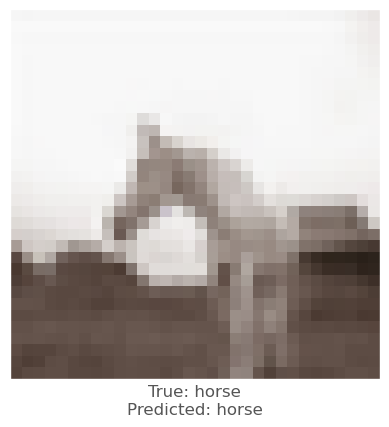



0.006323874
0.010787845
-0.0018356442
vr, vg, vb :   -1.6622626348733902 -2.9481358878672124 0.5690631798982619
beam_perturbed_confidence temp :  0.63009894
beam_perturbed_confidence temp :  0.61747766
beam_perturbed_confidence temp :  0.63636297
beam_perturbed_confidence temp :  0.6088924
beam_perturbed_confidence temp :  0.63009894
beam_perturbed_confidence temp :  0.61747766
beam_perturbed_confidence temp :  0.6088924
row index :  3
6th round's confidence : 1th 0.6088924
predicted class :  horse
predicted class's confidence :  0.6088924
Lopt is :  19


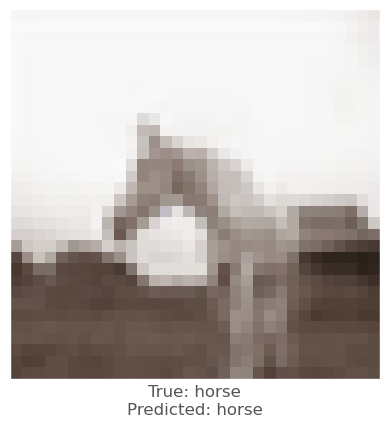



0.000672102
0.0040421486
-0.003878355
vr, vg, vb :   -0.6358270881891251 -1.3404887232780456 1.0019035028874876
beam_perturbed_confidence temp :  0.6862515
beam_perturbed_confidence temp :  0.6819993
beam_perturbed_confidence temp :  0.6846304
beam_perturbed_confidence temp :  0.68071645
beam_perturbed_confidence temp :  0.6843044
beam_perturbed_confidence temp :  0.6805004
beam_perturbed_confidence temp :  0.6792307
row index :  6
6th round's confidence : 2th 0.6792307
predicted class :  horse
predicted class's confidence :  0.6792307
Lopt is :  6


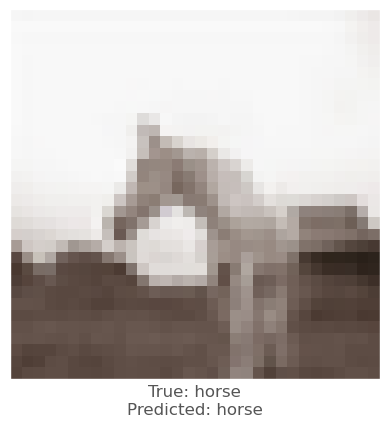



0.020097077
0.026542306
0.0036265254
vr, vg, vb :   -3.95686896185875 -5.741725867694616 -0.1368191336631775
beam_perturbed_confidence temp :  0.5192585
beam_perturbed_confidence temp :  0.47450757
beam_perturbed_confidence temp :  0.5590603
beam_perturbed_confidence temp :  0.43474942
beam_perturbed_confidence temp :  0.5156008
beam_perturbed_confidence temp :  0.47232112
beam_perturbed_confidence temp :  0.43121558
row index :  6
6th round's confidence : 3th 0.43121558
predicted class :  airplane
predicted class's confidence :  0.55929667
Lopt is :  28


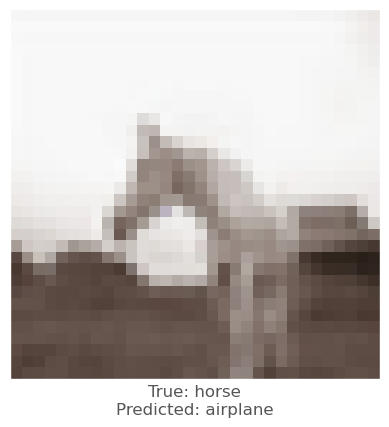




8th sensitive pixel
original confidence is :  0.69673544 

original r,g,b :  222 218 214
0.009484649
0.010678649
0.00249964
vr, vg, vb :   -0.9484648704528809 -1.0678648948669434 -0.24996399879455566
beam_perturbed_confidence temp :  0.6912718
beam_perturbed_confidence temp :  0.68475497
beam_perturbed_confidence temp :  0.69529593
beam_perturbed_confidence temp :  0.67789704
beam_perturbed_confidence temp :  0.6893503
beam_perturbed_confidence temp :  0.68227744
beam_perturbed_confidence temp :  0.6753892
row index :  6
0th round's confidence : 0th 0.6753892
predicted class :  horse
predicted class's confidence :  0.6753892
Lopt is :  2


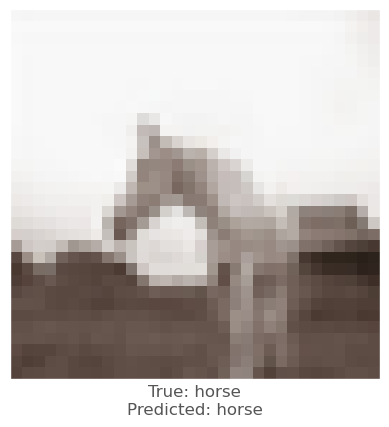



0.0119460225
0.010794282
0.0029931068
vr, vg, vb :   -1.1946022510528564 -1.0794281959533691 -0.29931068420410156
beam_perturbed_confidence temp :  0.6178261
beam_perturbed_confidence temp :  0.6184741
beam_perturbed_confidence temp :  0.6268807
beam_perturbed_confidence temp :  0.6077079
beam_perturbed_confidence temp :  0.6169182
beam_perturbed_confidence temp :  0.61735284
beam_perturbed_confidence temp :  0.6077874
row index :  3
0th round's confidence : 1th 0.6077079
predicted class :  horse
predicted class's confidence :  0.6077079
Lopt is :  7


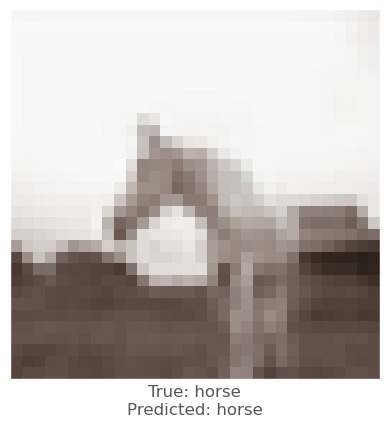



-0.0038375258
-0.007761061
-0.0074732304
vr, vg, vb :   0.38375258445739746 0.7761061191558838 0.7473230361938477
beam_perturbed_confidence temp :  0.7075161
beam_perturbed_confidence temp :  0.7075161
beam_perturbed_confidence temp :  0.7075161
beam_perturbed_confidence temp :  0.7075161
beam_perturbed_confidence temp :  0.7075161
beam_perturbed_confidence temp :  0.7075161
beam_perturbed_confidence temp :  0.7075161
row index :  0
0th round's confidence : 2th 0.7075161
predicted class :  horse
predicted class's confidence :  0.7075161
Lopt is :  5


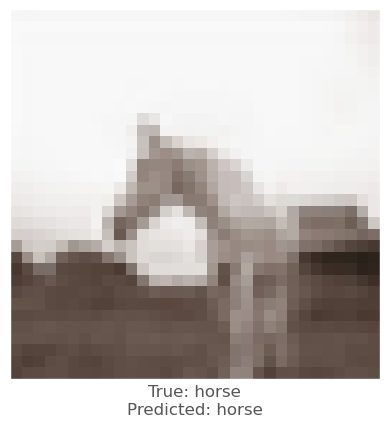



0.0077275634
0.007914245
-0.0027017593
vr, vg, vb :   -0.7727563381195068 -0.7914245128631592 0.2701759338378906
beam_perturbed_confidence temp :  0.5860956
beam_perturbed_confidence temp :  0.5863064
beam_perturbed_confidence temp :  0.5899822
beam_perturbed_confidence temp :  0.58254933
beam_perturbed_confidence temp :  0.5860956
beam_perturbed_confidence temp :  0.5863064
beam_perturbed_confidence temp :  0.58254933
row index :  3
0th round's confidence : 3th 0.58254933
predicted class :  horse
predicted class's confidence :  0.58254933
Lopt is :  11


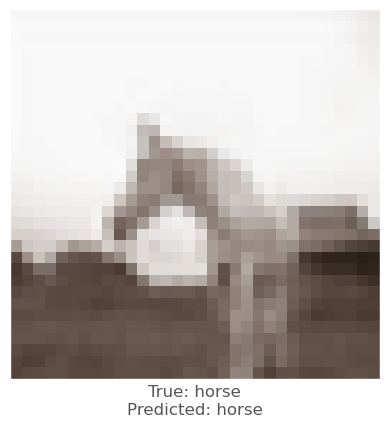



-0.01193136
-0.014844775
-0.01562941
vr, vg, vb :   1.1931359767913818 1.4844775199890137 1.562941074371338
beam_perturbed_confidence temp :  0.61844707
beam_perturbed_confidence temp :  0.6172837
beam_perturbed_confidence temp :  0.6168722
beam_perturbed_confidence temp :  0.612066
beam_perturbed_confidence temp :  0.6105358
beam_perturbed_confidence temp :  0.6095073
beam_perturbed_confidence temp :  0.60499984
row index :  6
0th round's confidence : 4th 0.60499984
predicted class :  horse
predicted class's confidence :  0.60499984
Lopt is :  11


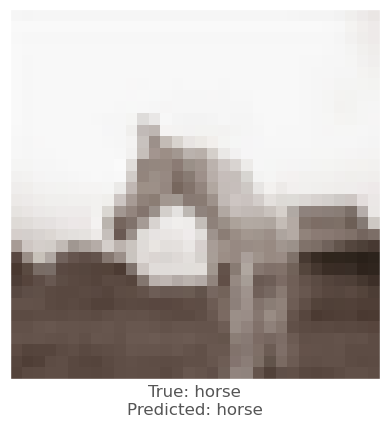



0.013875723
0.014003396
0.0049456954
vr, vg, vb :   -2.2411906719207764 -2.3614180088043213 -0.7195371389389038
beam_perturbed_confidence temp :  0.655161
beam_perturbed_confidence temp :  0.65602785
beam_perturbed_confidence temp :  0.67295134
beam_perturbed_confidence temp :  0.6377567
beam_perturbed_confidence temp :  0.6543563
beam_perturbed_confidence temp :  0.6551792
beam_perturbed_confidence temp :  0.6372537
row index :  6
1th round's confidence : 0th 0.6372537
predicted class :  horse
predicted class's confidence :  0.6372537
Lopt is :  5


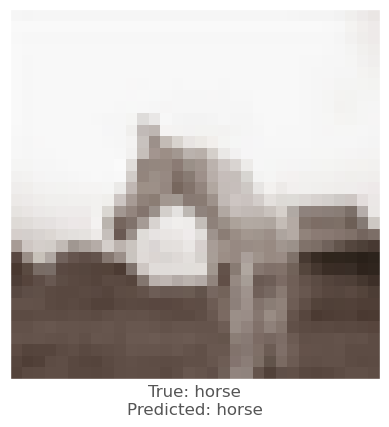



0.009687841
0.010101914
0.00064367056
vr, vg, vb :   -2.0439261198043823 -1.9816768169403076 -0.33374667167663574
beam_perturbed_confidence temp :  0.5961657
beam_perturbed_confidence temp :  0.5983702
beam_perturbed_confidence temp :  0.6077874
beam_perturbed_confidence temp :  0.58547145
beam_perturbed_confidence temp :  0.59806985
beam_perturbed_confidence temp :  0.59956986
beam_perturbed_confidence temp :  0.5874925
row index :  3
1th round's confidence : 1th 0.58547145
predicted class :  horse
predicted class's confidence :  0.58547145
Lopt is :  10


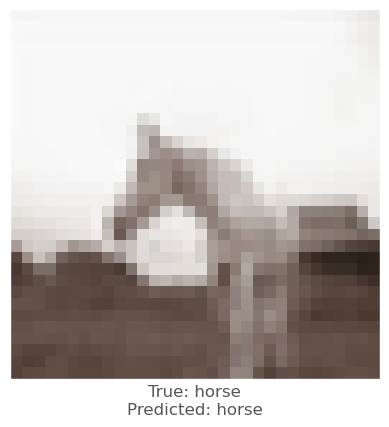



-0.0038375258
-0.007761061
-0.0074732304
vr, vg, vb :   0.7291299104690552 1.4746016263961792 1.4199137687683105
beam_perturbed_confidence temp :  0.7075161
beam_perturbed_confidence temp :  0.70375246
beam_perturbed_confidence temp :  0.70367926
beam_perturbed_confidence temp :  0.70375246
beam_perturbed_confidence temp :  0.70367926
beam_perturbed_confidence temp :  0.69889003
beam_perturbed_confidence temp :  0.69889003
row index :  5
1th round's confidence : 2th 0.69889003
predicted class :  horse
predicted class's confidence :  0.69889003
Lopt is :  6


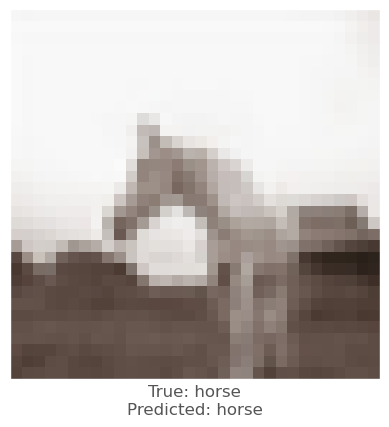



0.008158445
0.0078030825
-0.0037573576
vr, vg, vb :   -1.5113252401351929 -1.492590308189392 0.618894100189209
beam_perturbed_confidence temp :  0.57369727
beam_perturbed_confidence temp :  0.57413757
beam_perturbed_confidence temp :  0.58254933
beam_perturbed_confidence temp :  0.56672835
beam_perturbed_confidence temp :  0.57369727
beam_perturbed_confidence temp :  0.57413757
beam_perturbed_confidence temp :  0.56672835
row index :  3
1th round's confidence : 3th 0.56672835
predicted class :  horse
predicted class's confidence :  0.56672835
Lopt is :  13


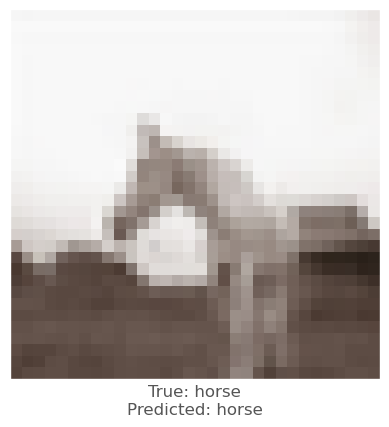



-0.009226739
-0.010120392
-0.013720214
vr, vg, vb :   1.996496319770813 2.348068952560425 2.7786684036254883
beam_perturbed_confidence temp :  0.6002806
beam_perturbed_confidence temp :  0.5980129
beam_perturbed_confidence temp :  0.5917759
beam_perturbed_confidence temp :  0.59710526
beam_perturbed_confidence temp :  0.58960223
beam_perturbed_confidence temp :  0.58756244
beam_perturbed_confidence temp :  0.5873017
row index :  6
1th round's confidence : 4th 0.5873017
predicted class :  horse
predicted class's confidence :  0.5873017
Lopt is :  13


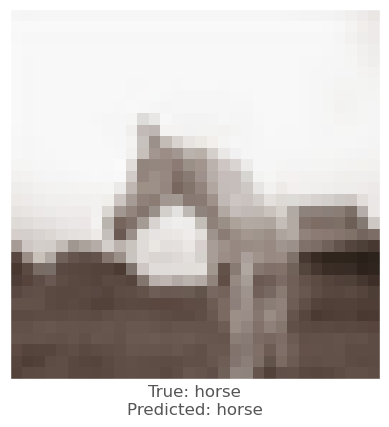



0.010878265
0.010736704
0.0014371872
vr, vg, vb :   -3.1048980951309204 -3.1989465951919556 -0.7913021445274353
beam_perturbed_confidence temp :  0.61349964
beam_perturbed_confidence temp :  0.6135502
beam_perturbed_confidence temp :  0.6363195
beam_perturbed_confidence temp :  0.5905804
beam_perturbed_confidence temp :  0.61309046
beam_perturbed_confidence temp :  0.6126484
beam_perturbed_confidence temp :  0.5919477
row index :  3
2th round's confidence : 0th 0.5905804
predicted class :  horse
predicted class's confidence :  0.5905804
Lopt is :  9


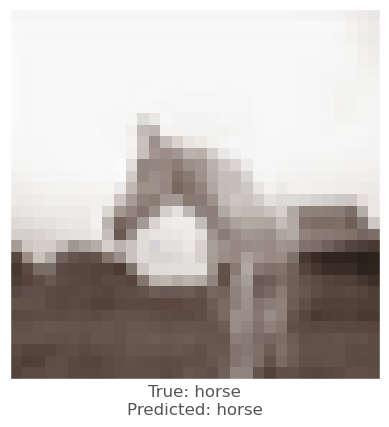



0.008348227
0.00976342
-0.004473269
vr, vg, vb :   -2.674356162548065 -2.759851098060608 0.14695489406585693
beam_perturbed_confidence temp :  0.5709682
beam_perturbed_confidence temp :  0.5723043
beam_perturbed_confidence temp :  0.58547145
beam_perturbed_confidence temp :  0.5580733
beam_perturbed_confidence temp :  0.5709682
beam_perturbed_confidence temp :  0.5723043
beam_perturbed_confidence temp :  0.5580733
row index :  3
2th round's confidence : 1th 0.5580733
predicted class :  horse
predicted class's confidence :  0.5580733
Lopt is :  13


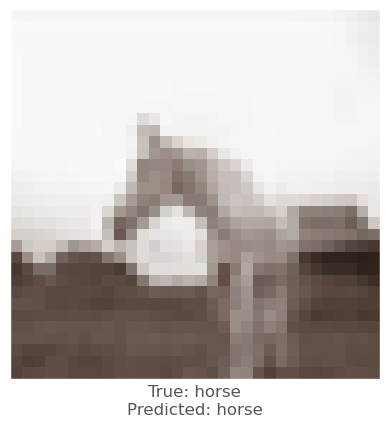



-0.0059016347
-0.009762108
-0.009880602
vr, vg, vb :   1.2463803887367249 2.3033522963523865 2.2659826278686523
beam_perturbed_confidence temp :  0.69609016
beam_perturbed_confidence temp :  0.68914855
beam_perturbed_confidence temp :  0.6887901
beam_perturbed_confidence temp :  0.68574476
beam_perturbed_confidence temp :  0.6854494
beam_perturbed_confidence temp :  0.6787271
beam_perturbed_confidence temp :  0.6743245
row index :  6
2th round's confidence : 2th 0.6743245
predicted class :  horse
predicted class's confidence :  0.6743245
Lopt is :  8


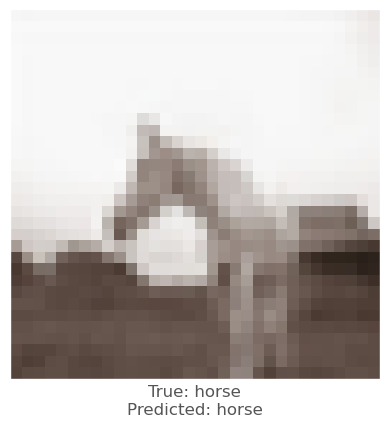



0.0070199966
0.0063215494
-0.0041301847
vr, vg, vb :   -2.062192380428314 -1.9754862189292908 0.9700231552124023
beam_perturbed_confidence temp :  0.5551873
beam_perturbed_confidence temp :  0.5605836
beam_perturbed_confidence temp :  0.56672835
beam_perturbed_confidence temp :  0.5468045
beam_perturbed_confidence temp :  0.5551873
beam_perturbed_confidence temp :  0.5605836
beam_perturbed_confidence temp :  0.5468045
row index :  3
2th round's confidence : 3th 0.5468045
predicted class :  horse
predicted class's confidence :  0.5468045
Lopt is :  16


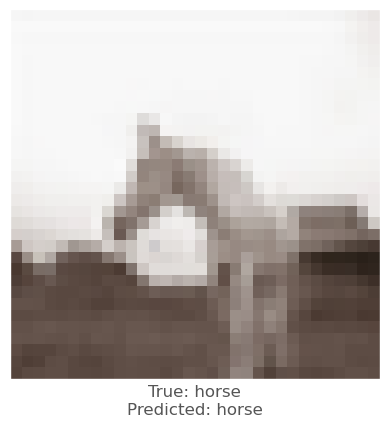



-0.0006066561
-0.0016488433
-0.010017514
vr, vg, vb :   1.8575122952461243 2.2781463861465454 3.5025529861450195
beam_perturbed_confidence temp :  0.5869558
beam_perturbed_confidence temp :  0.5863508
beam_perturbed_confidence temp :  0.5709105
beam_perturbed_confidence temp :  0.5855806
beam_perturbed_confidence temp :  0.57023805
beam_perturbed_confidence temp :  0.5690756
beam_perturbed_confidence temp :  0.56852347
row index :  6
2th round's confidence : 4th 0.56852347
predicted class :  horse
predicted class's confidence :  0.56852347
Lopt is :  16


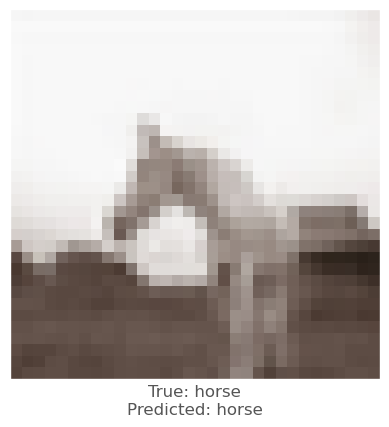



0.012148261
0.013261855
-0.0016064644
vr, vg, vb :   -4.009234392642975 -4.205237400531769 -0.551525491476059
beam_perturbed_confidence temp :  0.5630787
beam_perturbed_confidence temp :  0.5658012
beam_perturbed_confidence temp :  0.5919477
beam_perturbed_confidence temp :  0.5443947
beam_perturbed_confidence temp :  0.5660624
beam_perturbed_confidence temp :  0.56818134
beam_perturbed_confidence temp :  0.5469392
row index :  3
3th round's confidence : 0th 0.5443947
predicted class :  horse
predicted class's confidence :  0.5443947
Lopt is :  14


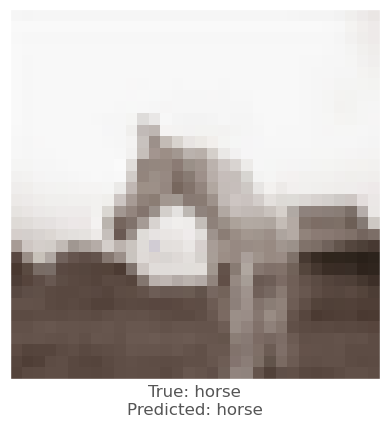



0.008541226
0.007033944
-0.0054220557
vr, vg, vb :   -3.261043184995651 -3.187260401248932 0.6744649767875671
beam_perturbed_confidence temp :  0.54081887
beam_perturbed_confidence temp :  0.548274
beam_perturbed_confidence temp :  0.5580733
beam_perturbed_confidence temp :  0.52758145
beam_perturbed_confidence temp :  0.54081887
beam_perturbed_confidence temp :  0.548274
beam_perturbed_confidence temp :  0.52758145
row index :  3
3th round's confidence : 1th 0.52758145
predicted class :  horse
predicted class's confidence :  0.52758145
Lopt is :  17


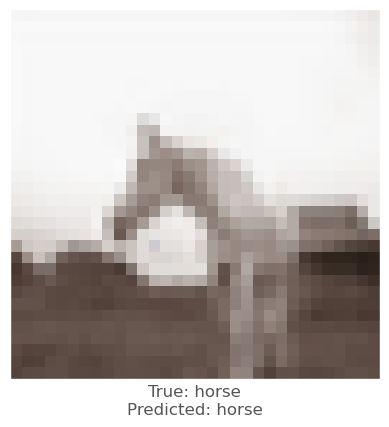



-0.008651376
-0.013237953
-0.01323241
vr, vg, vb :   1.986879926919937 3.3968123853206635 3.3626253604888916
beam_perturbed_confidence temp :  0.6700757
beam_perturbed_confidence temp :  0.65226096
beam_perturbed_confidence temp :  0.6533781
beam_perturbed_confidence temp :  0.6478057
beam_perturbed_confidence temp :  0.6485745
beam_perturbed_confidence temp :  0.630158
beam_perturbed_confidence temp :  0.625116
row index :  6
3th round's confidence : 2th 0.625116
predicted class :  horse
predicted class's confidence :  0.625116
Lopt is :  11


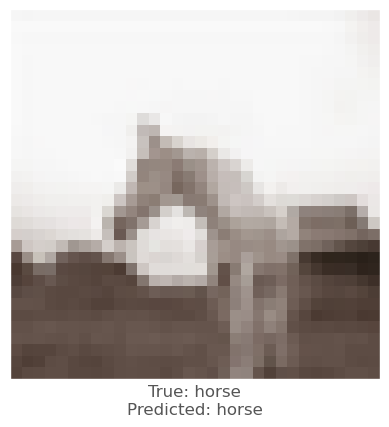



0.012202084
0.0094765425
-0.0030480623
vr, vg, vb :   -3.076181548833847 -2.7255918443202973 1.1778270721435549
beam_perturbed_confidence temp :  0.5161533
beam_perturbed_confidence temp :  0.5296171
beam_perturbed_confidence temp :  0.5452174
beam_perturbed_confidence temp :  0.49868146
beam_perturbed_confidence temp :  0.51494324
beam_perturbed_confidence temp :  0.52903026
beam_perturbed_confidence temp :  0.4980741
row index :  6
3th round's confidence : 3th 0.4980741
predicted class :  horse
predicted class's confidence :  0.4980741
Lopt is :  20


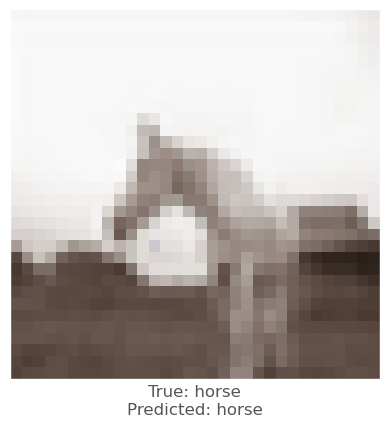




9th sensitive pixel
original confidence is :  0.69673544 

original r,g,b :  219 213 210
-0.0049646497
-0.0028814673
-0.006067097
vr, vg, vb :   0.49646496772766113 0.2881467342376709 0.6067097187042236
beam_perturbed_confidence temp :  0.69673544
beam_perturbed_confidence temp :  0.69673544
beam_perturbed_confidence temp :  0.69673544
beam_perturbed_confidence temp :  0.69673544
beam_perturbed_confidence temp :  0.69673544
beam_perturbed_confidence temp :  0.69673544
beam_perturbed_confidence temp :  0.69673544
row index :  0
0th round's confidence : 0th 0.69673544
predicted class :  horse
predicted class's confidence :  0.69673544
Lopt is :  0


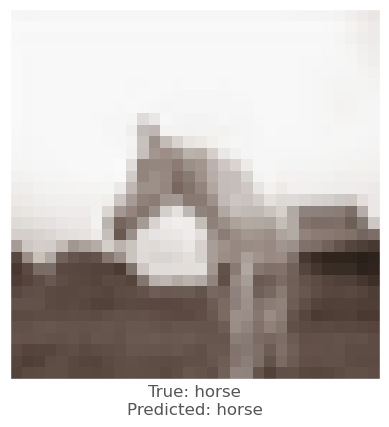






10th sensitive pixel
original confidence is :  0.69673544 

original r,g,b :  246 246 246
-0.0075237155
-0.010574758
-0.007945359
vr, vg, vb :   0.7523715496063232 1.0574758052825928 0.7945358753204346
beam_perturbed_confidence temp :  0.69673544
beam_perturbed_confidence temp :  0.6968316
beam_perturbed_confidence temp :  0.69673544
beam_perturbed_confidence temp :  0.6968316
beam_perturbed_confidence temp :  0.69673544
beam_perturbed_confidence temp :  0.6968316
beam_perturbed_confidence temp :  0.6968316
row index :  0
0th round's confidence : 0th 0.69673544
predicted class :  horse
predicted class's confidence :  0.69673544
Lopt is :  0


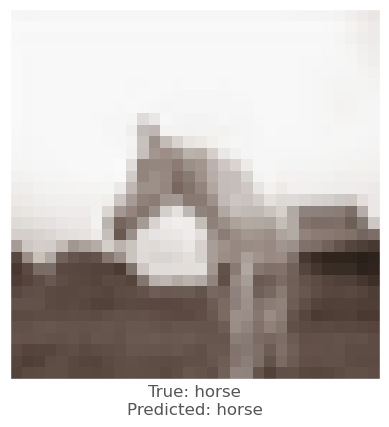






11th sensitive pixel
original confidence is :  0.69673544 

original r,g,b :  197 189 185
-0.01630801
-0.0036094189
0.0009753704
vr, vg, vb :   1.6308009624481201 0.36094188690185547 -0.09753704071044922
beam_perturbed_confidence temp :  0.68769175
beam_perturbed_confidence temp :  0.69673544
beam_perturbed_confidence temp :  0.6956314
beam_perturbed_confidence temp :  0.68769175
beam_perturbed_confidence temp :  0.6880893
beam_perturbed_confidence temp :  0.6956314
beam_perturbed_confidence temp :  0.6880893
row index :  0
0th round's confidence : 0th 0.68769175
predicted class :  horse
predicted class's confidence :  0.68769175
Lopt is :  1


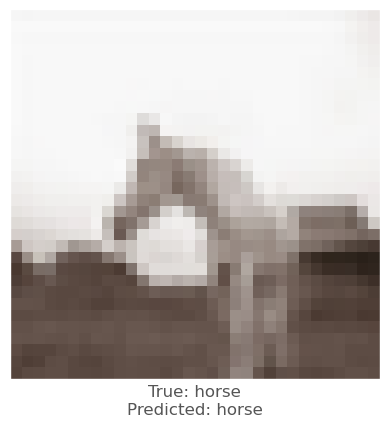



-0.011657715
0.003189087
0.0025012493
vr, vg, vb :   1.165771484375 -0.31890869140625 -0.2501249313354492
beam_perturbed_confidence temp :  0.69622606
beam_perturbed_confidence temp :  0.7006116
beam_perturbed_confidence temp :  0.7007732
beam_perturbed_confidence temp :  0.6953749
beam_perturbed_confidence temp :  0.69566345
beam_perturbed_confidence temp :  0.6979706
beam_perturbed_confidence temp :  0.6923551
row index :  6
0th round's confidence : 1th 0.6923551
predicted class :  horse
predicted class's confidence :  0.6923551
Lopt is :  6


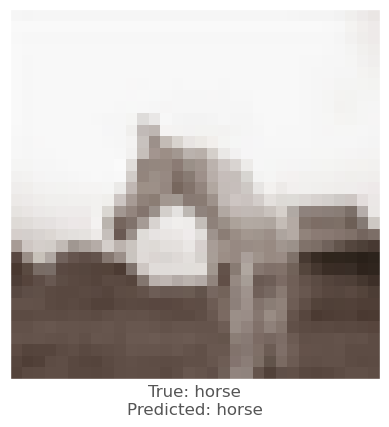



-0.030137539
-0.010490775
-0.0025000572
vr, vg, vb :   3.013753890991211 1.0490775108337402 0.25000572204589844
beam_perturbed_confidence temp :  0.52530503
beam_perturbed_confidence temp :  0.5641417
beam_perturbed_confidence temp :  0.5691685
beam_perturbed_confidence temp :  0.51708466
beam_perturbed_confidence temp :  0.52530503
beam_perturbed_confidence temp :  0.5641417
beam_perturbed_confidence temp :  0.51708466
row index :  3
0th round's confidence : 2th 0.51708466
predicted class :  horse
predicted class's confidence :  0.51708466
Lopt is :  8


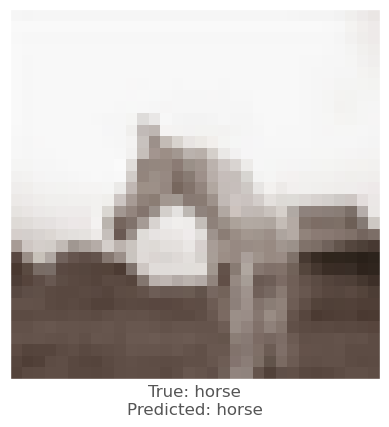



-0.005530119
0.006867528
0.005838454
vr, vg, vb :   0.5530118942260742 -0.6867527961730957 -0.5838453769683838
beam_perturbed_confidence temp :  0.66024
beam_perturbed_confidence temp :  0.65894413
beam_perturbed_confidence temp :  0.6586317
beam_perturbed_confidence temp :  0.65894413
beam_perturbed_confidence temp :  0.6586317
beam_perturbed_confidence temp :  0.65744925
beam_perturbed_confidence temp :  0.65744925
row index :  5
0th round's confidence : 3th 0.65744925
predicted class :  horse
predicted class's confidence :  0.65744925
Lopt is :  11


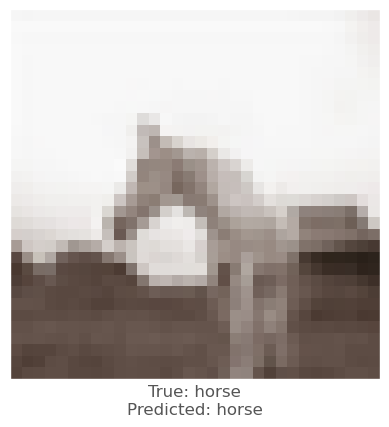



-0.03327769
-0.021144927
-0.015635073
vr, vg, vb :   3.3277690410614014 2.114492654800415 1.563507318496704
beam_perturbed_confidence temp :  0.3693852
beam_perturbed_confidence temp :  0.38993582
beam_perturbed_confidence temp :  0.3981059
beam_perturbed_confidence temp :  0.35652626
beam_perturbed_confidence temp :  0.36285114
beam_perturbed_confidence temp :  0.38322482
beam_perturbed_confidence temp :  0.3494537
row index :  6
0th round's confidence : 4th 0.3494537
predicted class :  airplane
predicted class's confidence :  0.64797544
Lopt is :  13


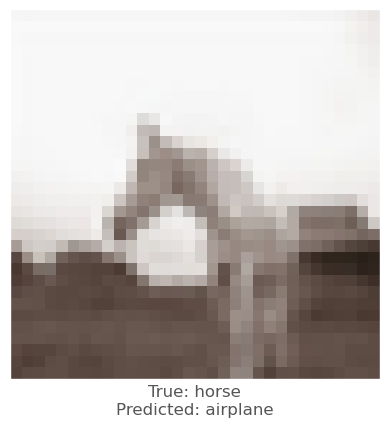




12th sensitive pixel
original confidence is :  0.69673544 

original r,g,b :  233 229 227
0.0024463534
0.0047690272
0.0015235543
vr, vg, vb :   -0.24463534355163574 -0.47690272331237793 -0.15235543251037598
beam_perturbed_confidence temp :  0.69502836
beam_perturbed_confidence temp :  0.6937605
beam_perturbed_confidence temp :  0.6955998
beam_perturbed_confidence temp :  0.691798
beam_perturbed_confidence temp :  0.69354516
beam_perturbed_confidence temp :  0.69219875
beam_perturbed_confidence temp :  0.69001925
row index :  6
0th round's confidence : 0th 0.69001925
predicted class :  horse
predicted class's confidence :  0.69001925
Lopt is :  1


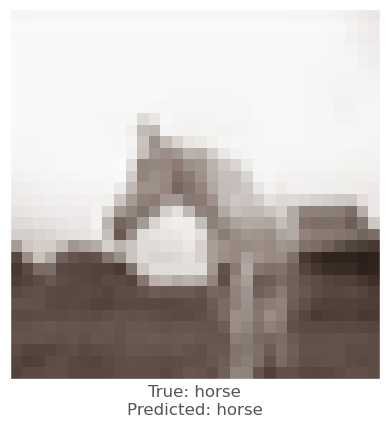



0.011520505
0.017786562
0.005679488
vr, vg, vb :   -1.152050495147705 -1.778656244277954 -0.5679488182067871
beam_perturbed_confidence temp :  0.61991686
beam_perturbed_confidence temp :  0.61290765
beam_perturbed_confidence temp :  0.62834746
beam_perturbed_confidence temp :  0.60076976
beam_perturbed_confidence temp :  0.61680084
beam_perturbed_confidence temp :  0.6093109
beam_perturbed_confidence temp :  0.597673
row index :  6
0th round's confidence : 1th 0.597673
predicted class :  horse
predicted class's confidence :  0.597673
Lopt is :  7


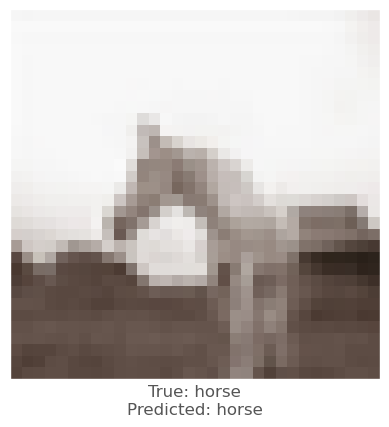



-0.018826723
-0.015287995
-0.008391142
vr, vg, vb :   1.8826723098754883 1.5287995338439941 0.8391141891479492
beam_perturbed_confidence temp :  0.6402921
beam_perturbed_confidence temp :  0.6424966
beam_perturbed_confidence temp :  0.6499289
beam_perturbed_confidence temp :  0.632676
beam_perturbed_confidence temp :  0.6402921
beam_perturbed_confidence temp :  0.6424966
beam_perturbed_confidence temp :  0.632676
row index :  3
0th round's confidence : 2th 0.632676
predicted class :  horse
predicted class's confidence :  0.632676
Lopt is :  6


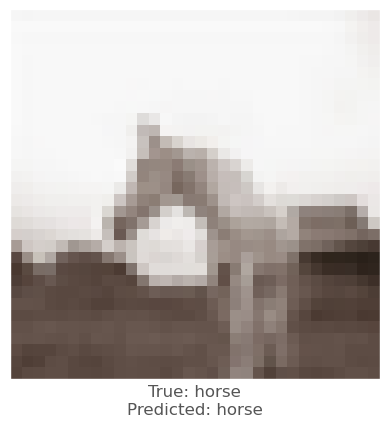



0.004906714
0.013859272
0.0029646754
vr, vg, vb :   -0.49067139625549316 -1.3859272003173828 -0.29646754264831543
beam_perturbed_confidence temp :  0.55692005
beam_perturbed_confidence temp :  0.54554296
beam_perturbed_confidence temp :  0.5578455
beam_perturbed_confidence temp :  0.54322153
beam_perturbed_confidence temp :  0.5551274
beam_perturbed_confidence temp :  0.5438847
beam_perturbed_confidence temp :  0.5418644
row index :  6
0th round's confidence : 3th 0.5418644
predicted class :  horse
predicted class's confidence :  0.5418644
Lopt is :  12


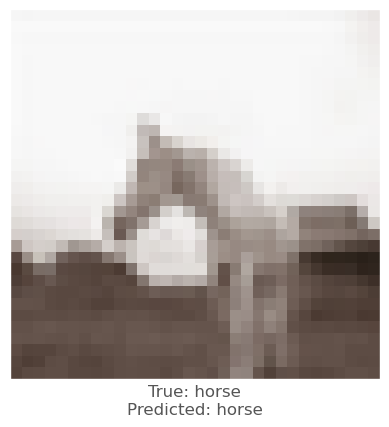



-0.015077174
-0.008861303
-0.009880722
vr, vg, vb :   1.5077173709869385 0.8861303329467773 0.9880721569061279
beam_perturbed_confidence temp :  0.54958993
beam_perturbed_confidence temp :  0.5582919
beam_perturbed_confidence temp :  0.5582919
beam_perturbed_confidence temp :  0.54958993
beam_perturbed_confidence temp :  0.54958993
beam_perturbed_confidence temp :  0.5582919
beam_perturbed_confidence temp :  0.54958993
row index :  0
0th round's confidence : 4th 0.54958993
predicted class :  horse
predicted class's confidence :  0.54958993
Lopt is :  11


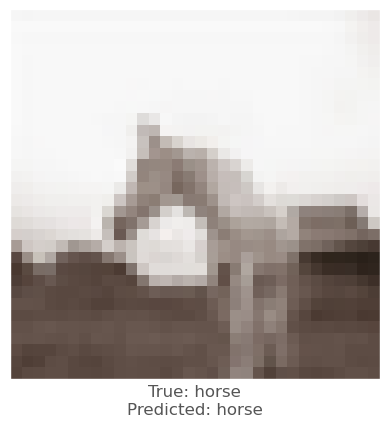



0.0044797063
0.008009553
0.0035455227
vr, vg, vb :   -0.6681424379348755 -1.2301677465438843 -0.491672158241272
beam_perturbed_confidence temp :  0.68771905
beam_perturbed_confidence temp :  0.68022686
beam_perturbed_confidence temp :  0.68825245
beam_perturbed_confidence temp :  0.67726475
beam_perturbed_confidence temp :  0.68597466
beam_perturbed_confidence temp :  0.6781608
beam_perturbed_confidence temp :  0.6751737
row index :  6
1th round's confidence : 0th 0.6751737
predicted class :  horse
predicted class's confidence :  0.6751737
Lopt is :  3


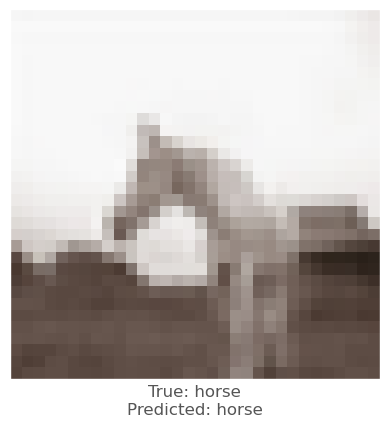



0.010094941
0.01858735
0.005806625
vr, vg, vb :   -2.046339511871338 -3.45952570438385 -1.0918164253234863
beam_perturbed_confidence temp :  0.58647287
beam_perturbed_confidence temp :  0.5644266
beam_perturbed_confidence temp :  0.59250706
beam_perturbed_confidence temp :  0.55750555
beam_perturbed_confidence temp :  0.58312875
beam_perturbed_confidence temp :  0.56216943
beam_perturbed_confidence temp :  0.5552635
row index :  6
1th round's confidence : 1th 0.5552635
predicted class :  horse
predicted class's confidence :  0.5552635
Lopt is :  11


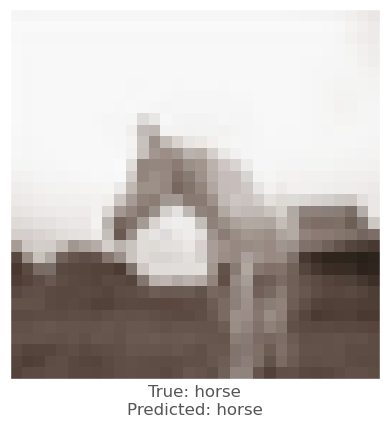



-0.020506382
-0.014745772
-0.00944376
vr, vg, vb :   3.7450432777404785 2.850496768951416 1.6995787620544434
beam_perturbed_confidence temp :  0.6007875
beam_perturbed_confidence temp :  0.6174445
beam_perturbed_confidence temp :  0.6277847
beam_perturbed_confidence temp :  0.58917516
beam_perturbed_confidence temp :  0.59481835
beam_perturbed_confidence temp :  0.6113508
beam_perturbed_confidence temp :  0.5849817
row index :  6
1th round's confidence : 2th 0.5849817
predicted class :  horse
predicted class's confidence :  0.5849817
Lopt is :  9


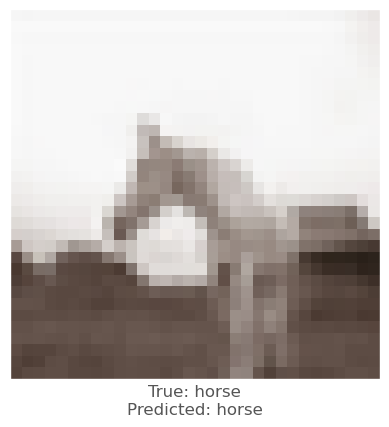



0.0034173727
0.011514723
0.0019112825
vr, vg, vb :   -0.7833415269851685 -2.3988068103790283 -0.45794904232025146
beam_perturbed_confidence temp :  0.5404673
beam_perturbed_confidence temp :  0.5275066
beam_perturbed_confidence temp :  0.54131025
beam_perturbed_confidence temp :  0.52713776
beam_perturbed_confidence temp :  0.54000837
beam_perturbed_confidence temp :  0.5279791
beam_perturbed_confidence temp :  0.52816164
row index :  3
1th round's confidence : 3th 0.52713776
predicted class :  horse
predicted class's confidence :  0.52713776
Lopt is :  15


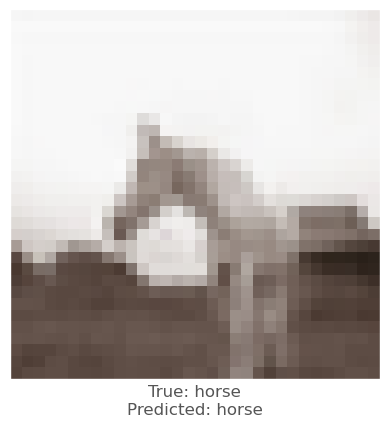



-0.019821465
-0.01334697
-0.0123230815
vr, vg, vb :   3.3390921354293823 2.132214307785034 2.1215730905532837
beam_perturbed_confidence temp :  0.5145685
beam_perturbed_confidence temp :  0.53380924
beam_perturbed_confidence temp :  0.5365543
beam_perturbed_confidence temp :  0.50032276
beam_perturbed_confidence temp :  0.50215054
beam_perturbed_confidence temp :  0.52168787
beam_perturbed_confidence temp :  0.48767343
row index :  6
1th round's confidence : 4th 0.48767343
predicted class :  airplane
predicted class's confidence :  0.5084325
Lopt is :  14


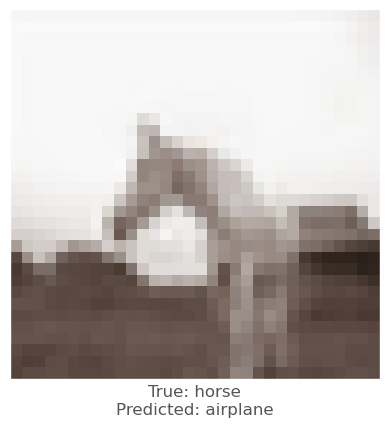




13th sensitive pixel
original confidence is :  0.69673544 

original r,g,b :  231 227 226
-0.0005700588
-3.8146973e-06
-0.0012667775
vr, vg, vb :   0.057005882263183594 0.0003814697265625 0.1266777515411377
beam_perturbed_confidence temp :  0.69673544
beam_perturbed_confidence temp :  0.69673544
beam_perturbed_confidence temp :  0.69673544
beam_perturbed_confidence temp :  0.69673544
beam_perturbed_confidence temp :  0.69673544
beam_perturbed_confidence temp :  0.69673544
beam_perturbed_confidence temp :  0.69673544
row index :  0
0th round's confidence : 0th 0.69673544
predicted class :  horse
predicted class's confidence :  0.69673544
Lopt is :  0


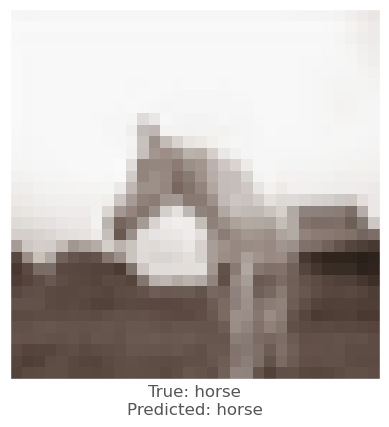






14th sensitive pixel
original confidence is :  0.69673544 

original r,g,b :  247 247 247
0.017270923
0.020381093
0.01309967
vr, vg, vb :   -1.7270922660827637 -2.038109302520752 -1.309967041015625
beam_perturbed_confidence temp :  0.68284535
beam_perturbed_confidence temp :  0.68341553
beam_perturbed_confidence temp :  0.6838226
beam_perturbed_confidence temp :  0.6881382
beam_perturbed_confidence temp :  0.6771324
beam_perturbed_confidence temp :  0.6810293
beam_perturbed_confidence temp :  0.6849185
row index :  4
0th round's confidence : 0th 0.6771324
predicted class :  horse
predicted class's confidence :  0.6771324
Lopt is :  2


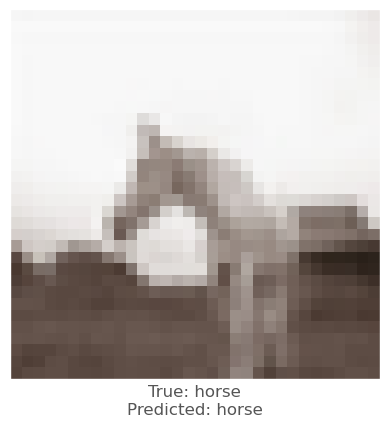



0.0054638386
0.006952107
0.008553147
vr, vg, vb :   -0.5463838577270508 -0.6952106952667236 -0.8553147315979004
beam_perturbed_confidence temp :  0.69626665
beam_perturbed_confidence temp :  0.6955454
beam_perturbed_confidence temp :  0.69560355
beam_perturbed_confidence temp :  0.6907768
beam_perturbed_confidence temp :  0.69180244
beam_perturbed_confidence temp :  0.69007486
beam_perturbed_confidence temp :  0.6854645
row index :  6
0th round's confidence : 1th 0.6854645
predicted class :  horse
predicted class's confidence :  0.6854645
Lopt is :  6


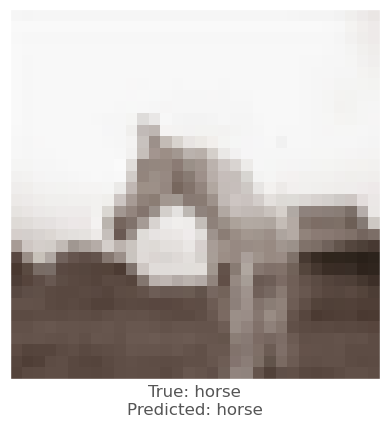



0.0011800528
-7.337332e-05
1.335144e-05
vr, vg, vb :   -0.11800527572631836 0.007337331771850586 -0.00133514404296875
beam_perturbed_confidence temp :  0.78768176
beam_perturbed_confidence temp :  0.7890372
beam_perturbed_confidence temp :  0.7884193
beam_perturbed_confidence temp :  0.78768176
beam_perturbed_confidence temp :  0.78607863
beam_perturbed_confidence temp :  0.7884193
beam_perturbed_confidence temp :  0.78607863
row index :  4
0th round's confidence : 2th 0.78607863
predicted class :  horse
predicted class's confidence :  0.78607863
Lopt is :  5


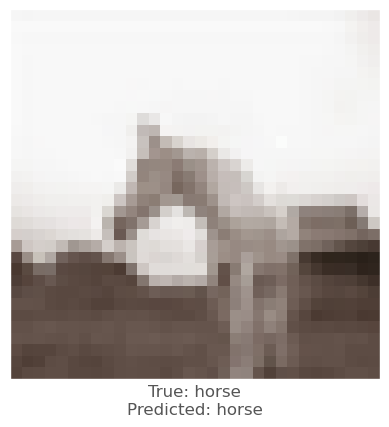



0.0047400594
0.01142329
0.010399878
vr, vg, vb :   -0.47400593757629395 -1.1423289775848389 -1.0399878025054932
beam_perturbed_confidence temp :  0.64252937
beam_perturbed_confidence temp :  0.6330357
beam_perturbed_confidence temp :  0.6338373
beam_perturbed_confidence temp :  0.63019675
beam_perturbed_confidence temp :  0.631488
beam_perturbed_confidence temp :  0.62241167
beam_perturbed_confidence temp :  0.6203824
row index :  6
0th round's confidence : 3th 0.6203824
predicted class :  horse
predicted class's confidence :  0.6203824
Lopt is :  12


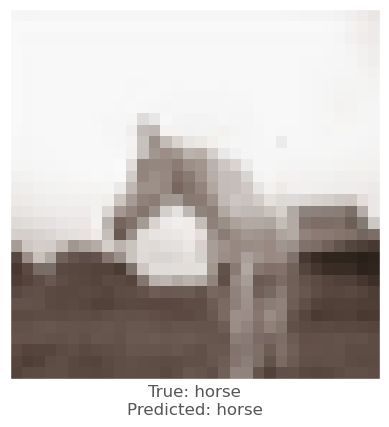



0.0
0.0
0.0
vr, vg, vb :   0.0 0.0 0.0
beam_perturbed_confidence temp :  0.0005456286
beam_perturbed_confidence temp :  0.09681575
beam_perturbed_confidence temp :  0.00056281063
beam_perturbed_confidence temp :  0.10331269
beam_perturbed_confidence temp :  0.011249319
beam_perturbed_confidence temp :  0.036598757
beam_perturbed_confidence temp :  0.7831655
row index :  0
0th round's confidence : 4th 0.0005456286
predicted class :  airplane
predicted class's confidence :  0.99925715
Lopt is :  10


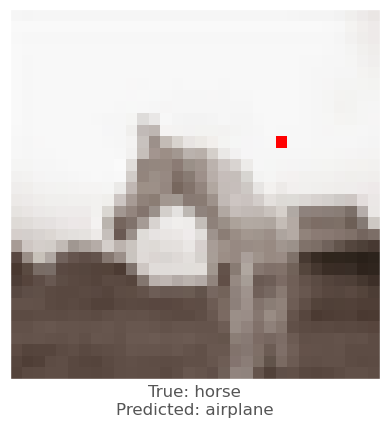




15th sensitive pixel
original confidence is :  0.69673544 

original r,g,b :  236 234 233
0.0038832426
0.004017532
6.222725e-05
vr, vg, vb :   -0.3883242607116699 -0.40175318717956543 -0.006222724914550781
beam_perturbed_confidence temp :  0.6946397
beam_perturbed_confidence temp :  0.69488835
beam_perturbed_confidence temp :  0.6966751
beam_perturbed_confidence temp :  0.69236624
beam_perturbed_confidence temp :  0.6945025
beam_perturbed_confidence temp :  0.69475526
beam_perturbed_confidence temp :  0.69212836
row index :  6
0th round's confidence : 0th 0.69212836
predicted class :  horse
predicted class's confidence :  0.69212836
Lopt is :  1


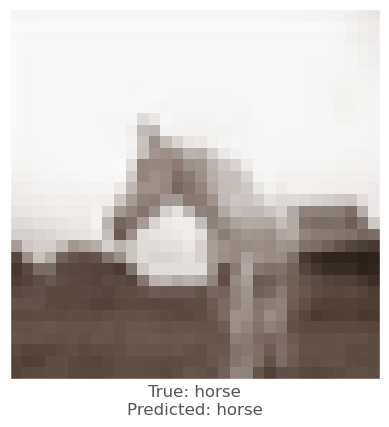



0.008798301
0.0068930984
0.003143549
vr, vg, vb :   -0.8798301219940186 -0.68930983543396 -0.31435489654541016
beam_perturbed_confidence temp :  0.6579047
beam_perturbed_confidence temp :  0.659376
beam_perturbed_confidence temp :  0.66085845
beam_perturbed_confidence temp :  0.65495324
beam_perturbed_confidence temp :  0.6565446
beam_perturbed_confidence temp :  0.65807
beam_perturbed_confidence temp :  0.653729
row index :  6
0th round's confidence : 1th 0.653729
predicted class :  horse
predicted class's confidence :  0.653729
Lopt is :  6


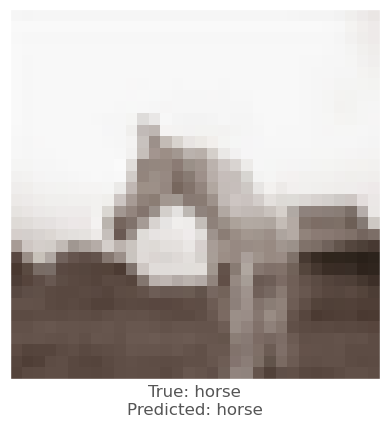



-0.002158165
-0.0026714206
-0.0036683679
vr, vg, vb :   0.21581649780273438 0.26714205741882324 0.3668367862701416
beam_perturbed_confidence temp :  0.70198405
beam_perturbed_confidence temp :  0.70198405
beam_perturbed_confidence temp :  0.70198405
beam_perturbed_confidence temp :  0.70198405
beam_perturbed_confidence temp :  0.70198405
beam_perturbed_confidence temp :  0.70198405
beam_perturbed_confidence temp :  0.70198405
row index :  0
0th round's confidence : 2th 0.70198405
predicted class :  horse
predicted class's confidence :  0.70198405
Lopt is :  5


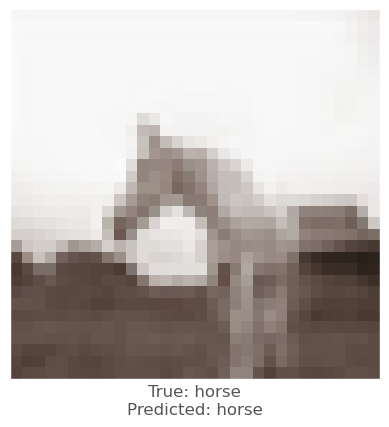



0.010082126
0.007334709
0.0021708012
vr, vg, vb :   -1.0082125663757324 -0.7334709167480469 -0.21708011627197266
beam_perturbed_confidence temp :  0.60959864
beam_perturbed_confidence temp :  0.6160257
beam_perturbed_confidence temp :  0.6189856
beam_perturbed_confidence temp :  0.6057139
beam_perturbed_confidence temp :  0.6085793
beam_perturbed_confidence temp :  0.6149468
beam_perturbed_confidence temp :  0.6043395
row index :  6
0th round's confidence : 3th 0.6043395
predicted class :  horse
predicted class's confidence :  0.6043395
Lopt is :  12


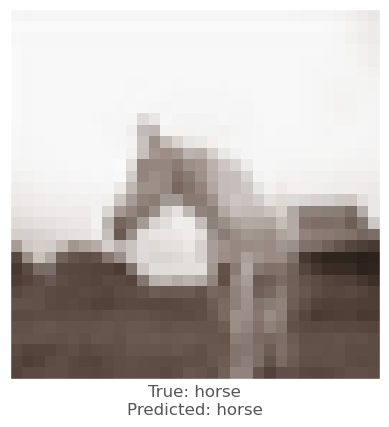



-0.0076109767
-0.0070878863
-0.0049397945
vr, vg, vb :   0.7610976696014404 0.7087886333465576 0.49397945404052734
beam_perturbed_confidence temp :  0.66571033
beam_perturbed_confidence temp :  0.66571033
beam_perturbed_confidence temp :  0.66571033
beam_perturbed_confidence temp :  0.66571033
beam_perturbed_confidence temp :  0.66571033
beam_perturbed_confidence temp :  0.66571033
beam_perturbed_confidence temp :  0.66571033
row index :  0
0th round's confidence : 4th 0.66571033
predicted class :  horse
predicted class's confidence :  0.66571033
Lopt is :  10


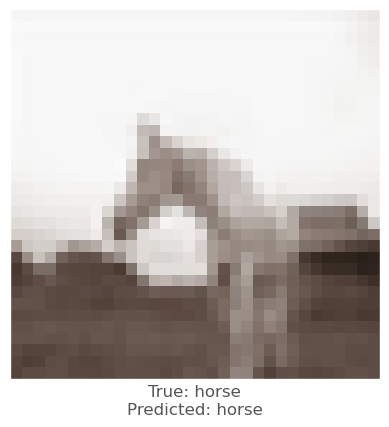



0.0054544806
0.0048965216
0.0005675554
vr, vg, vb :   -0.8949398994445801 -0.8512300252914429 -0.062355995178222656
beam_perturbed_confidence temp :  0.6893008
beam_perturbed_confidence temp :  0.68960595
beam_perturbed_confidence temp :  0.6917987
beam_perturbed_confidence temp :  0.6868869
beam_perturbed_confidence temp :  0.6889989
beam_perturbed_confidence temp :  0.6894746
beam_perturbed_confidence temp :  0.6864644
row index :  6
1th round's confidence : 0th 0.6864644
predicted class :  horse
predicted class's confidence :  0.6864644
Lopt is :  2


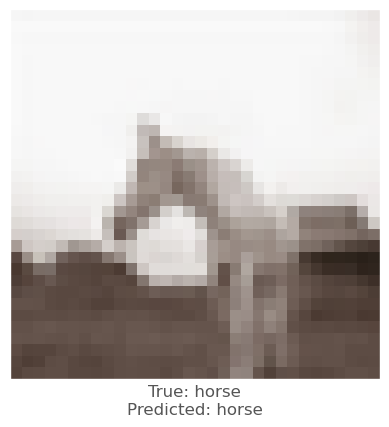



0.008571863
0.0052577853
0.0024407506
vr, vg, vb :   -1.6490334272384644 -1.1461573839187622 -0.5269944667816162
beam_perturbed_confidence temp :  0.64532816
beam_perturbed_confidence temp :  0.6490698
beam_perturbed_confidence temp :  0.6525125
beam_perturbed_confidence temp :  0.64101344
beam_perturbed_confidence temp :  0.644163
beam_perturbed_confidence temp :  0.64754695
beam_perturbed_confidence temp :  0.6395413
row index :  6
1th round's confidence : 1th 0.6395413
predicted class :  horse
predicted class's confidence :  0.6395413
Lopt is :  8


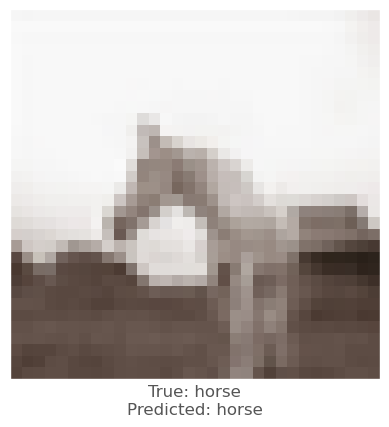



-0.002158165
-0.0026714206
-0.0036683679
vr, vg, vb :   0.4100513458251953 0.5075699090957642 0.696989893913269
beam_perturbed_confidence temp :  0.70198405
beam_perturbed_confidence temp :  0.70198405
beam_perturbed_confidence temp :  0.70198405
beam_perturbed_confidence temp :  0.70198405
beam_perturbed_confidence temp :  0.70198405
beam_perturbed_confidence temp :  0.70198405
beam_perturbed_confidence temp :  0.70198405
row index :  0
1th round's confidence : 2th 0.70198405
predicted class :  horse
predicted class's confidence :  0.70198405
Lopt is :  5


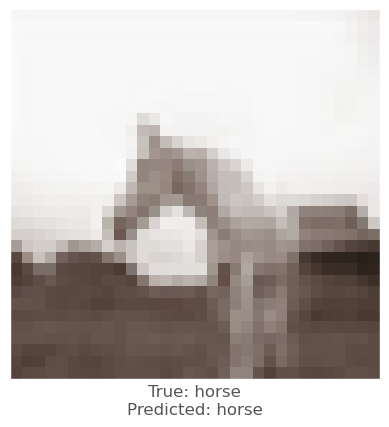



0.011597872
0.010077119
0.0032356977
vr, vg, vb :   -2.06717848777771 -1.6678357124328613 -0.5189418792724609
beam_perturbed_confidence temp :  0.58341444
beam_perturbed_confidence temp :  0.5910689
beam_perturbed_confidence temp :  0.6024782
beam_perturbed_confidence temp :  0.5674118
beam_perturbed_confidence temp :  0.58147115
beam_perturbed_confidence temp :  0.58977515
beam_perturbed_confidence temp :  0.565836
row index :  6
1th round's confidence : 3th 0.565836
predicted class :  horse
predicted class's confidence :  0.565836
Lopt is :  15


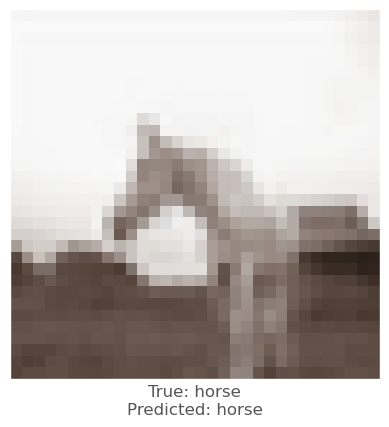



-0.0076109767
-0.0070878863
-0.0049397945
vr, vg, vb :   1.4460855722427368 1.3466984033584595 0.938560962677002
beam_perturbed_confidence temp :  0.66179
beam_perturbed_confidence temp :  0.66176766
beam_perturbed_confidence temp :  0.66571033
beam_perturbed_confidence temp :  0.6570812
beam_perturbed_confidence temp :  0.66179
beam_perturbed_confidence temp :  0.66176766
beam_perturbed_confidence temp :  0.6570812
row index :  3
1th round's confidence : 4th 0.6570812
predicted class :  horse
predicted class's confidence :  0.6570812
Lopt is :  11


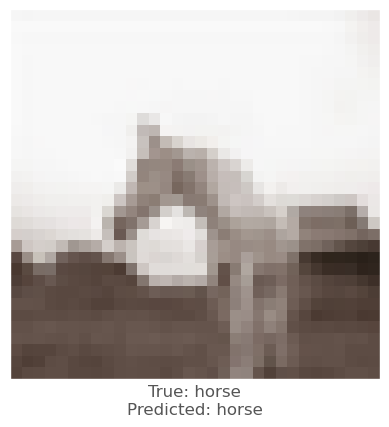



0.0060733557
0.0051430464
0.0011236668
vr, vg, vb :   -1.4127814769744873 -1.2804116606712341 -0.1684870719909668
beam_perturbed_confidence temp :  0.6804765
beam_perturbed_confidence temp :  0.68096876
beam_perturbed_confidence temp :  0.68576324
beam_perturbed_confidence temp :  0.67459923
beam_perturbed_confidence temp :  0.67981505
beam_perturbed_confidence temp :  0.6799964
beam_perturbed_confidence temp :  0.6733094
row index :  6
2th round's confidence : 0th 0.6733094
predicted class :  horse
predicted class's confidence :  0.6733094
Lopt is :  4


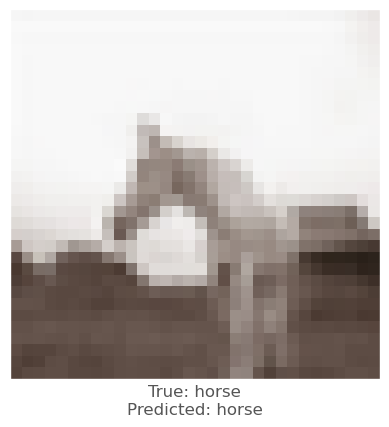



0.0076949596
0.0046265125
0.002861619
vr, vg, vb :   -2.253626048564911 -1.494192898273468 -0.760456919670105
beam_perturbed_confidence temp :  0.6269193
beam_perturbed_confidence temp :  0.63446367
beam_perturbed_confidence temp :  0.6381518
beam_perturbed_confidence temp :  0.61934865
beam_perturbed_confidence temp :  0.62539685
beam_perturbed_confidence temp :  0.6332493
beam_perturbed_confidence temp :  0.61757916
row index :  6
2th round's confidence : 1th 0.61757916
predicted class :  horse
predicted class's confidence :  0.61757916
Lopt is :  11


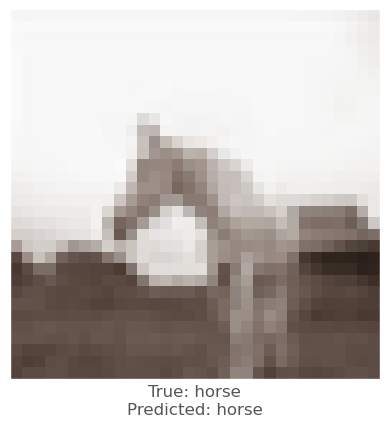



-0.002158165
-0.0026714206
-0.0036683679
vr, vg, vb :   0.5848627090454102 0.723954975605011 0.9941276907920837
beam_perturbed_confidence temp :  0.70198405
beam_perturbed_confidence temp :  0.70198405
beam_perturbed_confidence temp :  0.70198405
beam_perturbed_confidence temp :  0.70198405
beam_perturbed_confidence temp :  0.70198405
beam_perturbed_confidence temp :  0.70198405
beam_perturbed_confidence temp :  0.70198405
row index :  0
2th round's confidence : 2th 0.70198405
predicted class :  horse
predicted class's confidence :  0.70198405
Lopt is :  5


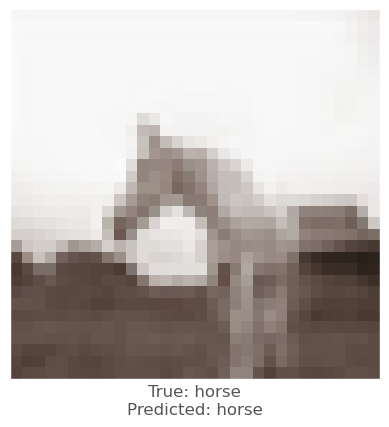



0.017836332
0.019053757
0.003538251
vr, vg, vb :   -3.644093871116638 -3.4064278602600098 -0.8208727836608887
beam_perturbed_confidence temp :  0.5299908
beam_perturbed_confidence temp :  0.52631694
beam_perturbed_confidence temp :  0.5638735
beam_perturbed_confidence temp :  0.49132428
beam_perturbed_confidence temp :  0.52747774
beam_perturbed_confidence temp :  0.52482605
beam_perturbed_confidence temp :  0.49065995
row index :  6
2th round's confidence : 3th 0.49065995
predicted class :  airplane
predicted class's confidence :  0.5055612
Lopt is :  19


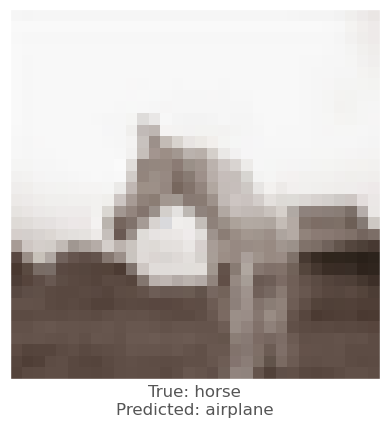




16th sensitive pixel
original confidence is :  0.69673544 

original r,g,b :  205 197 194
-0.005633831
0.011402905
0.016890585
vr, vg, vb :   0.5633831024169922 -1.1402904987335205 -1.689058542251587
beam_perturbed_confidence temp :  0.69673544
beam_perturbed_confidence temp :  0.6846051
beam_perturbed_confidence temp :  0.6779939
beam_perturbed_confidence temp :  0.6846051
beam_perturbed_confidence temp :  0.6779939
beam_perturbed_confidence temp :  0.6625926
beam_perturbed_confidence temp :  0.6625926
row index :  5
0th round's confidence : 0th 0.6625926
predicted class :  horse
predicted class's confidence :  0.6625926
Lopt is :  2


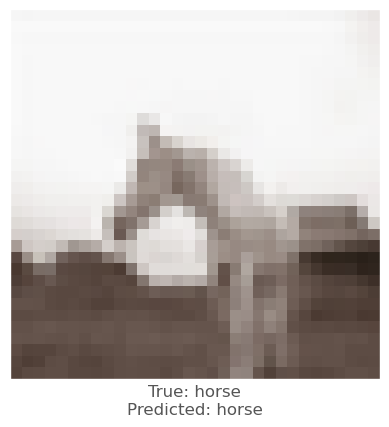



0.017082214
0.0406062
0.031178176
vr, vg, vb :   -1.708221435546875 -4.060620069503784 -3.1178176403045654
beam_perturbed_confidence temp :  0.50425786
beam_perturbed_confidence temp :  0.42521346
beam_perturbed_confidence temp :  0.46362522
beam_perturbed_confidence temp :  0.41506788
beam_perturbed_confidence temp :  0.44551834
beam_perturbed_confidence temp :  0.3923166
beam_perturbed_confidence temp :  0.38103065
row index :  6
0th round's confidence : 1th 0.38103065
predicted class :  airplane
predicted class's confidence :  0.6162889
Lopt is :  10


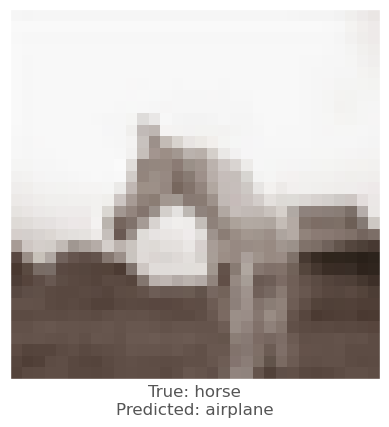




17th sensitive pixel
original confidence is :  0.69673544 

original r,g,b :  239 235 235
-0.0036347508
-0.0019435287
-0.0020061731
vr, vg, vb :   0.36347508430480957 0.1943528652191162 0.20061731338500977
beam_perturbed_confidence temp :  0.69673544
beam_perturbed_confidence temp :  0.69673544
beam_perturbed_confidence temp :  0.69673544
beam_perturbed_confidence temp :  0.69673544
beam_perturbed_confidence temp :  0.69673544
beam_perturbed_confidence temp :  0.69673544
beam_perturbed_confidence temp :  0.69673544
row index :  0
0th round's confidence : 0th 0.69673544
predicted class :  horse
predicted class's confidence :  0.69673544
Lopt is :  0


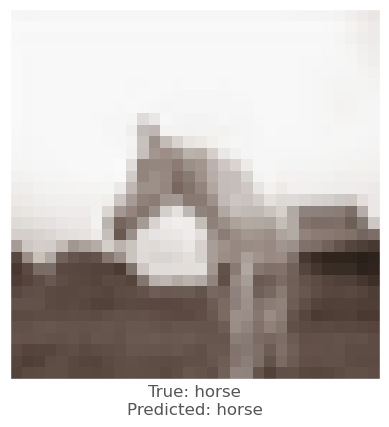






18th sensitive pixel
original confidence is :  0.69673544 

original r,g,b :  211 205 202
0.006597042
-0.00078874826
-0.011206329
vr, vg, vb :   -0.6597042083740234 0.07887482643127441 1.1206328868865967
beam_perturbed_confidence temp :  0.69236887
beam_perturbed_confidence temp :  0.69673544
beam_perturbed_confidence temp :  0.69081634
beam_perturbed_confidence temp :  0.69236887
beam_perturbed_confidence temp :  0.6887353
beam_perturbed_confidence temp :  0.69081634
beam_perturbed_confidence temp :  0.6887353
row index :  4
0th round's confidence : 0th 0.6887353
predicted class :  horse
predicted class's confidence :  0.6887353
Lopt is :  1


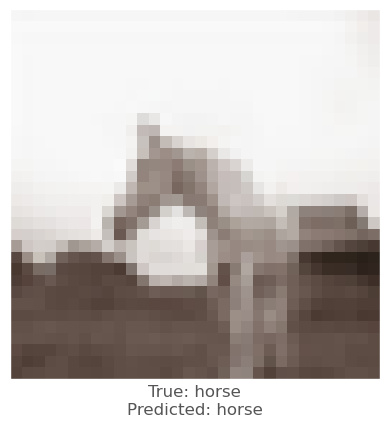



0.01732558
0.014059901
-0.0011984706
vr, vg, vb :   -1.732558012008667 -1.4059901237487793 0.11984705924987793
beam_perturbed_confidence temp :  0.6165113
beam_perturbed_confidence temp :  0.6184212
beam_perturbed_confidence temp :  0.6291206
beam_perturbed_confidence temp :  0.60960317
beam_perturbed_confidence temp :  0.6165113
beam_perturbed_confidence temp :  0.6184212
beam_perturbed_confidence temp :  0.60960317
row index :  3
0th round's confidence : 1th 0.60960317
predicted class :  horse
predicted class's confidence :  0.60960317
Lopt is :  7


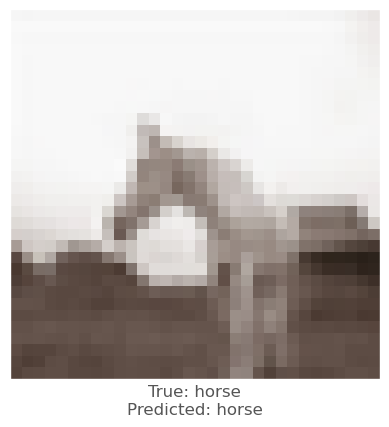



-0.015743256
-0.028283417
-0.018153608
vr, vg, vb :   1.5743255615234375 2.8283417224884033 1.8153607845306396
beam_perturbed_confidence temp :  0.5517799
beam_perturbed_confidence temp :  0.52493024
beam_perturbed_confidence temp :  0.5509062
beam_perturbed_confidence temp :  0.51107687
beam_perturbed_confidence temp :  0.5405294
beam_perturbed_confidence temp :  0.5116009
beam_perturbed_confidence temp :  0.4969473
row index :  6
0th round's confidence : 2th 0.4969473
predicted class :  airplane
predicted class's confidence :  0.5001034
Lopt is :  7


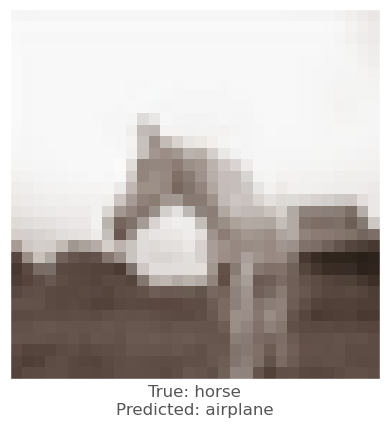




19th sensitive pixel
original confidence is :  0.69673544 

original r,g,b :  240 238 236
0.0015574694
0.0019850135
-0.0052398443
vr, vg, vb :   -0.1557469367980957 -0.1985013484954834 0.523984432220459
beam_perturbed_confidence temp :  0.69589037
beam_perturbed_confidence temp :  0.6956862
beam_perturbed_confidence temp :  0.69673544
beam_perturbed_confidence temp :  0.69434136
beam_perturbed_confidence temp :  0.69589037
beam_perturbed_confidence temp :  0.6956862
beam_perturbed_confidence temp :  0.69434136
row index :  3
0th round's confidence : 0th 0.69434136
predicted class :  horse
predicted class's confidence :  0.69434136
Lopt is :  1


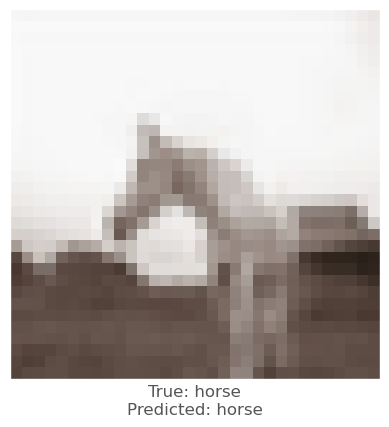



0.0094739795
0.010850191
-0.0019401312
vr, vg, vb :   -0.9473979473114014 -1.0850191116333008 0.19401311874389648
beam_perturbed_confidence temp :  0.6748972
beam_perturbed_confidence temp :  0.6697693
beam_perturbed_confidence temp :  0.679695
beam_perturbed_confidence temp :  0.6653389
beam_perturbed_confidence temp :  0.6748972
beam_perturbed_confidence temp :  0.6697693
beam_perturbed_confidence temp :  0.6653389
row index :  3
0th round's confidence : 1th 0.6653389
predicted class :  horse
predicted class's confidence :  0.6653389
Lopt is :  7


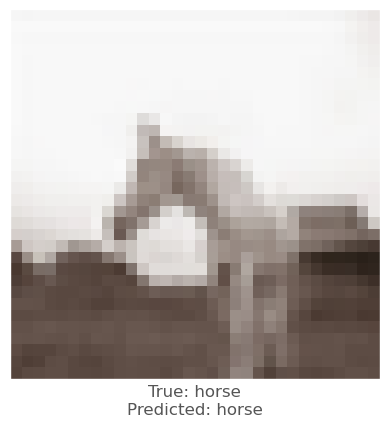



-0.0013090968
-0.0015460253
-0.007184446
vr, vg, vb :   0.13090968132019043 0.1546025276184082 0.7184445858001709
beam_perturbed_confidence temp :  0.67607003
beam_perturbed_confidence temp :  0.67607003
beam_perturbed_confidence temp :  0.67607003
beam_perturbed_confidence temp :  0.67607003
beam_perturbed_confidence temp :  0.67607003
beam_perturbed_confidence temp :  0.67607003
beam_perturbed_confidence temp :  0.67607003
row index :  0
0th round's confidence : 2th 0.67607003
predicted class :  horse
predicted class's confidence :  0.67607003
Lopt is :  5


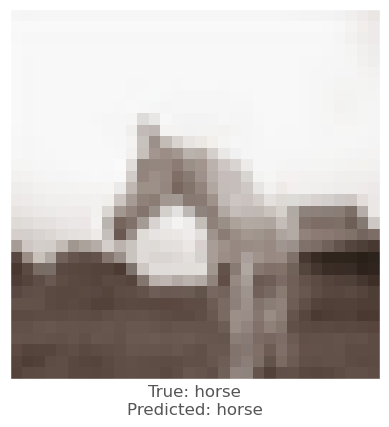



0.011662066
0.007583499
-0.0038999915
vr, vg, vb :   -1.1662065982818604 -0.7583498954772949 0.3899991512298584
beam_perturbed_confidence temp :  0.63331616
beam_perturbed_confidence temp :  0.6402042
beam_perturbed_confidence temp :  0.64392906
beam_perturbed_confidence temp :  0.6303652
beam_perturbed_confidence temp :  0.63331616
beam_perturbed_confidence temp :  0.6402042
beam_perturbed_confidence temp :  0.6303652
row index :  3
0th round's confidence : 3th 0.6303652
predicted class :  horse
predicted class's confidence :  0.6303652
Lopt is :  12


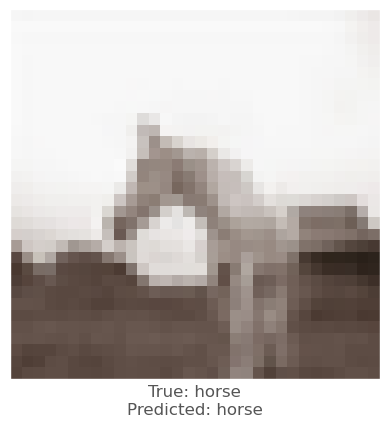



-0.0091017485
-0.008116901
-0.011988103
vr, vg, vb :   0.9101748466491699 0.811690092086792 1.198810338973999
beam_perturbed_confidence temp :  0.63372445
beam_perturbed_confidence temp :  0.63372445
beam_perturbed_confidence temp :  0.6279011
beam_perturbed_confidence temp :  0.63372445
beam_perturbed_confidence temp :  0.6279011
beam_perturbed_confidence temp :  0.6279011
beam_perturbed_confidence temp :  0.6279011
row index :  2
0th round's confidence : 4th 0.6279011
predicted class :  horse
predicted class's confidence :  0.6279011
Lopt is :  11


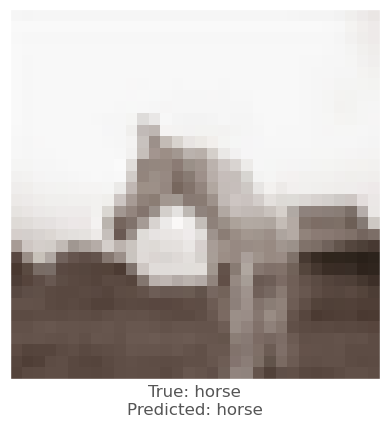



0.0030661821
0.0038285851
-0.0057186484
vr, vg, vb :   -0.4467904567718506 -0.5615097284317017 1.0434508323669434
beam_perturbed_confidence temp :  0.69262004
beam_perturbed_confidence temp :  0.6920618
beam_perturbed_confidence temp :  0.69127893
beam_perturbed_confidence temp :  0.6899597
beam_perturbed_confidence temp :  0.6893351
beam_perturbed_confidence temp :  0.6888019
beam_perturbed_confidence temp :  0.68663853
row index :  6
1th round's confidence : 0th 0.68663853
predicted class :  horse
predicted class's confidence :  0.68663853
Lopt is :  2


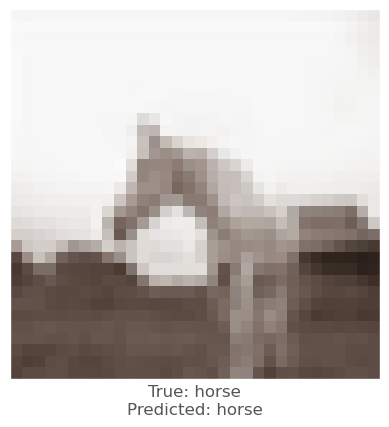



0.008398771
0.00722605
-0.0034853816
vr, vg, vb :   -1.6925352811813354 -1.6991221904754639 0.5231499671936035
beam_perturbed_confidence temp :  0.65665245
beam_perturbed_confidence temp :  0.6586892
beam_perturbed_confidence temp :  0.6653389
beam_perturbed_confidence temp :  0.64815235
beam_perturbed_confidence temp :  0.65665245
beam_perturbed_confidence temp :  0.6586892
beam_perturbed_confidence temp :  0.64815235
row index :  3
1th round's confidence : 1th 0.64815235
predicted class :  horse
predicted class's confidence :  0.64815235
Lopt is :  9


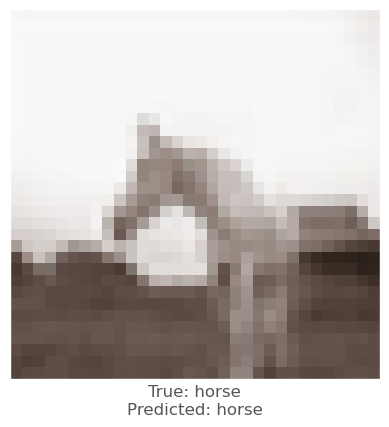



-0.0013090968
-0.0015460253
-0.007184446
vr, vg, vb :   0.24872839450836182 0.2937448024749756 1.3650447130203247
beam_perturbed_confidence temp :  0.67607003
beam_perturbed_confidence temp :  0.67607003
beam_perturbed_confidence temp :  0.67277926
beam_perturbed_confidence temp :  0.67607003
beam_perturbed_confidence temp :  0.67277926
beam_perturbed_confidence temp :  0.67277926
beam_perturbed_confidence temp :  0.67277926
row index :  2
1th round's confidence : 2th 0.67277926
predicted class :  horse
predicted class's confidence :  0.67277926
Lopt is :  6


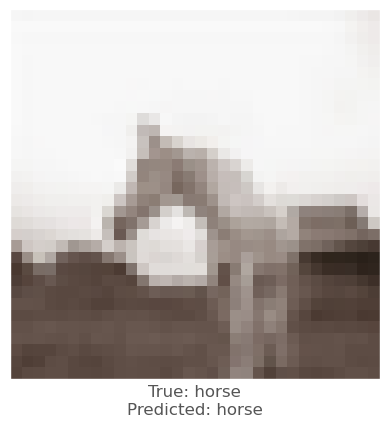



0.009455919
0.0054157972
-0.004585147
vr, vg, vb :   -1.9951778650283813 -1.2240946292877197 0.8095139265060425
beam_perturbed_confidence temp :  0.6213229
beam_perturbed_confidence temp :  0.6252691
beam_perturbed_confidence temp :  0.6303652
beam_perturbed_confidence temp :  0.6168554
beam_perturbed_confidence temp :  0.6213229
beam_perturbed_confidence temp :  0.6252691
beam_perturbed_confidence temp :  0.6168554
row index :  3
1th round's confidence : 3th 0.6168554
predicted class :  horse
predicted class's confidence :  0.6168554
Lopt is :  14


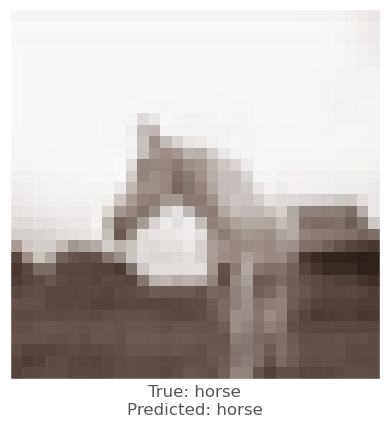



-0.009570003
-0.008578002
-0.011245608
vr, vg, vb :   1.7761576175689697 1.588321328163147 2.203490138053894
beam_perturbed_confidence temp :  0.6228082
beam_perturbed_confidence temp :  0.62324923
beam_perturbed_confidence temp :  0.61645716
beam_perturbed_confidence temp :  0.61614776
beam_perturbed_confidence temp :  0.6086107
beam_perturbed_confidence temp :  0.6093059
beam_perturbed_confidence temp :  0.6009836
row index :  6
1th round's confidence : 4th 0.6009836
predicted class :  horse
predicted class's confidence :  0.6009836
Lopt is :  13


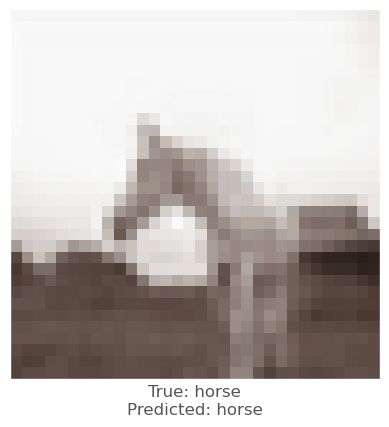



0.004471123
0.006073773
-0.006655872
vr, vg, vb :   -0.8492237329483032 -1.1127360463142395 1.6046929359436035
beam_perturbed_confidence temp :  0.68433076
beam_perturbed_confidence temp :  0.67973506
beam_perturbed_confidence temp :  0.68330383
beam_perturbed_confidence temp :  0.67705
beam_perturbed_confidence temp :  0.6813347
beam_perturbed_confidence temp :  0.67676973
beam_perturbed_confidence temp :  0.6738601
row index :  6
2th round's confidence : 0th 0.6738601
predicted class :  horse
predicted class's confidence :  0.6738601
Lopt is :  4


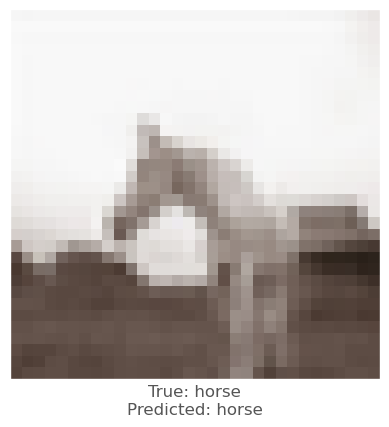



0.010127187
0.008194864
-0.0040372014
vr, vg, vb :   -2.536000430583954 -2.3486963510513306 0.8745551109313965
beam_perturbed_confidence temp :  0.6322399
beam_perturbed_confidence temp :  0.63658917
beam_perturbed_confidence temp :  0.64815235
beam_perturbed_confidence temp :  0.6209917
beam_perturbed_confidence temp :  0.6322399
beam_perturbed_confidence temp :  0.63658917
beam_perturbed_confidence temp :  0.6209917
row index :  3
2th round's confidence : 1th 0.6209917
predicted class :  horse
predicted class's confidence :  0.6209917
Lopt is :  12


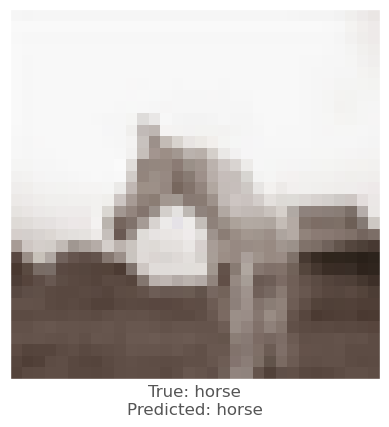



-0.0009976625
-0.0012898445
-0.0068498254
vr, vg, vb :   0.32362180948257446 0.39335477352142334 1.9135227799415588
beam_perturbed_confidence temp :  0.67277926
beam_perturbed_confidence temp :  0.67277926
beam_perturbed_confidence temp :  0.6692202
beam_perturbed_confidence temp :  0.67277926
beam_perturbed_confidence temp :  0.6692202
beam_perturbed_confidence temp :  0.6692202
beam_perturbed_confidence temp :  0.6692202
row index :  2
2th round's confidence : 2th 0.6692202
predicted class :  horse
predicted class's confidence :  0.6692202
Lopt is :  7


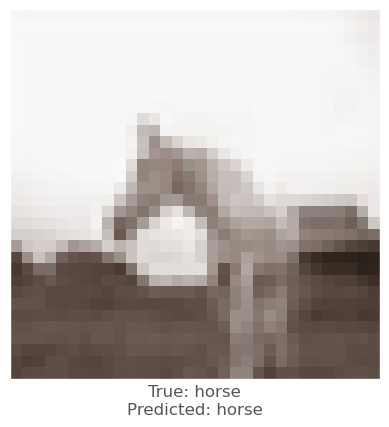



0.0077079535
0.0031821728
-0.005070269
vr, vg, vb :   -2.5664554238319397 -1.4199024438858032 1.2355894446372986
beam_perturbed_confidence temp :  0.6067923
beam_perturbed_confidence temp :  0.6136222
beam_perturbed_confidence temp :  0.6142243
beam_perturbed_confidence temp :  0.60012406
beam_perturbed_confidence temp :  0.604455
beam_perturbed_confidence temp :  0.61103743
beam_perturbed_confidence temp :  0.597951
row index :  6
2th round's confidence : 3th 0.597951
predicted class :  horse
predicted class's confidence :  0.597951
Lopt is :  17


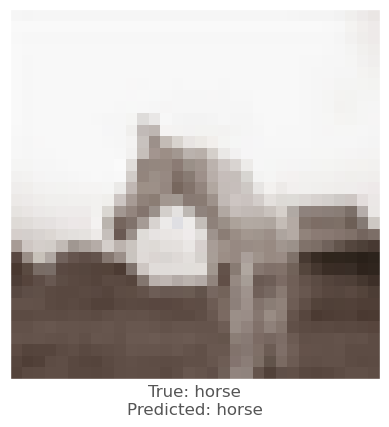



-0.016656637
-0.015268028
-0.015718043
vr, vg, vb :   3.264205574989319 2.956291973590851 3.554945409297943
beam_perturbed_confidence temp :  0.5741386
beam_perturbed_confidence temp :  0.58456385
beam_perturbed_confidence temp :  0.5758647
beam_perturbed_confidence temp :  0.5539496
beam_perturbed_confidence temp :  0.5454756
beam_perturbed_confidence temp :  0.55625343
beam_perturbed_confidence temp :  0.52967846
row index :  6
2th round's confidence : 4th 0.52967846
predicted class :  horse
predicted class's confidence :  0.52967846
Lopt is :  16


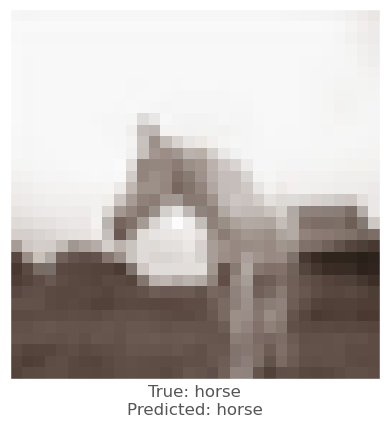



0.0062717795
0.007828295
-0.0062571764
vr, vg, vb :   -1.3914793133735657 -1.7842919647693634 2.069941282272339
beam_perturbed_confidence temp :  0.66745585
beam_perturbed_confidence temp :  0.66599613
beam_perturbed_confidence temp :  0.66794515
beam_perturbed_confidence temp :  0.6600846
beam_perturbed_confidence temp :  0.6615228
beam_perturbed_confidence temp :  0.66087586
beam_perturbed_confidence temp :  0.6542484
row index :  6
3th round's confidence : 0th 0.6542484
predicted class :  horse
predicted class's confidence :  0.6542484
Lopt is :  6


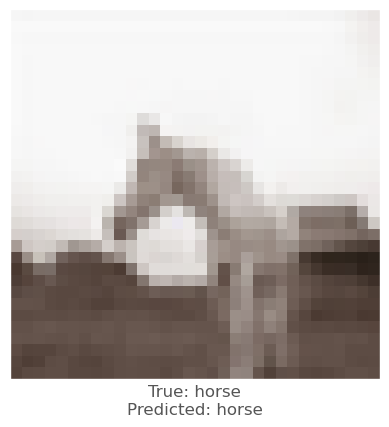



0.009506822
0.0054787993
-0.004461348
vr, vg, vb :   -3.233082550764084 -2.6617066502571105 1.2332344055175781
beam_perturbed_confidence temp :  0.60474944
beam_perturbed_confidence temp :  0.61181664
beam_perturbed_confidence temp :  0.6186607
beam_perturbed_confidence temp :  0.5956301
beam_perturbed_confidence temp :  0.60265994
beam_perturbed_confidence temp :  0.6088081
beam_perturbed_confidence temp :  0.59294915
row index :  6
3th round's confidence : 1th 0.59294915
predicted class :  horse
predicted class's confidence :  0.59294915
Lopt is :  15


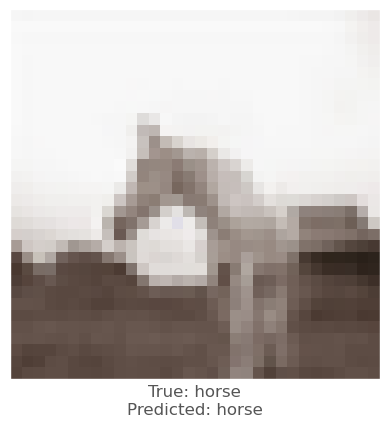



-0.0010017753
-0.0011752844
-0.007183671
vr, vg, vb :   0.39143715500831605 0.47154773473739625 2.440537601709366
beam_perturbed_confidence temp :  0.6692202
beam_perturbed_confidence temp :  0.6692202
beam_perturbed_confidence temp :  0.6618053
beam_perturbed_confidence temp :  0.6692202
beam_perturbed_confidence temp :  0.6618053
beam_perturbed_confidence temp :  0.6618053
beam_perturbed_confidence temp :  0.6618053
row index :  2
3th round's confidence : 2th 0.6618053
predicted class :  horse
predicted class's confidence :  0.6618053
Lopt is :  9


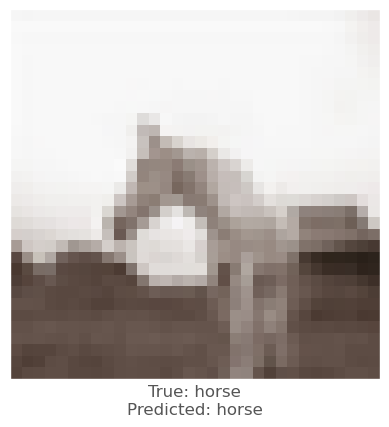



0.009057879
0.008388579
-0.0046365857
vr, vg, vb :   -3.215597826242447 -2.116770088672638 1.575689071416855
beam_perturbed_confidence temp :  0.5796837
beam_perturbed_confidence temp :  0.5837462
beam_perturbed_confidence temp :  0.5954875
beam_perturbed_confidence temp :  0.5644654
beam_perturbed_confidence temp :  0.5775922
beam_perturbed_confidence temp :  0.5814435
beam_perturbed_confidence temp :  0.5620821
row index :  6
3th round's confidence : 3th 0.5620821
predicted class :  horse
predicted class's confidence :  0.5620821
Lopt is :  21


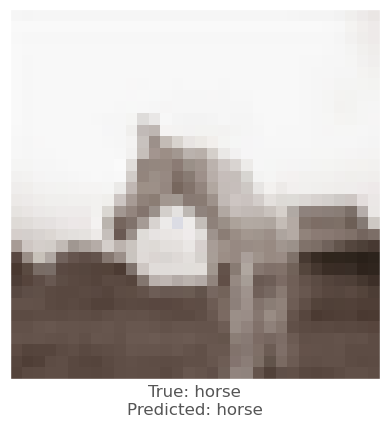



-0.013086855
-0.014213443
-0.015358865
vr, vg, vb :   4.246470558643342 4.082007056474685 4.735337394475938
beam_perturbed_confidence temp :  0.5233556
beam_perturbed_confidence temp :  0.5002961
beam_perturbed_confidence temp :  0.5066935
beam_perturbed_confidence temp :  0.49386197
beam_perturbed_confidence temp :  0.499262
beam_perturbed_confidence temp :  0.47968554
beam_perturbed_confidence temp :  0.47492027
row index :  6
3th round's confidence : 4th 0.47492027
predicted class :  airplane
predicted class's confidence :  0.5208314
Lopt is :  19


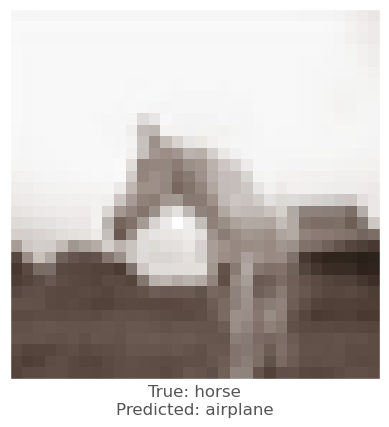




20th sensitive pixel
original confidence is :  0.69673544 

original r,g,b :  224 220 217
-0.007522404
-0.008763194
-0.0038677454
vr, vg, vb :   0.7522404193878174 0.876319408416748 0.38677453994750977
beam_perturbed_confidence temp :  0.69673544
beam_perturbed_confidence temp :  0.69673544
beam_perturbed_confidence temp :  0.69673544
beam_perturbed_confidence temp :  0.69673544
beam_perturbed_confidence temp :  0.69673544
beam_perturbed_confidence temp :  0.69673544
beam_perturbed_confidence temp :  0.69673544
row index :  0
0th round's confidence : 0th 0.69673544
predicted class :  horse
predicted class's confidence :  0.69673544
Lopt is :  0


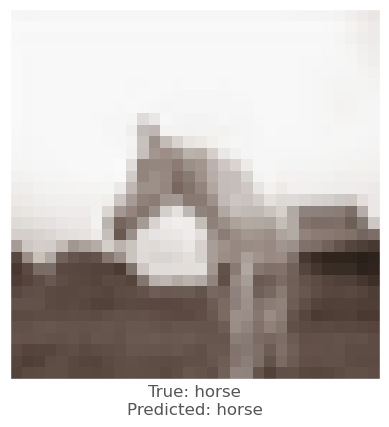






21th sensitive pixel
original confidence is :  0.69673544 

original r,g,b :  245 245 244
0.010298371
0.0029488206
0.0060527325
vr, vg, vb :   -1.0298371315002441 -0.29488205909729004 -0.6052732467651367
beam_perturbed_confidence temp :  0.69806266
beam_perturbed_confidence temp :  0.7010362
beam_perturbed_confidence temp :  0.6954304
beam_perturbed_confidence temp :  0.7067286
beam_perturbed_confidence temp :  0.7014633
beam_perturbed_confidence temp :  0.70462424
beam_perturbed_confidence temp :  0.7096193
row index :  2
0th round's confidence : 0th 0.6954304
predicted class :  horse
predicted class's confidence :  0.6954304
Lopt is :  1


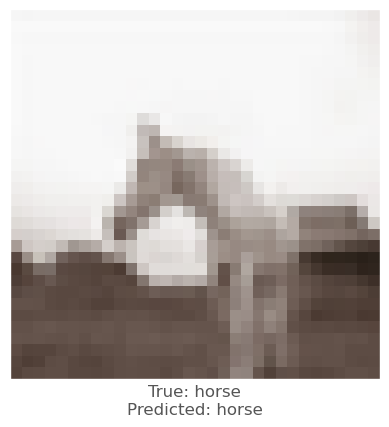



0.004211545
-0.0012390018
0.0014973283
vr, vg, vb :   -0.4211544990539551 0.12390017509460449 -0.1497328281402588
beam_perturbed_confidence temp :  0.72615737
beam_perturbed_confidence temp :  0.72774804
beam_perturbed_confidence temp :  0.7269738
beam_perturbed_confidence temp :  0.72615737
beam_perturbed_confidence temp :  0.7253072
beam_perturbed_confidence temp :  0.7269738
beam_perturbed_confidence temp :  0.7253072
row index :  4
0th round's confidence : 1th 0.7253072
predicted class :  horse
predicted class's confidence :  0.7253072
Lopt is :  6


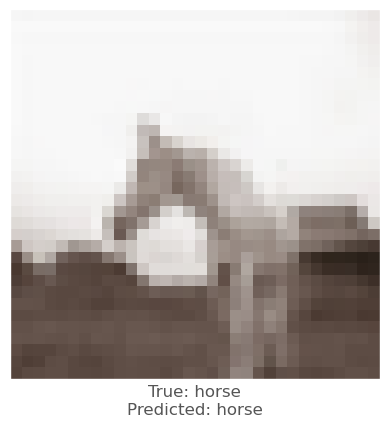



0.0010808706
-0.00678128
-0.0031288862
vr, vg, vb :   -0.10808706283569336 0.6781280040740967 0.31288862228393555
beam_perturbed_confidence temp :  0.8133692
beam_perturbed_confidence temp :  0.8143674
beam_perturbed_confidence temp :  0.8143674
beam_perturbed_confidence temp :  0.8133692
beam_perturbed_confidence temp :  0.8133692
beam_perturbed_confidence temp :  0.8143674
beam_perturbed_confidence temp :  0.8133692
row index :  0
0th round's confidence : 2th 0.8133692
predicted class :  horse
predicted class's confidence :  0.8133692
Lopt is :  5


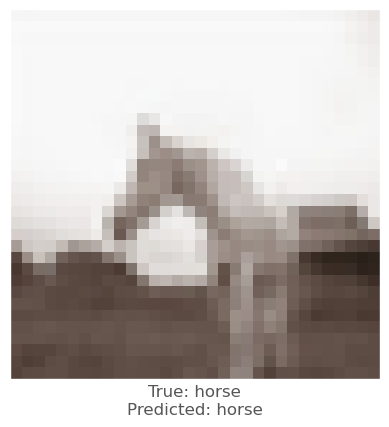



0.0044208765
0.0051888824
0.0056532025
vr, vg, vb :   -0.44208765029907227 -0.5188882350921631 -0.5653202533721924
beam_perturbed_confidence temp :  0.695444
beam_perturbed_confidence temp :  0.6956201
beam_perturbed_confidence temp :  0.6948457
beam_perturbed_confidence temp :  0.6932997
beam_perturbed_confidence temp :  0.69288445
beam_perturbed_confidence temp :  0.69297475
beam_perturbed_confidence temp :  0.69046533
row index :  6
0th round's confidence : 3th 0.69046533
predicted class :  horse
predicted class's confidence :  0.69046533
Lopt is :  11


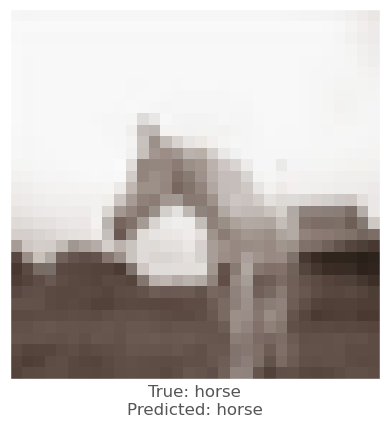



0.00048351288
-0.0047106743
-0.0051321983
vr, vg, vb :   -0.048351287841796875 0.4710674285888672 0.5132198333740234
beam_perturbed_confidence temp :  0.7893867
beam_perturbed_confidence temp :  0.7898702
beam_perturbed_confidence temp :  0.7898702
beam_perturbed_confidence temp :  0.7893867
beam_perturbed_confidence temp :  0.7893867
beam_perturbed_confidence temp :  0.7898702
beam_perturbed_confidence temp :  0.7893867
row index :  0
0th round's confidence : 4th 0.7893867
predicted class :  horse
predicted class's confidence :  0.7893867
Lopt is :  10


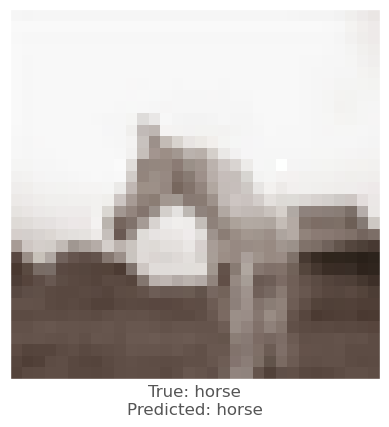



0.00071156025
-0.0076444745
-0.00074619055
vr, vg, vb :   -0.998009443283081 0.49905359745025635 -0.4701268672943115
beam_perturbed_confidence temp :  0.6981818
beam_perturbed_confidence temp :  0.6954304
beam_perturbed_confidence temp :  0.69748163
beam_perturbed_confidence temp :  0.6981818
beam_perturbed_confidence temp :  0.7017551
beam_perturbed_confidence temp :  0.69748163
beam_perturbed_confidence temp :  0.7017551
row index :  1
1th round's confidence : 0th 0.6954304
predicted class :  horse
predicted class's confidence :  0.6954304
Lopt is :  1


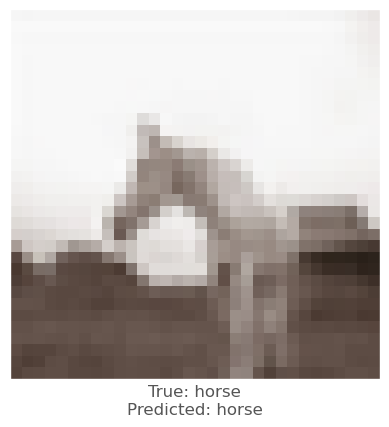



0.0037888288
0.00045114756
0.0020475388
vr, vg, vb :   -0.7579219341278076 0.06639540195465088 -0.3395134210586548
beam_perturbed_confidence temp :  0.72318494
beam_perturbed_confidence temp :  0.7253072
beam_perturbed_confidence temp :  0.7241098
beam_perturbed_confidence temp :  0.72318494
beam_perturbed_confidence temp :  0.72199094
beam_perturbed_confidence temp :  0.7241098
beam_perturbed_confidence temp :  0.72199094
row index :  4
1th round's confidence : 1th 0.72199094
predicted class :  horse
predicted class's confidence :  0.72199094
Lopt is :  7


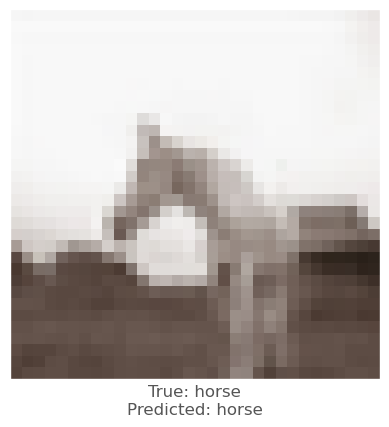



0.0029281974
-0.0041595697
-0.0021672845
vr, vg, vb :   -0.39009809494018555 1.026272177696228 0.49832820892333984
beam_perturbed_confidence temp :  0.8114392
beam_perturbed_confidence temp :  0.810067
beam_perturbed_confidence temp :  0.8133692
beam_perturbed_confidence temp :  0.8091
beam_perturbed_confidence temp :  0.8114392
beam_perturbed_confidence temp :  0.810067
beam_perturbed_confidence temp :  0.8091
row index :  3
1th round's confidence : 2th 0.8091
predicted class :  horse
predicted class's confidence :  0.8091
Lopt is :  6


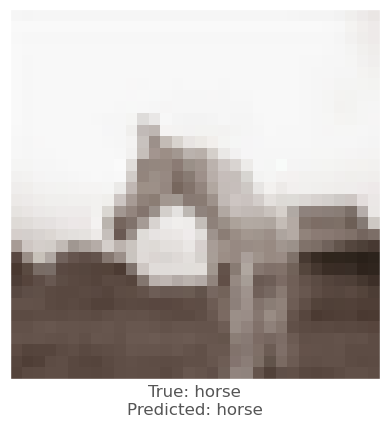



0.0043649077
0.005329013
0.0057727695
vr, vg, vb :   -0.8343696594238281 -0.9999006986618042 -1.0860651731491089
beam_perturbed_confidence temp :  0.68860984
beam_perturbed_confidence temp :  0.68755543
beam_perturbed_confidence temp :  0.6844193
beam_perturbed_confidence temp :  0.6856839
beam_perturbed_confidence temp :  0.68224025
beam_perturbed_confidence temp :  0.68109804
beam_perturbed_confidence temp :  0.67853874
row index :  6
1th round's confidence : 3th 0.67853874
predicted class :  horse
predicted class's confidence :  0.67853874
Lopt is :  13


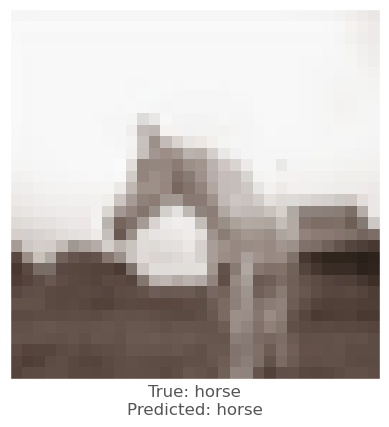



0.0013893843
-0.004348278
-0.005152762
vr, vg, vb :   -0.18245458602905273 0.8587884902954102 0.9771740436553955
beam_perturbed_confidence temp :  0.7884808
beam_perturbed_confidence temp :  0.7893867
beam_perturbed_confidence temp :  0.7893867
beam_perturbed_confidence temp :  0.7884808
beam_perturbed_confidence temp :  0.7884808
beam_perturbed_confidence temp :  0.7893867
beam_perturbed_confidence temp :  0.7884808
row index :  0
1th round's confidence : 4th 0.7884808
predicted class :  horse
predicted class's confidence :  0.7884808
Lopt is :  10


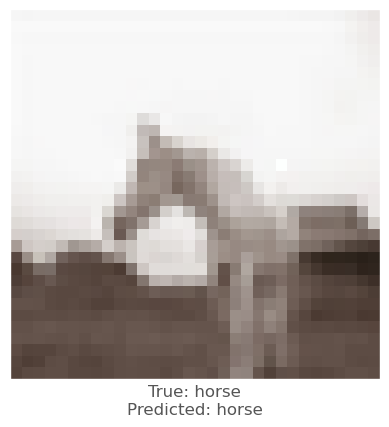



0.00071156025
-0.0076444745
-0.00074619055
vr, vg, vb :   -0.9693645238876343 1.213595688343048 -0.34849512577056885
beam_perturbed_confidence temp :  0.6981818
beam_perturbed_confidence temp :  0.69697976
beam_perturbed_confidence temp :  0.69748163
beam_perturbed_confidence temp :  0.6901664
beam_perturbed_confidence temp :  0.7017551
beam_perturbed_confidence temp :  0.69113016
beam_perturbed_confidence temp :  0.6916248
row index :  3
2th round's confidence : 0th 0.6901664
predicted class :  horse
predicted class's confidence :  0.6901664
Lopt is :  1


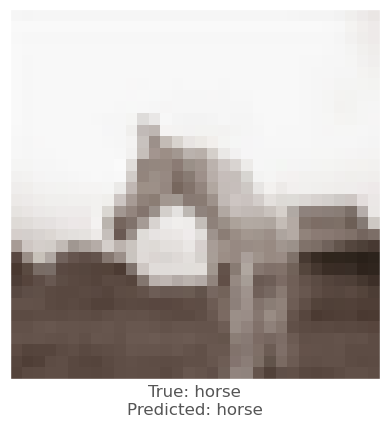



0.004885912
0.002254784
0.0021945834
vr, vg, vb :   -1.1707209348678589 -0.1657225489616394 -0.5250204205513
beam_perturbed_confidence temp :  0.71493775
beam_perturbed_confidence temp :  0.72017646
beam_perturbed_confidence temp :  0.72099036
beam_perturbed_confidence temp :  0.7139484
beam_perturbed_confidence temp :  0.71373284
beam_perturbed_confidence temp :  0.7195745
beam_perturbed_confidence temp :  0.71347135
row index :  6
2th round's confidence : 1th 0.71347135
predicted class :  horse
predicted class's confidence :  0.71347135
Lopt is :  9


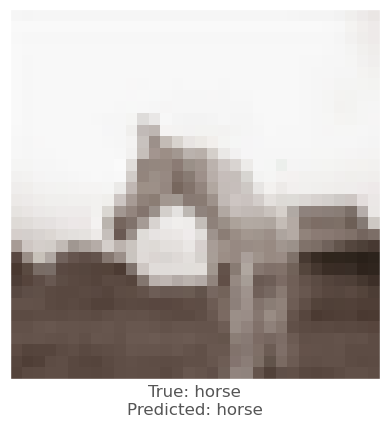



0.0027393699
-0.0063734055
-0.0027461648
vr, vg, vb :   -0.6250252723693848 1.560985505580902 0.7231118679046631
beam_perturbed_confidence temp :  0.8073276
beam_perturbed_confidence temp :  0.8050658
beam_perturbed_confidence temp :  0.8091
beam_perturbed_confidence temp :  0.80452514
beam_perturbed_confidence temp :  0.8073276
beam_perturbed_confidence temp :  0.8050658
beam_perturbed_confidence temp :  0.80452514
row index :  3
2th round's confidence : 2th 0.80452514
predicted class :  horse
predicted class's confidence :  0.80452514
Lopt is :  7


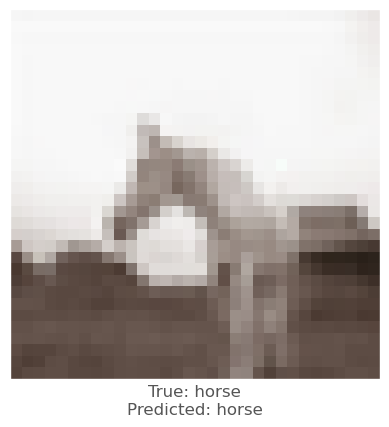



0.0048215985
0.007209182
0.006677687
vr, vg, vb :   -1.2330925464630127 -1.6208288073539734 -1.6452273726463318
beam_perturbed_confidence temp :  0.6747637
beam_perturbed_confidence temp :  0.6731721
beam_perturbed_confidence temp :  0.6721247
beam_perturbed_confidence temp :  0.66968167
beam_perturbed_confidence temp :  0.66948265
beam_perturbed_confidence temp :  0.6685157
beam_perturbed_confidence temp :  0.6644121
row index :  6
2th round's confidence : 3th 0.6644121
predicted class :  horse
predicted class's confidence :  0.6644121
Lopt is :  15


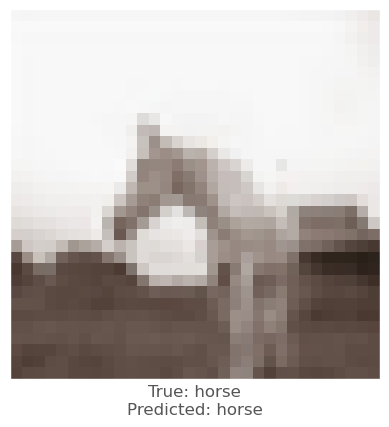



0.0022982955
-0.004028201
-0.0047746897
vr, vg, vb :   -0.39403867721557617 1.175729751586914 1.3569256067276
beam_perturbed_confidence temp :  0.7870884
beam_perturbed_confidence temp :  0.7884808
beam_perturbed_confidence temp :  0.78598315
beam_perturbed_confidence temp :  0.7870884
beam_perturbed_confidence temp :  0.7846394
beam_perturbed_confidence temp :  0.78598315
beam_perturbed_confidence temp :  0.7846394
row index :  4
2th round's confidence : 4th 0.7846394
predicted class :  horse
predicted class's confidence :  0.7846394
Lopt is :  11


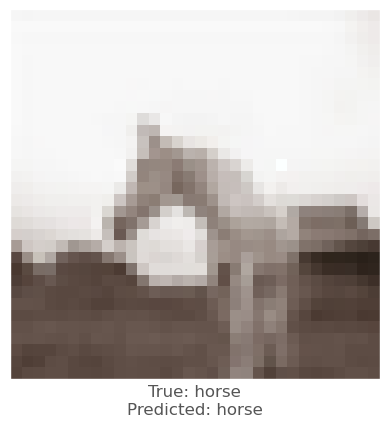



0.005911052
-0.002572298
0.00055992603
vr, vg, vb :   -1.4635332942008974 1.3494659245014191 -0.3696382164955139
beam_perturbed_confidence temp :  0.6952572
beam_perturbed_confidence temp :  0.6956095
beam_perturbed_confidence temp :  0.6916248
beam_perturbed_confidence temp :  0.68496704
beam_perturbed_confidence temp :  0.69896084
beam_perturbed_confidence temp :  0.6882085
beam_perturbed_confidence temp :  0.68798125
row index :  3
3th round's confidence : 0th 0.68496704
predicted class :  horse
predicted class's confidence :  0.68496704
Lopt is :  3


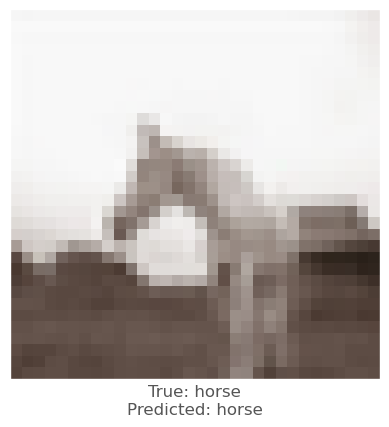



0.006274581
0.00022023916
0.001262784
vr, vg, vb :   -1.68110693693161 -0.1711742103099823 -0.5987967789173126
beam_perturbed_confidence temp :  0.70631105
beam_perturbed_confidence temp :  0.7135126
beam_perturbed_confidence temp :  0.71268564
beam_perturbed_confidence temp :  0.70581186
beam_perturbed_confidence temp :  0.7056122
beam_perturbed_confidence temp :  0.7117892
beam_perturbed_confidence temp :  0.70456225
row index :  6
3th round's confidence : 1th 0.70456225
predicted class :  horse
predicted class's confidence :  0.70456225
Lopt is :  11


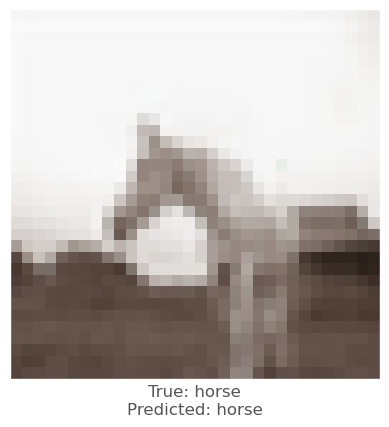



0.00232476
-0.006905377
-0.0028781295
vr, vg, vb :   -0.7949987411499023 2.0954246461391453 0.9386136293411255
beam_perturbed_confidence temp :  0.80274105
beam_perturbed_confidence temp :  0.7966627
beam_perturbed_confidence temp :  0.80452514
beam_perturbed_confidence temp :  0.79539514
beam_perturbed_confidence temp :  0.80274105
beam_perturbed_confidence temp :  0.7966627
beam_perturbed_confidence temp :  0.79539514
row index :  3
3th round's confidence : 2th 0.79539514
predicted class :  horse
predicted class's confidence :  0.79539514
Lopt is :  9


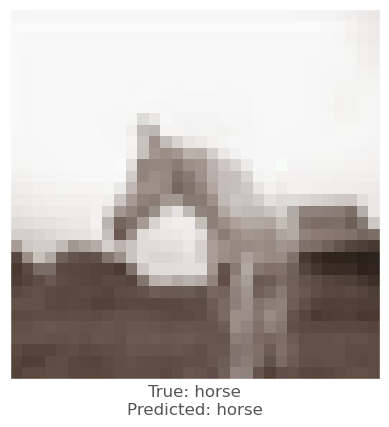



0.004486084
0.0052253604
0.0047068596
vr, vg, vb :   -1.5583916902542114 -1.981281965970993 -1.9513905942440033
beam_perturbed_confidence temp :  0.66009265
beam_perturbed_confidence temp :  0.6585235
beam_perturbed_confidence temp :  0.66013783
beam_perturbed_confidence temp :  0.6511976
beam_perturbed_confidence temp :  0.6549496
beam_perturbed_confidence temp :  0.6539965
beam_perturbed_confidence temp :  0.64642113
row index :  6
3th round's confidence : 3th 0.64642113
predicted class :  horse
predicted class's confidence :  0.64642113
Lopt is :  17


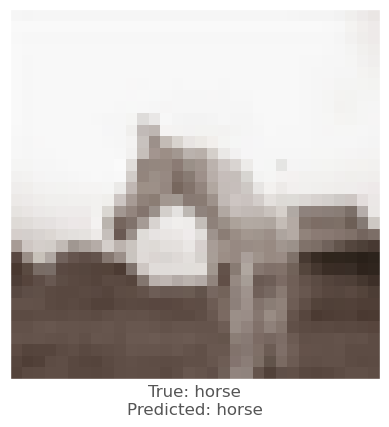



0.0021692514
-0.004239738
-0.002448976
vr, vg, vb :   -0.5715599536895752 1.4821305751800538 1.4661306500434876
beam_perturbed_confidence temp :  0.7838139
beam_perturbed_confidence temp :  0.7846394
beam_perturbed_confidence temp :  0.7846394
beam_perturbed_confidence temp :  0.7838139
beam_perturbed_confidence temp :  0.7838139
beam_perturbed_confidence temp :  0.7846394
beam_perturbed_confidence temp :  0.7838139
row index :  0
3th round's confidence : 4th 0.7838139
predicted class :  horse
predicted class's confidence :  0.7838139
Lopt is :  11


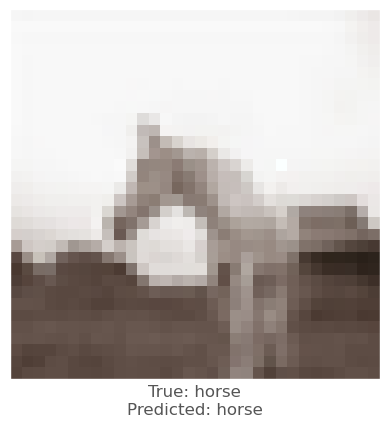



-0.003515184
-0.012585342
-0.0035549402
vr, vg, vb :   -0.9656615722179416 2.4730535250902177 0.022819627523422203
beam_perturbed_confidence temp :  0.68894917
beam_perturbed_confidence temp :  0.6935472
beam_perturbed_confidence temp :  0.68496704
beam_perturbed_confidence temp :  0.6825953
beam_perturbed_confidence temp :  0.68894917
beam_perturbed_confidence temp :  0.6935472
beam_perturbed_confidence temp :  0.6825953
row index :  3
4th round's confidence : 0th 0.6825953
predicted class :  horse
predicted class's confidence :  0.6825953
Lopt is :  4


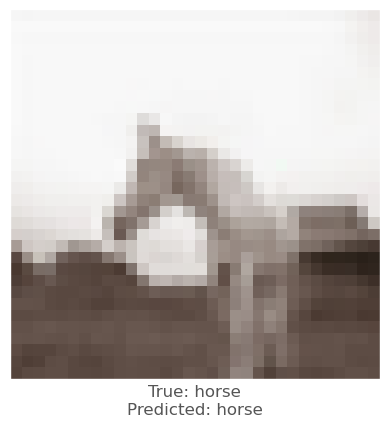



0.0067168474
0.002016127
0.002456069
vr, vg, vb :   -2.184680985212326 -0.3556695002317429 -0.784524000287056
beam_perturbed_confidence temp :  0.69212765
beam_perturbed_confidence temp :  0.70359606
beam_perturbed_confidence temp :  0.7033558
beam_perturbed_confidence temp :  0.6908281
beam_perturbed_confidence temp :  0.691203
beam_perturbed_confidence temp :  0.7017437
beam_perturbed_confidence temp :  0.6901264
row index :  6
4th round's confidence : 1th 0.6901264
predicted class :  horse
predicted class's confidence :  0.6901264
Lopt is :  14


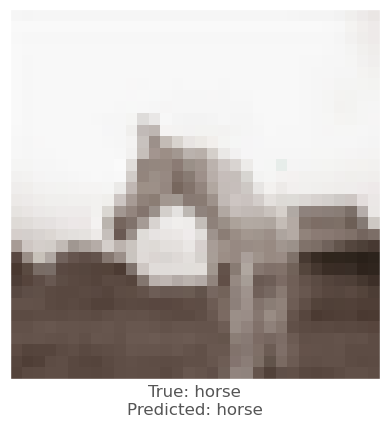



0.002701342
-0.008535087
-0.0036208034
vr, vg, vb :   -0.9856330776214599 2.739390892386437 1.2068326020240785
beam_perturbed_confidence temp :  0.79396135
beam_perturbed_confidence temp :  0.7911681
beam_perturbed_confidence temp :  0.79366004
beam_perturbed_confidence temp :  0.7899143
beam_perturbed_confidence temp :  0.79201156
beam_perturbed_confidence temp :  0.7898095
beam_perturbed_confidence temp :  0.78826684
row index :  6
4th round's confidence : 2th 0.78826684
predicted class :  horse
predicted class's confidence :  0.78826684
Lopt is :  10


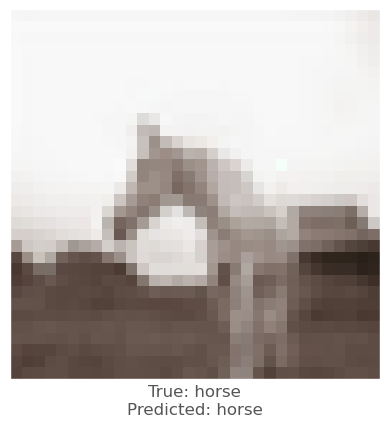



0.00842905
0.010234058
0.0042125583
vr, vg, vb :   -2.2454575657844544 -2.8065595597028734 -2.1775073617696763
beam_perturbed_confidence temp :  0.633225
beam_perturbed_confidence temp :  0.630365
beam_perturbed_confidence temp :  0.64013267
beam_perturbed_confidence temp :  0.61932623
beam_perturbed_confidence temp :  0.6273831
beam_perturbed_confidence temp :  0.62324655
beam_perturbed_confidence temp :  0.613524
row index :  6
4th round's confidence : 3th 0.613524
predicted class :  horse
predicted class's confidence :  0.613524
Lopt is :  20


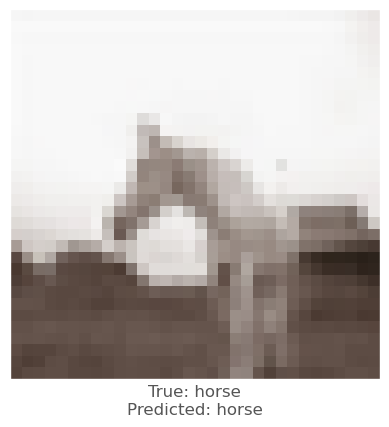



0.0019276142
-0.0041249394
-0.002208531
vr, vg, vb :   -0.707165379524231 1.7464114618301392 1.5403706753253938
beam_perturbed_confidence temp :  0.7827118
beam_perturbed_confidence temp :  0.7838139
beam_perturbed_confidence temp :  0.7838139
beam_perturbed_confidence temp :  0.7827118
beam_perturbed_confidence temp :  0.7827118
beam_perturbed_confidence temp :  0.7838139
beam_perturbed_confidence temp :  0.7827118
row index :  0
4th round's confidence : 4th 0.7827118
predicted class :  horse
predicted class's confidence :  0.7827118
Lopt is :  11


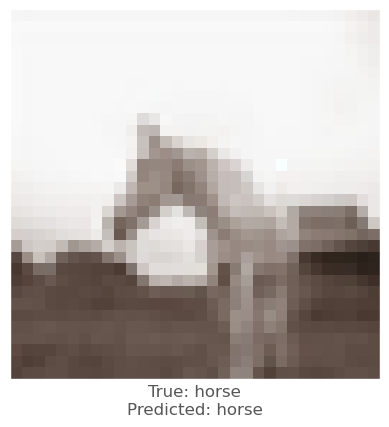



0.015766919
0.014366031
0.01136291
vr, vg, vb :   -2.445787280917168 0.7891451032757759 -1.1157533622980118
beam_perturbed_confidence temp :  0.68501407
beam_perturbed_confidence temp :  0.6825953
beam_perturbed_confidence temp :  0.6781396
beam_perturbed_confidence temp :  0.68501407
beam_perturbed_confidence temp :  0.6943294
beam_perturbed_confidence temp :  0.6781396
beam_perturbed_confidence temp :  0.6943294
row index :  2
5th round's confidence : 0th 0.6781396
predicted class :  horse
predicted class's confidence :  0.6781396
Lopt is :  4


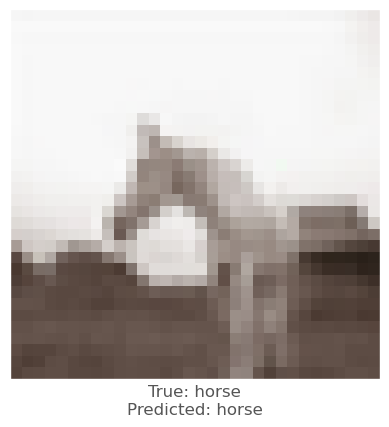



0.008562505
0.0015386343
0.0015599728
vr, vg, vb :   -2.8224634112119675 -0.47396598023176195 -0.8620688765645028
beam_perturbed_confidence temp :  0.6779537
beam_perturbed_confidence temp :  0.68966436
beam_perturbed_confidence temp :  0.6892681
beam_perturbed_confidence temp :  0.67795587
beam_perturbed_confidence temp :  0.6772099
beam_perturbed_confidence temp :  0.6881628
beam_perturbed_confidence temp :  0.67689013
row index :  6
5th round's confidence : 1th 0.67689013
predicted class :  horse
predicted class's confidence :  0.67689013
Lopt is :  17


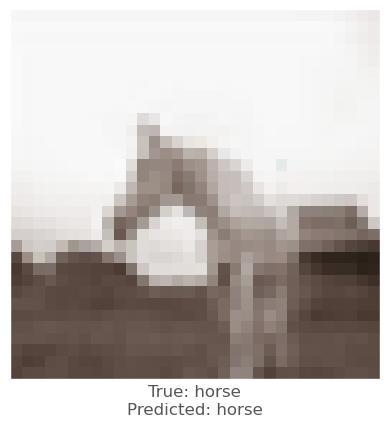



0.0030571222
-0.0037447214
-0.003247738
vr, vg, vb :   -1.1927819929122925 2.8399239444136626 1.4109231302738192
beam_perturbed_confidence temp :  0.7847166
beam_perturbed_confidence temp :  0.78826684
beam_perturbed_confidence temp :  0.7866666
beam_perturbed_confidence temp :  0.7847166
beam_perturbed_confidence temp :  0.7827272
beam_perturbed_confidence temp :  0.7866666
beam_perturbed_confidence temp :  0.7827272
row index :  4
5th round's confidence : 2th 0.7827272
predicted class :  horse
predicted class's confidence :  0.7827272
Lopt is :  10


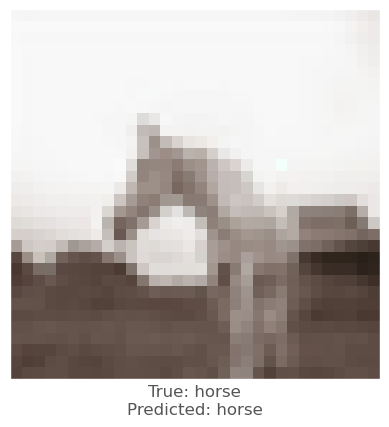



0.0068308115
0.009036899
0.004131615
vr, vg, vb :   -2.703992959260941 -3.4295934650301936 -2.372918141782284
beam_perturbed_confidence temp :  0.5997491
beam_perturbed_confidence temp :  0.5958843
beam_perturbed_confidence temp :  0.60810715
beam_perturbed_confidence temp :  0.58462733
beam_perturbed_confidence temp :  0.59726423
beam_perturbed_confidence temp :  0.58620256
beam_perturbed_confidence temp :  0.5769523
row index :  6
5th round's confidence : 3th 0.5769523
predicted class :  horse
predicted class's confidence :  0.5769523
Lopt is :  23


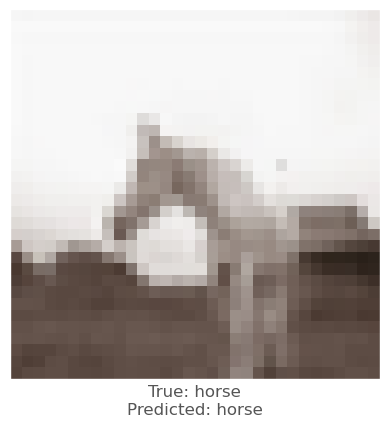



0.0024727583
-0.00457108
-0.0024888515
vr, vg, vb :   -0.8837246708869935 2.028878336429596 1.6352187625169756
beam_perturbed_confidence temp :  0.78134114
beam_perturbed_confidence temp :  0.7827118
beam_perturbed_confidence temp :  0.7827118
beam_perturbed_confidence temp :  0.78134114
beam_perturbed_confidence temp :  0.78134114
beam_perturbed_confidence temp :  0.7827118
beam_perturbed_confidence temp :  0.78134114
row index :  0
5th round's confidence : 4th 0.78134114
predicted class :  horse
predicted class's confidence :  0.78134114
Lopt is :  11


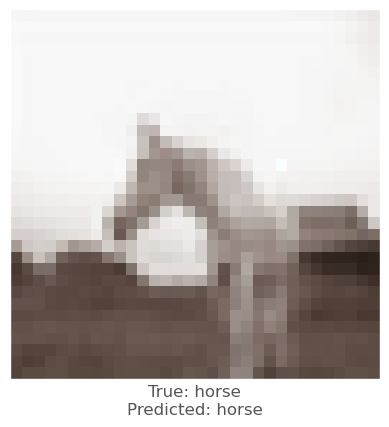



-0.00060659647
-0.006178558
-0.003037393
vr, vg, vb :   -2.140548905837536 1.32808638022542 -0.7004387167572976
beam_perturbed_confidence temp :  0.6943294
beam_perturbed_confidence temp :  0.6809647
beam_perturbed_confidence temp :  0.6814201
beam_perturbed_confidence temp :  0.6826852
beam_perturbed_confidence temp :  0.69916934
beam_perturbed_confidence temp :  0.6771093
beam_perturbed_confidence temp :  0.6873767
row index :  5
6th round's confidence : 0th 0.6771093
predicted class :  horse
predicted class's confidence :  0.6771093
Lopt is :  5


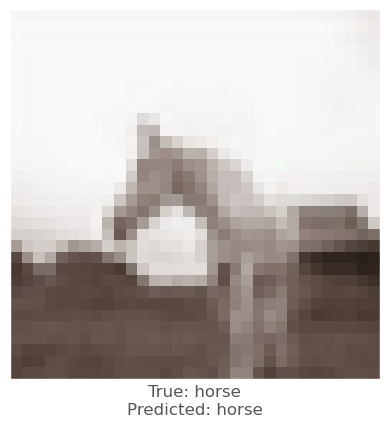



0.010069311
0.0014815927
0.0020700693
vr, vg, vb :   -3.547148136603832 -0.5747286477267742 -0.9828689202129842
beam_perturbed_confidence temp :  0.65609926
beam_perturbed_confidence temp :  0.6757283
beam_perturbed_confidence temp :  0.6758858
beam_perturbed_confidence temp :  0.65430254
beam_perturbed_confidence temp :  0.65495735
beam_perturbed_confidence temp :  0.6748949
beam_perturbed_confidence temp :  0.6538969
row index :  6
6th round's confidence : 1th 0.6538969
predicted class :  horse
predicted class's confidence :  0.6538969
Lopt is :  21


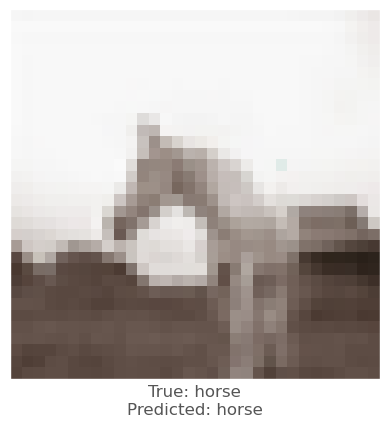



0.0051265955
-0.003739059
-0.003918767
vr, vg, vb :   -1.586163343334198 2.9298374471127993 1.6617075147867206
beam_perturbed_confidence temp :  0.77667695
beam_perturbed_confidence temp :  0.7827272
beam_perturbed_confidence temp :  0.78079784
beam_perturbed_confidence temp :  0.77667695
beam_perturbed_confidence temp :  0.7751725
beam_perturbed_confidence temp :  0.78079784
beam_perturbed_confidence temp :  0.7751725
row index :  4
6th round's confidence : 2th 0.7751725
predicted class :  horse
predicted class's confidence :  0.7751725
Lopt is :  10


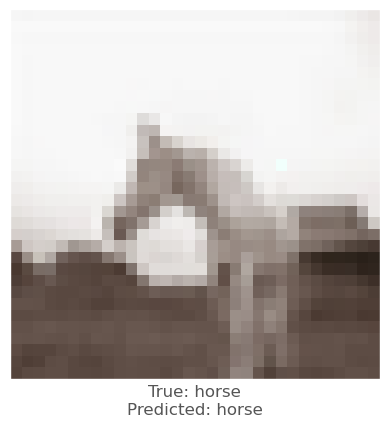



0.010816038
0.014717698
0.006428838
vr, vg, vb :   -3.5151974288225176 -4.558403928250074 -2.778510105222464
beam_perturbed_confidence temp :  0.54820734
beam_perturbed_confidence temp :  0.53606206
beam_perturbed_confidence temp :  0.56669986
beam_perturbed_confidence temp :  0.51030654
beam_perturbed_confidence temp :  0.5408348
beam_perturbed_confidence temp :  0.5246436
beam_perturbed_confidence temp :  0.5030289
row index :  6
6th round's confidence : 3th 0.5030289
predicted class :  horse
predicted class's confidence :  0.5030289
Lopt is :  28


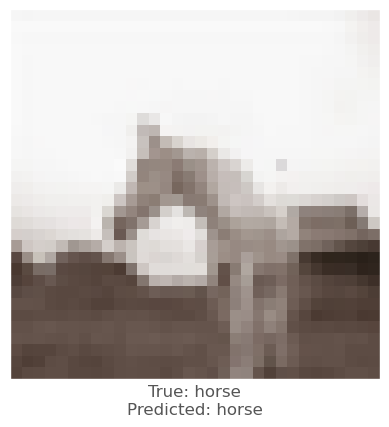



0.0024453998
-0.0050774813
-0.0028716326
vr, vg, vb :   -1.0398921799182892 2.333738629770279 1.7588601438641551
beam_perturbed_confidence temp :  0.77909493
beam_perturbed_confidence temp :  0.78134114
beam_perturbed_confidence temp :  0.78134114
beam_perturbed_confidence temp :  0.77909493
beam_perturbed_confidence temp :  0.77909493
beam_perturbed_confidence temp :  0.78134114
beam_perturbed_confidence temp :  0.77909493
row index :  0
6th round's confidence : 4th 0.77909493
predicted class :  horse
predicted class's confidence :  0.77909493
Lopt is :  11


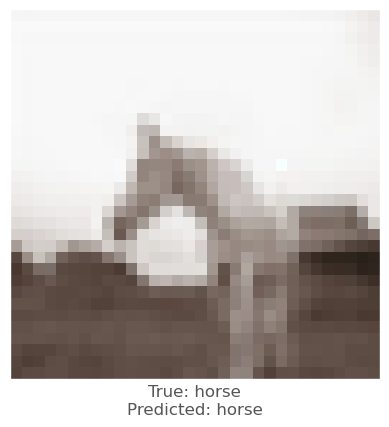



0.00851208
0.004213989
0.0036211014
vr, vg, vb :   -2.777701986826658 0.7738788641053438 -0.992504983021021
beam_perturbed_confidence temp :  0.6873767
beam_perturbed_confidence temp :  0.6771093
beam_perturbed_confidence temp :  0.6773436
beam_perturbed_confidence temp :  0.6873767
beam_perturbed_confidence temp :  0.691993
beam_perturbed_confidence temp :  0.6773436
beam_perturbed_confidence temp :  0.691993
row index :  1
7th round's confidence : 0th 0.6771093
predicted class :  horse
predicted class's confidence :  0.6771093
Lopt is :  5


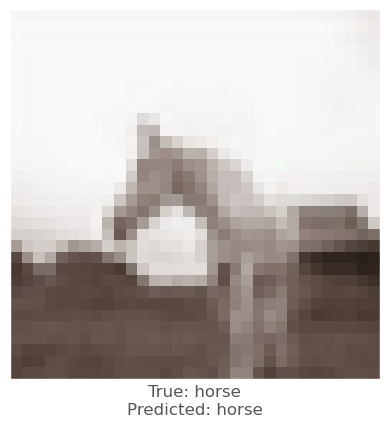



0.009359717
0.002336502
0.0010582805
vr, vg, vb :   -4.128405059851408 -0.750905990473628 -0.9904100749903919
beam_perturbed_confidence temp :  0.6326519
beam_perturbed_confidence temp :  0.65262085
beam_perturbed_confidence temp :  0.65324426
beam_perturbed_confidence temp :  0.6279805
beam_perturbed_confidence temp :  0.631811
beam_perturbed_confidence temp :  0.6515882
beam_perturbed_confidence temp :  0.62713546
row index :  6
7th round's confidence : 1th 0.62713546
predicted class :  horse
predicted class's confidence :  0.62713546
Lopt is :  26


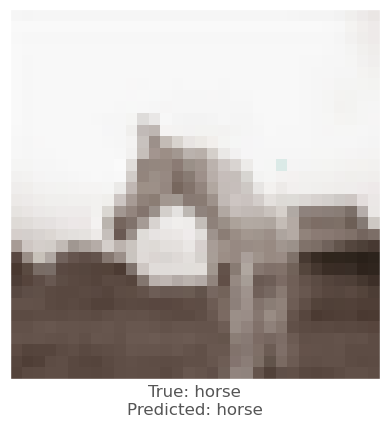



0.006333053
-0.0013358593
-0.0038790703
vr, vg, vb :   -2.0608523202037814 2.770439632272125 1.8834437915062907
beam_perturbed_confidence temp :  0.76127625
beam_perturbed_confidence temp :  0.7751725
beam_perturbed_confidence temp :  0.7727979
beam_perturbed_confidence temp :  0.76127625
beam_perturbed_confidence temp :  0.7618609
beam_perturbed_confidence temp :  0.7727979
beam_perturbed_confidence temp :  0.7618609
row index :  0
7th round's confidence : 2th 0.76127625
predicted class :  horse
predicted class's confidence :  0.76127625
Lopt is :  10


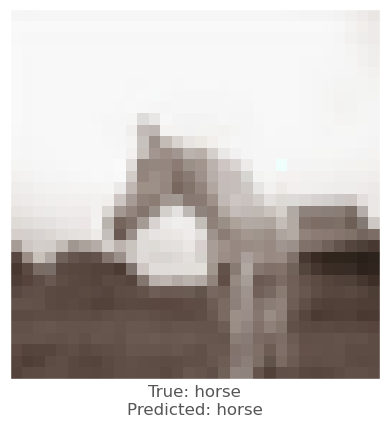



0.015159547
0.0155490935
0.0048244596
vr, vg, vb :   -4.679632418835164 -5.657472883912921 -2.983105049976707
beam_perturbed_confidence temp :  0.4612245
beam_perturbed_confidence temp :  0.44729054
beam_perturbed_confidence temp :  0.4964376
beam_perturbed_confidence temp :  0.41377288
beam_perturbed_confidence temp :  0.45563138
beam_perturbed_confidence temp :  0.43179682
beam_perturbed_confidence temp :  0.40797257
row index :  6
7th round's confidence : 3th 0.40797257
predicted class :  airplane
predicted class's confidence :  0.5885758
Lopt is :  34


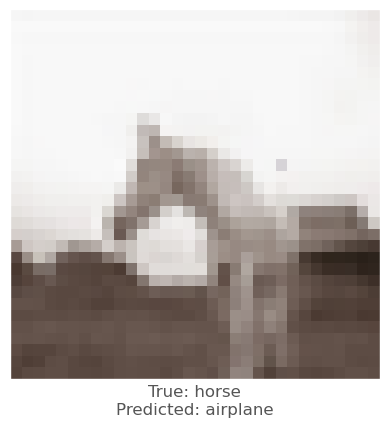




22th sensitive pixel
original confidence is :  0.69673544 

original r,g,b :  235 231 229
-0.00023210049
0.0015769005
-0.0026533604
vr, vg, vb :   0.02321004867553711 -0.15769004821777344 0.2653360366821289
beam_perturbed_confidence temp :  0.69673544
beam_perturbed_confidence temp :  0.69504607
beam_perturbed_confidence temp :  0.69673544
beam_perturbed_confidence temp :  0.69504607
beam_perturbed_confidence temp :  0.69673544
beam_perturbed_confidence temp :  0.69504607
beam_perturbed_confidence temp :  0.69504607
row index :  1
0th round's confidence : 0th 0.69504607
predicted class :  horse
predicted class's confidence :  0.69504607
Lopt is :  1


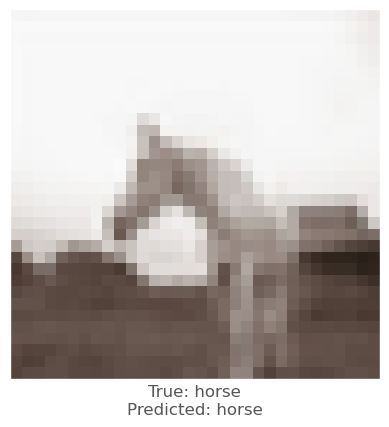



0.012126744
0.017762661
0.001656115
vr, vg, vb :   -1.2126743793487549 -1.776266098022461 -0.16561150550842285
beam_perturbed_confidence temp :  0.6457492
beam_perturbed_confidence temp :  0.6397064
beam_perturbed_confidence temp :  0.6603849
beam_perturbed_confidence temp :  0.62059695
beam_perturbed_confidence temp :  0.64278036
beam_perturbed_confidence temp :  0.63696
beam_perturbed_confidence temp :  0.6194641
row index :  6
0th round's confidence : 1th 0.6194641
predicted class :  horse
predicted class's confidence :  0.6194641
Lopt is :  7


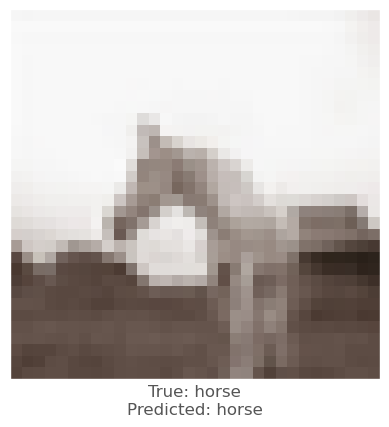



-0.013142526
-0.010187268
-0.010119498
vr, vg, vb :   1.3142526149749756 1.0187268257141113 1.0119497776031494
beam_perturbed_confidence temp :  0.6292042
beam_perturbed_confidence temp :  0.63116586
beam_perturbed_confidence temp :  0.6312111
beam_perturbed_confidence temp :  0.62307894
beam_perturbed_confidence temp :  0.62334675
beam_perturbed_confidence temp :  0.6256587
beam_perturbed_confidence temp :  0.6172063
row index :  6
0th round's confidence : 2th 0.6172063
predicted class :  horse
predicted class's confidence :  0.6172063
Lopt is :  6


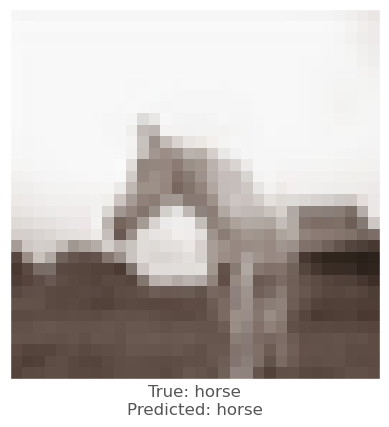



0.019125164
0.029286265
0.0070185065
vr, vg, vb :   -1.9125163555145264 -2.928626537322998 -0.7018506526947021
beam_perturbed_confidence temp :  0.5293551
beam_perturbed_confidence temp :  0.51082385
beam_perturbed_confidence temp :  0.54337233
beam_perturbed_confidence temp :  0.49779582
beam_perturbed_confidence temp :  0.52822614
beam_perturbed_confidence temp :  0.5097407
beam_perturbed_confidence temp :  0.49661106
row index :  6
0th round's confidence : 3th 0.49661106
predicted class :  airplane
predicted class's confidence :  0.4995537
Lopt is :  13


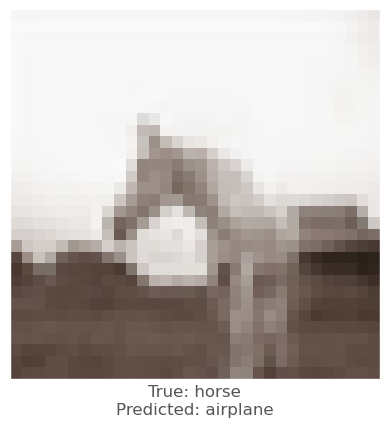




23th sensitive pixel
original confidence is :  0.69673544 

original r,g,b :  202 194 191
0.006657064
0.00093621016
0.00091713667
vr, vg, vb :   -0.6657063961029053 -0.09362101554870605 -0.09171366691589355
beam_perturbed_confidence temp :  0.69166255
beam_perturbed_confidence temp :  0.69409126
beam_perturbed_confidence temp :  0.6953923
beam_perturbed_confidence temp :  0.6876799
beam_perturbed_confidence temp :  0.6890672
beam_perturbed_confidence temp :  0.69113415
beam_perturbed_confidence temp :  0.6851089
row index :  6
0th round's confidence : 0th 0.6851089
predicted class :  horse
predicted class's confidence :  0.6851089
Lopt is :  1


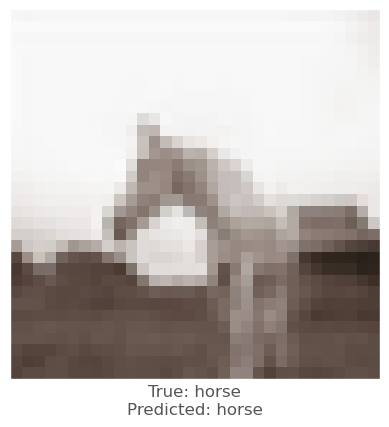



0.036940634
0.04020208
0.013862789
vr, vg, vb :   -3.694063425064087 -4.020208120346069 -1.3862788677215576
beam_perturbed_confidence temp :  0.49847332
beam_perturbed_confidence temp :  0.48762688
beam_perturbed_confidence temp :  0.56045157
beam_perturbed_confidence temp :  0.4274406
beam_perturbed_confidence temp :  0.4928493
beam_perturbed_confidence temp :  0.48253453
beam_perturbed_confidence temp :  0.42730895
row index :  6
0th round's confidence : 1th 0.42730895
predicted class :  airplane
predicted class's confidence :  0.5695848
Lopt is :  10


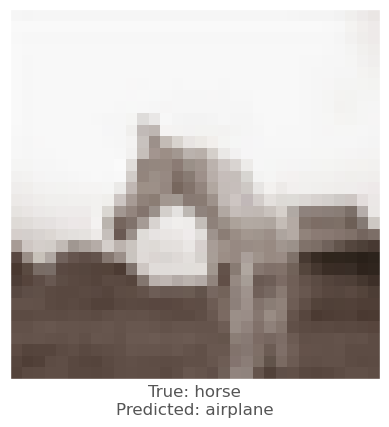




24th sensitive pixel
original confidence is :  0.69673544 

original r,g,b :  246 246 246
0.012323737
0.011738241
0.0050212145
vr, vg, vb :   -1.2323737144470215 -1.1738240718841553 -0.5021214485168457
beam_perturbed_confidence temp :  0.69113517
beam_perturbed_confidence temp :  0.6954561
beam_perturbed_confidence temp :  0.6951107
beam_perturbed_confidence temp :  0.7057564
beam_perturbed_confidence temp :  0.6934598
beam_perturbed_confidence temp :  0.6979924
beam_perturbed_confidence temp :  0.7061536
row index :  0
0th round's confidence : 0th 0.69113517
predicted class :  horse
predicted class's confidence :  0.69113517
Lopt is :  2


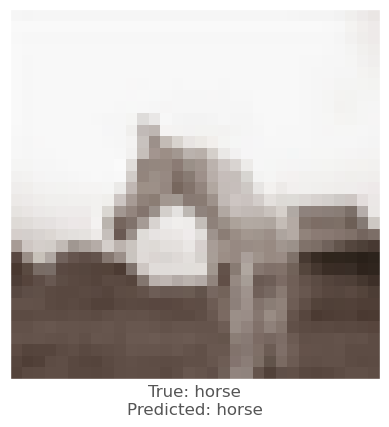



0.0062088966
0.006177962
0.005107403
vr, vg, vb :   -0.6208896636962891 -0.6177961826324463 -0.5107402801513672
beam_perturbed_confidence temp :  0.71068454
beam_perturbed_confidence temp :  0.7112133
beam_perturbed_confidence temp :  0.7115465
beam_perturbed_confidence temp :  0.70668364
beam_perturbed_confidence temp :  0.70751506
beam_perturbed_confidence temp :  0.7076578
beam_perturbed_confidence temp :  0.70408106
row index :  6
0th round's confidence : 1th 0.70408106
predicted class :  horse
predicted class's confidence :  0.70408106
Lopt is :  6


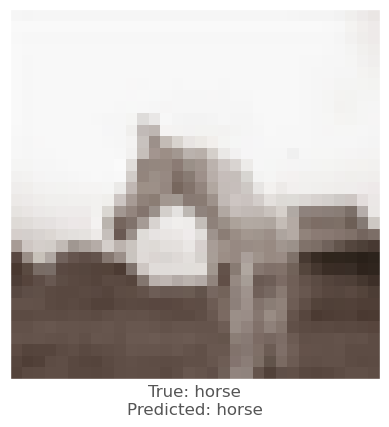



-0.0007387996
-0.0018727779
-7.677078e-05
vr, vg, vb :   0.07387995719909668 0.18727779388427734 0.0076770782470703125
beam_perturbed_confidence temp :  0.75394356
beam_perturbed_confidence temp :  0.75394356
beam_perturbed_confidence temp :  0.75394356
beam_perturbed_confidence temp :  0.75394356
beam_perturbed_confidence temp :  0.75394356
beam_perturbed_confidence temp :  0.75394356
beam_perturbed_confidence temp :  0.75394356
row index :  0
0th round's confidence : 2th 0.75394356
predicted class :  horse
predicted class's confidence :  0.75394356
Lopt is :  5


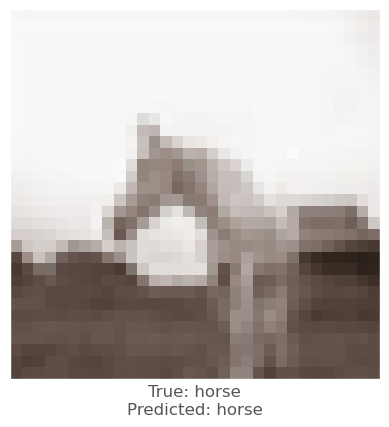



0.010567784
0.01266706
0.009537339
vr, vg, vb :   -1.0567784309387207 -1.2667059898376465 -0.9537339210510254
beam_perturbed_confidence temp :  0.63748884
beam_perturbed_confidence temp :  0.63515764
beam_perturbed_confidence temp :  0.6432637
beam_perturbed_confidence temp :  0.62625515
beam_perturbed_confidence temp :  0.6339093
beam_perturbed_confidence temp :  0.63027406
beam_perturbed_confidence temp :  0.62227166
row index :  6
0th round's confidence : 3th 0.62227166
predicted class :  horse
predicted class's confidence :  0.62227166
Lopt is :  12


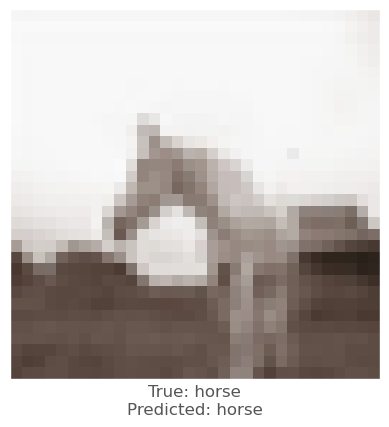



0.0
0.0
0.0
vr, vg, vb :   0.0 0.0 0.0
beam_perturbed_confidence temp :  0.0051303315
beam_perturbed_confidence temp :  0.05117824
beam_perturbed_confidence temp :  0.0007789347
beam_perturbed_confidence temp :  0.13823259
beam_perturbed_confidence temp :  0.017589256
beam_perturbed_confidence temp :  0.029192409
beam_perturbed_confidence temp :  0.71663254
row index :  2
0th round's confidence : 4th 0.0007789347
predicted class :  airplane
predicted class's confidence :  0.9989562
Lopt is :  10


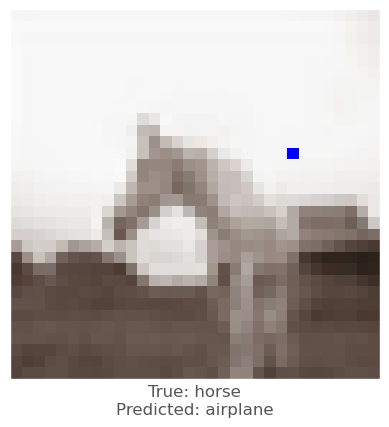




25th sensitive pixel
original confidence is :  0.69673544 

original r,g,b :  213 209 205
0.0121616125
0.009980857
0.00411582
vr, vg, vb :   -1.2161612510681152 -0.9980857372283936 -0.41158199310302734
beam_perturbed_confidence temp :  0.68466675
beam_perturbed_confidence temp :  0.69205546
beam_perturbed_confidence temp :  0.6947294
beam_perturbed_confidence temp :  0.67947215
beam_perturbed_confidence temp :  0.6821619
beam_perturbed_confidence temp :  0.69023633
beam_perturbed_confidence temp :  0.67796355
row index :  6
0th round's confidence : 0th 0.67796355
predicted class :  horse
predicted class's confidence :  0.67796355
Lopt is :  2


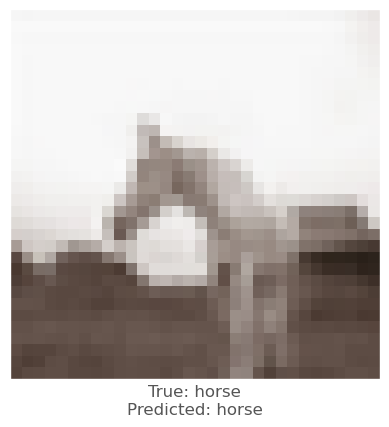



0.002850175
-0.0014558434
-0.0023286343
vr, vg, vb :   -0.2850174903869629 0.1455843448638916 0.2328634262084961
beam_perturbed_confidence temp :  0.66449314
beam_perturbed_confidence temp :  0.66568446
beam_perturbed_confidence temp :  0.66568446
beam_perturbed_confidence temp :  0.66449314
beam_perturbed_confidence temp :  0.66449314
beam_perturbed_confidence temp :  0.66568446
beam_perturbed_confidence temp :  0.66449314
row index :  0
0th round's confidence : 1th 0.66449314
predicted class :  horse
predicted class's confidence :  0.66449314
Lopt is :  6


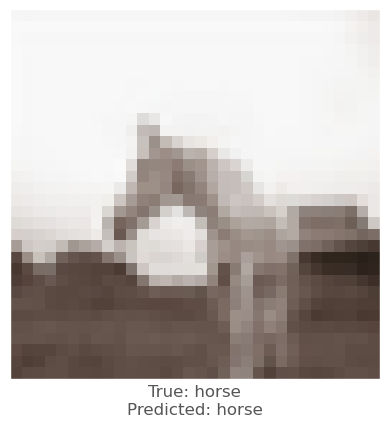



0.009156406
0.008452237
0.004583299
vr, vg, vb :   -0.9156405925750732 -0.8452236652374268 -0.4583299160003662
beam_perturbed_confidence temp :  0.7560156
beam_perturbed_confidence temp :  0.756268
beam_perturbed_confidence temp :  0.75836873
beam_perturbed_confidence temp :  0.7513231
beam_perturbed_confidence temp :  0.75377244
beam_perturbed_confidence temp :  0.7539042
beam_perturbed_confidence temp :  0.7489437
row index :  6
0th round's confidence : 2th 0.7489437
predicted class :  horse
predicted class's confidence :  0.7489437
Lopt is :  4


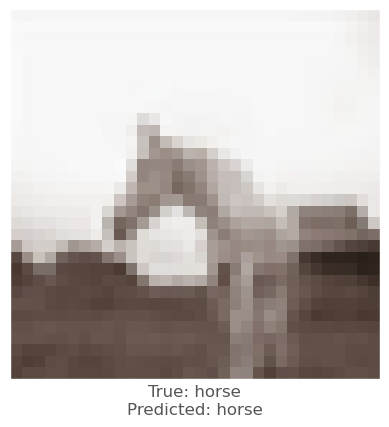



-0.0034787655
-0.0077534914
-0.0046101213
vr, vg, vb :   0.34787654876708984 0.7753491401672363 0.4610121250152588
beam_perturbed_confidence temp :  0.6835513
beam_perturbed_confidence temp :  0.6835513
beam_perturbed_confidence temp :  0.6835513
beam_perturbed_confidence temp :  0.6835513
beam_perturbed_confidence temp :  0.6835513
beam_perturbed_confidence temp :  0.6835513
beam_perturbed_confidence temp :  0.6835513
row index :  0
0th round's confidence : 3th 0.6835513
predicted class :  horse
predicted class's confidence :  0.6835513
Lopt is :  10


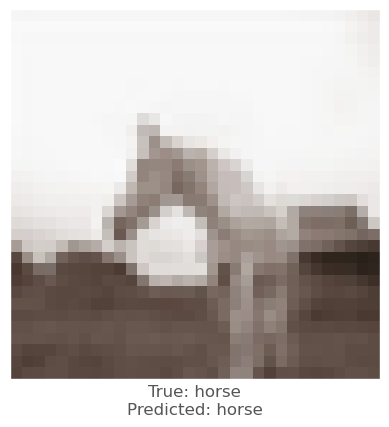



0.0034371018
0.0025852323
0.0010607243
vr, vg, vb :   -0.34371018409729004 -0.25852322578430176 -0.10607242584228516
beam_perturbed_confidence temp :  0.79394007
beam_perturbed_confidence temp :  0.794366
beam_perturbed_confidence temp :  0.79505897
beam_perturbed_confidence temp :  0.79212606
beam_perturbed_confidence temp :  0.7931717
beam_perturbed_confidence temp :  0.79349357
beam_perturbed_confidence temp :  0.79121315
row index :  6
0th round's confidence : 4th 0.79121315
predicted class :  horse
predicted class's confidence :  0.79121315
Lopt is :  9


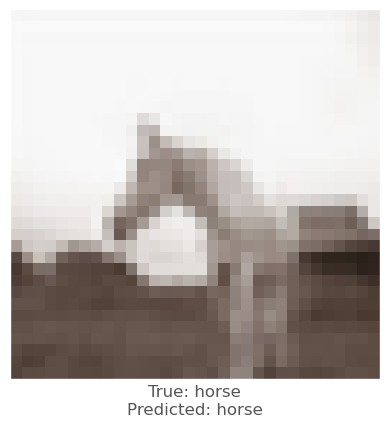



0.011327982
0.007490933
0.0027787685
vr, vg, vb :   -2.2273433208465576 -1.647370457649231 -0.6483006477355957
beam_perturbed_confidence temp :  0.6643873
beam_perturbed_confidence temp :  0.6712306
beam_perturbed_confidence temp :  0.6766934
beam_perturbed_confidence temp :  0.66267866
beam_perturbed_confidence temp :  0.66389394
beam_perturbed_confidence temp :  0.6708755
beam_perturbed_confidence temp :  0.6628253
row index :  3
1th round's confidence : 0th 0.66267866
predicted class :  horse
predicted class's confidence :  0.66267866
Lopt is :  5


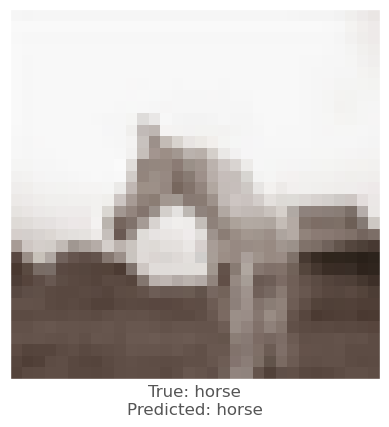



0.0020225644
-0.0010378957
-0.0016171932
vr, vg, vb :   -0.4587721824645996 0.23481547832489014 0.37129640579223633
beam_perturbed_confidence temp :  0.6636619
beam_perturbed_confidence temp :  0.66449314
beam_perturbed_confidence temp :  0.66449314
beam_perturbed_confidence temp :  0.6636619
beam_perturbed_confidence temp :  0.6636619
beam_perturbed_confidence temp :  0.66449314
beam_perturbed_confidence temp :  0.6636619
row index :  0
1th round's confidence : 1th 0.6636619
predicted class :  horse
predicted class's confidence :  0.6636619
Lopt is :  7


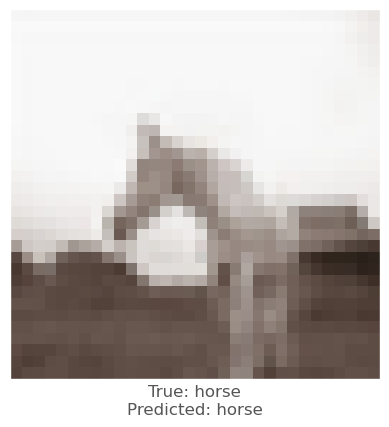



0.010189652
0.009960413
0.0047691464
vr, vg, vb :   -1.8430417776107788 -1.7567425966262817 -0.8894115686416626
beam_perturbed_confidence temp :  0.7381584
beam_perturbed_confidence temp :  0.73876035
beam_perturbed_confidence temp :  0.74655396
beam_perturbed_confidence temp :  0.728566
beam_perturbed_confidence temp :  0.7356176
beam_perturbed_confidence temp :  0.7363669
beam_perturbed_confidence temp :  0.72649485
row index :  6
1th round's confidence : 2th 0.72649485
predicted class :  horse
predicted class's confidence :  0.72649485
Lopt is :  3


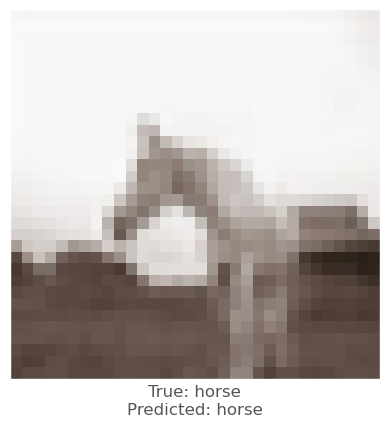



-0.0034787655
-0.0077534914
-0.0046101213
vr, vg, vb :   0.6609654426574707 1.473163366317749 0.8759230375289917
beam_perturbed_confidence temp :  0.6835513
beam_perturbed_confidence temp :  0.6794027
beam_perturbed_confidence temp :  0.6835513
beam_perturbed_confidence temp :  0.6794027
beam_perturbed_confidence temp :  0.6835513
beam_perturbed_confidence temp :  0.6794027
beam_perturbed_confidence temp :  0.6794027
row index :  1
1th round's confidence : 3th 0.6794027
predicted class :  horse
predicted class's confidence :  0.6794027
Lopt is :  10


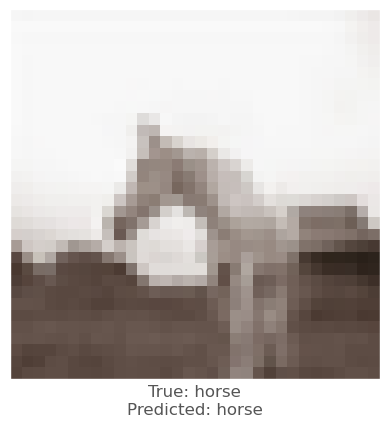



0.005145669
0.004221797
0.0019281507
vr, vg, vb :   -0.8239060640335083 -0.6548506021499634 -0.2882802486419678
beam_perturbed_confidence temp :  0.7883479
beam_perturbed_confidence temp :  0.7889499
beam_perturbed_confidence temp :  0.7901979
beam_perturbed_confidence temp :  0.78607005
beam_perturbed_confidence temp :  0.7871909
beam_perturbed_confidence temp :  0.78789586
beam_perturbed_confidence temp :  0.7850744
row index :  6
1th round's confidence : 4th 0.7850744
predicted class :  horse
predicted class's confidence :  0.7850744
Lopt is :  8


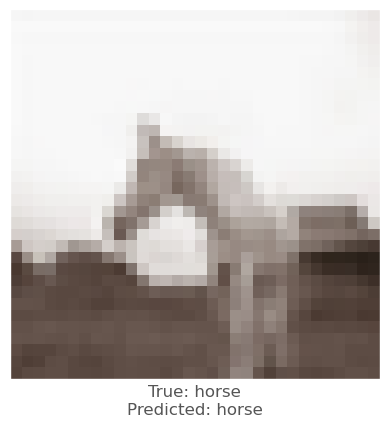



0.0030819178
0.00016564131
-5.531311e-05
vr, vg, vb :   -2.3128007650375366 -1.499197542667389 -0.5779392719268799
beam_perturbed_confidence temp :  0.66010064
beam_perturbed_confidence temp :  0.66374546
beam_perturbed_confidence temp :  0.6628253
beam_perturbed_confidence temp :  0.66185886
beam_perturbed_confidence temp :  0.6607509
beam_perturbed_confidence temp :  0.6638765
beam_perturbed_confidence temp :  0.66235113
row index :  0
2th round's confidence : 0th 0.66010064
predicted class :  horse
predicted class's confidence :  0.66010064
Lopt is :  8


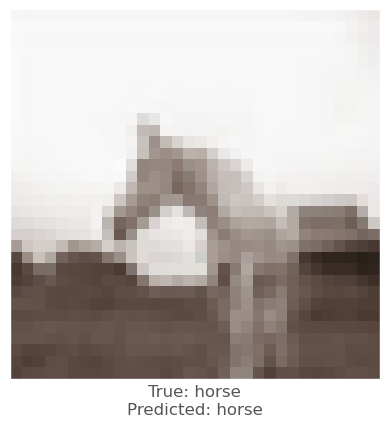



0.0015265346
-0.0005431175
-0.00084000826
vr, vg, vb :   -0.5655484199523926 0.26564568281173706 0.4181675910949707
beam_perturbed_confidence temp :  0.6629666
beam_perturbed_confidence temp :  0.6636619
beam_perturbed_confidence temp :  0.6636619
beam_perturbed_confidence temp :  0.6629666
beam_perturbed_confidence temp :  0.6629666
beam_perturbed_confidence temp :  0.6636619
beam_perturbed_confidence temp :  0.6629666
row index :  0
2th round's confidence : 1th 0.6629666
predicted class :  horse
predicted class's confidence :  0.6629666
Lopt is :  8


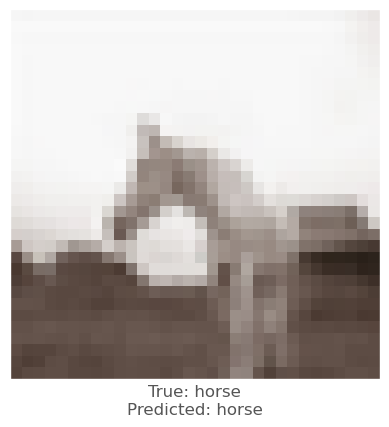



0.0100723505
0.008371592
0.0041822195
vr, vg, vb :   -2.665972650051117 -2.41822749376297 -1.2186923623085022
beam_perturbed_confidence temp :  0.7103349
beam_perturbed_confidence temp :  0.71188736
beam_perturbed_confidence temp :  0.72236747
beam_perturbed_confidence temp :  0.69258094
beam_perturbed_confidence temp :  0.70361453
beam_perturbed_confidence temp :  0.7063979
beam_perturbed_confidence temp :  0.688004
row index :  6
2th round's confidence : 2th 0.688004
predicted class :  horse
predicted class's confidence :  0.688004
Lopt is :  1


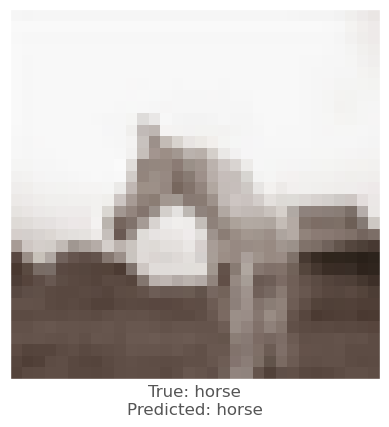



-0.002609253
-0.007071793
-0.0044927
vr, vg, vb :   0.8557941913604736 2.033026337623596 1.2376007437705994
beam_perturbed_confidence temp :  0.6794027
beam_perturbed_confidence temp :  0.67384136
beam_perturbed_confidence temp :  0.6772045
beam_perturbed_confidence temp :  0.67384136
beam_perturbed_confidence temp :  0.6772045
beam_perturbed_confidence temp :  0.67163104
beam_perturbed_confidence temp :  0.67163104
row index :  5
2th round's confidence : 3th 0.67163104
predicted class :  horse
predicted class's confidence :  0.67163104
Lopt is :  10


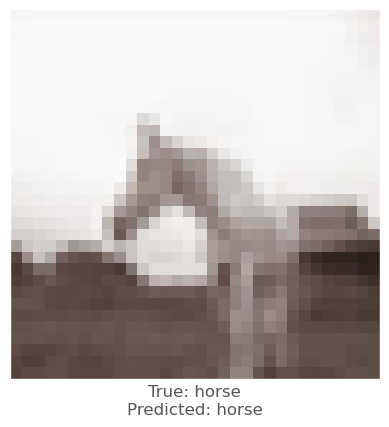



0.005850196
0.004205525
0.0021212697
vr, vg, vb :   -1.3265350461006165 -1.0099180340766907 -0.4715791940689087
beam_perturbed_confidence temp :  0.7785818
beam_perturbed_confidence temp :  0.78047246
beam_perturbed_confidence temp :  0.7839488
beam_perturbed_confidence temp :  0.7729499
beam_perturbed_confidence temp :  0.7770594
beam_perturbed_confidence temp :  0.7791807
beam_perturbed_confidence temp :  0.7720447
row index :  6
2th round's confidence : 4th 0.7720447
predicted class :  horse
predicted class's confidence :  0.7720447
Lopt is :  7


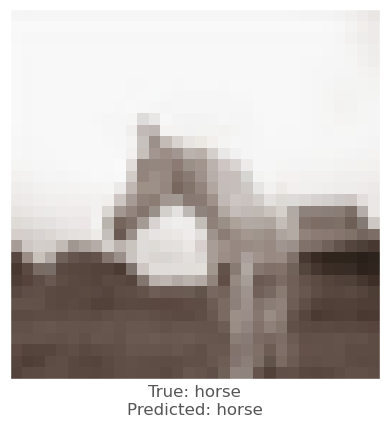



0.0008843541
-0.0022143722
-0.0012373924
vr, vg, vb :   -2.16995609998703 -1.1278405725955964 -0.396406102180481
beam_perturbed_confidence temp :  0.66013265
beam_perturbed_confidence temp :  0.66185886
beam_perturbed_confidence temp :  0.6607509
beam_perturbed_confidence temp :  0.6622886
beam_perturbed_confidence temp :  0.6610402
beam_perturbed_confidence temp :  0.66235113
beam_perturbed_confidence temp :  0.66301113
row index :  0
3th round's confidence : 0th 0.66013265
predicted class :  horse
predicted class's confidence :  0.66013265
Lopt is :  11


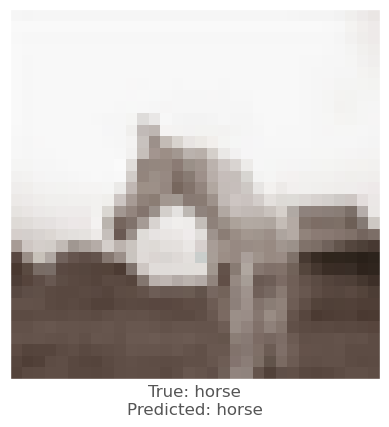



0.0009986758
-0.0002555251
-0.0003347993
vr, vg, vb :   -0.6088611602783204 0.2646336257457733 0.40983076095581056
beam_perturbed_confidence temp :  0.6626632
beam_perturbed_confidence temp :  0.6629666
beam_perturbed_confidence temp :  0.6629666
beam_perturbed_confidence temp :  0.6626632
beam_perturbed_confidence temp :  0.6626632
beam_perturbed_confidence temp :  0.6629666
beam_perturbed_confidence temp :  0.6626632
row index :  0
3th round's confidence : 1th 0.6626632
predicted class :  horse
predicted class's confidence :  0.6626632
Lopt is :  9


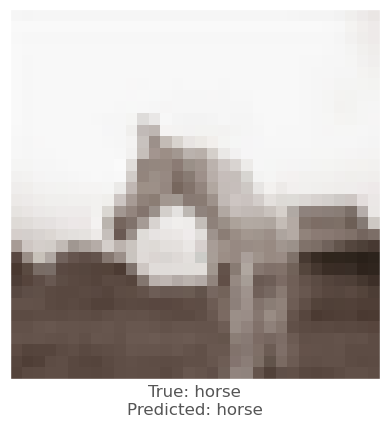



0.012176394
0.009801269
0.0042723417
vr, vg, vb :   -3.6170148313045503 -3.1565316021442413 -1.524057298898697
beam_perturbed_confidence temp :  0.66700053
beam_perturbed_confidence temp :  0.6717948
beam_perturbed_confidence temp :  0.6839709
beam_perturbed_confidence temp :  0.66239166
beam_perturbed_confidence temp :  0.6643873
beam_perturbed_confidence temp :  0.67157376
beam_perturbed_confidence temp :  0.66374546
row index :  3
3th round's confidence : 2th 0.66239166
predicted class :  horse
predicted class's confidence :  0.66239166
Lopt is :  5


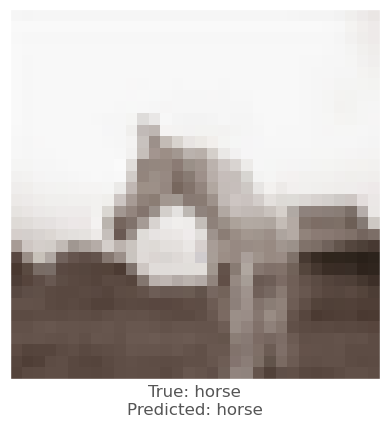



-0.0027254224
-0.005674422
-0.004331887
vr, vg, vb :   1.0427570104599 2.3971658825874327 1.5470293462276459
beam_perturbed_confidence temp :  0.6706752
beam_perturbed_confidence temp :  0.66703045
beam_perturbed_confidence temp :  0.6695095
beam_perturbed_confidence temp :  0.6667281
beam_perturbed_confidence temp :  0.6687637
beam_perturbed_confidence temp :  0.66567904
beam_perturbed_confidence temp :  0.66515154
row index :  6
3th round's confidence : 3th 0.66515154
predicted class :  horse
predicted class's confidence :  0.66515154
Lopt is :  9


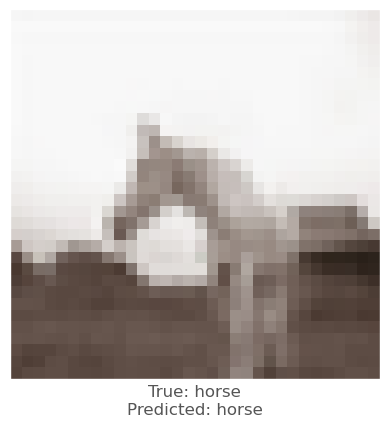



0.0073354244
0.005320668
0.0019372106
vr, vg, vb :   -1.9274239838123322 -1.4409930527210237 -0.6181423306465149
beam_perturbed_confidence temp :  0.76407623
beam_perturbed_confidence temp :  0.76532304
beam_perturbed_confidence temp :  0.77101266
beam_perturbed_confidence temp :  0.7560299
beam_perturbed_confidence temp :  0.7623489
beam_perturbed_confidence temp :  0.7633593
beam_perturbed_confidence temp :  0.75366306
row index :  6
3th round's confidence : 4th 0.75366306
predicted class :  horse
predicted class's confidence :  0.75366306
Lopt is :  6


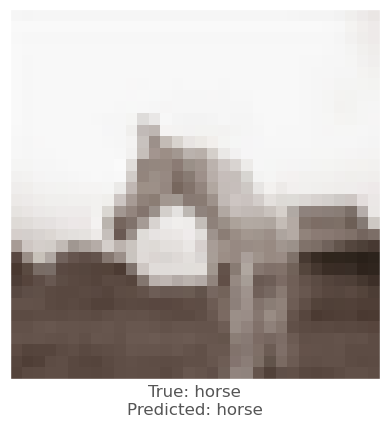



-0.0011096597
-0.0031002164
-0.0020067692
vr, vg, vb :   -1.8419945228099825 -0.7050348764657977 -0.15608857393264775
beam_perturbed_confidence temp :  0.66148573
beam_perturbed_confidence temp :  0.66156226
beam_perturbed_confidence temp :  0.6610402
beam_perturbed_confidence temp :  0.6623556
beam_perturbed_confidence temp :  0.6621214
beam_perturbed_confidence temp :  0.6621625
beam_perturbed_confidence temp :  0.66318405
row index :  2
4th round's confidence : 0th 0.6610402
predicted class :  horse
predicted class's confidence :  0.6610402
Lopt is :  11


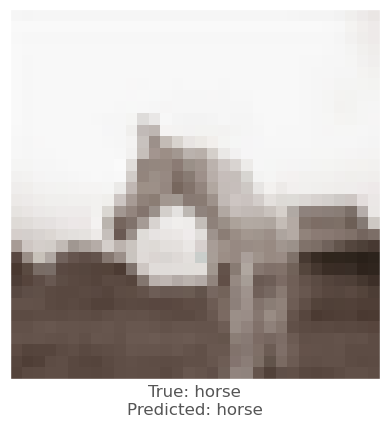



-0.00062578917
-0.0011235476
-0.00086796284
vr, vg, vb :   -0.48539612770080576 0.3505250185728073 0.45564396858215334
beam_perturbed_confidence temp :  0.6635924
beam_perturbed_confidence temp :  0.6626632
beam_perturbed_confidence temp :  0.6626632
beam_perturbed_confidence temp :  0.6635924
beam_perturbed_confidence temp :  0.6635924
beam_perturbed_confidence temp :  0.6626632
beam_perturbed_confidence temp :  0.6635924
row index :  1
4th round's confidence : 1th 0.6626632
predicted class :  horse
predicted class's confidence :  0.6626632
Lopt is :  9


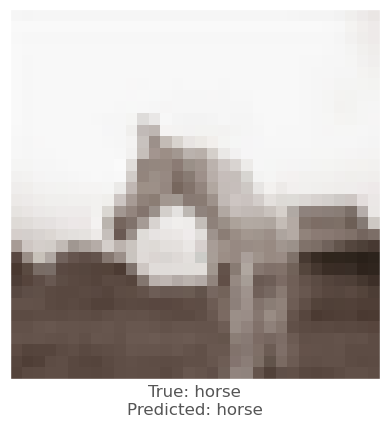



0.0016377568
-0.0012220144
-0.0019605756
vr, vg, vb :   -3.4190890306234363 -2.7186769992113113 -1.175594010949135
beam_perturbed_confidence temp :  0.66069394
beam_perturbed_confidence temp :  0.6627844
beam_perturbed_confidence temp :  0.66374546
beam_perturbed_confidence temp :  0.66180176
beam_perturbed_confidence temp :  0.6620052
beam_perturbed_confidence temp :  0.66376334
beam_perturbed_confidence temp :  0.6629633
row index :  0
4th round's confidence : 2th 0.66069394
predicted class :  horse
predicted class's confidence :  0.66069394
Lopt is :  9


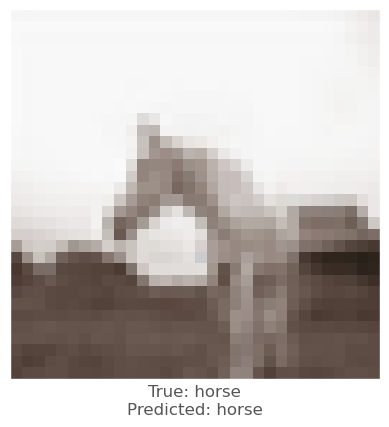



-0.00061911345
-0.003319919
-0.0028628707
vr, vg, vb :   1.0003926539421082 2.489441205263138 1.67861348092556
beam_perturbed_confidence temp :  0.6650599
beam_perturbed_confidence temp :  0.66284925
beam_perturbed_confidence temp :  0.6638652
beam_perturbed_confidence temp :  0.66368705
beam_perturbed_confidence temp :  0.6637995
beam_perturbed_confidence temp :  0.66237
beam_perturbed_confidence temp :  0.6631001
row index :  5
4th round's confidence : 3th 0.66237
predicted class :  horse
predicted class's confidence :  0.66237
Lopt is :  9


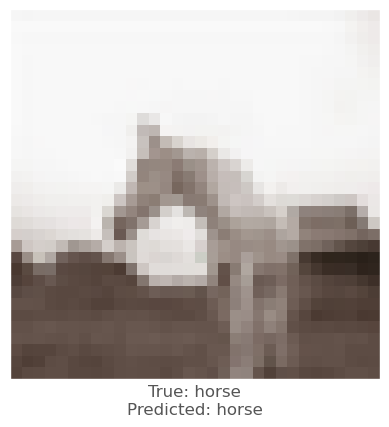



0.01007849
0.00963366
0.0047068
vr, vg, vb :   -2.742530563473702 -2.26025977909565 -1.0270080959796906
beam_perturbed_confidence temp :  0.73853755
beam_perturbed_confidence temp :  0.7385748
beam_perturbed_confidence temp :  0.7489437
beam_perturbed_confidence temp :  0.7233479
beam_perturbed_confidence temp :  0.73257077
beam_perturbed_confidence temp :  0.734057
beam_perturbed_confidence temp :  0.7190498
row index :  6
4th round's confidence : 4th 0.7190498
predicted class :  horse
predicted class's confidence :  0.7190498
Lopt is :  4


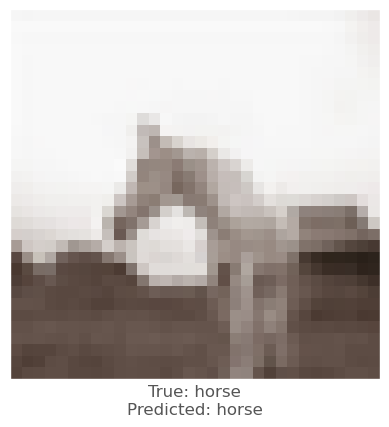



-0.0010957122
-0.002649963
-0.0015673637
vr, vg, vb :   -1.5482238520383838 -0.3695350986123087 0.0162566573619842
beam_perturbed_confidence temp :  0.6621214
beam_perturbed_confidence temp :  0.6621625
beam_perturbed_confidence temp :  0.6610402
beam_perturbed_confidence temp :  0.66318405
beam_perturbed_confidence temp :  0.6621214
beam_perturbed_confidence temp :  0.6621625
beam_perturbed_confidence temp :  0.66318405
row index :  2
5th round's confidence : 0th 0.6610402
predicted class :  horse
predicted class's confidence :  0.6610402
Lopt is :  11


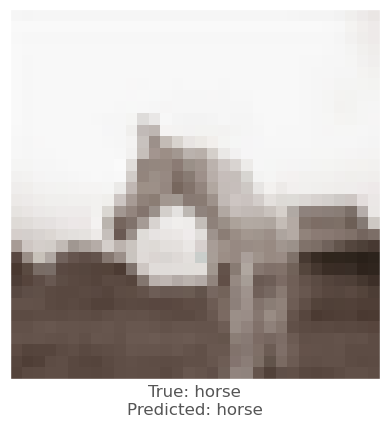



-0.00062578917
-0.0011235476
-0.00086796284
vr, vg, vb :   -0.3742775983810426 0.42782727211713795 0.4968758554458618
beam_perturbed_confidence temp :  0.6635924
beam_perturbed_confidence temp :  0.6626632
beam_perturbed_confidence temp :  0.6626632
beam_perturbed_confidence temp :  0.6635924
beam_perturbed_confidence temp :  0.6635924
beam_perturbed_confidence temp :  0.6626632
beam_perturbed_confidence temp :  0.6635924
row index :  1
5th round's confidence : 1th 0.6626632
predicted class :  horse
predicted class's confidence :  0.6626632
Lopt is :  9


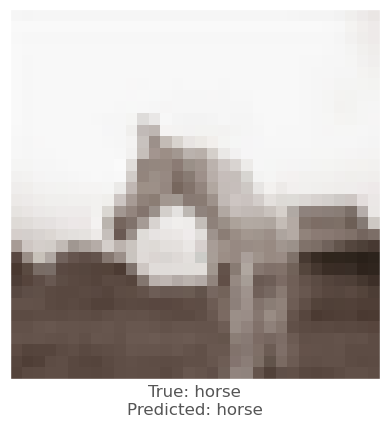



-8.267164e-05
-0.0022156835
-0.0014786124
vr, vg, vb :   -3.068912963330746 -2.2252409532666206 -0.91017336755991
beam_perturbed_confidence temp :  0.66188914
beam_perturbed_confidence temp :  0.66180176
beam_perturbed_confidence temp :  0.6613214
beam_perturbed_confidence temp :  0.6648828
beam_perturbed_confidence temp :  0.6626894
beam_perturbed_confidence temp :  0.6623141
beam_perturbed_confidence temp :  0.6657867
row index :  2
5th round's confidence : 2th 0.6613214
predicted class :  horse
predicted class's confidence :  0.6613214
Lopt is :  9


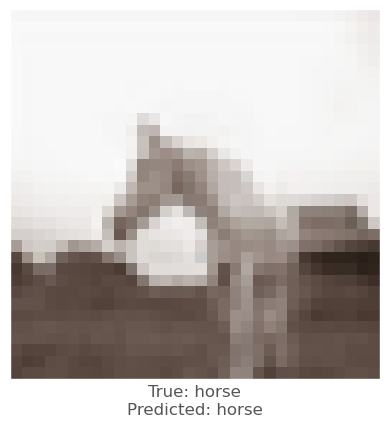



0.00068312883
-5.7518482e-05
-0.000408113
vr, vg, vb :   0.8320405051708222 2.2462489329576494 1.551563433110714
beam_perturbed_confidence temp :  0.66237
beam_perturbed_confidence temp :  0.6621719
beam_perturbed_confidence temp :  0.66244113
beam_perturbed_confidence temp :  0.6621719
beam_perturbed_confidence temp :  0.66244113
beam_perturbed_confidence temp :  0.66130877
beam_perturbed_confidence temp :  0.66130877
row index :  5
5th round's confidence : 3th 0.66130877
predicted class :  horse
predicted class's confidence :  0.66130877
Lopt is :  9


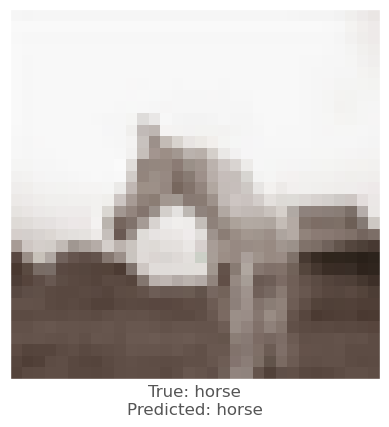



0.010924876
0.00918138
0.004482448
vr, vg, vb :   -3.560765080749989 -2.952371828377247 -1.3725520964860918
beam_perturbed_confidence temp :  0.6964108
beam_perturbed_confidence temp :  0.7022383
beam_perturbed_confidence temp :  0.71368533
beam_perturbed_confidence temp :  0.67897296
beam_perturbed_confidence temp :  0.6898754
beam_perturbed_confidence temp :  0.69739795
beam_perturbed_confidence temp :  0.6740456
row index :  6
5th round's confidence : 4th 0.6740456
predicted class :  horse
predicted class's confidence :  0.6740456
Lopt is :  3


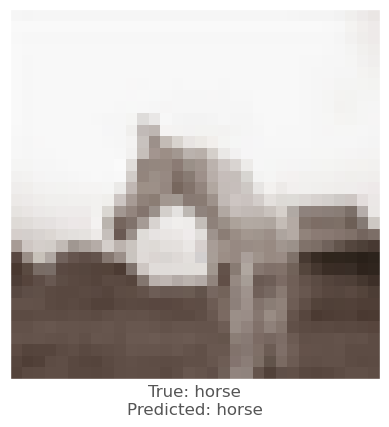



-0.0010957122
-0.002649963
-0.0015673637
vr, vg, vb :   -1.2838302483439448 -0.06758529854416867 0.17136736552715298
beam_perturbed_confidence temp :  0.6621214
beam_perturbed_confidence temp :  0.6621625
beam_perturbed_confidence temp :  0.6610402
beam_perturbed_confidence temp :  0.66318405
beam_perturbed_confidence temp :  0.6621214
beam_perturbed_confidence temp :  0.6621625
beam_perturbed_confidence temp :  0.66318405
row index :  2
6th round's confidence : 0th 0.6610402
predicted class :  horse
predicted class's confidence :  0.6610402
Lopt is :  11


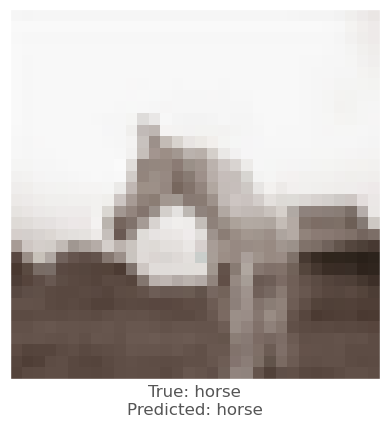



-0.00062578917
-0.0011235476
-0.00086796284
vr, vg, vb :   -0.2742709219932557 0.4973993003070355 0.5339845536231995
beam_perturbed_confidence temp :  0.6635924
beam_perturbed_confidence temp :  0.6626632
beam_perturbed_confidence temp :  0.6626632
beam_perturbed_confidence temp :  0.6635924
beam_perturbed_confidence temp :  0.6635924
beam_perturbed_confidence temp :  0.6626632
beam_perturbed_confidence temp :  0.6635924
row index :  1
6th round's confidence : 1th 0.6626632
predicted class :  horse
predicted class's confidence :  0.6626632
Lopt is :  9


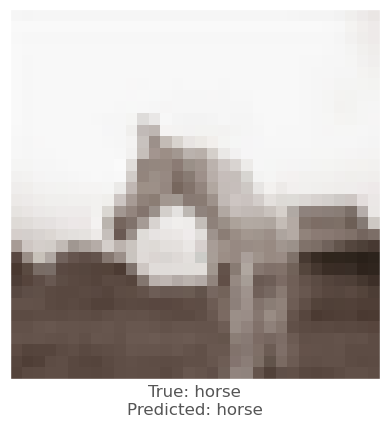



-0.00024294853
-0.0017309189
-0.0013112426
vr, vg, vb :   -2.7377268137872224 -1.8296249695122242 -0.6880317727625371
beam_perturbed_confidence temp :  0.66208273
beam_perturbed_confidence temp :  0.66203696
beam_perturbed_confidence temp :  0.6620052
beam_perturbed_confidence temp :  0.6644326
beam_perturbed_confidence temp :  0.662893
beam_perturbed_confidence temp :  0.6623252
beam_perturbed_confidence temp :  0.66525334
row index :  2
6th round's confidence : 2th 0.6620052
predicted class :  horse
predicted class's confidence :  0.6620052
Lopt is :  9


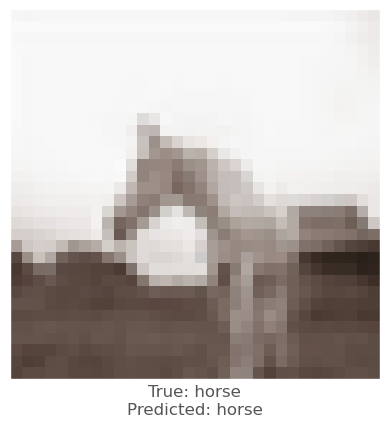



0.0006864071
-0.0027436614
-0.0018466115
vr, vg, vb :   0.6801957457304001 2.295990180027485 1.5810682397782803
beam_perturbed_confidence temp :  0.66130877
beam_perturbed_confidence temp :  0.65843964
beam_perturbed_confidence temp :  0.6603253
beam_perturbed_confidence temp :  0.65843964
beam_perturbed_confidence temp :  0.6603253
beam_perturbed_confidence temp :  0.65770924
beam_perturbed_confidence temp :  0.65770924
row index :  5
6th round's confidence : 3th 0.65770924
predicted class :  horse
predicted class's confidence :  0.65770924
Lopt is :  9


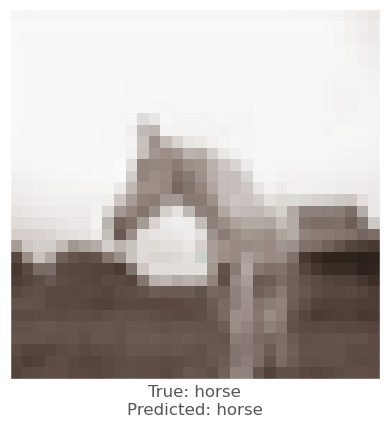



0.00990057
0.008622706
0.0041959286
vr, vg, vb :   -4.1947455642521385 -3.519405239182711 -1.6548897441983226
beam_perturbed_confidence temp :  0.6581157
beam_perturbed_confidence temp :  0.6641785
beam_perturbed_confidence temp :  0.67088103
beam_perturbed_confidence temp :  0.6609399
beam_perturbed_confidence temp :  0.6580131
beam_perturbed_confidence temp :  0.6655358
beam_perturbed_confidence temp :  0.66180724
row index :  4
6th round's confidence : 4th 0.6580131
predicted class :  horse
predicted class's confidence :  0.6580131
Lopt is :  8


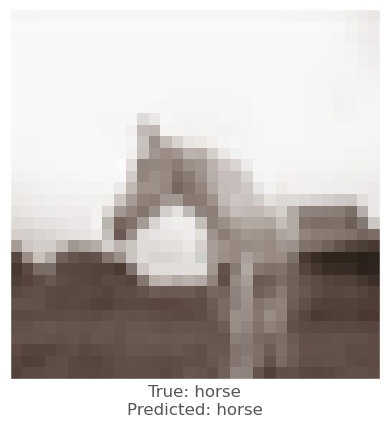



-0.0010957122
-0.002649963
-0.0015673637
vr, vg, vb :   -1.0458760050189497 0.20416952151715737 0.31096700287580487
beam_perturbed_confidence temp :  0.6621214
beam_perturbed_confidence temp :  0.6610402
beam_perturbed_confidence temp :  0.6610402
beam_perturbed_confidence temp :  0.6621214
beam_perturbed_confidence temp :  0.6621214
beam_perturbed_confidence temp :  0.6610402
beam_perturbed_confidence temp :  0.6621214
row index :  1
7th round's confidence : 0th 0.6610402
predicted class :  horse
predicted class's confidence :  0.6610402
Lopt is :  11


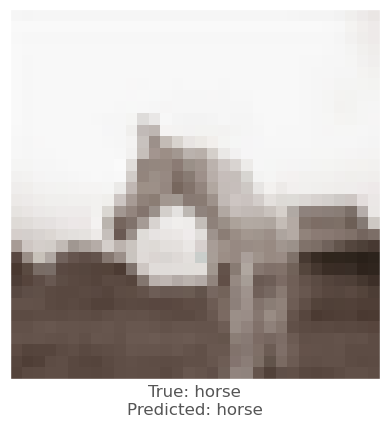



-0.00062578917
-0.0011235476
-0.00086796284
vr, vg, vb :   -0.1842649132442475 0.5600141256779433 0.5673823819828034
beam_perturbed_confidence temp :  0.6635924
beam_perturbed_confidence temp :  0.6626632
beam_perturbed_confidence temp :  0.6626632
beam_perturbed_confidence temp :  0.6635924
beam_perturbed_confidence temp :  0.6635924
beam_perturbed_confidence temp :  0.6626632
beam_perturbed_confidence temp :  0.6635924
row index :  1
7th round's confidence : 1th 0.6626632
predicted class :  horse
predicted class's confidence :  0.6626632
Lopt is :  9


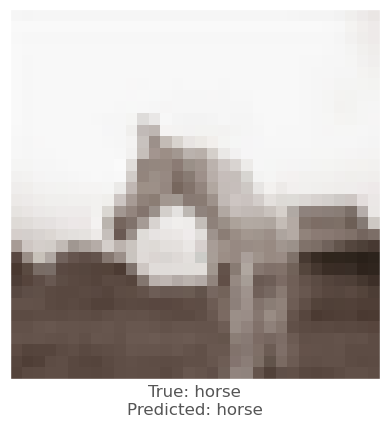



-0.00051122904
-0.0012583733
-0.0009612441
vr, vg, vb :   -2.412831228584648 -1.520825146511197 -0.5231041848570109
beam_perturbed_confidence temp :  0.662893
beam_perturbed_confidence temp :  0.6623252
beam_perturbed_confidence temp :  0.66228265
beam_perturbed_confidence temp :  0.66525334
beam_perturbed_confidence temp :  0.66380703
beam_perturbed_confidence temp :  0.6628307
beam_perturbed_confidence temp :  0.6656746
row index :  2
7th round's confidence : 2th 0.66228265
predicted class :  horse
predicted class's confidence :  0.66228265
Lopt is :  9


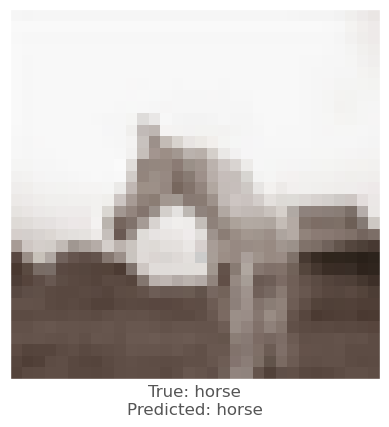



0.00042933226
-0.0012114644
-0.00082814693
vr, vg, vb :   0.5692429455256462 2.187537602530718 1.50577610925138
beam_perturbed_confidence temp :  0.65770924
beam_perturbed_confidence temp :  0.6592484
beam_perturbed_confidence temp :  0.6576115
beam_perturbed_confidence temp :  0.6592484
beam_perturbed_confidence temp :  0.6576115
beam_perturbed_confidence temp :  0.6600704
beam_perturbed_confidence temp :  0.6600704
row index :  2
7th round's confidence : 3th 0.6576115
predicted class :  horse
predicted class's confidence :  0.6576115
Lopt is :  9


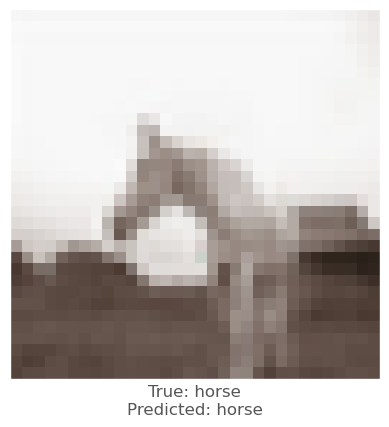



0.0017629862
-0.0009007454
-0.001318574
vr, vg, vb :   -3.9515696261435753 -3.0773901760798696 -1.3575433746063712
beam_perturbed_confidence temp :  0.65826505
beam_perturbed_confidence temp :  0.66180724
beam_perturbed_confidence temp :  0.6596308
beam_perturbed_confidence temp :  0.6631352
beam_perturbed_confidence temp :  0.66033065
beam_perturbed_confidence temp :  0.6624372
beam_perturbed_confidence temp :  0.66503483
row index :  0
7th round's confidence : 4th 0.65826505
predicted class :  horse
predicted class's confidence :  0.65826505
Lopt is :  12


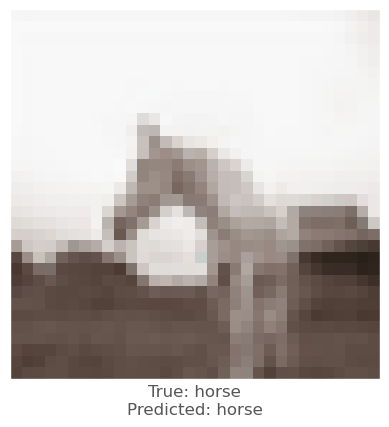



-0.0010957122
-0.002649963
-0.0015673637
vr, vg, vb :   -0.8317171860264542 0.4487488595723508 0.43660667648959156
beam_perturbed_confidence temp :  0.66165817
beam_perturbed_confidence temp :  0.6610402
beam_perturbed_confidence temp :  0.6610402
beam_perturbed_confidence temp :  0.66165817
beam_perturbed_confidence temp :  0.66165817
beam_perturbed_confidence temp :  0.6610402
beam_perturbed_confidence temp :  0.66165817
row index :  1
8th round's confidence : 0th 0.6610402
predicted class :  horse
predicted class's confidence :  0.6610402
Lopt is :  11


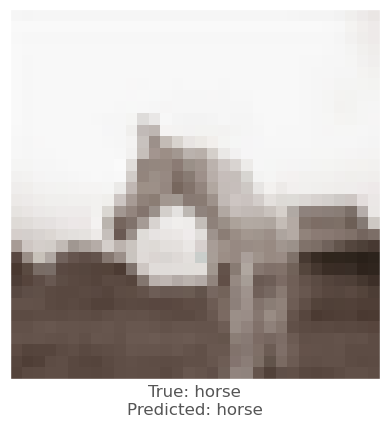



-0.00062578917
-0.0011235476
-0.00086796284
vr, vg, vb :   -0.10325950537014014 0.6163674685117603 0.597440427506447
beam_perturbed_confidence temp :  0.6635924
beam_perturbed_confidence temp :  0.6626632
beam_perturbed_confidence temp :  0.6626632
beam_perturbed_confidence temp :  0.6635924
beam_perturbed_confidence temp :  0.6635924
beam_perturbed_confidence temp :  0.6626632
beam_perturbed_confidence temp :  0.6635924
row index :  1
8th round's confidence : 1th 0.6626632
predicted class :  horse
predicted class's confidence :  0.6626632
Lopt is :  9


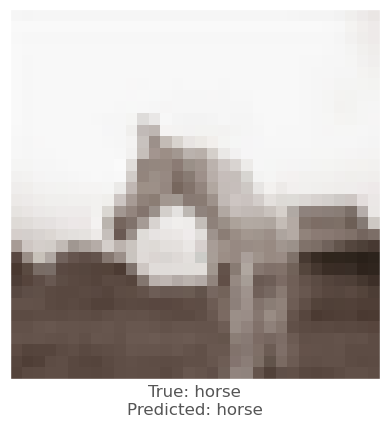



-0.00027751923
-0.0002901554
-0.0004361272
vr, vg, vb :   -2.143796183118761 -1.3397270907834171 -0.42718104778915655
beam_perturbed_confidence temp :  0.66380703
beam_perturbed_confidence temp :  0.6628307
beam_perturbed_confidence temp :  0.6624413
beam_perturbed_confidence temp :  0.6656746
beam_perturbed_confidence temp :  0.6644959
beam_perturbed_confidence temp :  0.6634851
beam_perturbed_confidence temp :  0.6659997
row index :  2
8th round's confidence : 2th 0.6624413
predicted class :  horse
predicted class's confidence :  0.6624413
Lopt is :  9


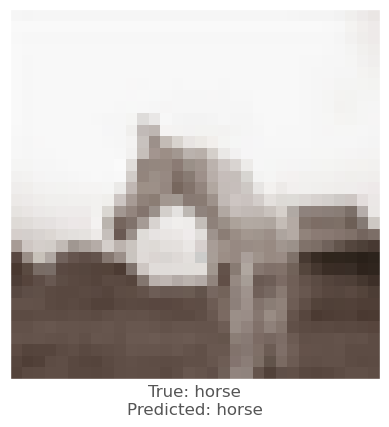



0.0011576414
-3.5464764e-05
0.00014400482
vr, vg, vb :   0.39655450989031793 1.972330318641782 1.3407980161485076
beam_perturbed_confidence temp :  0.6576115
beam_perturbed_confidence temp :  0.6583866
beam_perturbed_confidence temp :  0.65785325
beam_perturbed_confidence temp :  0.6583866
beam_perturbed_confidence temp :  0.65785325
beam_perturbed_confidence temp :  0.65930575
beam_perturbed_confidence temp :  0.65930575
row index :  0
8th round's confidence : 3th 0.6576115
predicted class :  horse
predicted class's confidence :  0.6576115
Lopt is :  9


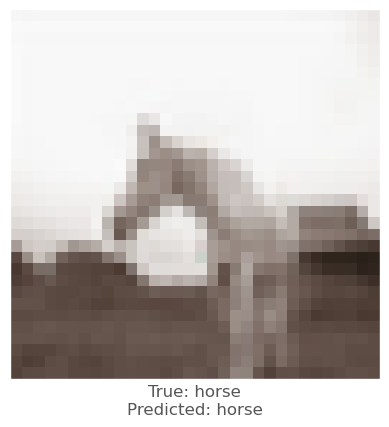



-0.0018070936
-0.0029966235
-0.0019494891
vr, vg, vb :   -3.3757033014991884 -2.4699888068636064 -1.026840125478864
beam_perturbed_confidence temp :  0.6608938
beam_perturbed_confidence temp :  0.66208273
beam_perturbed_confidence temp :  0.66033065
beam_perturbed_confidence temp :  0.6649741
beam_perturbed_confidence temp :  0.6622975
beam_perturbed_confidence temp :  0.66380703
beam_perturbed_confidence temp :  0.6675913
row index :  2
8th round's confidence : 4th 0.66033065
predicted class :  horse
predicted class's confidence :  0.66033065
Lopt is :  12


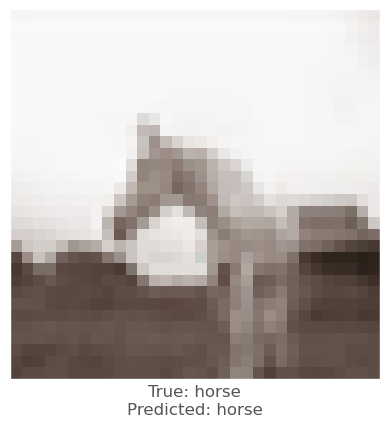



-0.0010957122
-0.002649963
-0.0015673637
vr, vg, vb :   -0.6389742489332082 0.668870263822025 0.5496823827419997
beam_perturbed_confidence temp :  0.66165817
beam_perturbed_confidence temp :  0.6610402
beam_perturbed_confidence temp :  0.6610402
beam_perturbed_confidence temp :  0.66165817
beam_perturbed_confidence temp :  0.66165817
beam_perturbed_confidence temp :  0.6610402
beam_perturbed_confidence temp :  0.66165817
row index :  1
9th round's confidence : 0th 0.6610402
predicted class :  horse
predicted class's confidence :  0.6610402
Lopt is :  11


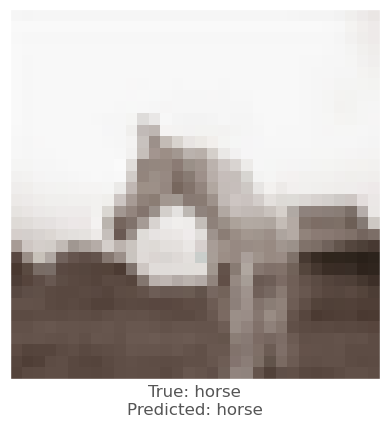



-0.00062578917
-0.0011235476
-0.00086796284
vr, vg, vb :   -0.030354638283443508 0.6670854770621956 0.6244926684777261
beam_perturbed_confidence temp :  0.6635924
beam_perturbed_confidence temp :  0.6626632
beam_perturbed_confidence temp :  0.6626632
beam_perturbed_confidence temp :  0.6635924
beam_perturbed_confidence temp :  0.6635924
beam_perturbed_confidence temp :  0.6626632
beam_perturbed_confidence temp :  0.6635924
row index :  1
9th round's confidence : 1th 0.6626632
predicted class :  horse
predicted class's confidence :  0.6626632
Lopt is :  9


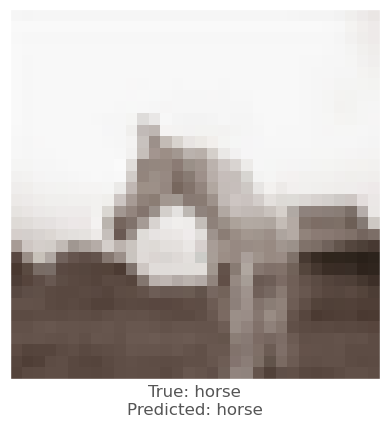



-4.941225e-05
-0.0001835823
-0.00012791157
vr, vg, vb :   -1.9244753397550052 -1.1873961511142552 -0.3716717862414421
beam_perturbed_confidence temp :  0.6636265
beam_perturbed_confidence temp :  0.6634851
beam_perturbed_confidence temp :  0.66241056
beam_perturbed_confidence temp :  0.66503567
beam_perturbed_confidence temp :  0.664082
beam_perturbed_confidence temp :  0.66397136
beam_perturbed_confidence temp :  0.6654767
row index :  2
9th round's confidence : 2th 0.66241056
predicted class :  horse
predicted class's confidence :  0.66241056
Lopt is :  9


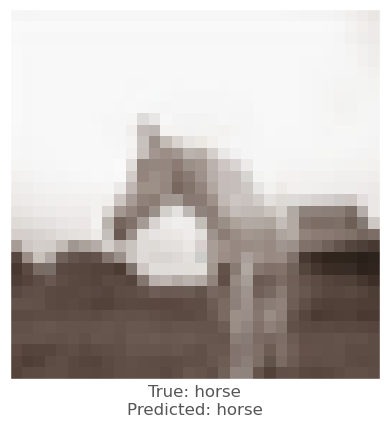



0.0011576414
-3.5464764e-05
0.00014400482
vr, vg, vb :   0.24113491781852248 1.7786437631417396 1.1923177323559224
beam_perturbed_confidence temp :  0.6576115
beam_perturbed_confidence temp :  0.6583866
beam_perturbed_confidence temp :  0.65785325
beam_perturbed_confidence temp :  0.6583866
beam_perturbed_confidence temp :  0.65785325
beam_perturbed_confidence temp :  0.65930575
beam_perturbed_confidence temp :  0.65930575
row index :  0
9th round's confidence : 3th 0.6576115
predicted class :  horse
predicted class's confidence :  0.6576115
Lopt is :  9


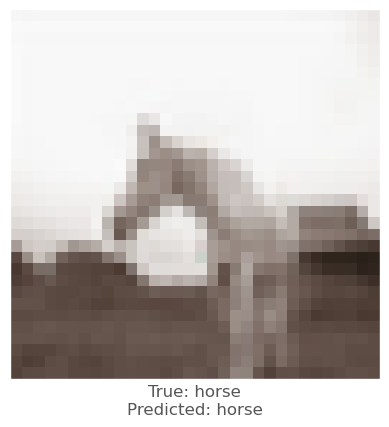



-0.0014241338
-0.0027698278
-0.0017994046
vr, vg, vb :   -2.8957195935874287 -1.9460071419060054 -0.7442156508185508
beam_perturbed_confidence temp :  0.66181326
beam_perturbed_confidence temp :  0.66246927
beam_perturbed_confidence temp :  0.6611182
beam_perturbed_confidence temp :  0.6648531
beam_perturbed_confidence temp :  0.66266745
beam_perturbed_confidence temp :  0.6631967
beam_perturbed_confidence temp :  0.6660548
row index :  2
9th round's confidence : 4th 0.6611182
predicted class :  horse
predicted class's confidence :  0.6611182
Lopt is :  12


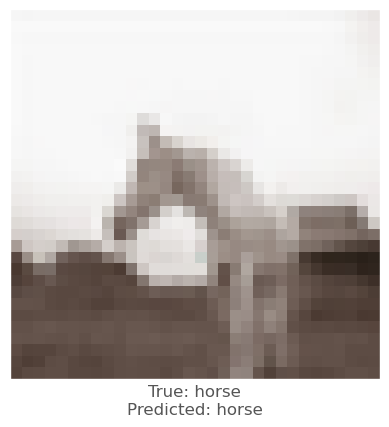



-0.0010957122
-0.002649963
-0.0015673637
vr, vg, vb :   -0.46550560554928677 0.8669795276467317 0.6514505183691669
beam_perturbed_confidence temp :  0.66165817
beam_perturbed_confidence temp :  0.6610402
beam_perturbed_confidence temp :  0.6610402
beam_perturbed_confidence temp :  0.66165817
beam_perturbed_confidence temp :  0.66165817
beam_perturbed_confidence temp :  0.6610402
beam_perturbed_confidence temp :  0.66165817
row index :  1
10th round's confidence : 0th 0.6610402
predicted class :  horse
predicted class's confidence :  0.6610402
Lopt is :  11


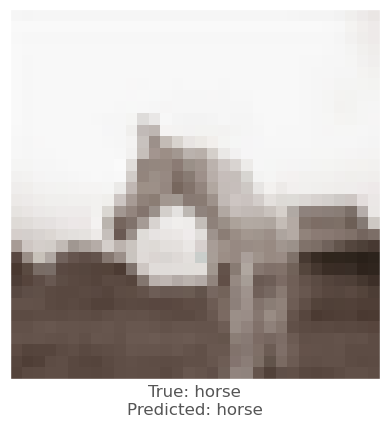



-0.00062578917
-0.0011235476
-0.00086796284
vr, vg, vb :   0.03525974209458346 0.7127316847575873 0.6488396853518773
beam_perturbed_confidence temp :  0.6626632
beam_perturbed_confidence temp :  0.6626632
beam_perturbed_confidence temp :  0.6626632
beam_perturbed_confidence temp :  0.6626632
beam_perturbed_confidence temp :  0.6626632
beam_perturbed_confidence temp :  0.6626632
beam_perturbed_confidence temp :  0.6626632
row index :  0
10th round's confidence : 1th 0.6626632
predicted class :  horse
predicted class's confidence :  0.6626632
Lopt is :  9


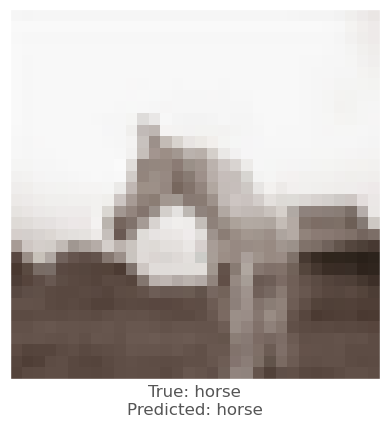



-0.00025230646
-0.0005836487
-0.00022190809
vr, vg, vb :   -1.7067971596460818 -1.0102916678387672 -0.31231379836741996
beam_perturbed_confidence temp :  0.664082
beam_perturbed_confidence temp :  0.66397136
beam_perturbed_confidence temp :  0.6626632
beam_perturbed_confidence temp :  0.6654767
beam_perturbed_confidence temp :  0.6645884
beam_perturbed_confidence temp :  0.6647988
beam_perturbed_confidence temp :  0.66633356
row index :  2
10th round's confidence : 2th 0.6626632
predicted class :  horse
predicted class's confidence :  0.6626632
Lopt is :  9


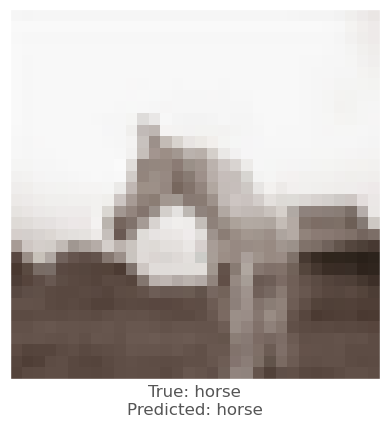



0.0011576414
-3.5464764e-05
0.00014400482
vr, vg, vb :   0.10125728495390657 1.6043258631917015 1.0586854769425957
beam_perturbed_confidence temp :  0.6576115
beam_perturbed_confidence temp :  0.6583866
beam_perturbed_confidence temp :  0.65785325
beam_perturbed_confidence temp :  0.6583866
beam_perturbed_confidence temp :  0.65785325
beam_perturbed_confidence temp :  0.65930575
beam_perturbed_confidence temp :  0.65930575
row index :  0
10th round's confidence : 3th 0.6576115
predicted class :  horse
predicted class's confidence :  0.6576115
Lopt is :  9


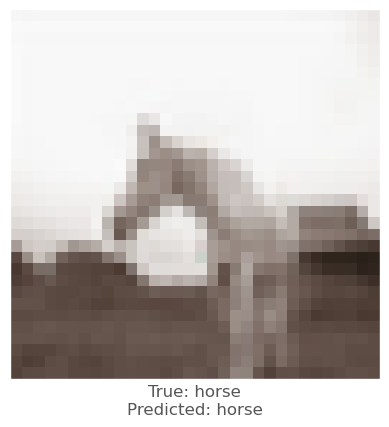



-0.0012170076
-0.0023431778
-0.0015349984
vr, vg, vb :   -2.4844468705262934 -1.5170886481743893 -0.5162942440466323
beam_perturbed_confidence temp :  0.66266745
beam_perturbed_confidence temp :  0.6631967
beam_perturbed_confidence temp :  0.66186565
beam_perturbed_confidence temp :  0.6660548
beam_perturbed_confidence temp :  0.6635613
beam_perturbed_confidence temp :  0.6638734
beam_perturbed_confidence temp :  0.666877
row index :  2
10th round's confidence : 4th 0.66186565
predicted class :  horse
predicted class's confidence :  0.66186565
Lopt is :  12


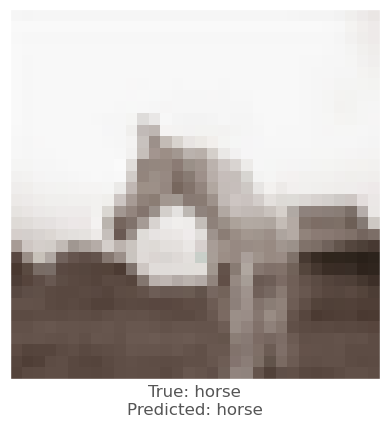



-0.0010957122
-0.002649963
-0.0015673637
vr, vg, vb :   -0.3093838265037575 1.0452778650889676 0.7430418404336174
beam_perturbed_confidence temp :  0.66165817
beam_perturbed_confidence temp :  0.6595125
beam_perturbed_confidence temp :  0.6610402
beam_perturbed_confidence temp :  0.66033065
beam_perturbed_confidence temp :  0.66165817
beam_perturbed_confidence temp :  0.6595125
beam_perturbed_confidence temp :  0.66033065
row index :  1
11th round's confidence : 0th 0.6595125
predicted class :  horse
predicted class's confidence :  0.6595125
Lopt is :  11


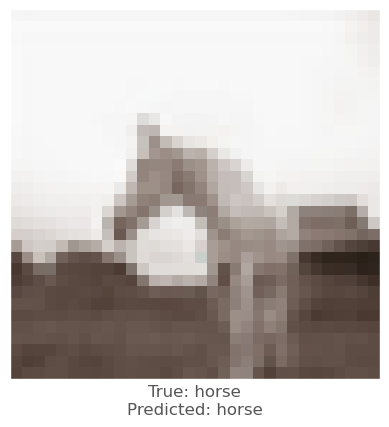



-0.00062578917
-0.0011235476
-0.00086796284
vr, vg, vb :   0.09431268443480773 0.7538132716834399 0.6707520005386134
beam_perturbed_confidence temp :  0.6626632
beam_perturbed_confidence temp :  0.6626632
beam_perturbed_confidence temp :  0.6626632
beam_perturbed_confidence temp :  0.6626632
beam_perturbed_confidence temp :  0.6626632
beam_perturbed_confidence temp :  0.6626632
beam_perturbed_confidence temp :  0.6626632
row index :  0
11th round's confidence : 1th 0.6626632
predicted class :  horse
predicted class's confidence :  0.6626632
Lopt is :  9


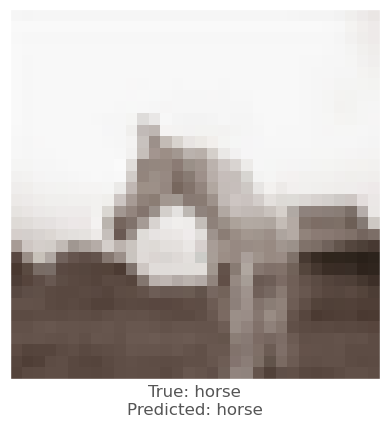



-0.00062578917
-0.0011235476
-0.00086796284
vr, vg, vb :   -1.4735385271317911 -0.7969077456532792 -0.19428613480875412
beam_perturbed_confidence temp :  0.6645884
beam_perturbed_confidence temp :  0.663635
beam_perturbed_confidence temp :  0.6632785
beam_perturbed_confidence temp :  0.6653633
beam_perturbed_confidence temp :  0.66522753
beam_perturbed_confidence temp :  0.66446006
beam_perturbed_confidence temp :  0.66620135
row index :  2
11th round's confidence : 2th 0.6632785
predicted class :  horse
predicted class's confidence :  0.6632785
Lopt is :  9


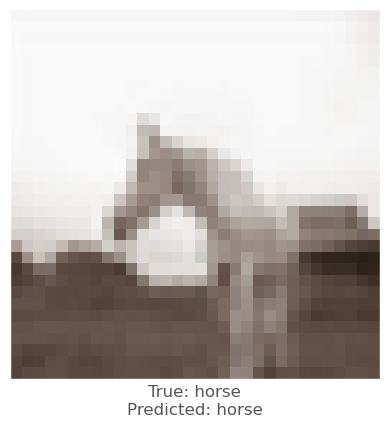



0.0011576414
-3.5464764e-05
0.00014400482
vr, vg, vb :   -0.024632584624247764 1.4474397532366672 0.9384164470706018
beam_perturbed_confidence temp :  0.6574159
beam_perturbed_confidence temp :  0.6583866
beam_perturbed_confidence temp :  0.6576115
beam_perturbed_confidence temp :  0.65735567
beam_perturbed_confidence temp :  0.6574159
beam_perturbed_confidence temp :  0.6583866
beam_perturbed_confidence temp :  0.65735567
row index :  3
11th round's confidence : 3th 0.65735567
predicted class :  horse
predicted class's confidence :  0.65735567
Lopt is :  10


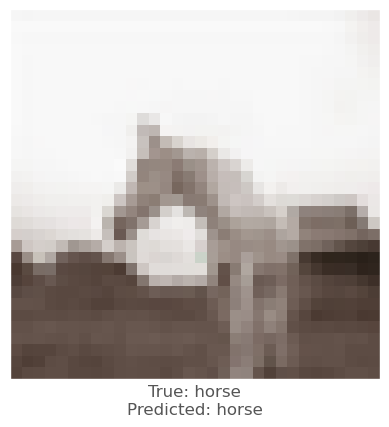



-0.0008842349
-0.0017908216
-0.0013632774
vr, vg, vb :   -2.1475786929493723 -1.1862976281292892 -0.3283370761116956
beam_perturbed_confidence temp :  0.6635613
beam_perturbed_confidence temp :  0.6638734
beam_perturbed_confidence temp :  0.6624815
beam_perturbed_confidence temp :  0.666877
beam_perturbed_confidence temp :  0.664564
beam_perturbed_confidence temp :  0.6644581
beam_perturbed_confidence temp :  0.66766536
row index :  2
11th round's confidence : 4th 0.6624815
predicted class :  horse
predicted class's confidence :  0.6624815
Lopt is :  12


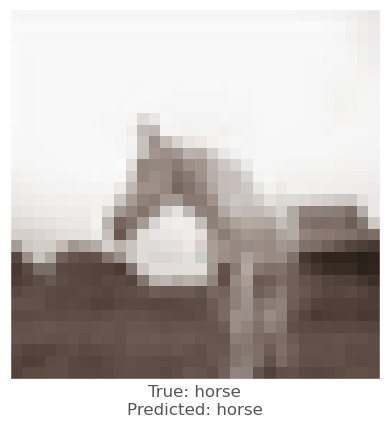



-0.0011569262
-0.0029675364
-0.0021170378
vr, vg, vb :   -0.16275282834434857 1.2375037235233082 0.8804414337034882
beam_perturbed_confidence temp :  0.66033065
beam_perturbed_confidence temp :  0.65807265
beam_perturbed_confidence temp :  0.6595125
beam_perturbed_confidence temp :  0.65888834
beam_perturbed_confidence temp :  0.66033065
beam_perturbed_confidence temp :  0.65807265
beam_perturbed_confidence temp :  0.65888834
row index :  1
12th round's confidence : 0th 0.65807265
predicted class :  horse
predicted class's confidence :  0.65807265
Lopt is :  11


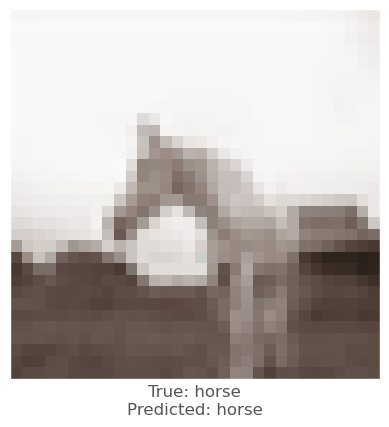



-0.00062578917
-0.0011235476
-0.00086796284
vr, vg, vb :   0.14746033254100957 0.7907866999167072 0.6904730842066759
beam_perturbed_confidence temp :  0.6626632
beam_perturbed_confidence temp :  0.6626632
beam_perturbed_confidence temp :  0.6626632
beam_perturbed_confidence temp :  0.6626632
beam_perturbed_confidence temp :  0.6626632
beam_perturbed_confidence temp :  0.6626632
beam_perturbed_confidence temp :  0.6626632
row index :  0
12th round's confidence : 1th 0.6626632
predicted class :  horse
predicted class's confidence :  0.6626632
Lopt is :  9


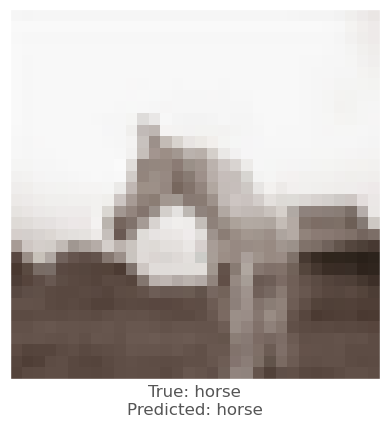



-0.00066429377
-0.001947403
-0.0012019873
vr, vg, vb :   -1.2597552978164392 -0.522476675677795 -0.05465879467382598
beam_perturbed_confidence temp :  0.66522753
beam_perturbed_confidence temp :  0.66446006
beam_perturbed_confidence temp :  0.6638652
beam_perturbed_confidence temp :  0.66620135
beam_perturbed_confidence temp :  0.6657413
beam_perturbed_confidence temp :  0.66545814
beam_perturbed_confidence temp :  0.6671547
row index :  2
12th round's confidence : 2th 0.6638652
predicted class :  horse
predicted class's confidence :  0.6638652
Lopt is :  9


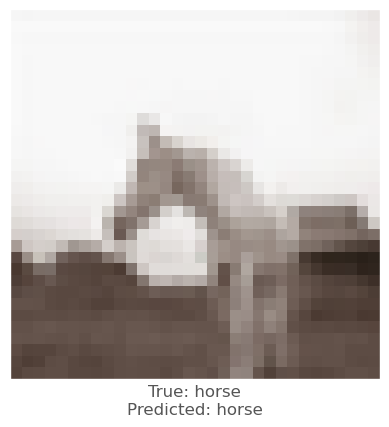



0.0016036034
0.0010173917
0.0004736185
vr, vg, vb :   -0.18252966246553393 1.2009566097458861 0.7972129516250163
beam_perturbed_confidence temp :  0.656783
beam_perturbed_confidence temp :  0.6584333
beam_perturbed_confidence temp :  0.65735567
beam_perturbed_confidence temp :  0.65711004
beam_perturbed_confidence temp :  0.656783
beam_perturbed_confidence temp :  0.6584333
beam_perturbed_confidence temp :  0.65711004
row index :  0
12th round's confidence : 3th 0.656783
predicted class :  horse
predicted class's confidence :  0.656783
Lopt is :  11


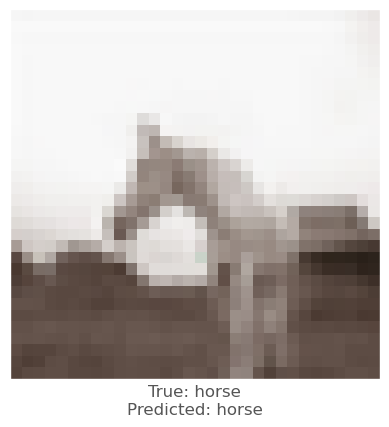



-0.0005182624
-0.001711905
-0.0010082126
vr, vg, vb :   -1.880994585022233 -0.8964773650569609 -0.1946821118629528
beam_perturbed_confidence temp :  0.6634212
beam_perturbed_confidence temp :  0.66325414
beam_perturbed_confidence temp :  0.66287386
beam_perturbed_confidence temp :  0.6649878
beam_perturbed_confidence temp :  0.66427374
beam_perturbed_confidence temp :  0.6638299
beam_perturbed_confidence temp :  0.66580397
row index :  2
12th round's confidence : 4th 0.66287386
predicted class :  horse
predicted class's confidence :  0.66287386
Lopt is :  12


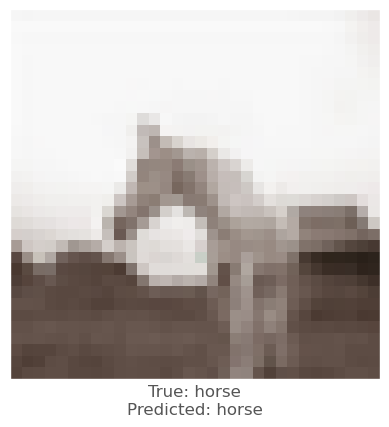



-0.0009251833
-0.0023056269
-0.001676619
vr, vg, vb :   -0.05395921588955238 1.3443160380911434 0.9600591956218356
beam_perturbed_confidence temp :  0.65888834
beam_perturbed_confidence temp :  0.6572069
beam_perturbed_confidence temp :  0.65807265
beam_perturbed_confidence temp :  0.65768015
beam_perturbed_confidence temp :  0.65888834
beam_perturbed_confidence temp :  0.6572069
beam_perturbed_confidence temp :  0.65768015
row index :  1
13th round's confidence : 0th 0.6572069
predicted class :  horse
predicted class's confidence :  0.6572069
Lopt is :  11


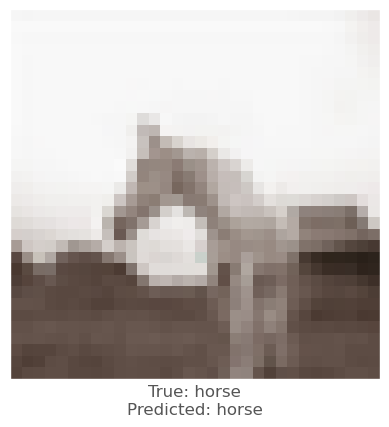



-0.00062578917
-0.0011235476
-0.00086796284
vr, vg, vb :   0.19529321583659123 0.8240627853266479 0.7082220595079322
beam_perturbed_confidence temp :  0.6626632
beam_perturbed_confidence temp :  0.6626632
beam_perturbed_confidence temp :  0.6626632
beam_perturbed_confidence temp :  0.6626632
beam_perturbed_confidence temp :  0.6626632
beam_perturbed_confidence temp :  0.6626632
beam_perturbed_confidence temp :  0.6626632
row index :  0
13th round's confidence : 1th 0.6626632
predicted class :  horse
predicted class's confidence :  0.6626632
Lopt is :  9


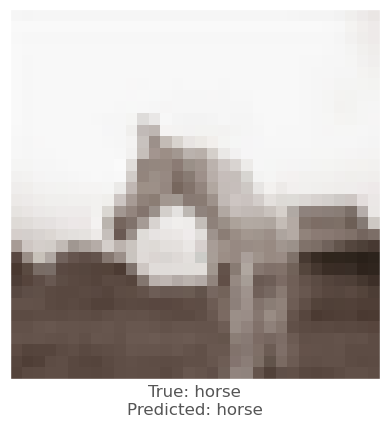



-0.0007315278
-0.0026923418
-0.0018730164
vr, vg, vb :   -1.0606269875019585 -0.20099482765957605 0.13810872053574413
beam_perturbed_confidence temp :  0.6657413
beam_perturbed_confidence temp :  0.66545814
beam_perturbed_confidence temp :  0.6638652
beam_perturbed_confidence temp :  0.6671547
beam_perturbed_confidence temp :  0.6657413
beam_perturbed_confidence temp :  0.66545814
beam_perturbed_confidence temp :  0.6671547
row index :  2
13th round's confidence : 2th 0.6638652
predicted class :  horse
predicted class's confidence :  0.6638652
Lopt is :  9


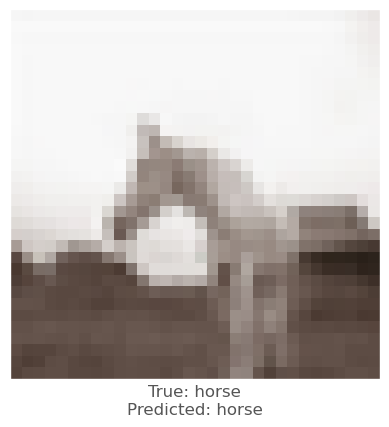



0.0005366802
-0.0005963445
-0.00092083216
vr, vg, vb :   -0.21794471837474225 1.1404953958690758 0.8095748721760156
beam_perturbed_confidence temp :  0.656819
beam_perturbed_confidence temp :  0.65711004
beam_perturbed_confidence temp :  0.656783
beam_perturbed_confidence temp :  0.6560031
beam_perturbed_confidence temp :  0.656819
beam_perturbed_confidence temp :  0.65711004
beam_perturbed_confidence temp :  0.6560031
row index :  3
13th round's confidence : 3th 0.6560031
predicted class :  horse
predicted class's confidence :  0.6560031
Lopt is :  12


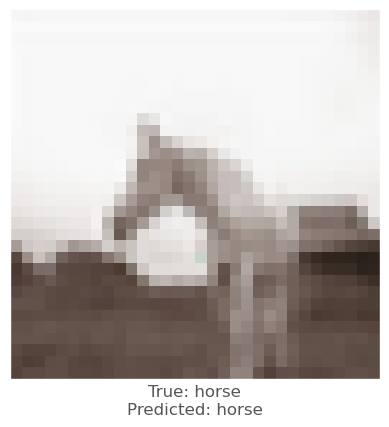



-0.00082957745
-0.0018194318
-0.00061410666
vr, vg, vb :   -1.609937381921621 -0.624886450374385 -0.11380323516457258
beam_perturbed_confidence temp :  0.66427374
beam_perturbed_confidence temp :  0.6638299
beam_perturbed_confidence temp :  0.6630956
beam_perturbed_confidence temp :  0.66580397
beam_perturbed_confidence temp :  0.6651744
beam_perturbed_confidence temp :  0.6643435
beam_perturbed_confidence temp :  0.6666081
row index :  2
13th round's confidence : 4th 0.6630956
predicted class :  horse
predicted class's confidence :  0.6630956
Lopt is :  12


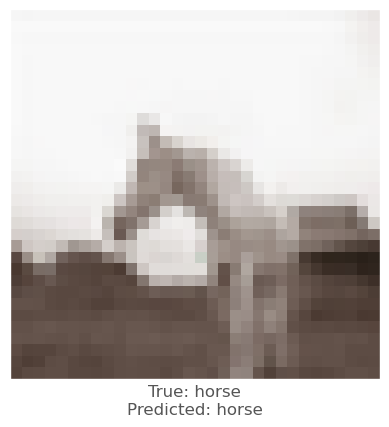



-0.00086408854
-0.0019557476
-0.0017344356
vr, vg, vb :   0.037845559230286645 1.405459194719041 1.0374968318915614
beam_perturbed_confidence temp :  0.6572069
beam_perturbed_confidence temp :  0.6561169
beam_perturbed_confidence temp :  0.65632206
beam_perturbed_confidence temp :  0.6561169
beam_perturbed_confidence temp :  0.65632206
beam_perturbed_confidence temp :  0.65559
beam_perturbed_confidence temp :  0.65559
row index :  5
14th round's confidence : 0th 0.65559
predicted class :  horse
predicted class's confidence :  0.65559
Lopt is :  11


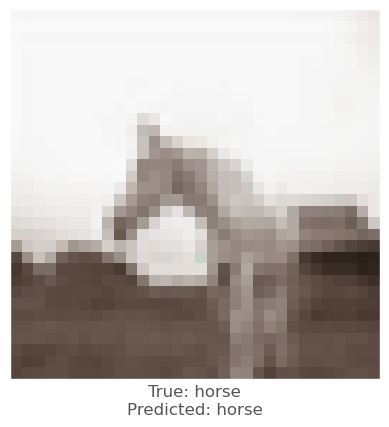



-0.00062578917
-0.0011235476
-0.00086796284
vr, vg, vb :   0.23834281080261474 0.8540112621955944 0.7241961372790627
beam_perturbed_confidence temp :  0.6626632
beam_perturbed_confidence temp :  0.6626632
beam_perturbed_confidence temp :  0.6626632
beam_perturbed_confidence temp :  0.6626632
beam_perturbed_confidence temp :  0.6626632
beam_perturbed_confidence temp :  0.6626632
beam_perturbed_confidence temp :  0.6626632
row index :  0
14th round's confidence : 1th 0.6626632
predicted class :  horse
predicted class's confidence :  0.6626632
Lopt is :  9


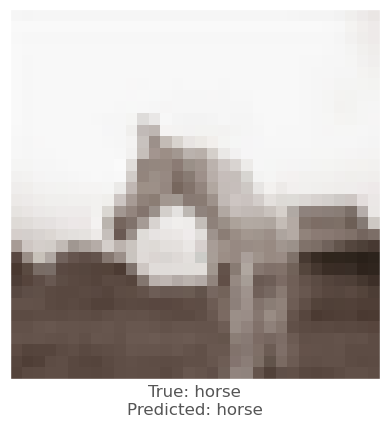



-0.0007315278
-0.0026923418
-0.0018730164
vr, vg, vb :   -0.8814115082189258 0.08833883555682101 0.31159948422435724
beam_perturbed_confidence temp :  0.66453105
beam_perturbed_confidence temp :  0.6638652
beam_perturbed_confidence temp :  0.6638652
beam_perturbed_confidence temp :  0.66453105
beam_perturbed_confidence temp :  0.66453105
beam_perturbed_confidence temp :  0.6638652
beam_perturbed_confidence temp :  0.66453105
row index :  1
14th round's confidence : 2th 0.6638652
predicted class :  horse
predicted class's confidence :  0.6638652
Lopt is :  9


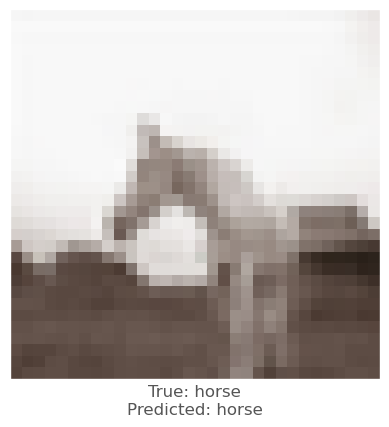



0.0010330677
-0.0002772212
-0.0007814765
vr, vg, vb :   -0.29945701686197507 1.0541679765672025 0.8067650347234288
beam_perturbed_confidence temp :  0.65607697
beam_perturbed_confidence temp :  0.65654176
beam_perturbed_confidence temp :  0.6560031
beam_perturbed_confidence temp :  0.6552099
beam_perturbed_confidence temp :  0.65607697
beam_perturbed_confidence temp :  0.65654176
beam_perturbed_confidence temp :  0.6552099
row index :  3
14th round's confidence : 3th 0.6552099
predicted class :  horse
predicted class's confidence :  0.6552099
Lopt is :  13


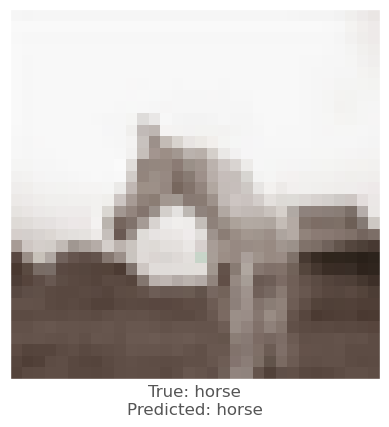



-0.0015682578
-0.0020017028
-0.0005713701
vr, vg, vb :   -1.2921178628609287 -0.36222752678775216 -0.04528589916642588
beam_perturbed_confidence temp :  0.6651744
beam_perturbed_confidence temp :  0.6643435
beam_perturbed_confidence temp :  0.66344523
beam_perturbed_confidence temp :  0.6666081
beam_perturbed_confidence temp :  0.665657
beam_perturbed_confidence temp :  0.6648471
beam_perturbed_confidence temp :  0.66733515
row index :  2
14th round's confidence : 4th 0.66344523
predicted class :  horse
predicted class's confidence :  0.66344523
Lopt is :  12


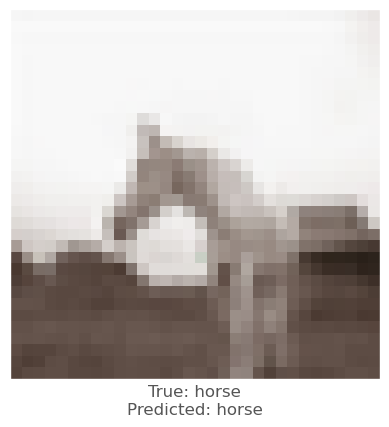



0.0018994808
0.0006715059
-0.0001320839
vr, vg, vb :   -0.15588707866295687 1.1977626824431817 0.9469555379846318
beam_perturbed_confidence temp :  0.65541714
beam_perturbed_confidence temp :  0.65699357
beam_perturbed_confidence temp :  0.65559
beam_perturbed_confidence temp :  0.65515053
beam_perturbed_confidence temp :  0.65541714
beam_perturbed_confidence temp :  0.65699357
beam_perturbed_confidence temp :  0.65515053
row index :  3
15th round's confidence : 0th 0.65515053
predicted class :  horse
predicted class's confidence :  0.65515053
Lopt is :  12


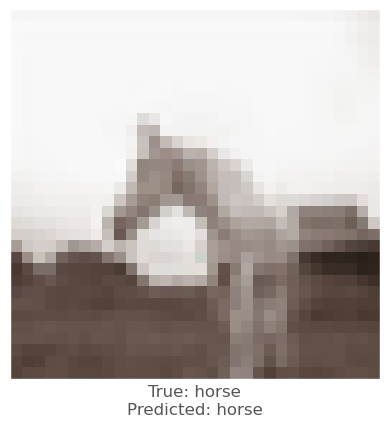



-0.00062578917
-0.0011235476
-0.00086796284
vr, vg, vb :   0.27708744627203585 0.8809648913776463 0.7385728072730803
beam_perturbed_confidence temp :  0.6626632
beam_perturbed_confidence temp :  0.6626632
beam_perturbed_confidence temp :  0.6626632
beam_perturbed_confidence temp :  0.6626632
beam_perturbed_confidence temp :  0.6626632
beam_perturbed_confidence temp :  0.6626632
beam_perturbed_confidence temp :  0.6626632
row index :  0
15th round's confidence : 1th 0.6626632
predicted class :  horse
predicted class's confidence :  0.6626632
Lopt is :  9


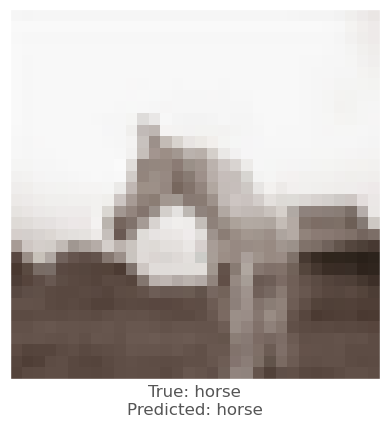



-0.0007315278
-0.0026923418
-0.0018730164
vr, vg, vb :   -0.7201175768641963 0.3487391324515784 0.46774117154410905
beam_perturbed_confidence temp :  0.66453105
beam_perturbed_confidence temp :  0.6638652
beam_perturbed_confidence temp :  0.6638652
beam_perturbed_confidence temp :  0.66453105
beam_perturbed_confidence temp :  0.66453105
beam_perturbed_confidence temp :  0.6638652
beam_perturbed_confidence temp :  0.66453105
row index :  1
15th round's confidence : 2th 0.6638652
predicted class :  horse
predicted class's confidence :  0.6638652
Lopt is :  9


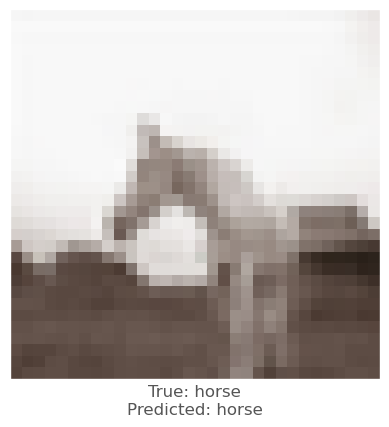



0.001465857
-0.00058567524
-0.0005478263
vr, vg, vb :   -0.41609701807189575 1.0073187028667812 0.7808711602641474
beam_perturbed_confidence temp :  0.6550759
beam_perturbed_confidence temp :  0.6554913
beam_perturbed_confidence temp :  0.6552099
beam_perturbed_confidence temp :  0.65406555
beam_perturbed_confidence temp :  0.6550759
beam_perturbed_confidence temp :  0.6554913
beam_perturbed_confidence temp :  0.65406555
row index :  3
15th round's confidence : 3th 0.65406555
predicted class :  horse
predicted class's confidence :  0.65406555
Lopt is :  14


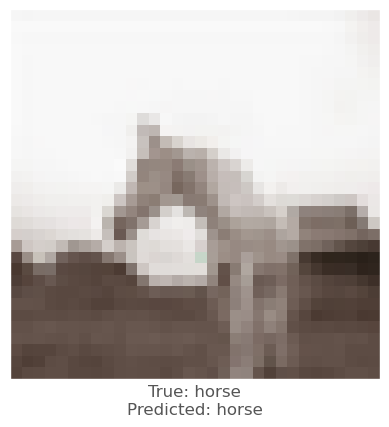



-0.0020409822
-0.0022515059
-0.0009059906
vr, vg, vb :   -0.9588078519349432 -0.10085418893441639 0.04984175080881046
beam_perturbed_confidence temp :  0.66463023
beam_perturbed_confidence temp :  0.6648471
beam_perturbed_confidence temp :  0.66344523
beam_perturbed_confidence temp :  0.6660683
beam_perturbed_confidence temp :  0.66463023
beam_perturbed_confidence temp :  0.6648471
beam_perturbed_confidence temp :  0.6660683
row index :  2
15th round's confidence : 4th 0.66344523
predicted class :  horse
predicted class's confidence :  0.66344523
Lopt is :  12


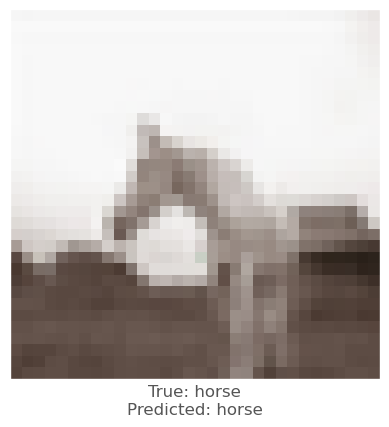



0.002424121
0.0008736849
0.00038218498
vr, vg, vb :   -0.38271046109817486 0.990617925887096 0.8140414859561882
beam_perturbed_confidence temp :  0.65456945
beam_perturbed_confidence temp :  0.65515053
beam_perturbed_confidence temp :  0.65515053
beam_perturbed_confidence temp :  0.65456945
beam_perturbed_confidence temp :  0.65456945
beam_perturbed_confidence temp :  0.65515053
beam_perturbed_confidence temp :  0.65456945
row index :  0
16th round's confidence : 0th 0.65456945
predicted class :  horse
predicted class's confidence :  0.65456945
Lopt is :  13


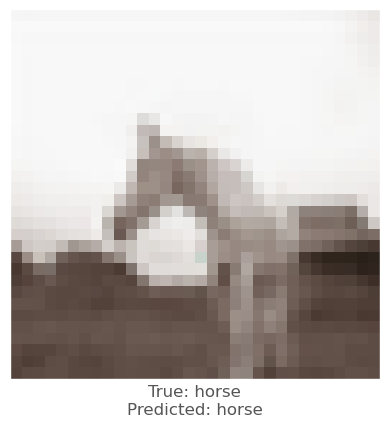



-0.00062578917
-0.0011235476
-0.00086796284
vr, vg, vb :   0.3119576181945149 0.9052231576414931 0.7515118102676961
beam_perturbed_confidence temp :  0.6626632
beam_perturbed_confidence temp :  0.6626632
beam_perturbed_confidence temp :  0.6626632
beam_perturbed_confidence temp :  0.6626632
beam_perturbed_confidence temp :  0.6626632
beam_perturbed_confidence temp :  0.6626632
beam_perturbed_confidence temp :  0.6626632
row index :  0
16th round's confidence : 1th 0.6626632
predicted class :  horse
predicted class's confidence :  0.6626632
Lopt is :  9


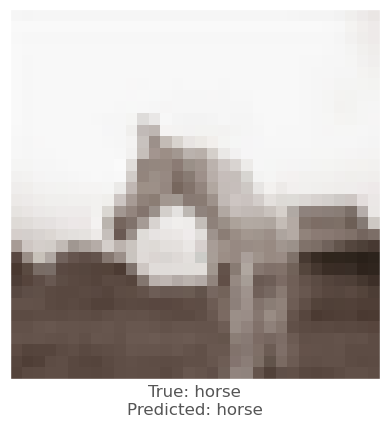



-0.0007315278
-0.0026923418
-0.0018730164
vr, vg, vb :   -0.5749530386449397 0.5830993996568601 0.6082686901318857
beam_perturbed_confidence temp :  0.66453105
beam_perturbed_confidence temp :  0.6638652
beam_perturbed_confidence temp :  0.6638652
beam_perturbed_confidence temp :  0.66453105
beam_perturbed_confidence temp :  0.66453105
beam_perturbed_confidence temp :  0.6638652
beam_perturbed_confidence temp :  0.66453105
row index :  1
16th round's confidence : 2th 0.6638652
predicted class :  horse
predicted class's confidence :  0.6638652
Lopt is :  9


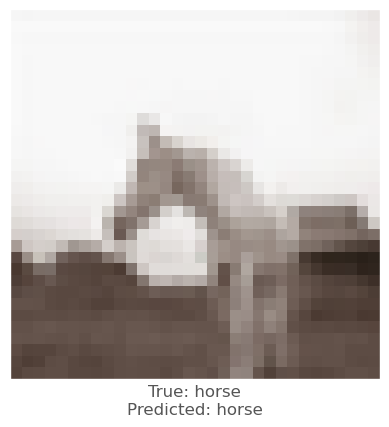



0.0016364455
-0.00051522255
-0.00043177605
vr, vg, vb :   -0.5381318684955412 0.9581090875239507 0.7459616489130256
beam_perturbed_confidence temp :  0.65385485
beam_perturbed_confidence temp :  0.65406555
beam_perturbed_confidence temp :  0.65406555
beam_perturbed_confidence temp :  0.65385485
beam_perturbed_confidence temp :  0.65385485
beam_perturbed_confidence temp :  0.65406555
beam_perturbed_confidence temp :  0.65385485
row index :  0
16th round's confidence : 3th 0.65385485
predicted class :  horse
predicted class's confidence :  0.65385485
Lopt is :  15


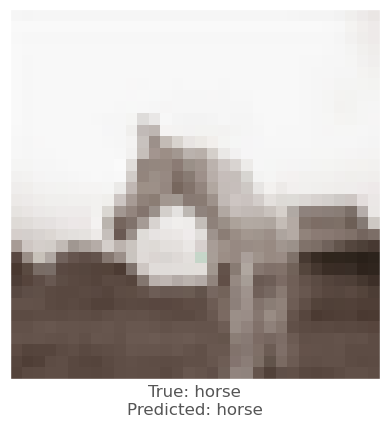



-0.0020409822
-0.0022515059
-0.0009059906
vr, vg, vb :   -0.6588288421015563 0.1343818151335858 0.13545663578652317
beam_perturbed_confidence temp :  0.66463023
beam_perturbed_confidence temp :  0.66344523
beam_perturbed_confidence temp :  0.66344523
beam_perturbed_confidence temp :  0.66463023
beam_perturbed_confidence temp :  0.66463023
beam_perturbed_confidence temp :  0.66344523
beam_perturbed_confidence temp :  0.66463023
row index :  1
16th round's confidence : 4th 0.66344523
predicted class :  horse
predicted class's confidence :  0.66344523
Lopt is :  12


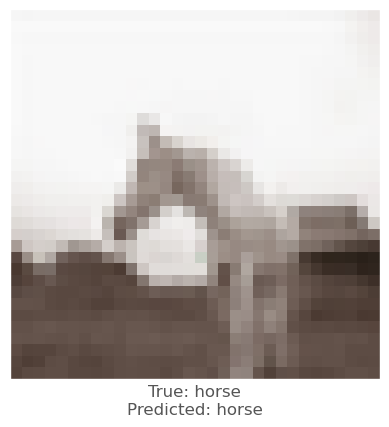



0.00020104647
-0.0012231469
-0.0018523335
vr, vg, vb :   -0.36454406167109665 1.0138708248419654 0.9178706919290508
beam_perturbed_confidence temp :  0.6549495
beam_perturbed_confidence temp :  0.65449935
beam_perturbed_confidence temp :  0.65456945
beam_perturbed_confidence temp :  0.6536294
beam_perturbed_confidence temp :  0.6549495
beam_perturbed_confidence temp :  0.65449935
beam_perturbed_confidence temp :  0.6536294
row index :  3
17th round's confidence : 0th 0.6536294
predicted class :  horse
predicted class's confidence :  0.6536294
Lopt is :  14


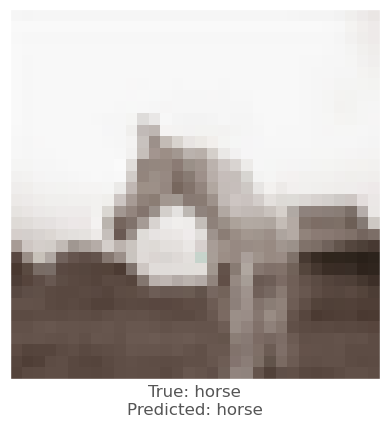



-0.00062578917
-0.0011235476
-0.00086796284
vr, vg, vb :   0.343340772924746 0.9270555972789551 0.7631569129628504
beam_perturbed_confidence temp :  0.6626632
beam_perturbed_confidence temp :  0.6626632
beam_perturbed_confidence temp :  0.6626632
beam_perturbed_confidence temp :  0.6626632
beam_perturbed_confidence temp :  0.6626632
beam_perturbed_confidence temp :  0.6626632
beam_perturbed_confidence temp :  0.6626632
row index :  0
17th round's confidence : 1th 0.6626632
predicted class :  horse
predicted class's confidence :  0.6626632
Lopt is :  9


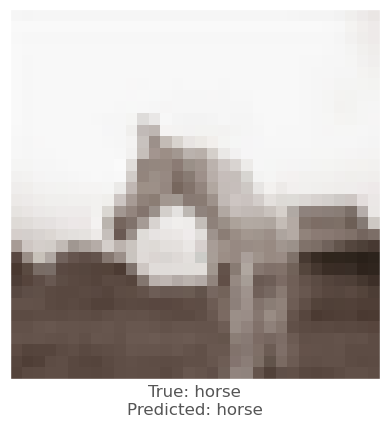



-0.0007315278
-0.0026923418
-0.0018730164
vr, vg, vb :   -0.44430495424760885 0.7940236401416135 0.7347434568608846
beam_perturbed_confidence temp :  0.66453105
beam_perturbed_confidence temp :  0.6638652
beam_perturbed_confidence temp :  0.6638652
beam_perturbed_confidence temp :  0.66453105
beam_perturbed_confidence temp :  0.66453105
beam_perturbed_confidence temp :  0.6638652
beam_perturbed_confidence temp :  0.66453105
row index :  1
17th round's confidence : 2th 0.6638652
predicted class :  horse
predicted class's confidence :  0.6638652
Lopt is :  9


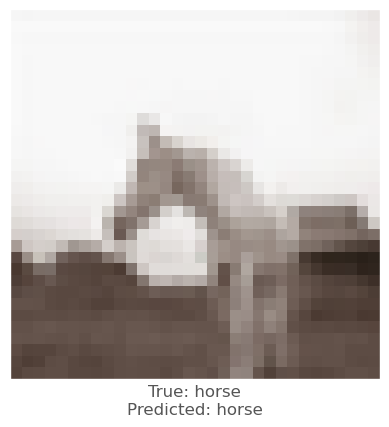



-0.0005019307
-0.0021048784
-0.0015773773
vr, vg, vb :   -0.4341256102806306 1.0727860213313702 0.8291032159553169
beam_perturbed_confidence temp :  0.6545675
beam_perturbed_confidence temp :  0.6532312
beam_perturbed_confidence temp :  0.65385485
beam_perturbed_confidence temp :  0.6528269
beam_perturbed_confidence temp :  0.6545675
beam_perturbed_confidence temp :  0.6532312
beam_perturbed_confidence temp :  0.6528269
row index :  3
17th round's confidence : 3th 0.6528269
predicted class :  horse
predicted class's confidence :  0.6528269
Lopt is :  16


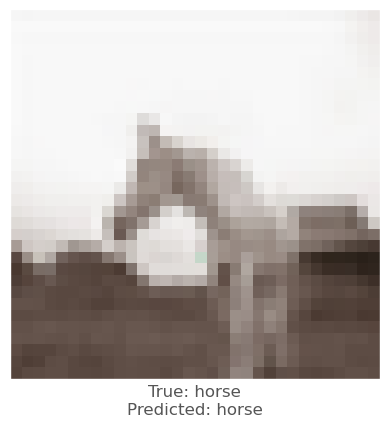



-0.0020409822
-0.0022515059
-0.0009059906
vr, vg, vb :   -0.3888477332515081 0.34609421879478774 0.2125100322664646
beam_perturbed_confidence temp :  0.66463023
beam_perturbed_confidence temp :  0.66344523
beam_perturbed_confidence temp :  0.66344523
beam_perturbed_confidence temp :  0.66463023
beam_perturbed_confidence temp :  0.66463023
beam_perturbed_confidence temp :  0.66344523
beam_perturbed_confidence temp :  0.66463023
row index :  1
17th round's confidence : 4th 0.66344523
predicted class :  horse
predicted class's confidence :  0.66344523
Lopt is :  12


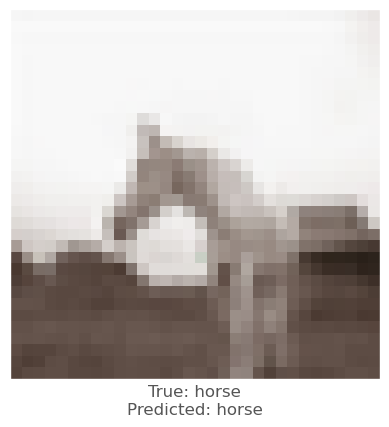



0.00010764599
-0.0012663603
-0.0014725924
vr, vg, vb :   -0.33885425435042255 1.039119770647564 0.9733428581182259
beam_perturbed_confidence temp :  0.6543917
beam_perturbed_confidence temp :  0.6536831
beam_perturbed_confidence temp :  0.6536294
beam_perturbed_confidence temp :  0.6529573
beam_perturbed_confidence temp :  0.6543917
beam_perturbed_confidence temp :  0.6536831
beam_perturbed_confidence temp :  0.6529573
row index :  3
18th round's confidence : 0th 0.6529573
predicted class :  horse
predicted class's confidence :  0.6529573
Lopt is :  15


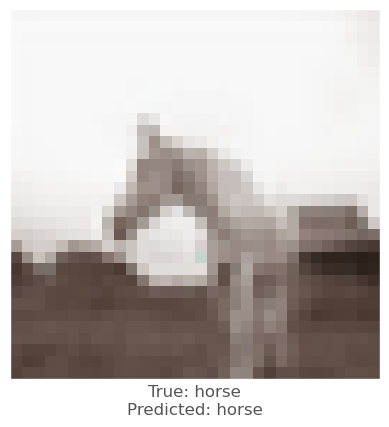



-0.00062578917
-0.0011235476
-0.00086796284
vr, vg, vb :   0.371585612181954 0.946704792952671 0.7736375053884892
beam_perturbed_confidence temp :  0.6626632
beam_perturbed_confidence temp :  0.6626632
beam_perturbed_confidence temp :  0.6626632
beam_perturbed_confidence temp :  0.6626632
beam_perturbed_confidence temp :  0.6626632
beam_perturbed_confidence temp :  0.6626632
beam_perturbed_confidence temp :  0.6626632
row index :  0
18th round's confidence : 1th 0.6626632
predicted class :  horse
predicted class's confidence :  0.6626632
Lopt is :  9


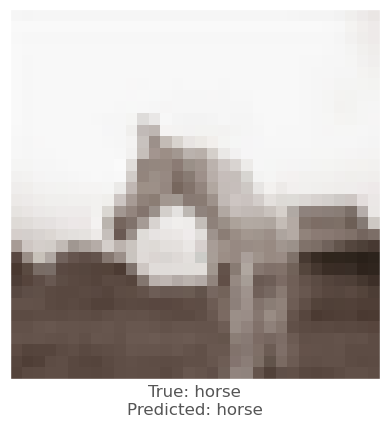



-0.0007315278
-0.0026923418
-0.0018730164
vr, vg, vb :   -0.3267216782900111 0.9838554565778916 0.8485707469169836
beam_perturbed_confidence temp :  0.66453105
beam_perturbed_confidence temp :  0.6638652
beam_perturbed_confidence temp :  0.6638652
beam_perturbed_confidence temp :  0.66453105
beam_perturbed_confidence temp :  0.66453105
beam_perturbed_confidence temp :  0.6638652
beam_perturbed_confidence temp :  0.66453105
row index :  1
18th round's confidence : 2th 0.6638652
predicted class :  horse
predicted class's confidence :  0.6638652
Lopt is :  9


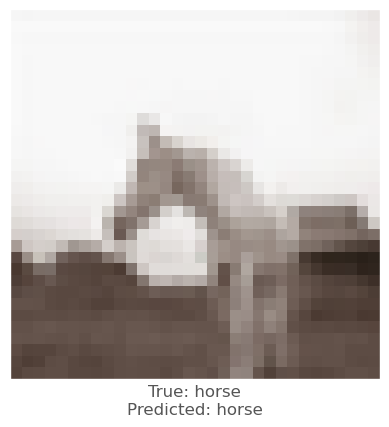



-0.0006355643
-0.0021238923
-0.0011507869
vr, vg, vb :   -0.32715661652856853 1.1778966499263825 0.8612715820276319
beam_perturbed_confidence temp :  0.65386677
beam_perturbed_confidence temp :  0.6524436
beam_perturbed_confidence temp :  0.6528269
beam_perturbed_confidence temp :  0.65238124
beam_perturbed_confidence temp :  0.65386677
beam_perturbed_confidence temp :  0.6524436
beam_perturbed_confidence temp :  0.65238124
row index :  3
18th round's confidence : 3th 0.65238124
predicted class :  horse
predicted class's confidence :  0.65238124
Lopt is :  17


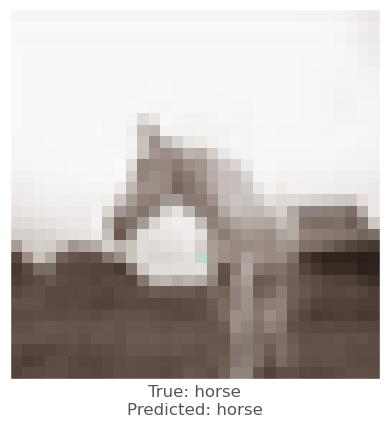



-0.0020409822
-0.0022515059
-0.0009059906
vr, vg, vb :   -0.14586473528646476 0.5366353820898695 0.2818580890984119
beam_perturbed_confidence temp :  0.66463023
beam_perturbed_confidence temp :  0.66344523
beam_perturbed_confidence temp :  0.66344523
beam_perturbed_confidence temp :  0.66463023
beam_perturbed_confidence temp :  0.66463023
beam_perturbed_confidence temp :  0.66344523
beam_perturbed_confidence temp :  0.66463023
row index :  1
18th round's confidence : 4th 0.66344523
predicted class :  horse
predicted class's confidence :  0.66344523
Lopt is :  12


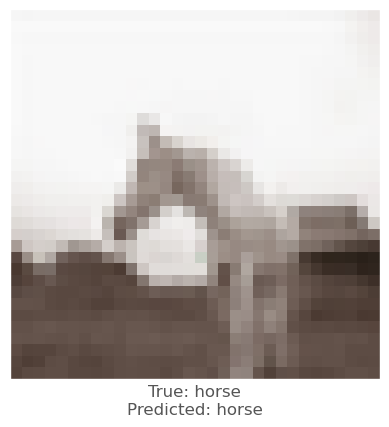



7.623434e-05
-0.00096809864
-0.00038093328
vr, vg, vb :   -0.31259226298215276 1.032017657626997 0.9141019007823554
beam_perturbed_confidence temp :  0.6536069
beam_perturbed_confidence temp :  0.6534236
beam_perturbed_confidence temp :  0.6529573
beam_perturbed_confidence temp :  0.65256375
beam_perturbed_confidence temp :  0.6536069
beam_perturbed_confidence temp :  0.6534236
beam_perturbed_confidence temp :  0.65256375
row index :  3
19th round's confidence : 0th 0.65256375
predicted class :  horse
predicted class's confidence :  0.65256375
Lopt is :  16


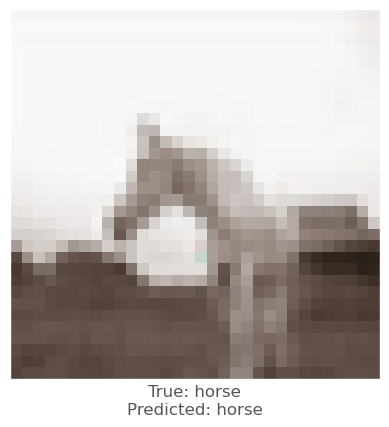



-0.00062578917
-0.0011235476
-0.00086796284
vr, vg, vb :   0.39700596751344125 0.9643890690590152 0.7830700385715641
beam_perturbed_confidence temp :  0.6626632
beam_perturbed_confidence temp :  0.6626632
beam_perturbed_confidence temp :  0.6626632
beam_perturbed_confidence temp :  0.6626632
beam_perturbed_confidence temp :  0.6626632
beam_perturbed_confidence temp :  0.6626632
beam_perturbed_confidence temp :  0.6626632
row index :  0
19th round's confidence : 1th 0.6626632
predicted class :  horse
predicted class's confidence :  0.6626632
Lopt is :  9


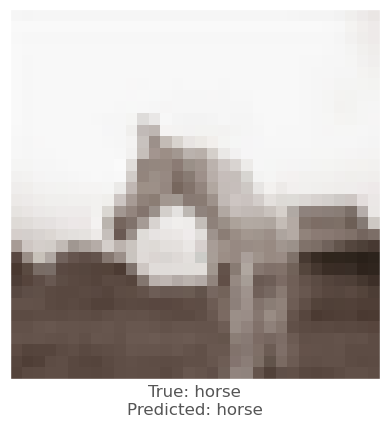



-0.0007315278
-0.0026923418
-0.0018730164
vr, vg, vb :   -0.22089672992817305 1.154704091370542 0.9510153079674728
beam_perturbed_confidence temp :  0.66453105
beam_perturbed_confidence temp :  0.6627658
beam_perturbed_confidence temp :  0.6638652
beam_perturbed_confidence temp :  0.66328365
beam_perturbed_confidence temp :  0.66453105
beam_perturbed_confidence temp :  0.6627658
beam_perturbed_confidence temp :  0.66328365
row index :  1
19th round's confidence : 2th 0.6627658
predicted class :  horse
predicted class's confidence :  0.6627658
Lopt is :  9


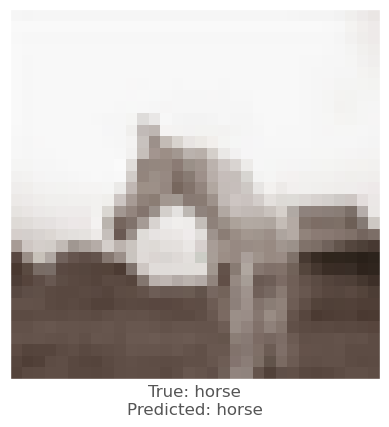



-0.0010256171
-0.0020178556
-0.00065487623
vr, vg, vb :   -0.19187924261069705 1.2618925493563518 0.8406320470395904
beam_perturbed_confidence temp :  0.6534692
beam_perturbed_confidence temp :  0.6518489
beam_perturbed_confidence temp :  0.65238124
beam_perturbed_confidence temp :  0.65189403
beam_perturbed_confidence temp :  0.6534692
beam_perturbed_confidence temp :  0.6518489
beam_perturbed_confidence temp :  0.65189403
row index :  1
19th round's confidence : 3th 0.6518489
predicted class :  horse
predicted class's confidence :  0.6518489
Lopt is :  17


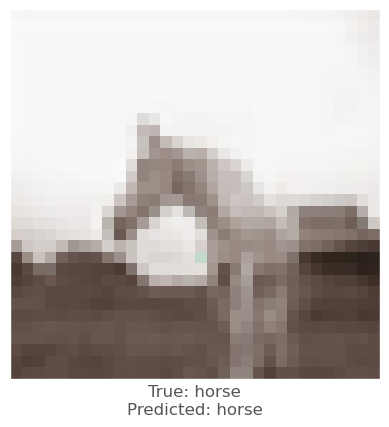



-0.0020409822
-0.0022515059
-0.0009059906
vr, vg, vb :   0.07281996288207429 0.7081224290554431 0.3442713402471645
beam_perturbed_confidence temp :  0.66344523
beam_perturbed_confidence temp :  0.66344523
beam_perturbed_confidence temp :  0.66344523
beam_perturbed_confidence temp :  0.66344523
beam_perturbed_confidence temp :  0.66344523
beam_perturbed_confidence temp :  0.66344523
beam_perturbed_confidence temp :  0.66344523
row index :  0
19th round's confidence : 4th 0.66344523
predicted class :  horse
predicted class's confidence :  0.66344523
Lopt is :  12


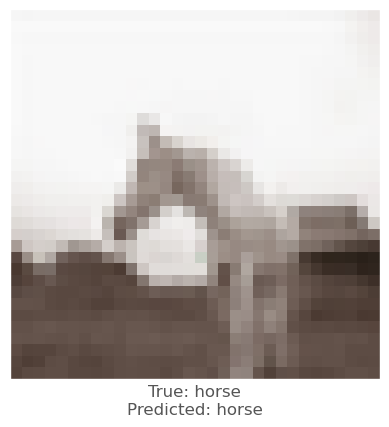



0.00046026707
4.9233437e-05
0.0006109476
vr, vg, vb :   -0.32735974337949414 0.9238925482058501 0.7615969498093446
beam_perturbed_confidence temp :  0.65296334
beam_perturbed_confidence temp :  0.65256375
beam_perturbed_confidence temp :  0.65256375
beam_perturbed_confidence temp :  0.65296334
beam_perturbed_confidence temp :  0.65296334
beam_perturbed_confidence temp :  0.65256375
beam_perturbed_confidence temp :  0.65296334
row index :  1
20th round's confidence : 0th 0.65256375
predicted class :  horse
predicted class's confidence :  0.65256375
Lopt is :  16


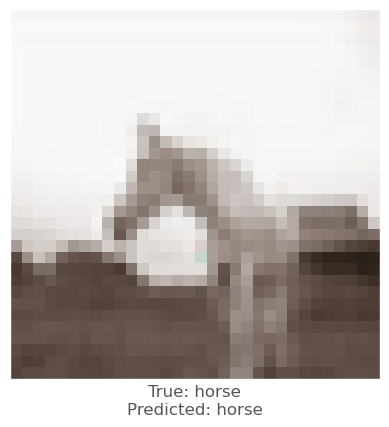



-0.00062578917
-0.0011235476
-0.00086796284
vr, vg, vb :   0.41988428731177974 0.980304917554725 0.7915593184363315
beam_perturbed_confidence temp :  0.6626632
beam_perturbed_confidence temp :  0.6626632
beam_perturbed_confidence temp :  0.6626632
beam_perturbed_confidence temp :  0.6626632
beam_perturbed_confidence temp :  0.6626632
beam_perturbed_confidence temp :  0.6626632
beam_perturbed_confidence temp :  0.6626632
row index :  0
20th round's confidence : 1th 0.6626632
predicted class :  horse
predicted class's confidence :  0.6626632
Lopt is :  9


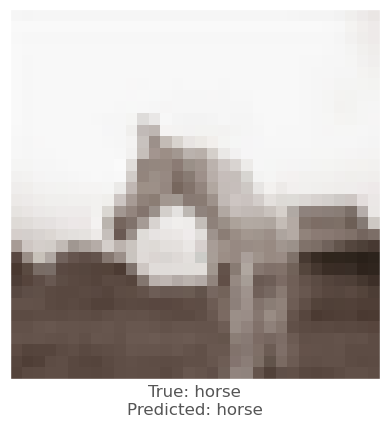



0.0001847744
-0.0014951825
-0.0009742379
vr, vg, vb :   -0.21728449681572684 1.1887519336525552 0.9533375690561016
beam_perturbed_confidence temp :  0.66328365
beam_perturbed_confidence temp :  0.66237
beam_perturbed_confidence temp :  0.6627658
beam_perturbed_confidence temp :  0.662417
beam_perturbed_confidence temp :  0.66328365
beam_perturbed_confidence temp :  0.66237
beam_perturbed_confidence temp :  0.662417
row index :  1
20th round's confidence : 2th 0.66237
predicted class :  horse
predicted class's confidence :  0.66237
Lopt is :  9


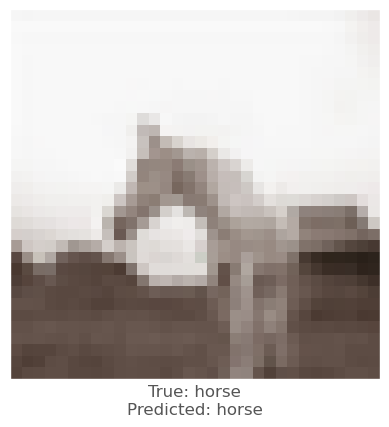



0.00089770555
1.2695789e-05
0.0009160042
vr, vg, vb :   -0.2624618738458432 1.1344337154870008 0.6649684242448111
beam_perturbed_confidence temp :  0.65189403
beam_perturbed_confidence temp :  0.65239394
beam_perturbed_confidence temp :  0.6518489
beam_perturbed_confidence temp :  0.6516468
beam_perturbed_confidence temp :  0.65189403
beam_perturbed_confidence temp :  0.65239394
beam_perturbed_confidence temp :  0.6516468
row index :  3
20th round's confidence : 3th 0.6516468
predicted class :  horse
predicted class's confidence :  0.6516468
Lopt is :  18


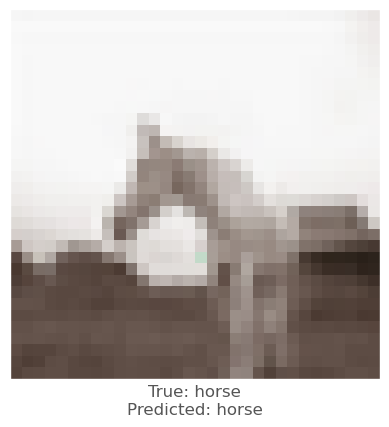



-0.0020409822
-0.0022515059
-0.0009059906
vr, vg, vb :   0.2696361912337594 0.8624607713244593 0.4004432662810418
beam_perturbed_confidence temp :  0.66344523
beam_perturbed_confidence temp :  0.66344523
beam_perturbed_confidence temp :  0.66344523
beam_perturbed_confidence temp :  0.66344523
beam_perturbed_confidence temp :  0.66344523
beam_perturbed_confidence temp :  0.66344523
beam_perturbed_confidence temp :  0.66344523
row index :  0
20th round's confidence : 4th 0.66344523
predicted class :  horse
predicted class's confidence :  0.66344523
Lopt is :  12


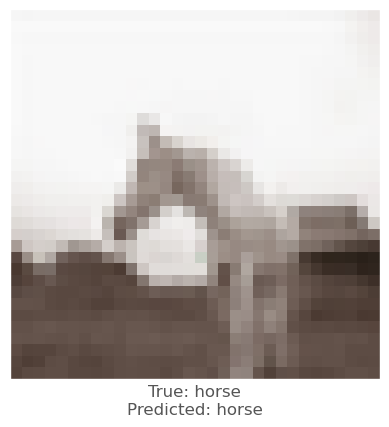



0.00046026707
4.9233437e-05
0.0006109476
vr, vg, vb :   -0.3406504757371014 0.8265799497268178 0.6243424939336347
beam_perturbed_confidence temp :  0.65296334
beam_perturbed_confidence temp :  0.65256375
beam_perturbed_confidence temp :  0.65256375
beam_perturbed_confidence temp :  0.65296334
beam_perturbed_confidence temp :  0.65296334
beam_perturbed_confidence temp :  0.65256375
beam_perturbed_confidence temp :  0.65296334
row index :  1
21th round's confidence : 0th 0.65256375
predicted class :  horse
predicted class's confidence :  0.65256375
Lopt is :  16


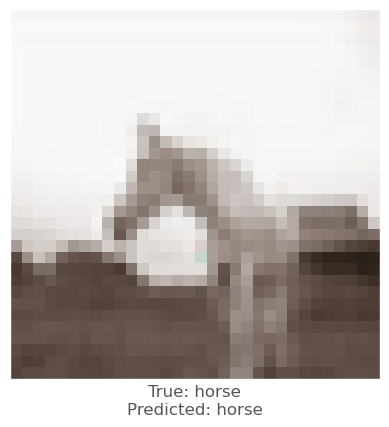



-0.00062578917
-0.0011235476
-0.00086796284
vr, vg, vb :   0.4404747751302844 0.9946291812008639 0.7991996703146222
beam_perturbed_confidence temp :  0.6626632
beam_perturbed_confidence temp :  0.6626632
beam_perturbed_confidence temp :  0.6626632
beam_perturbed_confidence temp :  0.6626632
beam_perturbed_confidence temp :  0.6626632
beam_perturbed_confidence temp :  0.6626632
beam_perturbed_confidence temp :  0.6626632
row index :  0
21th round's confidence : 1th 0.6626632
predicted class :  horse
predicted class's confidence :  0.6626632
Lopt is :  9


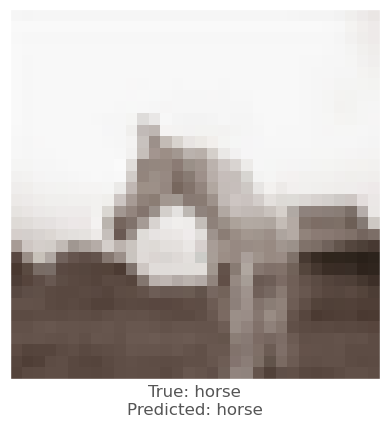



0.00068312883
-5.7518482e-05
-0.000408113
vr, vg, vb :   -0.2638689305112294 1.075628588508125 0.8988151124282013
beam_perturbed_confidence temp :  0.662417
beam_perturbed_confidence temp :  0.6627083
beam_perturbed_confidence temp :  0.66237
beam_perturbed_confidence temp :  0.6623467
beam_perturbed_confidence temp :  0.662417
beam_perturbed_confidence temp :  0.6627083
beam_perturbed_confidence temp :  0.6623467
row index :  3
21th round's confidence : 2th 0.6623467
predicted class :  horse
predicted class's confidence :  0.6623467
Lopt is :  10


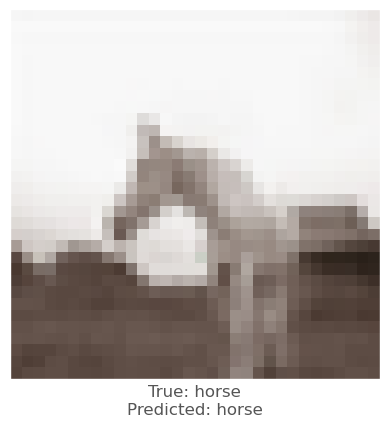



0.0008351803
0.0007070899
0.0015763044
vr, vg, vb :   -0.31973371472053624 0.9502813538412549 0.44084113824733195
beam_perturbed_confidence temp :  0.65155876
beam_perturbed_confidence temp :  0.6516468
beam_perturbed_confidence temp :  0.6516468
beam_perturbed_confidence temp :  0.65155876
beam_perturbed_confidence temp :  0.65155876
beam_perturbed_confidence temp :  0.6516468
beam_perturbed_confidence temp :  0.65155876
row index :  0
21th round's confidence : 3th 0.65155876
predicted class :  horse
predicted class's confidence :  0.65155876
Lopt is :  19


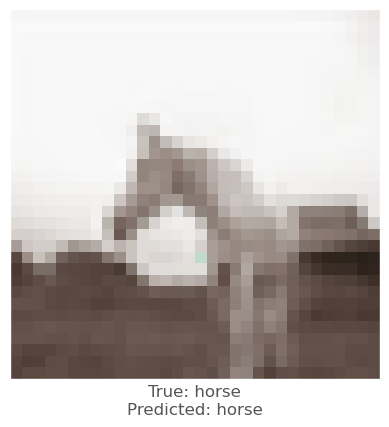



-0.0020409822
-0.0022515059
-0.0009059906
vr, vg, vb :   0.4467707967502761 1.001365279366574 0.45099799971153137
beam_perturbed_confidence temp :  0.66344523
beam_perturbed_confidence temp :  0.66259557
beam_perturbed_confidence temp :  0.66344523
beam_perturbed_confidence temp :  0.66259557
beam_perturbed_confidence temp :  0.66344523
beam_perturbed_confidence temp :  0.66259557
beam_perturbed_confidence temp :  0.66259557
row index :  1
21th round's confidence : 4th 0.66259557
predicted class :  horse
predicted class's confidence :  0.66259557
Lopt is :  12


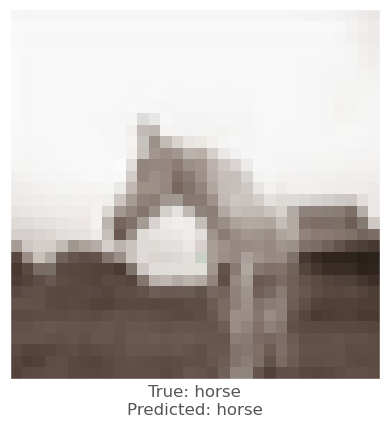



0.00046026707
4.9233437e-05
0.0006109476
vr, vg, vb :   -0.3526121348589479 0.7389986110956888 0.5008134836454958
beam_perturbed_confidence temp :  0.65296334
beam_perturbed_confidence temp :  0.65256375
beam_perturbed_confidence temp :  0.65256375
beam_perturbed_confidence temp :  0.65296334
beam_perturbed_confidence temp :  0.65296334
beam_perturbed_confidence temp :  0.65256375
beam_perturbed_confidence temp :  0.65296334
row index :  1
22th round's confidence : 0th 0.65256375
predicted class :  horse
predicted class's confidence :  0.65256375
Lopt is :  16


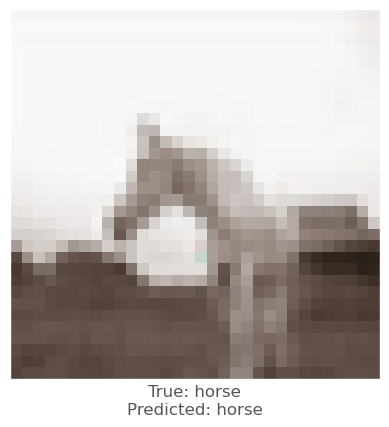



-0.00062578917
-0.0011235476
-0.00086796284
vr, vg, vb :   0.45900621416693854 1.0075210184823888 0.8060759870050839
beam_perturbed_confidence temp :  0.6626632
beam_perturbed_confidence temp :  0.66251147
beam_perturbed_confidence temp :  0.6626632
beam_perturbed_confidence temp :  0.66251147
beam_perturbed_confidence temp :  0.6626632
beam_perturbed_confidence temp :  0.66251147
beam_perturbed_confidence temp :  0.66251147
row index :  1
22th round's confidence : 1th 0.66251147
predicted class :  horse
predicted class's confidence :  0.66251147
Lopt is :  9


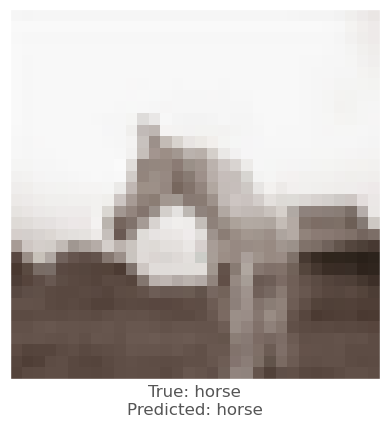



8.511543e-05
-0.00068438053
-0.00023144484
vr, vg, vb :   -0.24599358073403224 1.036503782788416 0.8320780847516654
beam_perturbed_confidence temp :  0.66262317
beam_perturbed_confidence temp :  0.6617326
beam_perturbed_confidence temp :  0.6623467
beam_perturbed_confidence temp :  0.66182643
beam_perturbed_confidence temp :  0.66262317
beam_perturbed_confidence temp :  0.6617326
beam_perturbed_confidence temp :  0.66182643
row index :  1
22th round's confidence : 2th 0.6617326
predicted class :  horse
predicted class's confidence :  0.6617326
Lopt is :  10


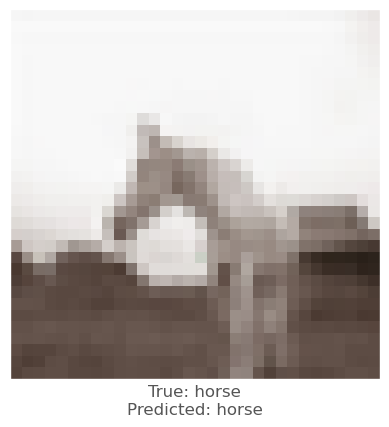



-0.0005733967
-0.0010434389
0.0007058382
vr, vg, vb :   -0.23042067497455687 0.9595971096009283 0.32617320407958117
beam_perturbed_confidence temp :  0.6522202
beam_perturbed_confidence temp :  0.65155876
beam_perturbed_confidence temp :  0.65155876
beam_perturbed_confidence temp :  0.6522202
beam_perturbed_confidence temp :  0.6522202
beam_perturbed_confidence temp :  0.65155876
beam_perturbed_confidence temp :  0.6522202
row index :  1
22th round's confidence : 3th 0.65155876
predicted class :  horse
predicted class's confidence :  0.65155876
Lopt is :  19


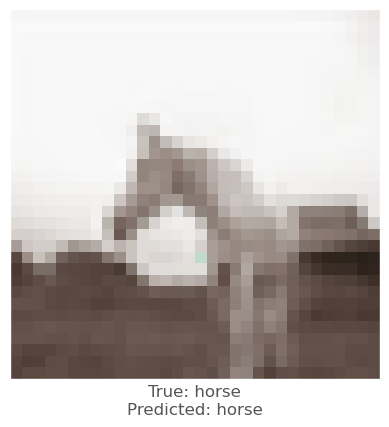



-0.0010730624
-0.001816392
-0.0002297759
vr, vg, vb :   0.5093999590643843 1.082867945918442 0.4288757903012913
beam_perturbed_confidence temp :  0.66259557
beam_perturbed_confidence temp :  0.66162884
beam_perturbed_confidence temp :  0.66259557
beam_perturbed_confidence temp :  0.66162884
beam_perturbed_confidence temp :  0.66259557
beam_perturbed_confidence temp :  0.66162884
beam_perturbed_confidence temp :  0.66162884
row index :  1
22th round's confidence : 4th 0.66162884
predicted class :  horse
predicted class's confidence :  0.66162884
Lopt is :  12


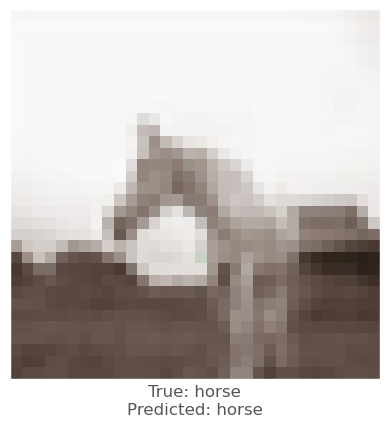



0.00046026707
4.9233437e-05
0.0006109476
vr, vg, vb :   -0.36337762806860974 0.6601754063276727 0.38963737438617085
beam_perturbed_confidence temp :  0.65296334
beam_perturbed_confidence temp :  0.65256375
beam_perturbed_confidence temp :  0.65256375
beam_perturbed_confidence temp :  0.65296334
beam_perturbed_confidence temp :  0.65296334
beam_perturbed_confidence temp :  0.65256375
beam_perturbed_confidence temp :  0.65296334
row index :  1
23th round's confidence : 0th 0.65256375
predicted class :  horse
predicted class's confidence :  0.65256375
Lopt is :  16


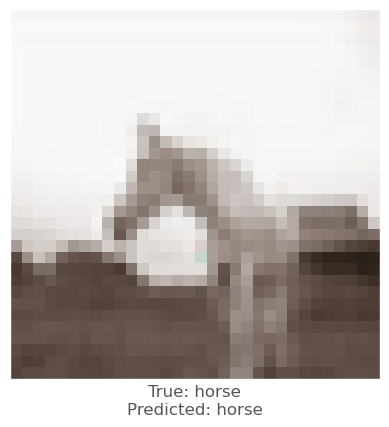



0.00027561188
-0.00020009279
-3.7372112e-05
vr, vg, vb :   0.3855444050061041 0.9267781958852486 0.7292055995319925
beam_perturbed_confidence temp :  0.66251147
beam_perturbed_confidence temp :  0.66251147
beam_perturbed_confidence temp :  0.66251147
beam_perturbed_confidence temp :  0.66251147
beam_perturbed_confidence temp :  0.66251147
beam_perturbed_confidence temp :  0.66251147
beam_perturbed_confidence temp :  0.66251147
row index :  0
23th round's confidence : 1th 0.66251147
predicted class :  horse
predicted class's confidence :  0.66251147
Lopt is :  9


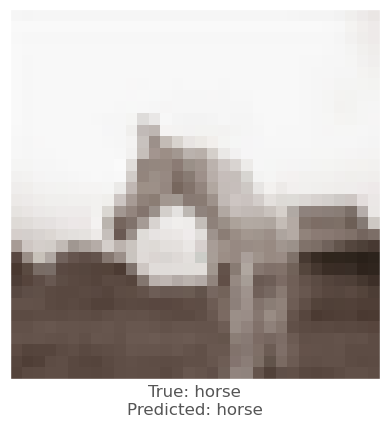



0.00034546852
-0.0019736886
-0.0009806156
vr, vg, vb :   -0.25594107477244543 1.1302222647543254 0.8469318378609716
beam_perturbed_confidence temp :  0.66182643
beam_perturbed_confidence temp :  0.66037303
beam_perturbed_confidence temp :  0.6617326
beam_perturbed_confidence temp :  0.66045
beam_perturbed_confidence temp :  0.66182643
beam_perturbed_confidence temp :  0.66037303
beam_perturbed_confidence temp :  0.66045
row index :  1
23th round's confidence : 2th 0.66037303
predicted class :  horse
predicted class's confidence :  0.66037303
Lopt is :  10


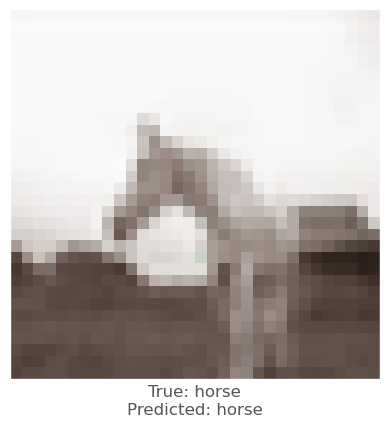



-0.0005733967
-0.0010434389
0.0007058382
vr, vg, vb :   -0.1500389392031754 0.9679812897846343 0.22297206332860547
beam_perturbed_confidence temp :  0.6522202
beam_perturbed_confidence temp :  0.65155876
beam_perturbed_confidence temp :  0.65155876
beam_perturbed_confidence temp :  0.6522202
beam_perturbed_confidence temp :  0.6522202
beam_perturbed_confidence temp :  0.65155876
beam_perturbed_confidence temp :  0.6522202
row index :  1
23th round's confidence : 3th 0.65155876
predicted class :  horse
predicted class's confidence :  0.65155876
Lopt is :  19


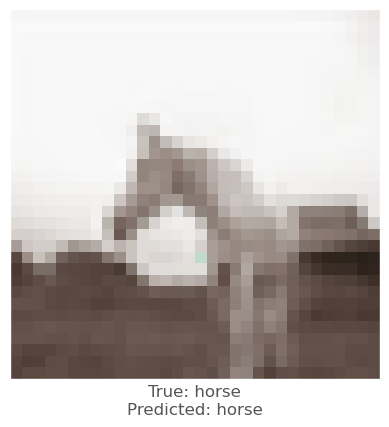



-0.001260221
-0.0020295978
-0.0005454421
vr, vg, vb :   0.5844820636065542 1.1775409272512805 0.44053242170512213
beam_perturbed_confidence temp :  0.66162884
beam_perturbed_confidence temp :  0.660566
beam_perturbed_confidence temp :  0.66162884
beam_perturbed_confidence temp :  0.660566
beam_perturbed_confidence temp :  0.66162884
beam_perturbed_confidence temp :  0.660566
beam_perturbed_confidence temp :  0.660566
row index :  1
23th round's confidence : 4th 0.660566
predicted class :  horse
predicted class's confidence :  0.660566
Lopt is :  12


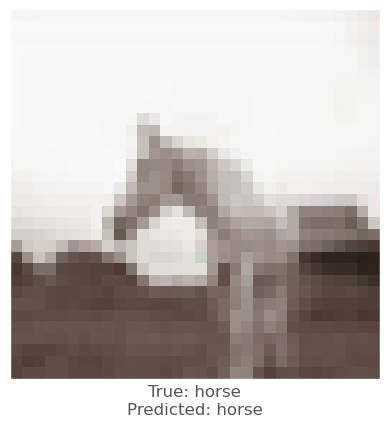



0.00046026707
4.9233437e-05
0.0006109476
vr, vg, vb :   -0.3730665719573054 0.5892345220364582 0.2895788760527784
beam_perturbed_confidence temp :  0.65296334
beam_perturbed_confidence temp :  0.65256375
beam_perturbed_confidence temp :  0.65256375
beam_perturbed_confidence temp :  0.65296334
beam_perturbed_confidence temp :  0.65296334
beam_perturbed_confidence temp :  0.65256375
beam_perturbed_confidence temp :  0.65296334
row index :  1
24th round's confidence : 0th 0.65256375
predicted class :  horse
predicted class's confidence :  0.65256375
Lopt is :  16


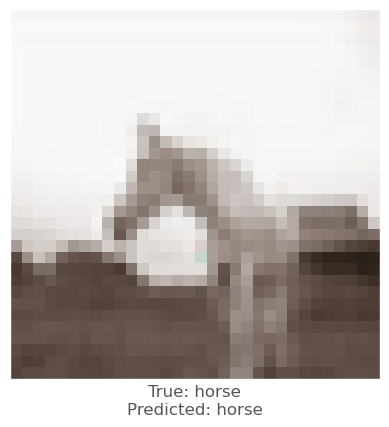



0.00027561188
-0.00020009279
-3.7372112e-05
vr, vg, vb :   0.31942877676135306 0.8541096555478224 0.6600222508062102
beam_perturbed_confidence temp :  0.66251147
beam_perturbed_confidence temp :  0.66251147
beam_perturbed_confidence temp :  0.66251147
beam_perturbed_confidence temp :  0.66251147
beam_perturbed_confidence temp :  0.66251147
beam_perturbed_confidence temp :  0.66251147
beam_perturbed_confidence temp :  0.66251147
row index :  0
24th round's confidence : 1th 0.66251147
predicted class :  horse
predicted class's confidence :  0.66251147
Lopt is :  9


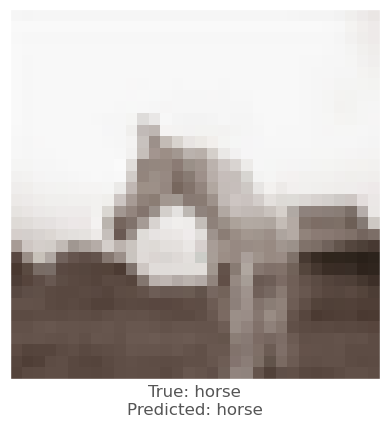



0.00016748905
-0.0026459098
-0.0014905334
vr, vg, vb :   -0.24709587247708567 1.2817910169013293 0.9112919892646938
beam_perturbed_confidence temp :  0.66045
beam_perturbed_confidence temp :  0.6590867
beam_perturbed_confidence temp :  0.66037303
beam_perturbed_confidence temp :  0.65932304
beam_perturbed_confidence temp :  0.66045
beam_perturbed_confidence temp :  0.6590867
beam_perturbed_confidence temp :  0.65932304
row index :  1
24th round's confidence : 2th 0.6590867
predicted class :  horse
predicted class's confidence :  0.6590867
Lopt is :  10


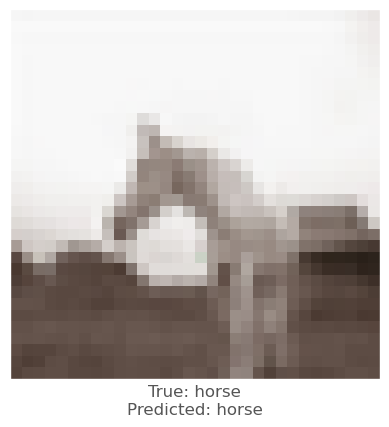



-0.0005733967
-0.0010434389
0.0007058382
vr, vg, vb :   -0.07769537700893209 0.9755270519499697 0.13009103665272737
beam_perturbed_confidence temp :  0.6522202
beam_perturbed_confidence temp :  0.65155876
beam_perturbed_confidence temp :  0.65155876
beam_perturbed_confidence temp :  0.6522202
beam_perturbed_confidence temp :  0.6522202
beam_perturbed_confidence temp :  0.65155876
beam_perturbed_confidence temp :  0.6522202
row index :  1
24th round's confidence : 3th 0.65155876
predicted class :  horse
predicted class's confidence :  0.65155876
Lopt is :  19


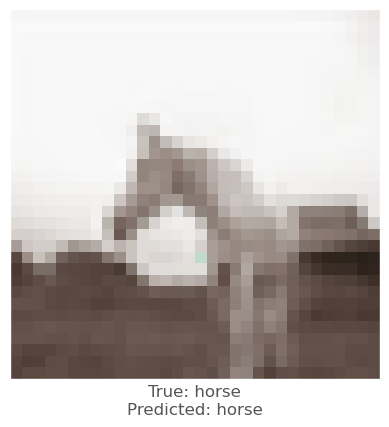



-0.0016105771
-0.0024533272
-0.0006840229
vr, vg, vb :   0.6870915678934818 1.3051195524216603 0.4648814698788482
beam_perturbed_confidence temp :  0.660566
beam_perturbed_confidence temp :  0.6591755
beam_perturbed_confidence temp :  0.660566
beam_perturbed_confidence temp :  0.6591755
beam_perturbed_confidence temp :  0.660566
beam_perturbed_confidence temp :  0.6591755
beam_perturbed_confidence temp :  0.6591755
row index :  1
24th round's confidence : 4th 0.6591755
predicted class :  horse
predicted class's confidence :  0.6591755
Lopt is :  12


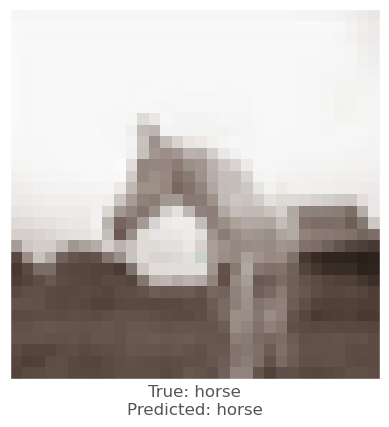



0.00046026707
4.9233437e-05
0.0006109476
vr, vg, vb :   -0.38178662145713155 0.5253877261743651 0.19952622755272514
beam_perturbed_confidence temp :  0.65296334
beam_perturbed_confidence temp :  0.65256375
beam_perturbed_confidence temp :  0.65256375
beam_perturbed_confidence temp :  0.65296334
beam_perturbed_confidence temp :  0.65296334
beam_perturbed_confidence temp :  0.65256375
beam_perturbed_confidence temp :  0.65296334
row index :  1
25th round's confidence : 0th 0.65256375
predicted class :  horse
predicted class's confidence :  0.65256375
Lopt is :  16


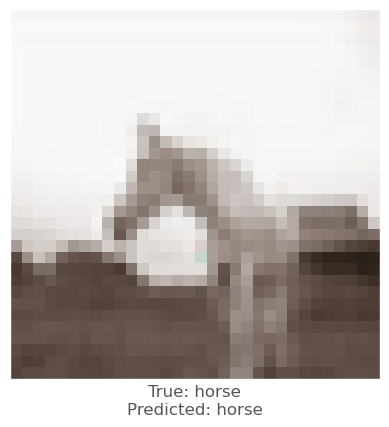



0.00027561188
-0.00020009279
-3.7372112e-05
vr, vg, vb :   0.25992471134107714 0.7887079692441388 0.5977572369530062
beam_perturbed_confidence temp :  0.66251147
beam_perturbed_confidence temp :  0.66251147
beam_perturbed_confidence temp :  0.66251147
beam_perturbed_confidence temp :  0.66251147
beam_perturbed_confidence temp :  0.66251147
beam_perturbed_confidence temp :  0.66251147
beam_perturbed_confidence temp :  0.66251147
row index :  0
25th round's confidence : 1th 0.66251147
predicted class :  horse
predicted class's confidence :  0.66251147
Lopt is :  9


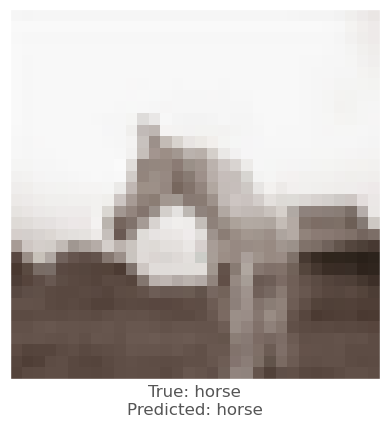



-0.00020259619
-0.0023839474
-0.0010792613
vr, vg, vb :   -0.20212666647022184 1.392006652454849 0.9280889206330243
beam_perturbed_confidence temp :  0.65932304
beam_perturbed_confidence temp :  0.6579891
beam_perturbed_confidence temp :  0.6590867
beam_perturbed_confidence temp :  0.65824836
beam_perturbed_confidence temp :  0.65932304
beam_perturbed_confidence temp :  0.6579891
beam_perturbed_confidence temp :  0.65824836
row index :  1
25th round's confidence : 2th 0.6579891
predicted class :  horse
predicted class's confidence :  0.6579891
Lopt is :  10


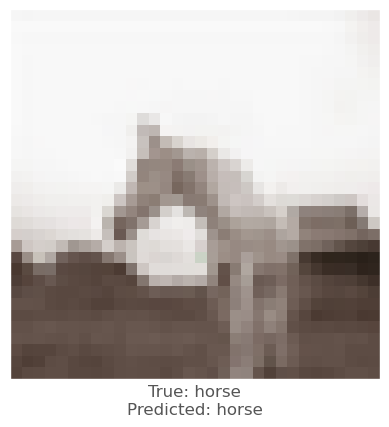



-0.0005733967
-0.0010434389
0.0007058382
vr, vg, vb :   -0.012586171034113094 0.9823182378987716 0.046498112644437053
beam_perturbed_confidence temp :  0.6522202
beam_perturbed_confidence temp :  0.65155876
beam_perturbed_confidence temp :  0.65155876
beam_perturbed_confidence temp :  0.6522202
beam_perturbed_confidence temp :  0.6522202
beam_perturbed_confidence temp :  0.65155876
beam_perturbed_confidence temp :  0.6522202
row index :  1
25th round's confidence : 3th 0.65155876
predicted class :  horse
predicted class's confidence :  0.65155876
Lopt is :  19


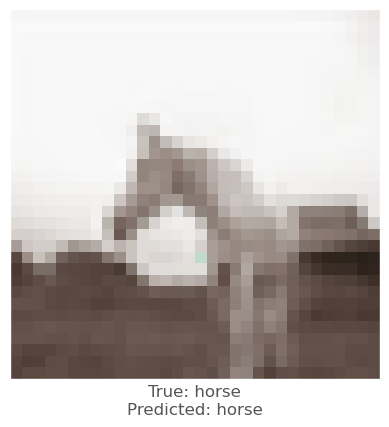



-0.0011283159
-0.0027357936
-0.00078320503
vr, vg, vb :   0.7312140036639481 1.4481869562340597 0.49671382612582665
beam_perturbed_confidence temp :  0.6591755
beam_perturbed_confidence temp :  0.6578302
beam_perturbed_confidence temp :  0.6591755
beam_perturbed_confidence temp :  0.6578302
beam_perturbed_confidence temp :  0.6591755
beam_perturbed_confidence temp :  0.6578302
beam_perturbed_confidence temp :  0.6578302
row index :  1
25th round's confidence : 4th 0.6578302
predicted class :  horse
predicted class's confidence :  0.6578302
Lopt is :  12


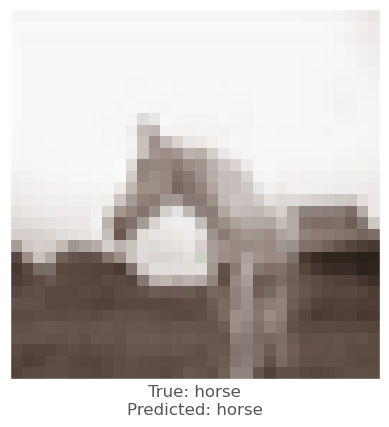



0.00046026707
4.9233437e-05
0.0006109476
vr, vg, vb :   -0.38963466600697505 0.46792560989848136 0.11847884390267724
beam_perturbed_confidence temp :  0.65296334
beam_perturbed_confidence temp :  0.65256375
beam_perturbed_confidence temp :  0.65256375
beam_perturbed_confidence temp :  0.65296334
beam_perturbed_confidence temp :  0.65296334
beam_perturbed_confidence temp :  0.65256375
beam_perturbed_confidence temp :  0.65296334
row index :  1
26th round's confidence : 0th 0.65256375
predicted class :  horse
predicted class's confidence :  0.65256375
Lopt is :  16


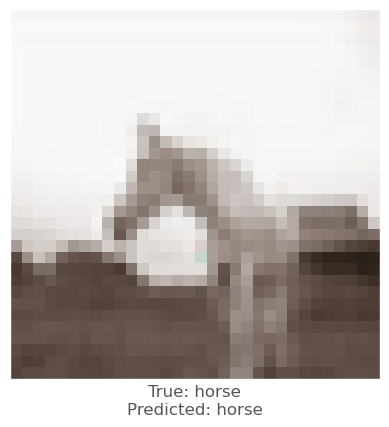



0.00027561188
-0.00020009279
-3.7372112e-05
vr, vg, vb :   0.2063710524628288 0.7298464515708235 0.5417187244851226
beam_perturbed_confidence temp :  0.66251147
beam_perturbed_confidence temp :  0.66251147
beam_perturbed_confidence temp :  0.66251147
beam_perturbed_confidence temp :  0.66251147
beam_perturbed_confidence temp :  0.66251147
beam_perturbed_confidence temp :  0.66251147
beam_perturbed_confidence temp :  0.66251147
row index :  0
26th round's confidence : 1th 0.66251147
predicted class :  horse
predicted class's confidence :  0.66251147
Lopt is :  9


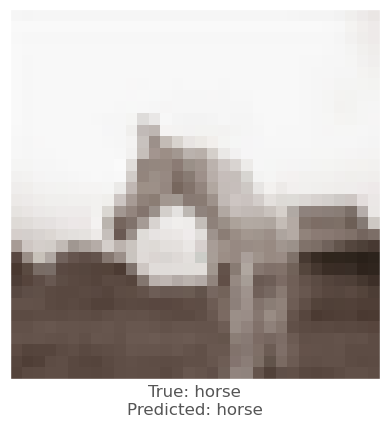



-0.00075250864
-0.0021990538
-0.0011641979
vr, vg, vb :   -0.106663135794269 1.4727113636436902 0.9516998207450148
beam_perturbed_confidence temp :  0.65824836
beam_perturbed_confidence temp :  0.65688765
beam_perturbed_confidence temp :  0.6579891
beam_perturbed_confidence temp :  0.65707093
beam_perturbed_confidence temp :  0.65824836
beam_perturbed_confidence temp :  0.65688765
beam_perturbed_confidence temp :  0.65707093
row index :  1
26th round's confidence : 2th 0.65688765
predicted class :  horse
predicted class's confidence :  0.65688765
Lopt is :  10


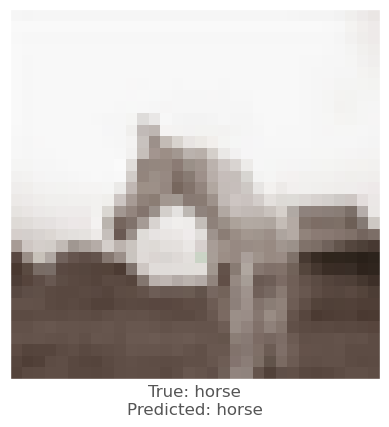



-0.0005733967
-0.0010434389
0.0007058382
vr, vg, vb :   0.046012114343224 0.9884303052526933 -0.02873551896302423
beam_perturbed_confidence temp :  0.65155876
beam_perturbed_confidence temp :  0.65155876
beam_perturbed_confidence temp :  0.6516108
beam_perturbed_confidence temp :  0.65155876
beam_perturbed_confidence temp :  0.6516108
beam_perturbed_confidence temp :  0.6516108
beam_perturbed_confidence temp :  0.6516108
row index :  0
26th round's confidence : 3th 0.65155876
predicted class :  horse
predicted class's confidence :  0.65155876
Lopt is :  19


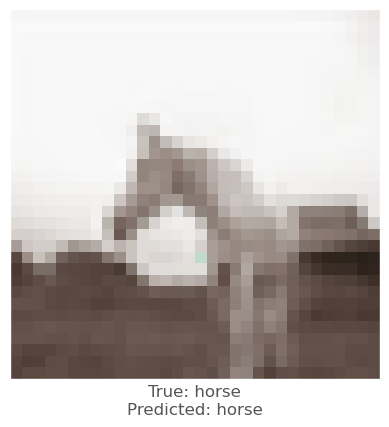



-0.00088608265
-0.0027240515
-0.00044804811
vr, vg, vb :   0.746700868220649 1.575773408163144 0.49184725499090515
beam_perturbed_confidence temp :  0.6578302
beam_perturbed_confidence temp :  0.65645146
beam_perturbed_confidence temp :  0.6578302
beam_perturbed_confidence temp :  0.65645146
beam_perturbed_confidence temp :  0.6578302
beam_perturbed_confidence temp :  0.65645146
beam_perturbed_confidence temp :  0.65645146
row index :  1
26th round's confidence : 4th 0.65645146
predicted class :  horse
predicted class's confidence :  0.65645146
Lopt is :  12


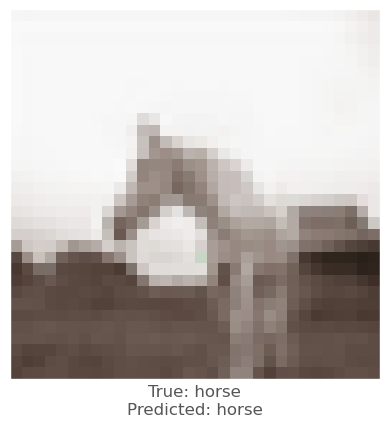



0.00046026707
4.9233437e-05
0.0006109476
vr, vg, vb :   -0.3966979061018342 0.41620970525018597 0.045536198617634124
beam_perturbed_confidence temp :  0.65296334
beam_perturbed_confidence temp :  0.65256375
beam_perturbed_confidence temp :  0.65256375
beam_perturbed_confidence temp :  0.65296334
beam_perturbed_confidence temp :  0.65296334
beam_perturbed_confidence temp :  0.65256375
beam_perturbed_confidence temp :  0.65296334
row index :  1
27th round's confidence : 0th 0.65256375
predicted class :  horse
predicted class's confidence :  0.65256375
Lopt is :  16


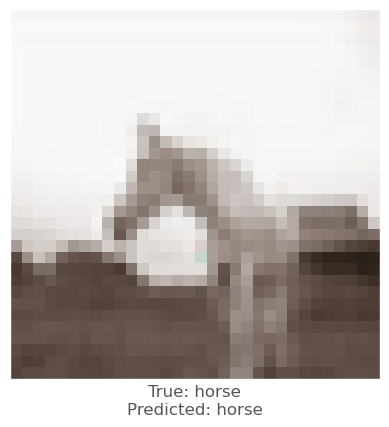



0.00027561188
-0.00020009279
-3.7372112e-05
vr, vg, vb :   0.1581727594724053 0.6768710856648398 0.49128406326402735
beam_perturbed_confidence temp :  0.66251147
beam_perturbed_confidence temp :  0.66251147
beam_perturbed_confidence temp :  0.66251147
beam_perturbed_confidence temp :  0.66251147
beam_perturbed_confidence temp :  0.66251147
beam_perturbed_confidence temp :  0.66251147
beam_perturbed_confidence temp :  0.66251147
row index :  0
27th round's confidence : 1th 0.66251147
predicted class :  horse
predicted class's confidence :  0.66251147
Lopt is :  9


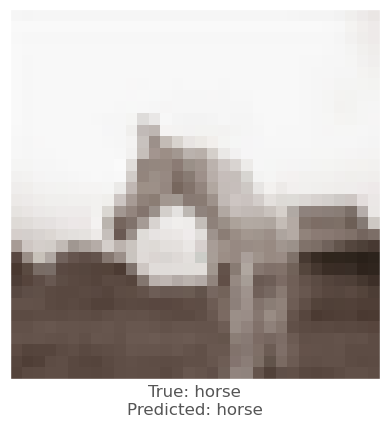



0.0012295246
5.197525e-05
0.00027936697
vr, vg, vb :   -0.2189492834575179 1.320242702254907 0.8285931416642878
beam_perturbed_confidence temp :  0.65707093
beam_perturbed_confidence temp :  0.65804106
beam_perturbed_confidence temp :  0.65688765
beam_perturbed_confidence temp :  0.65693873
beam_perturbed_confidence temp :  0.65707093
beam_perturbed_confidence temp :  0.65804106
beam_perturbed_confidence temp :  0.65693873
row index :  2
27th round's confidence : 2th 0.65688765
predicted class :  horse
predicted class's confidence :  0.65688765
Lopt is :  10


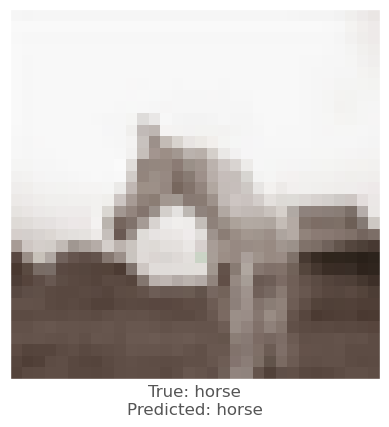



-0.0005733967
-0.0010434389
0.0007058382
vr, vg, vb :   0.09875057118282737 0.9939311658712228 -0.09644578740973939
beam_perturbed_confidence temp :  0.65155876
beam_perturbed_confidence temp :  0.65155876
beam_perturbed_confidence temp :  0.6516108
beam_perturbed_confidence temp :  0.65155876
beam_perturbed_confidence temp :  0.6516108
beam_perturbed_confidence temp :  0.6516108
beam_perturbed_confidence temp :  0.6516108
row index :  0
27th round's confidence : 3th 0.65155876
predicted class :  horse
predicted class's confidence :  0.65155876
Lopt is :  19


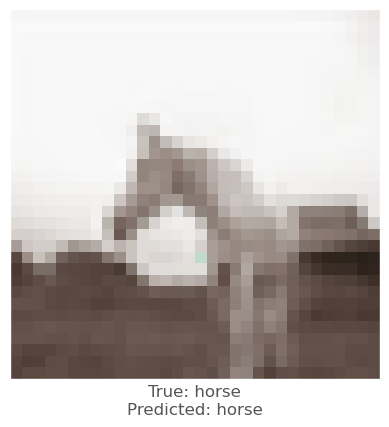



-0.0008254647
-0.0019162893
-0.00028586388
vr, vg, vb :   0.7545772539480226 1.6098250002997105 0.47124891712609196
beam_perturbed_confidence temp :  0.65645146
beam_perturbed_confidence temp :  0.6559139
beam_perturbed_confidence temp :  0.65645146
beam_perturbed_confidence temp :  0.6559139
beam_perturbed_confidence temp :  0.65645146
beam_perturbed_confidence temp :  0.6559139
beam_perturbed_confidence temp :  0.6559139
row index :  1
27th round's confidence : 4th 0.6559139
predicted class :  horse
predicted class's confidence :  0.6559139
Lopt is :  12


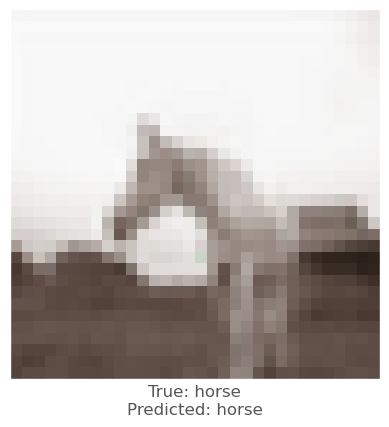



0.00046026707
4.9233437e-05
0.0006109476
vr, vg, vb :   -0.40305482218720745 0.36966539106672014 -0.02011218213890468
beam_perturbed_confidence temp :  0.65296334
beam_perturbed_confidence temp :  0.65256375
beam_perturbed_confidence temp :  0.65288717
beam_perturbed_confidence temp :  0.65296334
beam_perturbed_confidence temp :  0.6538446
beam_perturbed_confidence temp :  0.65288717
beam_perturbed_confidence temp :  0.6538446
row index :  1
28th round's confidence : 0th 0.65256375
predicted class :  horse
predicted class's confidence :  0.65256375
Lopt is :  16


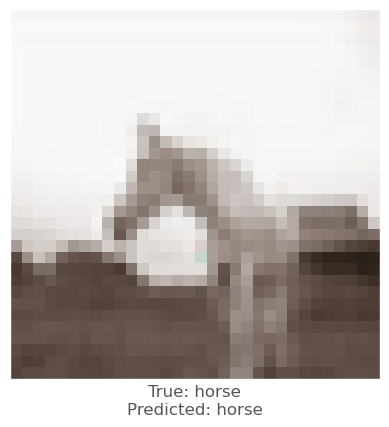



0.00027561188
-0.00020009279
-3.7372112e-05
vr, vg, vb :   0.11479429578102415 0.6291932563494544 0.4458928681650416
beam_perturbed_confidence temp :  0.66251147
beam_perturbed_confidence temp :  0.66251147
beam_perturbed_confidence temp :  0.66251147
beam_perturbed_confidence temp :  0.66251147
beam_perturbed_confidence temp :  0.66251147
beam_perturbed_confidence temp :  0.66251147
beam_perturbed_confidence temp :  0.66251147
row index :  0
28th round's confidence : 1th 0.66251147
predicted class :  horse
predicted class's confidence :  0.66251147
Lopt is :  9


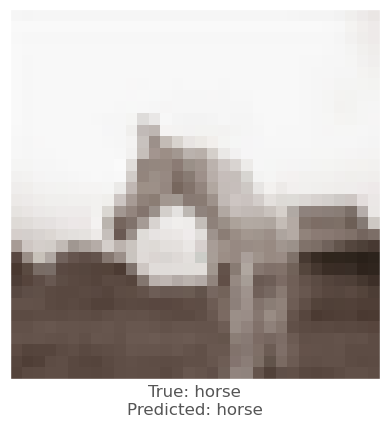



0.0012295246
5.197525e-05
0.00027936697
vr, vg, vb :   -0.3200068163544419 1.1830209070050024 0.7177971304916334
beam_perturbed_confidence temp :  0.65707093
beam_perturbed_confidence temp :  0.65804106
beam_perturbed_confidence temp :  0.65688765
beam_perturbed_confidence temp :  0.65693873
beam_perturbed_confidence temp :  0.65707093
beam_perturbed_confidence temp :  0.65804106
beam_perturbed_confidence temp :  0.65693873
row index :  2
28th round's confidence : 2th 0.65688765
predicted class :  horse
predicted class's confidence :  0.65688765
Lopt is :  10


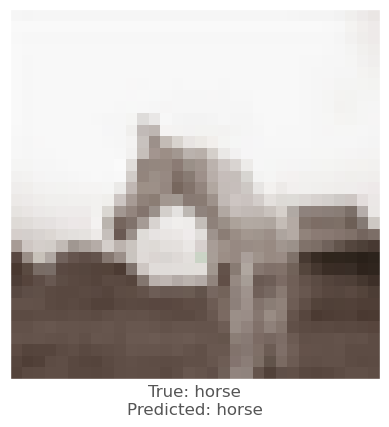



-0.0005733967
-0.0010434389
0.0007058382
vr, vg, vb :   0.14621518233847042 0.9988819404278994 -0.15738502901178303
beam_perturbed_confidence temp :  0.65155876
beam_perturbed_confidence temp :  0.65155876
beam_perturbed_confidence temp :  0.6516108
beam_perturbed_confidence temp :  0.65155876
beam_perturbed_confidence temp :  0.6516108
beam_perturbed_confidence temp :  0.6516108
beam_perturbed_confidence temp :  0.6516108
row index :  0
28th round's confidence : 3th 0.65155876
predicted class :  horse
predicted class's confidence :  0.65155876
Lopt is :  19


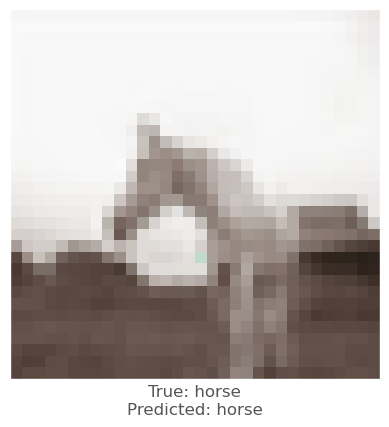



0.0018398166
0.00025182962
0.0009809136
vr, vg, vb :   0.4951378715250221 1.423659537852137 0.3260326615066224
beam_perturbed_confidence temp :  0.6559139
beam_perturbed_confidence temp :  0.6567033
beam_perturbed_confidence temp :  0.6559139
beam_perturbed_confidence temp :  0.6567033
beam_perturbed_confidence temp :  0.6559139
beam_perturbed_confidence temp :  0.6567033
beam_perturbed_confidence temp :  0.6567033
row index :  0
28th round's confidence : 4th 0.6559139
predicted class :  horse
predicted class's confidence :  0.6559139
Lopt is :  12


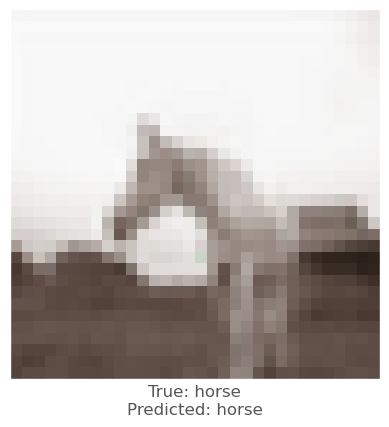



0.00046026707
4.9233437e-05
0.0006109476
vr, vg, vb :   -0.4087760466640434 0.32777550830160085 -0.0791957248197896
beam_perturbed_confidence temp :  0.65296334
beam_perturbed_confidence temp :  0.65256375
beam_perturbed_confidence temp :  0.65288717
beam_perturbed_confidence temp :  0.65296334
beam_perturbed_confidence temp :  0.6538446
beam_perturbed_confidence temp :  0.65288717
beam_perturbed_confidence temp :  0.6538446
row index :  1
29th round's confidence : 0th 0.65256375
predicted class :  horse
predicted class's confidence :  0.65256375
Lopt is :  16


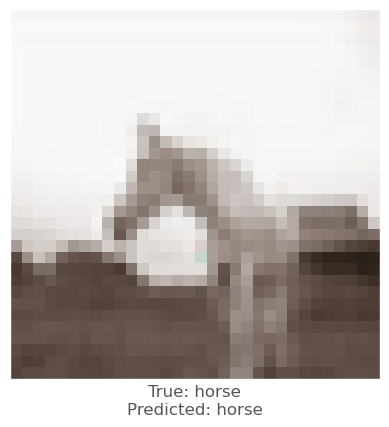



0.00027561188
-0.00020009279
-3.7372112e-05
vr, vg, vb :   0.07575367845878112 0.5862832099656077 0.40504079257595443
beam_perturbed_confidence temp :  0.66251147
beam_perturbed_confidence temp :  0.66251147
beam_perturbed_confidence temp :  0.66251147
beam_perturbed_confidence temp :  0.66251147
beam_perturbed_confidence temp :  0.66251147
beam_perturbed_confidence temp :  0.66251147
beam_perturbed_confidence temp :  0.66251147
row index :  0
29th round's confidence : 1th 0.66251147
predicted class :  horse
predicted class's confidence :  0.66251147
Lopt is :  9


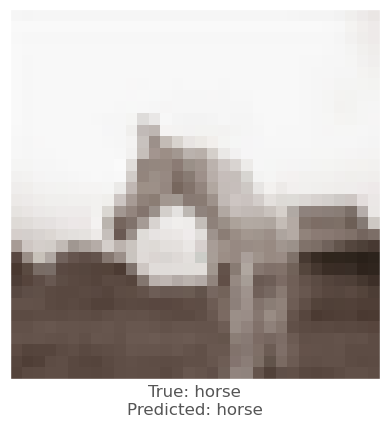



0.0012295246
5.197525e-05
0.00027936697
vr, vg, vb :   -0.4109585959616735 1.0595212912800882 0.6180807204362445
beam_perturbed_confidence temp :  0.65707093
beam_perturbed_confidence temp :  0.65804106
beam_perturbed_confidence temp :  0.65688765
beam_perturbed_confidence temp :  0.65693873
beam_perturbed_confidence temp :  0.65707093
beam_perturbed_confidence temp :  0.65804106
beam_perturbed_confidence temp :  0.65693873
row index :  2
29th round's confidence : 2th 0.65688765
predicted class :  horse
predicted class's confidence :  0.65688765
Lopt is :  10


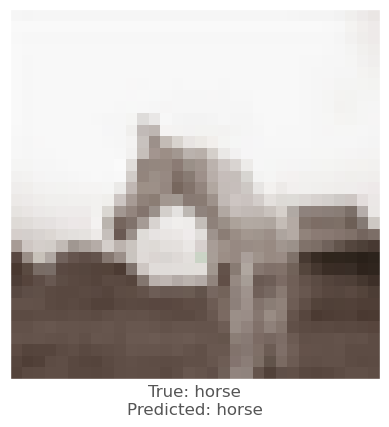



-0.0005733967
-0.0010434389
0.0007058382
vr, vg, vb :   0.18893333237854917 1.0033376375289083 -0.21223034645362232
beam_perturbed_confidence temp :  0.65155876
beam_perturbed_confidence temp :  0.6517712
beam_perturbed_confidence temp :  0.6516108
beam_perturbed_confidence temp :  0.6517712
beam_perturbed_confidence temp :  0.6516108
beam_perturbed_confidence temp :  0.6508282
beam_perturbed_confidence temp :  0.6508282
row index :  5
29th round's confidence : 3th 0.6508282
predicted class :  horse
predicted class's confidence :  0.6508282
Lopt is :  19


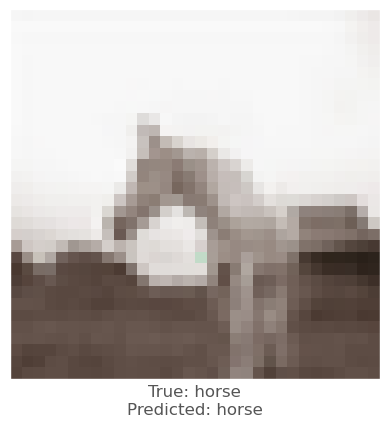



0.0018398166
0.00025182962
0.0009809136
vr, vg, vb :   0.26164242734432164 1.2561106216493207 0.19533803144909984
beam_perturbed_confidence temp :  0.6559139
beam_perturbed_confidence temp :  0.6567033
beam_perturbed_confidence temp :  0.6559139
beam_perturbed_confidence temp :  0.6567033
beam_perturbed_confidence temp :  0.6559139
beam_perturbed_confidence temp :  0.6567033
beam_perturbed_confidence temp :  0.6567033
row index :  0
29th round's confidence : 4th 0.6559139
predicted class :  horse
predicted class's confidence :  0.6559139
Lopt is :  12


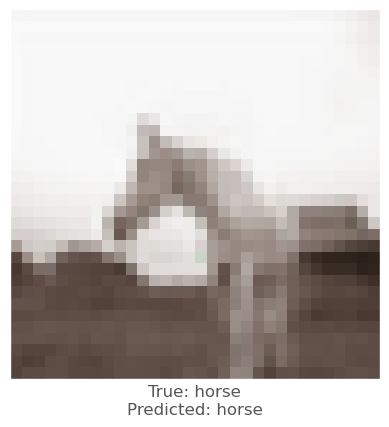






26th sensitive pixel
original confidence is :  0.69673544 

original r,g,b :  238 236 234
0.0043697357
0.007696867
0.00011354685
vr, vg, vb :   -0.43697357177734375 -0.7696866989135742 -0.011354684829711914
beam_perturbed_confidence temp :  0.69456816
beam_perturbed_confidence temp :  0.6926788
beam_perturbed_confidence temp :  0.69663036
beam_perturbed_confidence temp :  0.69079614
beam_perturbed_confidence temp :  0.69446087
beam_perturbed_confidence temp :  0.69258684
beam_perturbed_confidence temp :  0.69069976
row index :  6
0th round's confidence : 0th 0.69069976
predicted class :  horse
predicted class's confidence :  0.69069976
Lopt is :  1


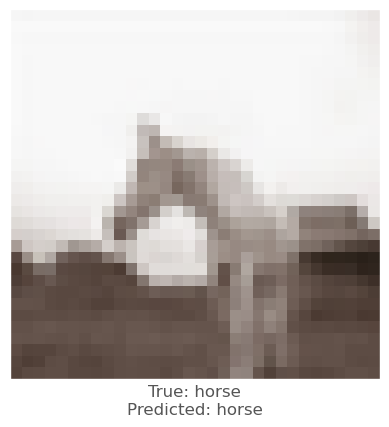



0.0039947033
0.0036236048
-0.0015253425
vr, vg, vb :   -0.39947032928466797 -0.36236047744750977 0.15253424644470215
beam_perturbed_confidence temp :  0.6734227
beam_perturbed_confidence temp :  0.6736366
beam_perturbed_confidence temp :  0.67539006
beam_perturbed_confidence temp :  0.6710387
beam_perturbed_confidence temp :  0.6734227
beam_perturbed_confidence temp :  0.6736366
beam_perturbed_confidence temp :  0.6710387
row index :  3
0th round's confidence : 1th 0.6710387
predicted class :  horse
predicted class's confidence :  0.6710387
Lopt is :  6


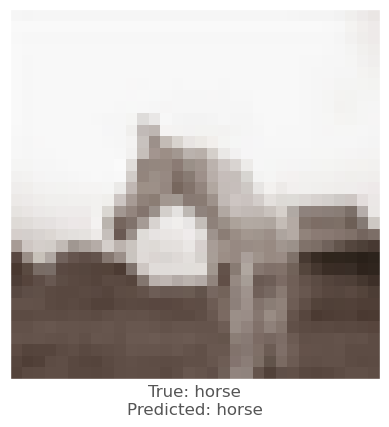



-0.0014094114
0.0019236803
-0.00442034
vr, vg, vb :   0.14094114303588867 -0.1923680305480957 0.4420340061187744
beam_perturbed_confidence temp :  0.70652884
beam_perturbed_confidence temp :  0.70561796
beam_perturbed_confidence temp :  0.70652884
beam_perturbed_confidence temp :  0.70561796
beam_perturbed_confidence temp :  0.70652884
beam_perturbed_confidence temp :  0.70561796
beam_perturbed_confidence temp :  0.70561796
row index :  1
0th round's confidence : 2th 0.70561796
predicted class :  horse
predicted class's confidence :  0.70561796
Lopt is :  5


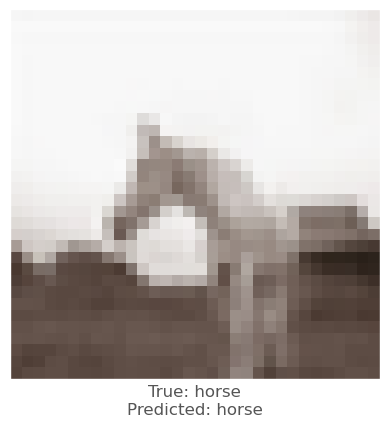



0.010240793
0.012201548
0.0044973493
vr, vg, vb :   -1.0240793228149414 -1.2201547622680664 -0.4497349262237549
beam_perturbed_confidence temp :  0.62602943
beam_perturbed_confidence temp :  0.6225294
beam_perturbed_confidence temp :  0.63593566
beam_perturbed_confidence temp :  0.61120147
beam_perturbed_confidence temp :  0.6233048
beam_perturbed_confidence temp :  0.6204243
beam_perturbed_confidence temp :  0.61027735
row index :  6
0th round's confidence : 3th 0.61027735
predicted class :  horse
predicted class's confidence :  0.61027735
Lopt is :  12


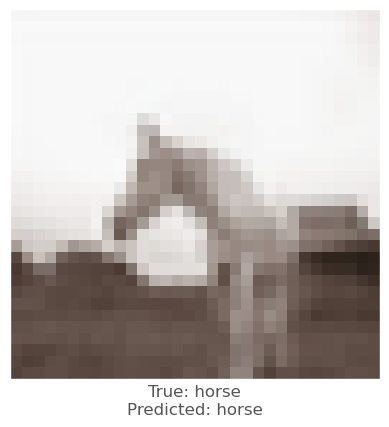



-4.5657158e-05
0.0032639503
-0.0029457211
vr, vg, vb :   0.004565715789794922 -0.32639503479003906 0.294572114944458
beam_perturbed_confidence temp :  0.7038435
beam_perturbed_confidence temp :  0.7019966
beam_perturbed_confidence temp :  0.7038435
beam_perturbed_confidence temp :  0.7019966
beam_perturbed_confidence temp :  0.7038435
beam_perturbed_confidence temp :  0.7019966
beam_perturbed_confidence temp :  0.7019966
row index :  1
0th round's confidence : 4th 0.7019966
predicted class :  horse
predicted class's confidence :  0.7019966
Lopt is :  10


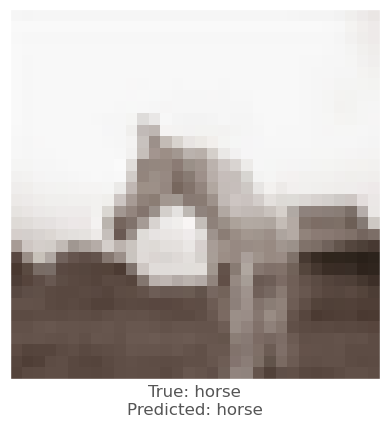



0.004130125
0.0073364973
0.00063222647
vr, vg, vb :   -0.8062887191772461 -1.4263677597045898 -0.07344186305999756
beam_perturbed_confidence temp :  0.6884567
beam_perturbed_confidence temp :  0.6840845
beam_perturbed_confidence temp :  0.6901639
beam_perturbed_confidence temp :  0.6827461
beam_perturbed_confidence temp :  0.68832225
beam_perturbed_confidence temp :  0.6839091
beam_perturbed_confidence temp :  0.6830403
row index :  3
1th round's confidence : 0th 0.6827461
predicted class :  horse
predicted class's confidence :  0.6827461
Lopt is :  3


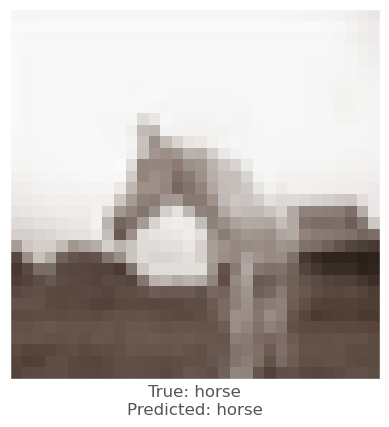



0.004593909
0.0042428374
-0.00085258484
vr, vg, vb :   -0.8189141750335693 -0.7504081726074219 0.22253930568695068
beam_perturbed_confidence temp :  0.6690427
beam_perturbed_confidence temp :  0.66917986
beam_perturbed_confidence temp :  0.6710387
beam_perturbed_confidence temp :  0.66653246
beam_perturbed_confidence temp :  0.6690427
beam_perturbed_confidence temp :  0.66917986
beam_perturbed_confidence temp :  0.66653246
row index :  3
1th round's confidence : 1th 0.66653246
predicted class :  horse
predicted class's confidence :  0.66653246
Lopt is :  7


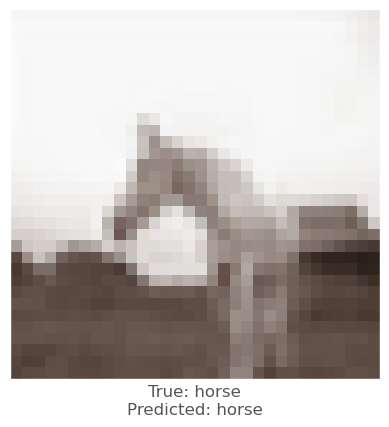



-0.0017513037
0.0022461414
-0.0045254827
vr, vg, vb :   0.30197739601135254 -0.39774537086486816 0.8503788709640503
beam_perturbed_confidence temp :  0.70561796
beam_perturbed_confidence temp :  0.7042827
beam_perturbed_confidence temp :  0.70561796
beam_perturbed_confidence temp :  0.7042827
beam_perturbed_confidence temp :  0.70561796
beam_perturbed_confidence temp :  0.7042827
beam_perturbed_confidence temp :  0.7042827
row index :  1
1th round's confidence : 2th 0.7042827
predicted class :  horse
predicted class's confidence :  0.7042827
Lopt is :  5


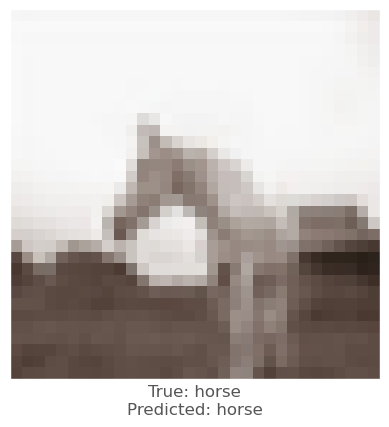



0.0098801255
0.011673331
0.0017756224
vr, vg, vb :   -1.9096839427947998 -2.265472412109375 -0.5823236703872681
beam_perturbed_confidence temp :  0.6008793
beam_perturbed_confidence temp :  0.5928292
beam_perturbed_confidence temp :  0.60942584
beam_perturbed_confidence temp :  0.59023
beam_perturbed_confidence temp :  0.60018677
beam_perturbed_confidence temp :  0.5935567
beam_perturbed_confidence temp :  0.59183455
row index :  3
1th round's confidence : 3th 0.59023
predicted class :  horse
predicted class's confidence :  0.59023
Lopt is :  15


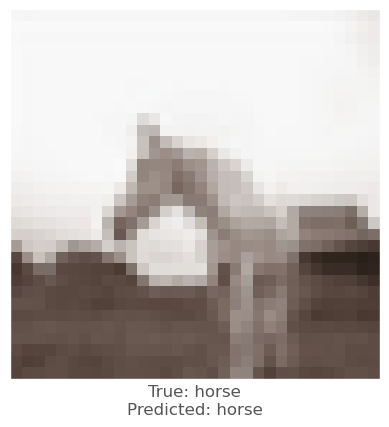



-0.00083237886
0.0037583709
-0.002827227
vr, vg, vb :   0.08734703063964844 -0.6695926189422607 0.5478376150131226
beam_perturbed_confidence temp :  0.7019966
beam_perturbed_confidence temp :  0.7000851
beam_perturbed_confidence temp :  0.7019966
beam_perturbed_confidence temp :  0.7000851
beam_perturbed_confidence temp :  0.7019966
beam_perturbed_confidence temp :  0.7000851
beam_perturbed_confidence temp :  0.7000851
row index :  1
1th round's confidence : 4th 0.7000851
predicted class :  horse
predicted class's confidence :  0.7000851
Lopt is :  10


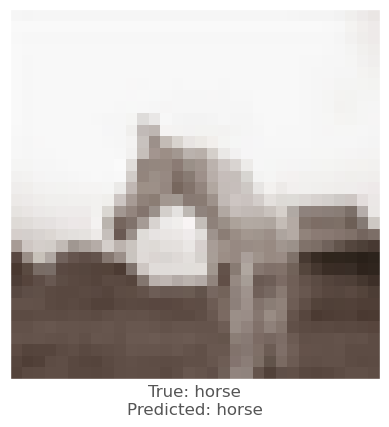



0.0026444197
0.005690336
-0.0006249547
vr, vg, vb :   -0.9901018142700195 -1.85276460647583 -0.0036022067070007324
beam_perturbed_confidence temp :  0.68144006
beam_perturbed_confidence temp :  0.67752576
beam_perturbed_confidence temp :  0.6830403
beam_perturbed_confidence temp :  0.6760193
beam_perturbed_confidence temp :  0.6816975
beam_perturbed_confidence temp :  0.67828333
beam_perturbed_confidence temp :  0.6767841
row index :  3
2th round's confidence : 0th 0.6760193
predicted class :  horse
predicted class's confidence :  0.6760193
Lopt is :  5


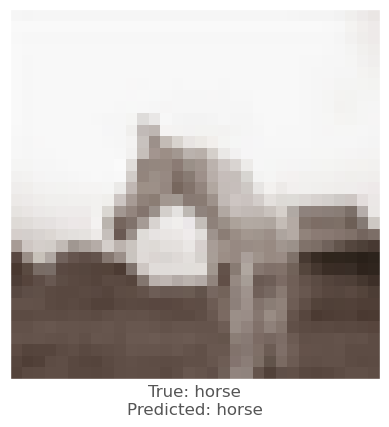



0.005748391
0.00550431
8.523464e-06
vr, vg, vb :   -1.3118618726730347 -1.2257983684539795 0.19943302869796753
beam_perturbed_confidence temp :  0.6596724
beam_perturbed_confidence temp :  0.65903723
beam_perturbed_confidence temp :  0.66653246
beam_perturbed_confidence temp :  0.64946556
beam_perturbed_confidence temp :  0.6596724
beam_perturbed_confidence temp :  0.65903723
beam_perturbed_confidence temp :  0.64946556
row index :  3
2th round's confidence : 1th 0.64946556
predicted class :  horse
predicted class's confidence :  0.64946556
Lopt is :  9


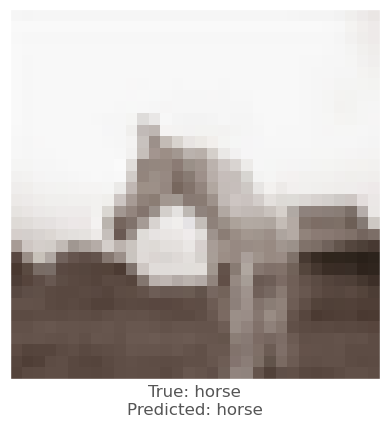



-0.0020925999
0.0035892725
-0.0044142604
vr, vg, vb :   0.4810396432876587 -0.7168980836868286 1.2067670226097107
beam_perturbed_confidence temp :  0.7042827
beam_perturbed_confidence temp :  0.7020287
beam_perturbed_confidence temp :  0.7019694
beam_perturbed_confidence temp :  0.7020287
beam_perturbed_confidence temp :  0.7019694
beam_perturbed_confidence temp :  0.7001527
beam_perturbed_confidence temp :  0.7001527
row index :  5
2th round's confidence : 2th 0.7001527
predicted class :  horse
predicted class's confidence :  0.7001527
Lopt is :  6


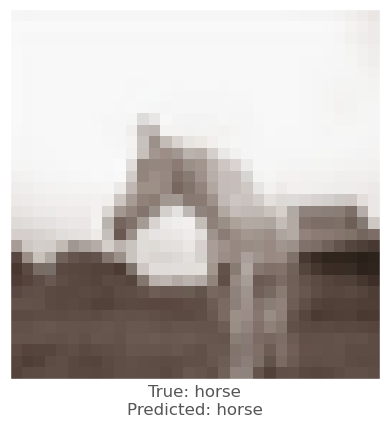



0.0028776526
0.007175505
-0.002701044
vr, vg, vb :   -2.0064808130264282 -2.7564756870269775 -0.2539868950843811
beam_perturbed_confidence temp :  0.58756775
beam_perturbed_confidence temp :  0.58120805
beam_perturbed_confidence temp :  0.59183455
beam_perturbed_confidence temp :  0.57985955
beam_perturbed_confidence temp :  0.5898449
beam_perturbed_confidence temp :  0.5832017
beam_perturbed_confidence temp :  0.58314264
row index :  3
2th round's confidence : 3th 0.57985955
predicted class :  horse
predicted class's confidence :  0.57985955
Lopt is :  18


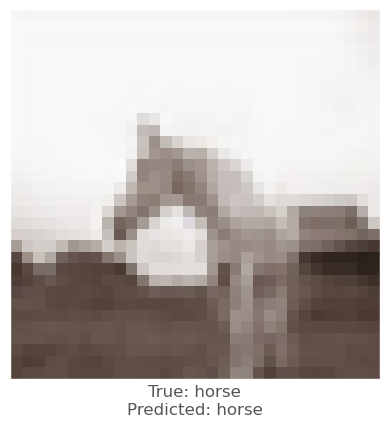



-0.0013769865
0.0037283301
-0.0030514598
vr, vg, vb :   0.21631097793579102 -0.9754663705825806 0.7981998324394226
beam_perturbed_confidence temp :  0.7000851
beam_perturbed_confidence temp :  0.6982683
beam_perturbed_confidence temp :  0.7000851
beam_perturbed_confidence temp :  0.6982683
beam_perturbed_confidence temp :  0.7000851
beam_perturbed_confidence temp :  0.6982683
beam_perturbed_confidence temp :  0.6982683
row index :  1
2th round's confidence : 4th 0.6982683
predicted class :  horse
predicted class's confidence :  0.6982683
Lopt is :  10


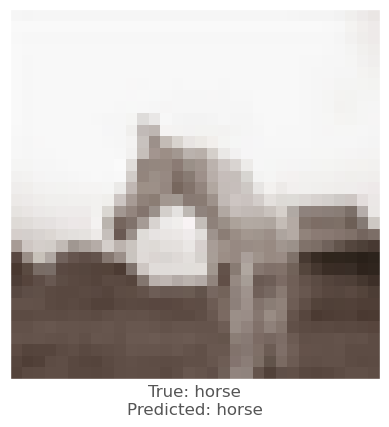



0.0031668544
0.0047580004
-0.0015649796
vr, vg, vb :   -1.2077770709991456 -2.14328818321228 0.15325596928596497
beam_perturbed_confidence temp :  0.67260355
beam_perturbed_confidence temp :  0.66805065
beam_perturbed_confidence temp :  0.6760193
beam_perturbed_confidence temp :  0.6661326
beam_perturbed_confidence temp :  0.67260355
beam_perturbed_confidence temp :  0.66805065
beam_perturbed_confidence temp :  0.6661326
row index :  3
3th round's confidence : 0th 0.6661326
predicted class :  horse
predicted class's confidence :  0.6661326
Lopt is :  8


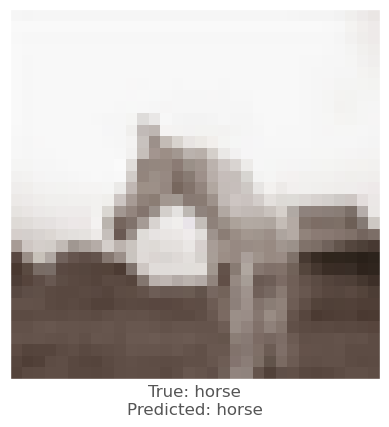



0.008580327
0.009660602
0.0016377568
vr, vg, vb :   -2.0387083888053894 -2.069278693199158 0.01571404337882995
beam_perturbed_confidence temp :  0.6410124
beam_perturbed_confidence temp :  0.63565034
beam_perturbed_confidence temp :  0.64946556
beam_perturbed_confidence temp :  0.6211582
beam_perturbed_confidence temp :  0.6410124
beam_perturbed_confidence temp :  0.63565034
beam_perturbed_confidence temp :  0.6211582
row index :  3
3th round's confidence : 1th 0.6211582
predicted class :  horse
predicted class's confidence :  0.6211582
Lopt is :  12


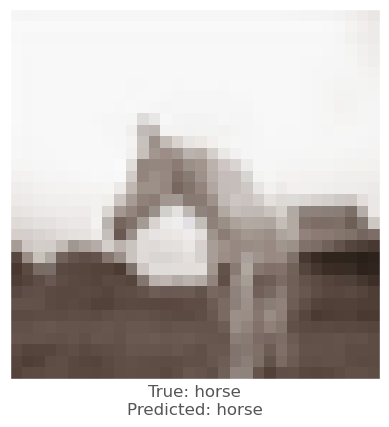



-0.0015848279
0.0044006705
-0.0039378405
vr, vg, vb :   0.591418468952179 -1.0852753281593324 1.4798743665218355
beam_perturbed_confidence temp :  0.7001527
beam_perturbed_confidence temp :  0.69456834
beam_perturbed_confidence temp :  0.69809085
beam_perturbed_confidence temp :  0.69456834
beam_perturbed_confidence temp :  0.69809085
beam_perturbed_confidence temp :  0.692869
beam_perturbed_confidence temp :  0.692869
row index :  5
3th round's confidence : 2th 0.692869
predicted class :  horse
predicted class's confidence :  0.692869
Lopt is :  7


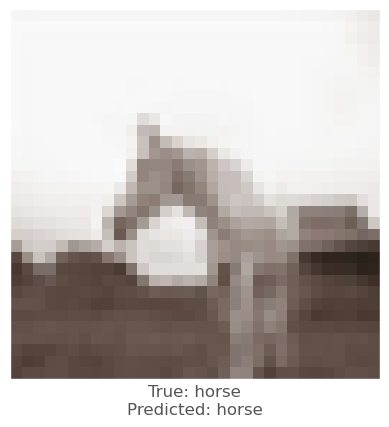



-0.0011669397
0.0031805634
-0.005976379
vr, vg, vb :   -1.6891387581825257 -2.798884463310242 0.3690496861934662
beam_perturbed_confidence temp :  0.58310777
beam_perturbed_confidence temp :  0.57477003
beam_perturbed_confidence temp :  0.57985955
beam_perturbed_confidence temp :  0.57647943
beam_perturbed_confidence temp :  0.58310777
beam_perturbed_confidence temp :  0.57477003
beam_perturbed_confidence temp :  0.57647943
row index :  1
3th round's confidence : 3th 0.57477003
predicted class :  horse
predicted class's confidence :  0.57477003
Lopt is :  21


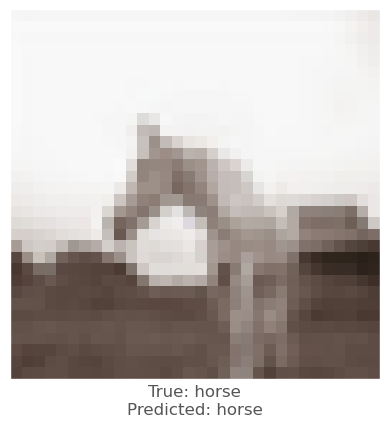



-0.0009472966
0.0038203
-0.0030635
vr, vg, vb :   0.28940954208374026 -1.2599497437477112 1.0247298419475555
beam_perturbed_confidence temp :  0.6982683
beam_perturbed_confidence temp :  0.69401306
beam_perturbed_confidence temp :  0.69673383
beam_perturbed_confidence temp :  0.69401306
beam_perturbed_confidence temp :  0.69673383
beam_perturbed_confidence temp :  0.69248873
beam_perturbed_confidence temp :  0.69248873
row index :  5
3th round's confidence : 4th 0.69248873
predicted class :  horse
predicted class's confidence :  0.69248873
Lopt is :  11


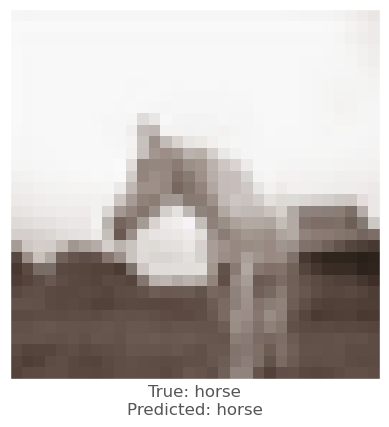



0.0035707355
0.0064199567
-0.002507627
vr, vg, vb :   -1.4440729093551636 -2.5709550333023072 0.3886930733919144
beam_perturbed_confidence temp :  0.66169584
beam_perturbed_confidence temp :  0.6527914
beam_perturbed_confidence temp :  0.6661326
beam_perturbed_confidence temp :  0.6468296
beam_perturbed_confidence temp :  0.66169584
beam_perturbed_confidence temp :  0.6527914
beam_perturbed_confidence temp :  0.6468296
row index :  3
4th round's confidence : 0th 0.6468296
predicted class :  horse
predicted class's confidence :  0.6468296
Lopt is :  11


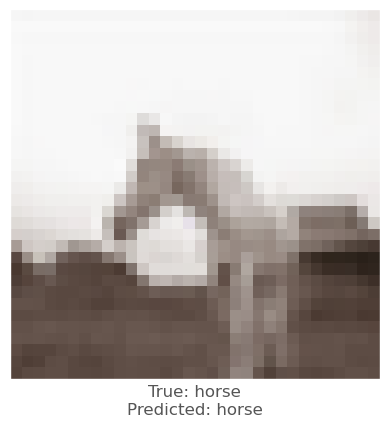



0.011961877
0.016788065
0.0035569668
vr, vg, vb :   -3.0310252845287327 -3.541157367229462 -0.3415540391206741
beam_perturbed_confidence temp :  0.5980252
beam_perturbed_confidence temp :  0.58734506
beam_perturbed_confidence temp :  0.6189933
beam_perturbed_confidence temp :  0.57596844
beam_perturbed_confidence temp :  0.59666705
beam_perturbed_confidence temp :  0.5876259
beam_perturbed_confidence temp :  0.5770425
row index :  3
4th round's confidence : 1th 0.57596844
predicted class :  horse
predicted class's confidence :  0.57596844
Lopt is :  16


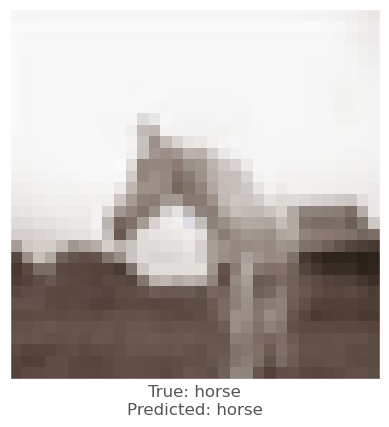



9.715557e-05
0.0061994195
-0.003343463
vr, vg, vb :   0.5225610649585725 -1.5966897451877595 1.666233224272728
beam_perturbed_confidence temp :  0.692869
beam_perturbed_confidence temp :  0.6868655
beam_perturbed_confidence temp :  0.6912249
beam_perturbed_confidence temp :  0.6868655
beam_perturbed_confidence temp :  0.6912249
beam_perturbed_confidence temp :  0.68492246
beam_perturbed_confidence temp :  0.68492246
row index :  5
4th round's confidence : 2th 0.68492246
predicted class :  horse
predicted class's confidence :  0.68492246
Lopt is :  8


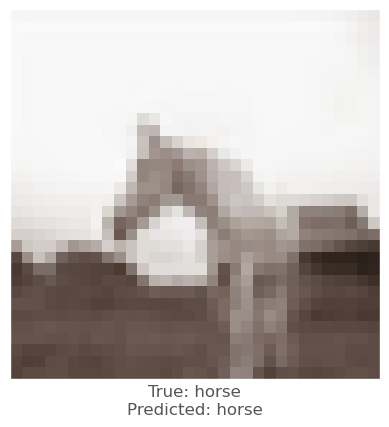



-0.0013833642
0.006707728
-0.0032718778
vr, vg, vb :   -1.3818884623050691 -3.189768807888031 0.6593324941396713
beam_perturbed_confidence temp :  0.57647943
beam_perturbed_confidence temp :  0.5560177
beam_perturbed_confidence temp :  0.57477003
beam_perturbed_confidence temp :  0.5497582
beam_perturbed_confidence temp :  0.57647943
beam_perturbed_confidence temp :  0.5560177
beam_perturbed_confidence temp :  0.5497582
row index :  3
4th round's confidence : 3th 0.5497582
predicted class :  horse
predicted class's confidence :  0.5497582
Lopt is :  25


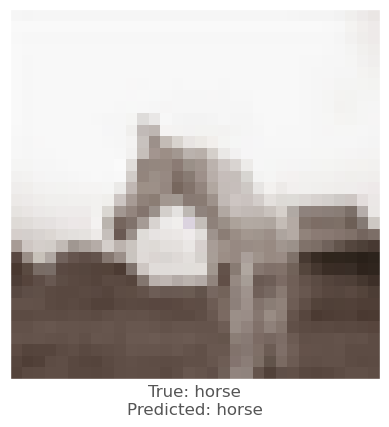



0.0001244545
0.0044220686
-0.002908051
vr, vg, vb :   0.2480231380462647 -1.5761616289615632 1.2130619591474532
beam_perturbed_confidence temp :  0.69248873
beam_perturbed_confidence temp :  0.68842673
beam_perturbed_confidence temp :  0.691105
beam_perturbed_confidence temp :  0.68842673
beam_perturbed_confidence temp :  0.691105
beam_perturbed_confidence temp :  0.68631434
beam_perturbed_confidence temp :  0.68631434
row index :  5
4th round's confidence : 4th 0.68631434
predicted class :  horse
predicted class's confidence :  0.68631434
Lopt is :  12


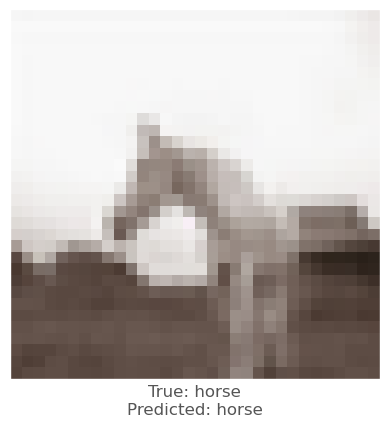



0.0065137744
0.012327194
-0.0009057522
vr, vg, vb :   -1.9510430579185487 -3.5465789513587955 0.44039898425340657
beam_perturbed_confidence temp :  0.6391559
beam_perturbed_confidence temp :  0.6216126
beam_perturbed_confidence temp :  0.6468296
beam_perturbed_confidence temp :  0.61343926
beam_perturbed_confidence temp :  0.6391559
beam_perturbed_confidence temp :  0.6216126
beam_perturbed_confidence temp :  0.61343926
row index :  3
5th round's confidence : 0th 0.61343926
predicted class :  horse
predicted class's confidence :  0.61343926
Lopt is :  15


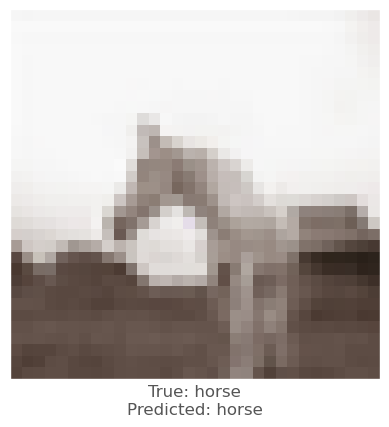



0.0021737814
0.009511173
-0.0024657845
vr, vg, vb :   -2.9453008955717093 -4.138158907651902 -0.06082018023729324
beam_perturbed_confidence temp :  0.57398415
beam_perturbed_confidence temp :  0.5563827
beam_perturbed_confidence temp :  0.5770425
beam_perturbed_confidence temp :  0.5598968
beam_perturbed_confidence temp :  0.5753071
beam_perturbed_confidence temp :  0.55971557
beam_perturbed_confidence temp :  0.56295633
row index :  1
5th round's confidence : 1th 0.5563827
predicted class :  horse
predicted class's confidence :  0.5563827
Lopt is :  21


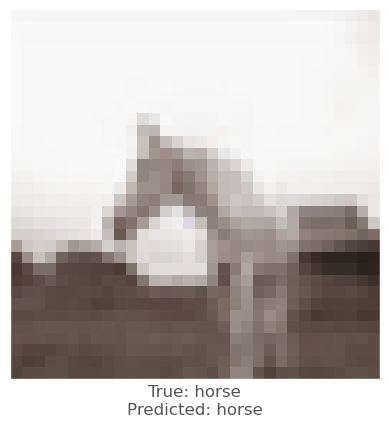



0.0017954111
0.0054187775
-0.0038133264
vr, vg, vb :   0.2907638474702836 -1.978898517251015 1.8809425377249718
beam_perturbed_confidence temp :  0.68492246
beam_perturbed_confidence temp :  0.67975056
beam_perturbed_confidence temp :  0.6830522
beam_perturbed_confidence temp :  0.67975056
beam_perturbed_confidence temp :  0.6830522
beam_perturbed_confidence temp :  0.67797756
beam_perturbed_confidence temp :  0.67797756
row index :  5
5th round's confidence : 2th 0.67797756
predicted class :  horse
predicted class's confidence :  0.67797756
Lopt is :  9


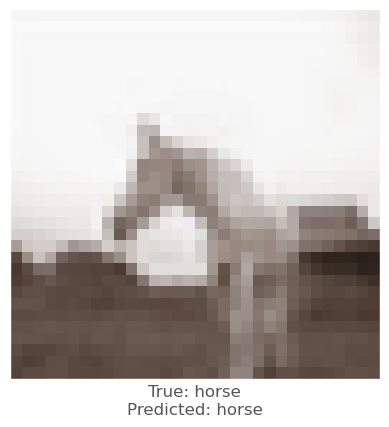



0.005398512
0.016080737
0.0023533702
vr, vg, vb :   -1.78355080473423 -4.478865638494492 0.35806222575902935
beam_perturbed_confidence temp :  0.5442777
beam_perturbed_confidence temp :  0.50817746
beam_perturbed_confidence temp :  0.5497582
beam_perturbed_confidence temp :  0.5015675
beam_perturbed_confidence temp :  0.5442777
beam_perturbed_confidence temp :  0.50817746
beam_perturbed_confidence temp :  0.5015675
row index :  3
5th round's confidence : 3th 0.5015675
predicted class :  horse
predicted class's confidence :  0.5015675
Lopt is :  30


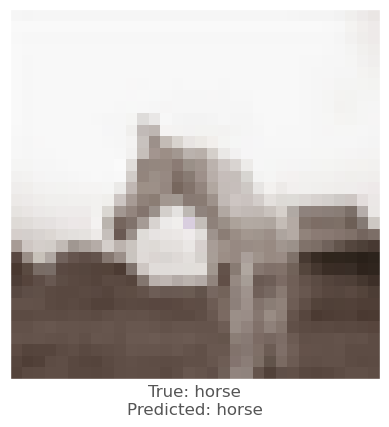



0.0005326867
0.0038694143
-0.0039250255
vr, vg, vb :   0.16995215320587162 -1.8054868990182877 1.4842583095431328
beam_perturbed_confidence temp :  0.68631434
beam_perturbed_confidence temp :  0.68328553
beam_perturbed_confidence temp :  0.6845017
beam_perturbed_confidence temp :  0.68328553
beam_perturbed_confidence temp :  0.6845017
beam_perturbed_confidence temp :  0.68100154
beam_perturbed_confidence temp :  0.68100154
row index :  5
5th round's confidence : 4th 0.68100154
predicted class :  horse
predicted class's confidence :  0.68100154
Lopt is :  13


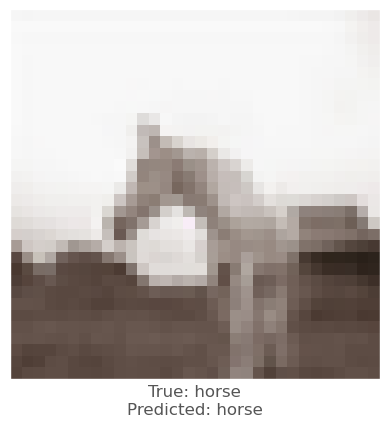



0.009455204
0.015299201
0.00067961216
vr, vg, vb :   -2.7014591531276704 -4.721841157388687 0.3283978698551655
beam_perturbed_confidence temp :  0.5984316
beam_perturbed_confidence temp :  0.57403487
beam_perturbed_confidence temp :  0.61343926
beam_perturbed_confidence temp :  0.55885196
beam_perturbed_confidence temp :  0.5984316
beam_perturbed_confidence temp :  0.57403487
beam_perturbed_confidence temp :  0.55885196
row index :  3
6th round's confidence : 0th 0.55885196
predicted class :  horse
predicted class's confidence :  0.55885196
Lopt is :  20


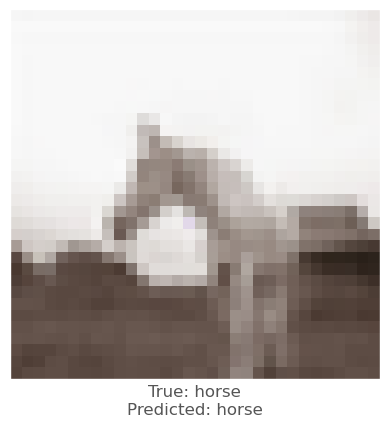



0.00085932016
0.0029210448
-0.0063256025
vr, vg, vb :   -2.736702822387219 -4.016447499537469 0.5778220909297467
beam_perturbed_confidence temp :  0.5598968
beam_perturbed_confidence temp :  0.5444503
beam_perturbed_confidence temp :  0.5563827
beam_perturbed_confidence temp :  0.54791605
beam_perturbed_confidence temp :  0.5598968
beam_perturbed_confidence temp :  0.5444503
beam_perturbed_confidence temp :  0.54791605
row index :  1
6th round's confidence : 1th 0.5444503
predicted class :  horse
predicted class's confidence :  0.5444503
Lopt is :  26


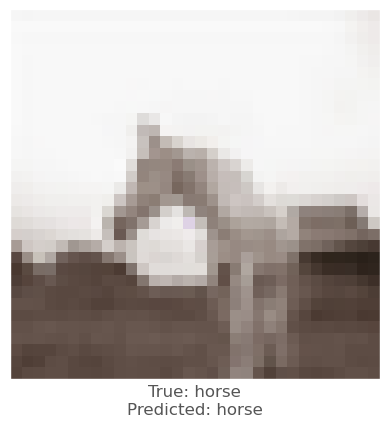



0.0020074248
0.0052936077
-0.00362432
vr, vg, vb :   0.060944979584217185 -2.3103694367051126 2.055280286973715
beam_perturbed_confidence temp :  0.67797756
beam_perturbed_confidence temp :  0.6685662
beam_perturbed_confidence temp :  0.67434645
beam_perturbed_confidence temp :  0.6685662
beam_perturbed_confidence temp :  0.67434645
beam_perturbed_confidence temp :  0.6655689
beam_perturbed_confidence temp :  0.6655689
row index :  5
6th round's confidence : 2th 0.6655689
predicted class :  horse
predicted class's confidence :  0.6655689
Lopt is :  11


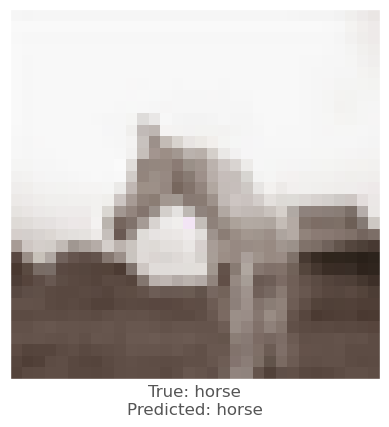



0.0055722296
0.014809489
0.0018666983
vr, vg, vb :   -2.1624186866402626 -5.511927999663353 0.13558617667555806
beam_perturbed_confidence temp :  0.4949651
beam_perturbed_confidence temp :  0.446316
beam_perturbed_confidence temp :  0.5015675
beam_perturbed_confidence temp :  0.43845823
beam_perturbed_confidence temp :  0.4949651
beam_perturbed_confidence temp :  0.446316
beam_perturbed_confidence temp :  0.43845823
row index :  3
6th round's confidence : 3th 0.43845823
predicted class :  airplane
predicted class's confidence :  0.55046695
Lopt is :  36


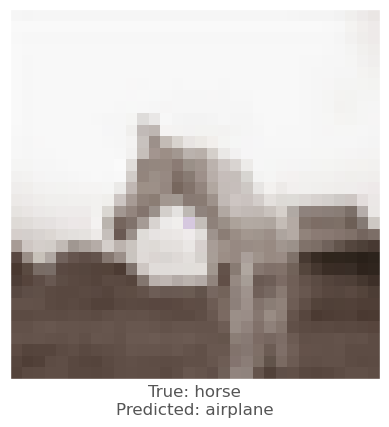




27th sensitive pixel
original confidence is :  0.69673544 

original r,g,b :  223 219 216
-0.00035506487
0.0014523864
-0.0029454827
vr, vg, vb :   0.035506486892700195 -0.14523863792419434 0.29454827308654785
beam_perturbed_confidence temp :  0.69673544
beam_perturbed_confidence temp :  0.6959233
beam_perturbed_confidence temp :  0.69673544
beam_perturbed_confidence temp :  0.6959233
beam_perturbed_confidence temp :  0.69673544
beam_perturbed_confidence temp :  0.6959233
beam_perturbed_confidence temp :  0.6959233
row index :  1
0th round's confidence : 0th 0.6959233
predicted class :  horse
predicted class's confidence :  0.6959233
Lopt is :  1


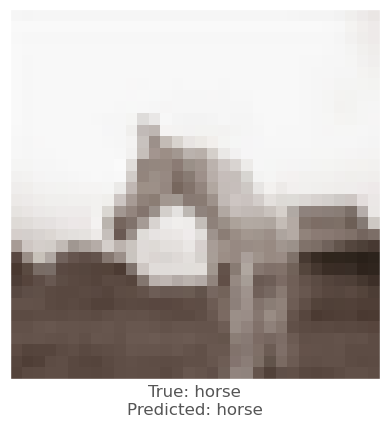



-0.002807796
-0.001761198
-0.005312085
vr, vg, vb :   0.2807796001434326 0.17611980438232422 0.5312085151672363
beam_perturbed_confidence temp :  0.72045356
beam_perturbed_confidence temp :  0.72045356
beam_perturbed_confidence temp :  0.72045356
beam_perturbed_confidence temp :  0.72045356
beam_perturbed_confidence temp :  0.72045356
beam_perturbed_confidence temp :  0.72045356
beam_perturbed_confidence temp :  0.72045356
row index :  0
0th round's confidence : 1th 0.72045356
predicted class :  horse
predicted class's confidence :  0.72045356
Lopt is :  5


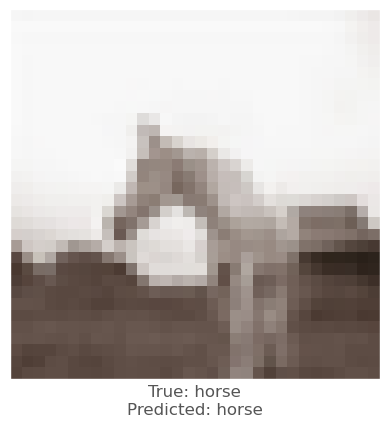



-0.0014054179
0.00060892105
-0.004626751
vr, vg, vb :   0.14054179191589355 -0.06089210510253906 0.4626750946044922
beam_perturbed_confidence temp :  0.67342144
beam_perturbed_confidence temp :  0.6732659
beam_perturbed_confidence temp :  0.67342144
beam_perturbed_confidence temp :  0.6732659
beam_perturbed_confidence temp :  0.67342144
beam_perturbed_confidence temp :  0.6732659
beam_perturbed_confidence temp :  0.6732659
row index :  1
0th round's confidence : 2th 0.6732659
predicted class :  horse
predicted class's confidence :  0.6732659
Lopt is :  5


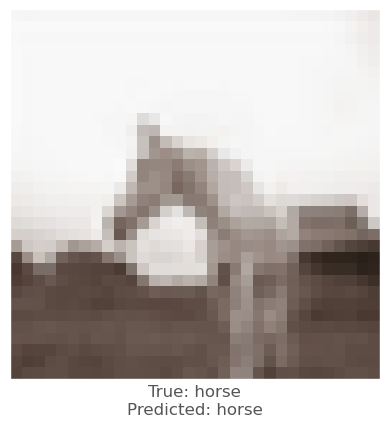



0.002921164
0.0065440536
-0.0010344386
vr, vg, vb :   -0.2921164035797119 -0.6544053554534912 0.10344386100769043
beam_perturbed_confidence temp :  0.71226037
beam_perturbed_confidence temp :  0.71034384
beam_perturbed_confidence temp :  0.71374303
beam_perturbed_confidence temp :  0.7087677
beam_perturbed_confidence temp :  0.71226037
beam_perturbed_confidence temp :  0.71034384
beam_perturbed_confidence temp :  0.7087677
row index :  3
0th round's confidence : 3th 0.7087677
predicted class :  horse
predicted class's confidence :  0.7087677
Lopt is :  11


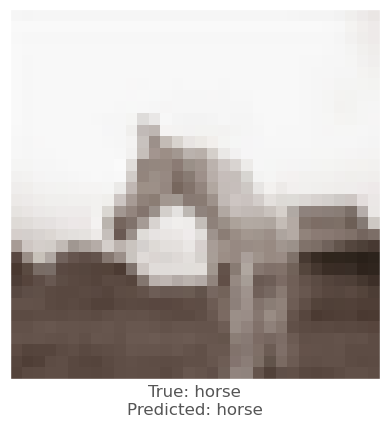



0.001293838
0.0027167797
-0.0021884441
vr, vg, vb :   -0.12938380241394043 -0.27167797088623047 0.21884441375732422
beam_perturbed_confidence temp :  0.668066
beam_perturbed_confidence temp :  0.66724396
beam_perturbed_confidence temp :  0.66840136
beam_perturbed_confidence temp :  0.6674956
beam_perturbed_confidence temp :  0.668066
beam_perturbed_confidence temp :  0.66724396
beam_perturbed_confidence temp :  0.6674956
row index :  1
0th round's confidence : 4th 0.66724396
predicted class :  horse
predicted class's confidence :  0.66724396
Lopt is :  10


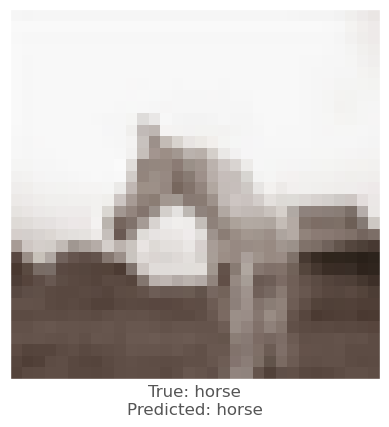



-0.0003055334
0.0016551018
-0.0028623939
vr, vg, vb :   0.06250917911529541 -0.2962249517440796 0.5513328313827515
beam_perturbed_confidence temp :  0.6959233
beam_perturbed_confidence temp :  0.69508034
beam_perturbed_confidence temp :  0.6959233
beam_perturbed_confidence temp :  0.69508034
beam_perturbed_confidence temp :  0.6959233
beam_perturbed_confidence temp :  0.69508034
beam_perturbed_confidence temp :  0.69508034
row index :  1
1th round's confidence : 0th 0.69508034
predicted class :  horse
predicted class's confidence :  0.69508034
Lopt is :  2


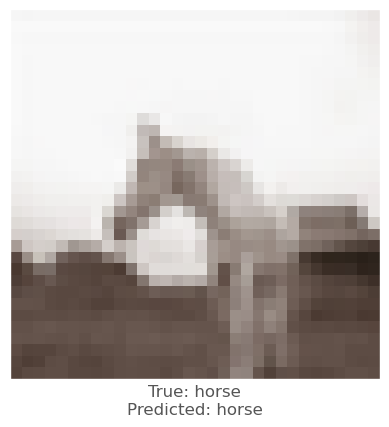



-0.002807796
-0.001761198
-0.005312085
vr, vg, vb :   0.533481240272522 0.334627628326416 1.009296178817749
beam_perturbed_confidence temp :  0.72045356
beam_perturbed_confidence temp :  0.72045356
beam_perturbed_confidence temp :  0.7175222
beam_perturbed_confidence temp :  0.72045356
beam_perturbed_confidence temp :  0.7175222
beam_perturbed_confidence temp :  0.7175222
beam_perturbed_confidence temp :  0.7175222
row index :  2
1th round's confidence : 1th 0.7175222
predicted class :  horse
predicted class's confidence :  0.7175222
Lopt is :  5


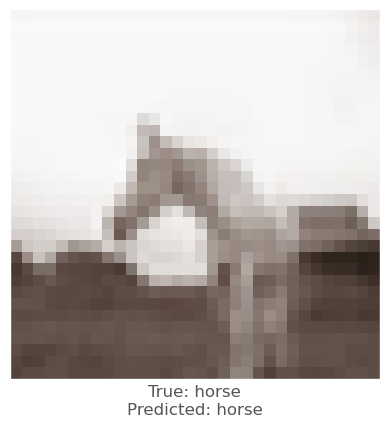



-0.0020841956
0.00010472536
-0.0046777725
vr, vg, vb :   0.3349071741104126 -0.06527543067932129 0.8841848373413086
beam_perturbed_confidence temp :  0.6732659
beam_perturbed_confidence temp :  0.6733167
beam_perturbed_confidence temp :  0.6732659
beam_perturbed_confidence temp :  0.6733167
beam_perturbed_confidence temp :  0.6732659
beam_perturbed_confidence temp :  0.6733167
beam_perturbed_confidence temp :  0.6733167
row index :  0
1th round's confidence : 2th 0.6732659
predicted class :  horse
predicted class's confidence :  0.6732659
Lopt is :  5


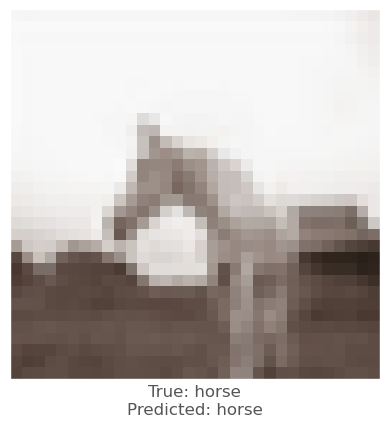



0.0037679672
0.0077916384
-0.0008366704
vr, vg, vb :   -0.6397014856338501 -1.3681286573410034 0.1767665147781372
beam_perturbed_confidence temp :  0.7065759
beam_perturbed_confidence temp :  0.6999753
beam_perturbed_confidence temp :  0.7087677
beam_perturbed_confidence temp :  0.6976533
beam_perturbed_confidence temp :  0.7065759
beam_perturbed_confidence temp :  0.6999753
beam_perturbed_confidence temp :  0.6976533
row index :  3
1th round's confidence : 3th 0.6976533
predicted class :  horse
predicted class's confidence :  0.6976533
Lopt is :  13


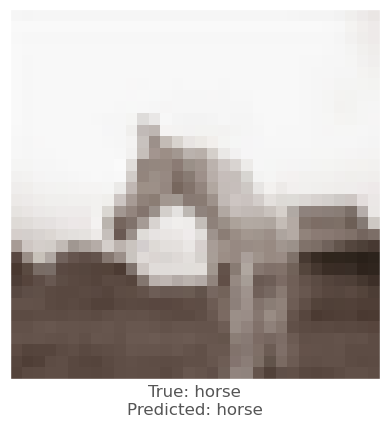



0.00018751621
0.001688838
-0.0026404262
vr, vg, vb :   -0.13519704341888428 -0.4133939743041992 0.4610025882720947
beam_perturbed_confidence temp :  0.6674956
beam_perturbed_confidence temp :  0.6667125
beam_perturbed_confidence temp :  0.66724396
beam_perturbed_confidence temp :  0.6671788
beam_perturbed_confidence temp :  0.6674956
beam_perturbed_confidence temp :  0.6667125
beam_perturbed_confidence temp :  0.6671788
row index :  1
1th round's confidence : 4th 0.6667125
predicted class :  horse
predicted class's confidence :  0.6667125
Lopt is :  10


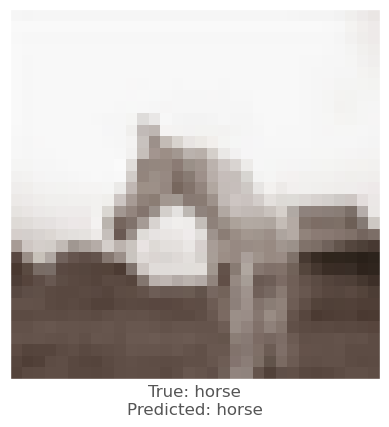



-0.00088357925
0.0010077357
-0.0032188296
vr, vg, vb :   0.14461618661880493 -0.36737602949142456 0.8180825114250183
beam_perturbed_confidence temp :  0.69508034
beam_perturbed_confidence temp :  0.6949156
beam_perturbed_confidence temp :  0.69508034
beam_perturbed_confidence temp :  0.6949156
beam_perturbed_confidence temp :  0.69508034
beam_perturbed_confidence temp :  0.6949156
beam_perturbed_confidence temp :  0.6949156
row index :  1
2th round's confidence : 0th 0.6949156
predicted class :  horse
predicted class's confidence :  0.6949156
Lopt is :  3


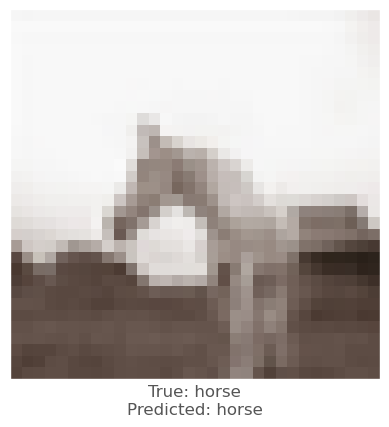



-0.0027862191
-0.0026704073
-0.006057322
vr, vg, vb :   0.7587550282478333 0.5682055950164795 1.5140987634658813
beam_perturbed_confidence temp :  0.7175222
beam_perturbed_confidence temp :  0.7175222
beam_perturbed_confidence temp :  0.71439624
beam_perturbed_confidence temp :  0.7175222
beam_perturbed_confidence temp :  0.71439624
beam_perturbed_confidence temp :  0.71439624
beam_perturbed_confidence temp :  0.71439624
row index :  2
2th round's confidence : 1th 0.71439624
predicted class :  horse
predicted class's confidence :  0.71439624
Lopt is :  5


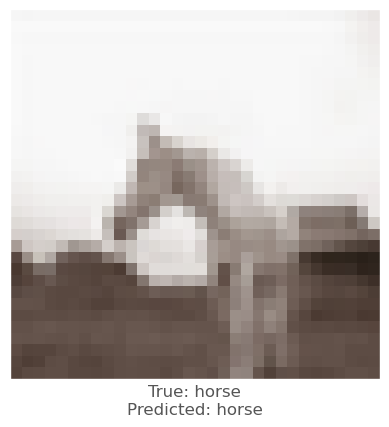



-0.0020841956
0.00010472536
-0.0046777725
vr, vg, vb :   0.5098360180854797 -0.06922042369842529 1.2635436058044434
beam_perturbed_confidence temp :  0.6732659
beam_perturbed_confidence temp :  0.6733167
beam_perturbed_confidence temp :  0.6709232
beam_perturbed_confidence temp :  0.6733167
beam_perturbed_confidence temp :  0.6709232
beam_perturbed_confidence temp :  0.6707366
beam_perturbed_confidence temp :  0.6707366
row index :  5
2th round's confidence : 2th 0.6707366
predicted class :  horse
predicted class's confidence :  0.6707366
Lopt is :  6


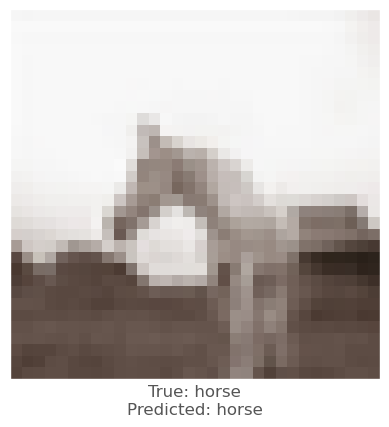



0.0054187775
0.00918299
-0.00069224834
vr, vg, vb :   -1.1176090836524963 -2.1496147513389587 0.22831469774246216
beam_perturbed_confidence temp :  0.6915262
beam_perturbed_confidence temp :  0.6837116
beam_perturbed_confidence temp :  0.6976533
beam_perturbed_confidence temp :  0.6776465
beam_perturbed_confidence temp :  0.6915262
beam_perturbed_confidence temp :  0.6837116
beam_perturbed_confidence temp :  0.6776465
row index :  3
2th round's confidence : 3th 0.6776465
predicted class :  horse
predicted class's confidence :  0.6776465
Lopt is :  16


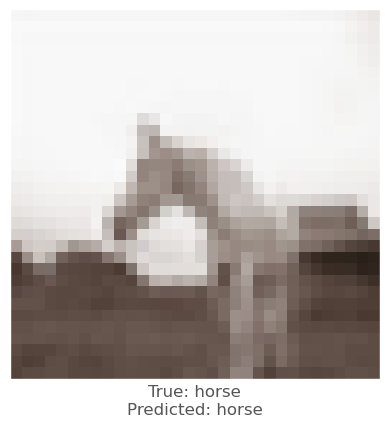



-0.0007734895
0.0009772182
-0.0036861897
vr, vg, vb :   -0.044328391551971436 -0.4697763919830322 0.783521294593811
beam_perturbed_confidence temp :  0.6671788
beam_perturbed_confidence temp :  0.66626674
beam_perturbed_confidence temp :  0.6667125
beam_perturbed_confidence temp :  0.66663927
beam_perturbed_confidence temp :  0.6671788
beam_perturbed_confidence temp :  0.66626674
beam_perturbed_confidence temp :  0.66663927
row index :  1
2th round's confidence : 4th 0.66626674
predicted class :  horse
predicted class's confidence :  0.66626674
Lopt is :  10


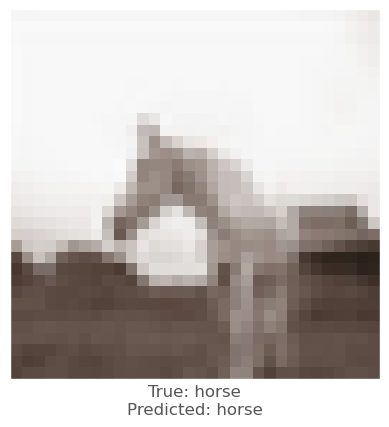



-0.00092190504
0.00071549416
-0.0033379793
vr, vg, vb :   0.22234507203102113 -0.402187842130661 1.070072191953659
beam_perturbed_confidence temp :  0.6949156
beam_perturbed_confidence temp :  0.69436485
beam_perturbed_confidence temp :  0.69310004
beam_perturbed_confidence temp :  0.69436485
beam_perturbed_confidence temp :  0.69310004
beam_perturbed_confidence temp :  0.69279855
beam_perturbed_confidence temp :  0.69279855
row index :  5
3th round's confidence : 0th 0.69279855
predicted class :  horse
predicted class's confidence :  0.69279855
Lopt is :  4


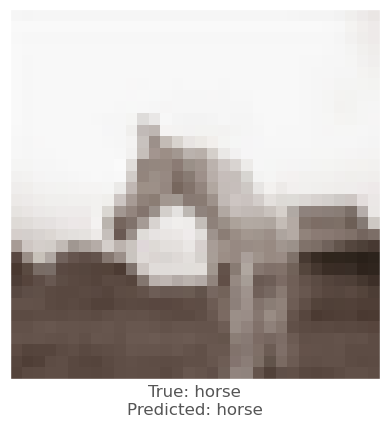



-0.0026903152
-0.0037112832
-0.006681025
vr, vg, vb :   0.9519110500812531 0.8825133562088013 2.030791389942169
beam_perturbed_confidence temp :  0.71439624
beam_perturbed_confidence temp :  0.71439624
beam_perturbed_confidence temp :  0.70720035
beam_perturbed_confidence temp :  0.71439624
beam_perturbed_confidence temp :  0.70720035
beam_perturbed_confidence temp :  0.70720035
beam_perturbed_confidence temp :  0.70720035
row index :  2
3th round's confidence : 1th 0.70720035
predicted class :  horse
predicted class's confidence :  0.70720035
Lopt is :  5


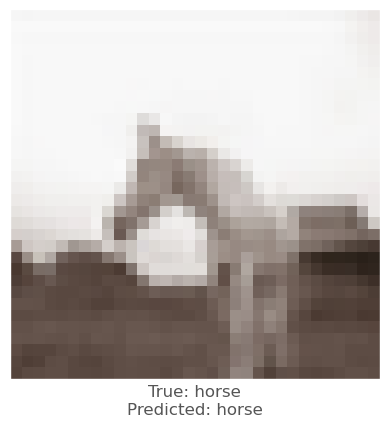



-0.002621591
-0.00039374828
-0.0049676895
vr, vg, vb :   0.7210115253925324 -0.022923552989959718 1.6339581966400147
beam_perturbed_confidence temp :  0.6707366
beam_perturbed_confidence temp :  0.6713169
beam_perturbed_confidence temp :  0.668349
beam_perturbed_confidence temp :  0.6713169
beam_perturbed_confidence temp :  0.668349
beam_perturbed_confidence temp :  0.6686019
beam_perturbed_confidence temp :  0.6686019
row index :  2
3th round's confidence : 2th 0.668349
predicted class :  horse
predicted class's confidence :  0.668349
Lopt is :  7


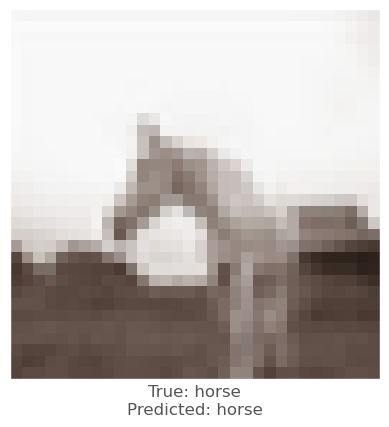



0.006214142
0.008945644
-0.0006827116
vr, vg, vb :   -1.6272623598575593 -2.8292176663875583 0.27375438809394836
beam_perturbed_confidence temp :  0.6723129
beam_perturbed_confidence temp :  0.66611505
beam_perturbed_confidence temp :  0.6776465
beam_perturbed_confidence temp :  0.662249
beam_perturbed_confidence temp :  0.6723129
beam_perturbed_confidence temp :  0.66611505
beam_perturbed_confidence temp :  0.662249
row index :  3
3th round's confidence : 3th 0.662249
predicted class :  horse
predicted class's confidence :  0.662249
Lopt is :  19


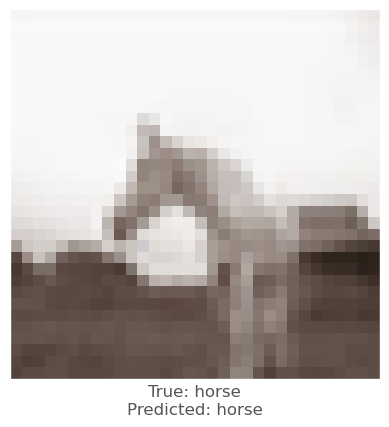



-0.0009056926
0.0012067556
-0.0037853122
vr, vg, vb :   0.05067370533943176 -0.5434743165969849 1.083700382709503
beam_perturbed_confidence temp :  0.66626674
beam_perturbed_confidence temp :  0.66550577
beam_perturbed_confidence temp :  0.6643644
beam_perturbed_confidence temp :  0.66550577
beam_perturbed_confidence temp :  0.6643644
beam_perturbed_confidence temp :  0.66353065
beam_perturbed_confidence temp :  0.66353065
row index :  5
3th round's confidence : 4th 0.66353065
predicted class :  horse
predicted class's confidence :  0.66353065
Lopt is :  11


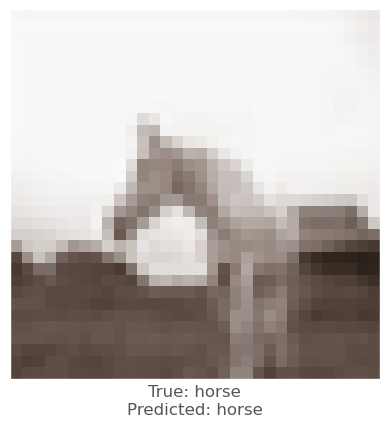



-0.0007392168
0.00031101704
-0.003158152
vr, vg, vb :   0.27403224527835846 -0.39307076156139376 1.2788801831007004
beam_perturbed_confidence temp :  0.69279855
beam_perturbed_confidence temp :  0.692789
beam_perturbed_confidence temp :  0.6912067
beam_perturbed_confidence temp :  0.692789
beam_perturbed_confidence temp :  0.6912067
beam_perturbed_confidence temp :  0.69088113
beam_perturbed_confidence temp :  0.69088113
row index :  5
4th round's confidence : 0th 0.69088113
predicted class :  horse
predicted class's confidence :  0.69088113
Lopt is :  5


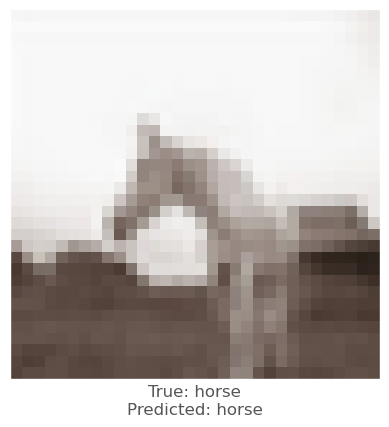



-0.0023829937
-0.004562795
-0.007191479
vr, vg, vb :   1.0950193148851395 1.250541536808014 2.5468601715564727
beam_perturbed_confidence temp :  0.70617056
beam_perturbed_confidence temp :  0.70499104
beam_perturbed_confidence temp :  0.7002696
beam_perturbed_confidence temp :  0.7039558
beam_perturbed_confidence temp :  0.6991193
beam_perturbed_confidence temp :  0.6983205
beam_perturbed_confidence temp :  0.69688165
row index :  6
4th round's confidence : 1th 0.69688165
predicted class :  horse
predicted class's confidence :  0.69688165
Lopt is :  4


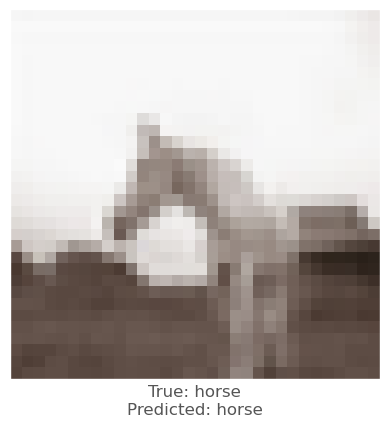



-0.001915276
-0.0002478361
-0.0046274066
vr, vg, vb :   0.8404379779100419 0.004152413606643673 1.9333030366897583
beam_perturbed_confidence temp :  0.668349
beam_perturbed_confidence temp :  0.668349
beam_perturbed_confidence temp :  0.6661092
beam_perturbed_confidence temp :  0.668349
beam_perturbed_confidence temp :  0.6661092
beam_perturbed_confidence temp :  0.6661092
beam_perturbed_confidence temp :  0.6661092
row index :  2
4th round's confidence : 2th 0.6661092
predicted class :  horse
predicted class's confidence :  0.6661092
Lopt is :  8


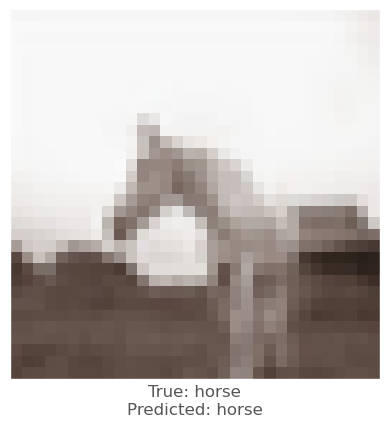



0.0033817887
0.005851269
-0.0022923946
vr, vg, vb :   -1.802714996933937 -3.1314227765798575 0.47561841309070585
beam_perturbed_confidence temp :  0.6582186
beam_perturbed_confidence temp :  0.6514603
beam_perturbed_confidence temp :  0.662249
beam_perturbed_confidence temp :  0.6482729
beam_perturbed_confidence temp :  0.6582186
beam_perturbed_confidence temp :  0.6514603
beam_perturbed_confidence temp :  0.6482729
row index :  3
4th round's confidence : 3th 0.6482729
predicted class :  horse
predicted class's confidence :  0.6482729
Lopt is :  23


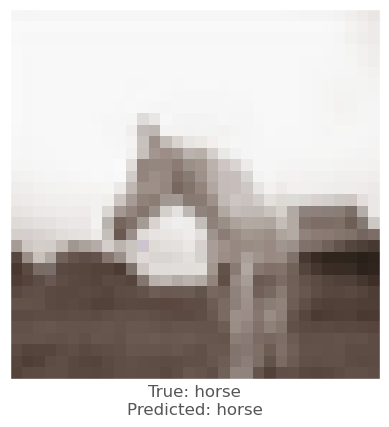



-0.0008017421
0.0016272664
-0.0037814379
vr, vg, vb :   0.12578054249286652 -0.6518535256385803 1.353474131822586
beam_perturbed_confidence temp :  0.66353065
beam_perturbed_confidence temp :  0.66273713
beam_perturbed_confidence temp :  0.6617243
beam_perturbed_confidence temp :  0.66273713
beam_perturbed_confidence temp :  0.6617243
beam_perturbed_confidence temp :  0.6609243
beam_perturbed_confidence temp :  0.6609243
row index :  5
4th round's confidence : 4th 0.6609243
predicted class :  horse
predicted class's confidence :  0.6609243
Lopt is :  12


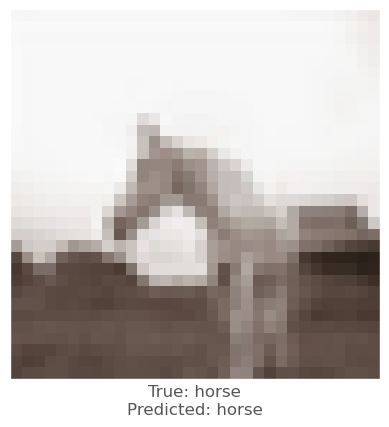



-0.0011538267
-7.5519085e-05
-0.0037095547
vr, vg, vb :   0.3620116921067238 -0.3462117769122124 1.5219476320147516
beam_perturbed_confidence temp :  0.69088113
beam_perturbed_confidence temp :  0.6912822
beam_perturbed_confidence temp :  0.68907946
beam_perturbed_confidence temp :  0.6912822
beam_perturbed_confidence temp :  0.68907946
beam_perturbed_confidence temp :  0.6892882
beam_perturbed_confidence temp :  0.6892882
row index :  2
5th round's confidence : 0th 0.68907946
predicted class :  horse
predicted class's confidence :  0.68907946
Lopt is :  5


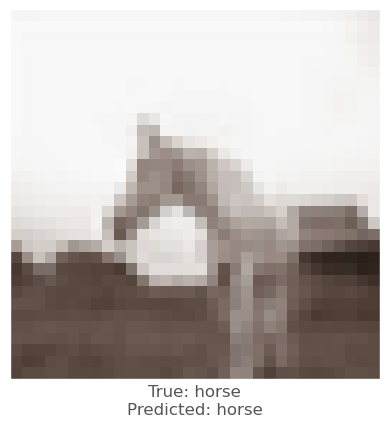



-0.0028938055
-0.0045594573
-0.007594824
vr, vg, vb :   1.274897933781147 1.5814331133365631 3.051656538128853
beam_perturbed_confidence temp :  0.6954267
beam_perturbed_confidence temp :  0.6945599
beam_perturbed_confidence temp :  0.68634176
beam_perturbed_confidence temp :  0.69369143
beam_perturbed_confidence temp :  0.6866638
beam_perturbed_confidence temp :  0.68579406
beam_perturbed_confidence temp :  0.6868103
row index :  5
5th round's confidence : 1th 0.68579406
predicted class :  horse
predicted class's confidence :  0.68579406
Lopt is :  4


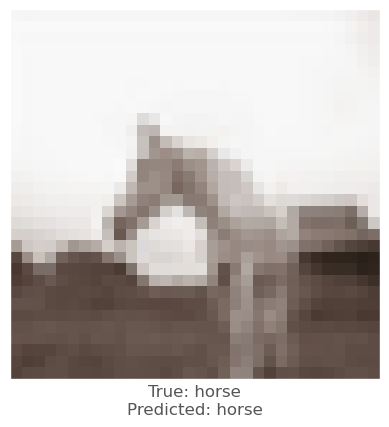



-0.0012536645
0.00022602081
-0.004766643
vr, vg, vb :   0.8817606294751169 -0.018864909052848818 2.216637037754059
beam_perturbed_confidence temp :  0.6661092
beam_perturbed_confidence temp :  0.66600287
beam_perturbed_confidence temp :  0.6612508
beam_perturbed_confidence temp :  0.66600287
beam_perturbed_confidence temp :  0.6612508
beam_perturbed_confidence temp :  0.66119176
beam_perturbed_confidence temp :  0.66119176
row index :  5
5th round's confidence : 2th 0.66119176
predicted class :  horse
predicted class's confidence :  0.66119176
Lopt is :  10


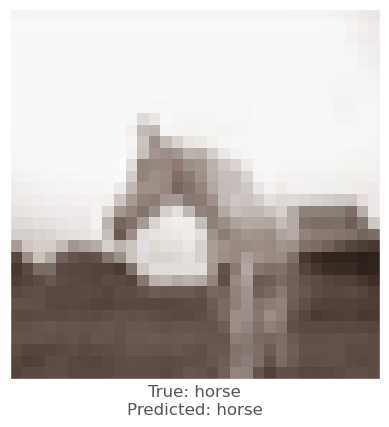



0.0029857755
0.003437817
-0.0034053922
vr, vg, vb :   -1.9210210443139077 -3.1620622085928924 0.7685957887768745
beam_perturbed_confidence temp :  0.6453543
beam_perturbed_confidence temp :  0.64284736
beam_perturbed_confidence temp :  0.6482729
beam_perturbed_confidence temp :  0.6393364
beam_perturbed_confidence temp :  0.6453543
beam_perturbed_confidence temp :  0.64284736
beam_perturbed_confidence temp :  0.6393364
row index :  3
5th round's confidence : 3th 0.6393364
predicted class :  horse
predicted class's confidence :  0.6393364
Lopt is :  27


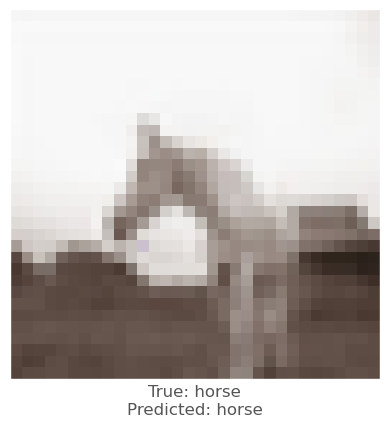



-0.0007452369
0.0013529062
-0.0034433007
vr, vg, vb :   0.18772617560625077 -0.7219587957859039 1.5624567910432816
beam_perturbed_confidence temp :  0.6609243
beam_perturbed_confidence temp :  0.6603714
beam_perturbed_confidence temp :  0.65929383
beam_perturbed_confidence temp :  0.6603714
beam_perturbed_confidence temp :  0.65929383
beam_perturbed_confidence temp :  0.65857655
beam_perturbed_confidence temp :  0.65857655
row index :  5
5th round's confidence : 4th 0.65857655
predicted class :  horse
predicted class's confidence :  0.65857655
Lopt is :  13


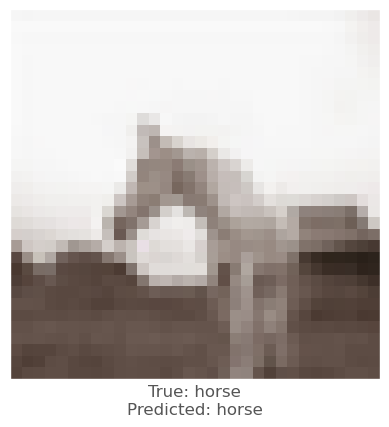



-0.0009801388
0.000114023685
-0.0035205483
vr, vg, vb :   0.4238244007647038 -0.32299296776652336 1.7218077031791212
beam_perturbed_confidence temp :  0.68907946
beam_perturbed_confidence temp :  0.6892882
beam_perturbed_confidence temp :  0.6873606
beam_perturbed_confidence temp :  0.6892882
beam_perturbed_confidence temp :  0.6873606
beam_perturbed_confidence temp :  0.6873266
beam_perturbed_confidence temp :  0.6873266
row index :  5
6th round's confidence : 0th 0.6873266
predicted class :  horse
predicted class's confidence :  0.6873266
Lopt is :  6


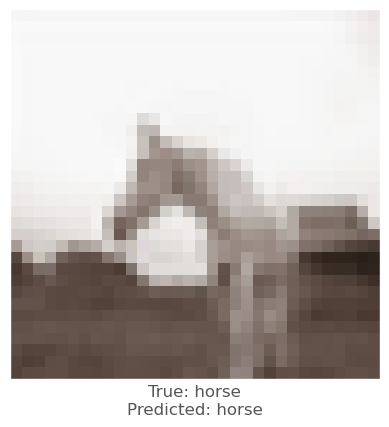



0.0016319156
-0.00027513504
-0.0047183037
vr, vg, vb :   0.9842165834724903 1.450803306031227 3.21832125235796
beam_perturbed_confidence temp :  0.68579406
beam_perturbed_confidence temp :  0.6860666
beam_perturbed_confidence temp :  0.6784737
beam_perturbed_confidence temp :  0.6860666
beam_perturbed_confidence temp :  0.6784737
beam_perturbed_confidence temp :  0.67870986
beam_perturbed_confidence temp :  0.67870986
row index :  2
6th round's confidence : 1th 0.6784737
predicted class :  horse
predicted class's confidence :  0.6784737
Lopt is :  7


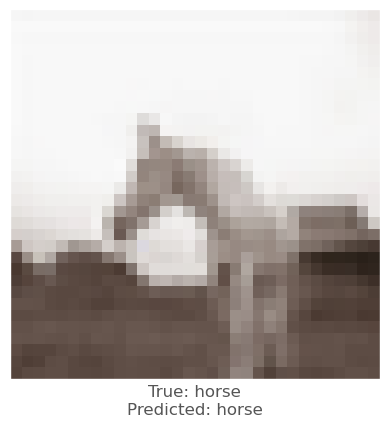



-0.00079113245
-4.6670437e-05
-0.004751444
vr, vg, vb :   0.8726978115379812 -0.01231137446165085 2.470117720270157
beam_perturbed_confidence temp :  0.66119176
beam_perturbed_confidence temp :  0.6612975
beam_perturbed_confidence temp :  0.6566351
beam_perturbed_confidence temp :  0.6612975
beam_perturbed_confidence temp :  0.6566351
beam_perturbed_confidence temp :  0.65651065
beam_perturbed_confidence temp :  0.65651065
row index :  5
6th round's confidence : 2th 0.65651065
predicted class :  horse
predicted class's confidence :  0.65651065
Lopt is :  12


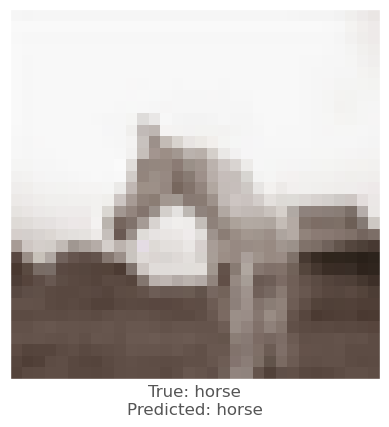



0.003914118
0.0034694076
-0.0033803582
vr, vg, vb :   -2.120330721193552 -3.1927967435777194 1.02977203181386
beam_perturbed_confidence temp :  0.6327279
beam_perturbed_confidence temp :  0.6321111
beam_perturbed_confidence temp :  0.6376414
beam_perturbed_confidence temp :  0.62646955
beam_perturbed_confidence temp :  0.6309424
beam_perturbed_confidence temp :  0.6303082
beam_perturbed_confidence temp :  0.6248266
row index :  6
6th round's confidence : 3th 0.6248266
predicted class :  horse
predicted class's confidence :  0.6248266
Lopt is :  31


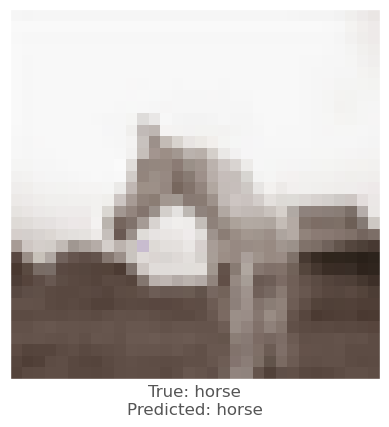



-0.0007110238
0.0012975335
-0.0034826398
vr, vg, vb :   0.24005593879818918 -0.7795162674188614 1.7544750908970834
beam_perturbed_confidence temp :  0.65857655
beam_perturbed_confidence temp :  0.6579963
beam_perturbed_confidence temp :  0.6568888
beam_perturbed_confidence temp :  0.6579963
beam_perturbed_confidence temp :  0.6568888
beam_perturbed_confidence temp :  0.65614235
beam_perturbed_confidence temp :  0.65614235
row index :  5
6th round's confidence : 4th 0.65614235
predicted class :  horse
predicted class's confidence :  0.65614235
Lopt is :  14


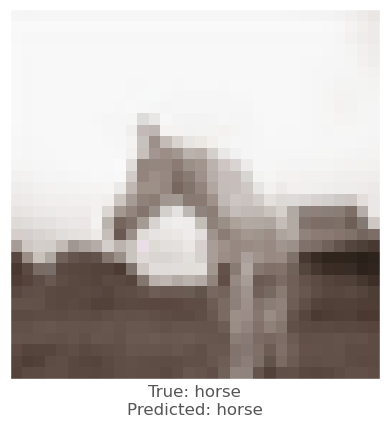



-0.0011962056
-6.508827e-05
-0.0039641857
vr, vg, vb :   0.5010625222879649 -0.2841848437803984 1.946045504333377
beam_perturbed_confidence temp :  0.6873266
beam_perturbed_confidence temp :  0.6874257
beam_perturbed_confidence temp :  0.685324
beam_perturbed_confidence temp :  0.6874257
beam_perturbed_confidence temp :  0.685324
beam_perturbed_confidence temp :  0.6854632
beam_perturbed_confidence temp :  0.6854632
row index :  2
7th round's confidence : 0th 0.685324
predicted class :  horse
predicted class's confidence :  0.685324
Lopt is :  6


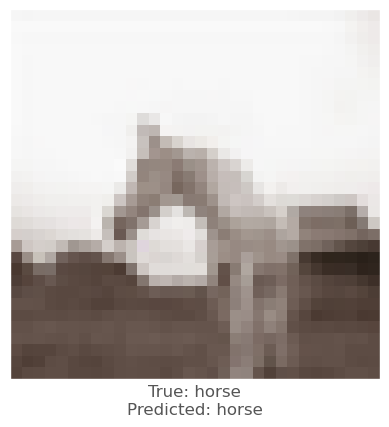



0.0023338795
0.00025880337
-0.0052208304
vr, vg, vb :   0.6524069780427217 1.2798426386666297 3.418572171174288
beam_perturbed_confidence temp :  0.6784737
beam_perturbed_confidence temp :  0.67870986
beam_perturbed_confidence temp :  0.67052907
beam_perturbed_confidence temp :  0.67870986
beam_perturbed_confidence temp :  0.67052907
beam_perturbed_confidence temp :  0.6704493
beam_perturbed_confidence temp :  0.6704493
row index :  5
7th round's confidence : 1th 0.6704493
predicted class :  horse
predicted class's confidence :  0.6704493
Lopt is :  10


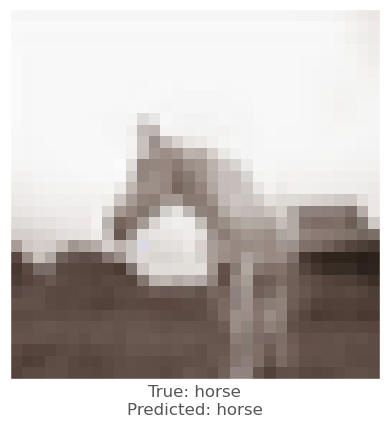



-1.680851e-05
5.4061413e-05
-0.004366815
vr, vg, vb :   0.7871088813668491 -0.016486378296613695 2.6597874572610856
beam_perturbed_confidence temp :  0.65651065
beam_perturbed_confidence temp :  0.65658104
beam_perturbed_confidence temp :  0.6526075
beam_perturbed_confidence temp :  0.65658104
beam_perturbed_confidence temp :  0.6526075
beam_perturbed_confidence temp :  0.6525656
beam_perturbed_confidence temp :  0.6525656
row index :  5
7th round's confidence : 2th 0.6525656
predicted class :  horse
predicted class's confidence :  0.6525656
Lopt is :  14


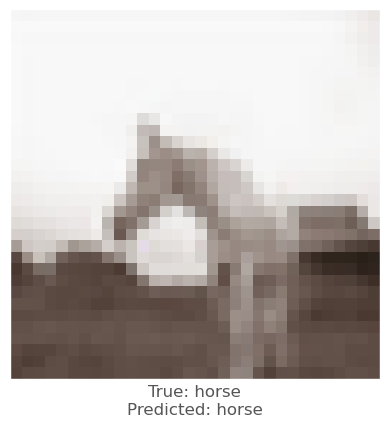



0.004373133
0.003595829
-0.0033330321
vr, vg, vb :   -2.3456109673267607 -3.233099970220924 1.2600980417519807
beam_perturbed_confidence temp :  0.6173365
beam_perturbed_confidence temp :  0.61696506
beam_perturbed_confidence temp :  0.6231365
beam_perturbed_confidence temp :  0.6100103
beam_perturbed_confidence temp :  0.61596346
beam_perturbed_confidence temp :  0.61548704
beam_perturbed_confidence temp :  0.6087297
row index :  6
7th round's confidence : 3th 0.6087297
predicted class :  horse
predicted class's confidence :  0.6087297
Lopt is :  35


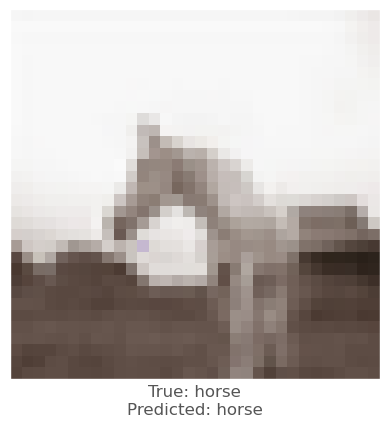



-0.00054836273
0.0013207197
-0.0034937859
vr, vg, vb :   0.27088661811172965 -0.8336366125702858 1.9284061676228048
beam_perturbed_confidence temp :  0.65614235
beam_perturbed_confidence temp :  0.65556806
beam_perturbed_confidence temp :  0.6545025
beam_perturbed_confidence temp :  0.65556806
beam_perturbed_confidence temp :  0.6545025
beam_perturbed_confidence temp :  0.65386134
beam_perturbed_confidence temp :  0.65386134
row index :  5
7th round's confidence : 4th 0.65386134
predicted class :  horse
predicted class's confidence :  0.65386134
Lopt is :  15


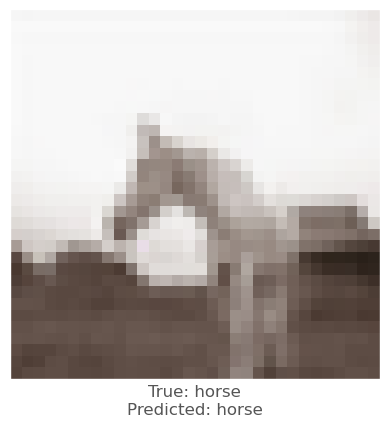



-0.0013292432
1.0848045e-05
-0.0040100217
vr, vg, vb :   0.583880588372767 -0.25685116393727064 2.152443122555435
beam_perturbed_confidence temp :  0.685324
beam_perturbed_confidence temp :  0.6854632
beam_perturbed_confidence temp :  0.6810568
beam_perturbed_confidence temp :  0.6854632
beam_perturbed_confidence temp :  0.6810568
beam_perturbed_confidence temp :  0.68128633
beam_perturbed_confidence temp :  0.68128633
row index :  2
8th round's confidence : 0th 0.6810568
predicted class :  horse
predicted class's confidence :  0.6810568
Lopt is :  7


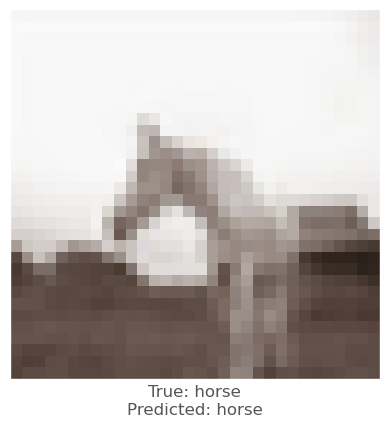



0.0009804964
-0.0013850927
-0.007041216
vr, vg, vb :   0.48911663958293206 1.2903676483290196 3.7808365437175038
beam_perturbed_confidence temp :  0.6704493
beam_perturbed_confidence temp :  0.669144
beam_perturbed_confidence temp :  0.6592027
beam_perturbed_confidence temp :  0.669144
beam_perturbed_confidence temp :  0.6592027
beam_perturbed_confidence temp :  0.6580253
beam_perturbed_confidence temp :  0.6580253
row index :  5
8th round's confidence : 1th 0.6580253
predicted class :  horse
predicted class's confidence :  0.6580253
Lopt is :  13


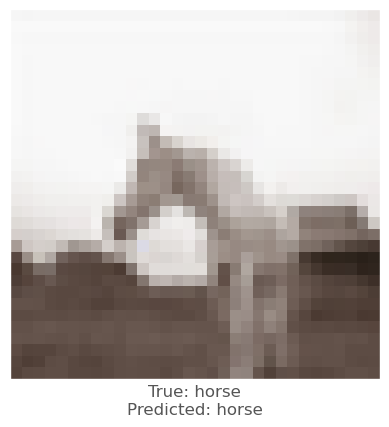



2.5689602e-05
-0.00018936396
-0.004139185
vr, vg, vb :   0.7058290330403448 0.0040986551781892755 2.8077272067131998
beam_perturbed_confidence temp :  0.6525656
beam_perturbed_confidence temp :  0.6525656
beam_perturbed_confidence temp :  0.6482922
beam_perturbed_confidence temp :  0.6525656
beam_perturbed_confidence temp :  0.6482922
beam_perturbed_confidence temp :  0.6482922
beam_perturbed_confidence temp :  0.6482922
row index :  2
8th round's confidence : 2th 0.6482922
predicted class :  horse
predicted class's confidence :  0.6482922
Lopt is :  16


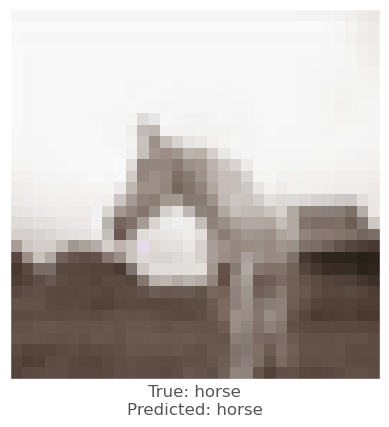



0.005153954
0.004196942
-0.0026952624
vr, vg, vb :   -2.62644527350241 -3.3294841584557897 1.4036144807866215
beam_perturbed_confidence temp :  0.59966296
beam_perturbed_confidence temp :  0.59963316
beam_perturbed_confidence temp :  0.60731506
beam_perturbed_confidence temp :  0.5907982
beam_perturbed_confidence temp :  0.59851956
beam_perturbed_confidence temp :  0.598777
beam_perturbed_confidence temp :  0.5896065
row index :  6
8th round's confidence : 3th 0.5896065
predicted class :  horse
predicted class's confidence :  0.5896065
Lopt is :  39


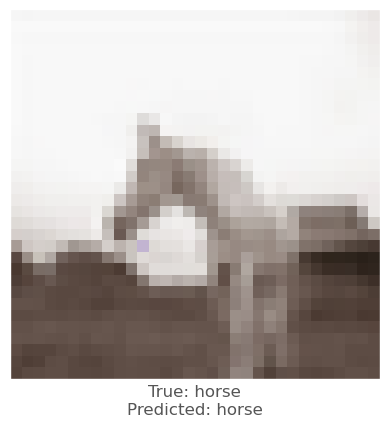



-0.00031763315
0.0016540289
-0.0033768415
vr, vg, vb :   0.27556127150136234 -0.9156758405649662 2.0732497053710226
beam_perturbed_confidence temp :  0.65386134
beam_perturbed_confidence temp :  0.6528485
beam_perturbed_confidence temp :  0.6505741
beam_perturbed_confidence temp :  0.6528485
beam_perturbed_confidence temp :  0.6505741
beam_perturbed_confidence temp :  0.6496718
beam_perturbed_confidence temp :  0.6496718
row index :  5
8th round's confidence : 4th 0.6496718
predicted class :  horse
predicted class's confidence :  0.6496718
Lopt is :  17


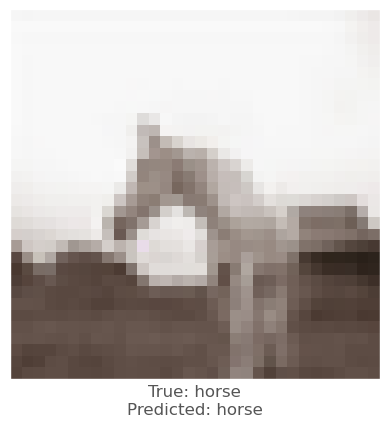



-0.0016417503
-0.00070756674
-0.004849732
vr, vg, vb :   0.6896675631048262 -0.16040937373067737 2.4221720025148574
beam_perturbed_confidence temp :  0.6810568
beam_perturbed_confidence temp :  0.68128633
beam_perturbed_confidence temp :  0.67582333
beam_perturbed_confidence temp :  0.68128633
beam_perturbed_confidence temp :  0.67582333
beam_perturbed_confidence temp :  0.676292
beam_perturbed_confidence temp :  0.676292
row index :  2
9th round's confidence : 0th 0.67582333
predicted class :  horse
predicted class's confidence :  0.67582333
Lopt is :  9


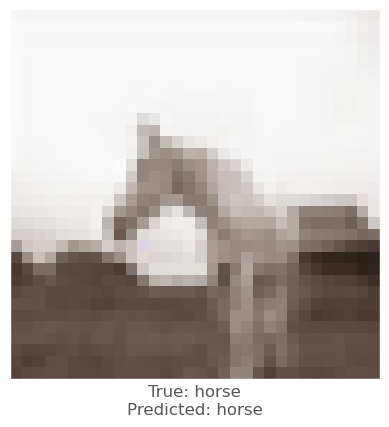



0.00010699034
-0.002540648
-0.0073367953
vr, vg, vb :   0.4295059418874562 1.4153956818512203 4.136432422350515
beam_perturbed_confidence temp :  0.6580253
beam_perturbed_confidence temp :  0.65666205
beam_perturbed_confidence temp :  0.6430304
beam_perturbed_confidence temp :  0.65666205
beam_perturbed_confidence temp :  0.6430304
beam_perturbed_confidence temp :  0.64191157
beam_perturbed_confidence temp :  0.64191157
row index :  5
9th round's confidence : 1th 0.64191157
predicted class :  horse
predicted class's confidence :  0.64191157
Lopt is :  17


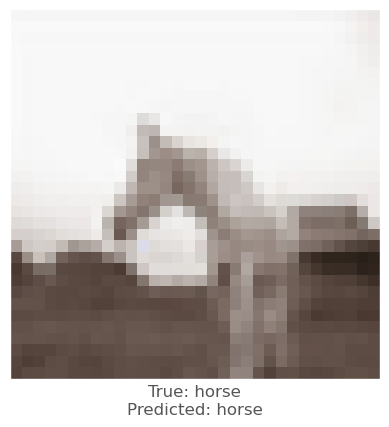



0.0010362267
0.00041162968
-0.0044837594
vr, vg, vb :   0.5316234547942937 -0.03747417802151442 2.975330426364756
beam_perturbed_confidence temp :  0.6482922
beam_perturbed_confidence temp :  0.6486175
beam_perturbed_confidence temp :  0.64410704
beam_perturbed_confidence temp :  0.6486175
beam_perturbed_confidence temp :  0.64410704
beam_perturbed_confidence temp :  0.64360815
beam_perturbed_confidence temp :  0.64360815
row index :  5
9th round's confidence : 2th 0.64360815
predicted class :  horse
predicted class's confidence :  0.64360815
Lopt is :  18


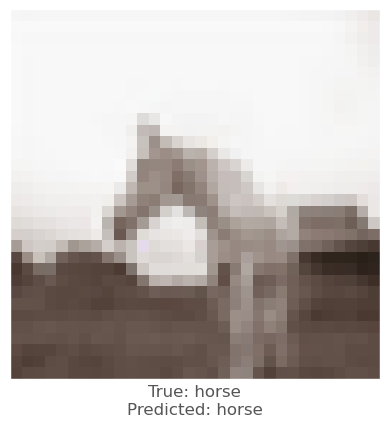



0.0051966906
0.004303038
-0.0022103786
vr, vg, vb :   -2.8834698020908895 -3.4268395546371884 1.484290897393018
beam_perturbed_confidence temp :  0.5819324
beam_perturbed_confidence temp :  0.57900566
beam_perturbed_confidence temp :  0.5885878
beam_perturbed_confidence temp :  0.5712324
beam_perturbed_confidence temp :  0.5809809
beam_perturbed_confidence temp :  0.57803303
beam_perturbed_confidence temp :  0.5705319
row index :  6
9th round's confidence : 3th 0.5705319
predicted class :  horse
predicted class's confidence :  0.5705319
Lopt is :  43


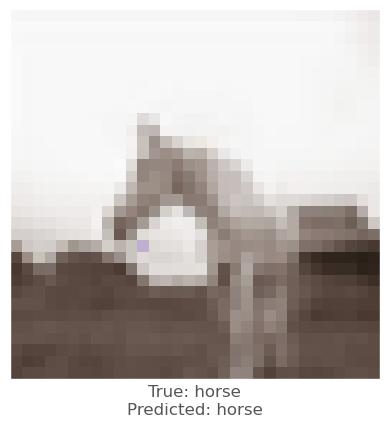



0.00014430285
0.002062261
-0.0034337044
vr, vg, vb :   0.23357485985110404 -1.0303343669668437 2.209295172455991
beam_perturbed_confidence temp :  0.6496718
beam_perturbed_confidence temp :  0.647141
beam_perturbed_confidence temp :  0.64615273
beam_perturbed_confidence temp :  0.647141
beam_perturbed_confidence temp :  0.64615273
beam_perturbed_confidence temp :  0.6437625
beam_perturbed_confidence temp :  0.6437625
row index :  5
9th round's confidence : 4th 0.6437625
predicted class :  horse
predicted class's confidence :  0.6437625
Lopt is :  19


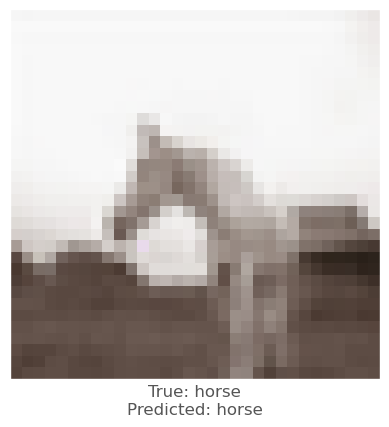



-0.001028955
-2.6285648e-05
-0.004974067
vr, vg, vb :   0.7235963050701004 -0.14173987152301493 2.677361523378484
beam_perturbed_confidence temp :  0.67582333
beam_perturbed_confidence temp :  0.676292
beam_perturbed_confidence temp :  0.6706467
beam_perturbed_confidence temp :  0.676292
beam_perturbed_confidence temp :  0.6706467
beam_perturbed_confidence temp :  0.67081636
beam_perturbed_confidence temp :  0.67081636
row index :  2
10th round's confidence : 0th 0.6706467
predicted class :  horse
predicted class's confidence :  0.6706467
Lopt is :  11


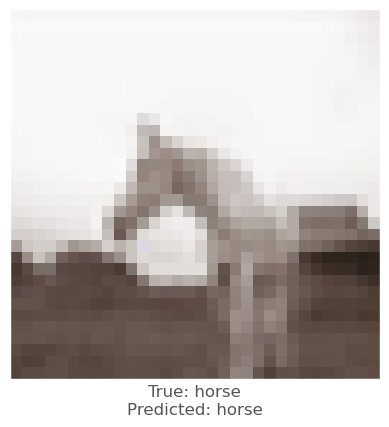



3.5345554e-05
-0.0026396513
-0.00804621
vr, vg, vb :   0.3830207922635299 1.5378212435183933 4.527410161331893
beam_perturbed_confidence temp :  0.64191157
beam_perturbed_confidence temp :  0.64039075
beam_perturbed_confidence temp :  0.6272567
beam_perturbed_confidence temp :  0.64039075
beam_perturbed_confidence temp :  0.6272567
beam_perturbed_confidence temp :  0.6267665
beam_perturbed_confidence temp :  0.6267665
row index :  5
10th round's confidence : 1th 0.6267665
predicted class :  horse
predicted class's confidence :  0.6267665
Lopt is :  21


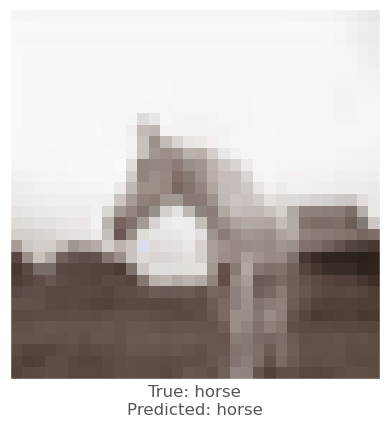



0.00052529573
2.0086765e-05
-0.0053090453
vr, vg, vb :   0.4259315358743126 -0.035735436748293645 3.208701915207162
beam_perturbed_confidence temp :  0.64360815
beam_perturbed_confidence temp :  0.64408696
beam_perturbed_confidence temp :  0.63635314
beam_perturbed_confidence temp :  0.64408696
beam_perturbed_confidence temp :  0.63635314
beam_perturbed_confidence temp :  0.6353987
beam_perturbed_confidence temp :  0.6353987
row index :  5
10th round's confidence : 2th 0.6353987
predicted class :  horse
predicted class's confidence :  0.6353987
Lopt is :  21


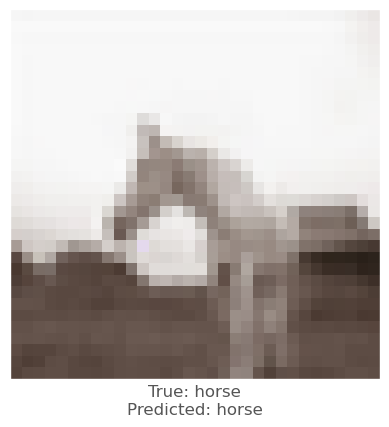



0.004992068
0.005977869
-0.0018632412
vr, vg, vb :   -3.09432960326913 -3.681942502554817 1.5221859272215874
beam_perturbed_confidence temp :  0.5579673
beam_perturbed_confidence temp :  0.55713296
beam_perturbed_confidence temp :  0.56936914
beam_perturbed_confidence temp :  0.54470325
beam_perturbed_confidence temp :  0.55673337
beam_perturbed_confidence temp :  0.5558333
beam_perturbed_confidence temp :  0.5434061
row index :  6
10th round's confidence : 3th 0.5434061
predicted class :  horse
predicted class's confidence :  0.5434061
Lopt is :  47


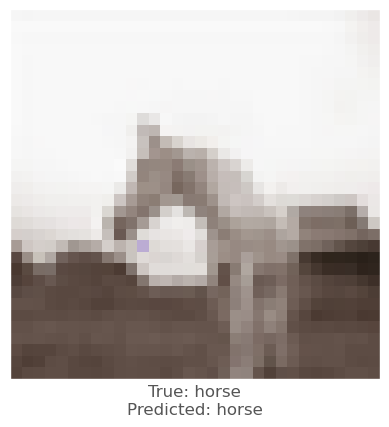



0.0004969835
0.002703011
-0.0033494234
vr, vg, vb :   0.16051902105227295 -1.1976020338620783 2.3233079960612217
beam_perturbed_confidence temp :  0.6437625
beam_perturbed_confidence temp :  0.6405742
beam_perturbed_confidence temp :  0.64055526
beam_perturbed_confidence temp :  0.6405742
beam_perturbed_confidence temp :  0.64055526
beam_perturbed_confidence temp :  0.63747555
beam_perturbed_confidence temp :  0.63747555
row index :  5
10th round's confidence : 4th 0.63747555
predicted class :  horse
predicted class's confidence :  0.63747555
Lopt is :  21


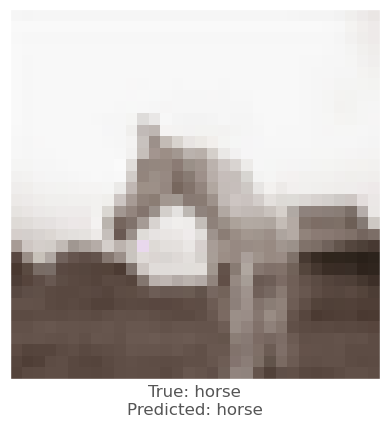



-0.000987947
-0.0007584095
-0.005904317
vr, vg, vb :   0.7500313732783004 -0.05172493435850642 3.0000570612567
beam_perturbed_confidence temp :  0.6706467
beam_perturbed_confidence temp :  0.67081636
beam_perturbed_confidence temp :  0.66032743
beam_perturbed_confidence temp :  0.67081636
beam_perturbed_confidence temp :  0.66032743
beam_perturbed_confidence temp :  0.66152763
beam_perturbed_confidence temp :  0.66152763
row index :  2
11th round's confidence : 0th 0.66032743
predicted class :  horse
predicted class's confidence :  0.66032743
Lopt is :  14


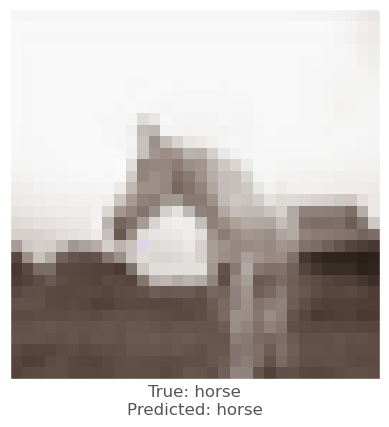



0.00093853474
-0.00070881844
-0.006267965
vr, vg, vb :   0.25086523937384686 1.4549209627334485 4.701465629192234
beam_perturbed_confidence temp :  0.6267665
beam_perturbed_confidence temp :  0.6265479
beam_perturbed_confidence temp :  0.61402756
beam_perturbed_confidence temp :  0.6265479
beam_perturbed_confidence temp :  0.61402756
beam_perturbed_confidence temp :  0.61354995
beam_perturbed_confidence temp :  0.61354995
row index :  5
11th round's confidence : 1th 0.61354995
predicted class :  horse
predicted class's confidence :  0.61354995
Lopt is :  25


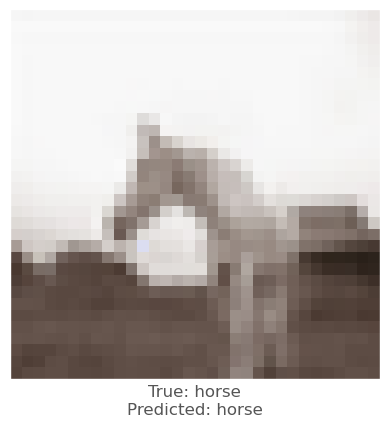



0.0010902882
0.000382483
-0.0051243305
vr, vg, vb :   0.2743095660637368 -0.07041019362583245 3.4002647757494344
beam_perturbed_confidence temp :  0.6353987
beam_perturbed_confidence temp :  0.63597065
beam_perturbed_confidence temp :  0.62856704
beam_perturbed_confidence temp :  0.63597065
beam_perturbed_confidence temp :  0.62856704
beam_perturbed_confidence temp :  0.6275028
beam_perturbed_confidence temp :  0.6275028
row index :  5
11th round's confidence : 2th 0.6275028
predicted class :  horse
predicted class's confidence :  0.6275028
Lopt is :  24


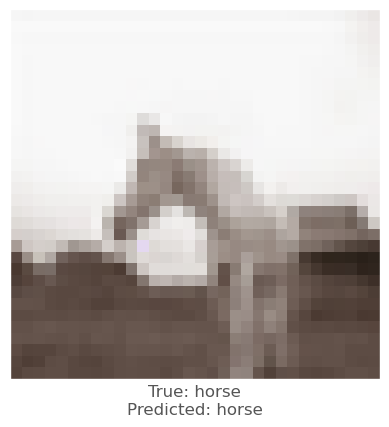



0.0069974065
0.007533431
-0.0027199388
vr, vg, vb :   -3.4846372912118704 -4.067091357615498 1.6419612100029688
beam_perturbed_confidence temp :  0.5279259
beam_perturbed_confidence temp :  0.52441096
beam_perturbed_confidence temp :  0.5419833
beam_perturbed_confidence temp :  0.5096525
beam_perturbed_confidence temp :  0.52646047
beam_perturbed_confidence temp :  0.5230783
beam_perturbed_confidence temp :  0.50840497
row index :  6
11th round's confidence : 3th 0.50840497
predicted class :  horse
predicted class's confidence :  0.50840497
Lopt is :  52


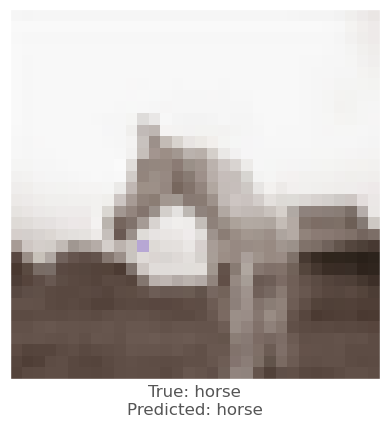



0.00070619583
0.0032974482
-0.00332129
vr, vg, vb :   0.07384753581716286 -1.4075866463022866 2.4231061980725315
beam_perturbed_confidence temp :  0.63747555
beam_perturbed_confidence temp :  0.63381296
beam_perturbed_confidence temp :  0.6342667
beam_perturbed_confidence temp :  0.63381296
beam_perturbed_confidence temp :  0.6342667
beam_perturbed_confidence temp :  0.63056725
beam_perturbed_confidence temp :  0.63056725
row index :  5
11th round's confidence : 4th 0.63056725
predicted class :  horse
predicted class's confidence :  0.63056725
Lopt is :  23


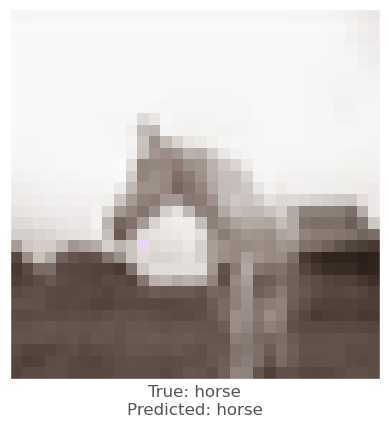



-0.0001129508
-0.0017816424
-0.0070754886
vr, vg, vb :   0.6863233161354069 0.13161180277546433 3.4076002118662596
beam_perturbed_confidence temp :  0.66032743
beam_perturbed_confidence temp :  0.66032743
beam_perturbed_confidence temp :  0.65003973
beam_perturbed_confidence temp :  0.66032743
beam_perturbed_confidence temp :  0.65003973
beam_perturbed_confidence temp :  0.65003973
beam_perturbed_confidence temp :  0.65003973
row index :  2
12th round's confidence : 0th 0.65003973
predicted class :  horse
predicted class's confidence :  0.65003973
Lopt is :  17


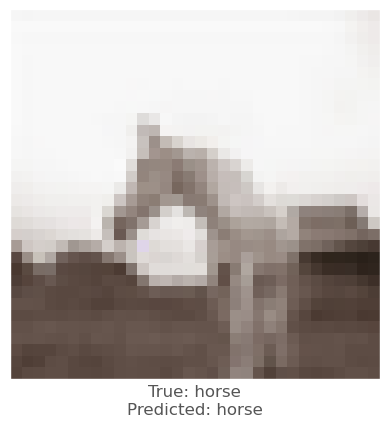



0.0013490915
0.00056529045
-0.0056778193
vr, vg, vb :   0.09086956245184305 1.2528998213551232 4.799100991474427
beam_perturbed_confidence temp :  0.61354995
beam_perturbed_confidence temp :  0.61459285
beam_perturbed_confidence temp :  0.60369074
beam_perturbed_confidence temp :  0.61459285
beam_perturbed_confidence temp :  0.60369074
beam_perturbed_confidence temp :  0.6052727
beam_perturbed_confidence temp :  0.6052727
row index :  2
12th round's confidence : 1th 0.60369074
predicted class :  horse
predicted class's confidence :  0.60369074
Lopt is :  29


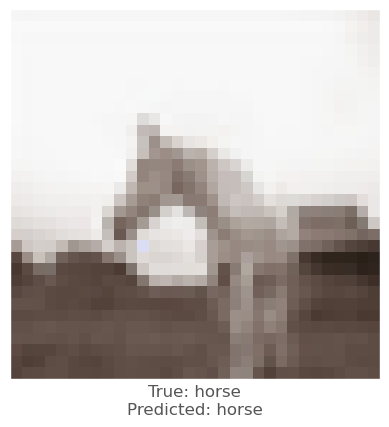



0.0020074248
0.0015010238
-0.0047562122
vr, vg, vb :   0.04613612631832503 -0.21347155120111544 3.535859521624198
beam_perturbed_confidence temp :  0.6275028
beam_perturbed_confidence temp :  0.627066
beam_perturbed_confidence temp :  0.6213246
beam_perturbed_confidence temp :  0.627066
beam_perturbed_confidence temp :  0.6213246
beam_perturbed_confidence temp :  0.620137
beam_perturbed_confidence temp :  0.620137
row index :  5
12th round's confidence : 2th 0.620137
predicted class :  horse
predicted class's confidence :  0.620137
Lopt is :  27


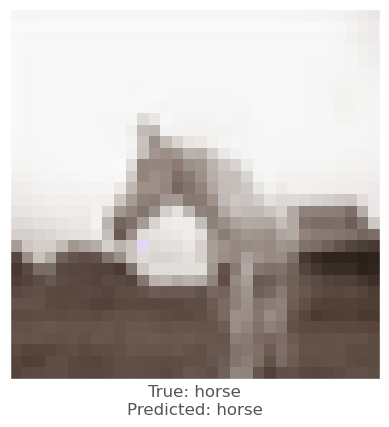



0.008165717
0.0077400208
-0.0022974014
vr, vg, vb :   -3.9527452745845797 -4.43438429704926 1.7075052318249375
beam_perturbed_confidence temp :  0.48948723
beam_perturbed_confidence temp :  0.48707902
beam_perturbed_confidence temp :  0.5073551
beam_perturbed_confidence temp :  0.47027394
beam_perturbed_confidence temp :  0.48829
beam_perturbed_confidence temp :  0.4859422
beam_perturbed_confidence temp :  0.46895558
row index :  6
12th round's confidence : 3th 0.46895558
predicted class :  airplane
predicted class's confidence :  0.5269395
Lopt is :  57


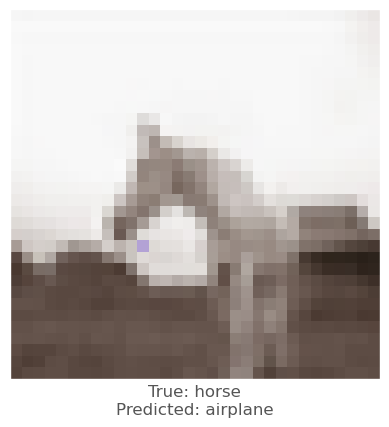




28th sensitive pixel
original confidence is :  0.69673544 

original r,g,b :  172 162 154
0.008137226
0.012947679
0.011508286
vr, vg, vb :   -0.8137226104736328 -1.2947678565979004 -1.1508285999298096
beam_perturbed_confidence temp :  0.69140244
beam_perturbed_confidence temp :  0.68134
beam_perturbed_confidence temp :  0.6837049
beam_perturbed_confidence temp :  0.67540896
beam_perturbed_confidence temp :  0.6771677
beam_perturbed_confidence temp :  0.66781324
beam_perturbed_confidence temp :  0.6610657
row index :  6
0th round's confidence : 0th 0.6610657
predicted class :  horse
predicted class's confidence :  0.6610657
Lopt is :  2


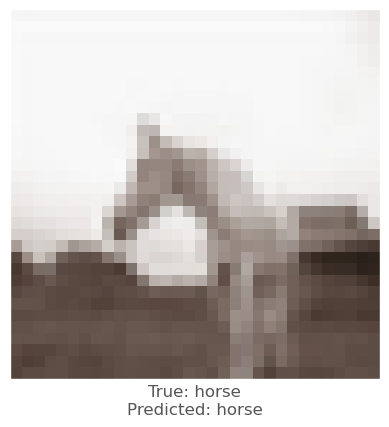



-0.0050050616
0.006034076
0.012699485
vr, vg, vb :   0.5005061626434326 -0.603407621383667 -1.2699484825134277
beam_perturbed_confidence temp :  0.6229322
beam_perturbed_confidence temp :  0.61919713
beam_perturbed_confidence temp :  0.6097466
beam_perturbed_confidence temp :  0.61919713
beam_perturbed_confidence temp :  0.6097466
beam_perturbed_confidence temp :  0.60730904
beam_perturbed_confidence temp :  0.60730904
row index :  5
0th round's confidence : 1th 0.60730904
predicted class :  horse
predicted class's confidence :  0.60730904
Lopt is :  7


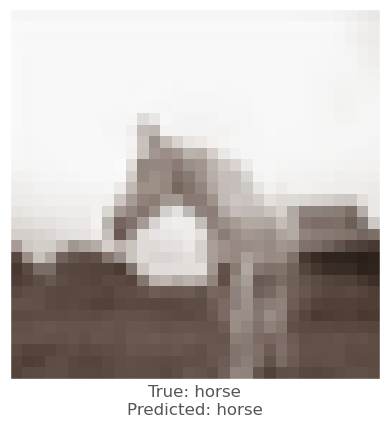



0.0037923455
0.008478284
0.0060276985
vr, vg, vb :   -0.37923455238342285 -0.8478283882141113 -0.6027698516845703
beam_perturbed_confidence temp :  0.74709815
beam_perturbed_confidence temp :  0.74503577
beam_perturbed_confidence temp :  0.74595267
beam_perturbed_confidence temp :  0.7430211
beam_perturbed_confidence temp :  0.7443403
beam_perturbed_confidence temp :  0.74276286
beam_perturbed_confidence temp :  0.73969567
row index :  6
0th round's confidence : 2th 0.73969567
predicted class :  horse
predicted class's confidence :  0.73969567
Lopt is :  4


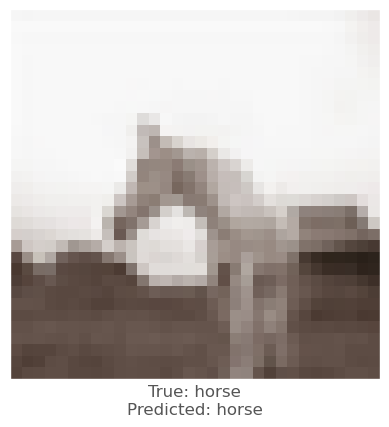



-0.009206355
-0.0011983514
0.0047765374
vr, vg, vb :   0.920635461807251 0.11983513832092285 -0.47765374183654785
beam_perturbed_confidence temp :  0.6208179
beam_perturbed_confidence temp :  0.6208179
beam_perturbed_confidence temp :  0.6188973
beam_perturbed_confidence temp :  0.6208179
beam_perturbed_confidence temp :  0.6188973
beam_perturbed_confidence temp :  0.6188973
beam_perturbed_confidence temp :  0.6188973
row index :  2
0th round's confidence : 3th 0.6188973
predicted class :  horse
predicted class's confidence :  0.6188973
Lopt is :  11


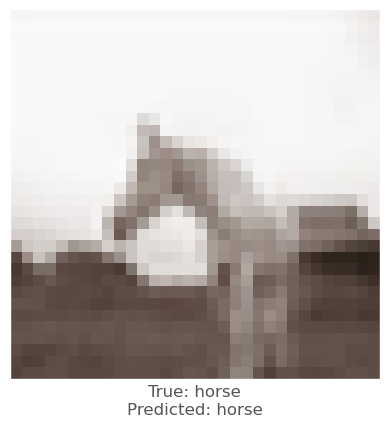



-0.0018366575
0.008979201
0.0090427995
vr, vg, vb :   0.18366575241088867 -0.8979201316833496 -0.9042799472808838
beam_perturbed_confidence temp :  0.7941172
beam_perturbed_confidence temp :  0.7892279
beam_perturbed_confidence temp :  0.78943026
beam_perturbed_confidence temp :  0.7892279
beam_perturbed_confidence temp :  0.78943026
beam_perturbed_confidence temp :  0.78482515
beam_perturbed_confidence temp :  0.78482515
row index :  5
0th round's confidence : 4th 0.78482515
predicted class :  horse
predicted class's confidence :  0.78482515
Lopt is :  10


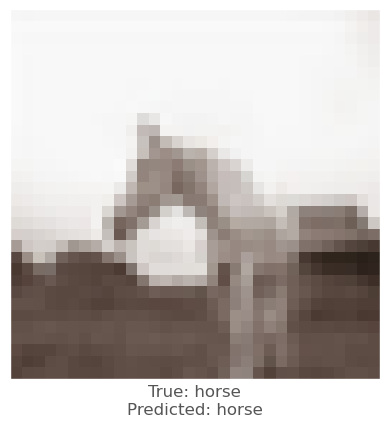



0.010805607
0.014979064
0.014015079
vr, vg, vb :   -1.812911033630371 -2.6631975173950195 -2.4372535943984985
beam_perturbed_confidence temp :  0.65431106
beam_perturbed_confidence temp :  0.6410637
beam_perturbed_confidence temp :  0.64007276
beam_perturbed_confidence temp :  0.63672614
beam_perturbed_confidence temp :  0.6331989
beam_perturbed_confidence temp :  0.62365186
beam_perturbed_confidence temp :  0.6194404
row index :  6
1th round's confidence : 0th 0.6194404
predicted class :  horse
predicted class's confidence :  0.6194404
Lopt is :  5


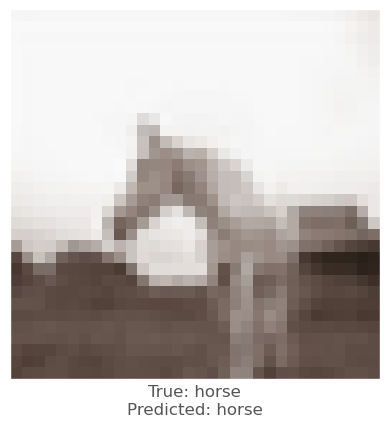



-0.0016809106
0.0038912296
0.010015011
vr, vg, vb :   0.6185466051101685 -0.9321898221969604 -2.1444547176361084
beam_perturbed_confidence temp :  0.60730904
beam_perturbed_confidence temp :  0.60585535
beam_perturbed_confidence temp :  0.5977349
beam_perturbed_confidence temp :  0.60585535
beam_perturbed_confidence temp :  0.5977349
beam_perturbed_confidence temp :  0.59992963
beam_perturbed_confidence temp :  0.59992963
row index :  2
1th round's confidence : 1th 0.5977349
predicted class :  horse
predicted class's confidence :  0.5977349
Lopt is :  10


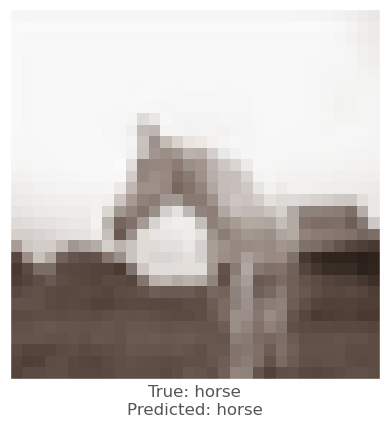



0.007076025
0.010045648
0.0069848895
vr, vg, vb :   -1.048913598060608 -1.7676103115081787 -1.2409818172454834
beam_perturbed_confidence temp :  0.7304821
beam_perturbed_confidence temp :  0.7301327
beam_perturbed_confidence temp :  0.7312781
beam_perturbed_confidence temp :  0.7270366
beam_perturbed_confidence temp :  0.72326475
beam_perturbed_confidence temp :  0.7243771
beam_perturbed_confidence temp :  0.7229396
row index :  6
1th round's confidence : 2th 0.7229396
predicted class :  horse
predicted class's confidence :  0.7229396
Lopt is :  2


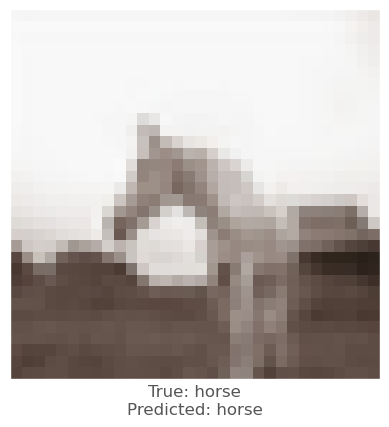



-0.007852197
-0.0029255748
0.0030278563
vr, vg, vb :   1.613791584968567 0.40040910243988037 -0.7326740026473999
beam_perturbed_confidence temp :  0.61544275
beam_perturbed_confidence temp :  0.6188973
beam_perturbed_confidence temp :  0.61779004
beam_perturbed_confidence temp :  0.61544275
beam_perturbed_confidence temp :  0.6146495
beam_perturbed_confidence temp :  0.61779004
beam_perturbed_confidence temp :  0.6146495
row index :  4
1th round's confidence : 3th 0.6146495
predicted class :  horse
predicted class's confidence :  0.6146495
Lopt is :  12


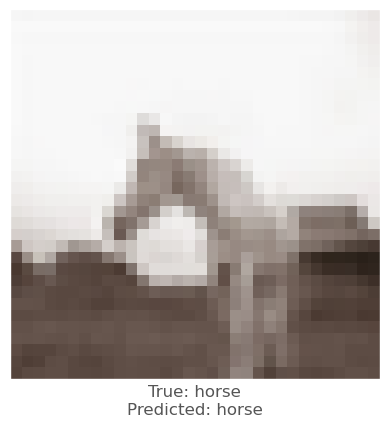



0.00070524216
0.009557426
0.008095324
vr, vg, vb :   0.09477496147155762 -1.7638707160949707 -1.6233843564987183
beam_perturbed_confidence temp :  0.78482515
beam_perturbed_confidence temp :  0.77432615
beam_perturbed_confidence temp :  0.7779336
beam_perturbed_confidence temp :  0.77432615
beam_perturbed_confidence temp :  0.7779336
beam_perturbed_confidence temp :  0.7683828
beam_perturbed_confidence temp :  0.7683828
row index :  5
1th round's confidence : 4th 0.7683828
predicted class :  horse
predicted class's confidence :  0.7683828
Lopt is :  10


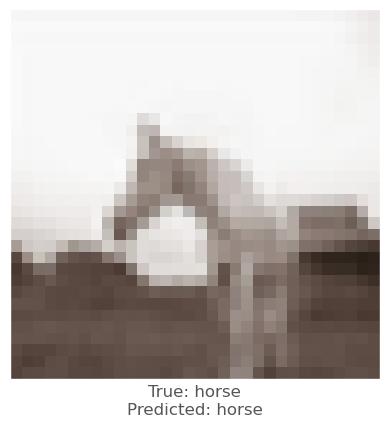



0.001057148
0.005226791
0.010595858
vr, vg, vb :   -1.7373347282409668 -2.9195568561553955 -3.2531140446662903
beam_perturbed_confidence temp :  0.6229322
beam_perturbed_confidence temp :  0.61481035
beam_perturbed_confidence temp :  0.6010166
beam_perturbed_confidence temp :  0.6134544
beam_perturbed_confidence temp :  0.6001731
beam_perturbed_confidence temp :  0.5998973
beam_perturbed_confidence temp :  0.60322964
row index :  5
2th round's confidence : 0th 0.5998973
predicted class :  horse
predicted class's confidence :  0.5998973
Lopt is :  9


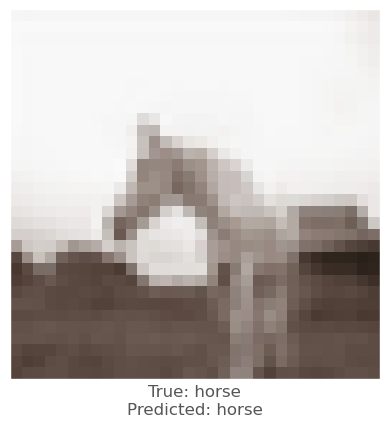



-0.0047321916
-0.003094256
0.0033353567
vr, vg, vb :   1.0299111008644104 -0.529545247554779 -2.2635449171066284
beam_perturbed_confidence temp :  0.5962023
beam_perturbed_confidence temp :  0.59992963
beam_perturbed_confidence temp :  0.59608394
beam_perturbed_confidence temp :  0.59698683
beam_perturbed_confidence temp :  0.59214896
beam_perturbed_confidence temp :  0.5983677
beam_perturbed_confidence temp :  0.5958511
row index :  4
2th round's confidence : 1th 0.59214896
predicted class :  horse
predicted class's confidence :  0.59214896
Lopt is :  13


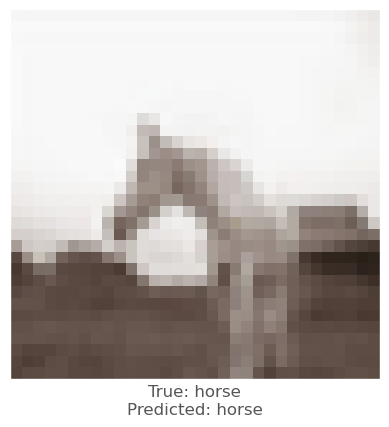



0.0051187277
0.0075876117
0.005710423
vr, vg, vb :   -1.4558950066566467 -2.349610447883606 -1.687925934791565
beam_perturbed_confidence temp :  0.7144261
beam_perturbed_confidence temp :  0.70551896
beam_perturbed_confidence temp :  0.7145128
beam_perturbed_confidence temp :  0.7016538
beam_perturbed_confidence temp :  0.7061721
beam_perturbed_confidence temp :  0.70032233
beam_perturbed_confidence temp :  0.68875915
row index :  6
2th round's confidence : 2th 0.68875915
predicted class :  horse
predicted class's confidence :  0.68875915
Lopt is :  1


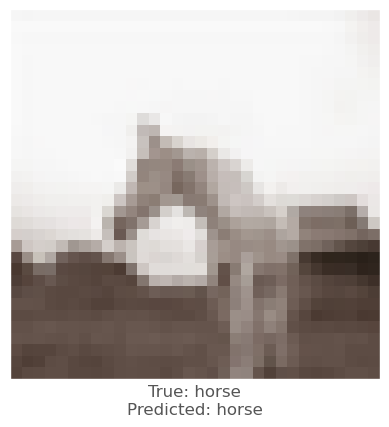



-0.006434977
-0.0037986636
0.001617372
vr, vg, vb :   2.095910131931305 0.7402345538139343 -0.8211438059806824
beam_perturbed_confidence temp :  0.607469
beam_perturbed_confidence temp :  0.6146495
beam_perturbed_confidence temp :  0.6138254
beam_perturbed_confidence temp :  0.607469
beam_perturbed_confidence temp :  0.6070991
beam_perturbed_confidence temp :  0.6138254
beam_perturbed_confidence temp :  0.6070991
row index :  4
2th round's confidence : 3th 0.6070991
predicted class :  horse
predicted class's confidence :  0.6070991
Lopt is :  13


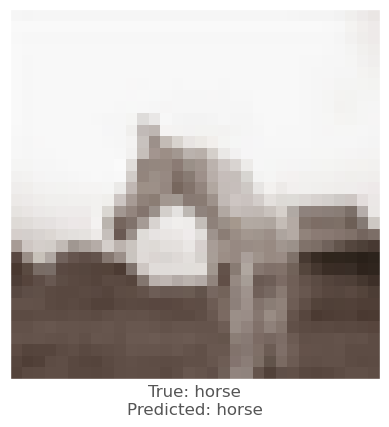



0.0050578117
0.008462548
0.006103039
vr, vg, vb :   -0.42048370838165283 -2.4337384700775146 -2.071349799633026
beam_perturbed_confidence temp :  0.7659416
beam_perturbed_confidence temp :  0.76005924
beam_perturbed_confidence temp :  0.7588239
beam_perturbed_confidence temp :  0.756926
beam_perturbed_confidence temp :  0.7568548
beam_perturbed_confidence temp :  0.75150764
beam_perturbed_confidence temp :  0.7486076
row index :  6
2th round's confidence : 4th 0.7486076
predicted class :  horse
predicted class's confidence :  0.7486076
Lopt is :  9


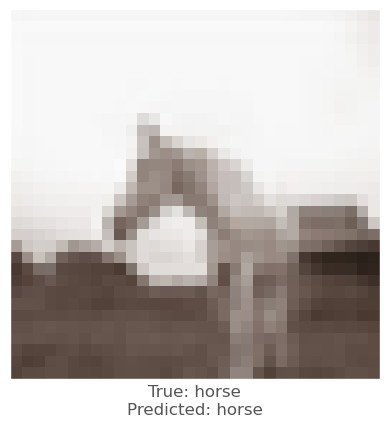



0.001466155
-0.0034125447
0.0038653016
vr, vg, vb :   -1.710216760635376 -2.286346697807312 -3.314332801103592
beam_perturbed_confidence temp :  0.60322964
beam_perturbed_confidence temp :  0.6081454
beam_perturbed_confidence temp :  0.59777445
beam_perturbed_confidence temp :  0.60859144
beam_perturbed_confidence temp :  0.5994472
beam_perturbed_confidence temp :  0.6057545
beam_perturbed_confidence temp :  0.60360557
row index :  2
3th round's confidence : 0th 0.59777445
predicted class :  horse
predicted class's confidence :  0.59777445
Lopt is :  13


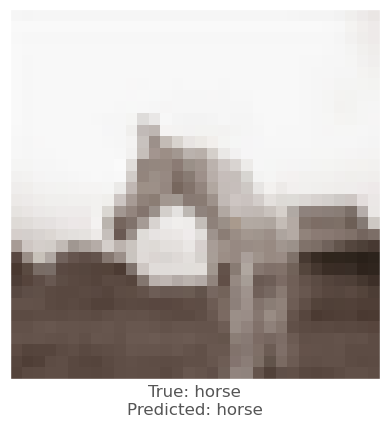



-0.0052062273
-0.0060951114
0.00044870377
vr, vg, vb :   1.4475427210330962 0.13292041420936584 -2.08206080198288
beam_perturbed_confidence temp :  0.5908777
beam_perturbed_confidence temp :  0.59214896
beam_perturbed_confidence temp :  0.5928282
beam_perturbed_confidence temp :  0.5908777
beam_perturbed_confidence temp :  0.5917049
beam_perturbed_confidence temp :  0.5928282
beam_perturbed_confidence temp :  0.5917049
row index :  0
3th round's confidence : 1th 0.5908777
predicted class :  horse
predicted class's confidence :  0.5908777
Lopt is :  13


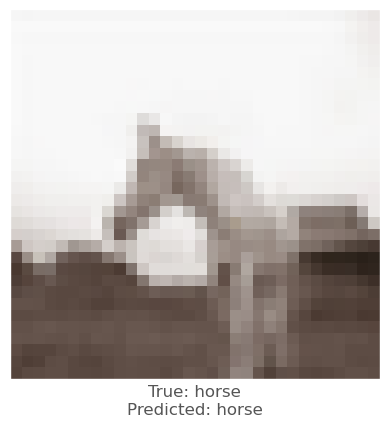



0.011679471
0.0153954625
0.013407528
vr, vg, vb :   -2.478252559900284 -3.6541956543922427 -2.859886181354523
beam_perturbed_confidence temp :  0.6718111
beam_perturbed_confidence temp :  0.65909535
beam_perturbed_confidence temp :  0.6685831
beam_perturbed_confidence temp :  0.65106833
beam_perturbed_confidence temp :  0.6538694
beam_perturbed_confidence temp :  0.6406881
beam_perturbed_confidence temp :  0.6300805
row index :  6
3th round's confidence : 2th 0.6300805
predicted class :  horse
predicted class's confidence :  0.6300805
Lopt is :  5


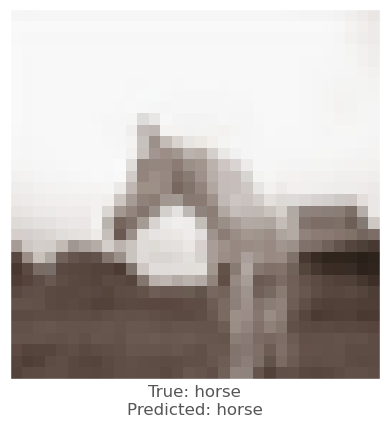



-0.0075089335
-0.005280614
0.0007387996
vr, vg, vb :   2.637212473154068 1.1942724883556366 -0.8129093825817109
beam_perturbed_confidence temp :  0.60156053
beam_perturbed_confidence temp :  0.60438114
beam_perturbed_confidence temp :  0.6067302
beam_perturbed_confidence temp :  0.60028577
beam_perturbed_confidence temp :  0.6011273
beam_perturbed_confidence temp :  0.6037947
beam_perturbed_confidence temp :  0.5992878
row index :  6
3th round's confidence : 3th 0.5992878
predicted class :  horse
predicted class's confidence :  0.5992878
Lopt is :  14


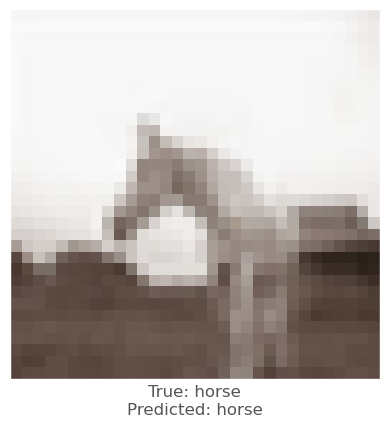



0.0053822994
0.004452944
0.004325211
vr, vg, vb :   -0.9166652798652649 -2.6356590032577514 -2.2967359244823458
beam_perturbed_confidence temp :  0.74612534
beam_perturbed_confidence temp :  0.7446758
beam_perturbed_confidence temp :  0.7436651
beam_perturbed_confidence temp :  0.74166524
beam_perturbed_confidence temp :  0.73952144
beam_perturbed_confidence temp :  0.7431039
beam_perturbed_confidence temp :  0.7384617
row index :  6
3th round's confidence : 4th 0.7384617
predicted class :  horse
predicted class's confidence :  0.7384617
Lopt is :  8


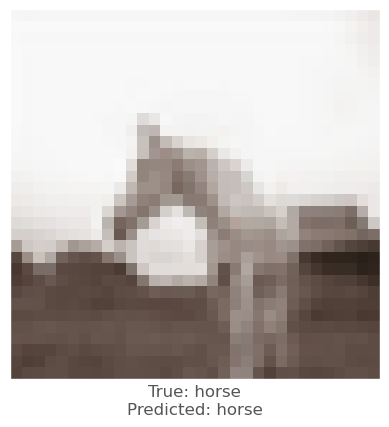



-0.00080519915
-0.0056638718
0.0004965067
vr, vg, vb :   -1.4586751699447633 -1.4913248515129087 -3.0325501900911336
beam_perturbed_confidence temp :  0.5994472
beam_perturbed_confidence temp :  0.60297406
beam_perturbed_confidence temp :  0.5993945
beam_perturbed_confidence temp :  0.60156053
beam_perturbed_confidence temp :  0.5958446
beam_perturbed_confidence temp :  0.6073299
beam_perturbed_confidence temp :  0.6031364
row index :  4
4th round's confidence : 0th 0.5958446
predicted class :  horse
predicted class's confidence :  0.5958446
Lopt is :  17


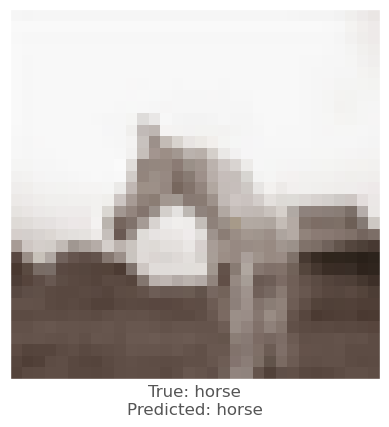



-0.00041556358
-0.0050524473
0.0012264848
vr, vg, vb :   1.344344807267189 0.6248731046915055 -1.9965031993389133
beam_perturbed_confidence temp :  0.5917334
beam_perturbed_confidence temp :  0.5908777
beam_perturbed_confidence temp :  0.5911097
beam_perturbed_confidence temp :  0.5917334
beam_perturbed_confidence temp :  0.59082484
beam_perturbed_confidence temp :  0.5911097
beam_perturbed_confidence temp :  0.59082484
row index :  4
4th round's confidence : 1th 0.59082484
predicted class :  horse
predicted class's confidence :  0.59082484
Lopt is :  15


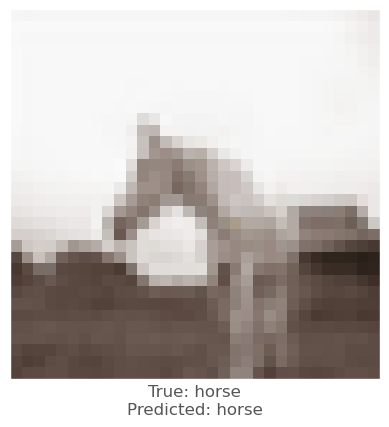



-0.0006278157
0.008062303
0.011622906
vr, vg, vb :   -2.1676457315683364 -4.095006395578385 -3.736188136339188
beam_perturbed_confidence temp :  0.63557106
beam_perturbed_confidence temp :  0.61802053
beam_perturbed_confidence temp :  0.60949856
beam_perturbed_confidence temp :  0.6225179
beam_perturbed_confidence temp :  0.61290395
beam_perturbed_confidence temp :  0.6087495
beam_perturbed_confidence temp :  0.6139962
row index :  5
4th round's confidence : 2th 0.6087495
predicted class :  horse
predicted class's confidence :  0.6087495
Lopt is :  10


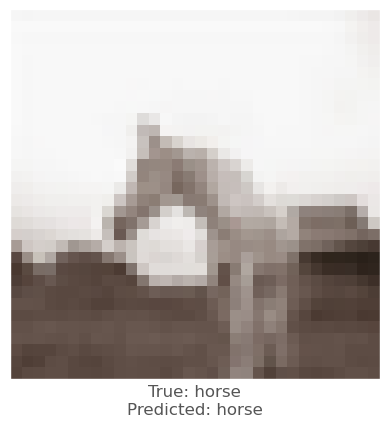



-0.00084781647
-0.0028758645
0.0016405582
vr, vg, vb :   2.4582728725671767 1.3624316900968552 -0.895674268603325
beam_perturbed_confidence temp :  0.60092336
beam_perturbed_confidence temp :  0.59825146
beam_perturbed_confidence temp :  0.5986452
beam_perturbed_confidence temp :  0.59762216
beam_perturbed_confidence temp :  0.60122764
beam_perturbed_confidence temp :  0.5971152
beam_perturbed_confidence temp :  0.59878224
row index :  5
4th round's confidence : 3th 0.5971152
predicted class :  horse
predicted class's confidence :  0.5971152
Lopt is :  15


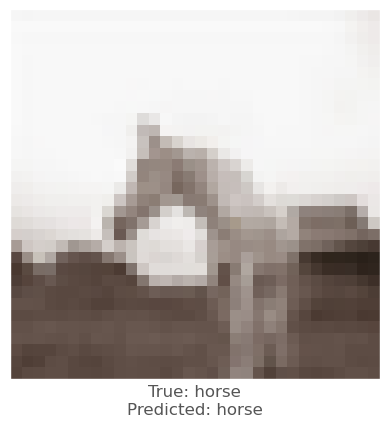



0.008011997
-0.001109302
0.00057286024
vr, vg, vb :   -1.6261984264850615 -2.261162898540497 -2.124348356127739
beam_perturbed_confidence temp :  0.7299241
beam_perturbed_confidence temp :  0.7393094
beam_perturbed_confidence temp :  0.7365275
beam_perturbed_confidence temp :  0.7209534
beam_perturbed_confidence temp :  0.7276327
beam_perturbed_confidence temp :  0.72432107
beam_perturbed_confidence temp :  0.70966333
row index :  6
4th round's confidence : 4th 0.70966333
predicted class :  horse
predicted class's confidence :  0.70966333
Lopt is :  6


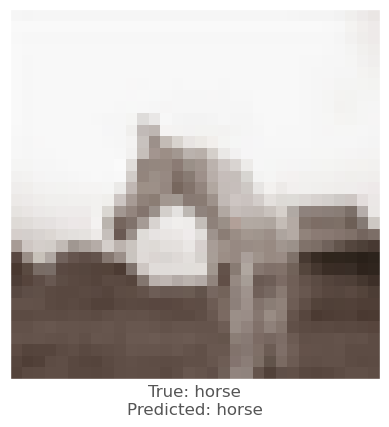



0.0012621284
-0.005425751
-0.00046479702
vr, vg, vb :   -1.4390204882621767 -0.7996172454357147 -2.6828154690861705
beam_perturbed_confidence temp :  0.59956557
beam_perturbed_confidence temp :  0.59922
beam_perturbed_confidence temp :  0.59840673
beam_perturbed_confidence temp :  0.60242206
beam_perturbed_confidence temp :  0.5987936
beam_perturbed_confidence temp :  0.60311115
beam_perturbed_confidence temp :  0.604931
row index :  2
5th round's confidence : 0th 0.59840673
predicted class :  horse
predicted class's confidence :  0.59840673
Lopt is :  20


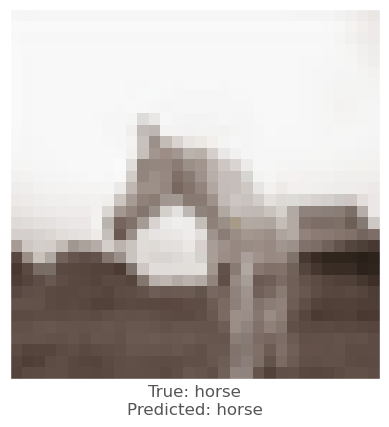



0.0023302436
-0.0066176653
-0.0014538169
vr, vg, vb :   0.9768859677910806 1.2241523233056069 -1.6514711903333668
beam_perturbed_confidence temp :  0.59082484
beam_perturbed_confidence temp :  0.58883977
beam_perturbed_confidence temp :  0.594349
beam_perturbed_confidence temp :  0.58883977
beam_perturbed_confidence temp :  0.594349
beam_perturbed_confidence temp :  0.58912027
beam_perturbed_confidence temp :  0.58912027
row index :  1
5th round's confidence : 1th 0.58883977
predicted class :  horse
predicted class's confidence :  0.58883977
Lopt is :  15


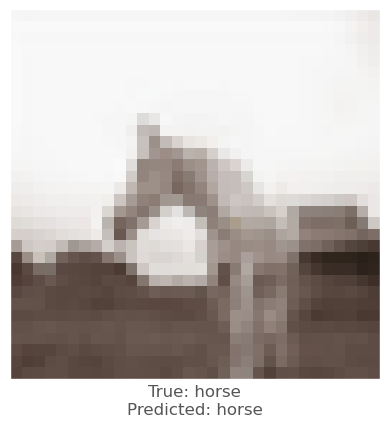



0.00051033497
-0.0041056275
0.0035543442
vr, vg, vb :   -2.0019146552681923 -3.2749430023431785 -3.7180037404298782
beam_perturbed_confidence temp :  0.6139962
beam_perturbed_confidence temp :  0.61466324
beam_perturbed_confidence temp :  0.60348964
beam_perturbed_confidence temp :  0.61814886
beam_perturbed_confidence temp :  0.60562766
beam_perturbed_confidence temp :  0.6143975
beam_perturbed_confidence temp :  0.6176723
row index :  2
5th round's confidence : 2th 0.60348964
predicted class :  horse
predicted class's confidence :  0.60348964
Lopt is :  11


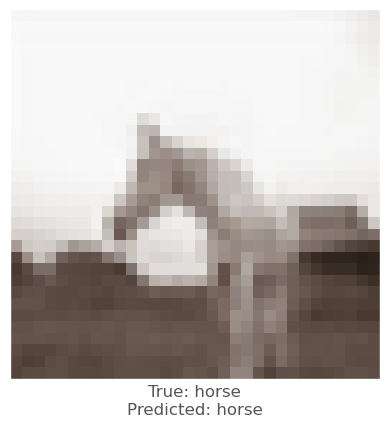



-0.00071668625
-0.0022631884
0.0020628572
vr, vg, vb :   2.2841142101883887 1.452507357299328 -1.0123925568461418
beam_perturbed_confidence temp :  0.59878224
beam_perturbed_confidence temp :  0.596382
beam_perturbed_confidence temp :  0.5958446
beam_perturbed_confidence temp :  0.5947399
beam_perturbed_confidence temp :  0.5993945
beam_perturbed_confidence temp :  0.5937942
beam_perturbed_confidence temp :  0.5970587
row index :  5
5th round's confidence : 3th 0.5937942
predicted class :  horse
predicted class's confidence :  0.5937942
Lopt is :  17


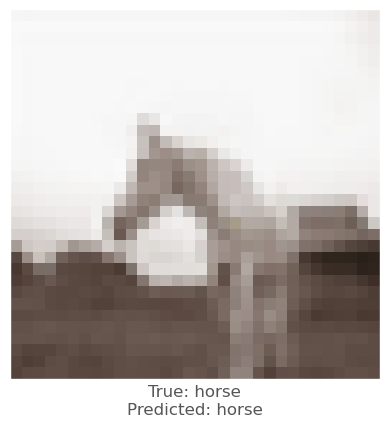



0.0105365515
0.011527419
0.0061214566
vr, vg, vb :   -2.5172337313890454 -3.187788517713547 -2.524059182822705
beam_perturbed_confidence temp :  0.6943829
beam_perturbed_confidence temp :  0.683019
beam_perturbed_confidence temp :  0.6991749
beam_perturbed_confidence temp :  0.6586897
beam_perturbed_confidence temp :  0.67546415
beam_perturbed_confidence temp :  0.6638769
beam_perturbed_confidence temp :  0.6435136
row index :  6
5th round's confidence : 4th 0.6435136
predicted class :  horse
predicted class's confidence :  0.6435136
Lopt is :  6


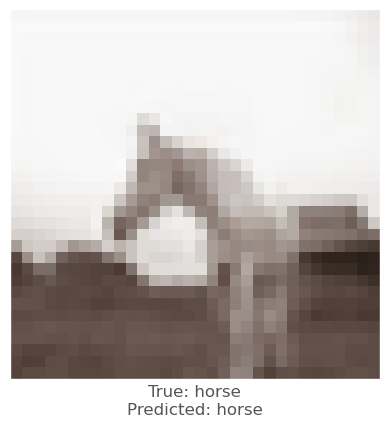



0.002990663
-0.008240879
-0.0022811294
vr, vg, vb :   -1.5941847445964814 0.10443233730793 -2.186420986157656
beam_perturbed_confidence temp :  0.5987936
beam_perturbed_confidence temp :  0.59840673
beam_perturbed_confidence temp :  0.6055586
beam_perturbed_confidence temp :  0.5987936
beam_perturbed_confidence temp :  0.6049355
beam_perturbed_confidence temp :  0.6055586
beam_perturbed_confidence temp :  0.6049355
row index :  1
6th round's confidence : 0th 0.59840673
predicted class :  horse
predicted class's confidence :  0.59840673
Lopt is :  20


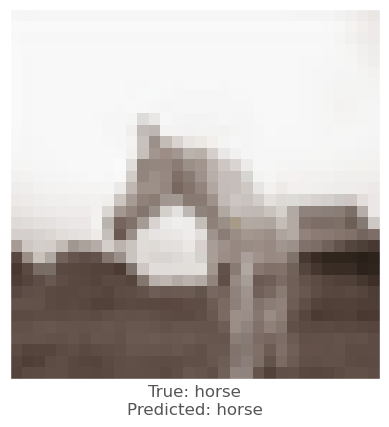



0.004365444
-0.0015345812
0.0019527674
vr, vg, vb :   0.44265295267701166 1.2551952094137668 -1.6816008085131648
beam_perturbed_confidence temp :  0.58883977
beam_perturbed_confidence temp :  0.58929026
beam_perturbed_confidence temp :  0.58912027
beam_perturbed_confidence temp :  0.58929026
beam_perturbed_confidence temp :  0.58912027
beam_perturbed_confidence temp :  0.586246
beam_perturbed_confidence temp :  0.586246
row index :  5
6th round's confidence : 1th 0.586246
predicted class :  horse
predicted class's confidence :  0.586246
Lopt is :  17


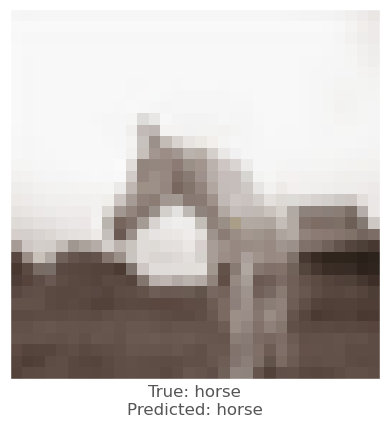



0.0008264184
-0.0044083595
0.0016030073
vr, vg, vb :   -1.8843650297224523 -2.506612749350072 -3.506504098045826
beam_perturbed_confidence temp :  0.6031975
beam_perturbed_confidence temp :  0.6101964
beam_perturbed_confidence temp :  0.60419416
beam_perturbed_confidence temp :  0.61033046
beam_perturbed_confidence temp :  0.6010127
beam_perturbed_confidence temp :  0.61508137
beam_perturbed_confidence temp :  0.61634105
row index :  4
6th round's confidence : 2th 0.6010127
predicted class :  horse
predicted class's confidence :  0.6010127
Lopt is :  15


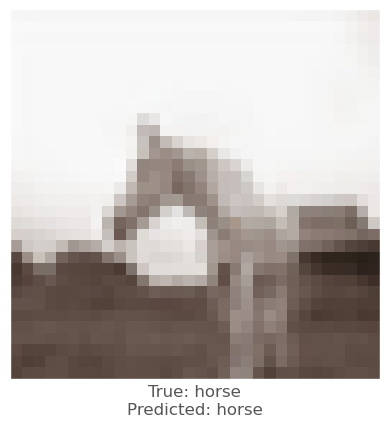



0.00019341707
-0.0033442974
0.0019581914
vr, vg, vb :   2.0363610819399356 1.6416863624751568 -1.1069724406421186
beam_perturbed_confidence temp :  0.5970587
beam_perturbed_confidence temp :  0.5925003
beam_perturbed_confidence temp :  0.59387594
beam_perturbed_confidence temp :  0.59313124
beam_perturbed_confidence temp :  0.5988018
beam_perturbed_confidence temp :  0.5904726
beam_perturbed_confidence temp :  0.59544265
row index :  5
6th round's confidence : 3th 0.5904726
predicted class :  horse
predicted class's confidence :  0.5904726
Lopt is :  19


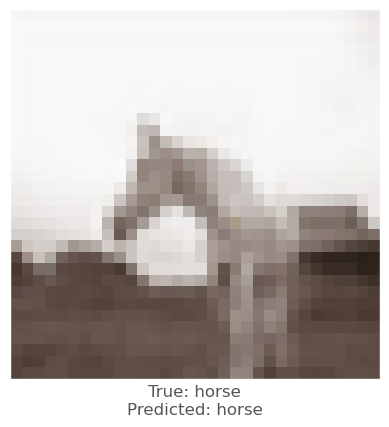



0.012720466
0.008384824
0.009007573
vr, vg, vb :   -3.5375569242596625 -3.7074920458555223 -3.172410577315093
beam_perturbed_confidence temp :  0.6212298
beam_perturbed_confidence temp :  0.62901527
beam_perturbed_confidence temp :  0.6252544
beam_perturbed_confidence temp :  0.61703783
beam_perturbed_confidence temp :  0.6047198
beam_perturbed_confidence temp :  0.6231907
beam_perturbed_confidence temp :  0.60651296
row index :  4
6th round's confidence : 4th 0.6047198
predicted class :  horse
predicted class's confidence :  0.6047198
Lopt is :  9


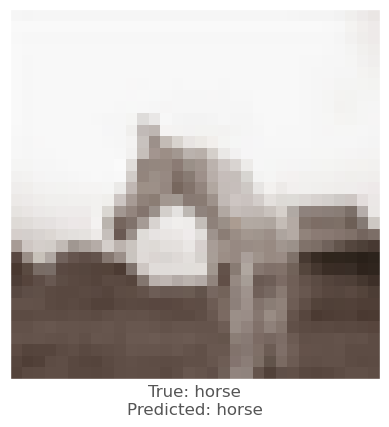



0.002990663
-0.008240879
-0.0022811294
vr, vg, vb :   -1.7338325752973558 0.9180769617772102 -1.739665951521993
beam_perturbed_confidence temp :  0.5987936
beam_perturbed_confidence temp :  0.59840673
beam_perturbed_confidence temp :  0.60263205
beam_perturbed_confidence temp :  0.5987936
beam_perturbed_confidence temp :  0.6023181
beam_perturbed_confidence temp :  0.60263205
beam_perturbed_confidence temp :  0.6023181
row index :  1
7th round's confidence : 0th 0.59840673
predicted class :  horse
predicted class's confidence :  0.59840673
Lopt is :  20


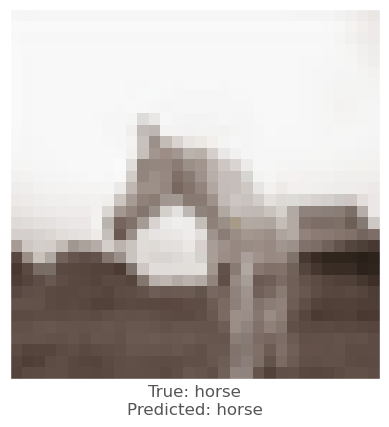



0.006508887
-0.0019977689
0.001250267
vr, vg, vb :   -0.2525010240024327 1.329452576366067 -1.6384674305427078
beam_perturbed_confidence temp :  0.5847398
beam_perturbed_confidence temp :  0.5871225
beam_perturbed_confidence temp :  0.5884628
beam_perturbed_confidence temp :  0.58392453
beam_perturbed_confidence temp :  0.58690053
beam_perturbed_confidence temp :  0.5848714
beam_perturbed_confidence temp :  0.5828232
row index :  6
7th round's confidence : 1th 0.5828232
predicted class :  horse
predicted class's confidence :  0.5828232
Lopt is :  19


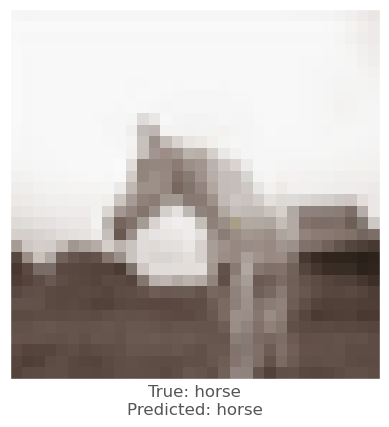



0.00011467934
-0.0059458017
-0.0007099509
vr, vg, vb :   -1.7073964604049923 -1.661371300922633 -3.084858595849276
beam_perturbed_confidence temp :  0.6060689
beam_perturbed_confidence temp :  0.60967374
beam_perturbed_confidence temp :  0.60592085
beam_perturbed_confidence temp :  0.6124183
beam_perturbed_confidence temp :  0.60908026
beam_perturbed_confidence temp :  0.6191299
beam_perturbed_confidence temp :  0.62077254
row index :  2
7th round's confidence : 2th 0.60592085
predicted class :  horse
predicted class's confidence :  0.60592085
Lopt is :  19


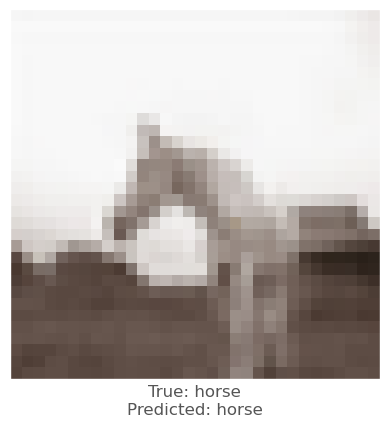



0.0018723011
-0.005394995
-5.0723553e-05
vr, vg, vb :   1.645494863577485 2.0170172474831345 -0.991202841307521
beam_perturbed_confidence temp :  0.5923992
beam_perturbed_confidence temp :  0.5877563
beam_perturbed_confidence temp :  0.5912348
beam_perturbed_confidence temp :  0.5871605
beam_perturbed_confidence temp :  0.5936262
beam_perturbed_confidence temp :  0.5865312
beam_perturbed_confidence temp :  0.58757234
row index :  5
7th round's confidence : 3th 0.5865312
predicted class :  horse
predicted class's confidence :  0.5865312
Lopt is :  20


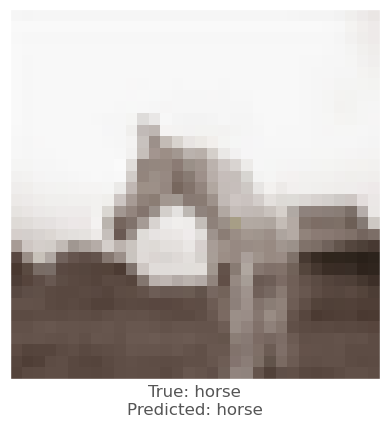



0.0053557754
-1.603365e-05
0.0061478615
vr, vg, vb :   -3.7193787674629686 -3.335139476325512 -3.469955667654873
beam_perturbed_confidence temp :  0.59999716
beam_perturbed_confidence temp :  0.60651296
beam_perturbed_confidence temp :  0.5942166
beam_perturbed_confidence temp :  0.608046
beam_perturbed_confidence temp :  0.59608394
beam_perturbed_confidence temp :  0.60845435
beam_perturbed_confidence temp :  0.60156053
row index :  2
7th round's confidence : 4th 0.5942166
predicted class :  horse
predicted class's confidence :  0.5942166
Lopt is :  13


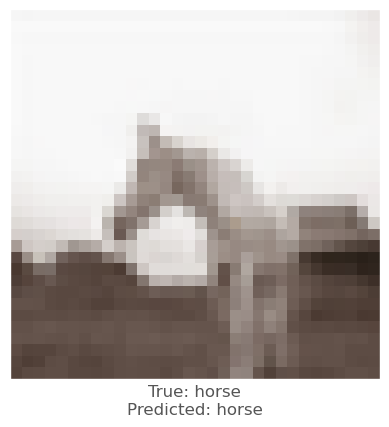



0.002990663
-0.008240879
-0.0022811294
vr, vg, vb :   -1.8595156229281427 1.6503571237995625 -1.3375864203498962
beam_perturbed_confidence temp :  0.5987936
beam_perturbed_confidence temp :  0.59487027
beam_perturbed_confidence temp :  0.60263205
beam_perturbed_confidence temp :  0.59525955
beam_perturbed_confidence temp :  0.6023181
beam_perturbed_confidence temp :  0.59823465
beam_perturbed_confidence temp :  0.59622616
row index :  1
8th round's confidence : 0th 0.59487027
predicted class :  horse
predicted class's confidence :  0.59487027
Lopt is :  20


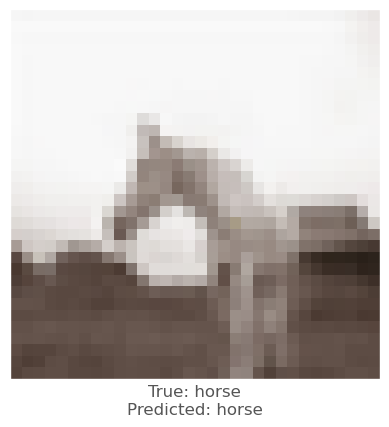



0.0016335845
-0.004822731
-0.0018627048
vr, vg, vb :   -0.3906093715381025 1.678780420536101 -1.2883502121008639
beam_perturbed_confidence temp :  0.5832378
beam_perturbed_confidence temp :  0.5820778
beam_perturbed_confidence temp :  0.5880904
beam_perturbed_confidence temp :  0.58104914
beam_perturbed_confidence temp :  0.58583194
beam_perturbed_confidence temp :  0.5837037
beam_perturbed_confidence temp :  0.58264184
row index :  3
8th round's confidence : 1th 0.58104914
predicted class :  horse
predicted class's confidence :  0.58104914
Lopt is :  19


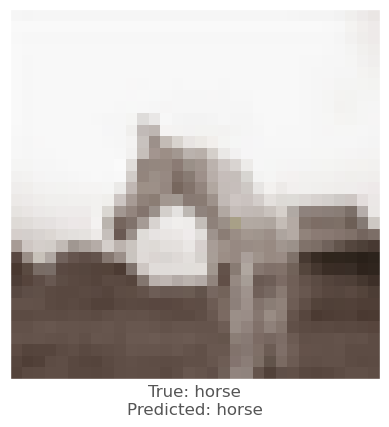



0.00035601854
-0.010168254
-0.0036749244
vr, vg, vb :   -1.5722586686888338 -0.47840873328459343 -2.4088802989016775
beam_perturbed_confidence temp :  0.60908026
beam_perturbed_confidence temp :  0.61185896
beam_perturbed_confidence temp :  0.6135362
beam_perturbed_confidence temp :  0.61488104
beam_perturbed_confidence temp :  0.61484396
beam_perturbed_confidence temp :  0.6198646
beam_perturbed_confidence temp :  0.6200591
row index :  0
8th round's confidence : 2th 0.60908026
predicted class :  horse
predicted class's confidence :  0.60908026
Lopt is :  19


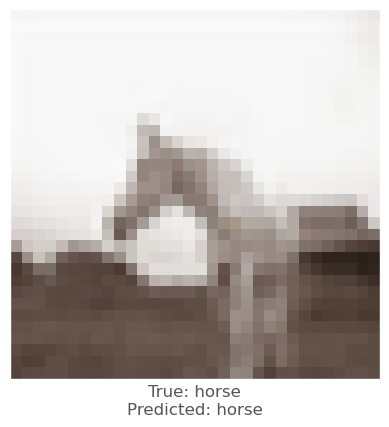



0.00039172173
-0.0022918582
0.001886487
vr, vg, vb :   1.4417732046733498 2.0445013423606753 -1.0807312578908803
beam_perturbed_confidence temp :  0.58757234
beam_perturbed_confidence temp :  0.5827266
beam_perturbed_confidence temp :  0.5870673
beam_perturbed_confidence temp :  0.58159953
beam_perturbed_confidence temp :  0.5904544
beam_perturbed_confidence temp :  0.5814481
beam_perturbed_confidence temp :  0.5832941
row index :  5
8th round's confidence : 3th 0.5814481
predicted class :  horse
predicted class's confidence :  0.5814481
Lopt is :  22


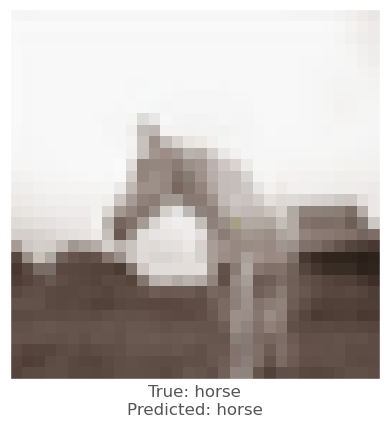



0.006215036
-0.0013282895
0.00271976
vr, vg, vb :   -3.9689444822541473 -2.868796577811003 -3.394936094999493
beam_perturbed_confidence temp :  0.59608394
beam_perturbed_confidence temp :  0.60417145
beam_perturbed_confidence temp :  0.5965987
beam_perturbed_confidence temp :  0.60028577
beam_perturbed_confidence temp :  0.5925003
beam_perturbed_confidence temp :  0.6105145
beam_perturbed_confidence temp :  0.59922
row index :  4
8th round's confidence : 4th 0.5925003
predicted class :  horse
predicted class's confidence :  0.5925003
Lopt is :  17


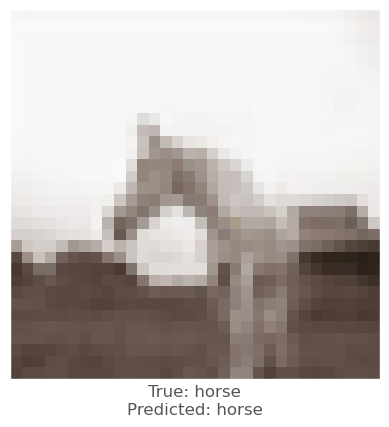



0.003949225
-0.007171929
-0.0018239021
vr, vg, vb :   -2.0684865555236343 2.202514299679494 -1.0214375653022112
beam_perturbed_confidence temp :  0.5993384
beam_perturbed_confidence temp :  0.5878838
beam_perturbed_confidence temp :  0.59823465
beam_perturbed_confidence temp :  0.5916955
beam_perturbed_confidence temp :  0.59871894
beam_perturbed_confidence temp :  0.59024084
beam_perturbed_confidence temp :  0.59167975
row index :  1
9th round's confidence : 0th 0.5878838
predicted class :  horse
predicted class's confidence :  0.5878838
Lopt is :  20


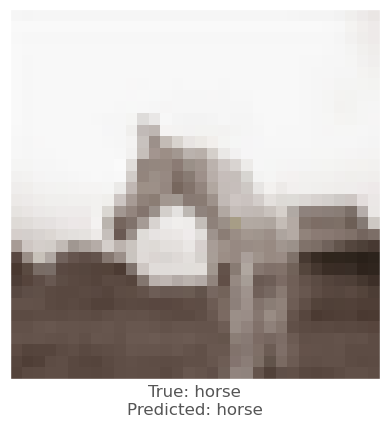



-0.0013995767
-0.001960814
0.00049585104
vr, vg, vb :   -0.2115907679871975 1.7069837784000934 -1.209100294879425
beam_perturbed_confidence temp :  0.5834774
beam_perturbed_confidence temp :  0.581277
beam_perturbed_confidence temp :  0.58264184
beam_perturbed_confidence temp :  0.5814425
beam_perturbed_confidence temp :  0.58232766
beam_perturbed_confidence temp :  0.57848233
beam_perturbed_confidence temp :  0.57925105
row index :  5
9th round's confidence : 1th 0.57848233
predicted class :  horse
predicted class's confidence :  0.57848233
Lopt is :  21


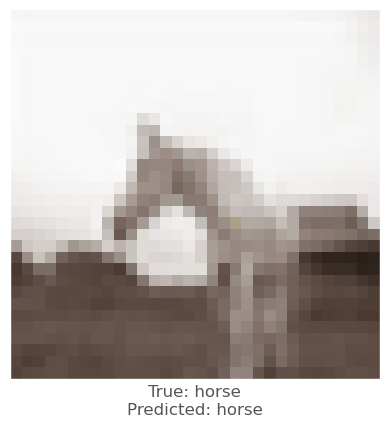



-0.0035270452
-0.0117253065
-0.0040789247
vr, vg, vb :   -1.062328276826054 0.7419627911363952 -1.7600998034200792
beam_perturbed_confidence temp :  0.61498654
beam_perturbed_confidence temp :  0.60908026
beam_perturbed_confidence temp :  0.612861
beam_perturbed_confidence temp :  0.61498654
beam_perturbed_confidence temp :  0.6162799
beam_perturbed_confidence temp :  0.612861
beam_perturbed_confidence temp :  0.6162799
row index :  1
9th round's confidence : 2th 0.60908026
predicted class :  horse
predicted class's confidence :  0.60908026
Lopt is :  19


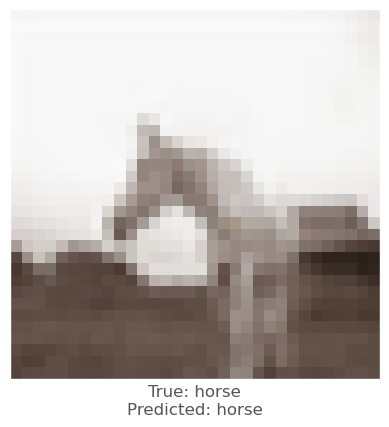



0.0023937225
-0.005369425
0.0017027855
vr, vg, vb :   1.0582236307880462 2.376993690119237 -1.1429366812961281
beam_perturbed_confidence temp :  0.5832941
beam_perturbed_confidence temp :  0.5757222
beam_perturbed_confidence temp :  0.5793539
beam_perturbed_confidence temp :  0.57499015
beam_perturbed_confidence temp :  0.58600545
beam_perturbed_confidence temp :  0.57345784
beam_perturbed_confidence temp :  0.57474923
row index :  5
9th round's confidence : 3th 0.57345784
predicted class :  horse
predicted class's confidence :  0.57345784
Lopt is :  24


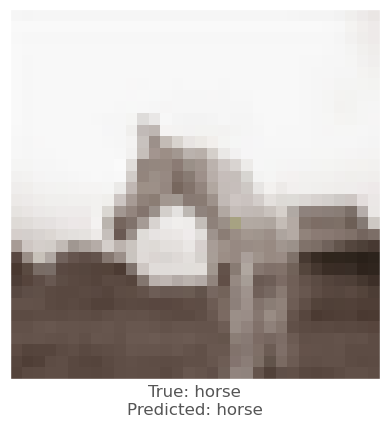



-0.00044745207
-0.0028099418
0.0028144717
vr, vg, vb :   -3.527304827195847 -2.300922743165279 -3.336889657664461
beam_perturbed_confidence temp :  0.60041386
beam_perturbed_confidence temp :  0.59922
beam_perturbed_confidence temp :  0.5919167
beam_perturbed_confidence temp :  0.610434
beam_perturbed_confidence temp :  0.5992706
beam_perturbed_confidence temp :  0.6047883
beam_perturbed_confidence temp :  0.6125003
row index :  2
9th round's confidence : 4th 0.5919167
predicted class :  horse
predicted class's confidence :  0.5919167
Lopt is :  21


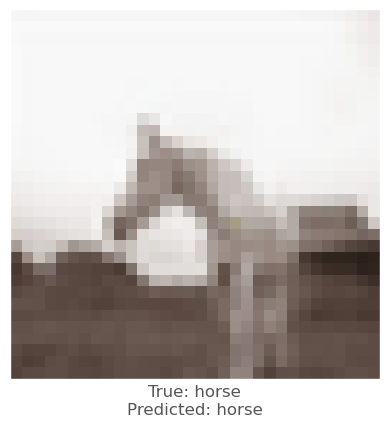



0.0019528866
-0.0047035813
-0.00034713745
vr, vg, vb :   -2.0569265581133607 2.4526210030275846 -0.8845800636548026
beam_perturbed_confidence temp :  0.5916955
beam_perturbed_confidence temp :  0.5855919
beam_perturbed_confidence temp :  0.5888281
beam_perturbed_confidence temp :  0.58682936
beam_perturbed_confidence temp :  0.59184057
beam_perturbed_confidence temp :  0.58482146
beam_perturbed_confidence temp :  0.58486986
row index :  5
10th round's confidence : 0th 0.58482146
predicted class :  horse
predicted class's confidence :  0.58482146
Lopt is :  21


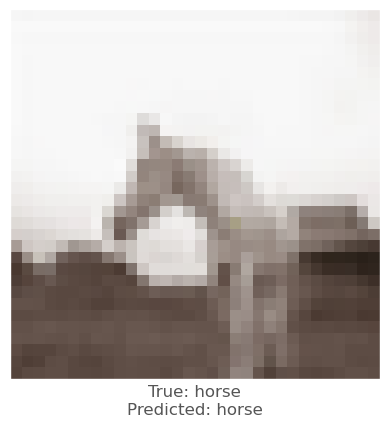



0.0012466311
-0.0060082674
-0.00027525425
vr, vg, vb :   -0.31509480573620724 2.1371121408249767 -1.0606648404342072
beam_perturbed_confidence temp :  0.57925105
beam_perturbed_confidence temp :  0.5757231
beam_perturbed_confidence temp :  0.5795087
beam_perturbed_confidence temp :  0.57534355
beam_perturbed_confidence temp :  0.57752913
beam_perturbed_confidence temp :  0.5712321
beam_perturbed_confidence temp :  0.57106143
row index :  6
10th round's confidence : 1th 0.57106143
predicted class :  horse
predicted class's confidence :  0.57106143
Lopt is :  23


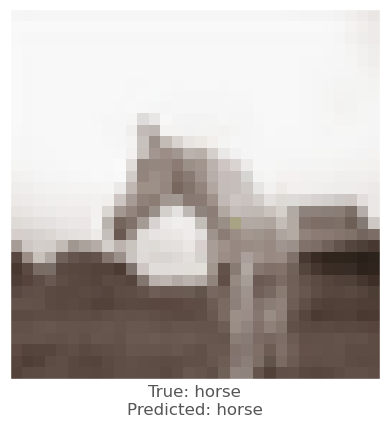



-0.0035270452
-0.0117253065
-0.0040789247
vr, vg, vb :   -0.6033909241495522 1.840297163115285 -1.1761973574866407
beam_perturbed_confidence temp :  0.61086386
beam_perturbed_confidence temp :  0.60315573
beam_perturbed_confidence temp :  0.612861
beam_perturbed_confidence temp :  0.6068148
beam_perturbed_confidence temp :  0.614576
beam_perturbed_confidence temp :  0.6065792
beam_perturbed_confidence temp :  0.6088073
row index :  1
10th round's confidence : 2th 0.60315573
predicted class :  horse
predicted class's confidence :  0.60315573
Lopt is :  19


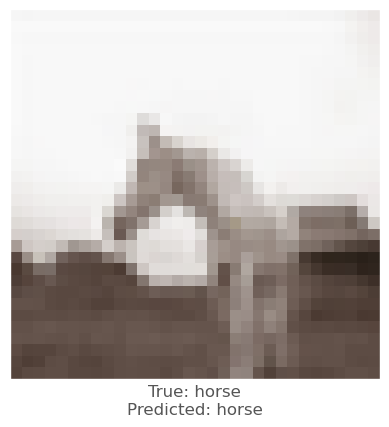



0.0011376143
-0.0068652034
0.0027484298
vr, vg, vb :   0.8386398426909311 2.825814659165785 -1.3034859906903191
beam_perturbed_confidence temp :  0.57345784
beam_perturbed_confidence temp :  0.5672962
beam_perturbed_confidence temp :  0.57071286
beam_perturbed_confidence temp :  0.5672962
beam_perturbed_confidence temp :  0.57071286
beam_perturbed_confidence temp :  0.5646022
beam_perturbed_confidence temp :  0.5646022
row index :  5
10th round's confidence : 3th 0.5646022
predicted class :  horse
predicted class's confidence :  0.5646022
Lopt is :  26


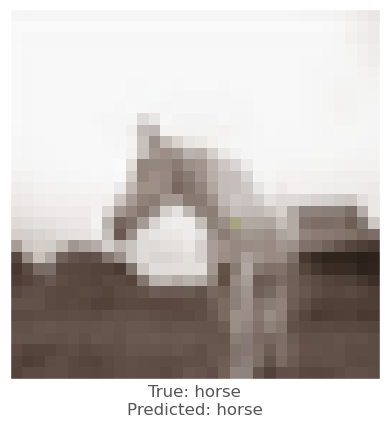



0.0050079823
-0.00687176
-0.0026481748
vr, vg, vb :   -3.6753725698790944 -1.3836544796977504 -2.738383215625432
beam_perturbed_confidence temp :  0.5992706
beam_perturbed_confidence temp :  0.599892
beam_perturbed_confidence temp :  0.59856397
beam_perturbed_confidence temp :  0.60860735
beam_perturbed_confidence temp :  0.6001297
beam_perturbed_confidence temp :  0.60835624
beam_perturbed_confidence temp :  0.6110866
row index :  2
10th round's confidence : 4th 0.59856397
predicted class :  horse
predicted class's confidence :  0.59856397
Lopt is :  24


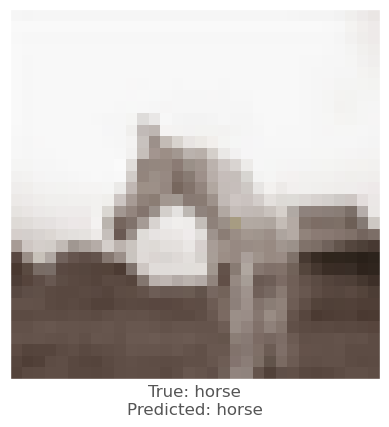



0.0010288954
-0.0035421252
0.0017801523
vr, vg, vb :   -1.9541234401133039 2.56157142523154 -0.9741372893755039
beam_perturbed_confidence temp :  0.5844647
beam_perturbed_confidence temp :  0.57925105
beam_perturbed_confidence temp :  0.58381176
beam_perturbed_confidence temp :  0.5807459
beam_perturbed_confidence temp :  0.582622
beam_perturbed_confidence temp :  0.57844234
beam_perturbed_confidence temp :  0.5787172
row index :  5
11th round's confidence : 0th 0.57844234
predicted class :  horse
predicted class's confidence :  0.57844234
Lopt is :  22


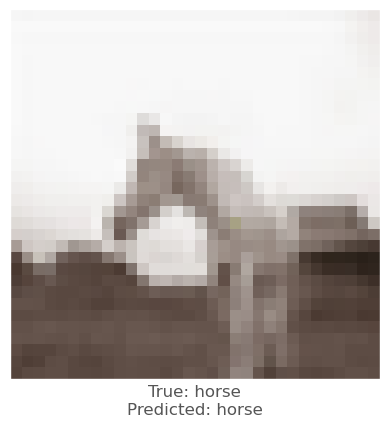



-0.0006605983
-0.0052898526
0.0032861233
vr, vg, vb :   -0.21752549735802107 2.4523861886595935 -1.28321068396647
beam_perturbed_confidence temp :  0.5718927
beam_perturbed_confidence temp :  0.5664088
beam_perturbed_confidence temp :  0.5689608
beam_perturbed_confidence temp :  0.56413
beam_perturbed_confidence temp :  0.56954587
beam_perturbed_confidence temp :  0.5629626
beam_perturbed_confidence temp :  0.5613026
row index :  6
11th round's confidence : 1th 0.5613026
predicted class :  horse
predicted class's confidence :  0.5613026
Lopt is :  25


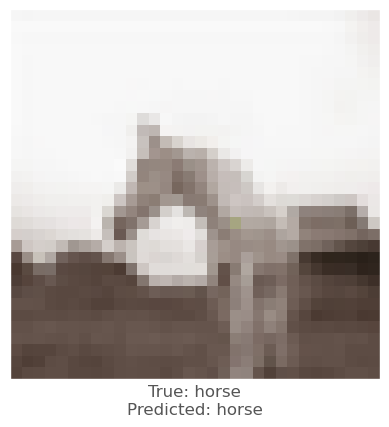



-0.0052568316
-0.0102984905
-0.0027467608
vr, vg, vb :   -0.017368667138039418 2.6861164992329556 -0.7839015372195439
beam_perturbed_confidence temp :  0.6068148
beam_perturbed_confidence temp :  0.59558016
beam_perturbed_confidence temp :  0.604931
beam_perturbed_confidence temp :  0.5995319
beam_perturbed_confidence temp :  0.6073979
beam_perturbed_confidence temp :  0.59525955
beam_perturbed_confidence temp :  0.5993384
row index :  5
11th round's confidence : 2th 0.59525955
predicted class :  horse
predicted class's confidence :  0.59525955
Lopt is :  20


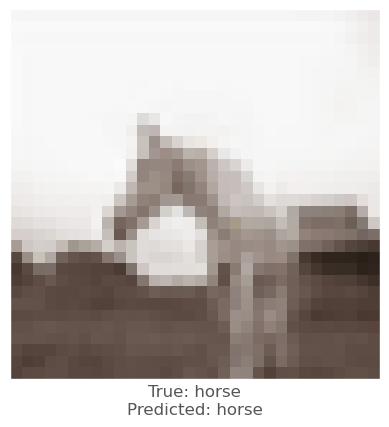



0.00018757582
-0.0058628917
0.0016553402
vr, vg, vb :   0.7360182767110225 3.129522360653381 -1.3386714110915021
beam_perturbed_confidence temp :  0.5646022
beam_perturbed_confidence temp :  0.55376595
beam_perturbed_confidence temp :  0.5632414
beam_perturbed_confidence temp :  0.55376595
beam_perturbed_confidence temp :  0.5632414
beam_perturbed_confidence temp :  0.54964197
beam_perturbed_confidence temp :  0.54964197
row index :  5
11th round's confidence : 3th 0.54964197
predicted class :  horse
predicted class's confidence :  0.54964197
Lopt is :  28


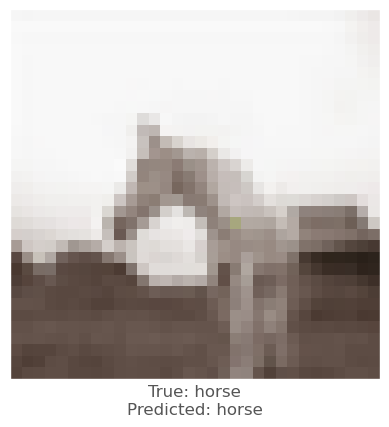



0.0059521794
-0.008497834
-0.0050126314
vr, vg, vb :   -3.9030532560827136 -0.3955056111652313 -1.9632817524308086
beam_perturbed_confidence temp :  0.6001297
beam_perturbed_confidence temp :  0.6032275
beam_perturbed_confidence temp :  0.6039585
beam_perturbed_confidence temp :  0.6064404
beam_perturbed_confidence temp :  0.6014682
beam_perturbed_confidence temp :  0.60813224
beam_perturbed_confidence temp :  0.6082317
row index :  0
11th round's confidence : 4th 0.6001297
predicted class :  horse
predicted class's confidence :  0.6001297
Lopt is :  24


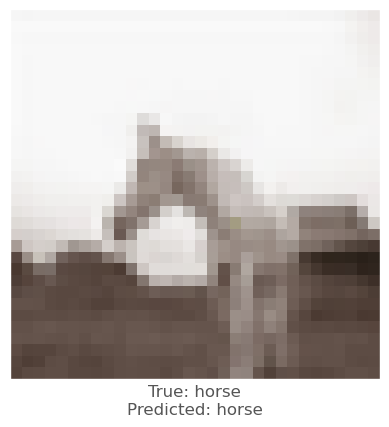



0.0002143979
-0.0057258606
0.0017219186
vr, vg, vb :   -1.7801508868276814 2.8780003422786984 -1.0489154187295795
beam_perturbed_confidence temp :  0.5787172
beam_perturbed_confidence temp :  0.57301486
beam_perturbed_confidence temp :  0.57659394
beam_perturbed_confidence temp :  0.5733976
beam_perturbed_confidence temp :  0.57486564
beam_perturbed_confidence temp :  0.56972873
beam_perturbed_confidence temp :  0.5712709
row index :  5
12th round's confidence : 0th 0.56972873
predicted class :  horse
predicted class's confidence :  0.56972873
Lopt is :  24


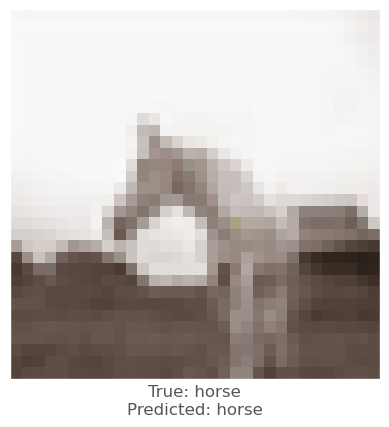



0.0029013157
-0.009009302
0.001907587
vr, vg, vb :   -0.4859045165309104 3.108077736038141 -1.3456483207089833
beam_perturbed_confidence temp :  0.5600613
beam_perturbed_confidence temp :  0.5498731
beam_perturbed_confidence temp :  0.5605716
beam_perturbed_confidence temp :  0.5457239
beam_perturbed_confidence temp :  0.5592562
beam_perturbed_confidence temp :  0.5431621
beam_perturbed_confidence temp :  0.53944564
row index :  6
12th round's confidence : 1th 0.53944564
predicted class :  horse
predicted class's confidence :  0.53944564
Lopt is :  27


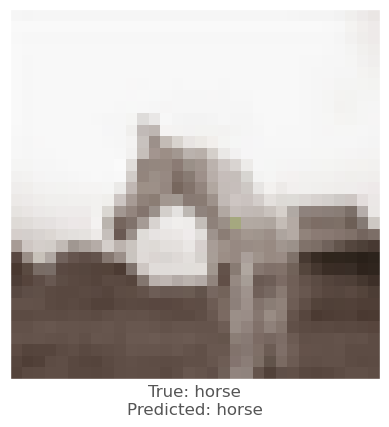



-0.0058791637
-0.006867051
0.0006966591
vr, vg, vb :   0.5722845737823075 3.1042099617669354 -0.7751772923110661
beam_perturbed_confidence temp :  0.59525955
beam_perturbed_confidence temp :  0.5884773
beam_perturbed_confidence temp :  0.5948835
beam_perturbed_confidence temp :  0.5884773
beam_perturbed_confidence temp :  0.5948835
beam_perturbed_confidence temp :  0.58757573
beam_perturbed_confidence temp :  0.58757573
row index :  5
12th round's confidence : 2th 0.58757573
predicted class :  horse
predicted class's confidence :  0.58757573
Lopt is :  21


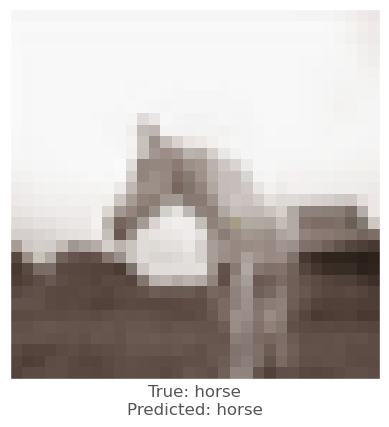



0.0069783926
-0.010693669
0.004629731
vr, vg, vb :   -0.03542281106139811 3.885937056503326 -1.6677773878107212
beam_perturbed_confidence temp :  0.5456609
beam_perturbed_confidence temp :  0.53801525
beam_perturbed_confidence temp :  0.54359084
beam_perturbed_confidence temp :  0.5298342
beam_perturbed_confidence temp :  0.53969055
beam_perturbed_confidence temp :  0.5278984
beam_perturbed_confidence temp :  0.52222365
row index :  6
12th round's confidence : 3th 0.52222365
predicted class :  horse
predicted class's confidence :  0.52222365
Lopt is :  30


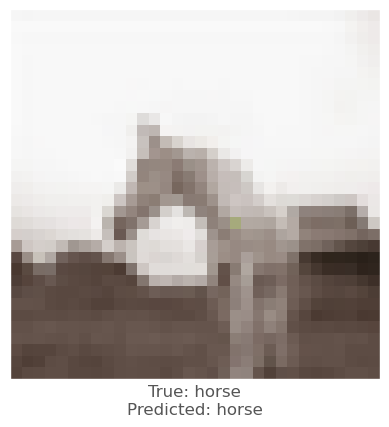



-0.0071159005
-0.013432324
-0.0014471412
vr, vg, vb :   -2.8011578788234415 0.9872773432160623 -1.622239460137557
beam_perturbed_confidence temp :  0.60929704
beam_perturbed_confidence temp :  0.6001297
beam_perturbed_confidence temp :  0.6014682
beam_perturbed_confidence temp :  0.60929704
beam_perturbed_confidence temp :  0.60929775
beam_perturbed_confidence temp :  0.6014682
beam_perturbed_confidence temp :  0.60929775
row index :  1
12th round's confidence : 4th 0.6001297
predicted class :  horse
predicted class's confidence :  0.6001297
Lopt is :  24


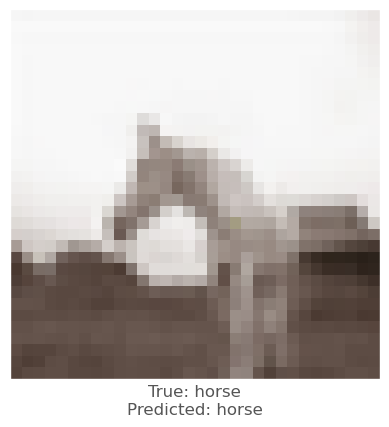



-0.00086319447
-0.00616163
0.0021006465
vr, vg, vb :   -1.5158163515811927 3.2063633234164293 -1.1540885264385308
beam_perturbed_confidence temp :  0.5712709
beam_perturbed_confidence temp :  0.5605012
beam_perturbed_confidence temp :  0.56745833
beam_perturbed_confidence temp :  0.55613375
beam_perturbed_confidence temp :  0.5680447
beam_perturbed_confidence temp :  0.5591166
beam_perturbed_confidence temp :  0.5519243
row index :  6
13th round's confidence : 0th 0.5519243
predicted class :  horse
predicted class's confidence :  0.5519243
Lopt is :  26


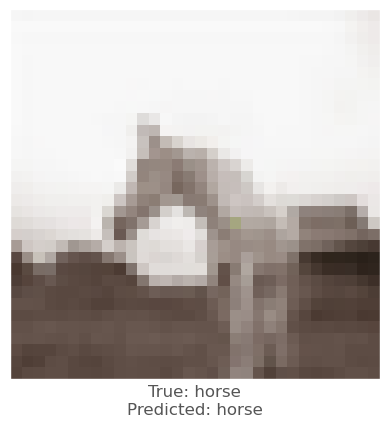



0.008284748
-0.0094973445
0.0056778193
vr, vg, vb :   -1.2657888249333613 3.7470044118209236 -1.778865413839501
beam_perturbed_confidence temp :  0.529092
beam_perturbed_confidence temp :  0.5205331
beam_perturbed_confidence temp :  0.5334135
beam_perturbed_confidence temp :  0.50554436
beam_perturbed_confidence temp :  0.52463233
beam_perturbed_confidence temp :  0.51200193
beam_perturbed_confidence temp :  0.49855763
row index :  6
13th round's confidence : 1th 0.49855763
predicted class :  horse
predicted class's confidence :  0.49855763
Lopt is :  29


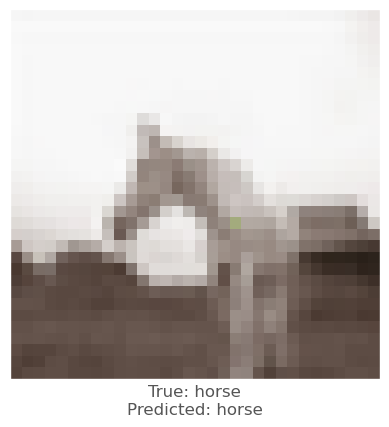




29th sensitive pixel
original confidence is :  0.69673544 

original r,g,b :  193 185 181
-0.044060647
-0.04706943
-0.028570354
vr, vg, vb :   4.406064748764038 4.706943035125732 2.8570353984832764
beam_perturbed_confidence temp :  0.6116737
beam_perturbed_confidence temp :  0.61035055
beam_perturbed_confidence temp :  0.6684597
beam_perturbed_confidence temp :  0.5150467
beam_perturbed_confidence temp :  0.57505125
beam_perturbed_confidence temp :  0.5783996
beam_perturbed_confidence temp :  0.47969958
row index :  6
0th round's confidence : 0th 0.47969958
predicted class :  airplane
predicted class's confidence :  0.5175699
Lopt is :  4


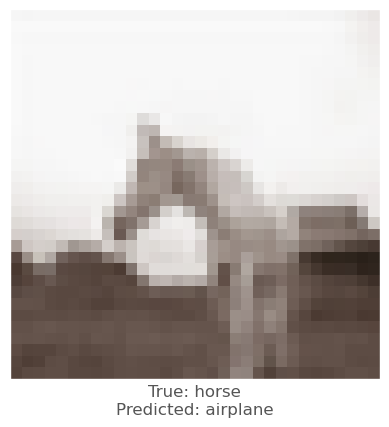

In [52]:
model = resnet
# class_names = ['airplane', 'automobile', 'bird', 'cat', 'deer', 'dog', 'frog', 'horse', 'ship', 'truck']
# gradient_descent_momentum(image_id, model, sensitive_x, sensitive_y)
start = time.time()
distance_list = []
for i in range(30):
    print(str(i) + "th sensitive pixel")
    L_distance = gradient_descent_momentum_parallel_beam_search(image_id, model, sensitive_list[i][0], sensitive_list[i][1])
    distance_list.append(L_distance)
    print('\n\n')
end = time.time()

In [53]:
# Already checked : 20, 25, 87, 384
# 87 : horse, 0.69, 25 : bird, 0.66 384 : 0.70, bird, 20 : horse, 0.72
# 368 : ship, 0.67, 125 : airplane, 0.66, 520 : dog, 0.66

print(f"{end - start:.6f} sec")
print(distance_list)
df = pd.DataFrame(distance_list, index = range(1, 31), columns = ['Coordinate','Distance', 'Predicted Class', 'Original Class'])
# print(distance_df_list)

        
# distance_df = pd.Dataframe(index = range(0, 32), columns = [for i in range(32)])
print(df.shape)
display(df)
#df.to_csv(str(image_id) + '_distance_ex_result.csv')



198.036879 sec
[[[21, 13], 19, 0.53203017, 0.4528503], [[21, 15], 55, 0.5138583, 0.48194256], [[20, 15], None, None, None], [[21, 14], None, None, None], [[20, 14], 30, 0.4932167, 0.4932167], [[20, 13], 30, 0.53532505, 0.45684204], [[20, 16], None, None, None], [[17, 13], 28, 0.55929667, 0.43121558], [[20, 12], 20, 0.4980741, 0.4980741], [[21, 12], None, None, None], [[12, 23], None, None, None], [[17, 19], 13, 0.64797544, 0.3494537], [[19, 13], 14, 0.5084325, 0.48767343], [[19, 12], None, None, None], [[11, 23], 10, 0.99925715, 0.0005456286], [[18, 13], 19, 0.5055612, 0.49065995], [[16, 19], 10, 0.6162889, 0.38103065], [[19, 15], None, None, None], [[16, 21], 7, 0.5001034, 0.4969473], [[18, 14], 19, 0.5208314, 0.47492027], [[22, 13], None, None, None], [[13, 23], 34, 0.5885758, 0.40797257], [[19, 14], 13, 0.4995537, 0.49661106], [[16, 20], 10, 0.5695848, 0.42730895], [[12, 24], 10, 0.9989562, 0.0007789347], [[21, 16], None, None, None], [[18, 15], 36, 0.55046695, 0.43845823], [[20, 11

,Coordinate,Distance,Predicted Class,Original Class
1,"[21, 13]",19.0,0.532030,0.452850
2,"[21, 15]",55.0,0.513858,0.481943
3,"[20, 15]",NaN,NaN,NaN
4,"[21, 14]",NaN,NaN,NaN
5,"[20, 14]",30.0,0.493217,0.493217
6,"[20, 13]",30.0,0.535325,0.456842
7,"[20, 16]",NaN,NaN,NaN
8,"[17, 13]",28.0,0.559297,0.431216
9,"[20, 12]",20.0,0.498074,0.498074
10,"[21, 12]",NaN,NaN,NaN


In [54]:
#distance_df_list = [[[0] * 4 for j in range(32)]for i in range(32)]
#print((distance_df_list[0]))

print(distance_list[0][0][1])

for i in range(30):
    x = distance_list[i][0][0] # x_coordinate of sensitive pixel
    y = distance_list[i][0][1] # y_coordinate of sensitive pixel
    color_distance = distance_list[i][1] # color distance
    predicted_confidence = distance_list[i][2]
    original_confidence = distance_list[i][3]
    
    distance_df_list[x][y][0] = i + 1 # 등수
    
    if(distance_list[i][1] != None):
        distance_df_list[x][y][1] = color_distance
        distance_df_list[x][y][2] = predicted_confidence
        distance_df_list[x][y][3] = original_confidence
    else:
        for j in range(1, 4):
            distance_df_list[x][y][j] = 'X' # fail

distance_df = pd.DataFrame(distance_df_list, index = range(0, 32), columns = range(0, 32))
# print(distance_df)
display(distance_df)
distance_df.to_csv(str(image_id) + '_distance_ex_result_chart.csv')



13


,0,1,2,3,4,5,6,7,8,9,...,22,23,24,25,26,27,28,29,30,31
0,"[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]","[30, 34, 0.49777544, 0.49777544]","[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]","[25, 61, 0.49816242, 0.49816242]",...,"[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]"
1,"[0, 0, 0, 0]","[0, 0, 0, 0]","[4, 25, 0.5062443, 0.4838667]","[14, 33, 0.5067485, 0.4842853]","[0, 0, 0, 0]","[26, 19, 0.5132196, 0.47953618]","[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]",...,"[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]"
2,"[0, 0, 0, 0]","[0, 0, 0, 0]","[29, 21, 0.49842682, 0.4937982]","[7, X, X, X]","[3, 16, 0.5527096, 0.44049627]","[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]",...,"[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]"
3,"[0, 0, 0, 0]","[0, 0, 0, 0]","[10, 19, 0.5146027, 0.4727888]","[16, 8, 0.5083492, 0.4807471]","[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]",...,"[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]"
4,"[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]",...,"[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]"
5,"[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]",...,"[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]"
6,"[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]",...,"[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]"
7,"[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]",...,"[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]"
8,"[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]",...,"[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]"
9,"[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]",...,"[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]","[0, 0, 0, 0]"


#### Untargeted Attack

Let's look at one iteration of the untargeted attack. Here we will demonstrate a successful attack an image of a frog with the `resnet` model. We should see the confidence in the true class drop after several iterations.

Try to see if you can successfully attack other images/models. The more pixels we are allowed to modify, the more likely it is we are to find a solution for any given image.



Round  0
Confidence: 0.049143102


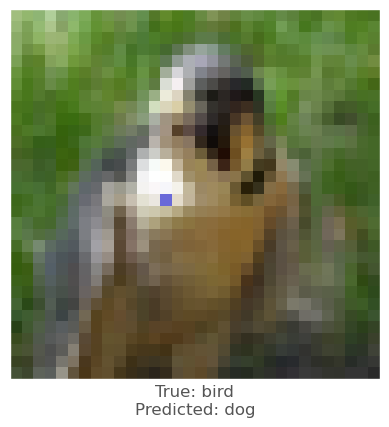

Success Lopt is 123.55702241383908
Confidence: 0.5784494
Confidence: 0.553354
Confidence: 0.553354
Confidence: 0.5404524
Confidence: 0.5404524
Confidence: 0.42025834


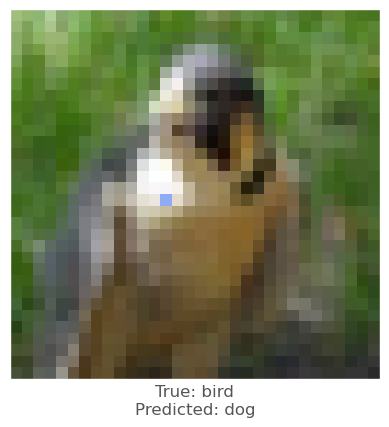

Success Lopt is 85.93899334060009
Confidence: 0.54676193
Confidence: 0.50440603
Confidence: 0.44814116


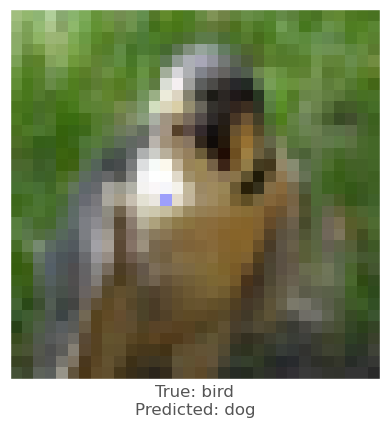

Success Lopt is 71.66061922762361
Confidence: 0.53803813
Confidence: 0.5366706
Confidence: 0.5269514
Confidence: 0.5269514
Confidence: 0.51572776
Confidence: 0.6047626
Confidence: 0.6047626
Confidence: 0.5208503
Confidence: 0.5036767
Confidence: 0.49433148


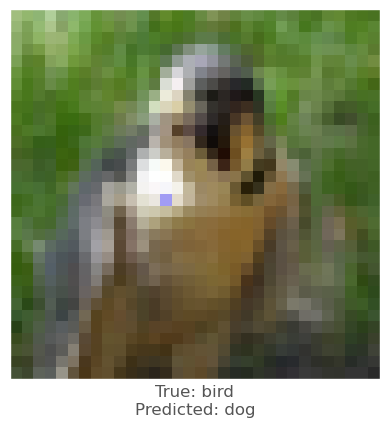

Success Lopt is 67.81619271106729
Final Lopt is 67.81619271106729


Round  1
Confidence: 0.00042562195


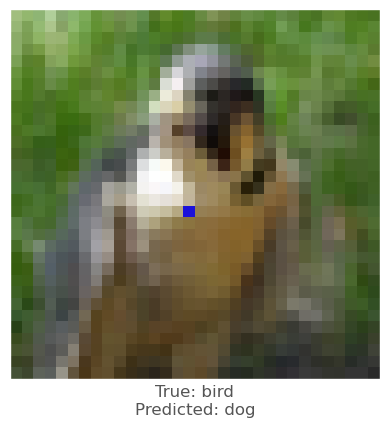

Success Lopt is 126.06376329780723
Confidence: 0.4446252


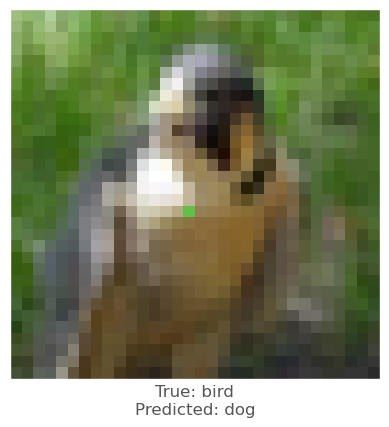

Success Lopt is 55.84396842359419
Confidence: 0.5945228
Confidence: 0.5851412
Confidence: 0.5733351
Confidence: 0.5574734
Confidence: 0.53792715
Confidence: 0.49556714


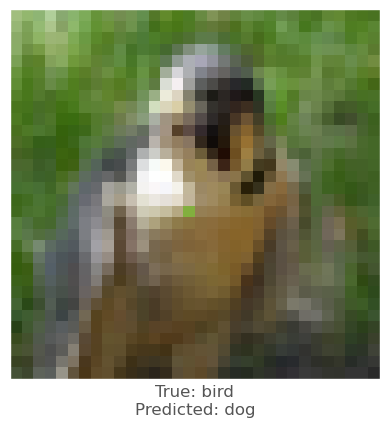

Success Lopt is 38.05729913682143
Confidence: 0.5274456
Confidence: 0.5223809
Confidence: 0.5115672
Confidence: 0.5113208
Confidence: 0.5113208
Confidence: 0.49908045


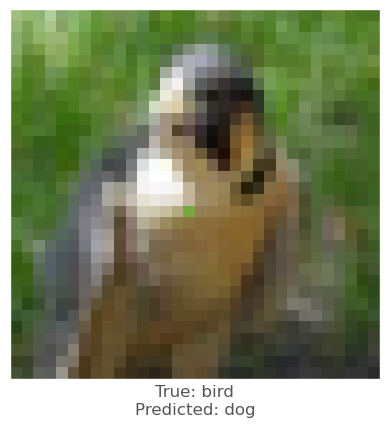

Success Lopt is 32.73197914727825
Final Lopt is 32.73197914727825


Round  2
Confidence: 0.026347125


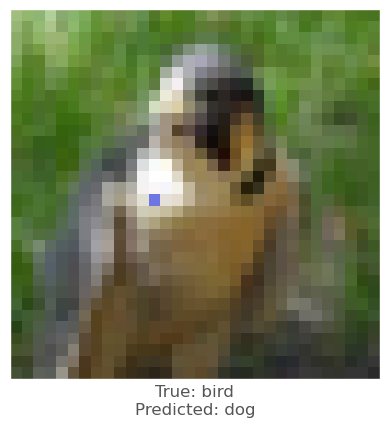

Success Lopt is 125.82406087522747
Confidence: 0.49169996


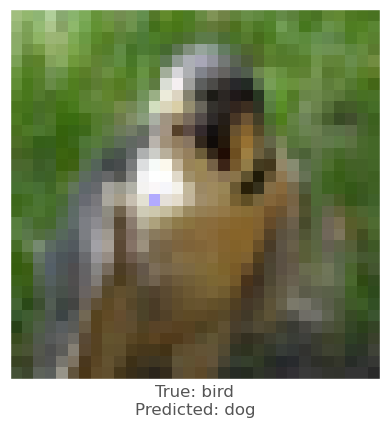

Success Lopt is 60.34152941576028
Confidence: 0.5831421
Confidence: 0.5831421
Confidence: 0.5831421
Confidence: 0.5831421
Confidence: 0.5831421
Confidence: 0.5846964
Confidence: 0.54124874
Confidence: 0.54124874
Confidence: 0.54124874
Confidence: 0.54124874
Confidence: 0.5720455
Confidence: 0.5435256
Confidence: 0.5435256
Confidence: 0.5250577
Confidence: 0.5250577
Confidence: 0.5694721
Confidence: 0.5304236
Confidence: 0.5185027
Confidence: 0.4973551


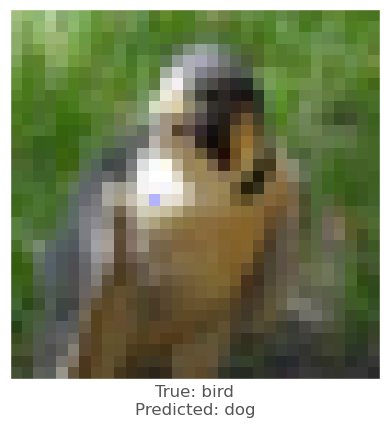

Success Lopt is 55.585789406199524
Confidence: 0.53224427
Confidence: 0.53224427
Confidence: 0.53224427
Confidence: 0.53224427
Confidence: 0.53224427
Confidence: 0.56595975
Confidence: 0.54506516
Confidence: 0.54506516
Confidence: 0.51942825
Confidence: 0.51942825
Final Lopt is 55.585789406199524


Round  3
Confidence: 0.08285866


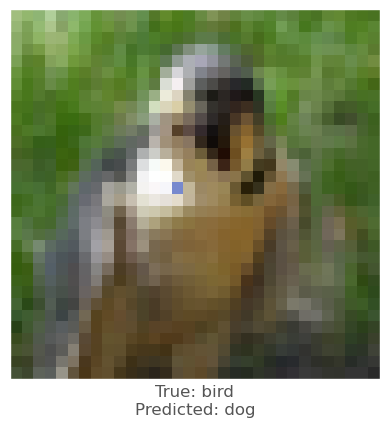

Success Lopt is 124.41342795887606
Confidence: 0.5402543
Confidence: 0.5402543
Confidence: 0.519814
Confidence: 0.5104779
Confidence: 0.50670743
Confidence: 0.369371


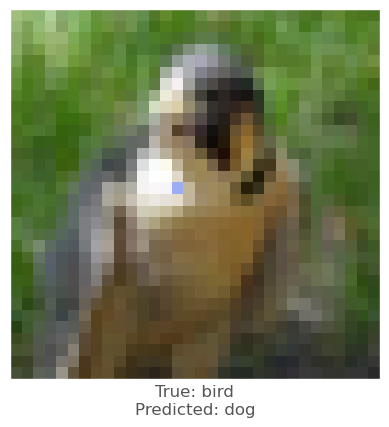

Success Lopt is 87.86899522206352
Confidence: 0.4802981


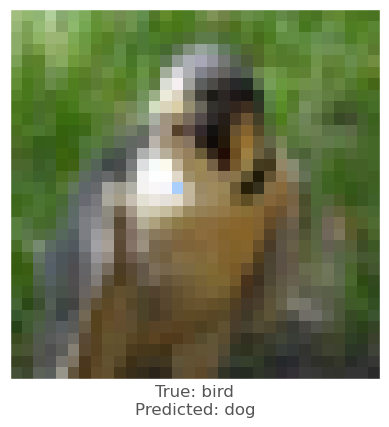

Success Lopt is 73.05503433743328
Confidence: 0.51543224
Confidence: 0.51021427
Confidence: 0.51021427
Confidence: 0.51021427
Confidence: 0.50323546
Confidence: 0.51479065
Confidence: 0.50756437
Confidence: 0.48871186


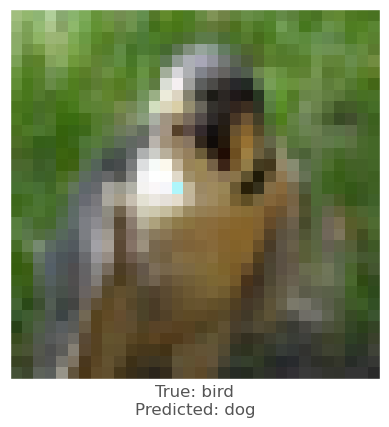

Success Lopt is 68.16031367271023
Final Lopt is 68.16031367271023


Round  4
Confidence: 0.018534504


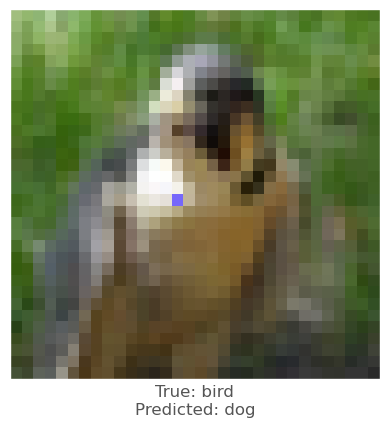

Success Lopt is 116.42352210277396
Confidence: 0.40378934


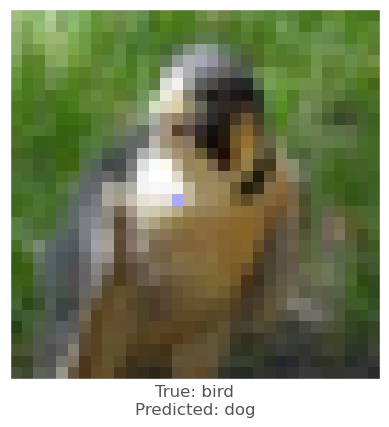

Success Lopt is 57.13490416514131
Confidence: 0.59793186
Confidence: 0.59793186
Confidence: 0.59328943
Confidence: 0.58954
Confidence: 0.58864945
Confidence: 0.55094975
Confidence: 0.53311443
Confidence: 0.5330829
Confidence: 0.5320176
Confidence: 0.5180233
Confidence: 0.47083405


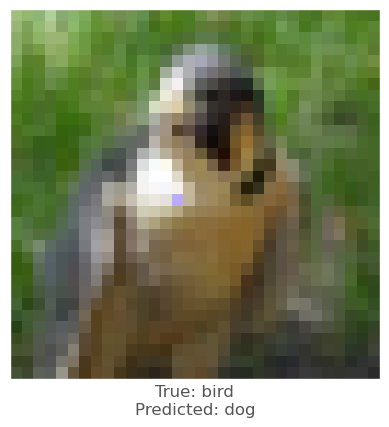

Success Lopt is 47.92311722818292
Confidence: 0.53520316
Confidence: 0.5184499
Confidence: 0.5140561
Confidence: 0.5140561
Confidence: 0.5140561
Confidence: 0.5200152
Confidence: 0.50261635
Confidence: 0.50261635
Confidence: 0.4975961


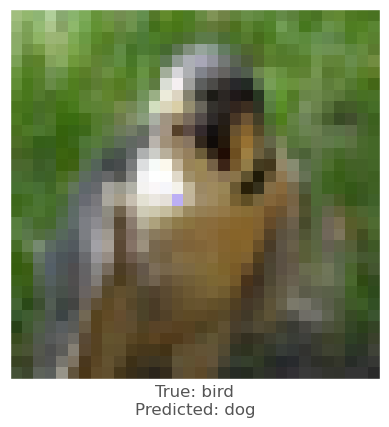

Success Lopt is 44.25684212867634
Final Lopt is 44.25684212867634


Round  5
Confidence: 0.005306377


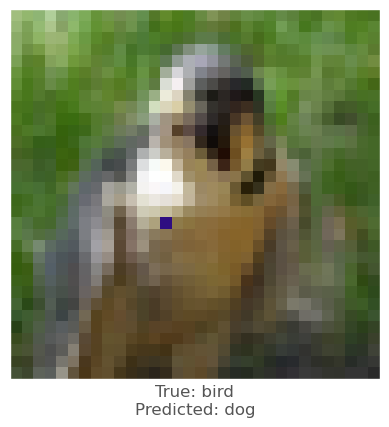

Success Lopt is 124.5028476831694
Confidence: 0.5490702
Confidence: 0.5490702
Confidence: 0.5490702
Confidence: 0.54681855
Confidence: 0.54067576
Confidence: 0.12942518


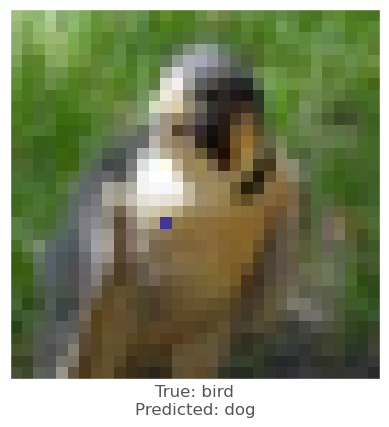

Success Lopt is 86.33798023852239
Confidence: 0.5506947
Confidence: 0.54695565
Confidence: 0.5388893
Confidence: 0.50607455
Confidence: 0.50101197
Confidence: 0.550982
Confidence: 0.5002387
Confidence: 0.5002387
Confidence: 0.46487325


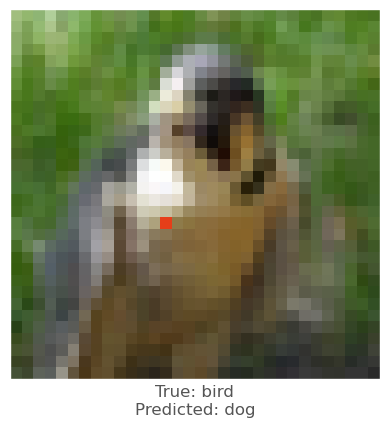

Success Lopt is 77.61954171193395
Confidence: 0.52439207
Confidence: 0.52439207
Confidence: 0.5228248
Confidence: 0.5228248
Confidence: 0.5110006
Confidence: 0.4958539


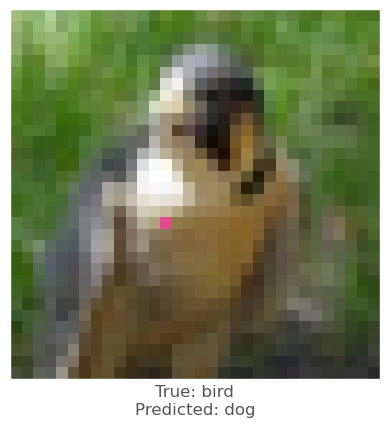

Success Lopt is 74.56586729026884
Final Lopt is 74.56586729026884


Round  6
Confidence: 0.0414868


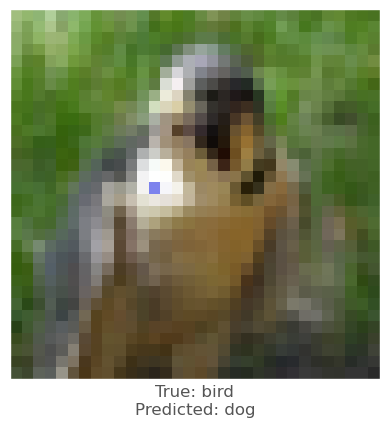

Success Lopt is 124.12997250387
Confidence: 0.64357454
Confidence: 0.5945252
Confidence: 0.588492
Confidence: 0.588492
Confidence: 0.5596114
Confidence: 0.31272283


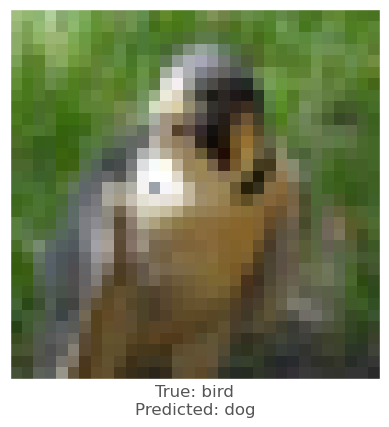

Success Lopt is 92.70749193715565
Confidence: 0.39526173


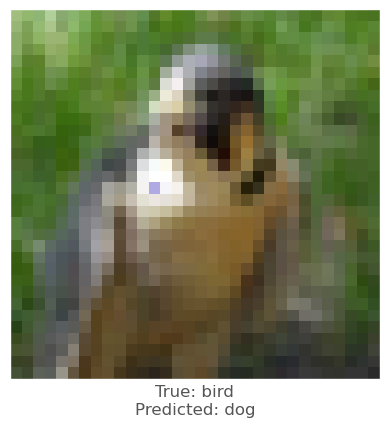

Success Lopt is 76.51909882474598
Confidence: 0.49931192
Confidence: 0.4595915


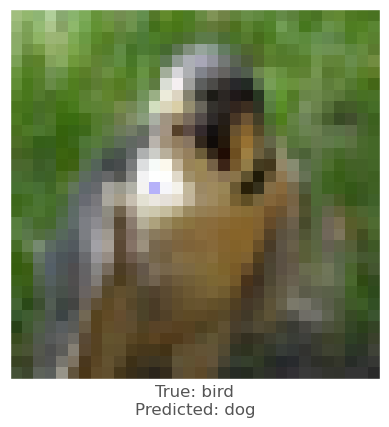

Success Lopt is 68.1742650418526
Confidence: 0.62733424
Confidence: 0.5911754
Confidence: 0.58977574
Confidence: 0.55620044
Confidence: 0.5202111
Confidence: 0.54181033
Confidence: 0.54181033
Confidence: 0.53190017
Confidence: 0.53190017
Confidence: 0.50658894
Confidence: 0.53890157
Confidence: 0.53890157
Confidence: 0.4932912


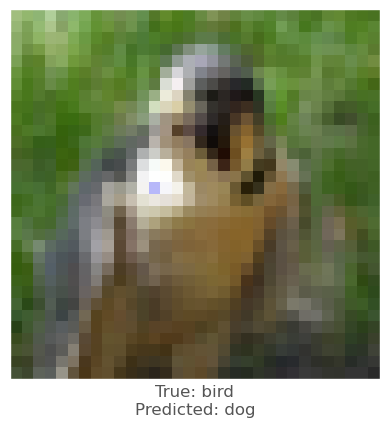

Success Lopt is 66.92516000654086
Final Lopt is 66.92516000654086


Round  7
Confidence: 0.006670809


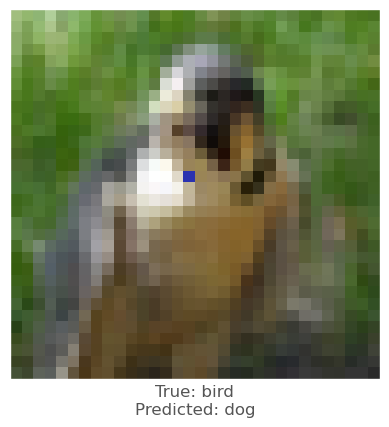

Success Lopt is 117.206647017317
Confidence: 0.31697774


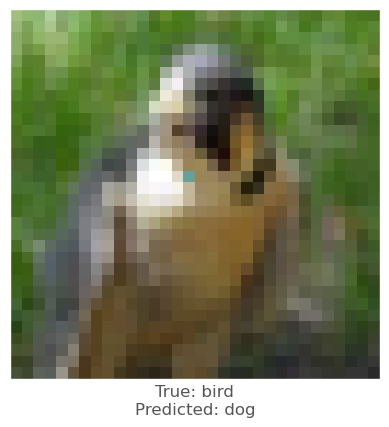

Success Lopt is 55.11670393993464
Confidence: 0.50720704
Confidence: 0.50720704
Confidence: 0.50720704
Confidence: 0.50720704
Confidence: 0.50720704
Confidence: 0.41664276


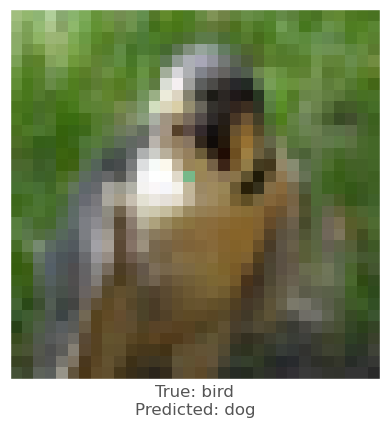

Success Lopt is 40.80215656974809
Confidence: 0.49363965


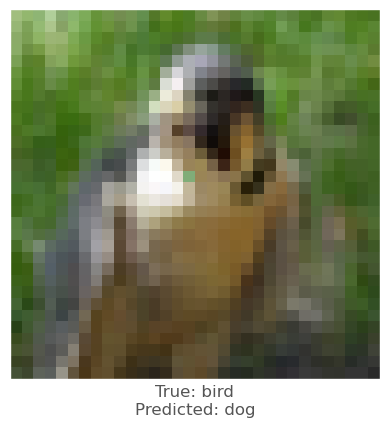

Success Lopt is 31.959690673737782
Confidence: 0.50799006
Confidence: 0.49798


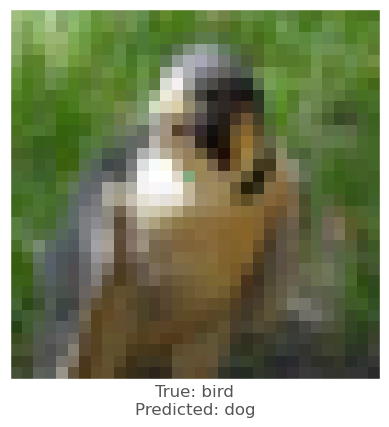

Success Lopt is 28.167537544773268
Final Lopt is 28.167537544773268


Round  8
Confidence: 0.003226696


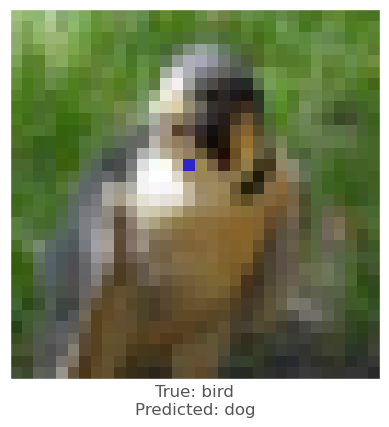

Success Lopt is 110.41925411626556
Confidence: 0.39068338


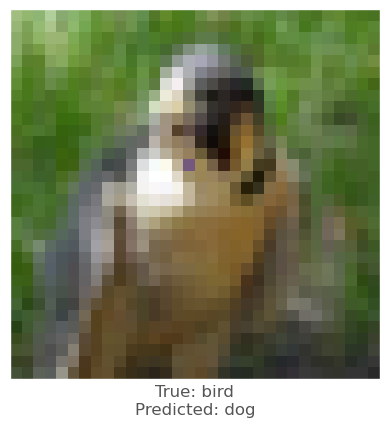

Success Lopt is 43.300022174355746
Confidence: 0.52808154
Confidence: 0.51758456
Confidence: 0.51261896
Confidence: 0.51261896
Confidence: 0.51261896
Confidence: 0.49228597


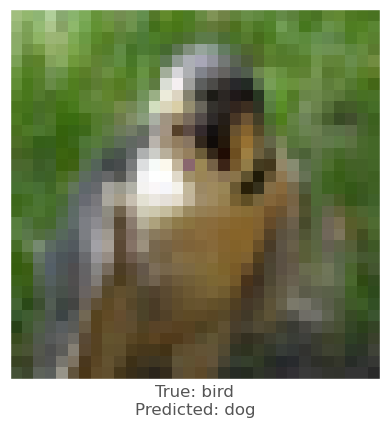

Success Lopt is 29.821053403621022
Confidence: 0.5129631
Confidence: 0.49452555


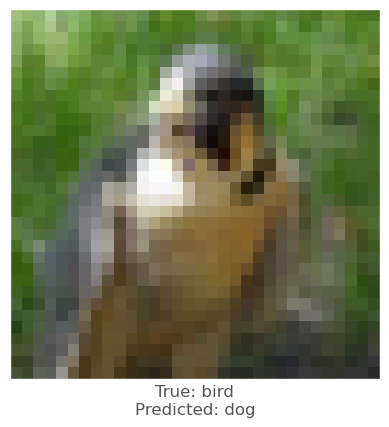

Success Lopt is 23.165483046020697
Confidence: 0.51824206
Confidence: 0.51824206
Confidence: 0.51285267
Confidence: 0.51083386
Confidence: 0.51083386
Final Lopt is 23.165483046020697


Round  9
Confidence: 0.059304282


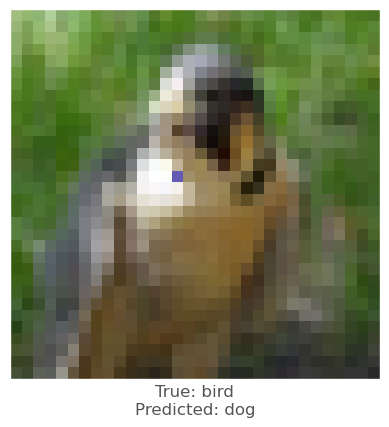

Success Lopt is 125.18142468213864
Confidence: 0.4186124


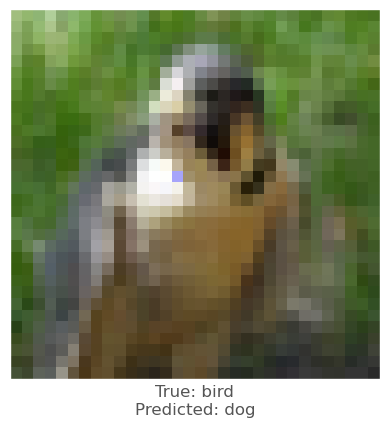

Success Lopt is 57.64371598791868
Confidence: 0.5477351
Confidence: 0.5477351
Confidence: 0.5477351
Confidence: 0.5477351
Confidence: 0.5477351
Confidence: 0.5218016
Confidence: 0.5218016
Confidence: 0.5116058
Confidence: 0.5116058
Confidence: 0.50848305
Confidence: 0.460095


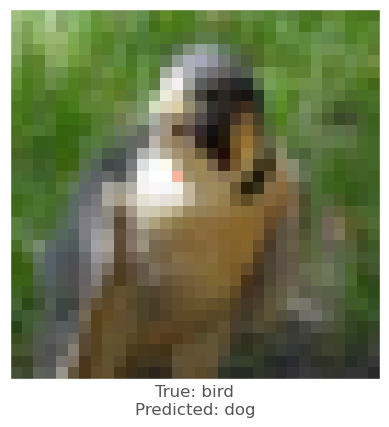

Success Lopt is 44.37561854743697
Confidence: 0.5119252
Confidence: 0.5119252
Confidence: 0.5119252
Confidence: 0.5119252
Confidence: 0.5119252
Final Lopt is 44.37561854743697


Round  10
Confidence: 0.106573656


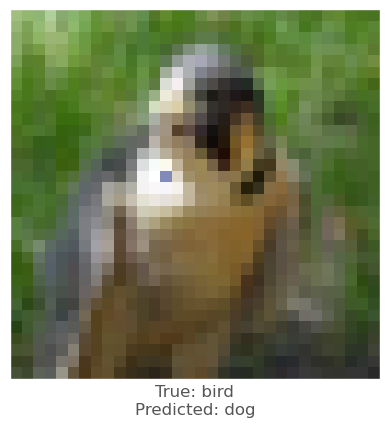

Success Lopt is 123.43953562413682
Confidence: 0.7266538
Confidence: 0.68978363
Confidence: 0.68978363
Confidence: 0.68978363
Confidence: 0.68978363
Confidence: 0.35264724


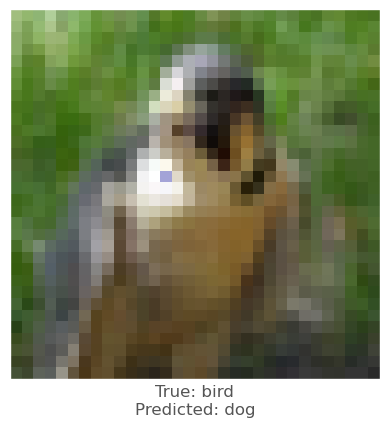

Success Lopt is 90.21241348703933
Confidence: 0.56874514
Confidence: 0.56874514
Confidence: 0.56874514
Confidence: 0.5659974
Confidence: 0.556987
Confidence: 0.54436636
Confidence: 0.54436636
Confidence: 0.48372406


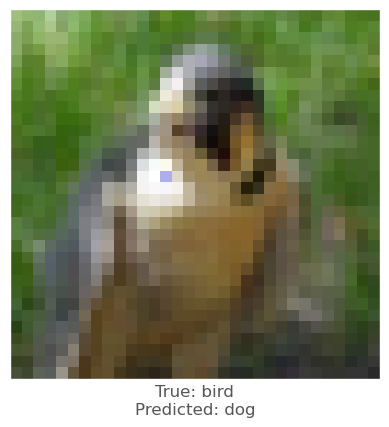

Success Lopt is 79.53706426154463
Confidence: 0.6391381
Confidence: 0.57531494
Confidence: 0.57531494
Confidence: 0.55117905
Confidence: 0.53451085
Confidence: 0.53953767
Confidence: 0.53953767
Confidence: 0.53953767
Confidence: 0.52429783
Confidence: 0.52429783
Final Lopt is 79.53706426154463


Round  11
Confidence: 0.012380314


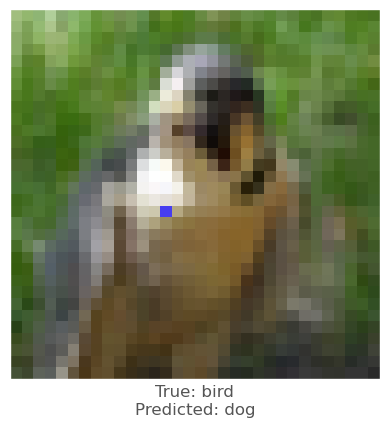

Success Lopt is 127.01821358984931
Confidence: 0.41800883


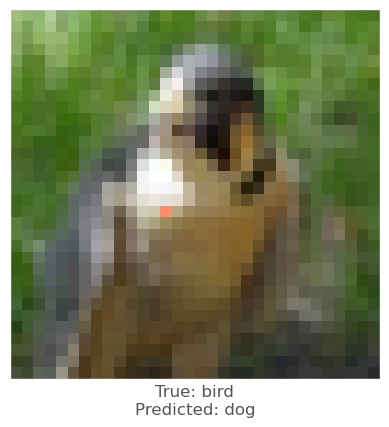

Success Lopt is 57.39673169477146
Confidence: 0.6037216
Confidence: 0.5982534
Confidence: 0.59227777
Confidence: 0.59227777
Confidence: 0.59227777
Confidence: 0.58974534
Confidence: 0.576688
Confidence: 0.576688
Confidence: 0.576688
Confidence: 0.5594226
Confidence: 0.5654488
Confidence: 0.50096005
Confidence: 0.4827812


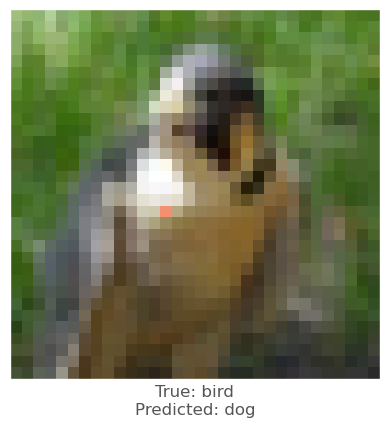

Success Lopt is 47.3763323186225
Confidence: 0.57951194
Confidence: 0.5649921
Confidence: 0.5649921
Confidence: 0.5649921
Confidence: 0.5484006
Confidence: 0.6046518
Confidence: 0.5498044
Confidence: 0.5498044
Confidence: 0.54132086
Confidence: 0.53497046
Confidence: 0.5676271
Confidence: 0.5363784
Confidence: 0.505584
Confidence: 0.50297487
Confidence: 0.50297487
Final Lopt is 47.3763323186225


Round  12
Confidence: 0.015110537


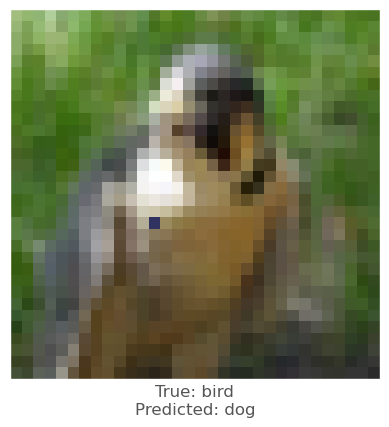

Success Lopt is 124.37637126205341
Confidence: 0.6254317
Confidence: 0.62150323
Confidence: 0.62150323
Confidence: 0.62119794
Confidence: 0.6107277
Confidence: 0.48864472


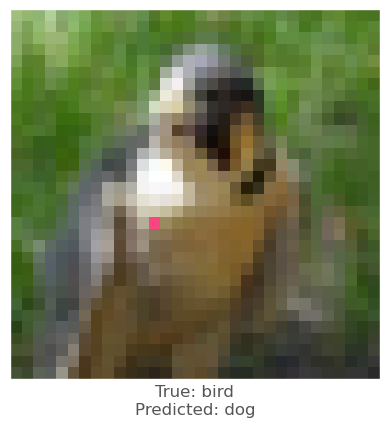

Success Lopt is 92.10225747488761
Confidence: 0.59177375
Confidence: 0.562529
Confidence: 0.5458474
Confidence: 0.5458474
Confidence: 0.5278746
Confidence: 0.5220477
Confidence: 0.5220477
Confidence: 0.5101987
Confidence: 0.5101987
Confidence: 0.45902288


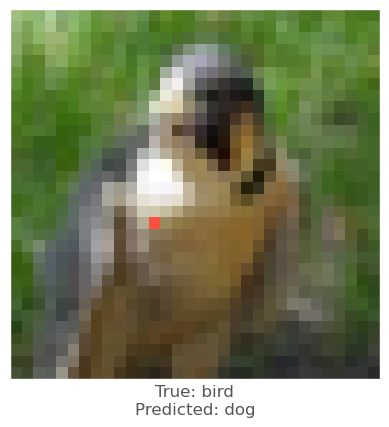

Success Lopt is 81.14378787490986
Confidence: 0.6119692
Confidence: 0.5824995
Confidence: 0.57870585
Confidence: 0.55379885
Confidence: 0.4950244


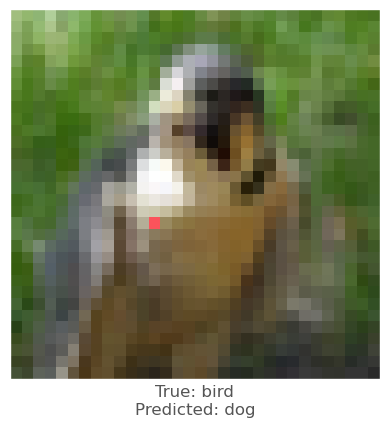

Success Lopt is 78.31881144625221
Final Lopt is 78.31881144625221


Round  13
Confidence: 0.33125433


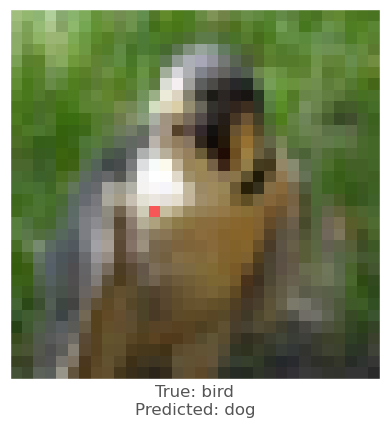

Success Lopt is 111.39961829476697
Confidence: 0.60292065
Confidence: 0.5948539
Confidence: 0.5948539
Confidence: 0.58803153
Confidence: 0.58803153
Confidence: 0.59383315
Confidence: 0.5353576
Confidence: 0.5353576
Confidence: 0.5353576
Confidence: 0.5353576
Confidence: 0.55288994
Confidence: 0.5101794
Confidence: 0.5101794
Confidence: 0.5101794
Confidence: 0.4990744


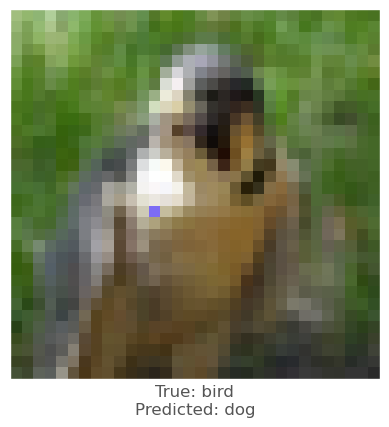

Success Lopt is 91.0231181871024
Confidence: 0.6111403
Confidence: 0.59734875
Confidence: 0.5796993
Confidence: 0.5734453
Confidence: 0.5734453
Confidence: 0.5747321
Confidence: 0.5747321
Confidence: 0.5164748
Confidence: 0.5164748
Confidence: 0.5164748
Confidence: 0.6056935
Confidence: 0.51904386
Confidence: 0.51904386
Confidence: 0.51904386
Confidence: 0.507563
Final Lopt is 91.0231181871024


Round  14
Confidence: 0.026306335


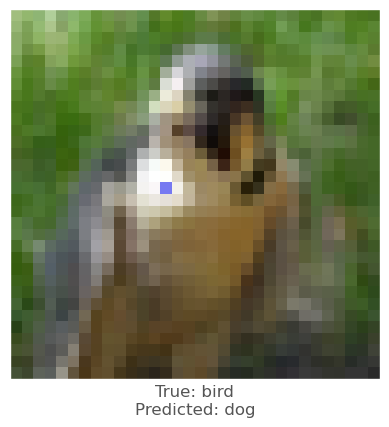

Success Lopt is 127.39691390132903
Confidence: 0.33309555


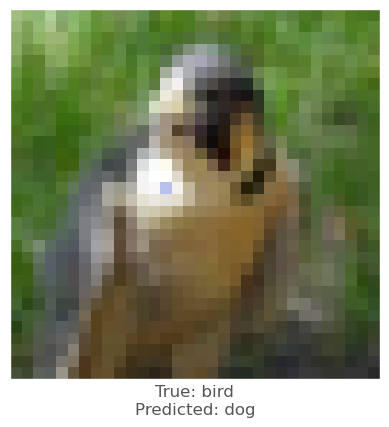

Success Lopt is 60.52250136066556
Confidence: 0.62561107
Confidence: 0.6230818
Confidence: 0.6230818
Confidence: 0.61610717
Confidence: 0.61610717
Confidence: 0.50689787
Confidence: 0.50250924
Confidence: 0.48903778


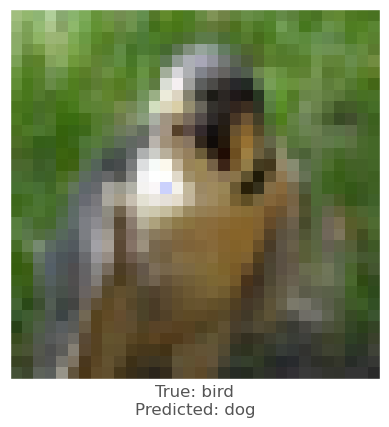

Success Lopt is 42.967746897788004
Confidence: 0.5606013
Confidence: 0.5606013
Confidence: 0.55307007
Confidence: 0.55307007
Confidence: 0.54342884
Confidence: 0.54493815
Confidence: 0.53899366
Confidence: 0.5334917
Confidence: 0.5334917
Confidence: 0.52249235
Confidence: 0.53096557
Confidence: 0.5169017
Confidence: 0.5169017
Confidence: 0.50911015
Confidence: 0.50911015
Confidence: 0.5096521
Confidence: 0.5096521
Confidence: 0.5016466
Confidence: 0.5016466
Confidence: 0.5016466
Final Lopt is 42.967746897788004


Round  15
Confidence: 0.14511858


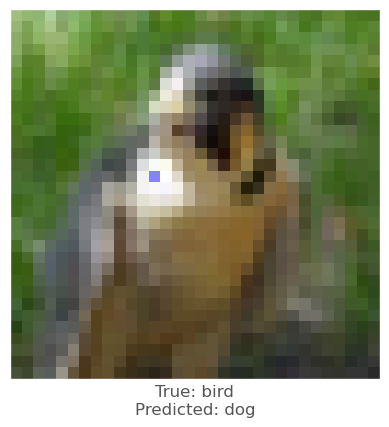

Success Lopt is 122.24207939781832
Confidence: 0.6455612
Confidence: 0.6455612
Confidence: 0.6455612
Confidence: 0.6455612
Confidence: 0.6455612
Confidence: 0.43719974


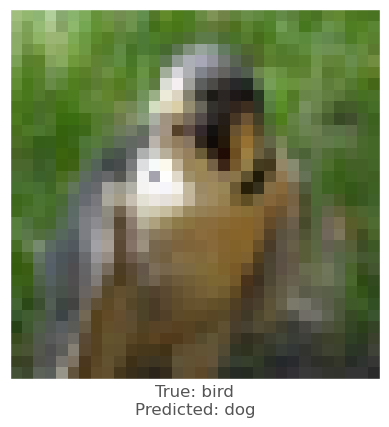

Success Lopt is 90.47633321238018
Confidence: 0.58553743
Confidence: 0.578443
Confidence: 0.578443
Confidence: 0.57801706
Confidence: 0.5718275
Confidence: 0.5540042
Confidence: 0.5540042
Confidence: 0.5311728
Confidence: 0.5148996
Confidence: 0.5081658
Confidence: 0.47552997


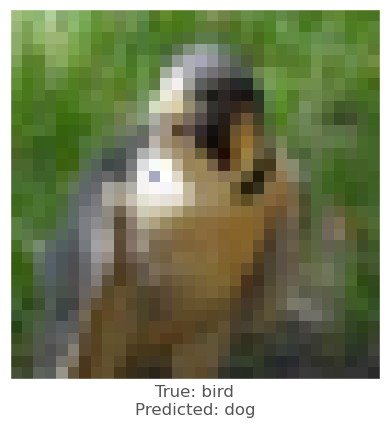

Success Lopt is 85.56182319317904
Confidence: 0.5130673
Confidence: 0.5130673
Confidence: 0.5130673
Confidence: 0.5130673
Confidence: 0.5130673
Confidence: 0.5427994
Confidence: 0.5290818
Confidence: 0.5271885
Confidence: 0.49420542


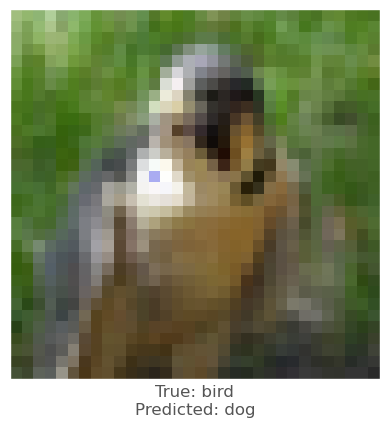

Success Lopt is 83.68985958022321
Final Lopt is 83.68985958022321


Round  16
Confidence: 0.011230632


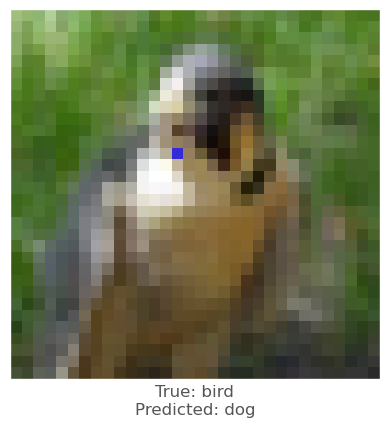

Success Lopt is 110.75110024241785
Confidence: 0.22970445


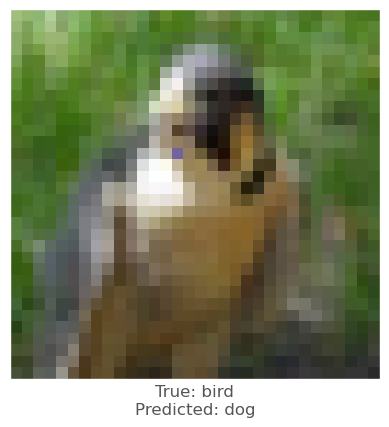

Success Lopt is 48.135548699339225
Confidence: 0.44305474


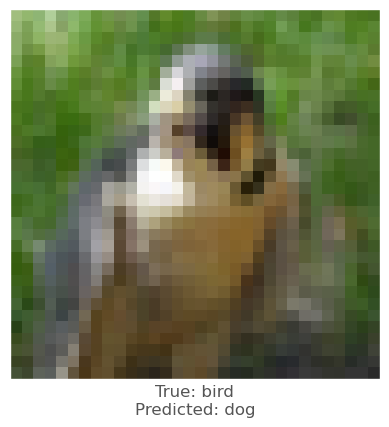

Success Lopt is 22.509051174538982
Confidence: 0.5935484
Confidence: 0.5935484
Confidence: 0.5912338
Confidence: 0.5912338
Confidence: 0.5912338
Confidence: 0.536525
Confidence: 0.536525
Confidence: 0.536525
Confidence: 0.536525
Confidence: 0.5315779
Confidence: 0.5178898
Confidence: 0.50470966
Confidence: 0.49099597


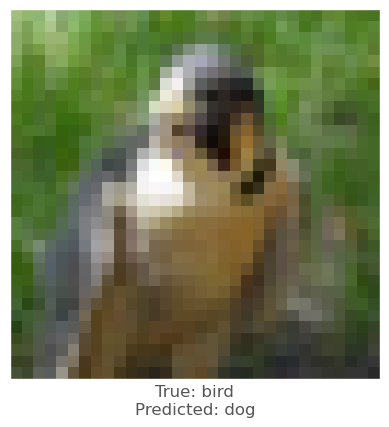

Success Lopt is 18.01440568491438
Confidence: 0.5221164
Confidence: 0.5221164
Confidence: 0.5115695
Confidence: 0.5115695
Confidence: 0.5115695
Final Lopt is 18.01440568491438


Round  17
Confidence: 0.011074257


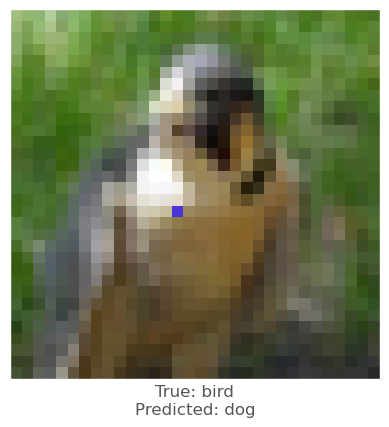

Success Lopt is 115.68782851882442
Confidence: 0.47101045


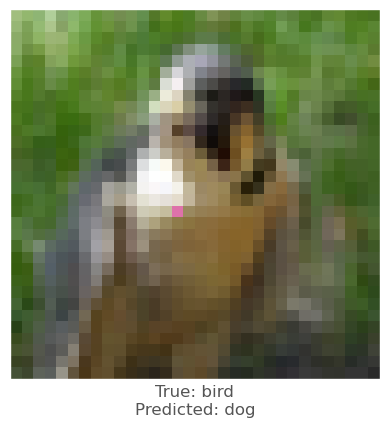

Success Lopt is 53.04208924116875
Confidence: 0.5772239
Confidence: 0.572143
Confidence: 0.56793743
Confidence: 0.56793743
Confidence: 0.56793743
Confidence: 0.5320883
Confidence: 0.52673733
Confidence: 0.52673733
Confidence: 0.52673733
Confidence: 0.5258901
Confidence: 0.5074484
Confidence: 0.4993866


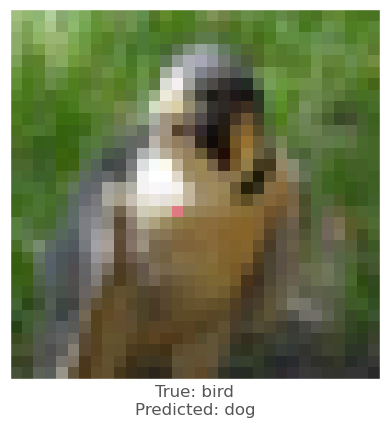

Success Lopt is 45.24030575639074
Confidence: 0.5364896
Confidence: 0.51948816
Confidence: 0.5120668
Confidence: 0.5120668
Confidence: 0.51187444
Confidence: 0.51914775
Confidence: 0.5184238
Confidence: 0.5184238
Confidence: 0.51425886
Confidence: 0.50774974
Confidence: 0.525716
Confidence: 0.5214267
Confidence: 0.5214267
Confidence: 0.51444083
Confidence: 0.5062971
Final Lopt is 45.24030575639074


Round  18
Confidence: 0.04660737


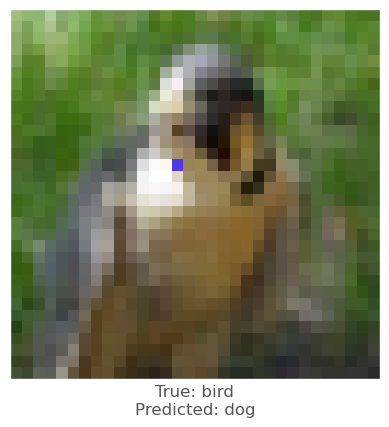

Success Lopt is 122.58001032801567
Confidence: 0.47336996


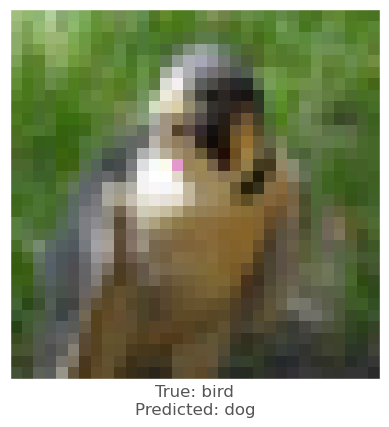

Success Lopt is 51.68229849801065
Confidence: 0.5230136
Confidence: 0.5098362
Confidence: 0.5098362
Confidence: 0.5098362
Confidence: 0.5089133
Confidence: 0.49766585


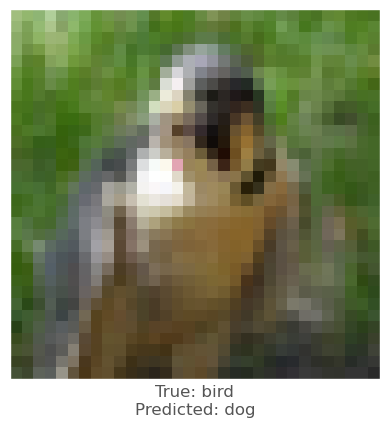

Success Lopt is 32.49587646683693
Confidence: 0.51525813
Confidence: 0.51456666
Confidence: 0.50748545
Confidence: 0.5047706
Confidence: 0.50027984
Confidence: 0.5246052
Confidence: 0.5229478
Confidence: 0.50651914
Confidence: 0.49649268


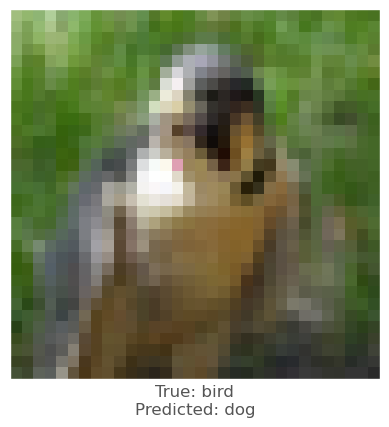

Success Lopt is 29.14178294234665
Final Lopt is 29.14178294234665


Round  19
Confidence: 0.013011257


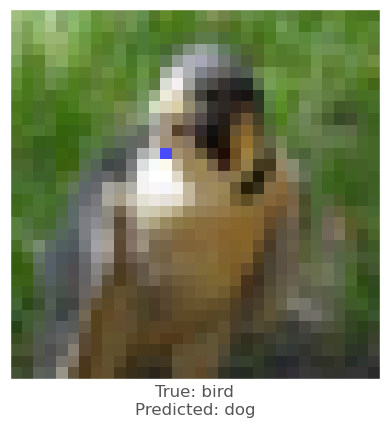

Success Lopt is 111.93433512636848
Confidence: 0.38282108


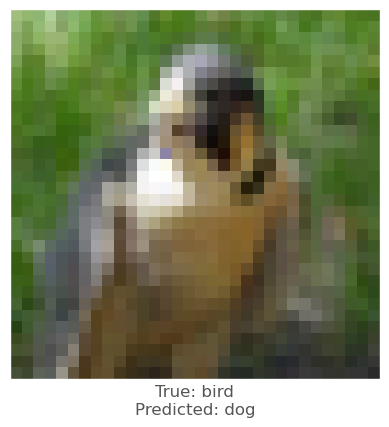

Success Lopt is 43.531193279883865
Confidence: 0.61238617
Confidence: 0.6033631
Confidence: 0.6033631
Confidence: 0.5987122
Confidence: 0.5987122
Confidence: 0.5771598
Confidence: 0.5497812
Confidence: 0.5497812
Confidence: 0.5497812
Confidence: 0.5497812
Confidence: 0.548464
Confidence: 0.548464
Confidence: 0.54772174
Confidence: 0.50361687
Confidence: 0.4821439


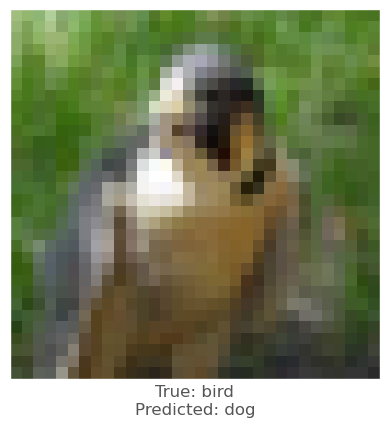

Success Lopt is 36.92195421329163
Confidence: 0.54509455
Confidence: 0.53828
Confidence: 0.5204627
Confidence: 0.51808625
Confidence: 0.51206607
Confidence: 0.5543493
Confidence: 0.52045125
Confidence: 0.52045125
Confidence: 0.5152422
Confidence: 0.5152422
Final Lopt is 36.92195421329163


Round  20
Confidence: 0.030478336


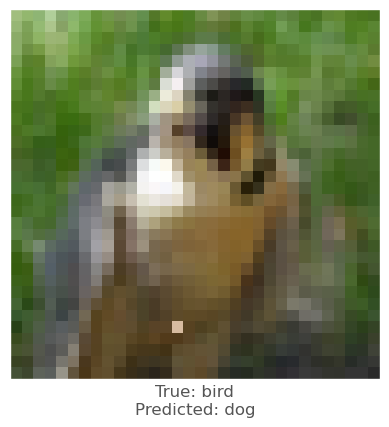

Success Lopt is 127.65125817230057
Confidence: 0.11033316


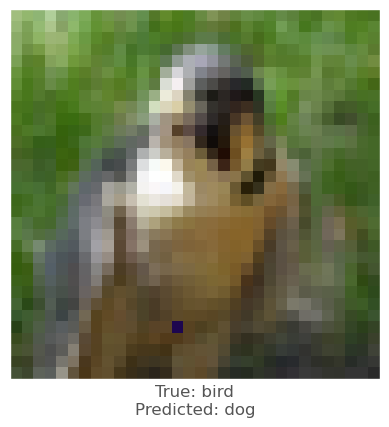

Success Lopt is 58.84731237148918
Confidence: 0.4504832


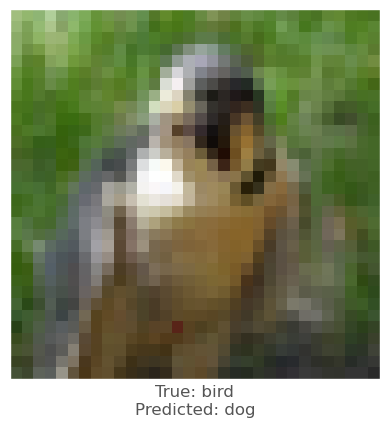

Success Lopt is 28.283519560342754
Confidence: 0.56915194
Confidence: 0.56915194
Confidence: 0.5539219
Confidence: 0.5490959
Confidence: 0.5490959
Confidence: 0.5090108
Confidence: 0.5087455
Confidence: 0.50237983
Confidence: 0.50237983
Confidence: 0.50237983
Confidence: 0.49095222


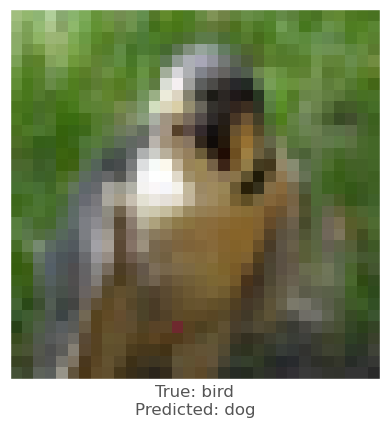

Success Lopt is 23.63860707775956
Confidence: 0.5120641
Confidence: 0.5003866
Confidence: 0.5003866
Confidence: 0.5003866
Confidence: 0.4988567


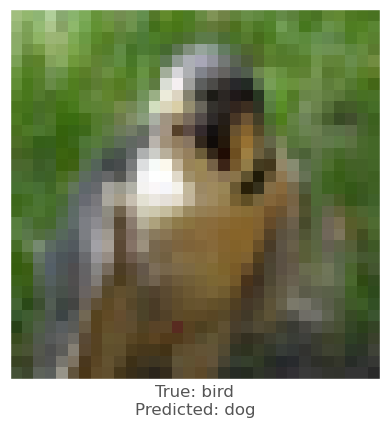

Success Lopt is 21.403529646776832
Final Lopt is 21.403529646776832


Round  21
Confidence: 0.06380129


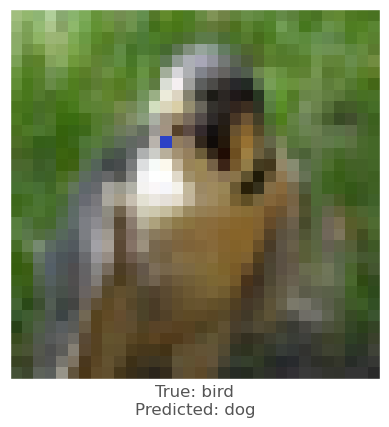

Success Lopt is 116.36733160551019
Confidence: 0.39837557


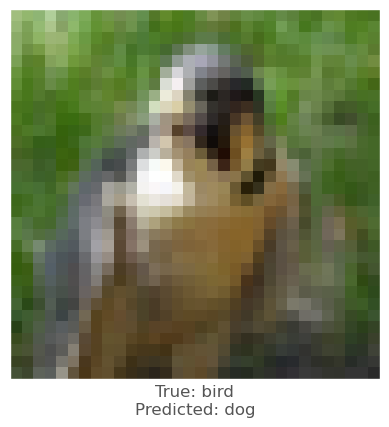

Success Lopt is 54.185285062130305
Confidence: 0.5551045
Confidence: 0.54915744
Confidence: 0.545277
Confidence: 0.545277
Confidence: 0.5316937
Confidence: 0.48781645


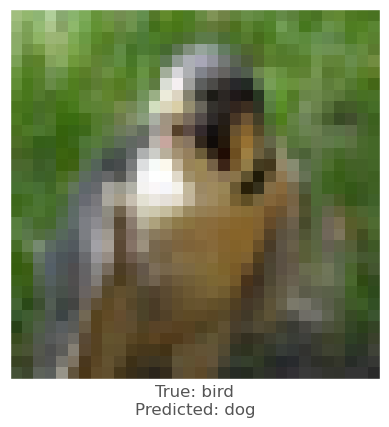

Success Lopt is 39.20415536589431
Confidence: 0.5272531
Confidence: 0.5272531
Confidence: 0.5190518
Confidence: 0.5190518
Confidence: 0.5061633
Confidence: 0.5015935
Confidence: 0.5015935
Confidence: 0.49388862


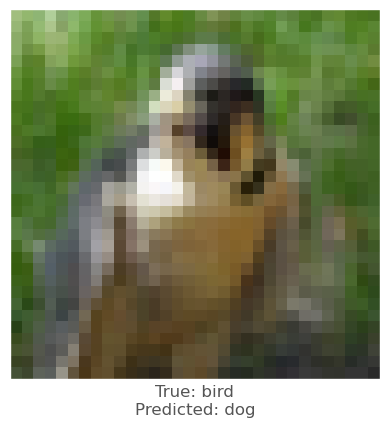

Success Lopt is 34.650999993861944
Final Lopt is 34.650999993861944


Round  22
Confidence: 0.18353054


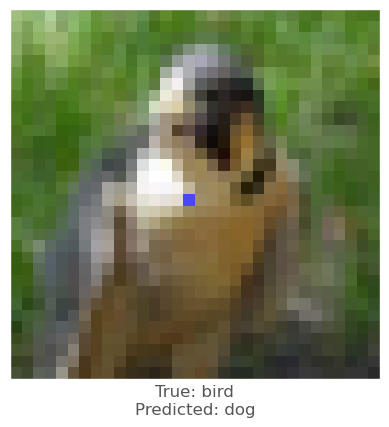

Success Lopt is 120.29280875076097
Confidence: 0.48969737


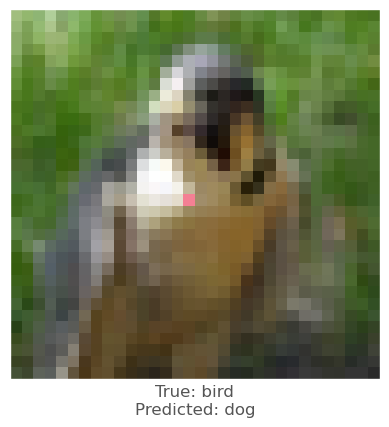

Success Lopt is 52.375419491858224
Confidence: 0.5844
Confidence: 0.56569064
Confidence: 0.55342436
Confidence: 0.55342436
Confidence: 0.5527391
Confidence: 0.518348
Confidence: 0.518348
Confidence: 0.518348
Confidence: 0.5090574
Confidence: 0.5070564
Confidence: 0.49989578
Confidence: 0.49989578
Confidence: 0.49512494


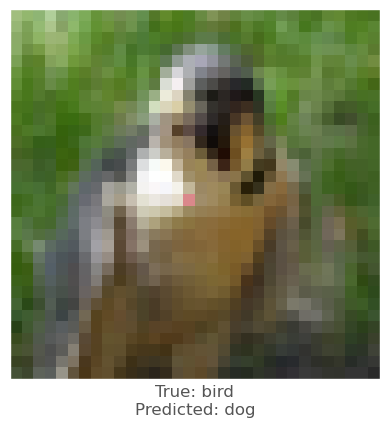

Success Lopt is 44.11214584123172
Confidence: 0.5148315
Confidence: 0.5133568
Confidence: 0.51186556
Confidence: 0.507852
Confidence: 0.50649184
Confidence: 0.52360326
Confidence: 0.50676894
Confidence: 0.50676894
Confidence: 0.50676894
Confidence: 0.5023833
Confidence: 0.5064588
Confidence: 0.5064588
Confidence: 0.4999563
Confidence: 0.4999563
Confidence: 0.49779493


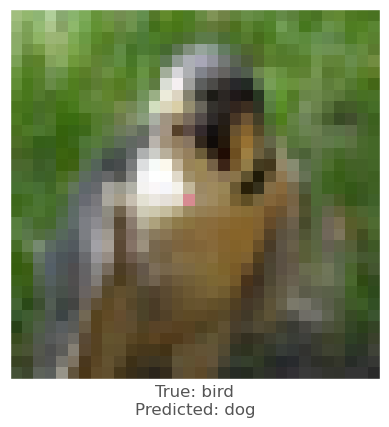

Success Lopt is 41.96643514223294
Final Lopt is 41.96643514223294


Round  23
Confidence: 0.028863683


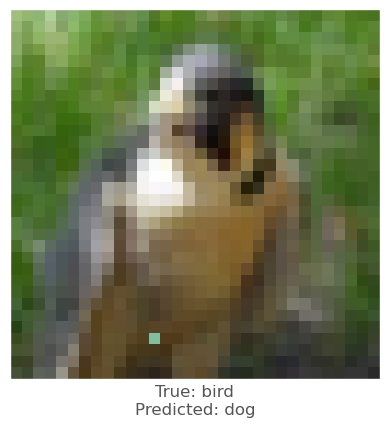

Success Lopt is 127.44385175050851
Confidence: 0.12496213


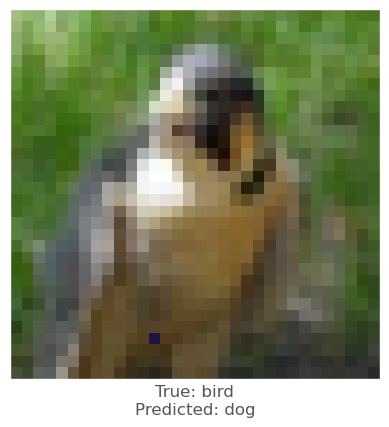

Success Lopt is 60.34126180244668
Confidence: 0.37405813


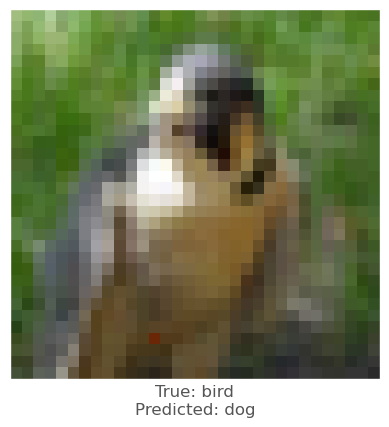

Success Lopt is 27.987718842605837
Confidence: 0.5029262
Confidence: 0.4877342


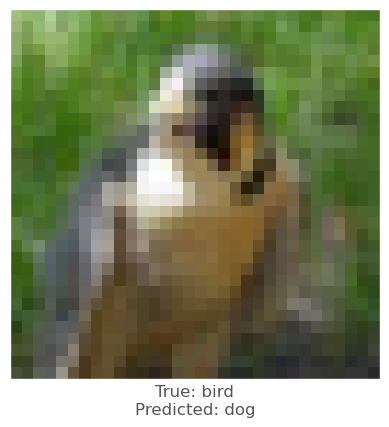

Success Lopt is 12.959380620478399
Confidence: 0.61035055
Confidence: 0.5950681
Confidence: 0.5876919
Confidence: 0.58100367
Confidence: 0.58100367
Confidence: 0.5680135
Confidence: 0.55921376
Confidence: 0.5414565
Confidence: 0.5357558
Confidence: 0.5314483
Confidence: 0.5206883
Confidence: 0.5206883
Confidence: 0.51936966
Confidence: 0.5164578
Confidence: 0.5164578
Confidence: 0.5270015
Confidence: 0.5102664
Confidence: 0.5080045
Confidence: 0.50736886
Confidence: 0.50651354
Final Lopt is 12.959380620478399


Round  24
Confidence: 0.059005704


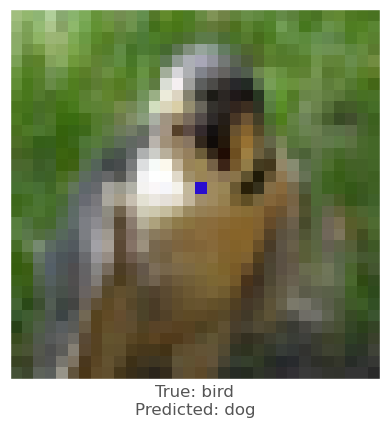

Success Lopt is 122.42959416857454
Confidence: 0.46615922


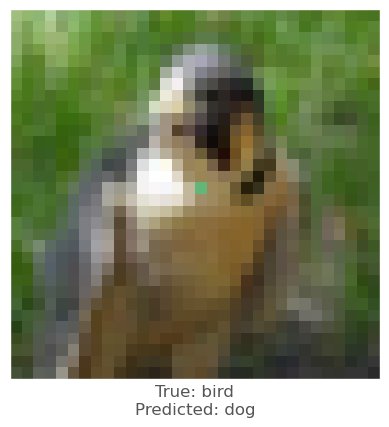

Success Lopt is 54.49974606208025
Confidence: 0.52673507
Confidence: 0.52673507
Confidence: 0.52673507
Confidence: 0.51860386
Confidence: 0.51860386
Confidence: 0.5229876
Confidence: 0.49156213


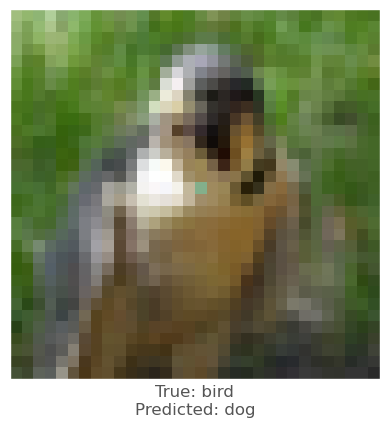

Success Lopt is 39.72496795530611
Confidence: 0.5240159
Confidence: 0.5240159
Confidence: 0.51800793
Confidence: 0.5134947
Confidence: 0.5093073
Confidence: 0.50867957
Confidence: 0.50867957
Confidence: 0.5068375
Confidence: 0.5038848
Confidence: 0.5038848
Confidence: 0.49769038


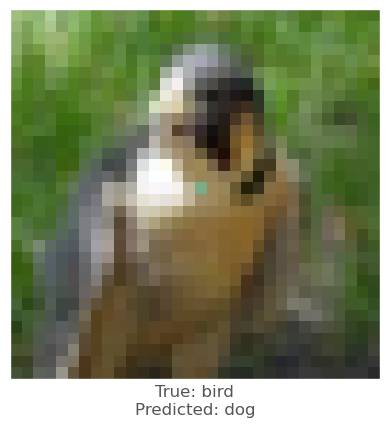

Success Lopt is 36.49336380169862
Final Lopt is 36.49336380169862


Round  25
Confidence: 0.043331664


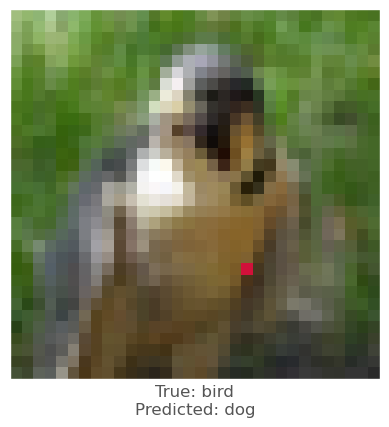

Success Lopt is 106.495895140372
Confidence: 0.24623375


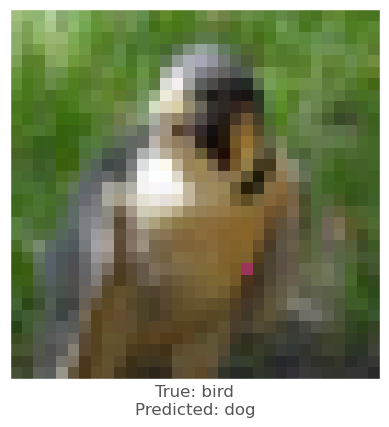

Success Lopt is 52.71033076846359
Confidence: 0.5505042
Confidence: 0.5479596
Confidence: 0.54578924
Confidence: 0.54578924
Confidence: 0.53870434
Confidence: 0.42775643


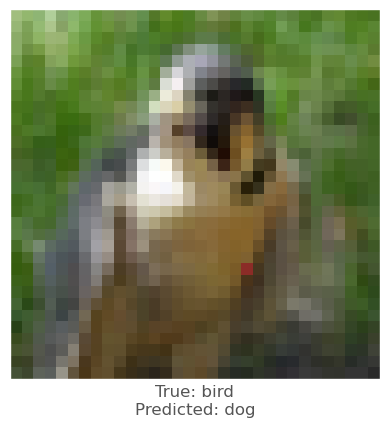

Success Lopt is 36.131355571315595
Confidence: 0.52053595
Confidence: 0.49786437


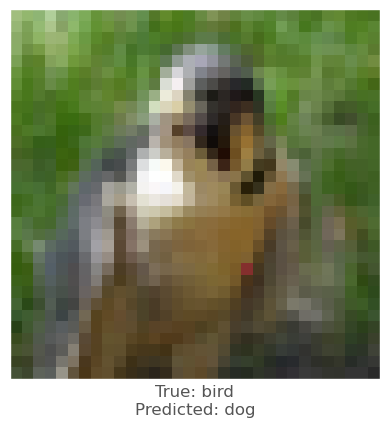

Success Lopt is 29.8374668465585
Confidence: 0.53791934
Confidence: 0.53791934
Confidence: 0.53050625
Confidence: 0.53050625
Confidence: 0.52696127
Confidence: 0.5374871
Confidence: 0.5374871
Confidence: 0.5374871
Confidence: 0.5374871
Confidence: 0.52290356
Final Lopt is 29.8374668465585


Round  26
Confidence: 0.05495669


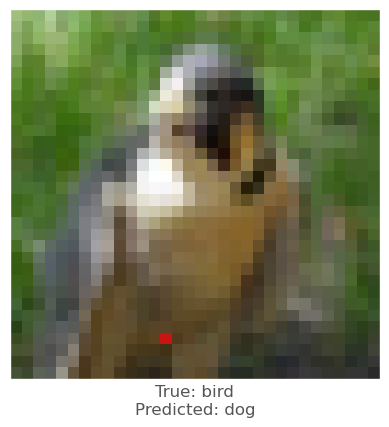

Success Lopt is 119.85980219914788
Confidence: 0.14070657


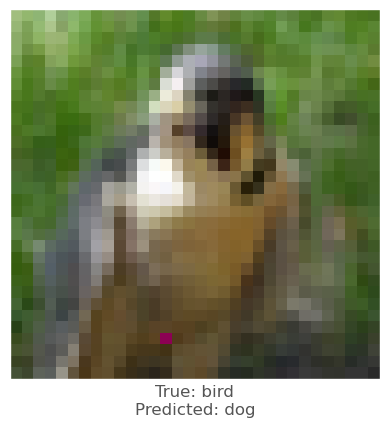

Success Lopt is 58.80215545842131
Confidence: 0.37745133


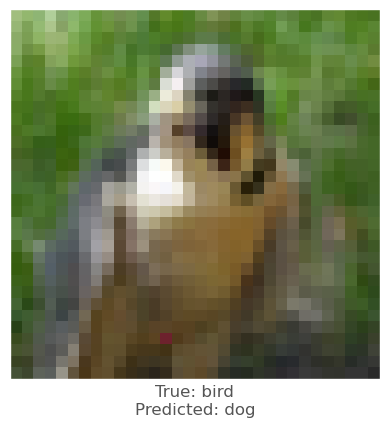

Success Lopt is 27.055894523630826
Confidence: 0.53065974
Confidence: 0.52820086
Confidence: 0.5231643
Confidence: 0.51707006
Confidence: 0.51695037
Confidence: 0.45176938


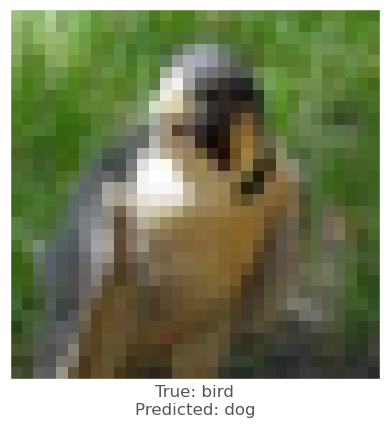

Success Lopt is 19.857096382188473
Confidence: 0.50543875
Confidence: 0.49548158


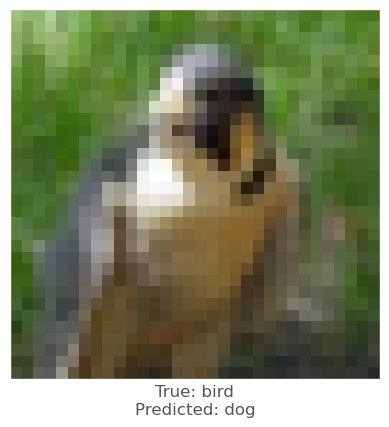

Success Lopt is 15.28639291069672
Confidence: 0.513005
Confidence: 0.50794804
Confidence: 0.50794804
Confidence: 0.50794804
Confidence: 0.5077652
Final Lopt is 15.28639291069672


Round  27
Confidence: 0.08653193


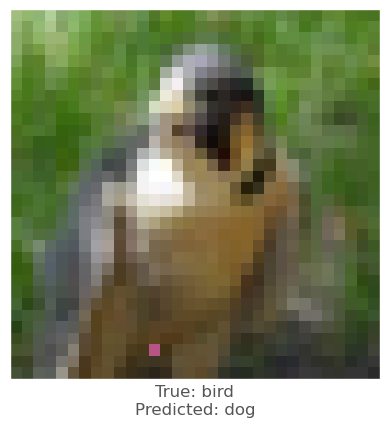

Success Lopt is 111.53062322125317
Confidence: 0.20957883


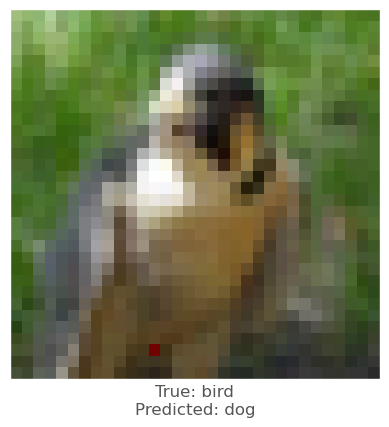

Success Lopt is 52.717314601129736
Confidence: 0.5118047
Confidence: 0.50954306
Confidence: 0.50918853
Confidence: 0.50918853
Confidence: 0.48523924


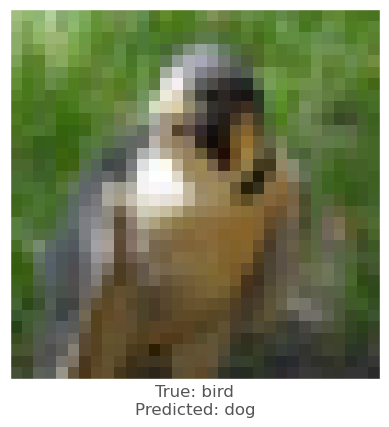

Success Lopt is 25.06040613743162
Confidence: 0.60133946
Confidence: 0.60133946
Confidence: 0.60133946
Confidence: 0.59884614
Confidence: 0.59523225
Confidence: 0.56815404
Confidence: 0.56815404
Confidence: 0.56815404
Confidence: 0.56815404
Confidence: 0.56702965
Confidence: 0.54553473
Confidence: 0.53822845
Confidence: 0.53822845
Confidence: 0.5350226
Confidence: 0.5350226
Confidence: 0.5244182
Confidence: 0.5244182
Confidence: 0.5244182
Confidence: 0.5244182
Confidence: 0.51982117
Confidence: 0.5376913
Confidence: 0.50290424
Confidence: 0.50290424
Confidence: 0.50290424
Confidence: 0.50290424
Final Lopt is 25.06040613743162


Round  28
Confidence: 0.06119173


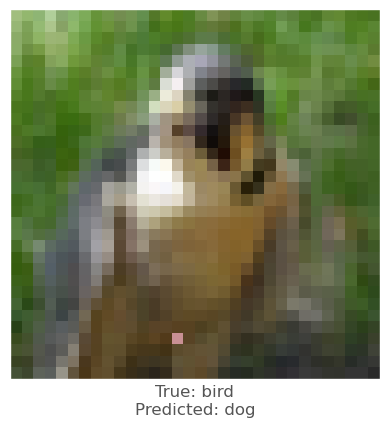

Success Lopt is 121.11398456968635
Confidence: 0.19189487


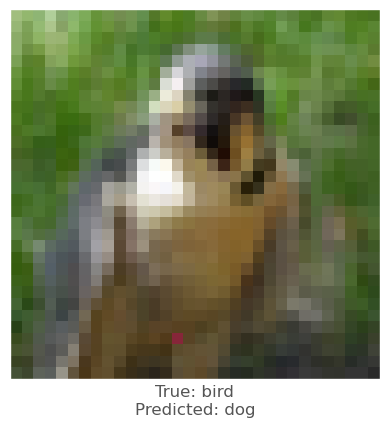

Success Lopt is 53.45268966747332
Confidence: 0.4168347


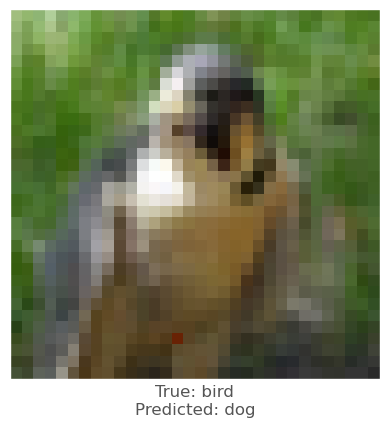

Success Lopt is 23.583938433257927
Confidence: 0.6167192
Confidence: 0.6167192
Confidence: 0.6167192
Confidence: 0.6167192
Confidence: 0.6167192
Confidence: 0.55161554
Confidence: 0.55161554
Confidence: 0.5496424
Confidence: 0.5496424
Confidence: 0.5394171
Confidence: 0.5282319
Confidence: 0.5282319
Confidence: 0.5227234
Confidence: 0.5227234
Confidence: 0.48435643


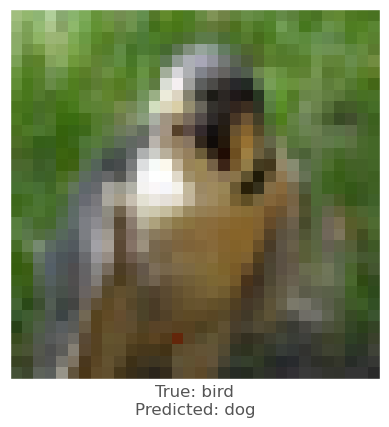

Success Lopt is 19.596222002918566
Confidence: 0.55981946
Confidence: 0.5434863
Confidence: 0.53581095
Confidence: 0.53581095
Confidence: 0.53581095
Final Lopt is 19.596222002918566


Round  29
Confidence: 0.04708223


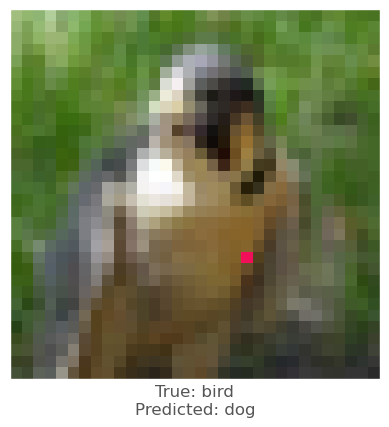

Success Lopt is 115.69729178340853
Confidence: 0.35251084


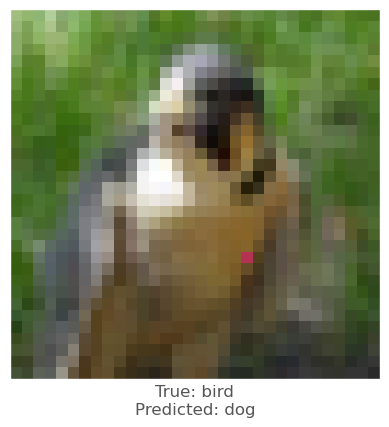

Success Lopt is 54.481205819782645
Confidence: 0.59457535
Confidence: 0.5944228
Confidence: 0.5912166
Confidence: 0.56201625
Confidence: 0.55215144
Confidence: 0.4797251


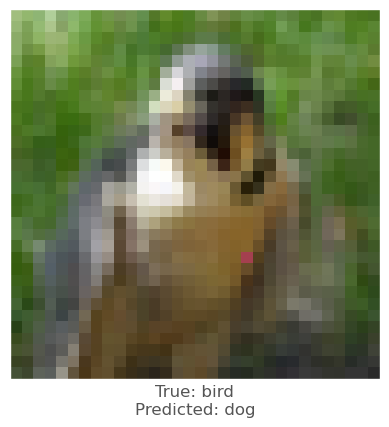

Success Lopt is 37.68262580672766
Confidence: 0.556931
Confidence: 0.556931
Confidence: 0.53834647
Confidence: 0.53043115
Confidence: 0.5208442
Confidence: 0.53230816
Confidence: 0.52546376
Confidence: 0.5111764
Confidence: 0.5111764
Confidence: 0.5069279
Confidence: 0.53121644
Confidence: 0.5213027
Confidence: 0.5118684
Confidence: 0.50117433
Confidence: 0.50117433
Confidence: 0.5037859
Confidence: 0.48276004


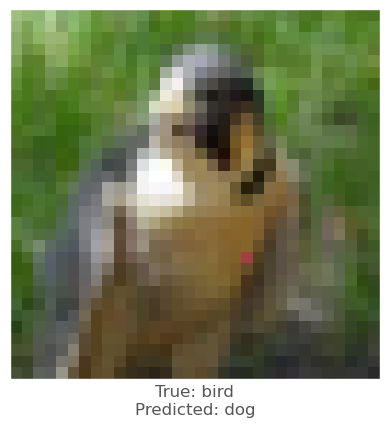

Success Lopt is 35.355700280444694
Final Lopt is 35.355700280444694
31.775528 sec
[123.55702241383908, 85.93899334060009, 71.66061922762361, 67.81619271106729, 126.06376329780723, 55.84396842359419, 38.05729913682143, 32.73197914727825, 125.82406087522747, 60.34152941576028, 55.585789406199524, 124.41342795887606, 87.86899522206352, 73.05503433743328, 68.16031367271023, 116.42352210277396, 57.13490416514131, 47.92311722818292, 44.25684212867634, 124.5028476831694, 86.33798023852239, 77.61954171193395, 74.56586729026884, 124.12997250387, 92.70749193715565, 76.51909882474598, 68.1742650418526, 66.92516000654086, 117.206647017317, 55.11670393993464, 40.80215656974809, 31.959690673737782, 28.167537544773268, 110.41925411626556, 43.300022174355746, 29.821053403621022, 23.165483046020697, 125.18142468213864, 57.64371598791868, 44.37561854743697, 123.43953562413682, 90.21241348703933, 79.53706426154463, 127.01821358984931, 57.39673169477146, 47.3763323186225, 124.37637126205341, 92.1022574748

In [98]:
image_id = 384
pixels = 1 # Number of pixels to attack
model = resnet


# _ = attack(image_id, model, pixel_count=pixels, verbose=True)
start = time.time()
_ = my_attack_3(image_id, model, pixel_count=pixels, maxiter = 5, popsize = 50, verbose = True)
end = time.time()
print(f"{end - start:.6f} sec")
print(Lopt_list)
print(attacked_pixel_coord)

#### Targeted Attack

In the targeted attack, we can choose which class we want a model to classify an image as. The task is much harder for the targeted attack, as we constrain the misclassification to a given class rather than any class that's not the correct one. We should see the confidence in the target class rise after several iterations.

Below we try to cause the `lenet` to classify an image of a `ship` as an `automobile`. Try to change the parameters and see what happens.

Attacking with target automobile
Confidence: 3.0633404e-05
Confidence: 0.00010486837
Confidence: 0.00014085951
Confidence: 0.00014085951
Confidence: 0.00014861667
Confidence: 0.00015590874
Confidence: 0.00015590874
Confidence: 0.0001633432
Confidence: 0.0001691464
Confidence: 0.0001691464
Confidence: 0.0001736398
Confidence: 0.00018478777
Confidence: 0.00018478777
Confidence: 0.00018926852
Confidence: 0.00019364354
Confidence: 0.00019561265
Confidence: 0.00019561265
Confidence: 0.00019561265
Confidence: 0.00019561265
Confidence: 0.00019561265
Confidence: 0.00019561265
Confidence: 0.00019561265
Confidence: 0.0002003284
Confidence: 0.0002003284
Confidence: 0.0002003284
Confidence: 0.0002003284
Confidence: 0.0002003284
Confidence: 0.0002003284
Confidence: 0.0002003284
Confidence: 0.0002003284
Confidence: 0.0002003284
Confidence: 0.00020290277
Confidence: 0.00020290277
Confidence: 0.00020290277
Confidence: 0.00020290277
Confidence: 0.00020290277
Confidence: 0.00020290277
Confidence: 0.0002

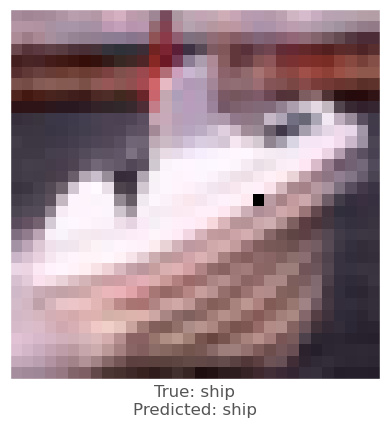

In [60]:
image_id = 108
target_class = 1 # Integer in range 0-9
pixels = 1
model = net_in_net
# net_in_net in 1 pixel : fail
# net_in_net in 3 pixel : success
# wide_resnet in 3 pixel : fail
# densenet in 3 pixel : fail
# pure_cnn in 3 pixel : fail

print('Attacking with target', class_names[target_class])
_ = attack(image_id, model, target_class, pixel_count=pixels, verbose=True)

### Collect Results

Armed with all the necessary tools to conduct a one pixel attack, the final step is to collect relevant statistics on the targeted and untargeted attack. The relevant data points are what percentage of images were we able to successfully attack for a given model, and how the number of pixels affect this percentage.

We will loop through every combination of all models, perturbations of 1,3,5 pixels, images, and target classes (for the targeted attack). This will take a lot of computational resources and time, so [skip to the statistics section](#Attack-Statistics) if that's not your idea of fun.

In [ ]:
def attack_all(models, samples=500, pixels=(1,3,5), targeted=False, 
               maxiter=75, popsize=400, verbose=False):
    results = []
    for model in models:
        model_results = []
        valid_imgs = correct_imgs[correct_imgs.name == model.name].img
        img_samples = np.random.choice(valid_imgs, samples, replace=False)
        
        for pixel_count in pixels:
            for i, img_id in enumerate(img_samples):
                print('\n', model.name, '- image', img_id, '-', i+1, '/', len(img_samples))
                targets = [None] if not targeted else range(10)
                
                for target in targets:
                    if targeted:
                        print('Attacking with target', class_names[target])
                        if target == y_test[img_id, 0]:
                            continue
                    result = attack(img_id, model, target, pixel_count, 
                                    maxiter=maxiter, popsize=popsize, 
                                    verbose=verbose)
                    model_results.append(result)
                    
        results += model_results
        helper.checkpoint(results, targeted)
    return results

In [ ]:
untargeted = attack_all(models, samples=100, targeted=False)

In [ ]:
targeted = attack_all(models, samples=10, targeted=True)

### Attack Statistics

Print the final results! 

In [ ]:
# Load the results
untargeted, targeted = helper.load_results()

In [ ]:
columns = ['model', 'pixels', 'image', 'true', 'predicted', 'success', 'cdiff', 'prior_probs', 'predicted_probs', 'perturbation']
untargeted_results = pd.DataFrame(untargeted, columns=columns)
targeted_results = pd.DataFrame(targeted, columns=columns)

#### Untargeted

In [43]:
helper.attack_stats(untargeted_results, models, network_stats)

,model,accuracy,pixels,attack_success_rate
0,lenet,0.7488,1,0.9
1,lenet,0.7488,3,1.0
2,lenet,0.7488,5,1.0
3,pure_cnn,0.8877,1,0.3
4,pure_cnn,0.8877,3,0.4
5,pure_cnn,0.8877,5,0.5
6,net_in_net,0.9074,1,0.1
7,net_in_net,0.9074,3,0.6
8,net_in_net,0.9074,5,0.7
9,resnet,0.9231,1,0.1


#### Targeted

In [35]:
helper.attack_stats(targeted_results, models, network_stats)

,model,accuracy,pixels,attack_success_rate
0,lenet,0.7488,1,0.222222
1,lenet,0.7488,3,0.644444
2,lenet,0.7488,5,0.633333
3,resnet,0.9231,1,0.155556
4,resnet,0.9231,3,0.311111
5,resnet,0.9231,5,0.344444


### Show some successful attacks

Plot 9 random successful attack images

Untargeted Attack


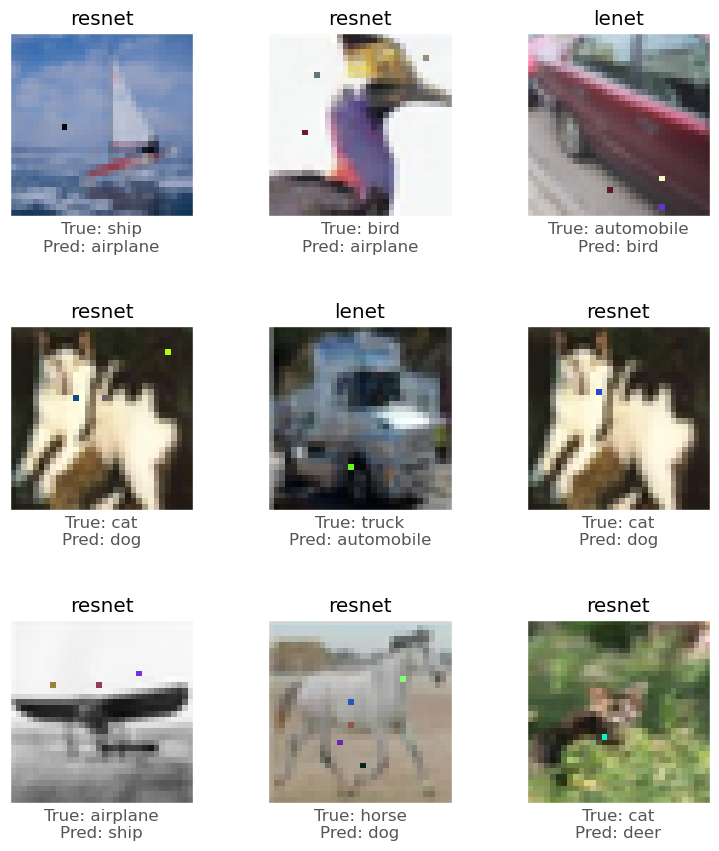

In [25]:
print('Untargeted Attack')
helper.visualize_attack(untargeted_results, class_names)

Targeted Attack


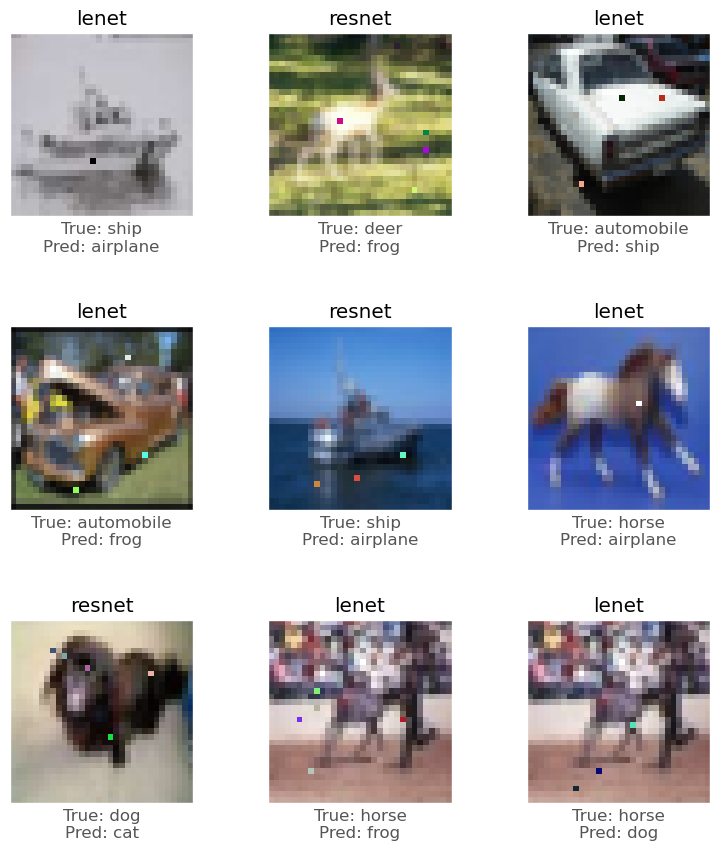

In [26]:
print('Targeted Attack')
helper.visualize_attack(targeted_results, class_names)

## Conclusions

It appears that the accuracy of a model is not strongly correlated with the chance of performing a successful attack on an image. Perhaps surprisingly, the purely convolutional model is the most resistant CNN to these types of attacks. In addition, the capsule network CapsNet has the lowest attack success rate out of all the models, although it is still vulnerable to attack.

[Part 2](1_one-pixel-attack-cifar10.ipynb)

## Credits
 -  This implemenation is based off of the original paper describing the one pixel attack: https://arxiv.org/abs/1710.08864
 - Base code for iPython notebook: https://github.com/09rohanchopra/cifar10
 - Keras Cifar10 models: https://github.com/BIGBALLON/cifar-10-cnn
 - Scipy's differential evolution implementation: https://docs.scipy.org/doc/scipy-0.17.0/reference/generated/scipy.optimize.differential_evolution.html
 - State of the art: https://github.com/RedditSota/state-of-the-art-result-for-machine-learning-problems
 - CapsNet Keras: https://github.com/XifengGuo/CapsNet-Keras
 - CapsNet with Cifar: https://github.com/theblackcat102/dynamic-routing-capsule-cifar